# COMP9444 Project

# Traffic Sign Recognition
## By group noname

## Introdunction 

In the rapidly evolving landscape of intelligent transportation systems, the capability to recognise traffic signs accurately and efficiently is paramount. This ability is crucial not only for the advancement of autonomous vehicles but also for enhancing the safety and efficiency of human-driven vehicles. Traffic sign recognition (TSR) systems serve as a critical component in a wide range of applications, from driver assistance systems to fully autonomous driving solutions.

The aim of this paper is to explore and analyse the efficacy of various deep learning models in the domain of traffic sign recognition. These models include DenseNet, MobileNet, EfficientNet, a custom Convolutional Neural Network (CNN), and ShuffleNet. Each of these models brings a unique set of features and optimisations, making them potential candidates for robust and efficient TSR systems. 
The importance of this problem cannot be overstated. Accurate traffic sign recognition is essential for maintaining road safety, ensuring compliance with traffic laws and facilitating smooth traffic flow. In the context of autonomous vehicles, reliable TSR is a non-negotiable prerequisite for safe operation. Moreover, in human-operated vehicles, advanced driver-assistance systems (ADAS) that include TSR capabilities can significantly reduce the risk of accidents caused by human error.

Our contribution in this paper lies in the comprehensive evaluation and comparison of these state-of-art deep learning models int the context of traffic sign recognition. We have undertaken a rigorous analysis of each model, considering factors such as accuracy, computational efficiency and the ability to operate under varying environmental conditions. Additionally, we have developed a custom CNN model tailored specifically for TSR, aiming to strike an optimal balance between performance and resource efficiency.

By presenting a detailed comparison of these models, this paper aims to contribute to the ongoing research in TSR systems. Our findings provide valuable insights into the strengths and limitations of each model, guiding future research and development in this field. Moreover, our custom CNN model offers a novel approach that could potentially improve current practices in traffic sign recognition, paving the way for more advanced and reliable TSR systems in both autonomous and human-operated vehicles.

In summary, our work not only addresses a critical aspect of intelligent transportation systems but also provides a comprehensive framework for evaluating and improving traffic sign recognition technologies. By leveraging the latest advancements in deep learning, we aim to contribute to the enhancement of road safety and the advancement of autonomous driving technologies.


## Literature Review

TSR is an area that has been significant advancements with the evolution of machine learning and computer vision technologies. Prior to the widespread adoption of deep learning, traditional image processing techniques like color segmentation, shape detection and feature extraction using Histogram of Oriented Gradients (HOG) or Scale-Invariant Feature Transform (SIFT) were commonly employed.

Before the deep learning era, Support Vector Machines (SVMs) were extensively used for traffic sign recognition due to their effectiveness in handling high-dimensional data and their ability to model complex, non-linear decision boundaries. SVMs combined with HOG feature descriptors were a standard approach [1]. Simpler neural network architectures were also used, although less powerful than their modern counterparts, they laid the foundation for subsequent developments in neural network-based traffic sign recognition

These traditional methods, while effective in certain scenarios, generally lag behind modern deep learning approaches in terms of accuracy and robustness, particularly in challenging conditions such as varying illumination, occlusions and different viewing angles. The introduction of convolutional neural networks (CNNs) marked a significant leap in TSR, leading to current state-of-art methods that rely on deep learning.


## Experimental Setup

A.	Dataset overview
For our traffic sign recognition project, we utilised the German Traffic Sign Recognition Benchmark (GTSRB) dataset, a widely recognised and comprehensive dataset in the field of traffic sign classification. The dataset comprises over 50,000 images, offering a robust foundation for training, validating and testing our models. There are 43 different classes, representing various traffic signs. This diversity presents a realistic challenge in recognizing a wide range of traffic signs. Images in the dataset vary in sizes and are provided in a range of resolutions, simulating real-world conditions where traffic signs can appear at different distances and angles. Each image is annotated with the class label, ensuring accurate supervision during the training process. The GTSRB dataset can be accessed at the following URL: GTSRB Dataset. 

B.	Dataset exploration
During our initial data exploration, we observed that certain classes are more heavily represented than others, highlighting the need for techniques to handle class imbalance. The images also exhibit a wide range of lighting and weather conditions, underscoring the necessity for models that are robust to such variations. Some images also have partial occlusions and background noise, posing additional challenges for accurate recognition.

C.	Evaluation strategy
Our evaluation strategy is to split the dataset into train, validation and test dataset. Then, we use the accuracy, precision, recall and f1-score to evaluate the performance of each model, providing a comprehensive view of their effectiveness in classifying traffic signs. Besides that, we also implemented data assembling techniques to combine the predictions of the 5 models we used to get a more accurate predictions and higher accuracy.

D.	Model Hyperparameters
For each model, we experimented with different learning rates to find the optimal speed at which the model learns. The batch size was adjusted based on the model and computational resources available, balancing training speed and memory usage. The number of epochs was set to 10 initially to see how each model performs and then set to 20 epochs later to ensure that the model is properly trained and shows signs of convergence. We also used advanced optimisers like Adam for each model.

E.	Preprocessing and Data augmentation
We prepared these data through careful pre-processing and augmentations to ensure out model learns to recognize and classify sings accurately under diverse conditions. We applied techniques such as rotation, resizing, normalization, flipping and color adjustments were also applied to enhance the robustness of the models against real-world variations in traffic sign appearances. 


In [1]:
import torch
from torch.utils.data import Dataset
import pandas as pd
from PIL import Image
import os
import matplotlib.pyplot as plt

print(torch.cuda.is_available())
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")


class GTSRBDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        """
        Args:
            root_dir (string): Directory with all the classes' subdirectories.
            transform (callable, optional): Optional transform to be applied on a sample.
        """
        self.image_info = []
        self.root_dir = root_dir
        self.transform = transform

        # Loop through all class directories
        for class_id in sorted(os.listdir(root_dir)):
            class_dir = os.path.join(root_dir, class_id)
            if os.path.isdir(class_dir):
                annotation_file = os.path.join(class_dir, f'GT-{class_id}.csv')
                annotations = pd.read_csv(annotation_file, sep=';')
                
                # Add image information and class ID to list
                for _, row in annotations.iterrows():
                    self.image_info.append({
                        'path': os.path.join(class_dir, row['Filename']),
                        'class_id': int(class_id),
                        'roi': [row['Roi.X1'], row['Roi.Y1'], row['Roi.X2'], row['Roi.Y2']]
                    })

    def __len__(self):
        return len(self.image_info)

    def __getitem__(self, idx):
        image_path = self.image_info[idx]['path']
        class_id = self.image_info[idx]['class_id']
        roi = self.image_info[idx]['roi']
        
        # Load image and crop using ROI
        image = Image.open(image_path).crop(roi)
        
        if self.transform:
            image = self.transform(image)

        sample = {'image': image, 'label': class_id}

        return sample


True


In [2]:
from torchvision import transforms

transform = transforms.Compose([
    transforms.Resize((32, 32)),  # Resize to a common size
    transforms.RandomHorizontalFlip(),  # Random horizontal flip
    transforms.RandomRotation(10),  # Random rotation between -10 to 10 degrees
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),  # Random color jitter
    transforms.ToTensor(),  # Convert images to PyTorch tensors
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),  # Normalize the tensors
])

gtsrb_dataset = GTSRBDataset(root_dir='C:\\Users\\niuka\\GTSRB_Final_Training_Images\\GTSRB\\Final_Training\Images',
                             transform=transform)


Using TensorFlow backend.


In [3]:
from torch.utils.data import random_split

# Define split ratios
train_ratio = 0.7
val_ratio = 0.15
test_ratio = 0.15

# Calculate split sizes
total_size = len(gtsrb_dataset)
train_size = int(train_ratio * total_size)
val_size = int(val_ratio * total_size)
test_size = total_size - train_size - val_size

# Split the dataset
train_dataset, val_dataset, test_dataset = random_split(gtsrb_dataset, [train_size, val_size, test_size])

print(f'Training size : {len(train_dataset)}, Validation size : {len(val_dataset)}, Testing size : {len(test_dataset)}')

Training size : 27446, Validation size : 5881, Testing size : 5882


In [4]:
ModelAccuracies = []
accuracy_values = []
precision_values = []
recall_values = []
f1score_values = []
Average_inference_time = []

In [5]:
from torch.utils.data import DataLoader

train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=64, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)

## Models

### MobileNet

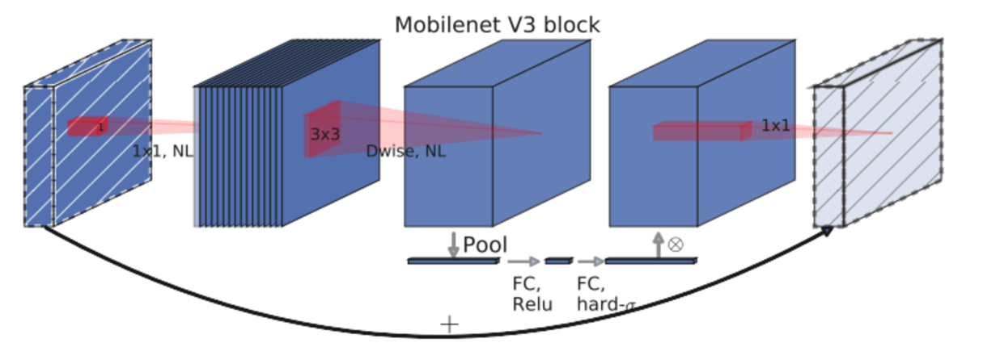
https://pytorch.org/blog/torchvision-mobilenet-v3-implementation/

MobileNet is a low-latency, low-power model. It is highly efficient in terms of computation and are designed to support various applications like image classification, object detection, and segmentation.
It uses a 'sandwich' rule for selecting the models. The rule is simple: start with an initial good structure and search for new structures in the middle, keeping the first and the last layers static.


In [6]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from collections import OrderedDict
from torch.optim import Adam,lr_scheduler
import torchvision.models as models

# Initialize the DenseNet model
model = models.mobilenet_v3_small() #Constructs a small MobileNetV3 architecture from Searching for MobileNetV3 <https://arxiv.org/abs/1905.02244>__.
print(model)
num_classes = 43
classifier = nn.Sequential(
    nn.Linear(576,250),
    nn.ReLU(),
    nn.Dropout(0.5),
    nn.Linear(250,43)
    )
model.classifier = classifier
model = model.to(device)



# Define the loss function and the optimizer
criterion = nn.CrossEntropyLoss()
optimizer = Adam(model.parameters(), lr=0.0007)

# Optional: Learning rate scheduler
scheduler = lr_scheduler.StepLR(optimizer, step_size=7, gamma=0.1)

MobileNetV3(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(16, eps=0.001, momentum=0.01, affine=True, track_running_stats=True)
      (2): Hardswish()
    )
    (1): InvertedResidual(
      (block): Sequential(
        (0): Conv2dNormActivation(
          (0): Conv2d(16, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), groups=16, bias=False)
          (1): BatchNorm2d(16, eps=0.001, momentum=0.01, affine=True, track_running_stats=True)
          (2): ReLU(inplace=True)
        )
        (1): SqueezeExcitation(
          (avgpool): AdaptiveAvgPool2d(output_size=1)
          (fc1): Conv2d(16, 8, kernel_size=(1, 1), stride=(1, 1))
          (fc2): Conv2d(8, 16, kernel_size=(1, 1), stride=(1, 1))
          (activation): ReLU()
          (scale_activation): Hardsigmoid()
        )
        (2): Conv2dNormActivation(
          (0): Conv2d(16, 16, kernel_size=(1, 1), 

At the beginning I use MobileNetv3 to training, the accuracy reached 98%, but I found that the training loss continued to decrease, and the validation loss started to increase after it dropped to a certain point. This is most likely overfitting. So I decreasing the number of layer in neural network model, which could prevent overfitting.

And than I also adjust Learning Rate and dropout This allows the model to converge faster to minimize the loss and be more stable.


Epoch 1, Training loss: 2.2065578738014735, Training Accuracy: 34.409385702834655%, Validation Loss: 3.6206612146419026, Validation Accuracy: 3.2307430709063083%
Epoch 2, Training loss: 1.143428495991758, Training Accuracy: 62.643008088610365%, Validation Loss: 0.7787083902436754, Validation Accuracy: 74.15405543274953%
Epoch 3, Training loss: 0.7657642945265158, Training Accuracy: 75.0419004590833%, Validation Loss: 0.5744952475247176, Validation Accuracy: 80.70056112905968%
Epoch 4, Training loss: 0.6003123908748715, Training Accuracy: 80.78044159440356%, Validation Loss: 0.4849527228785598, Validation Accuracy: 83.25114776398571%
Epoch 5, Training loss: 0.4843330147105219, Training Accuracy: 84.39845514829119%, Validation Loss: 0.42959665839114913, Validation Accuracy: 86.10780479510288%
Epoch 6, Training loss: 0.4085691031459328, Training Accuracy: 86.90155213874517%, Validation Loss: 0.3317566476762295, Validation Accuracy: 88.8794422717225%
Epoch 7, Training loss: 0.3617956703810

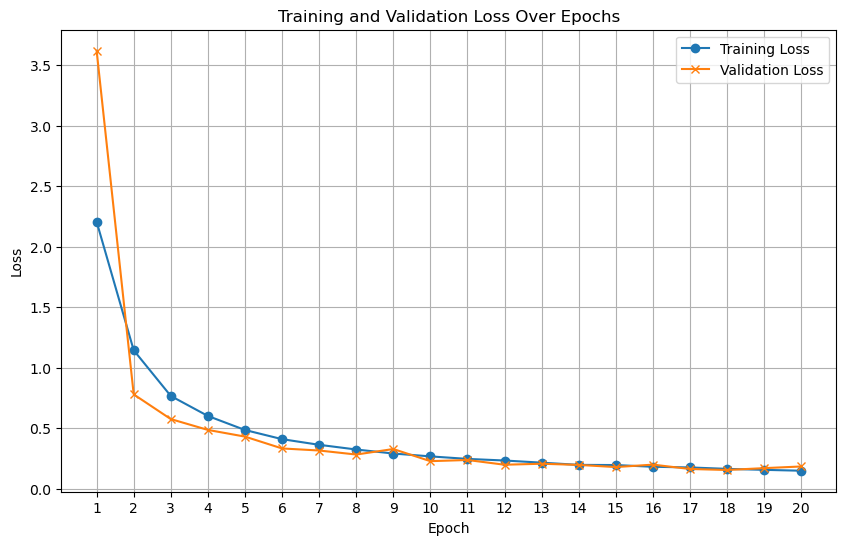

In [7]:
import matplotlib.pyplot as plt

num_epochs = 20  # Set the number of epochs

# Epoch data
epochs = list(range(1, 21))
training_loss = []
validation_loss = []

for epoch in range(num_epochs):
    # Training Phase
    model.train()  # Set the model to training mode
    running_loss = 0.0
    correct_train = 0
    total_train = 0

    for i, data in enumerate(train_loader, 0):
        inputs, labels = data['image'].to(device), data['label'].to(device)
        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        _, predicted = torch.max(outputs.data, 1)
        total_train += labels.size(0) 
        correct_train += (predicted == labels).sum().item()

    train_accuracy = 100 * correct_train / total_train

    # Validation Phase
    model.eval()  # Set the model to evaluation mode
    val_loss = 0.0
    correct = 0
    total = 0
    with torch.no_grad():
        for data in val_loader:
            images, labels = data['image'].to(device), data['label'].to(device)
            outputs = model(images)
            loss = criterion(outputs, labels)
            val_loss += loss.item()
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

    training_loss.append(running_loss/len(train_loader))
    validation_loss.append(val_loss/len(val_loader))
    print(f'Epoch {epoch+1}, Training loss: {running_loss/len(train_loader)}, Training Accuracy: {train_accuracy}%, Validation Loss: {val_loss/len(val_loader)}, Validation Accuracy: {100 * correct / total}%')

print('Finished Training')

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(epochs, training_loss, label='Training Loss', marker='o')
plt.plot(epochs, validation_loss, label='Validation Loss', marker='x')
plt.title('Training and Validation Loss Over Epochs')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.show()

In [8]:
# Save the model state dictionary
torch.save(model.state_dict(), 'C:\\Users\\niuka\\GTSRB_Final_Training_Images\\GTSRB\\model_state_dict.pth')

In [9]:
model =models.mobilenet_v3_small() # Recreate the model with the same parameters
num_classes = 43
classifier = nn.Sequential(
    nn.Linear(576,250),
    nn.ReLU(),
    nn.Dropout(0.5),
    nn.Linear(250,43)
    )
model.classifier = classifier
model = model.to(device)
model.load_state_dict(torch.load('C:\\Users\\niuka\\GTSRB_Final_Training_Images\\GTSRB\\model_state_dict.pth'))
model.eval()  # Set the model to evaluation mode

MobileNetV3(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(16, eps=0.001, momentum=0.01, affine=True, track_running_stats=True)
      (2): Hardswish()
    )
    (1): InvertedResidual(
      (block): Sequential(
        (0): Conv2dNormActivation(
          (0): Conv2d(16, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), groups=16, bias=False)
          (1): BatchNorm2d(16, eps=0.001, momentum=0.01, affine=True, track_running_stats=True)
          (2): ReLU(inplace=True)
        )
        (1): SqueezeExcitation(
          (avgpool): AdaptiveAvgPool2d(output_size=1)
          (fc1): Conv2d(16, 8, kernel_size=(1, 1), stride=(1, 1))
          (fc2): Conv2d(8, 16, kernel_size=(1, 1), stride=(1, 1))
          (activation): ReLU()
          (scale_activation): Hardsigmoid()
        )
        (2): Conv2dNormActivation(
          (0): Conv2d(16, 16, kernel_size=(1, 1), 

In [10]:
model.eval()  # Set the model to evaluation mode

correct = 0
total = 0
with torch.no_grad():  # No need to track gradients for testing
    for data in test_loader:
        images, labels = data['image'].to(device), data['label'].to(device)
        outputs = model(images)
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

test_accuracy = 100 * correct / total
print(f'Accuracy of the model on the test images: {test_accuracy}%')

ModelAccuracies.append(test_accuracy)

Accuracy of the model on the test images: 95.06970418225093%


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


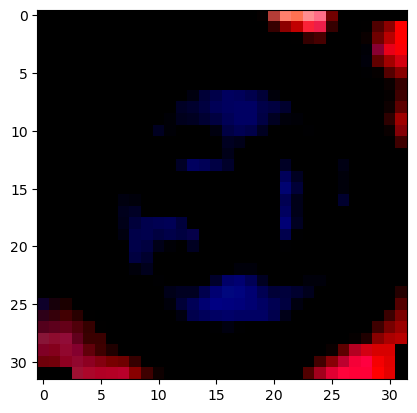

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 26


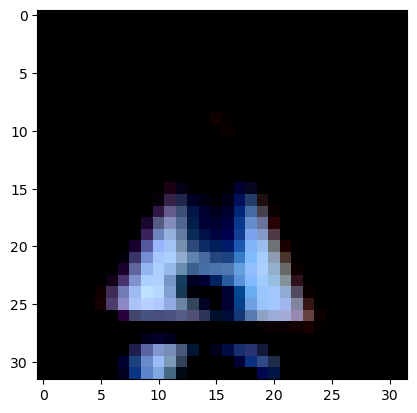

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 28
Predicted Label: 29


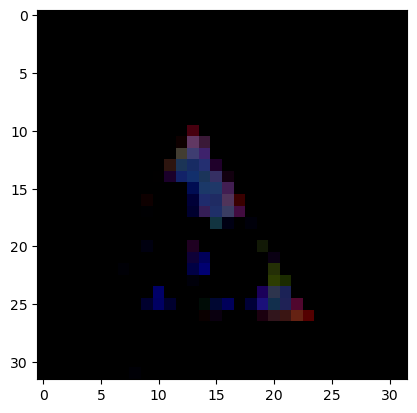

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 28
Predicted Label: 28


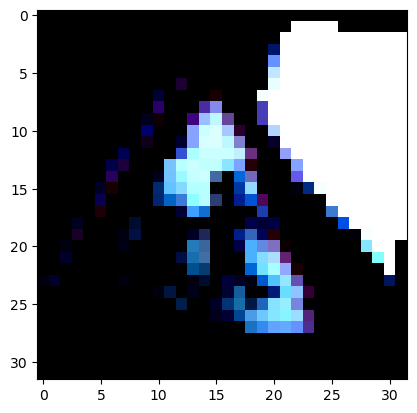

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


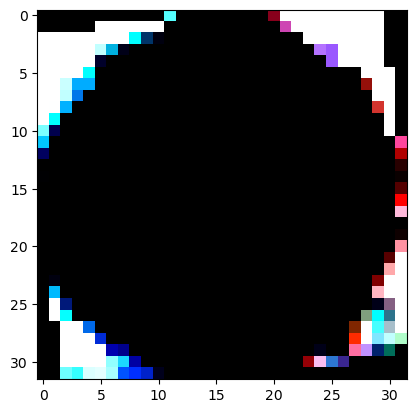

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


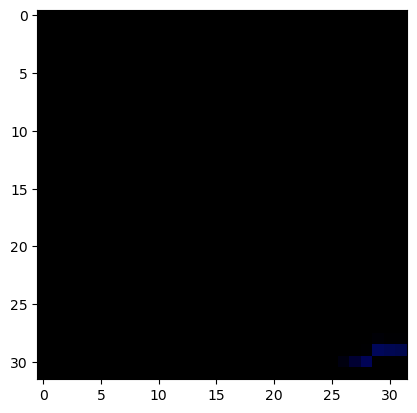

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 22
Predicted Label: 22


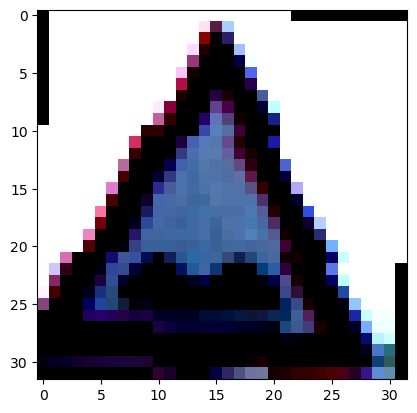

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


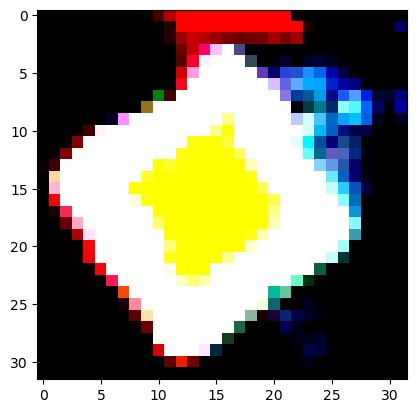

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 21


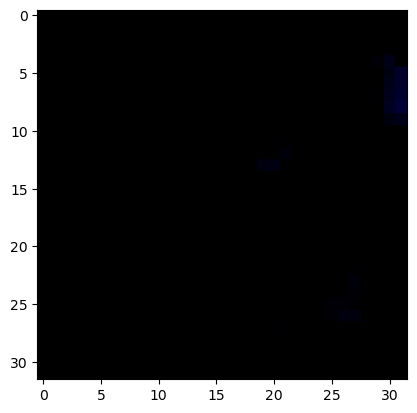

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 5


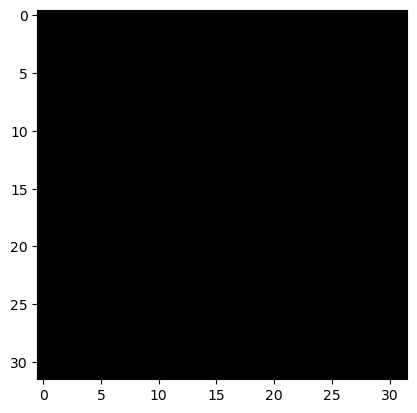

True Label: 36


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 36


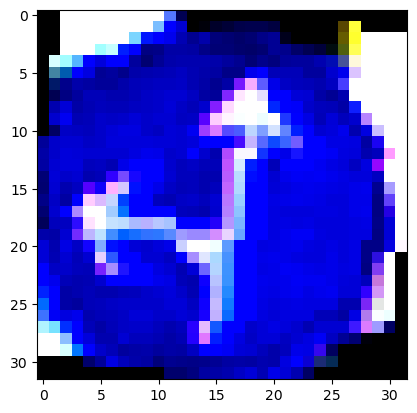

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


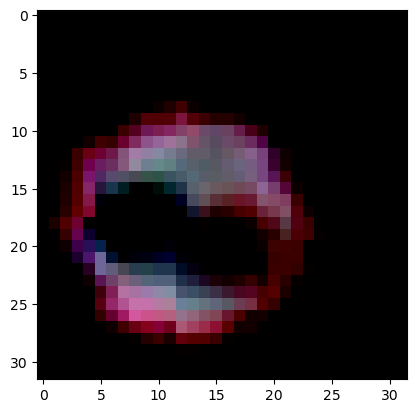

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


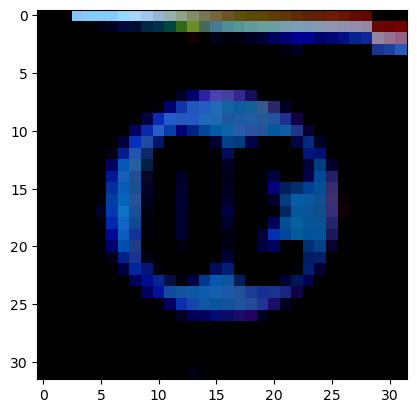

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


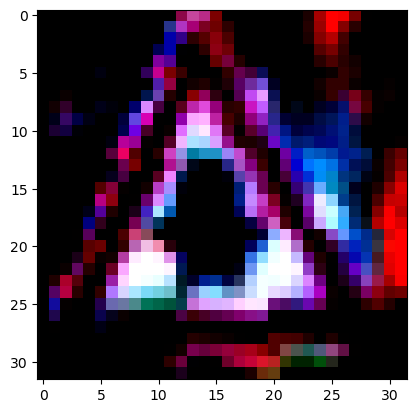

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 31
Predicted Label: 31


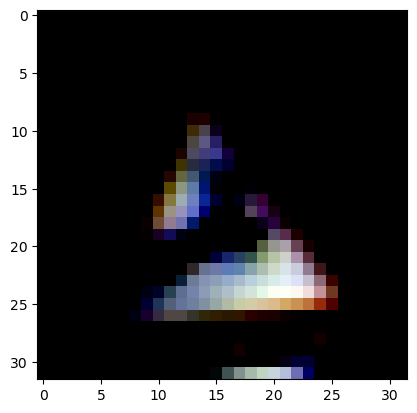

True Label: 35


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 35


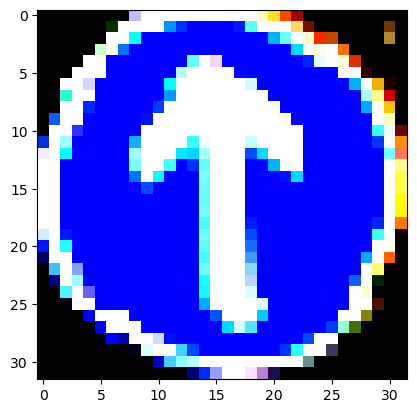

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 22
Predicted Label: 22


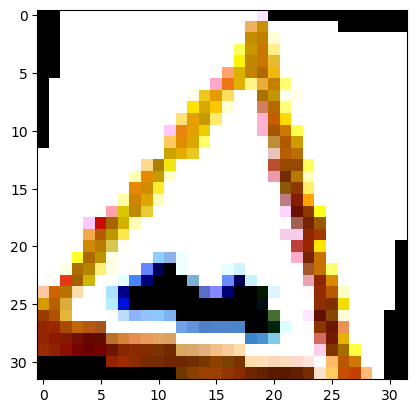

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


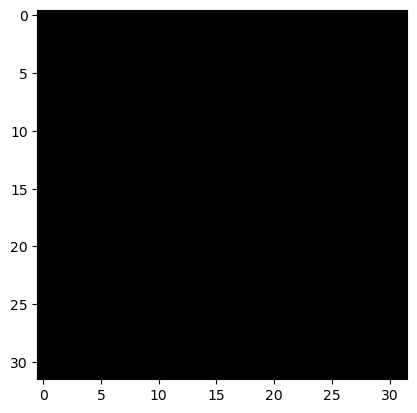

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


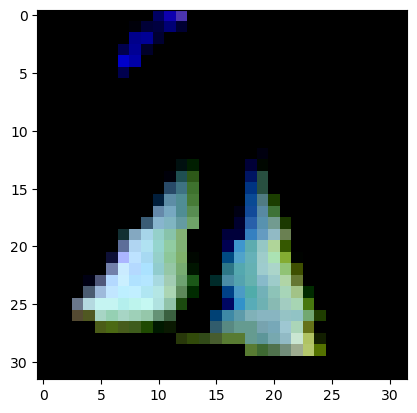

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


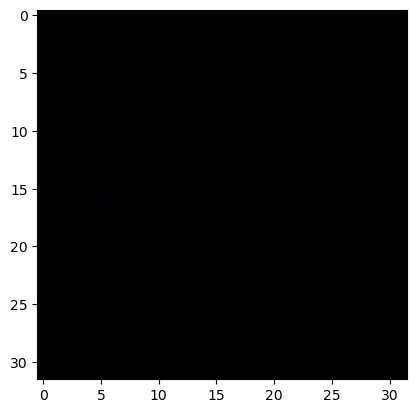

True Label: 18


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 18


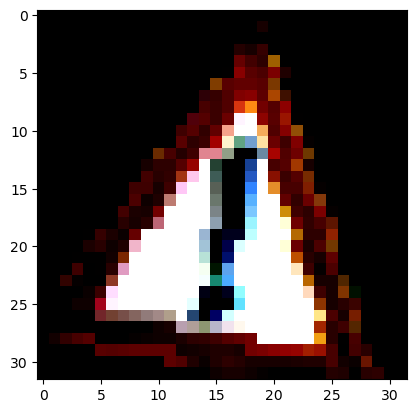

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


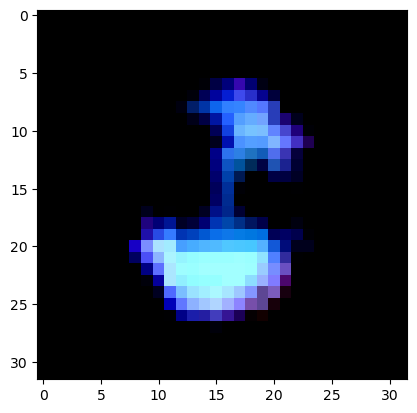

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


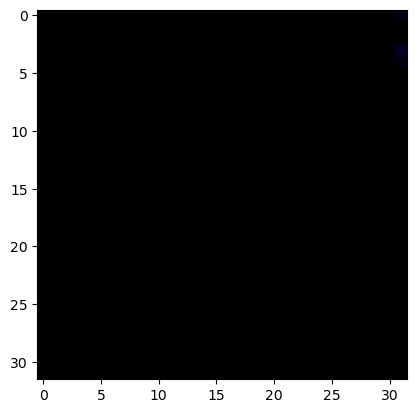

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


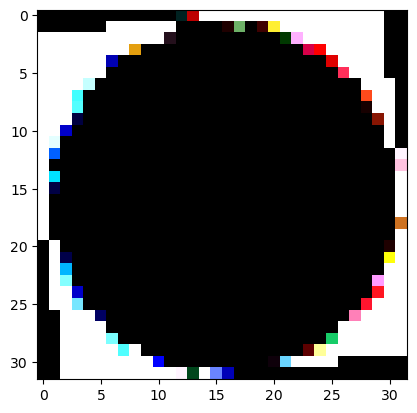

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


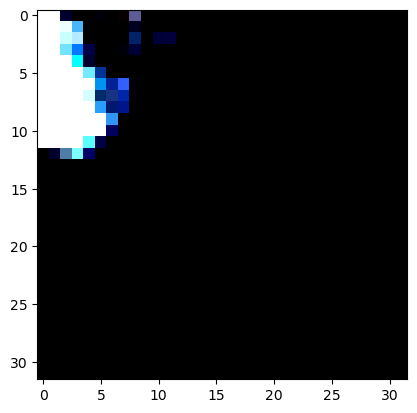

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


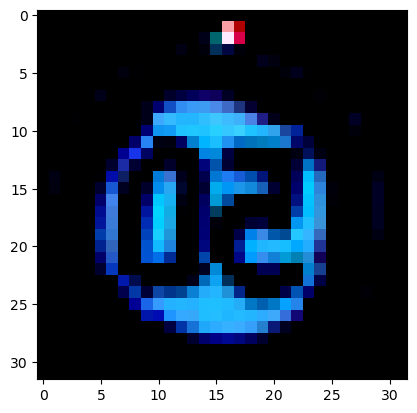

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


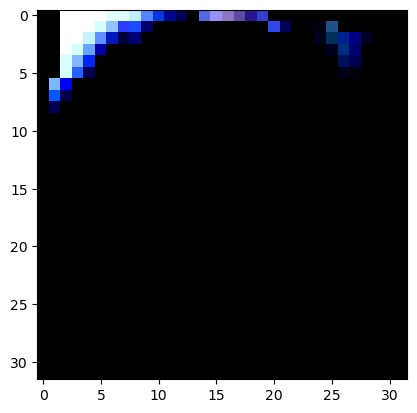

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 22
Predicted Label: 22


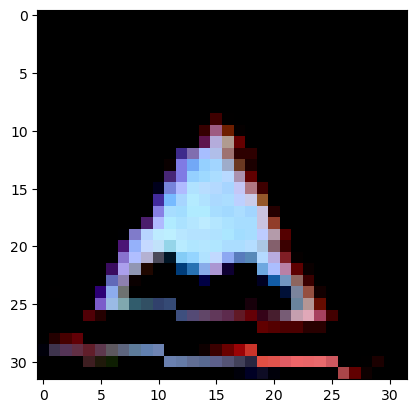

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


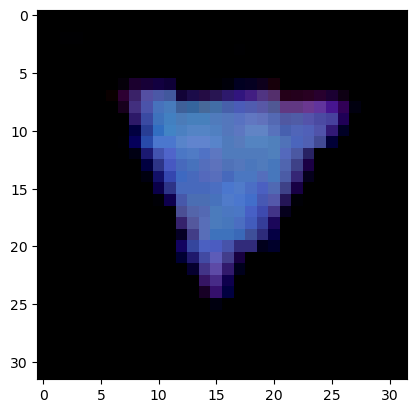

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


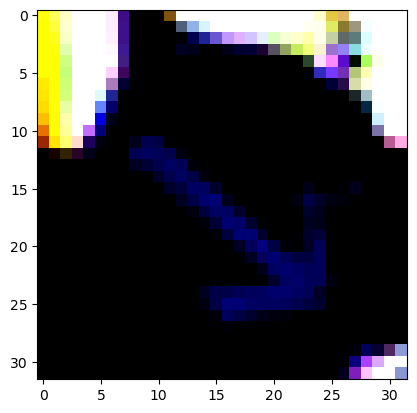

True Label: 8


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 8


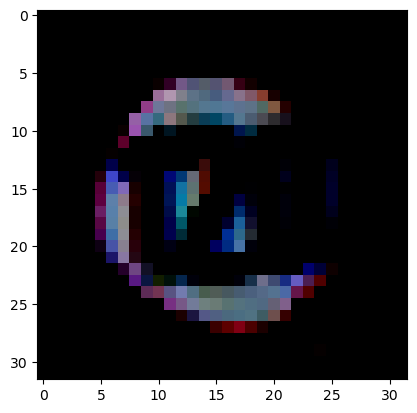

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


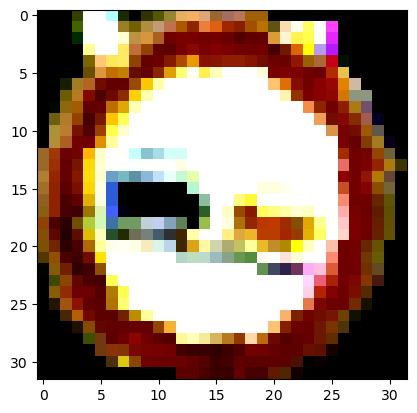

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


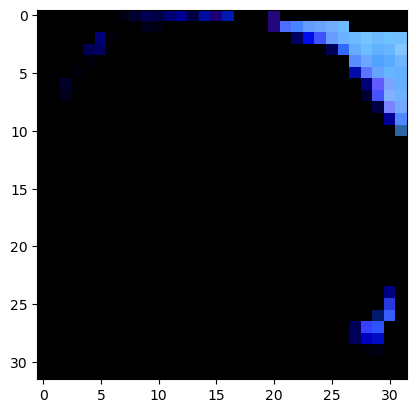

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


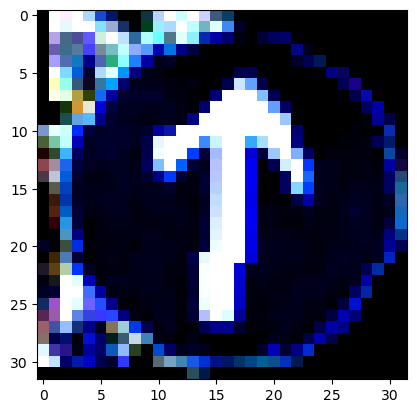

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 39


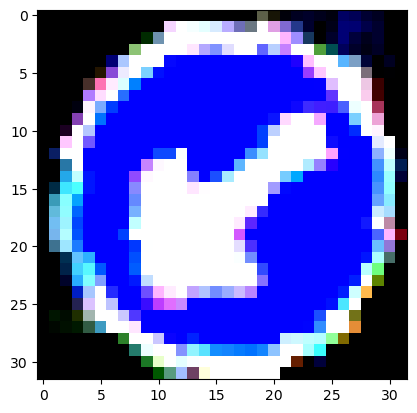

True Label: 13


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 13


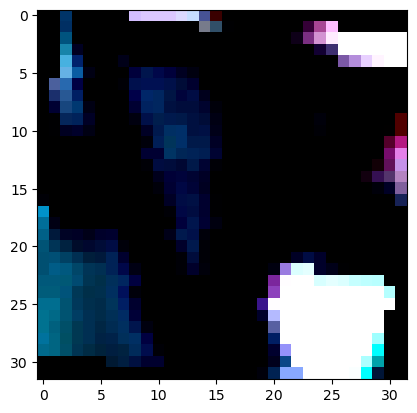

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


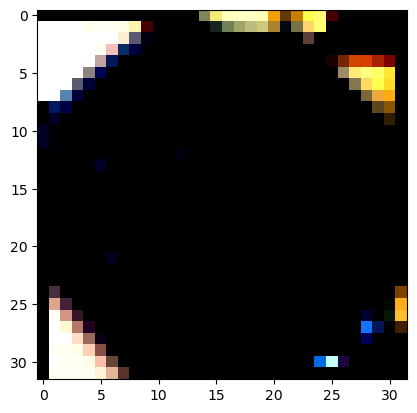

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 22
Predicted Label: 22


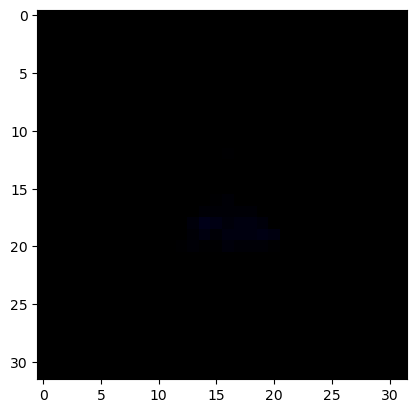

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


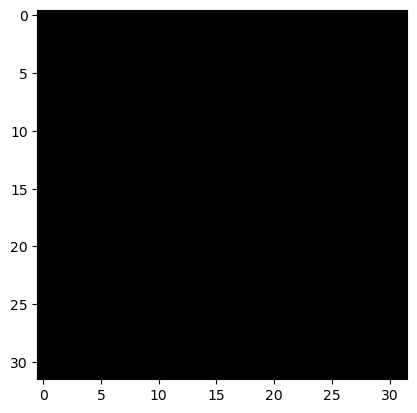

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


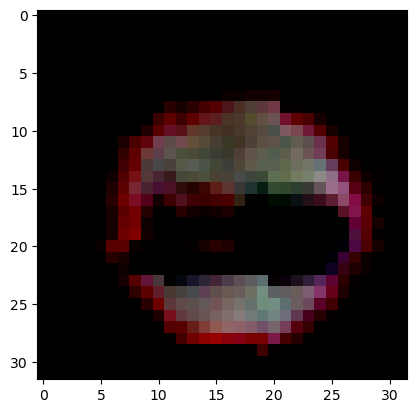

True Label: 35
Predicted Label: 35


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


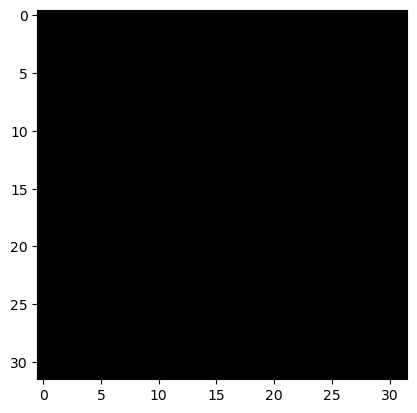

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


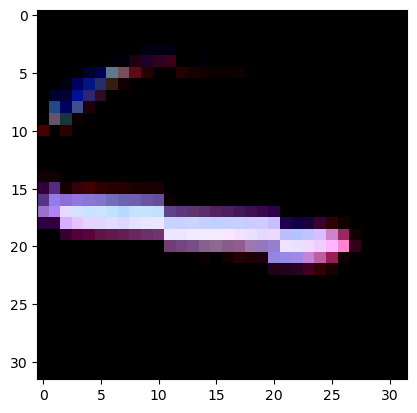

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


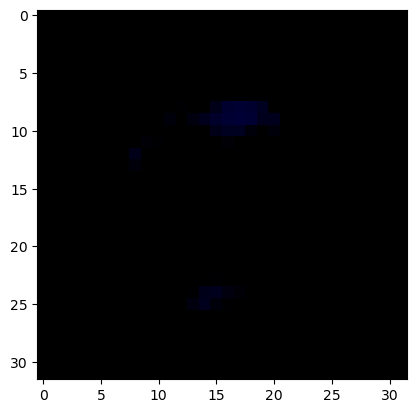

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


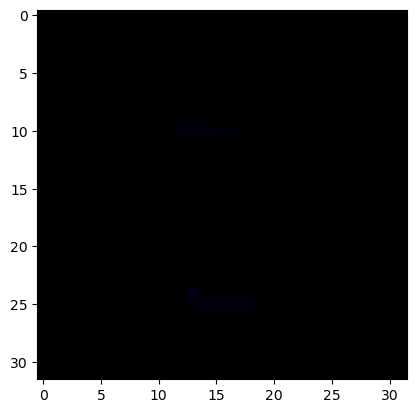

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 26
Predicted Label: 26


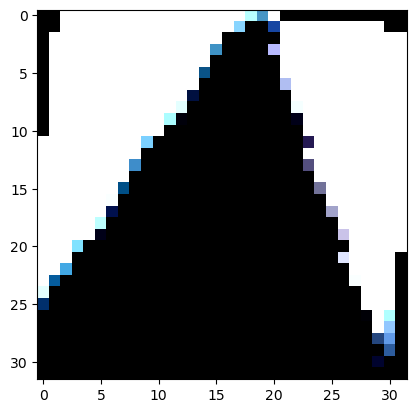

True Label: 35


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 35


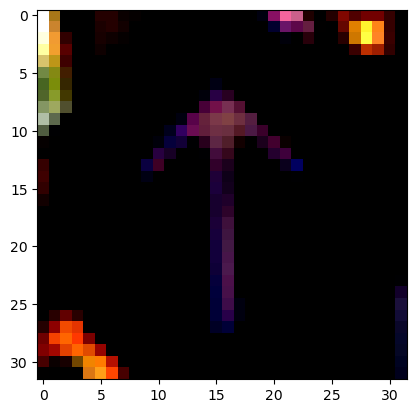

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


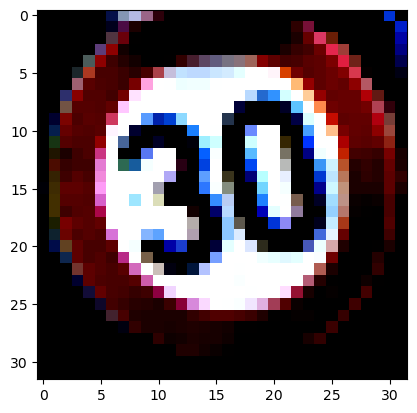

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


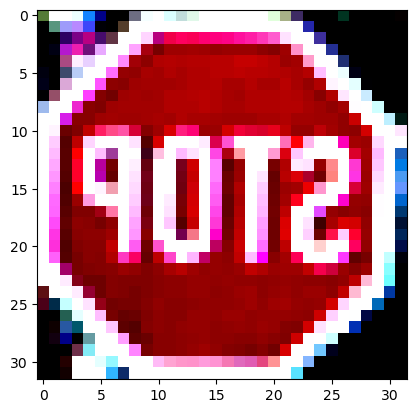

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


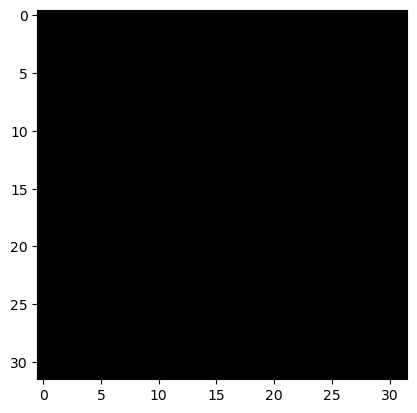

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


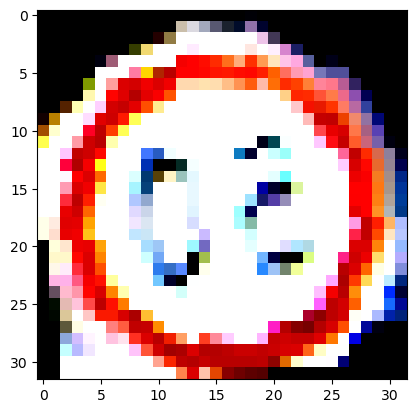

True Label: 12


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 12


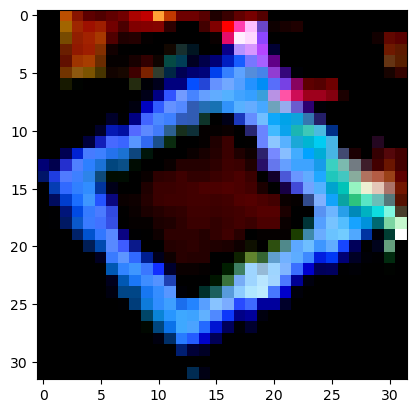

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 31
Predicted Label: 31


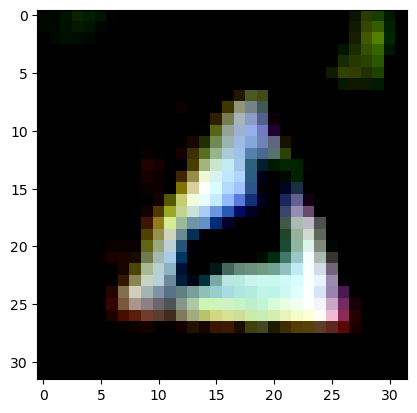

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


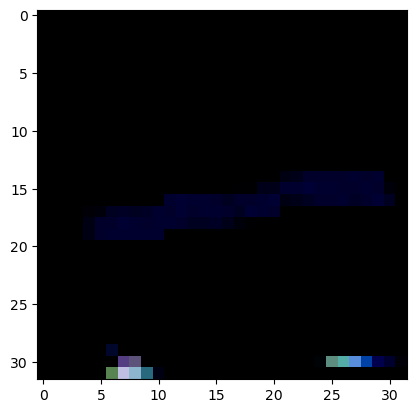

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


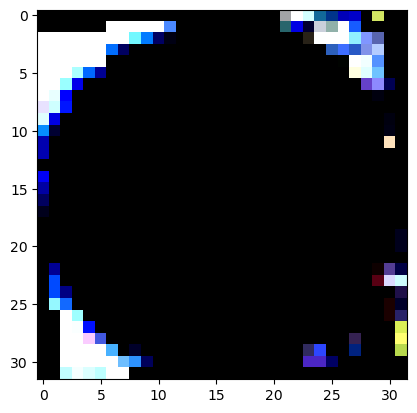

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 16
Predicted Label: 16


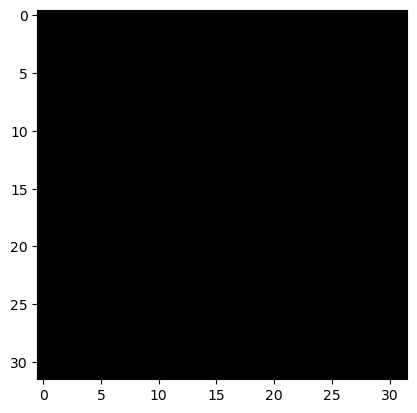

True Label: 1


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 1


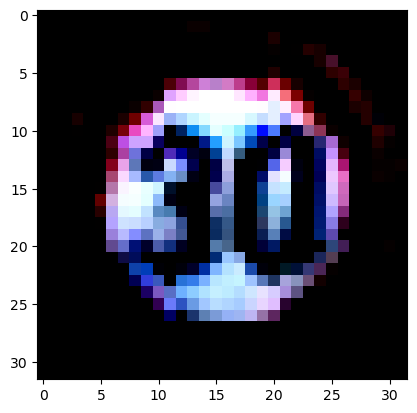

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


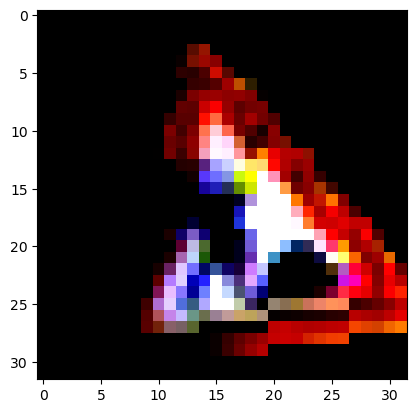

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


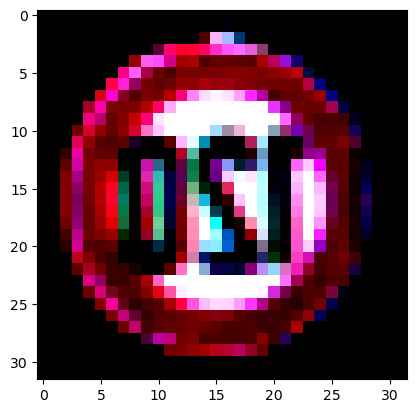

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


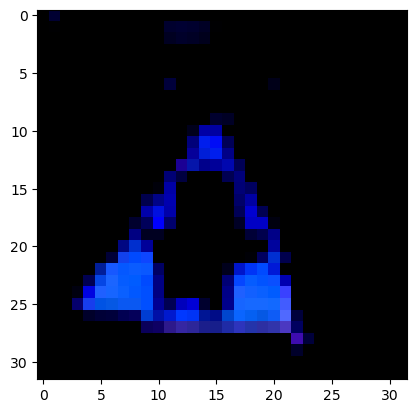

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


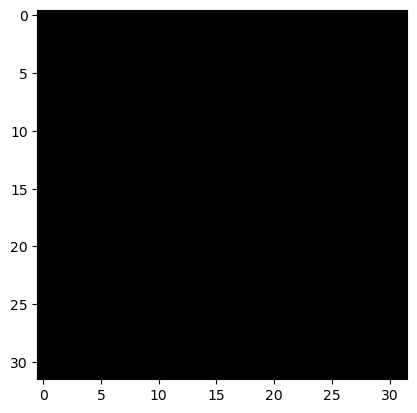

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


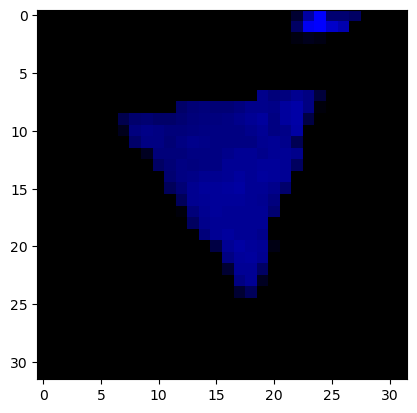

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 20
Predicted Label: 20


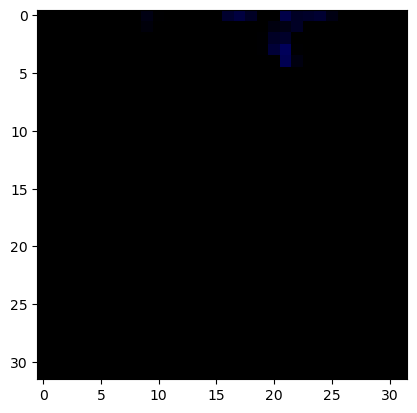

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


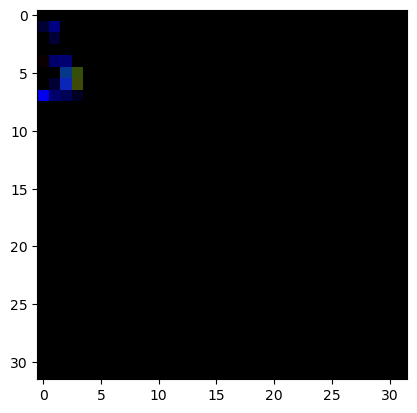

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


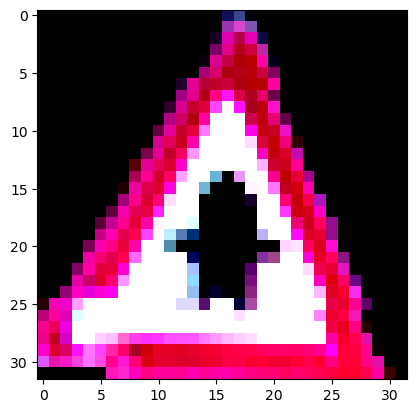

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


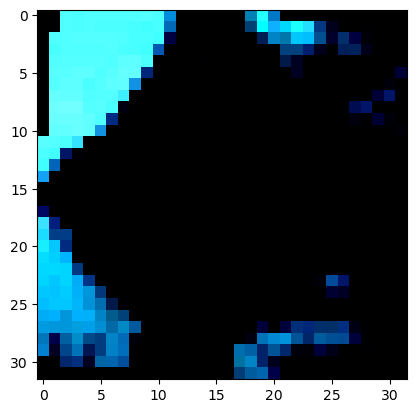

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


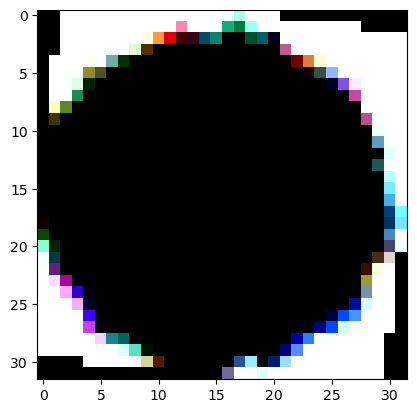

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 28
Predicted Label: 28


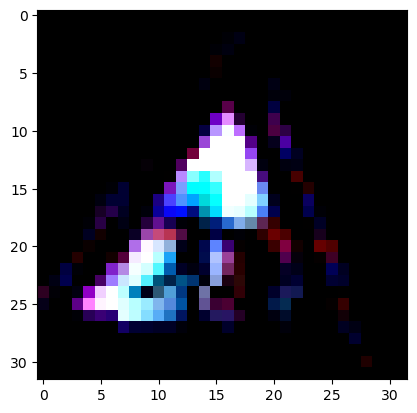

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 33
Predicted Label: 33


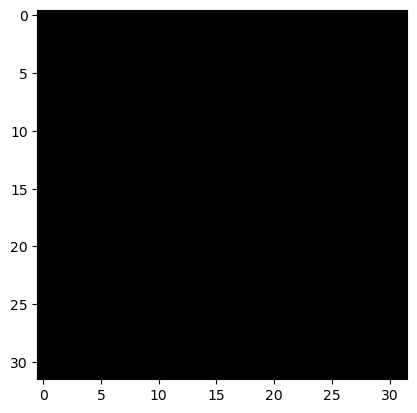

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


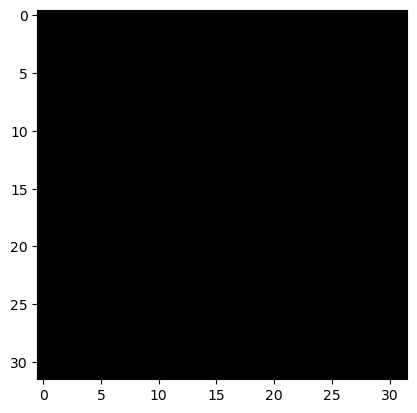

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


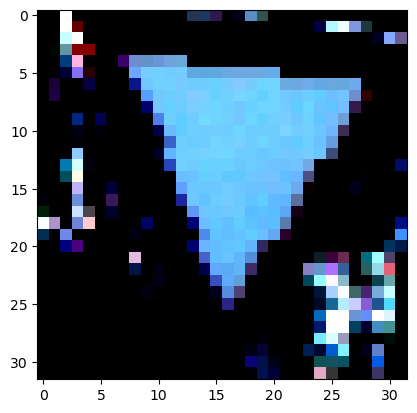

True Label: 2


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 2


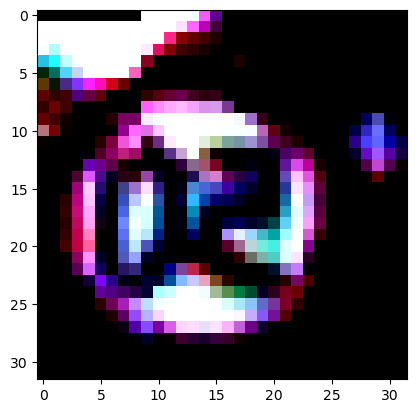

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


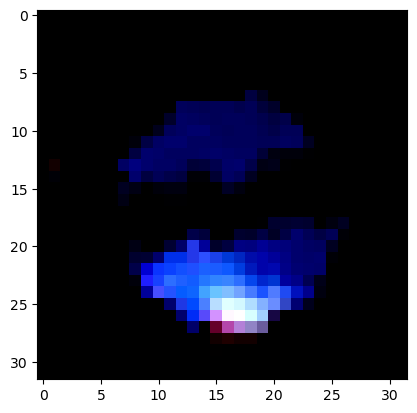

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 41
Predicted Label: 41


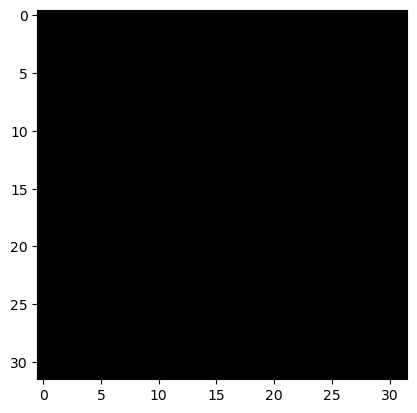

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 19
Predicted Label: 19


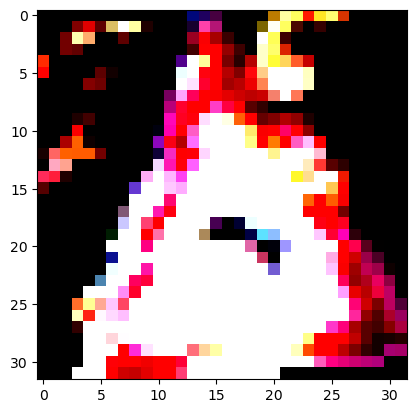

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


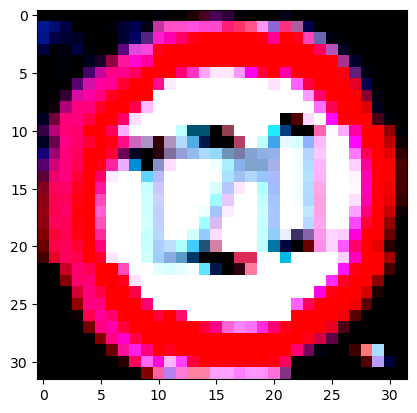

True Label: 38


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 38


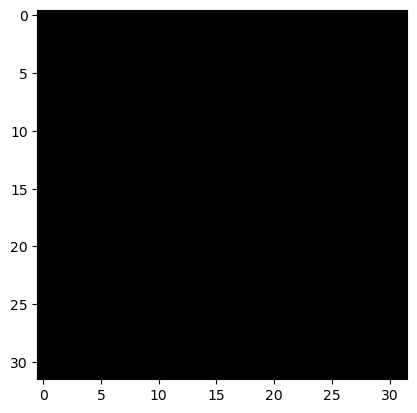

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


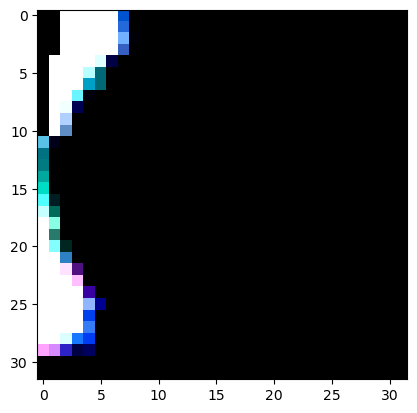

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 33
Predicted Label: 33


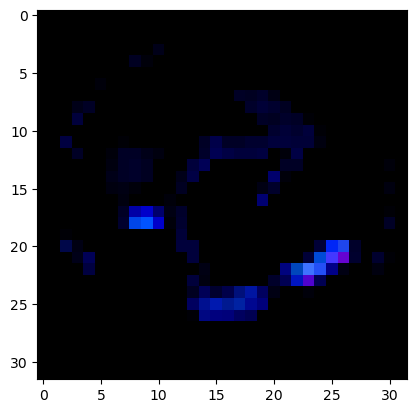

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


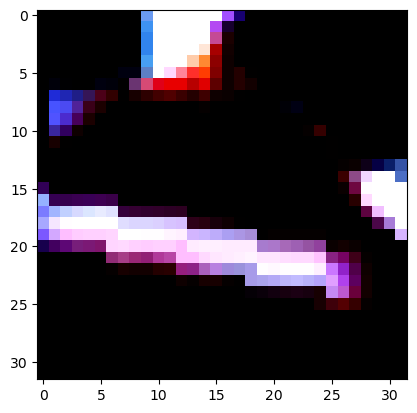

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 6
Predicted Label: 6


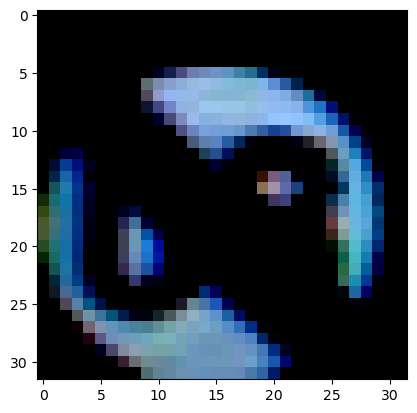

True Label: 38


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 38


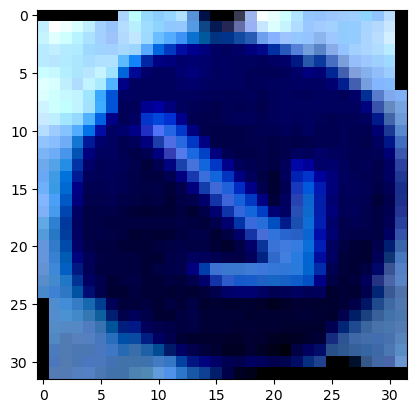

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


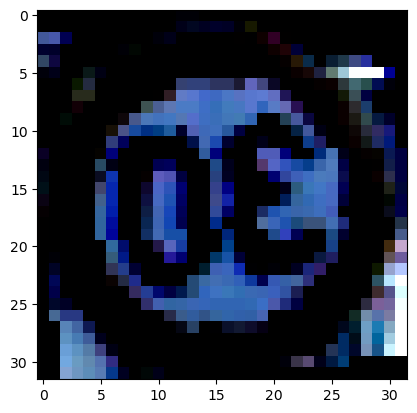

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


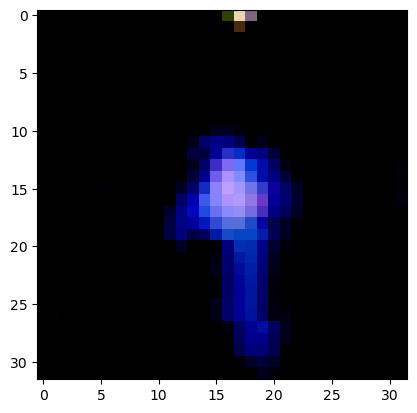

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


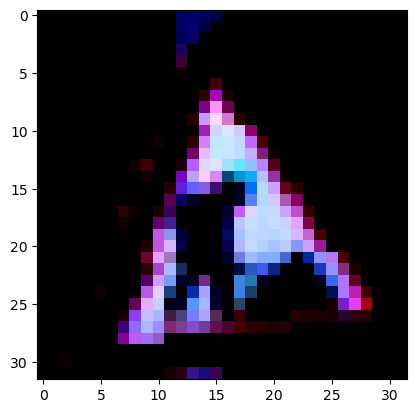

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


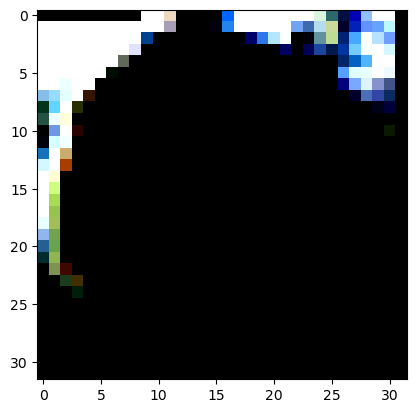

True Label: 30


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 30


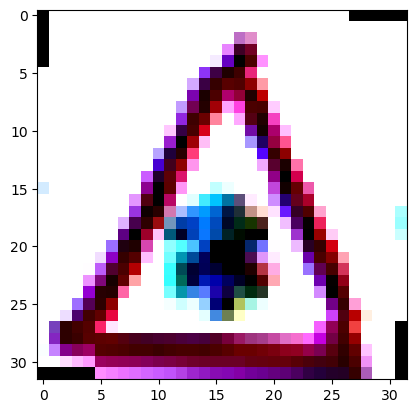

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


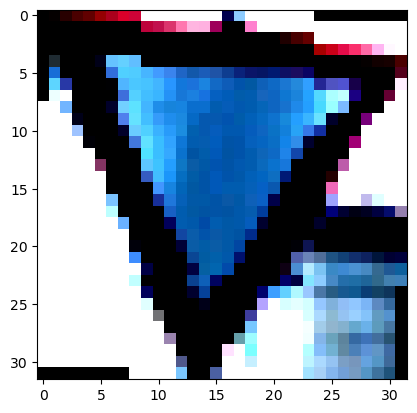

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 40
Predicted Label: 40


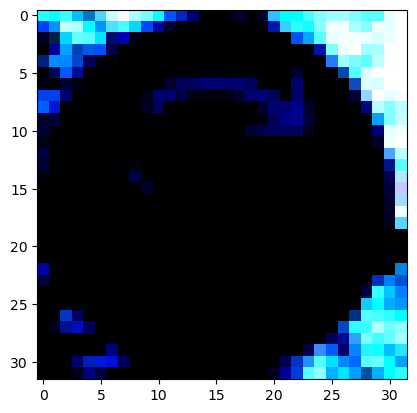

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


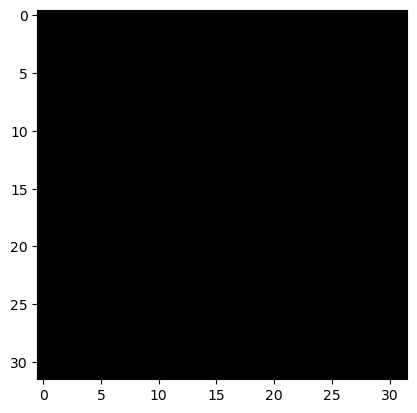

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


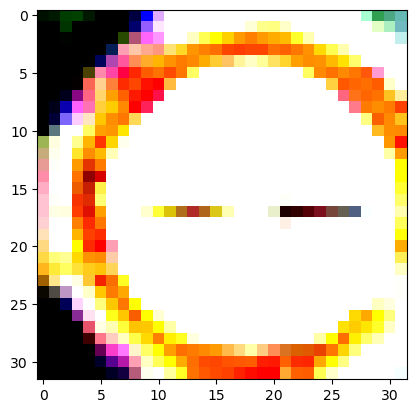

True Label: 38


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 38


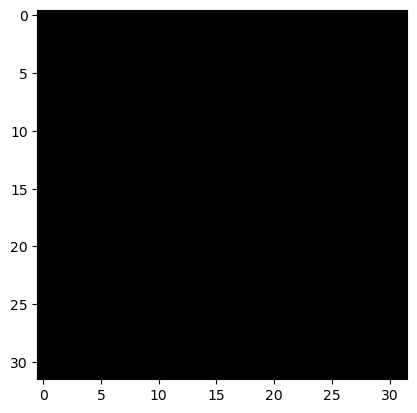

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 1


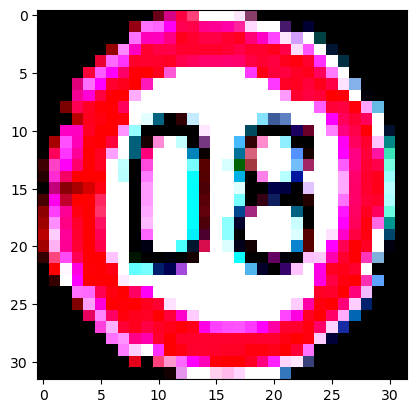

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


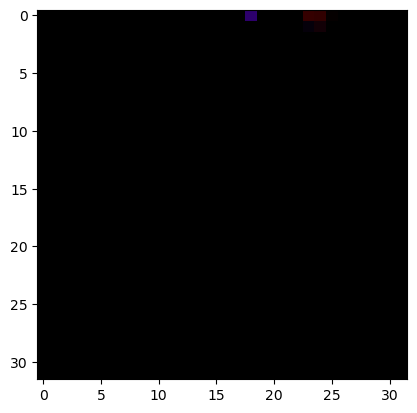

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


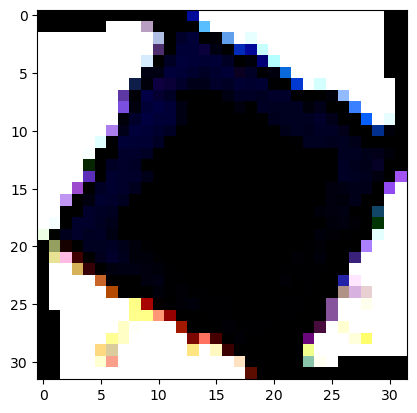

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


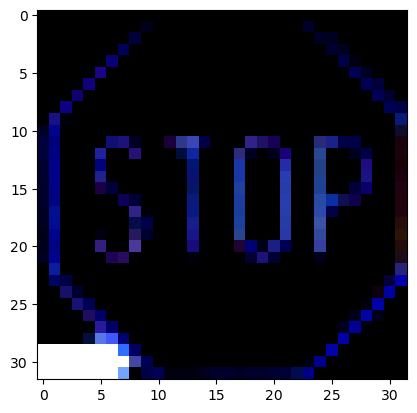

True Label: 17


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 17


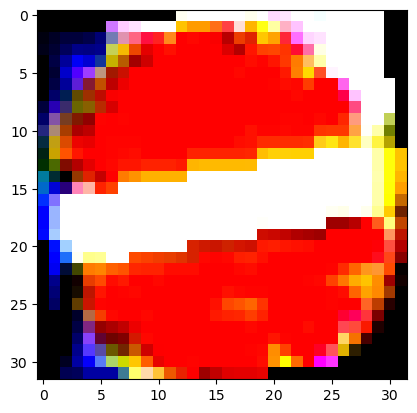

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


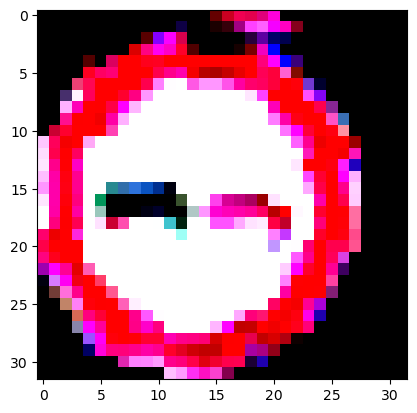

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


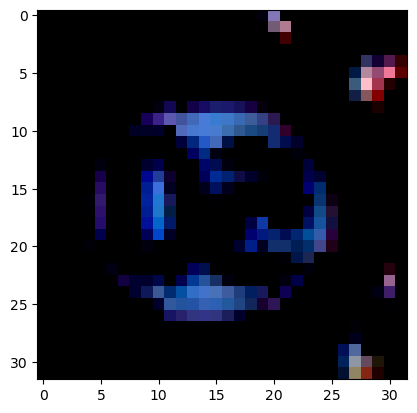

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


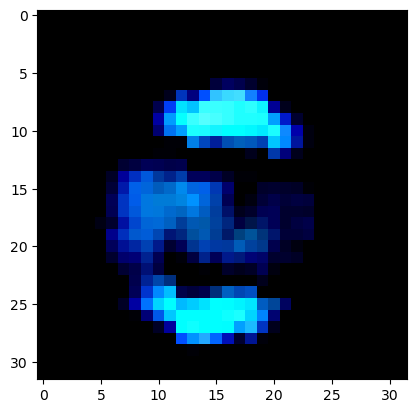

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


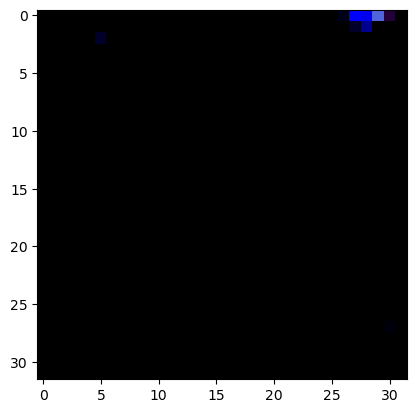

True Label: 22


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 22


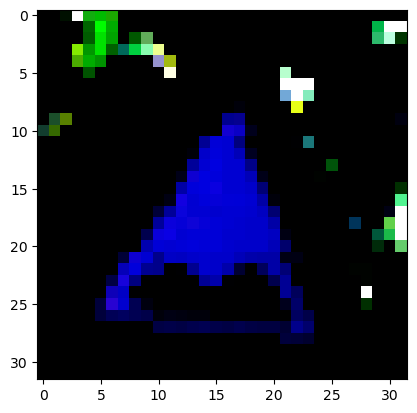

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


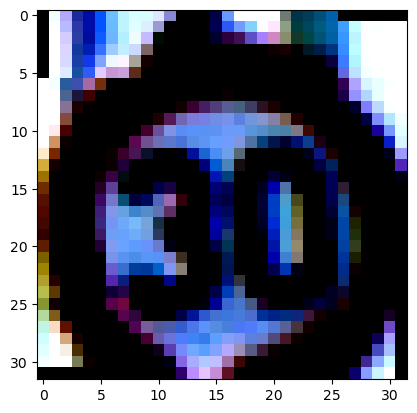

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 30
Predicted Label: 30


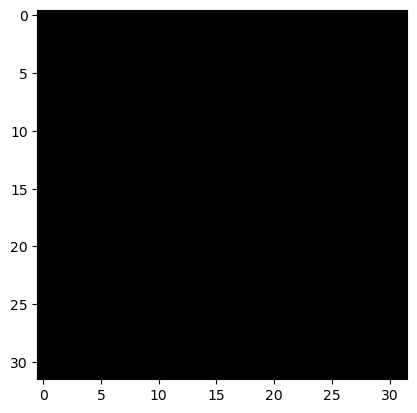

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


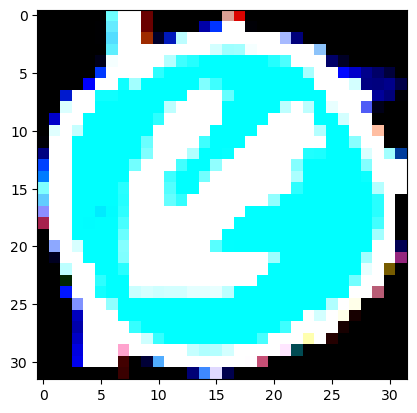

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


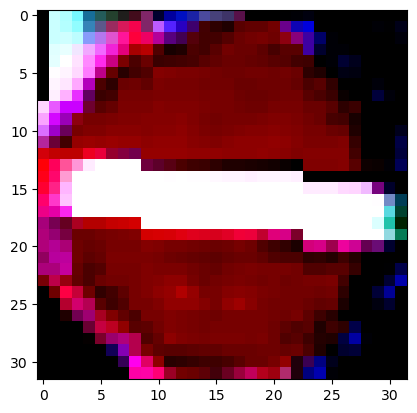

True Label: 4


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 4


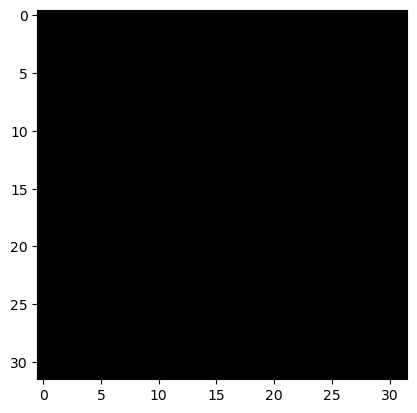

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


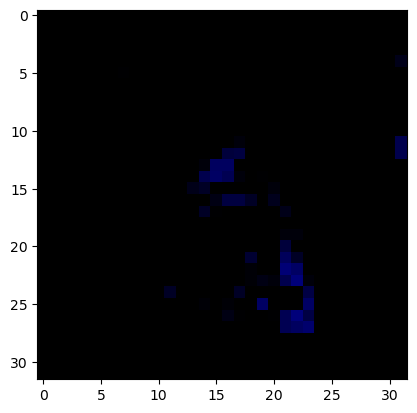

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


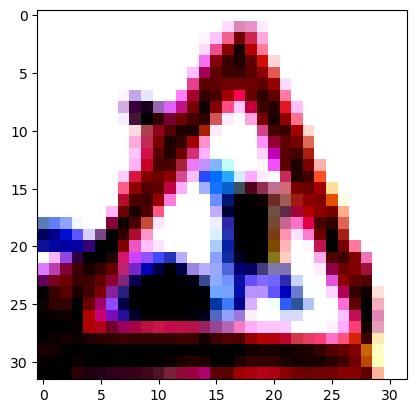

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


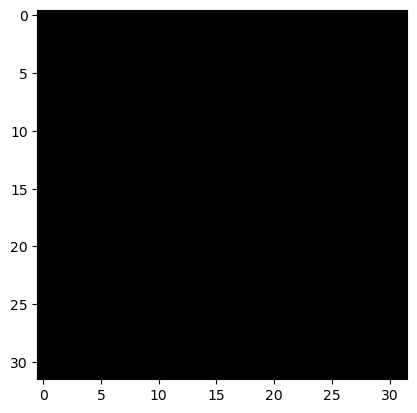

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


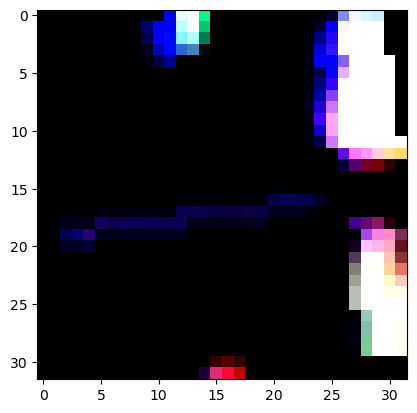

True Label: 10


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 10


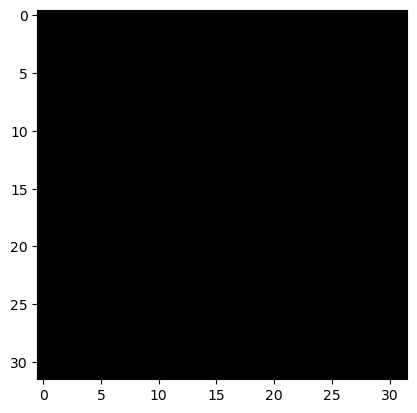

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 16
Predicted Label: 16


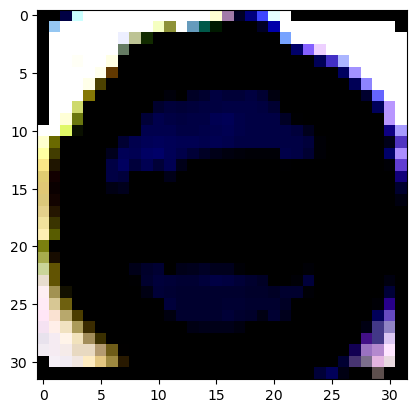

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


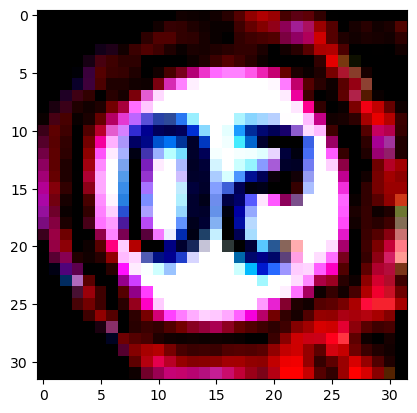

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


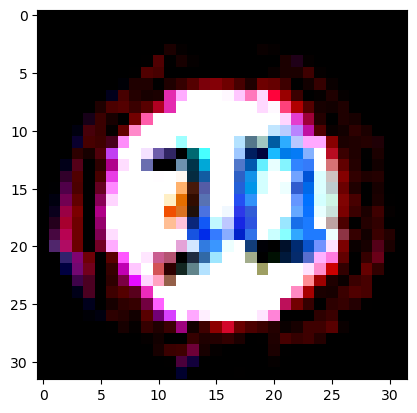

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


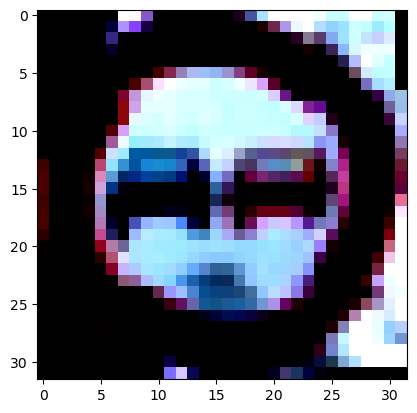

True Label: 23


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 23


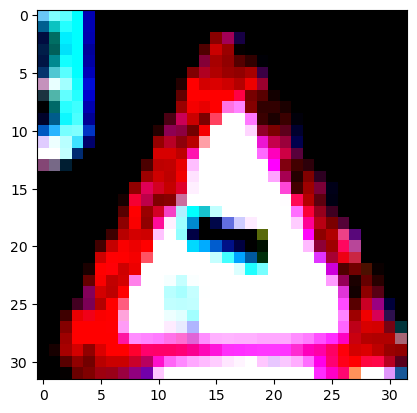

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 6
Predicted Label: 6


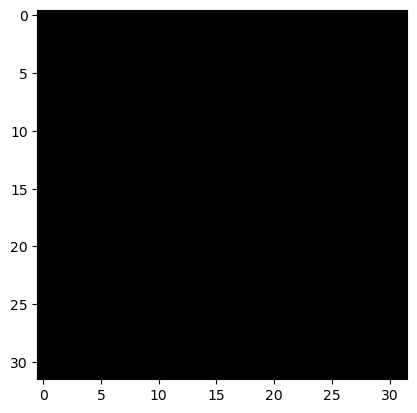

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


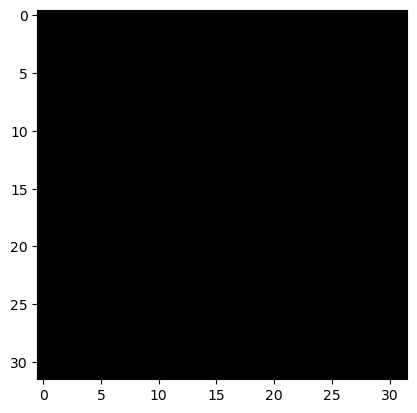

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


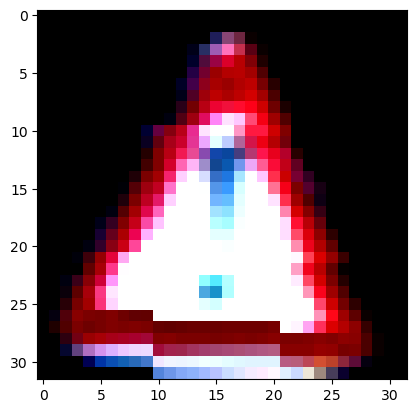

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


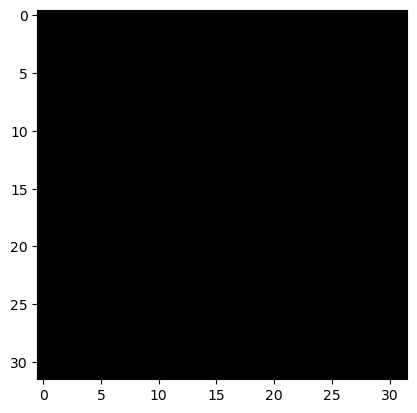

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 31
Predicted Label: 31


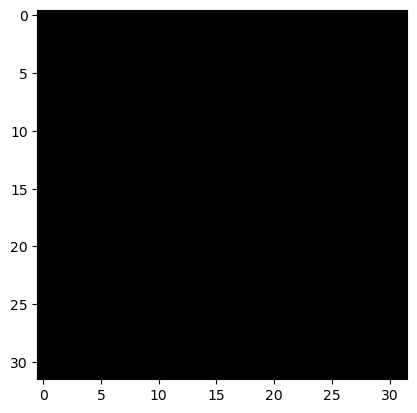

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


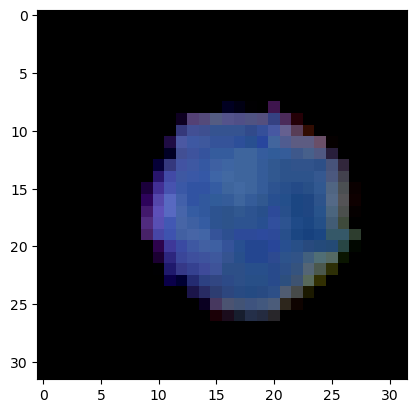

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


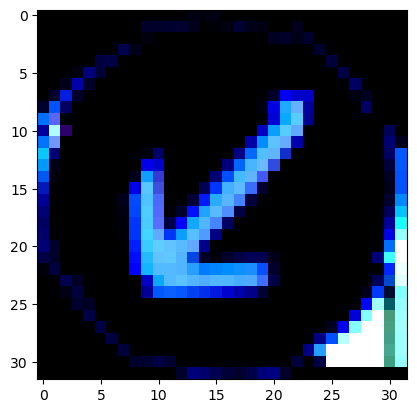

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


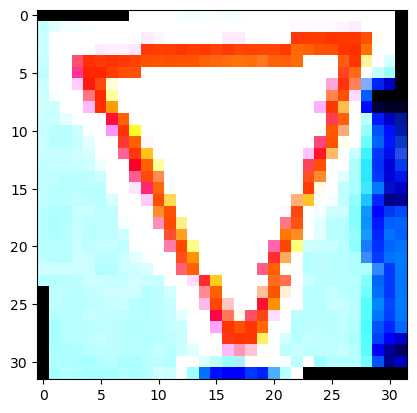

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


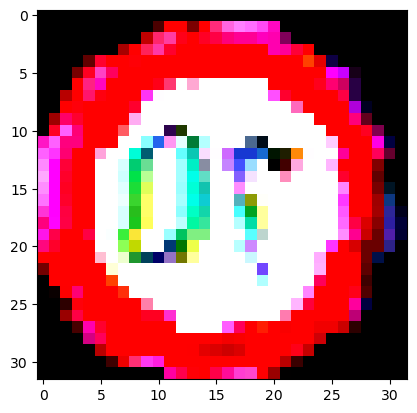

True Label: 4


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 4


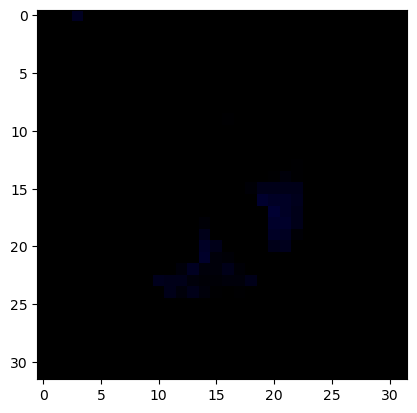

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


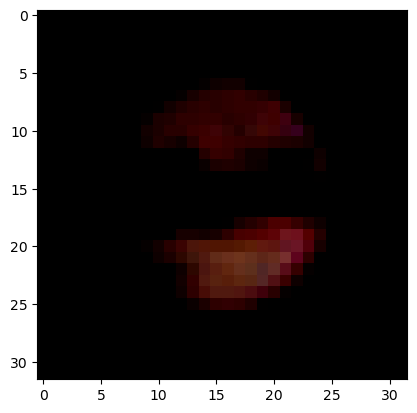

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


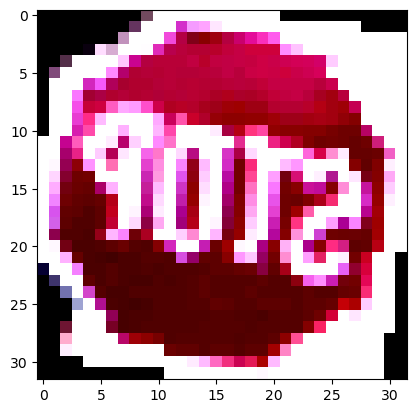

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


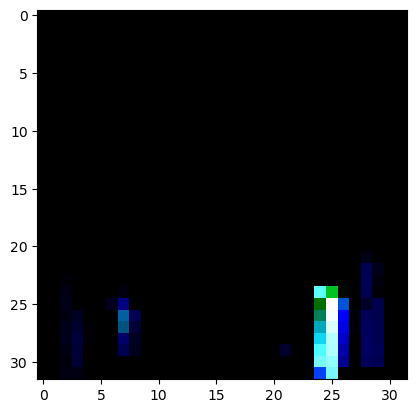

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


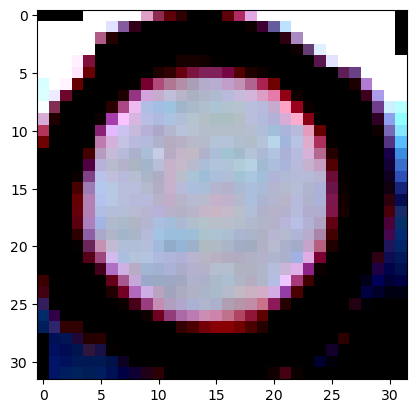

True Label: 15


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 15


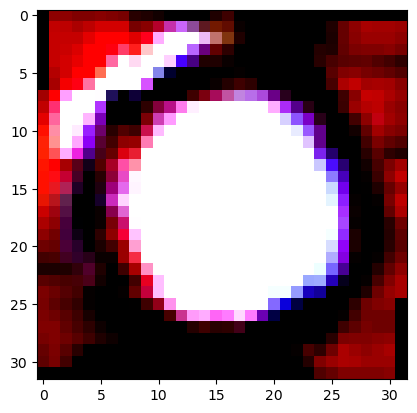

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


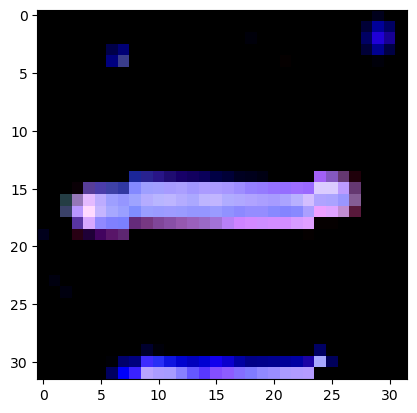

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


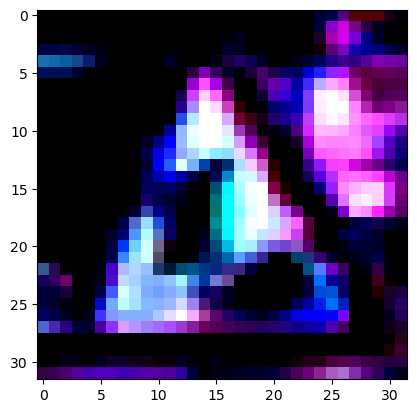

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


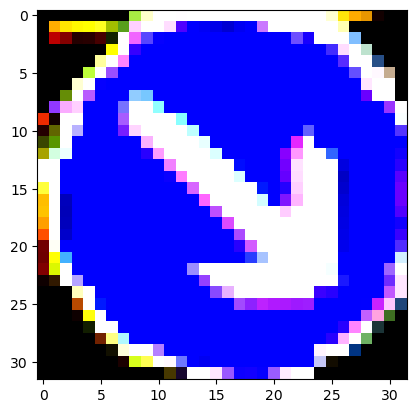

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


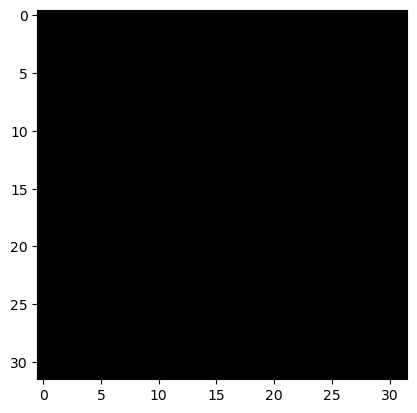

True Label: 38


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 38


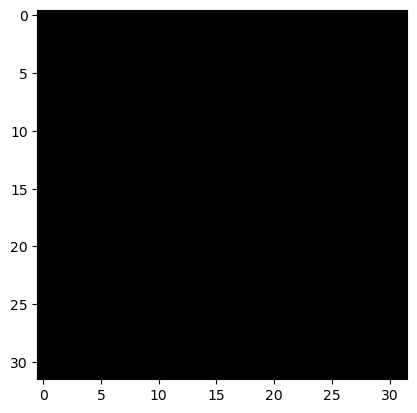

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


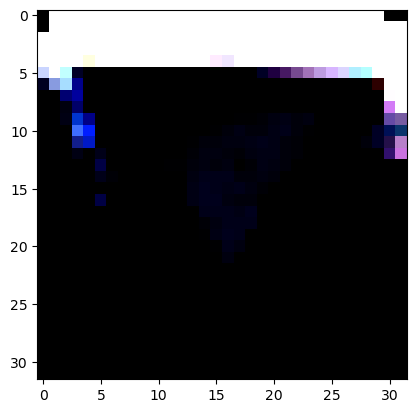

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 28
Predicted Label: 28


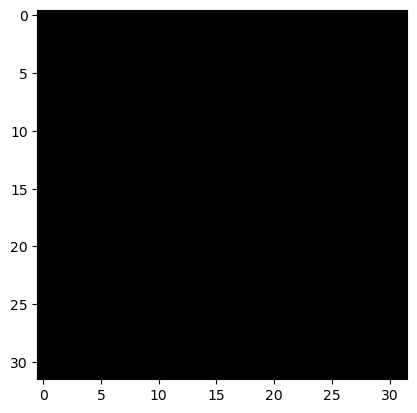

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 40
Predicted Label: 40


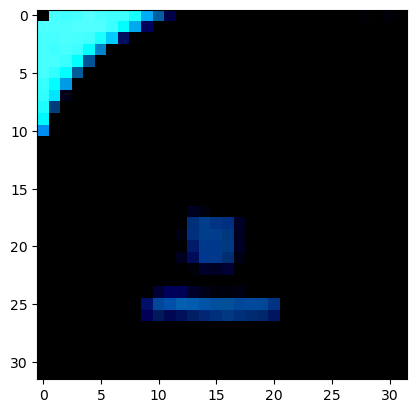

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


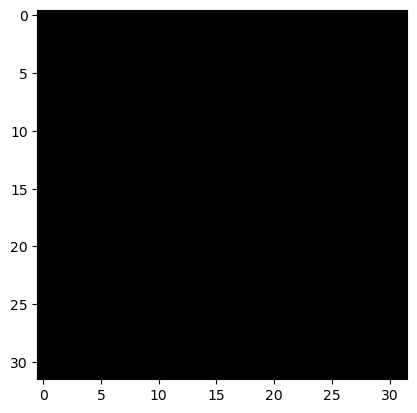

True Label: 36


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 36


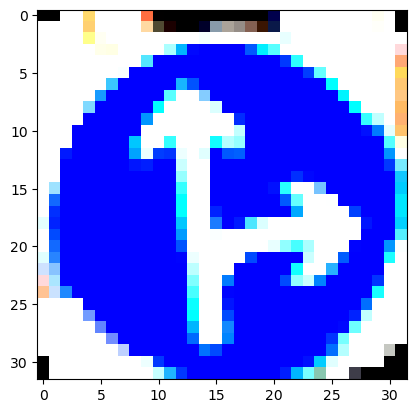

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


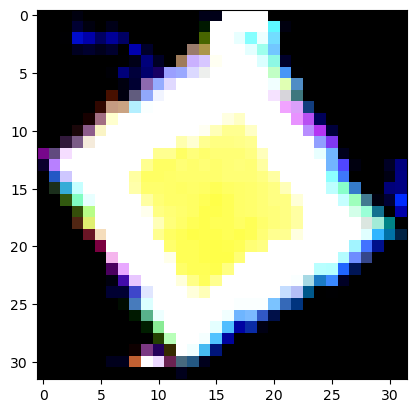

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


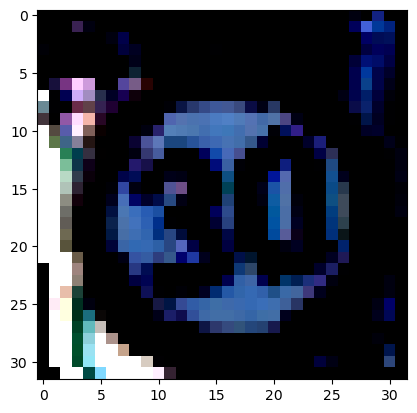

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


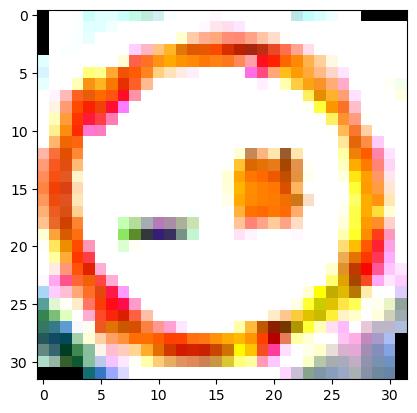

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


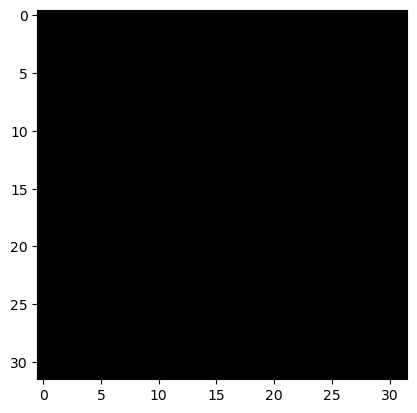

True Label: 9


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 9


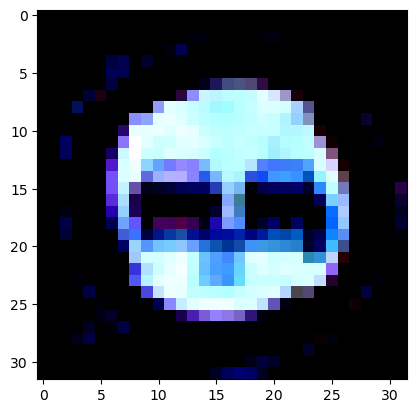

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


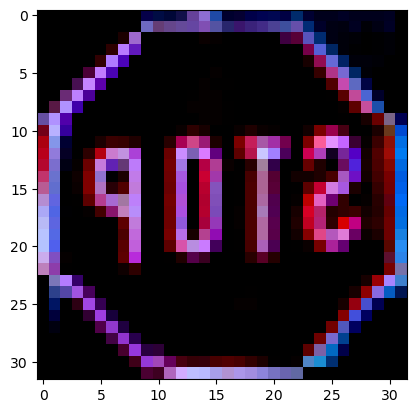

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 28
Predicted Label: 28


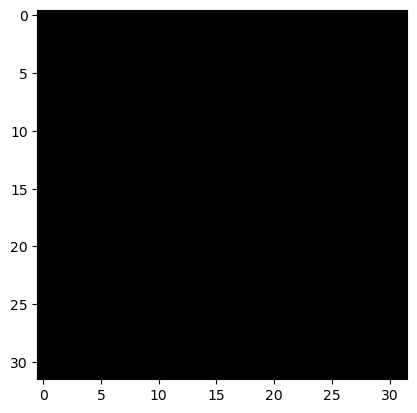

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


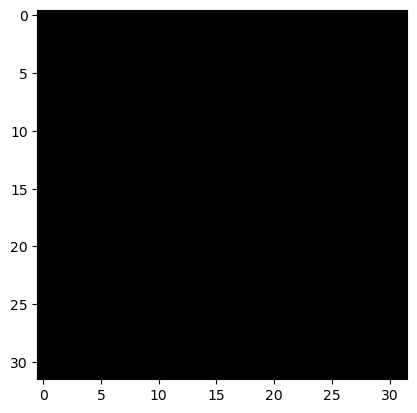

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


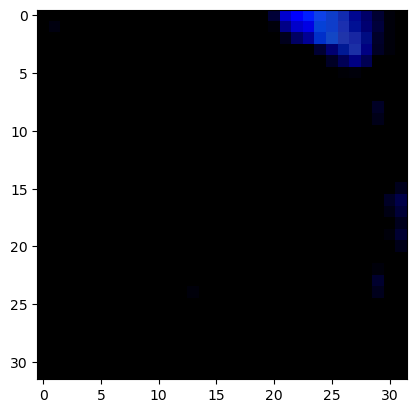

True Label: 25


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 25


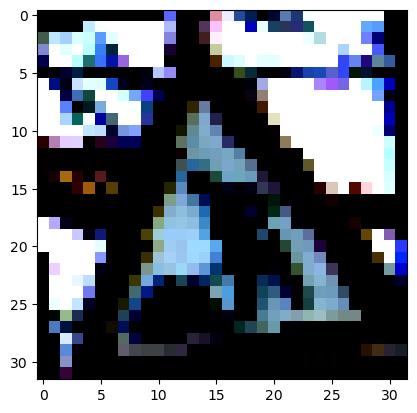

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


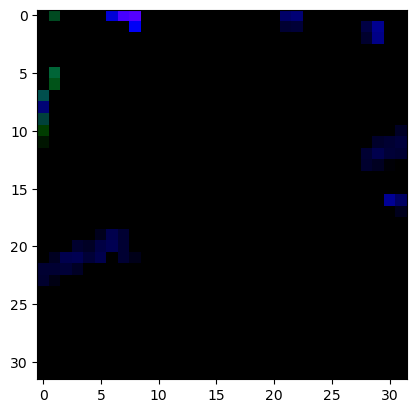

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


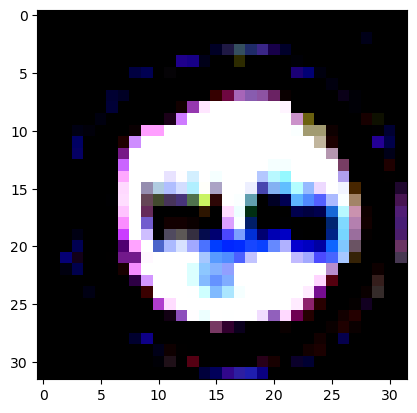

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


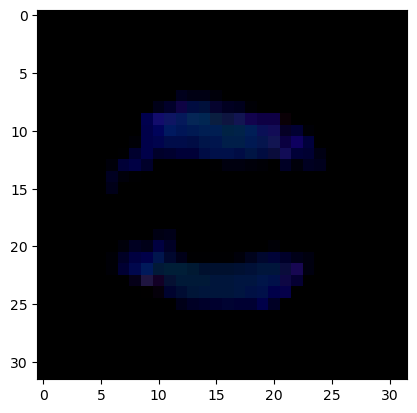

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


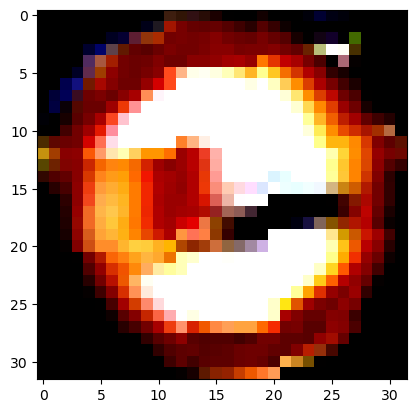

True Label: 1


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 1


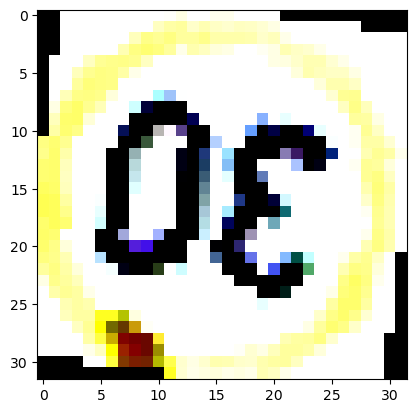

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


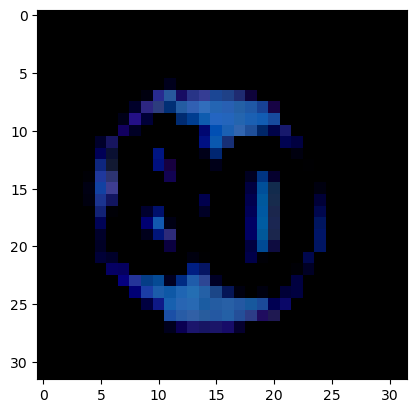

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


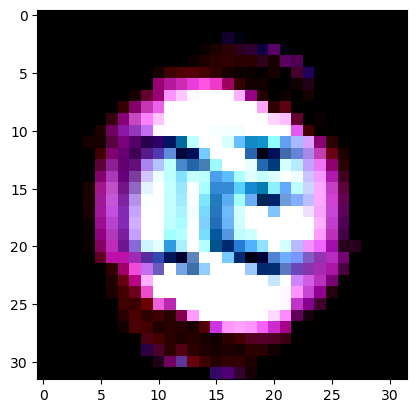

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


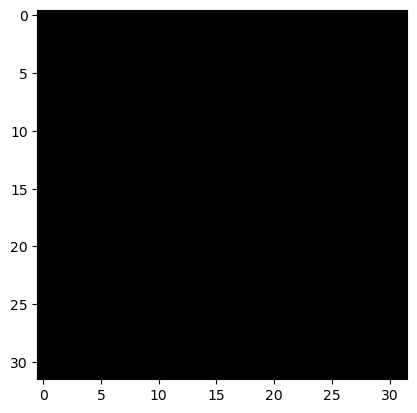

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


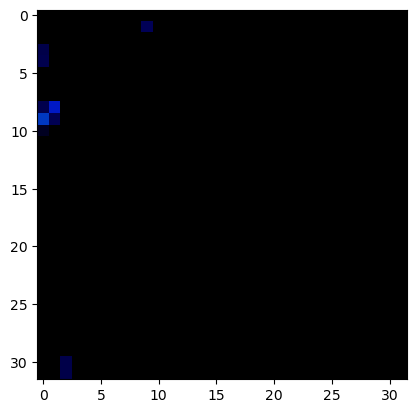

True Label: 6


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 6


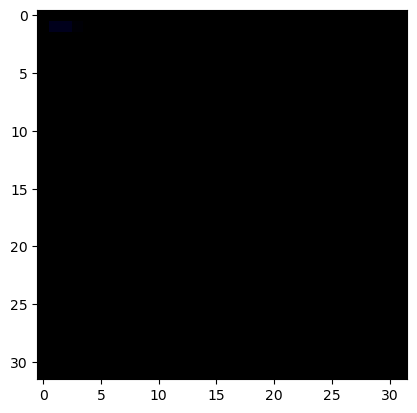

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


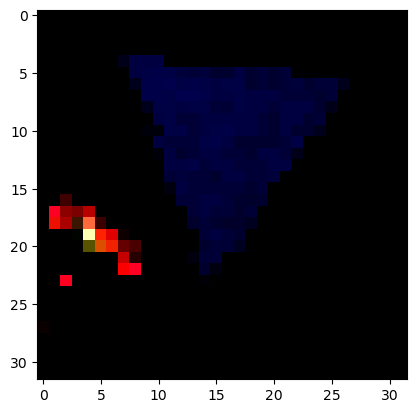

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


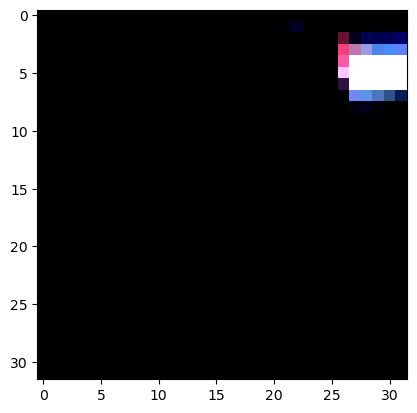

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


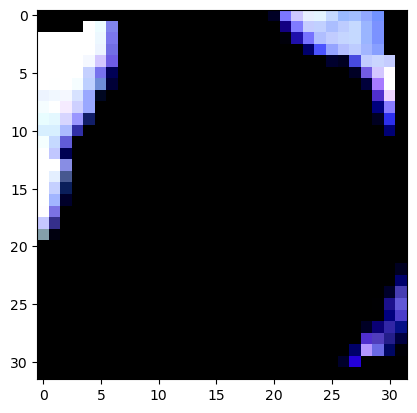

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


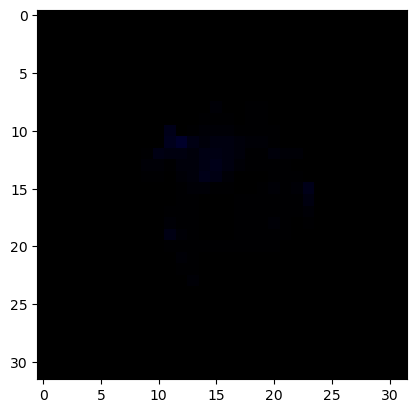

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 20
Predicted Label: 20


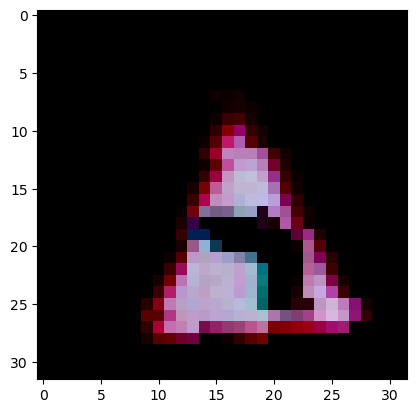

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


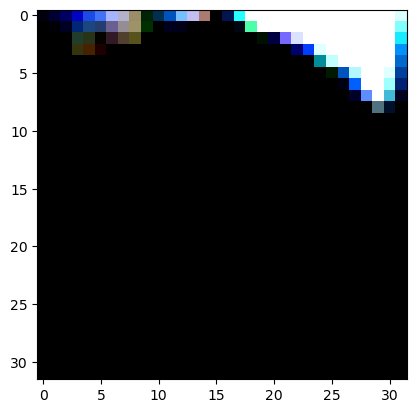

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


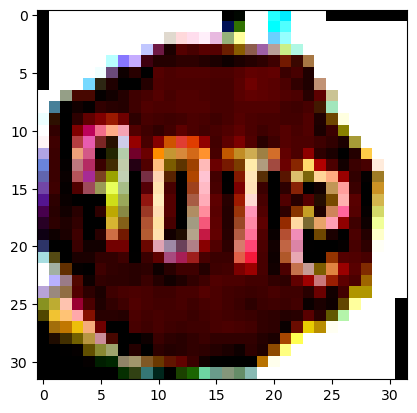

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


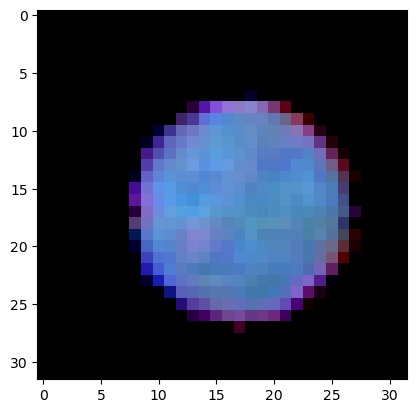

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


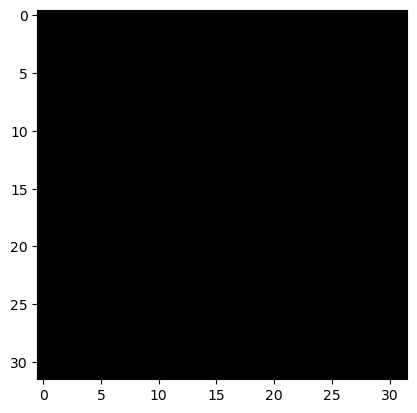

True Label: 2


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 2


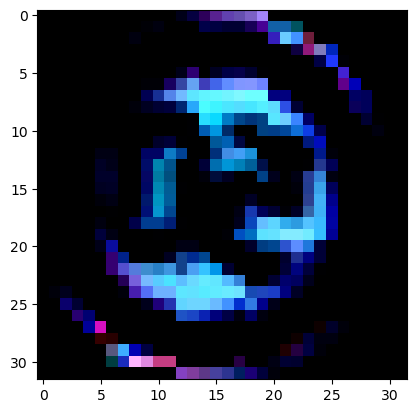

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 29
Predicted Label: 29


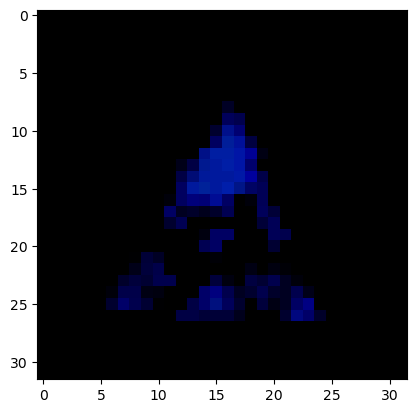

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


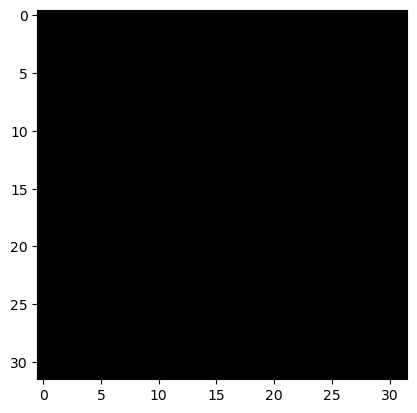

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


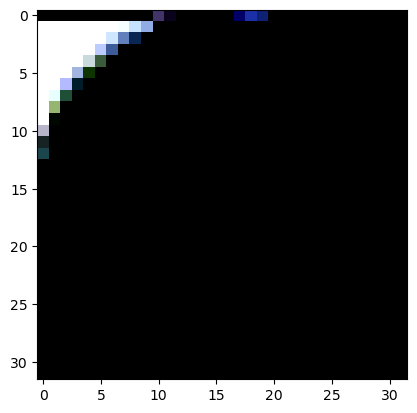

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


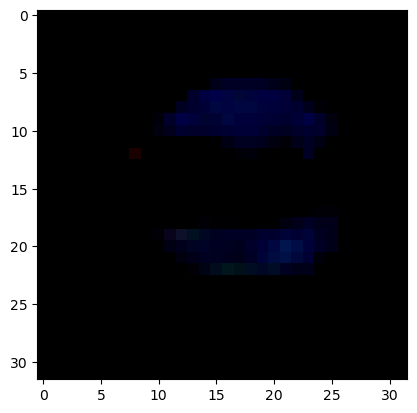

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 30
Predicted Label: 30


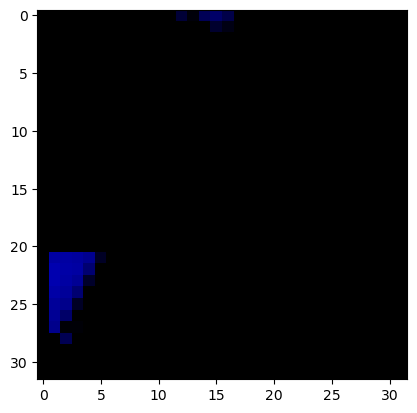

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


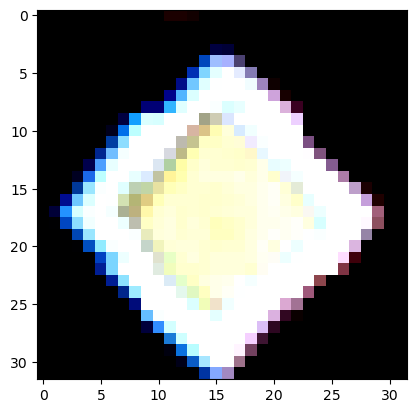

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


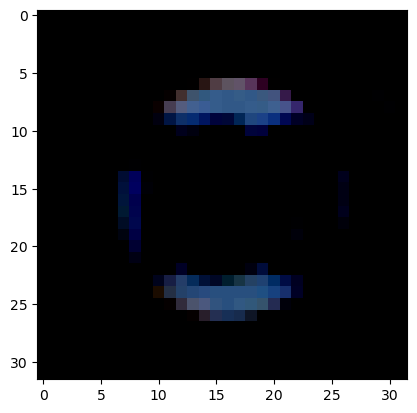

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 31
Predicted Label: 31


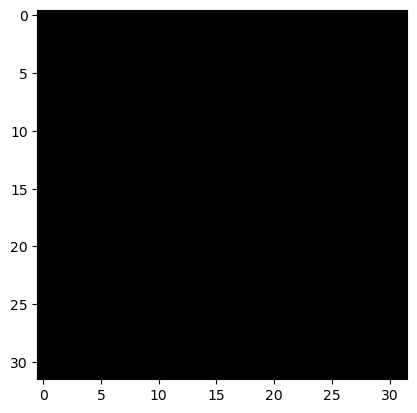

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


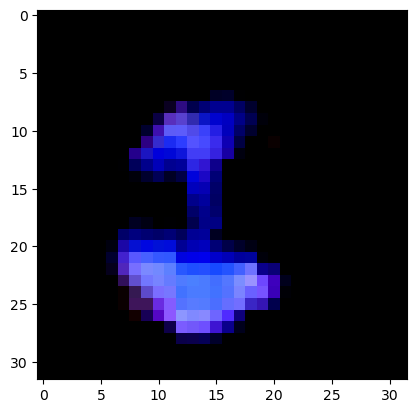

True Label: 10


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 10


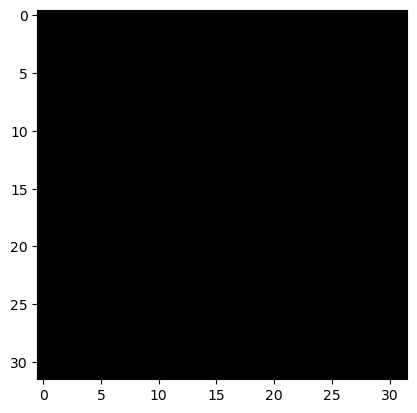

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


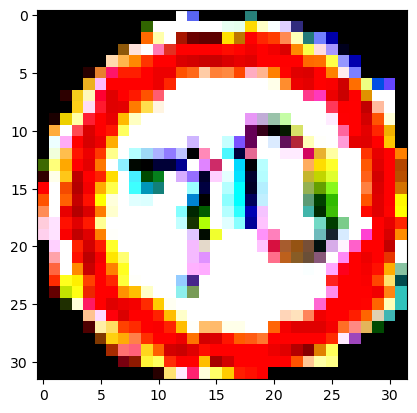

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 40
Predicted Label: 40


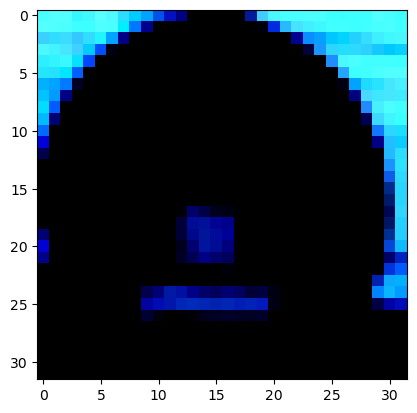

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


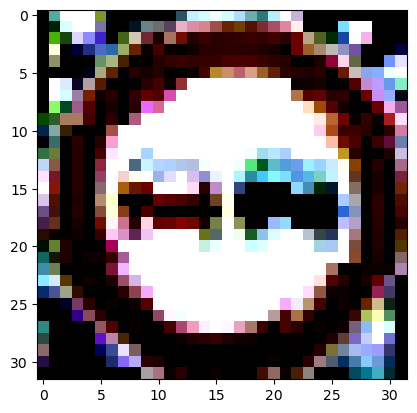

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 33
Predicted Label: 33


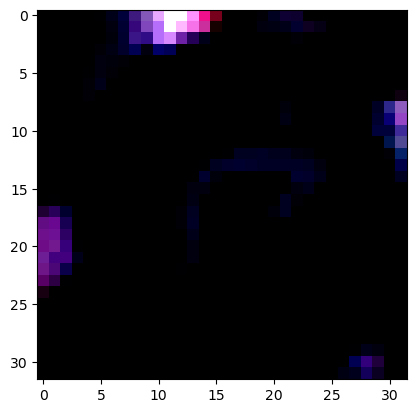

True Label: 8


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 8


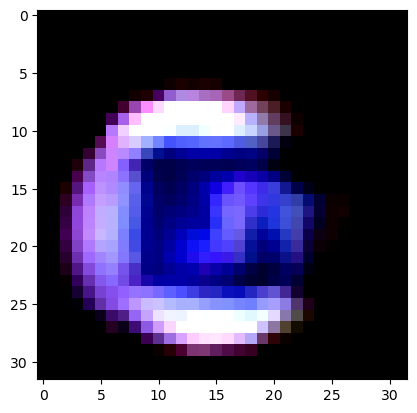

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


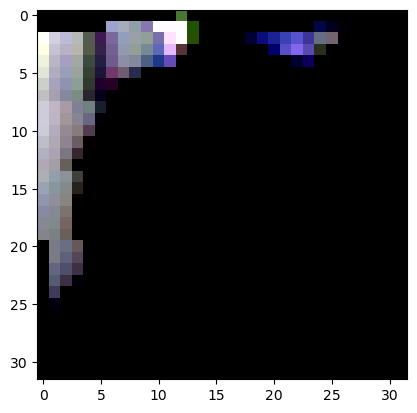

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


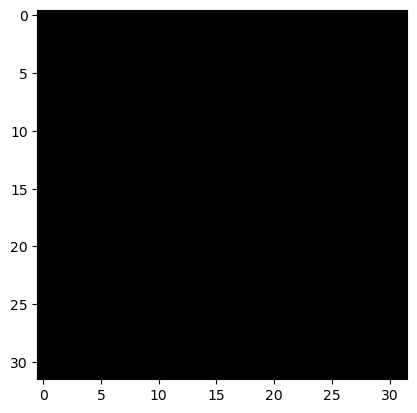

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 26
Predicted Label: 26


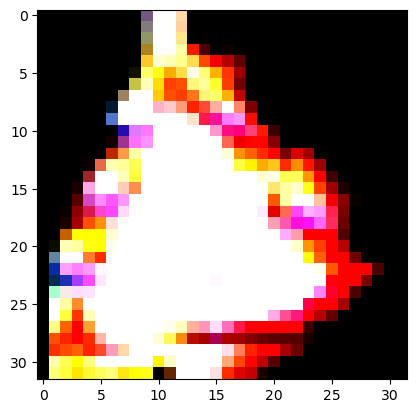

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 31
Predicted Label: 31


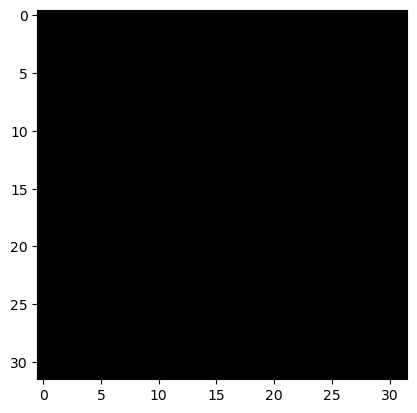

True Label: 27


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 27


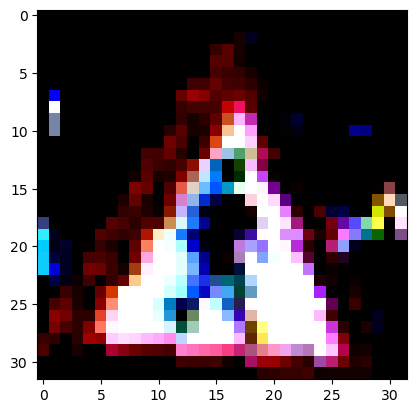

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


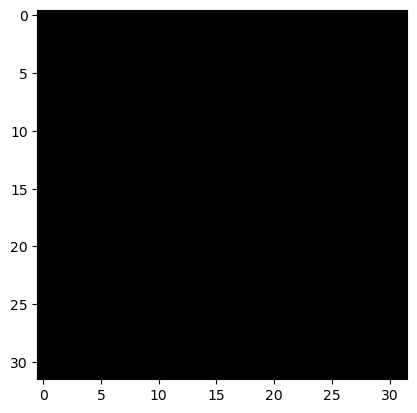

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


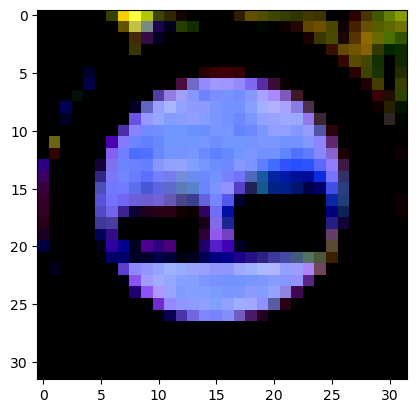

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


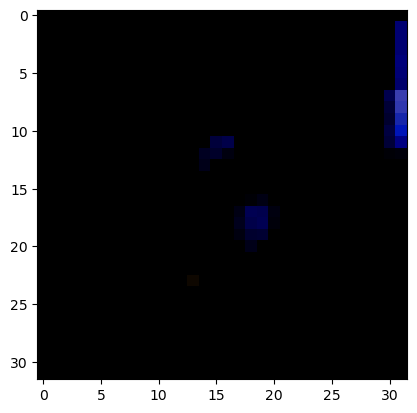

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


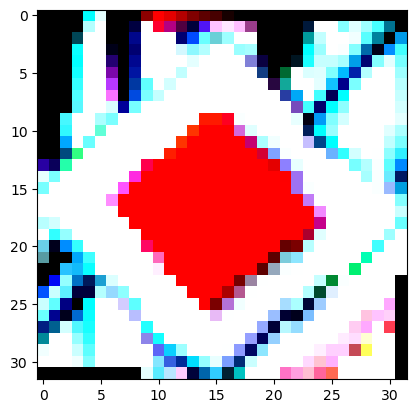

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


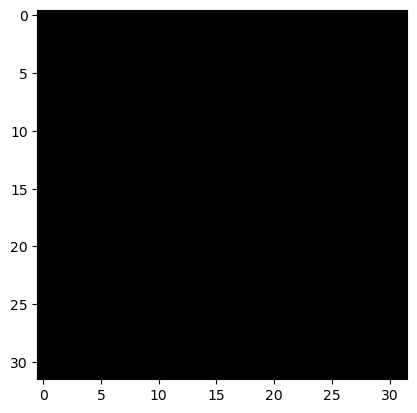

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


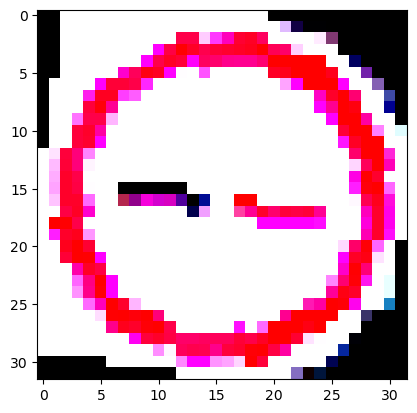

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 32
Predicted Label: 32


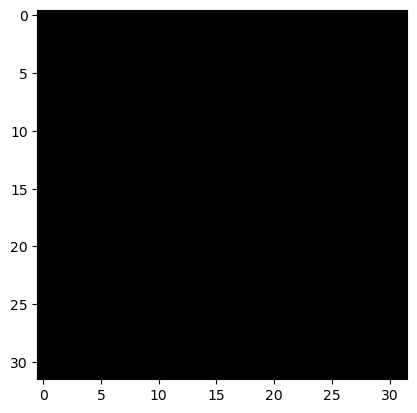

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


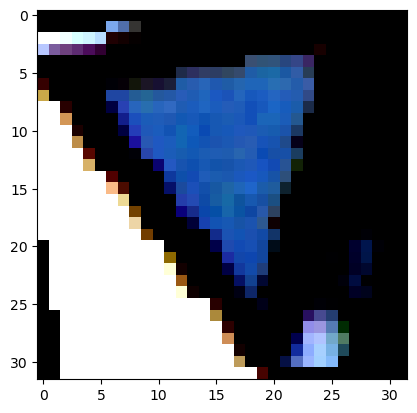

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 20
Predicted Label: 20


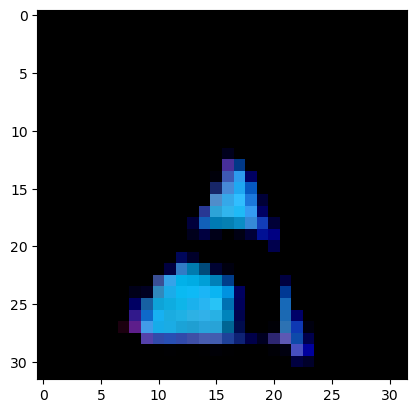

True Label: 20


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 20


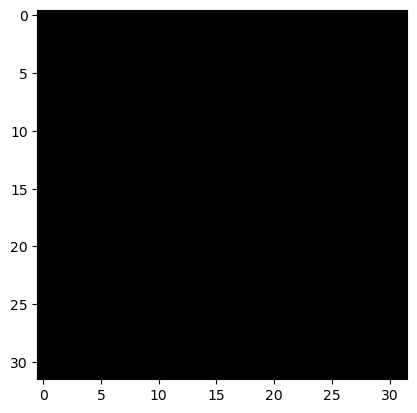

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


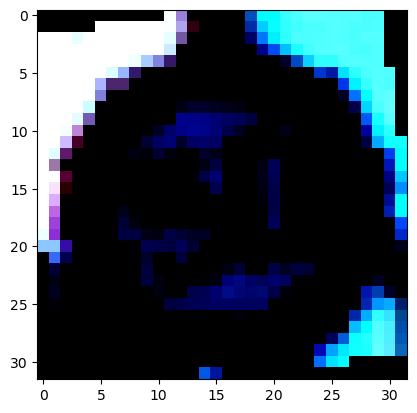

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


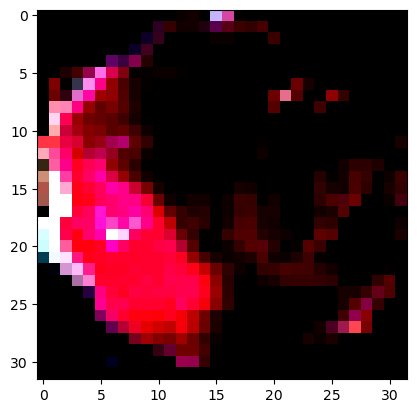

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


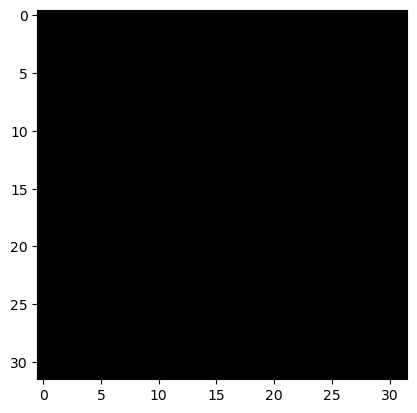

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 24
Predicted Label: 24


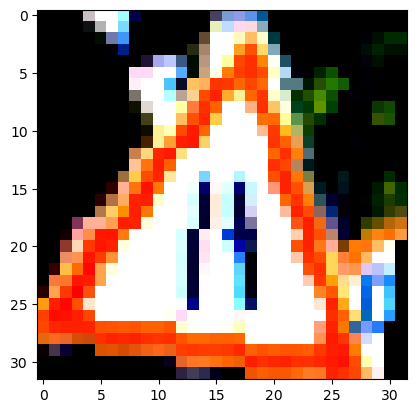

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 17


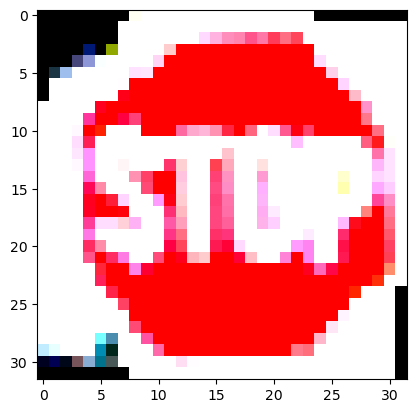

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


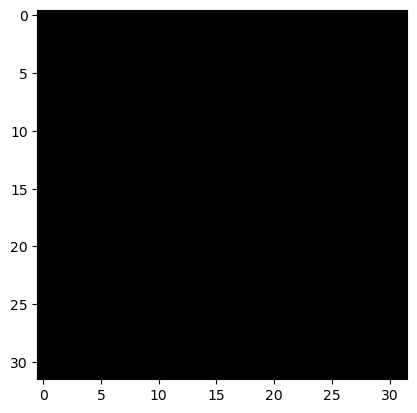

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


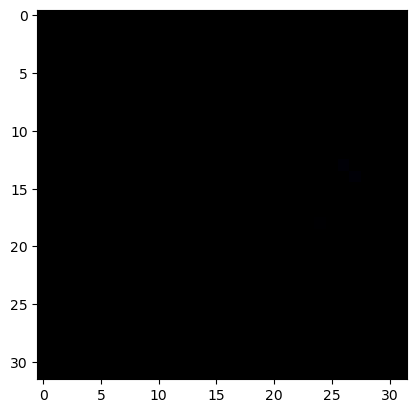

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


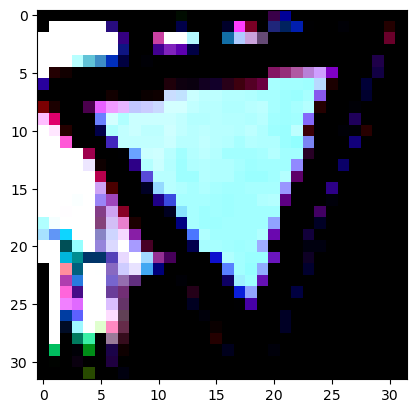

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


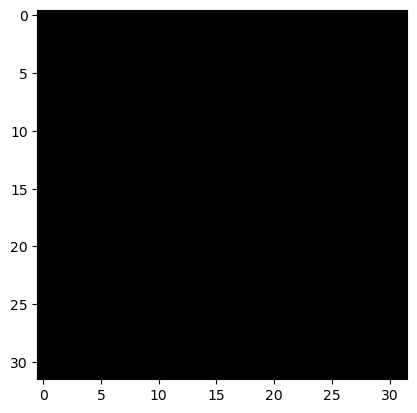

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 41
Predicted Label: 41


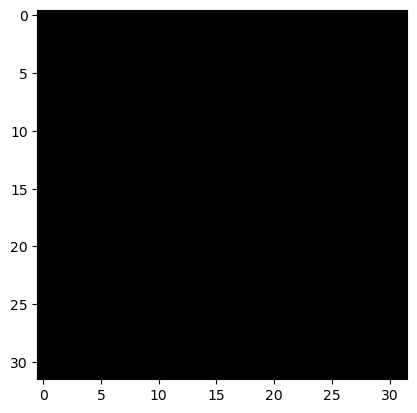

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


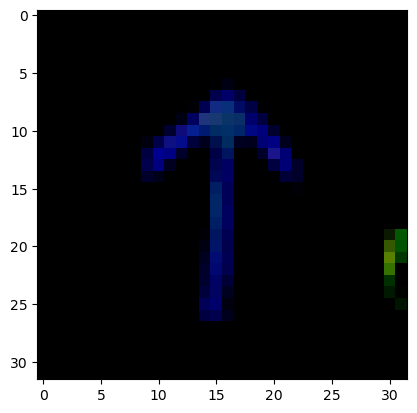

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


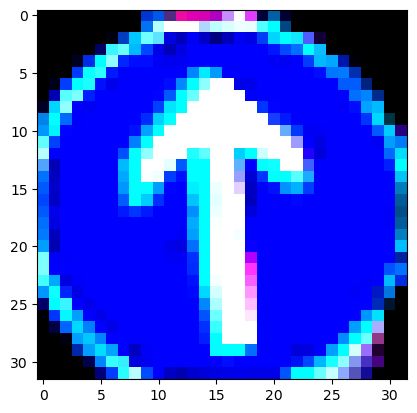

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 26
Predicted Label: 26


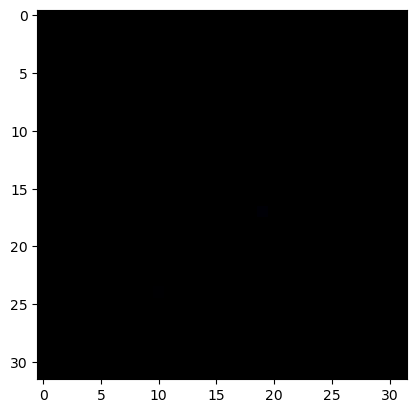

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


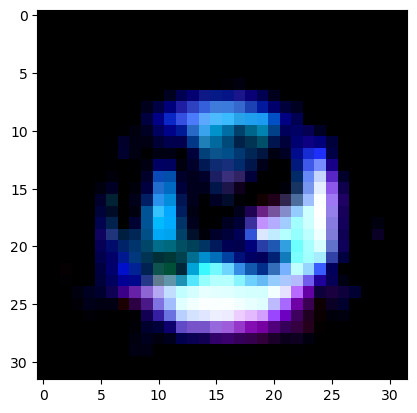

True Label: 23


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 23


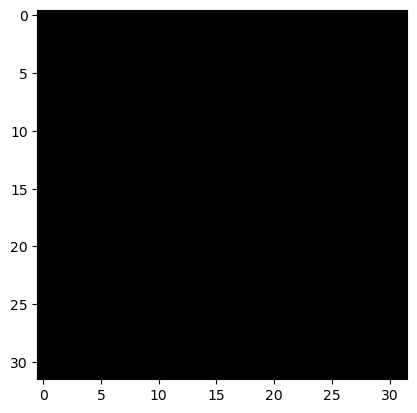

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


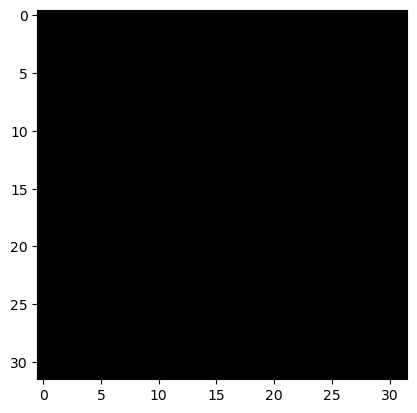

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 36
Predicted Label: 36


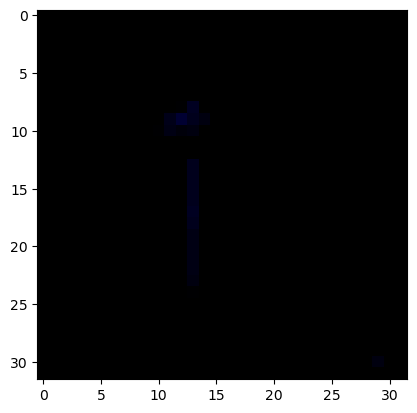

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


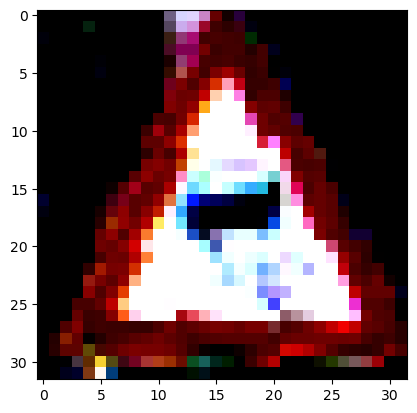

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


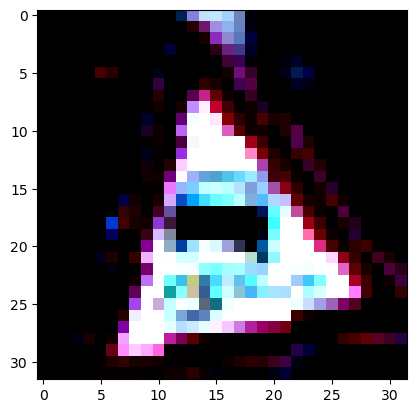

True Label: 23


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 23


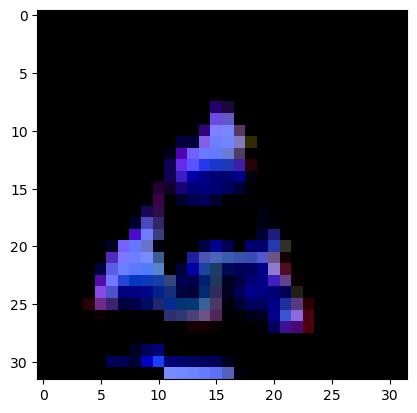

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


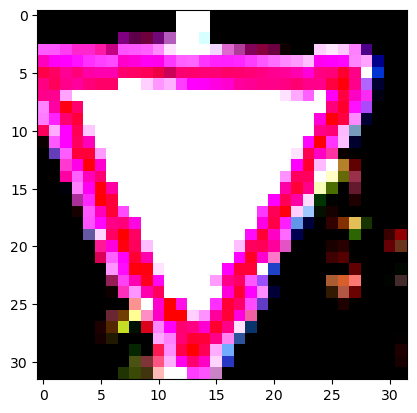

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 34
Predicted Label: 34


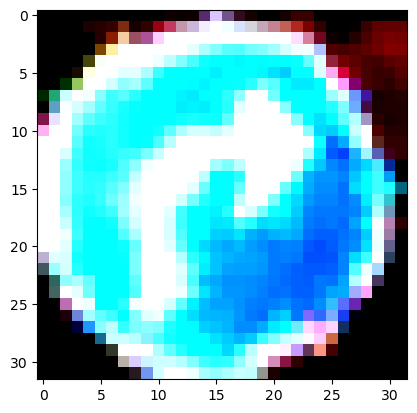

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


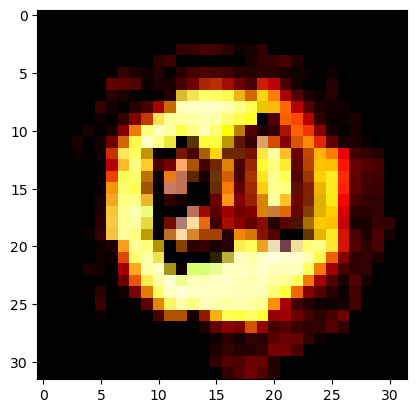

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


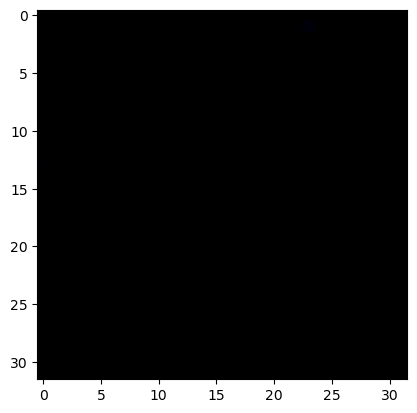

True Label: 1


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 1


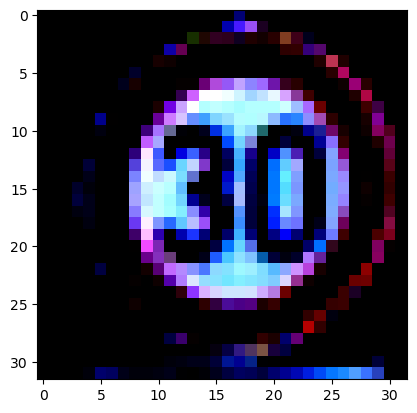

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


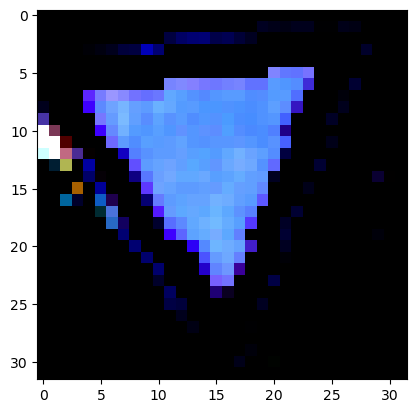

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


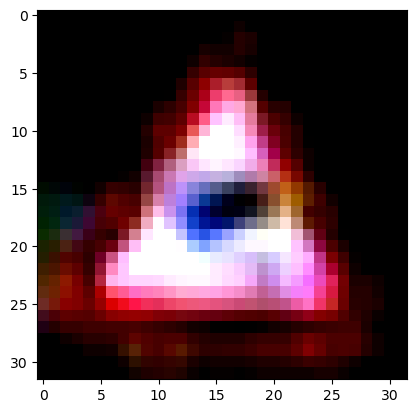

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


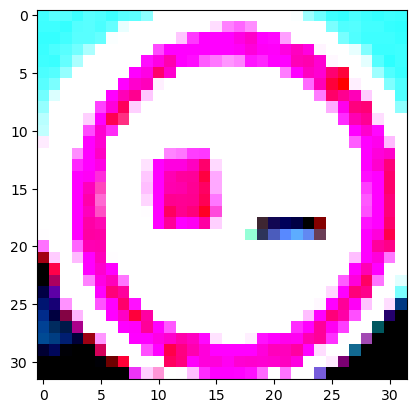

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 26
Predicted Label: 26


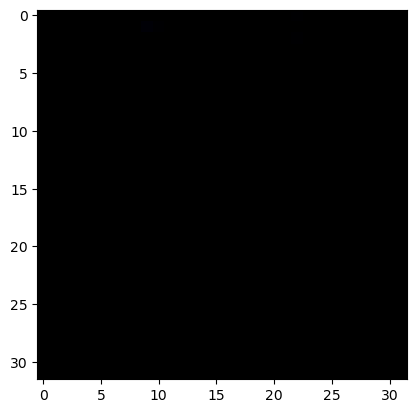

True Label: 12


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 12


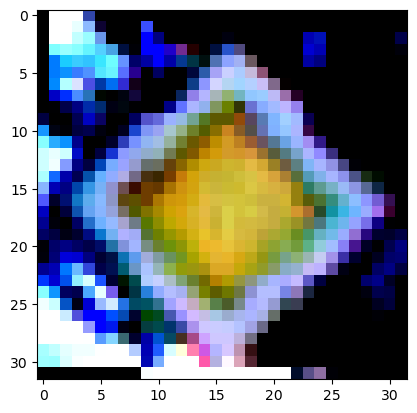

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


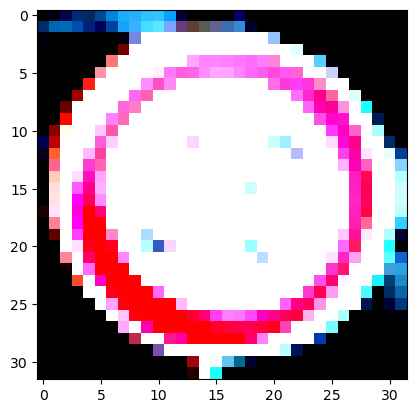

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 29
Predicted Label: 29


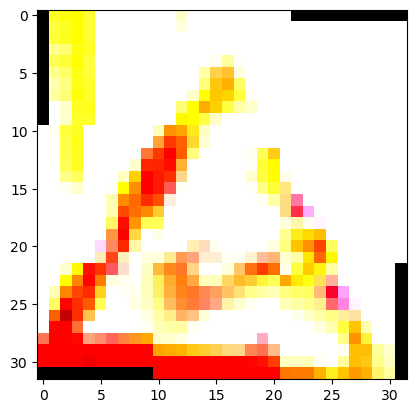

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


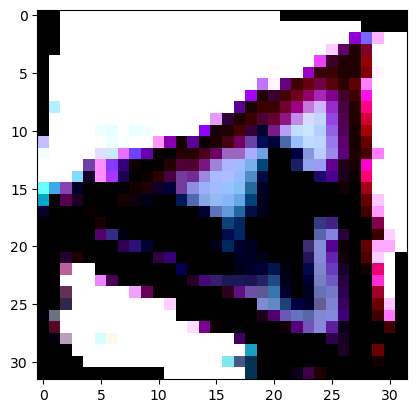

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


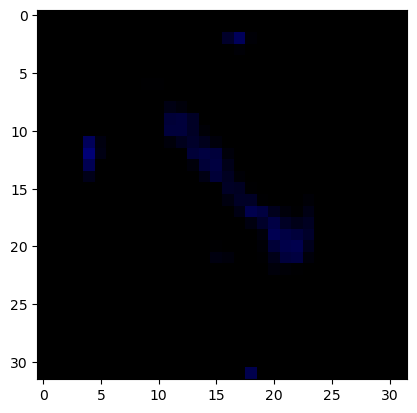

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


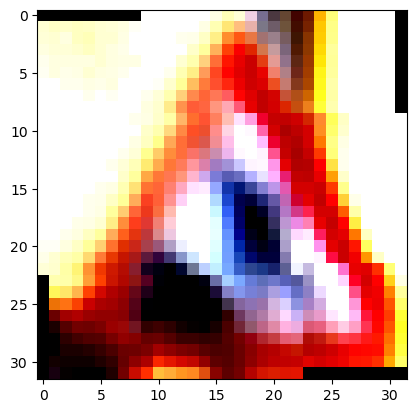

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


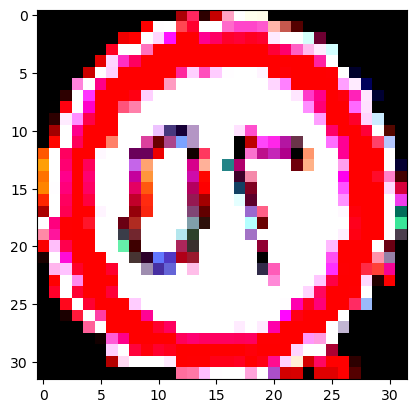

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 29
Predicted Label: 29


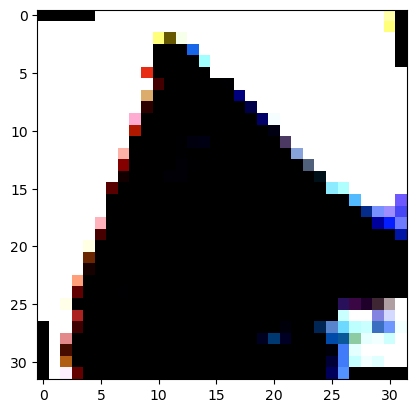

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 27
Predicted Label: 27


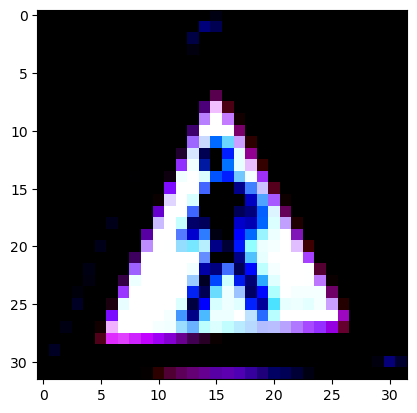

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


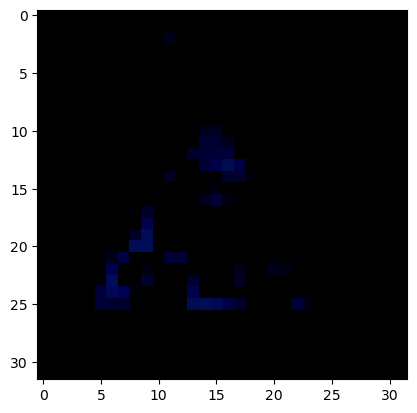

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


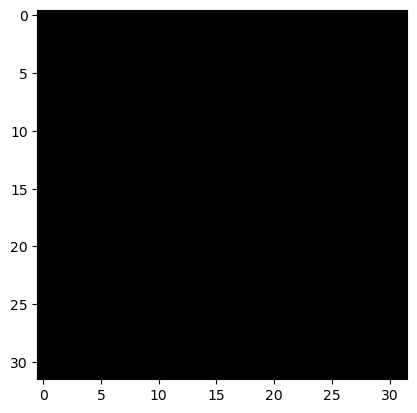

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


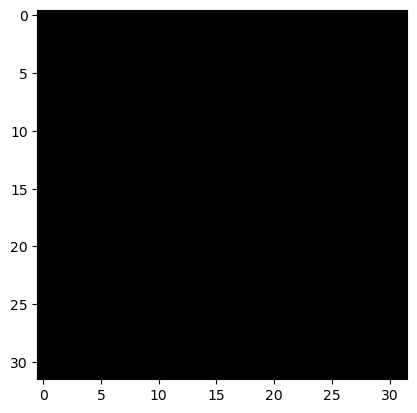

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


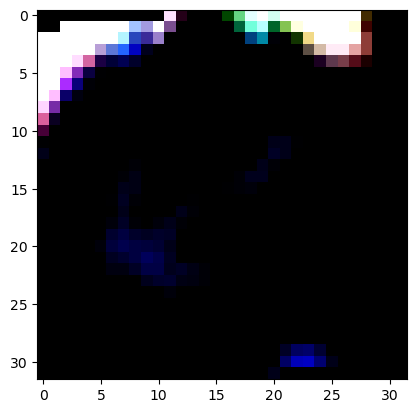

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


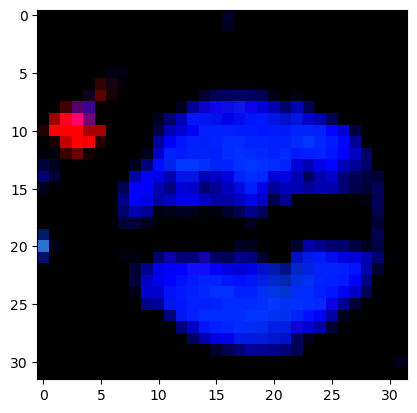

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


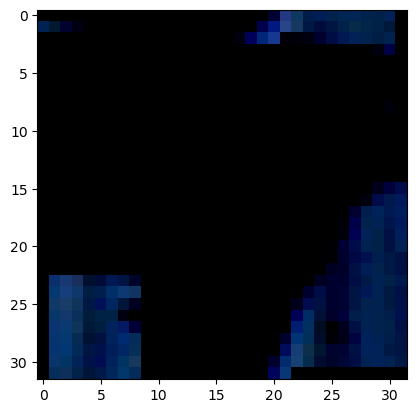

True Label: 31


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 31


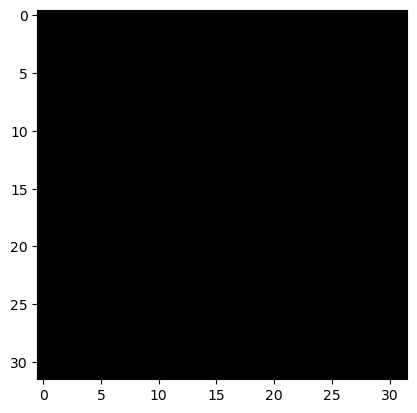

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 30
Predicted Label: 30


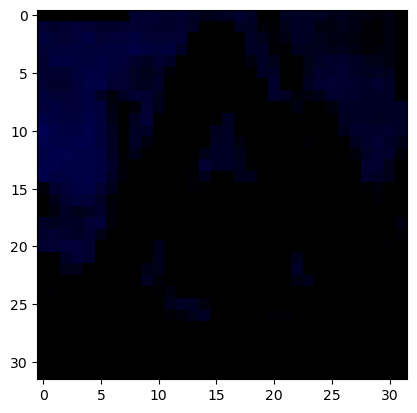

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


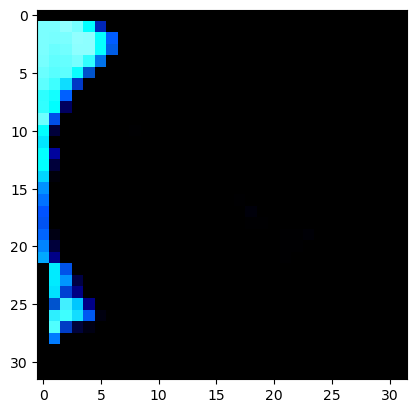

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


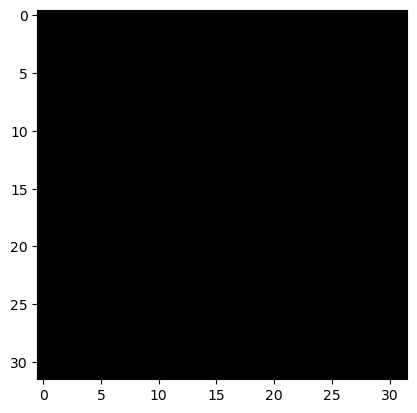

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


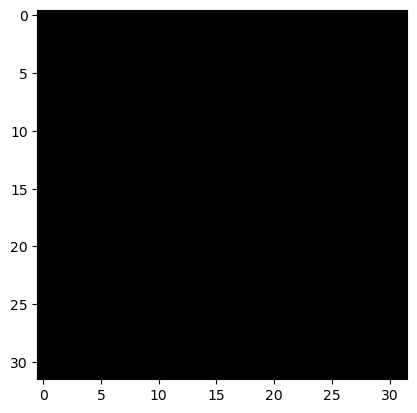

True Label: 14


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 14


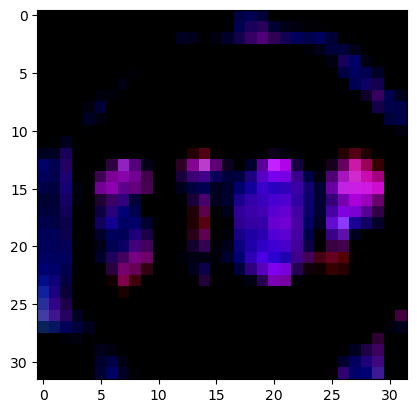

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


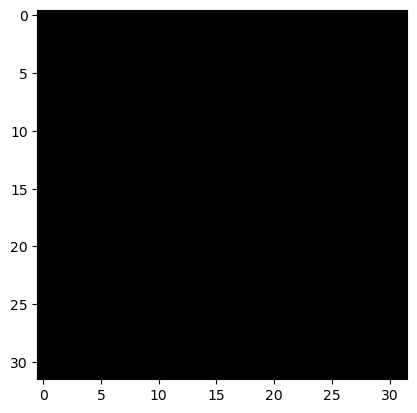

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 21
Predicted Label: 21


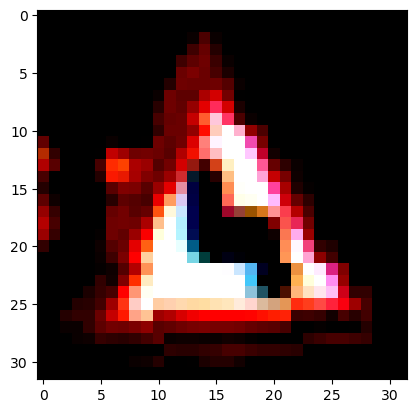

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


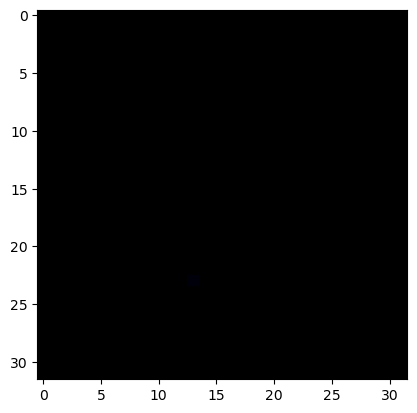

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 6
Predicted Label: 6


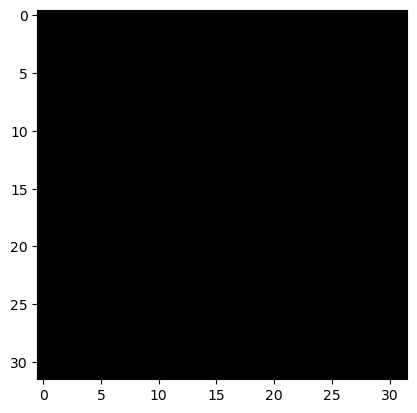

True Label: 1


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 1


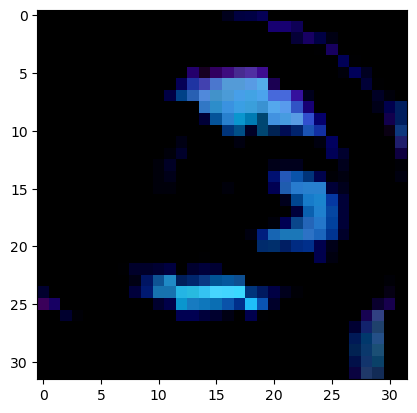

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


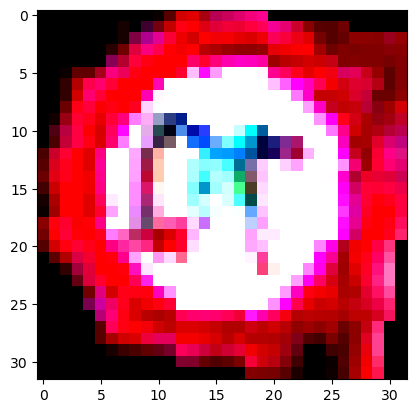

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 39


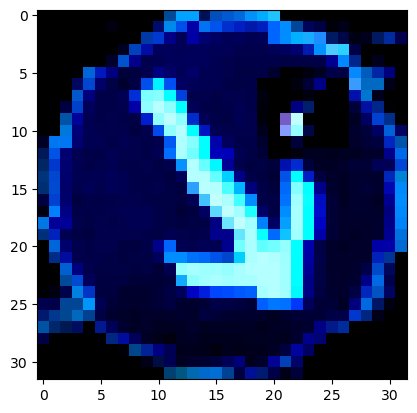

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 33
Predicted Label: 33


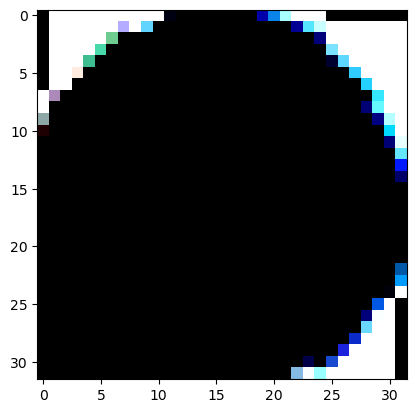

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


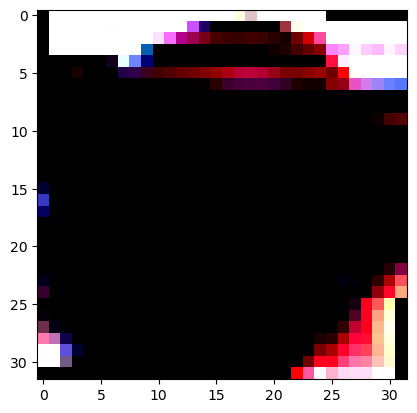

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


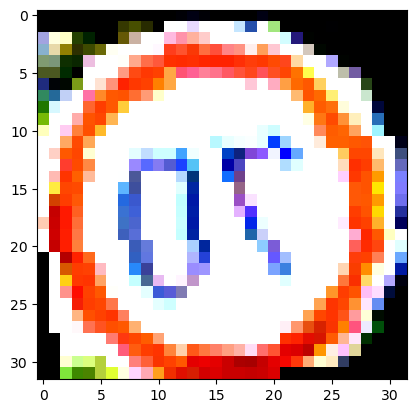

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


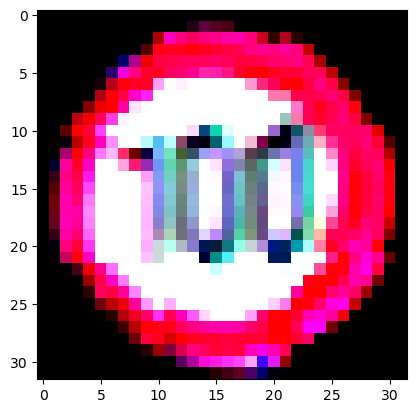

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


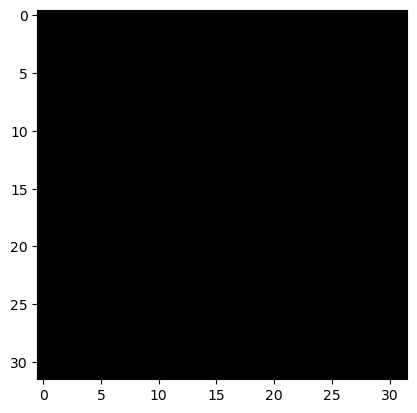

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 30
Predicted Label: 30


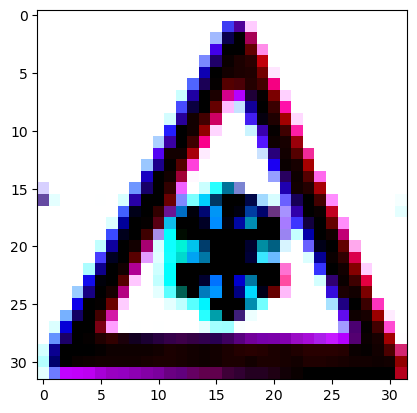

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


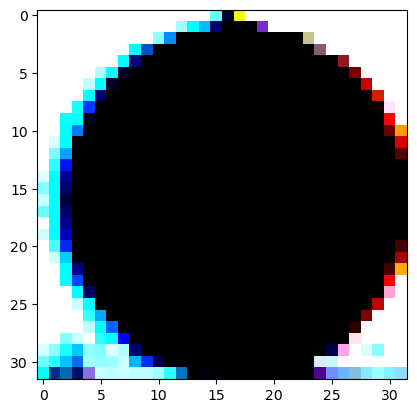

True Label: 38


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 38


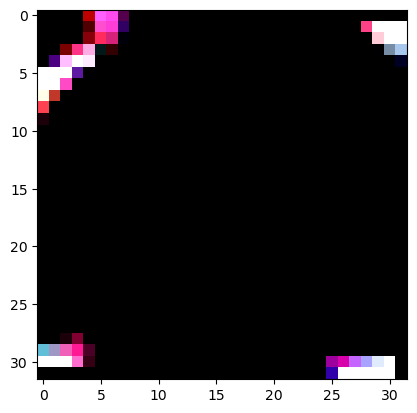

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


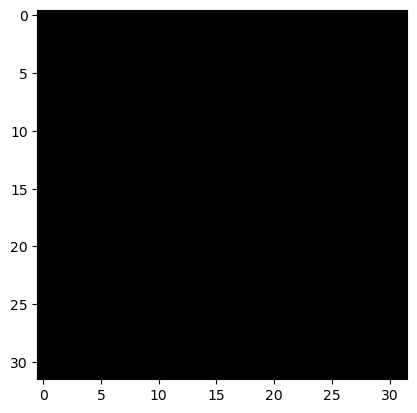

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


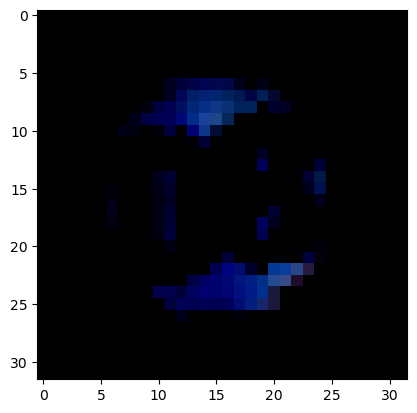

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


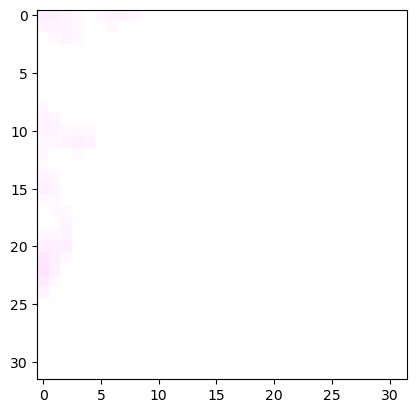

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


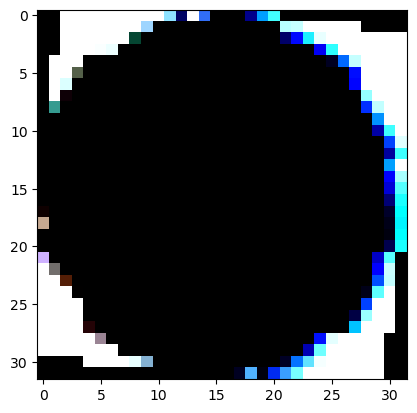

True Label: 13


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 13


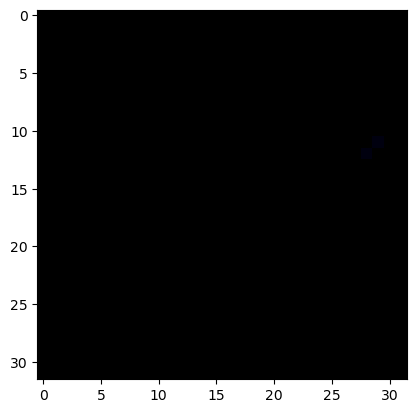

True Label: 18


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 26


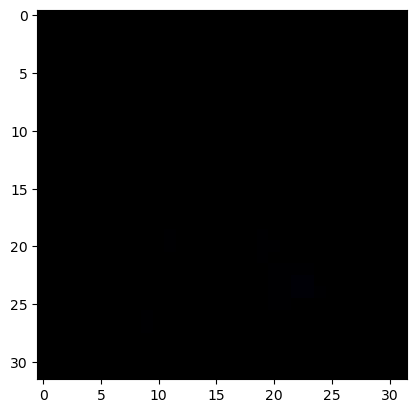

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


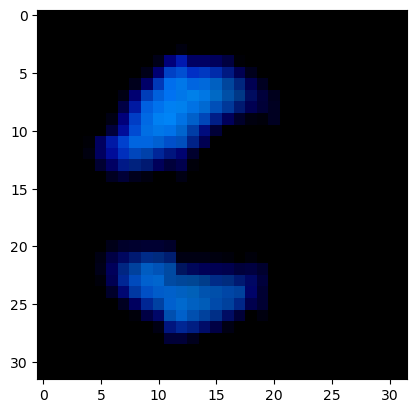

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


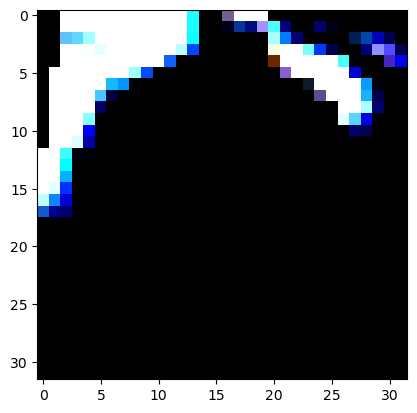

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


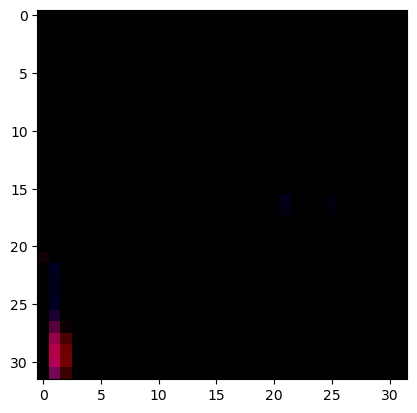

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


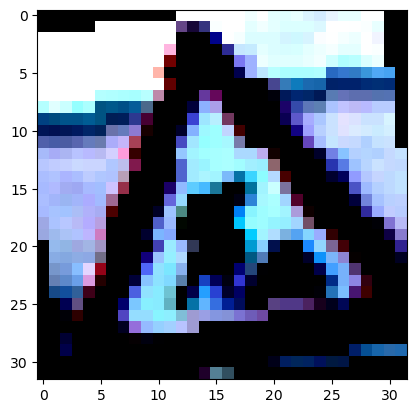

True Label: 15


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 4


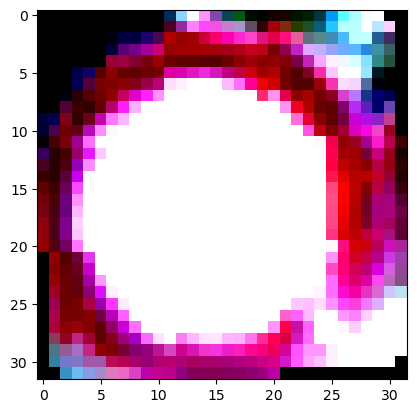

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 40
Predicted Label: 40


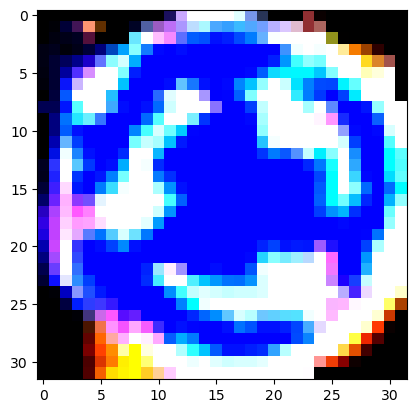

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


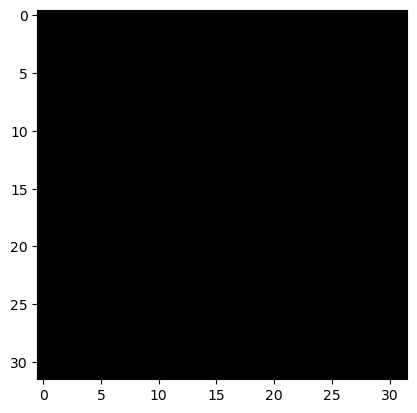

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 32
Predicted Label: 6


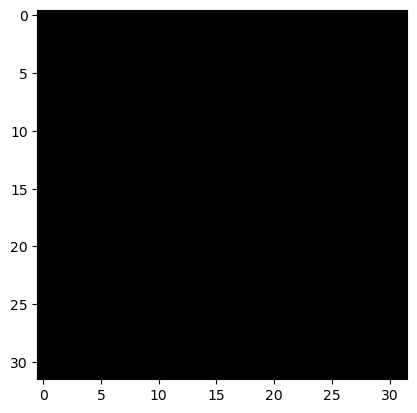

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


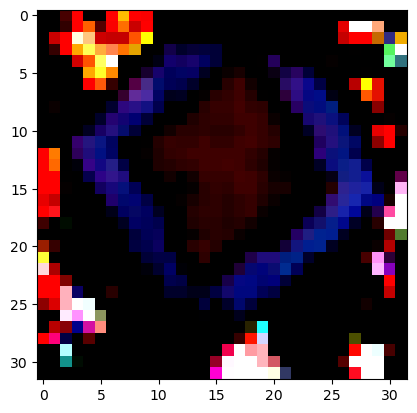

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


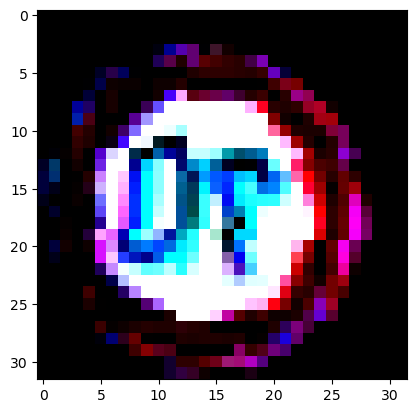

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


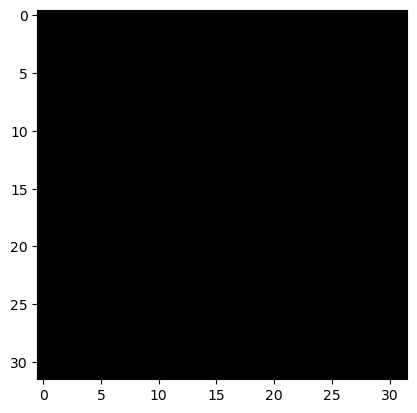

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 29
Predicted Label: 29


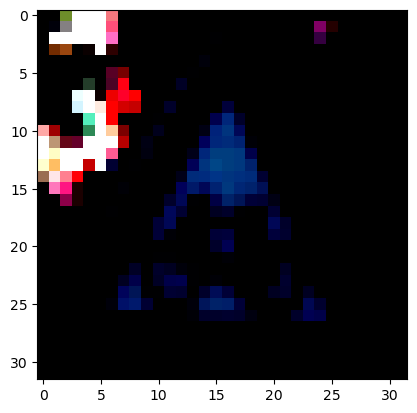

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


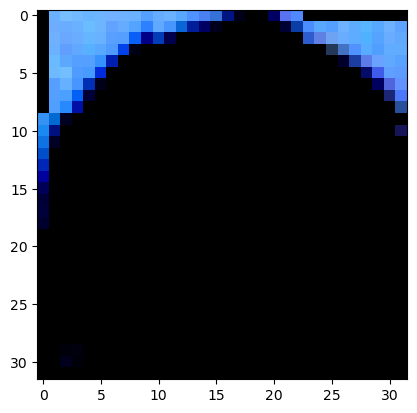

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


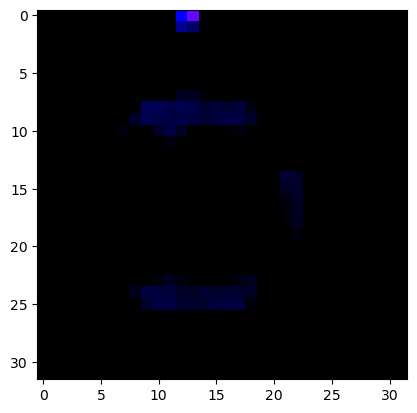

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


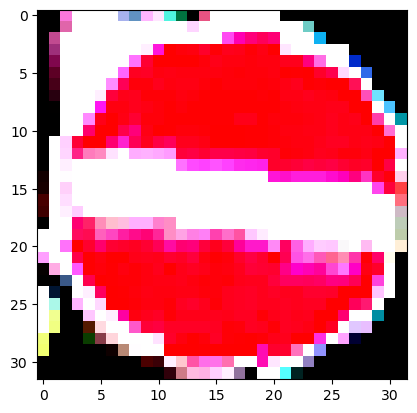

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


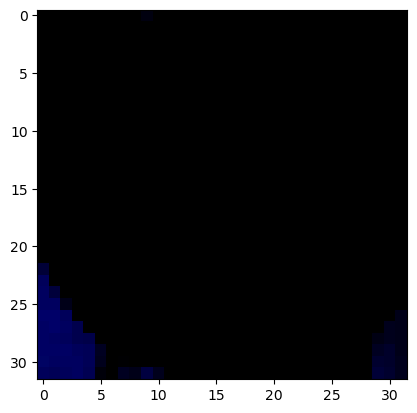

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


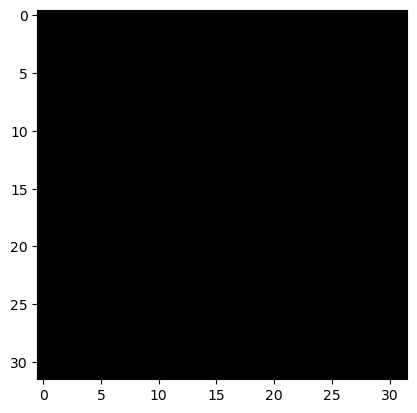

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


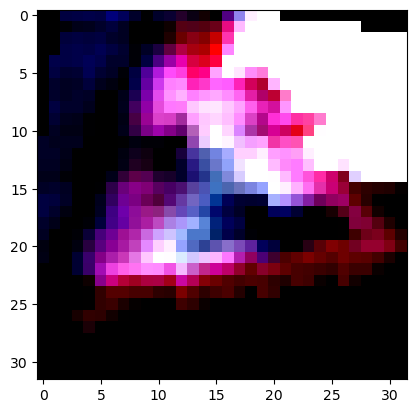

True Label: 28


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 28


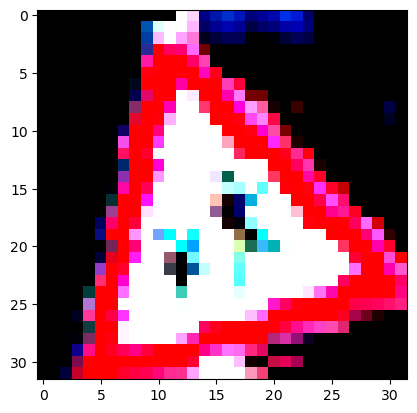

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


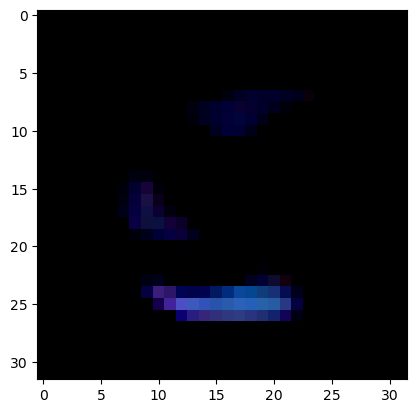

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


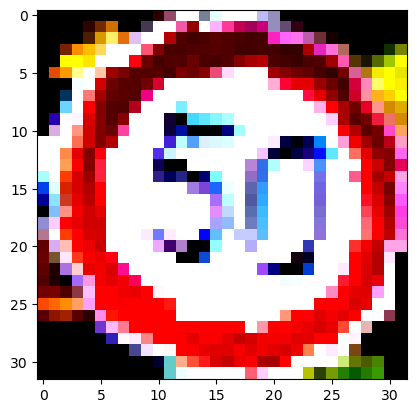

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


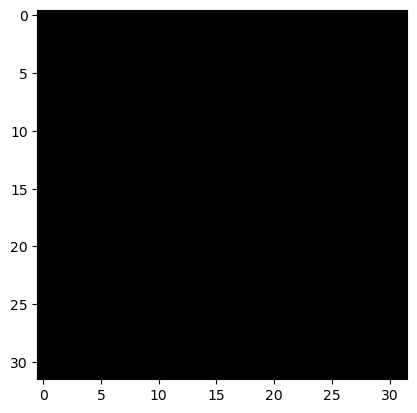

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 2


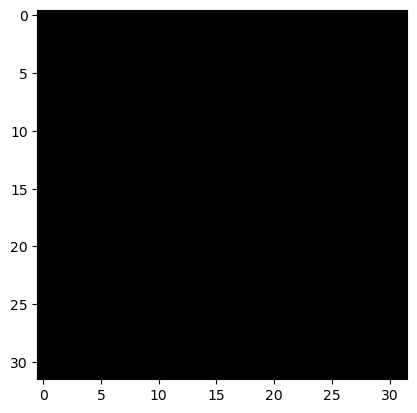

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 21
Predicted Label: 21


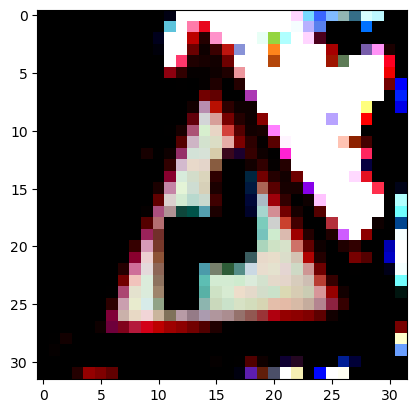

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


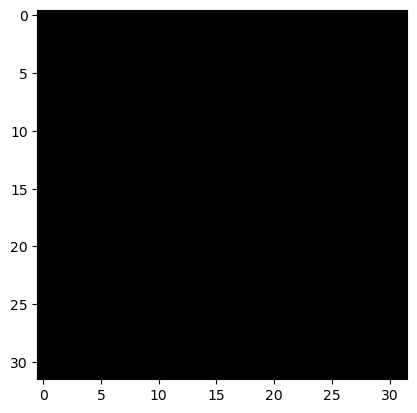

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


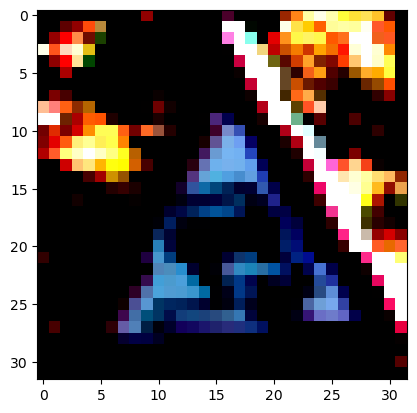

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 21
Predicted Label: 21


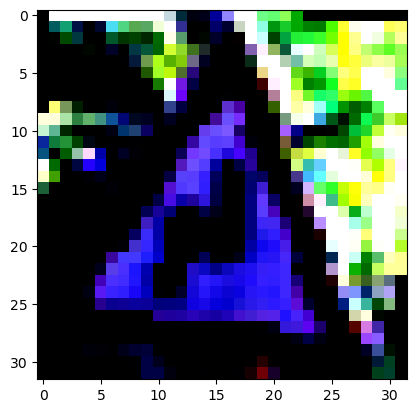

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 20
Predicted Label: 20


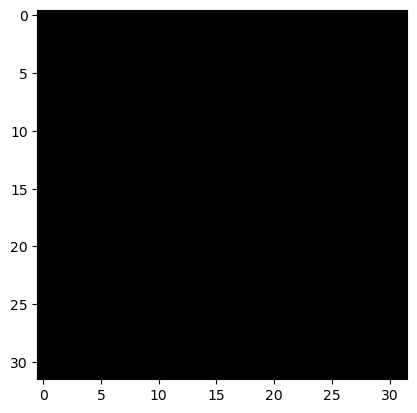

True Label: 3


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 3


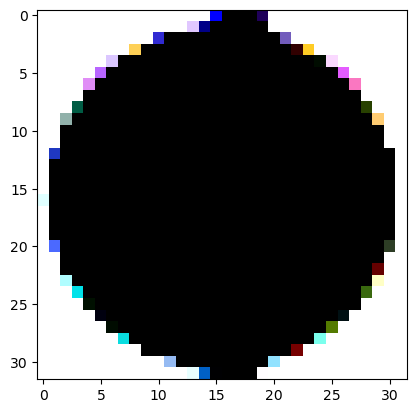

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


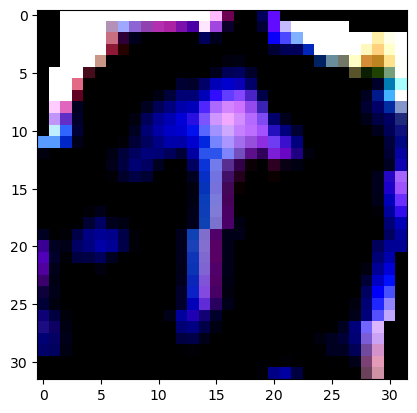

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


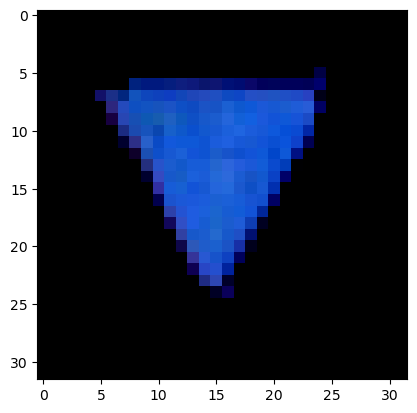

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


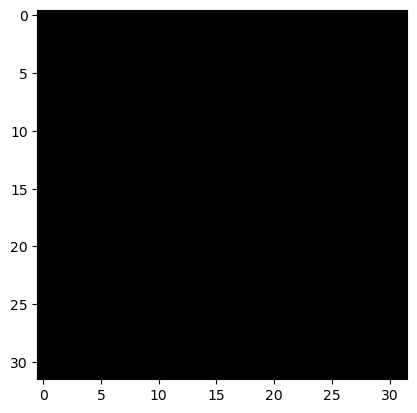

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 26


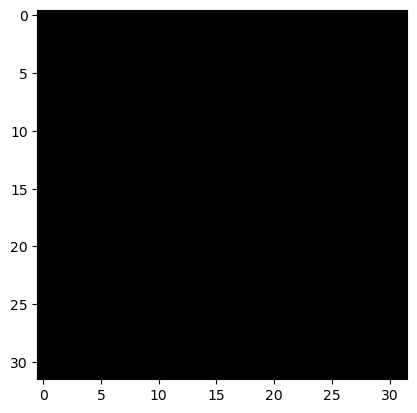

True Label: 17


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 17


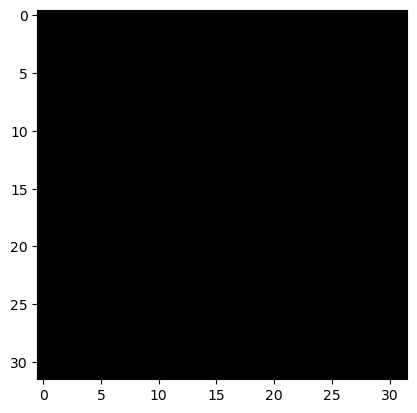

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 29
Predicted Label: 29


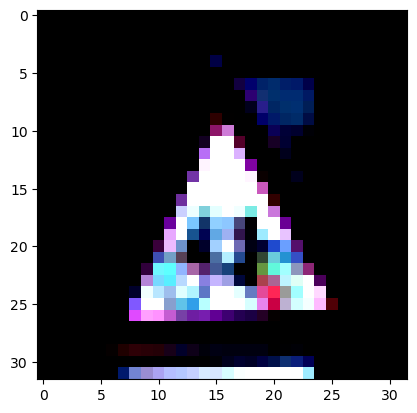

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 40
Predicted Label: 40


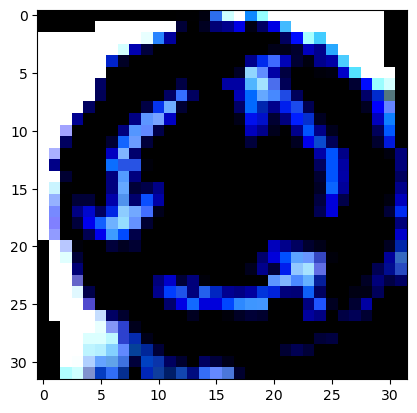

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


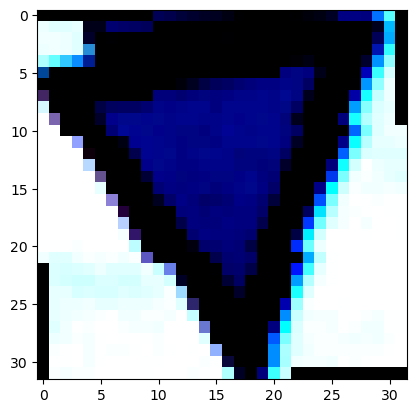

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 26
Predicted Label: 26


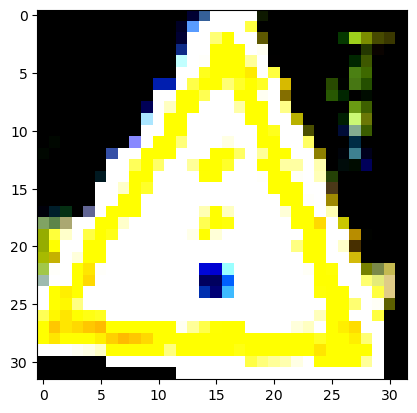

True Label: 18


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 18


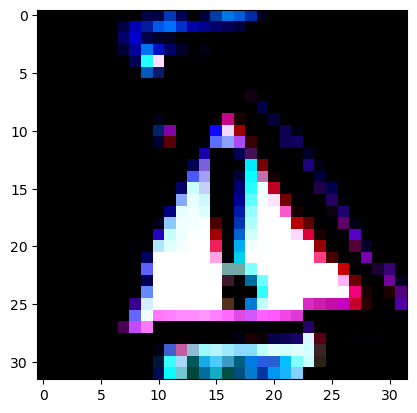

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


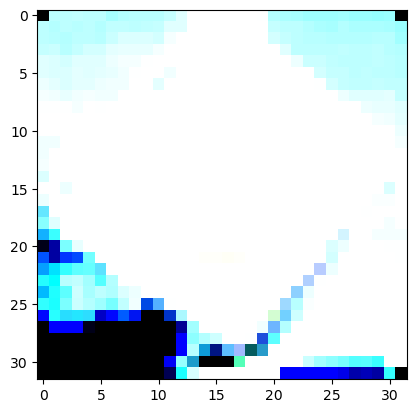

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


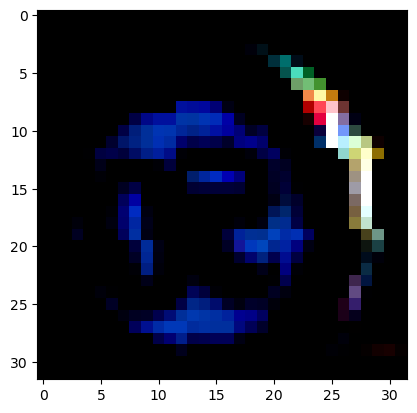

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


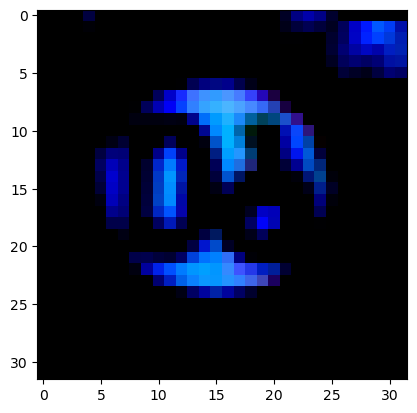

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


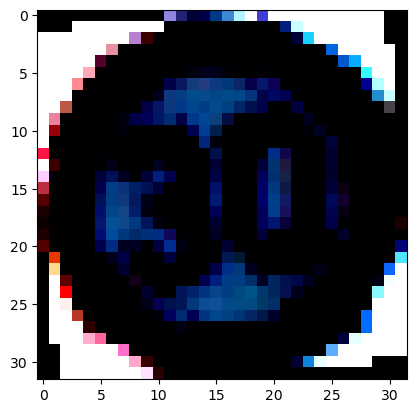

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 36
Predicted Label: 36


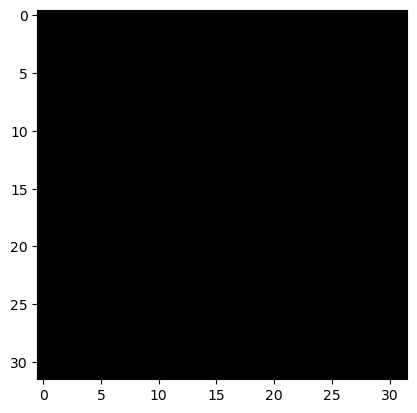

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


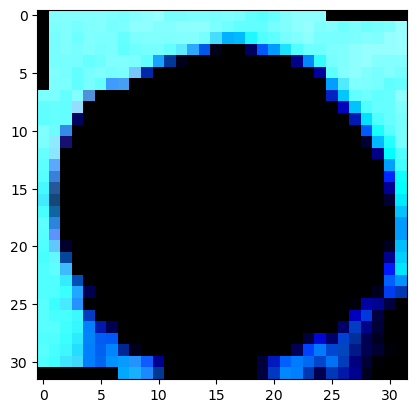

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 34
Predicted Label: 33


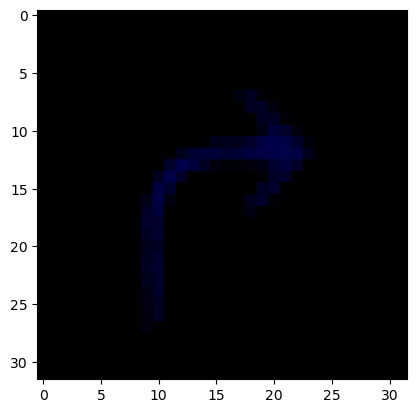

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


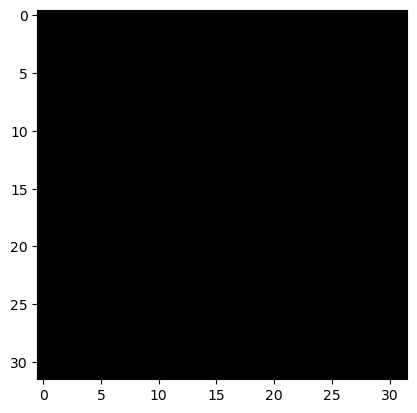

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


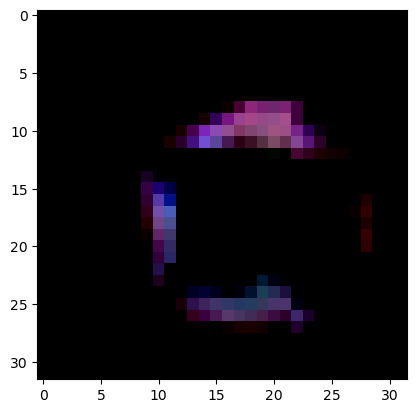

True Label: 5


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 5


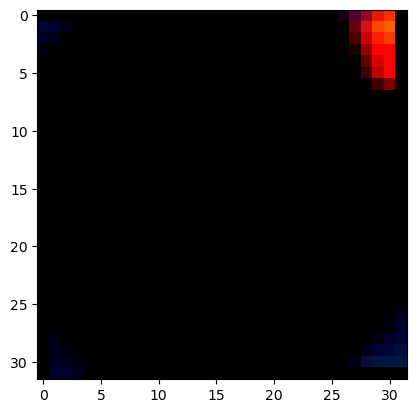

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


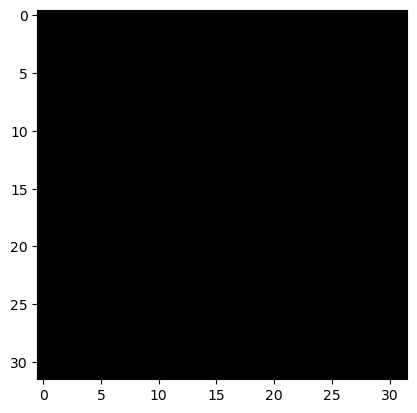

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 39
Predicted Label: 39


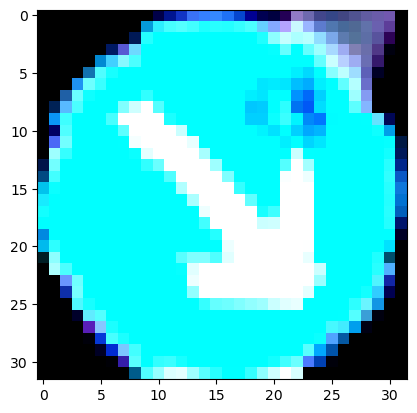

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 36
Predicted Label: 36


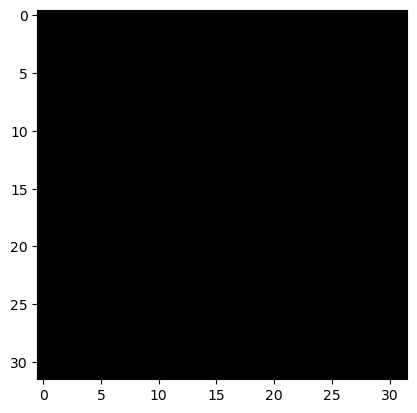

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


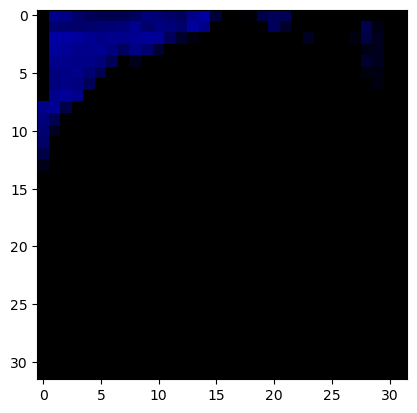

True Label: 9


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 9


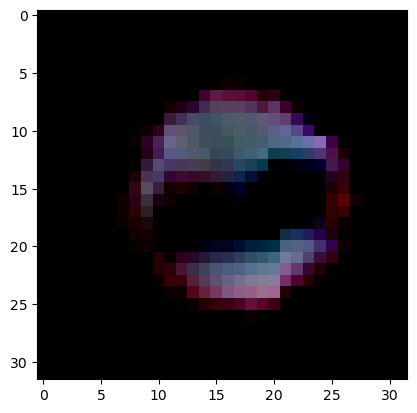

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


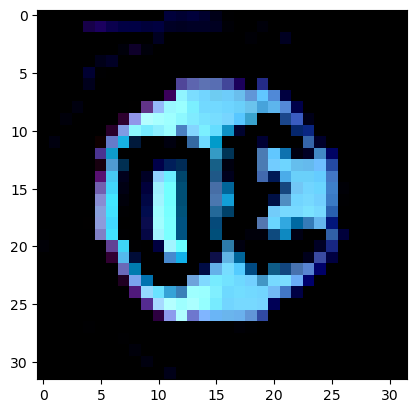

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


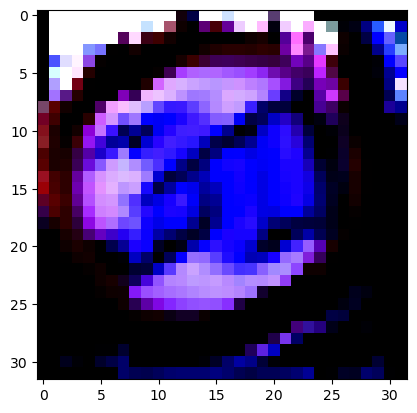

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 33
Predicted Label: 33


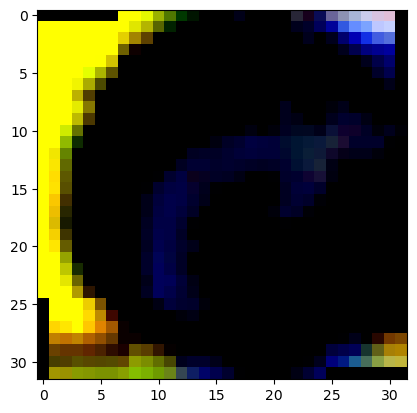

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


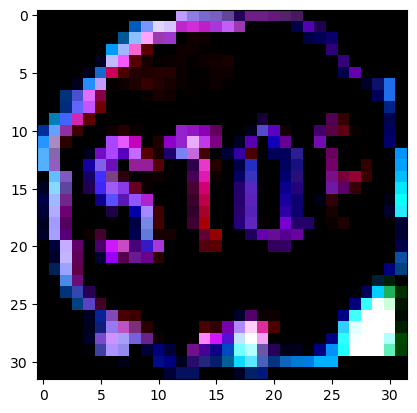

True Label: 17


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 17


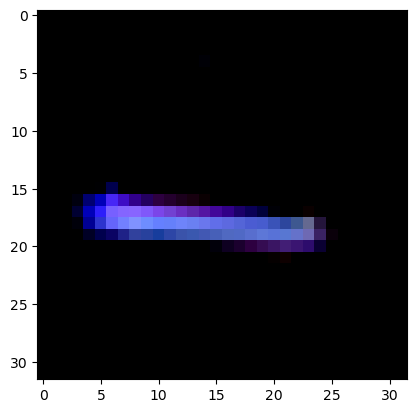

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


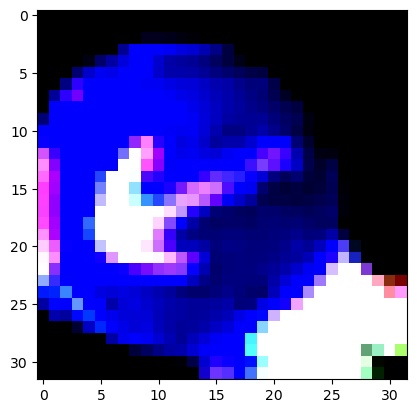

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


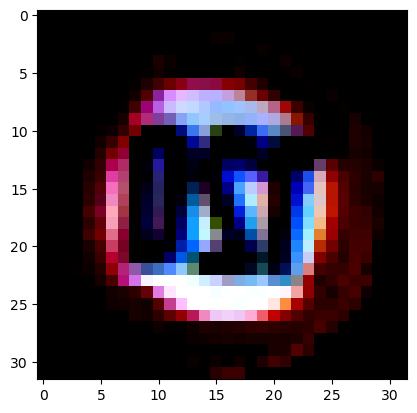

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


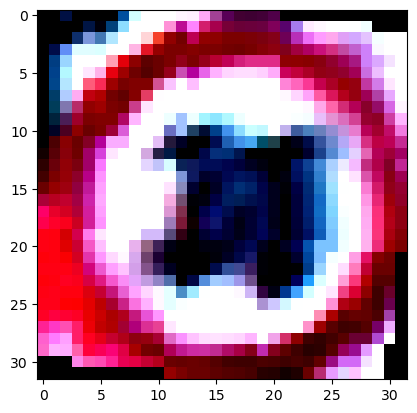

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


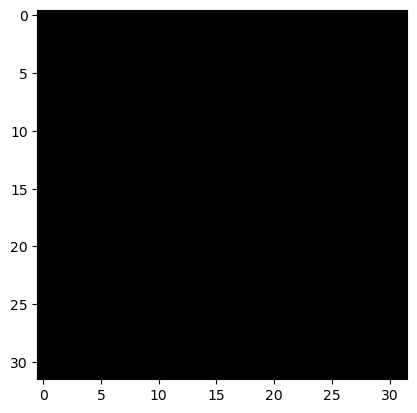

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


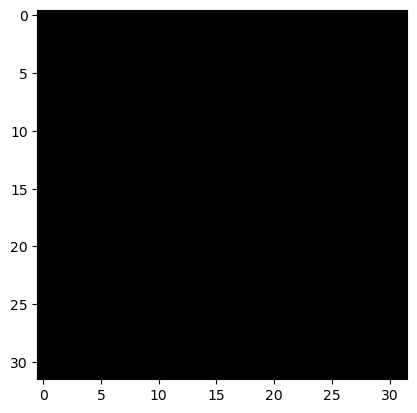

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 6
Predicted Label: 6


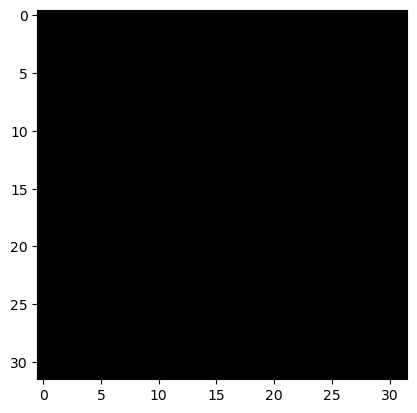

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


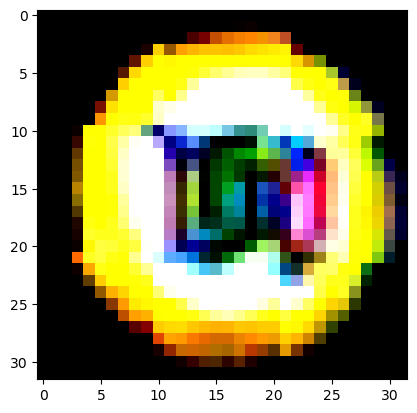

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


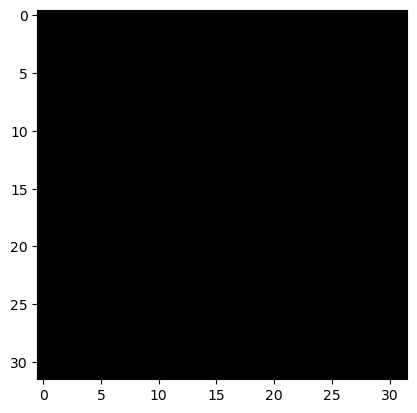

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


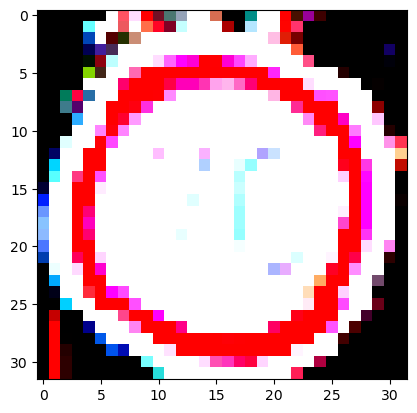

True Label: 12


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 12


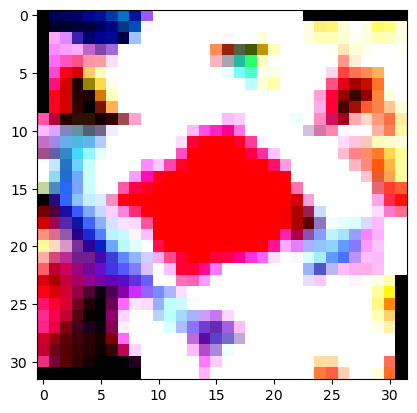

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


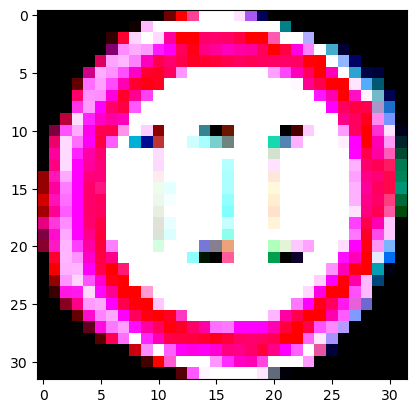

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


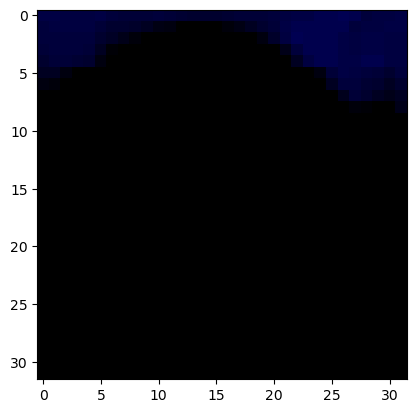

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


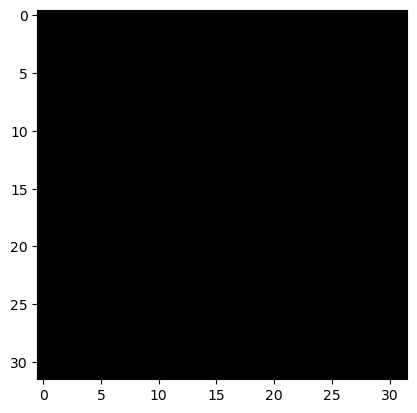

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


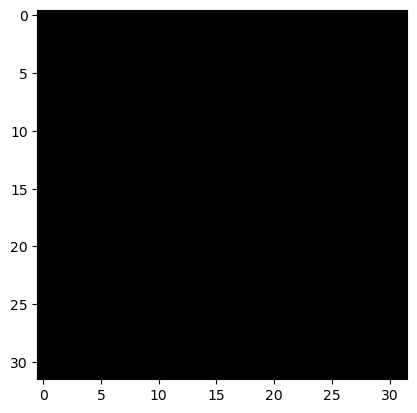

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


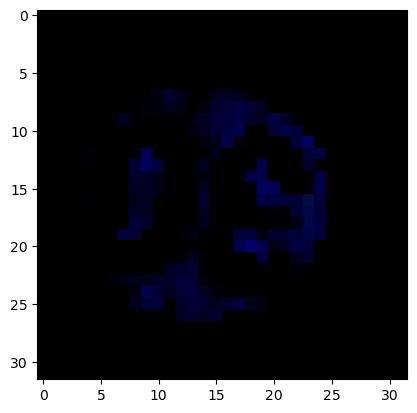

True Label: 1
Predicted Label: 1


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


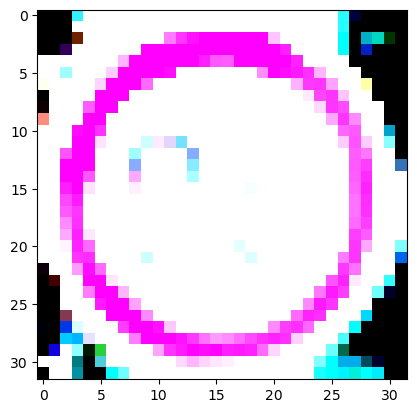

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


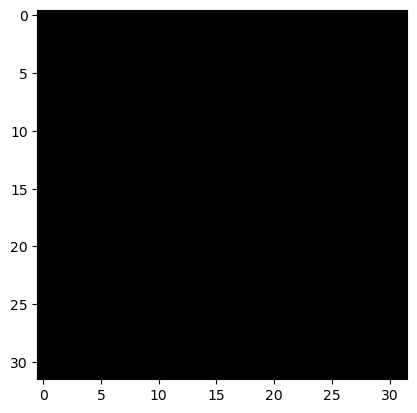

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 40
Predicted Label: 40


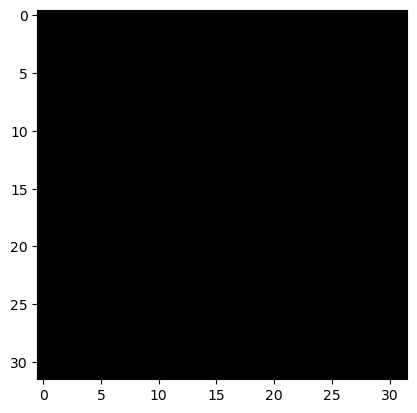

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 37
Predicted Label: 37


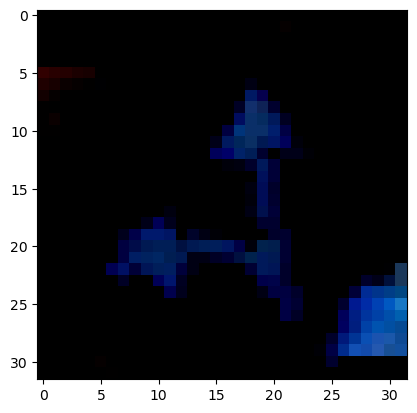

True Label: 25


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 25


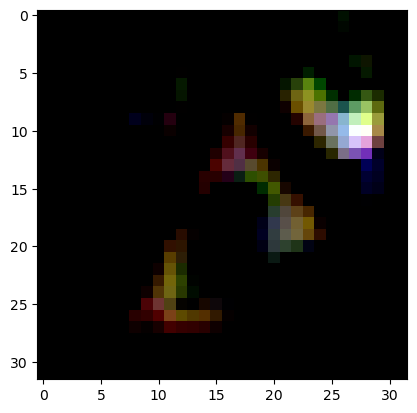

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


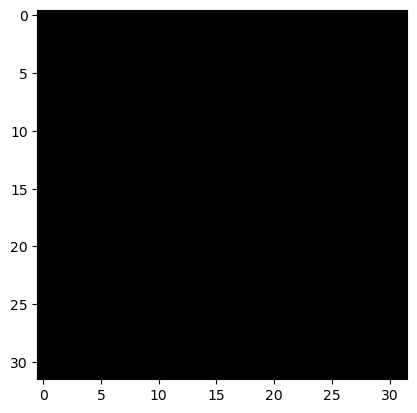

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


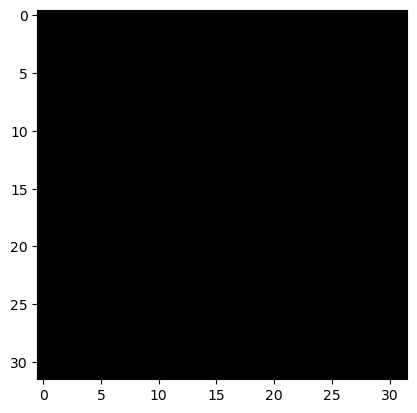

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 28
Predicted Label: 28


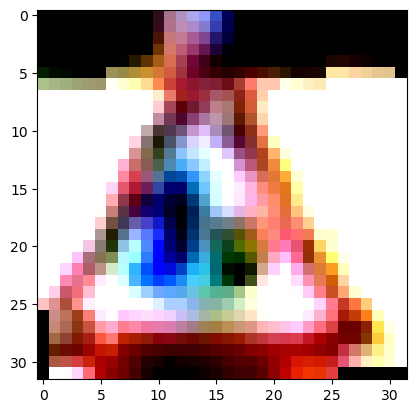

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 36
Predicted Label: 36


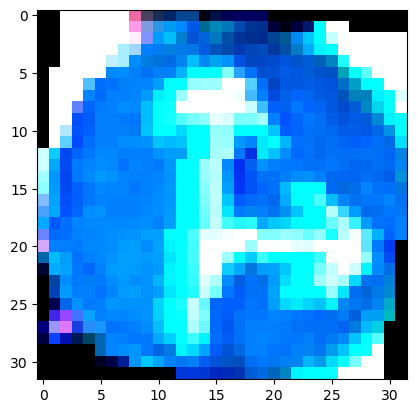

True Label: 11


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 11


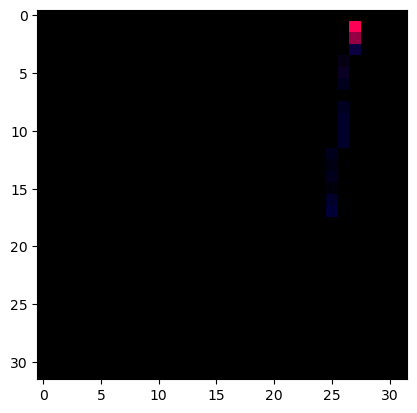

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 30
Predicted Label: 30


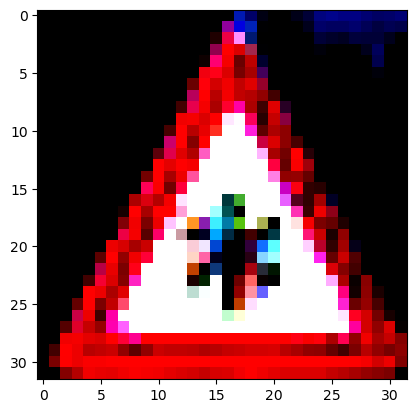

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


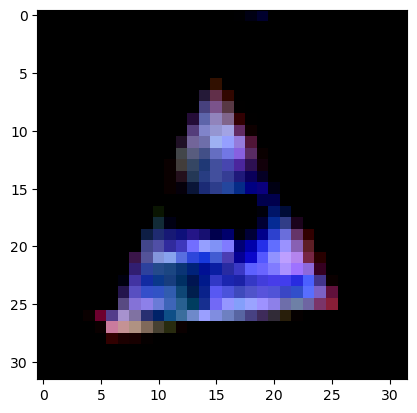

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 29
Predicted Label: 29


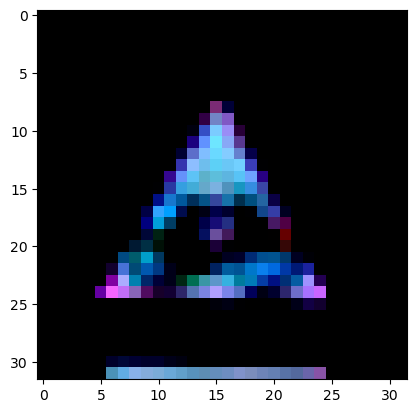

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


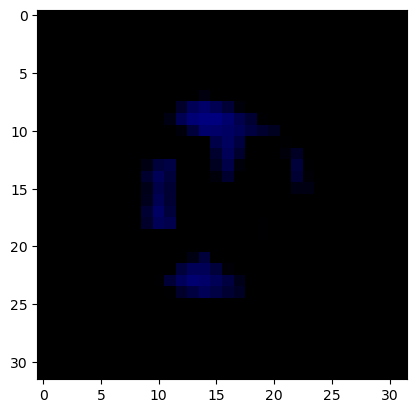

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


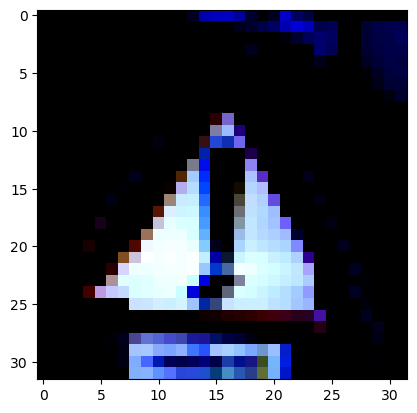

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


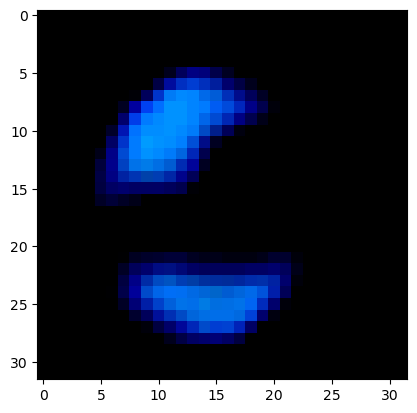

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 31
Predicted Label: 31


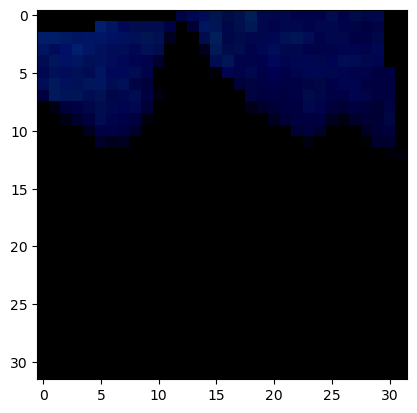

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


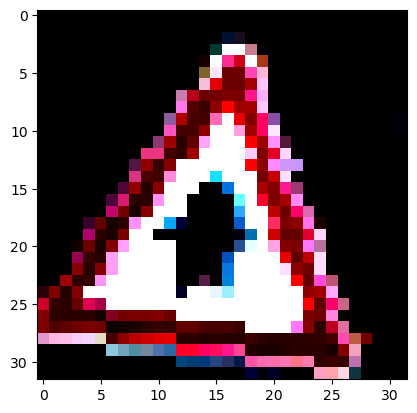

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


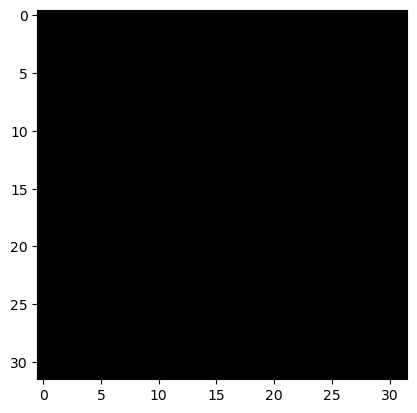

True Label: 11


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 11


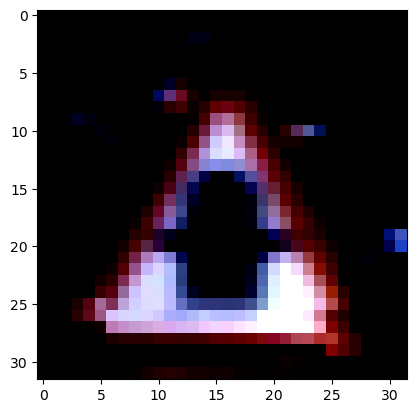

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


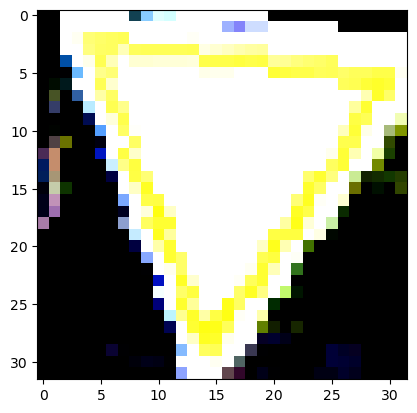

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


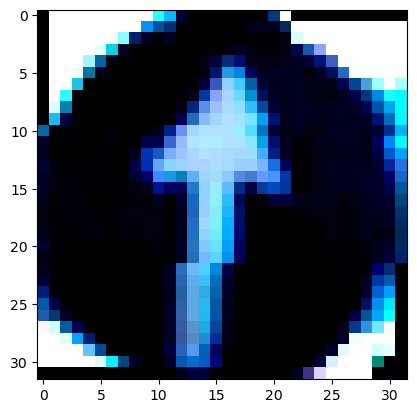

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


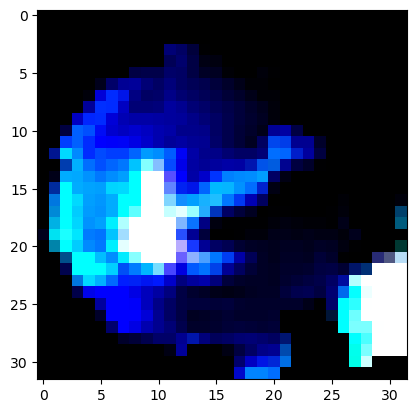

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


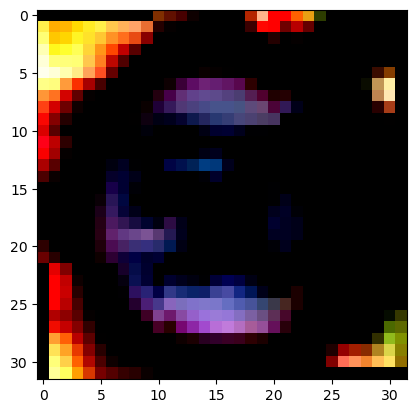

True Label: 11


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 11


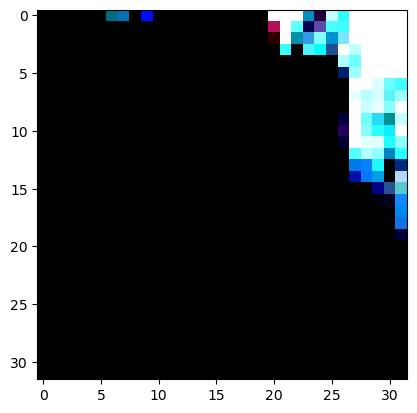

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


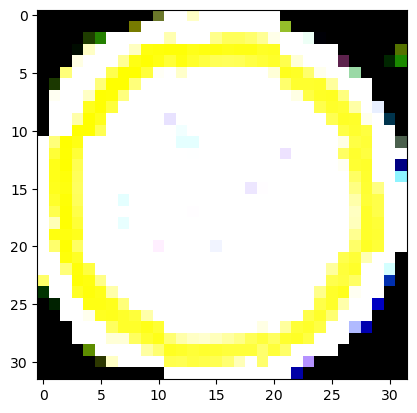

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


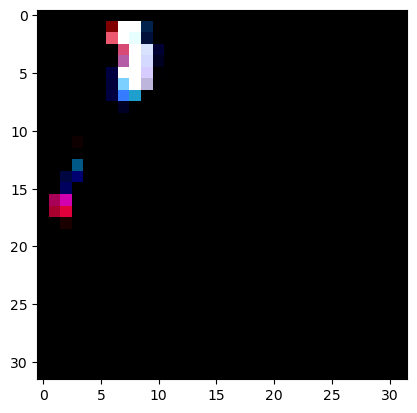

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 5


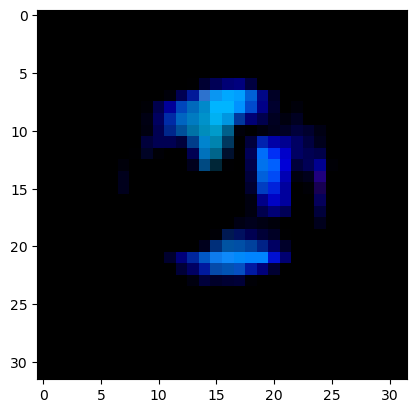

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


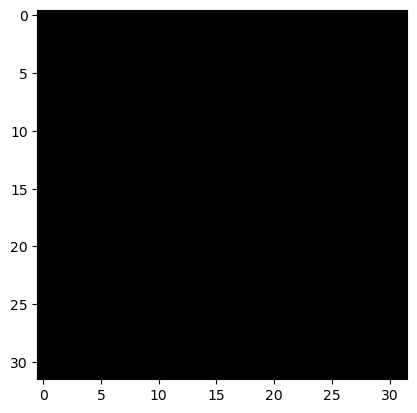

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


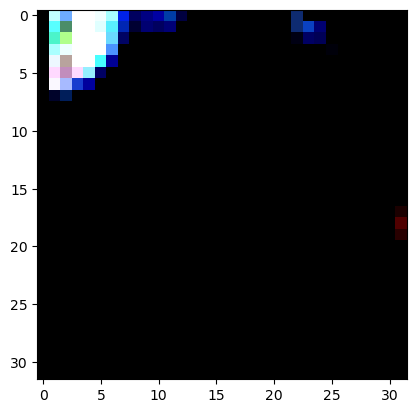

True Label: 35


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 35


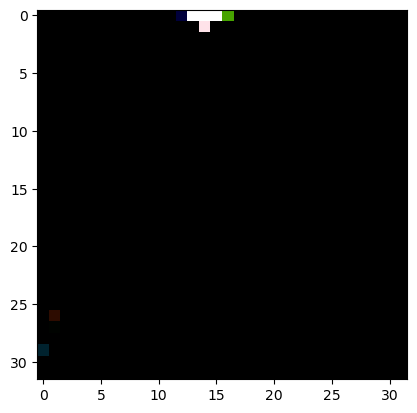

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


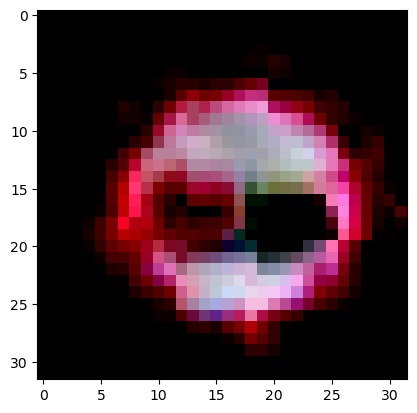

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


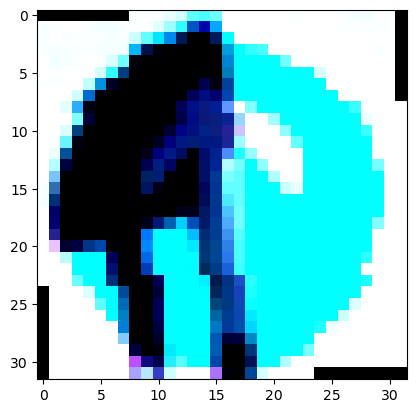

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


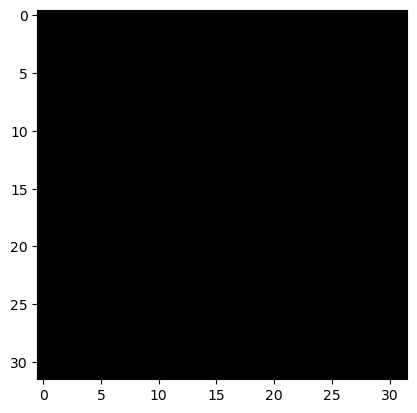

True Label: 5


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 1


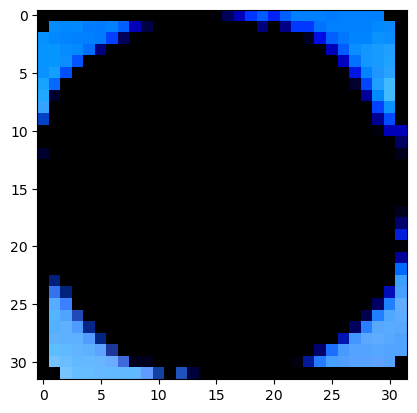

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


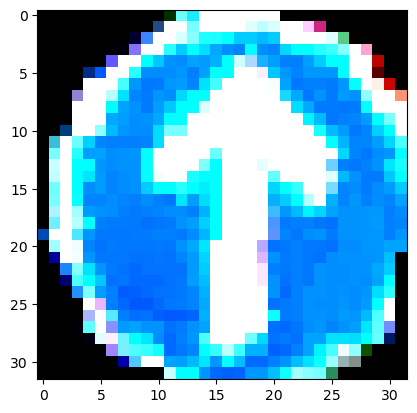

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


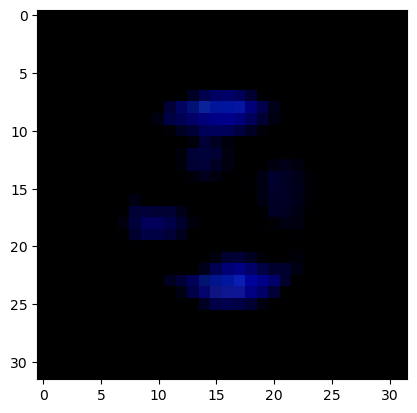

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 6
Predicted Label: 6


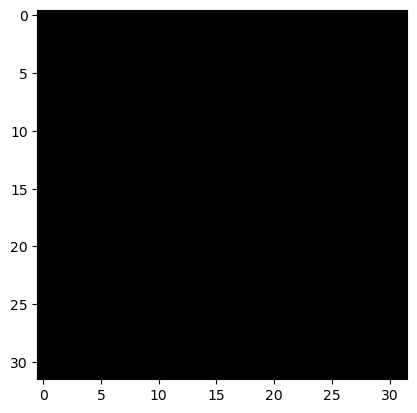

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


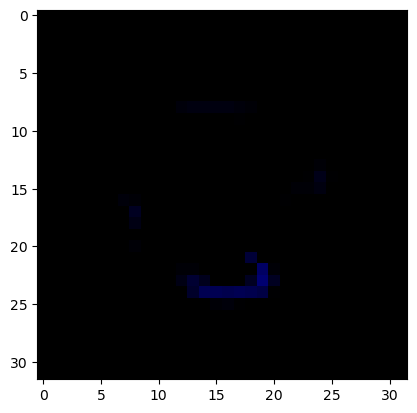

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


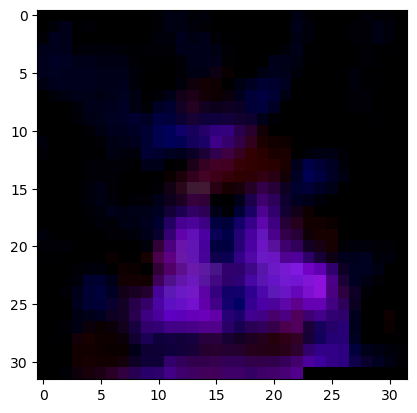

True Label: 10


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 10


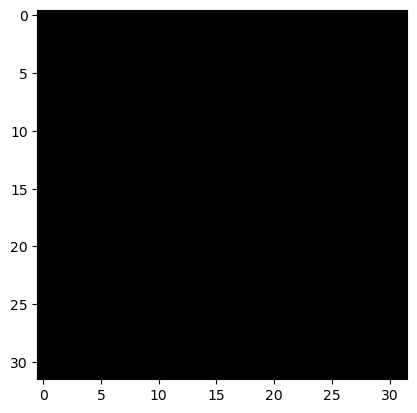

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


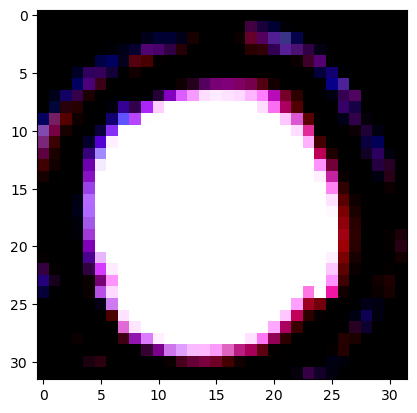

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


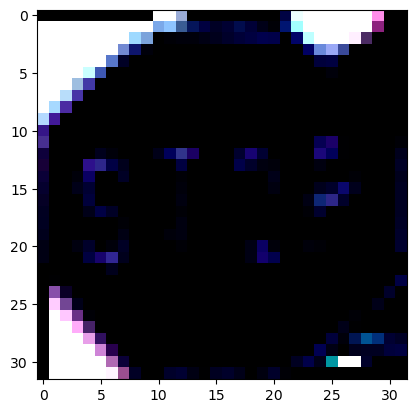

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


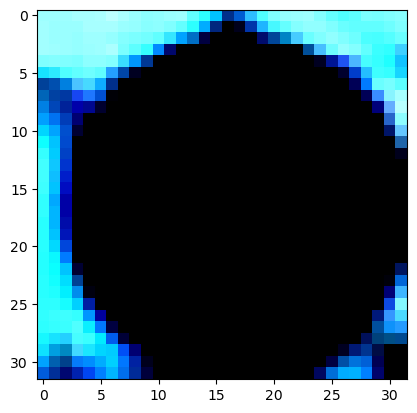

True Label: 25


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 25


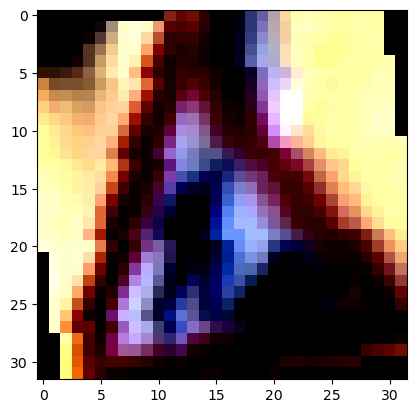

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


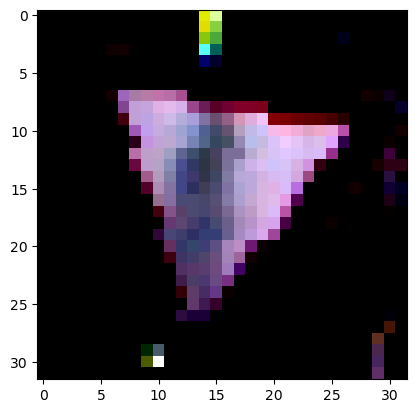

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 4


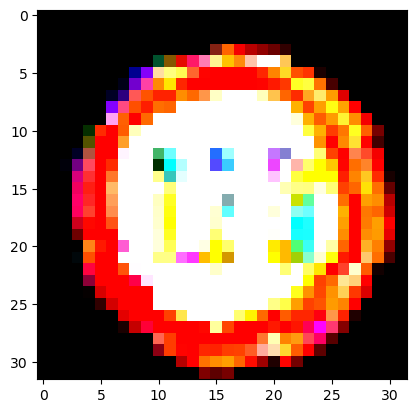

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


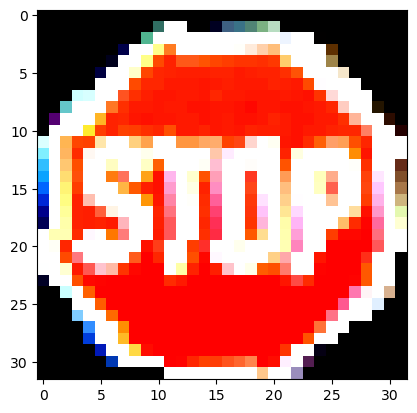

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


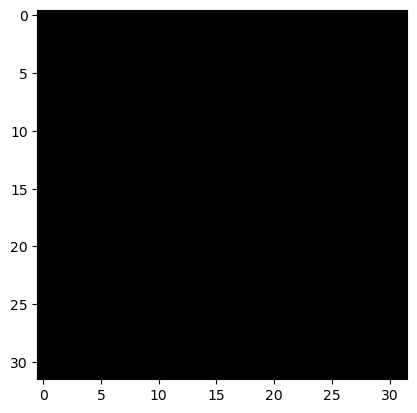

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


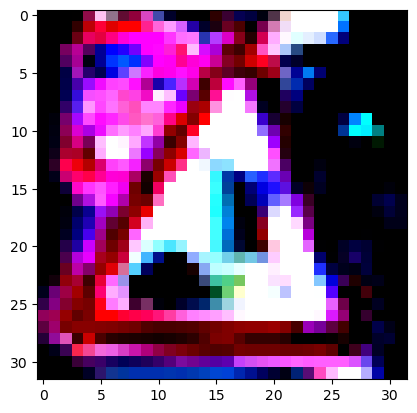

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


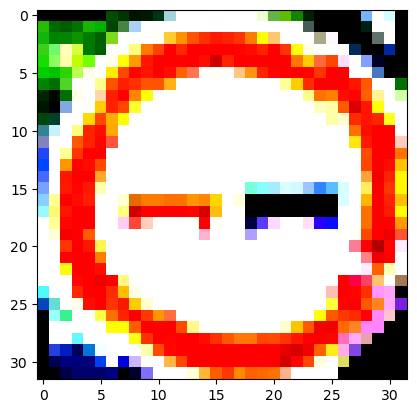

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


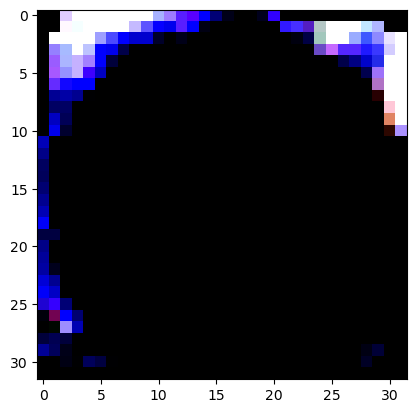

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


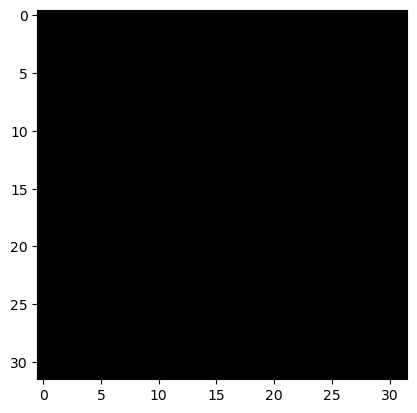

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


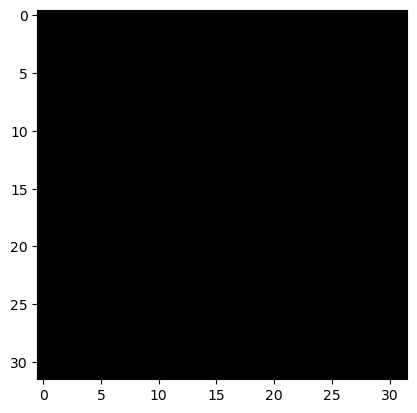

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


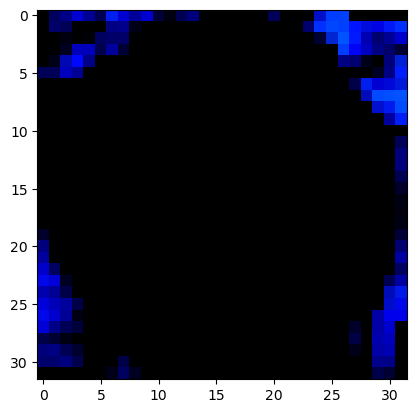

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 20
Predicted Label: 20


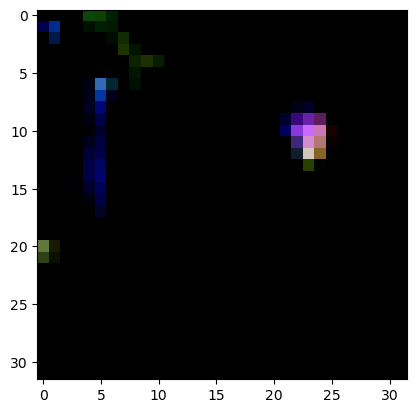

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


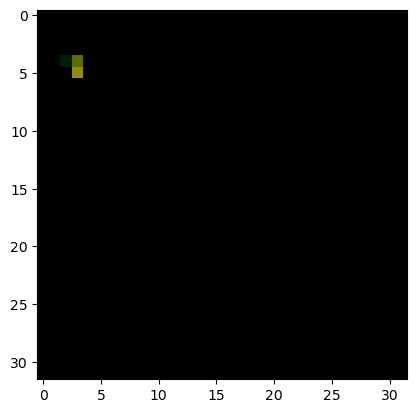

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


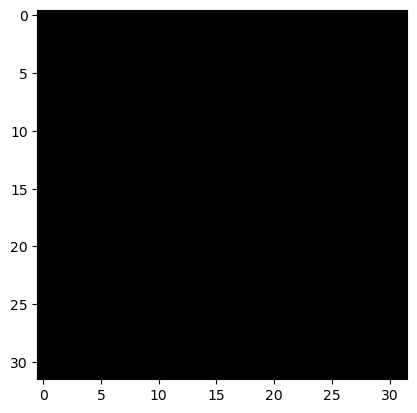

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


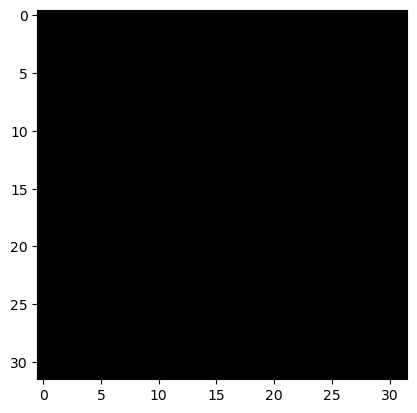

True Label: 1


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 1


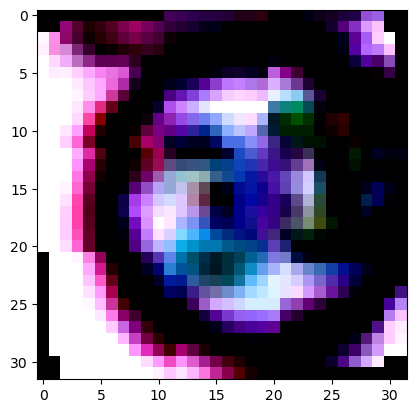

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 22
Predicted Label: 22


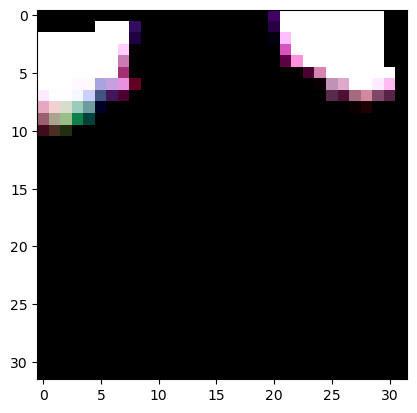

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 31
Predicted Label: 31


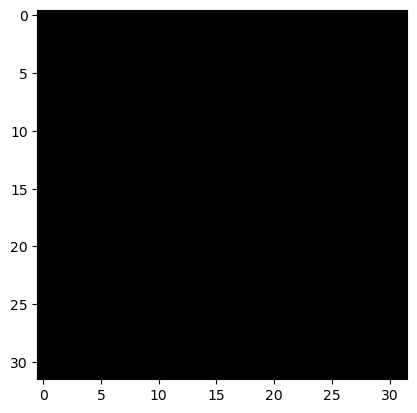

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


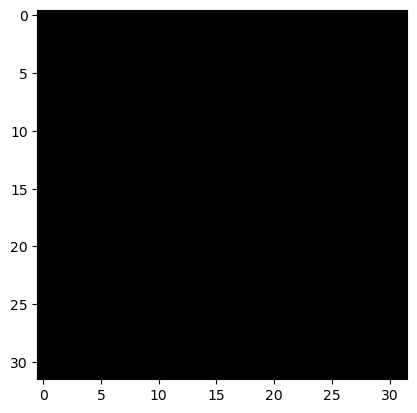

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


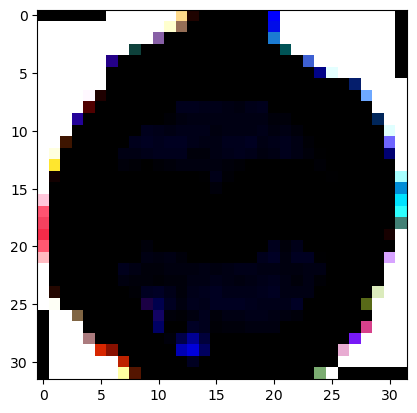

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


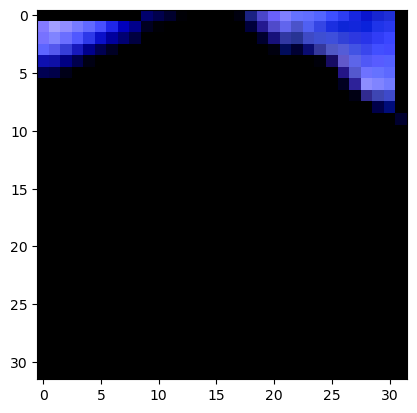

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


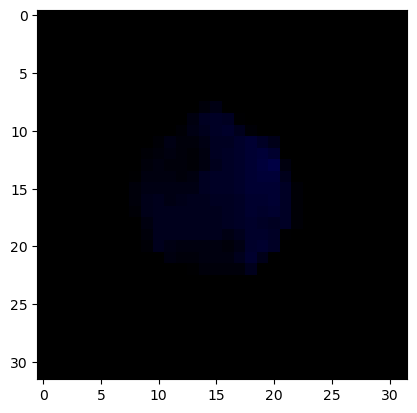

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


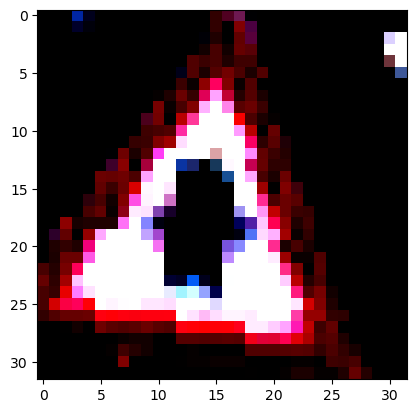

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


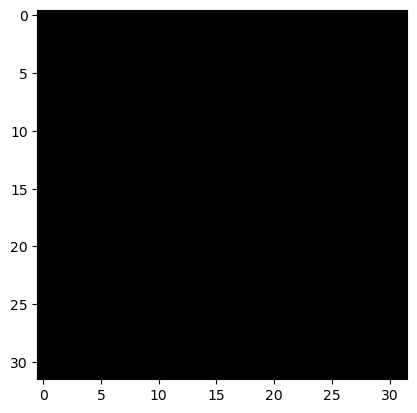

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


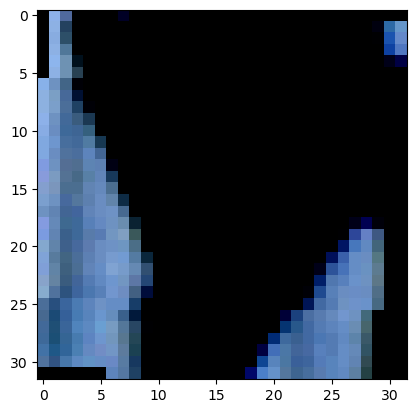

True Label: 25


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 25


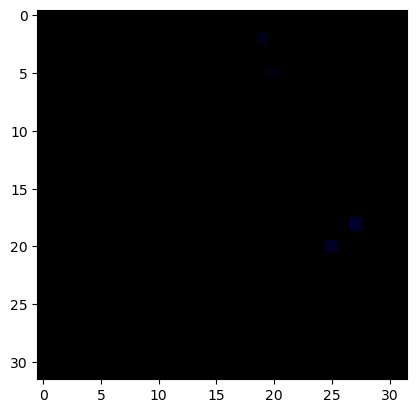

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


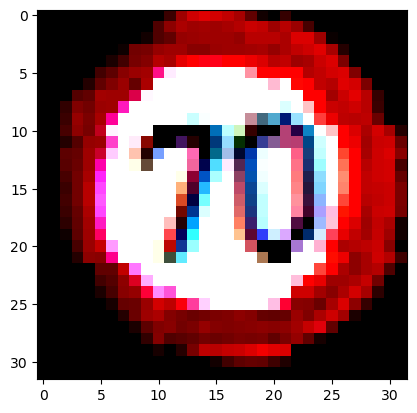

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


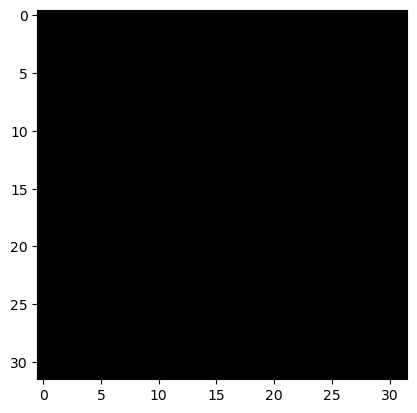

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


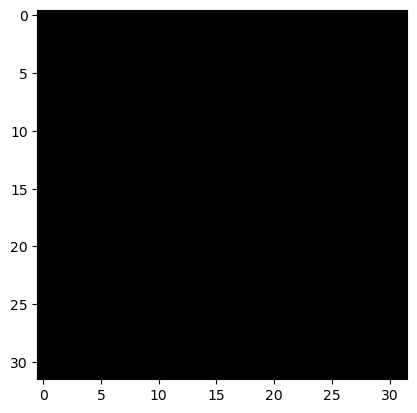

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


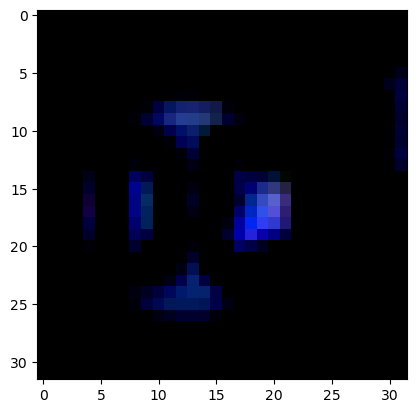

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


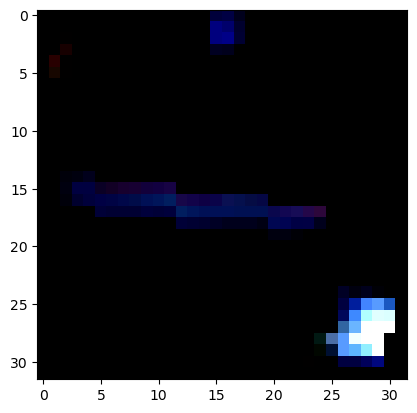

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


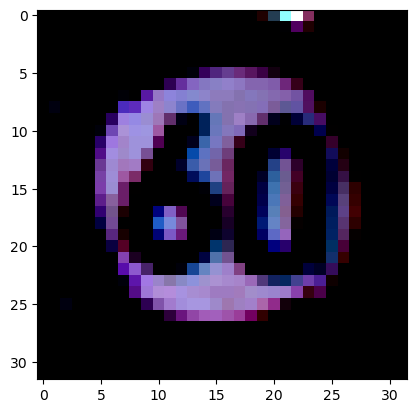

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


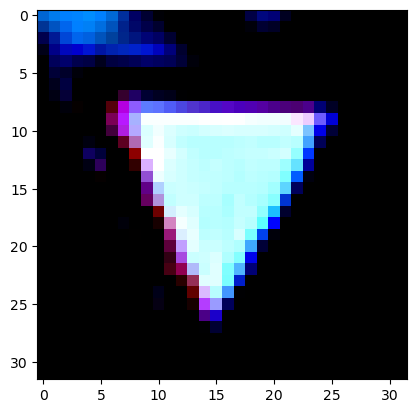

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


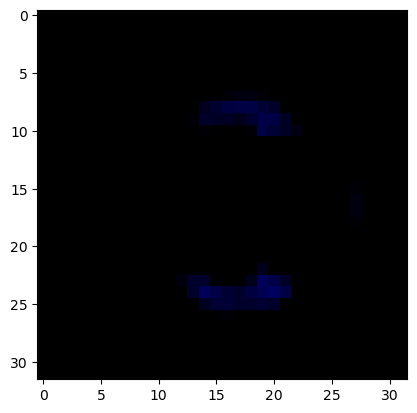

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


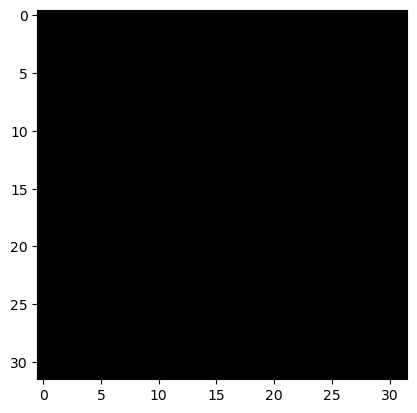

True Label: 2


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 2


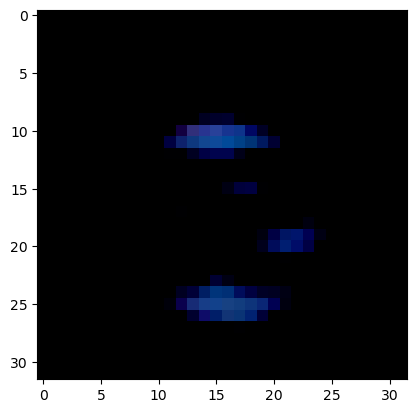

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


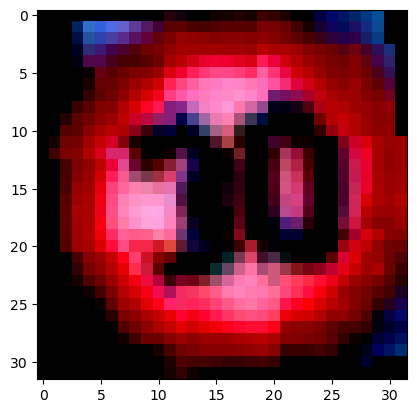

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


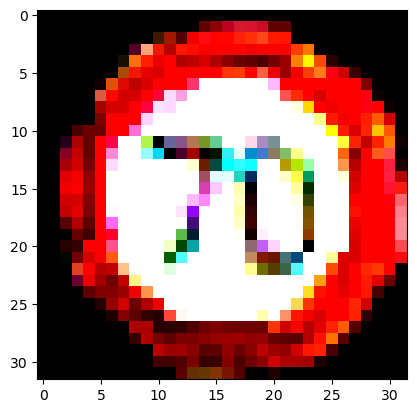

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


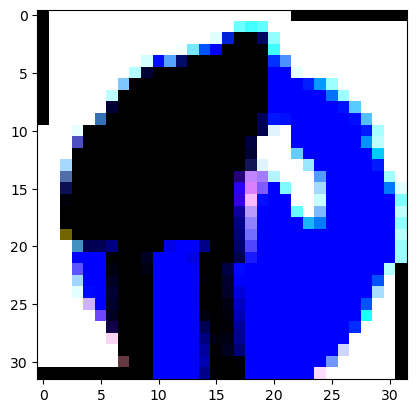

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


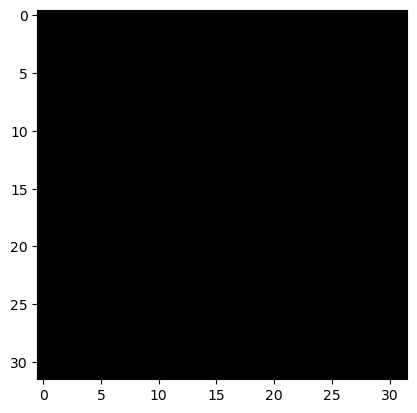

True Label: 25


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 25


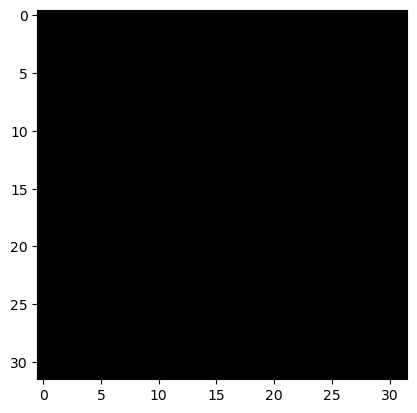

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


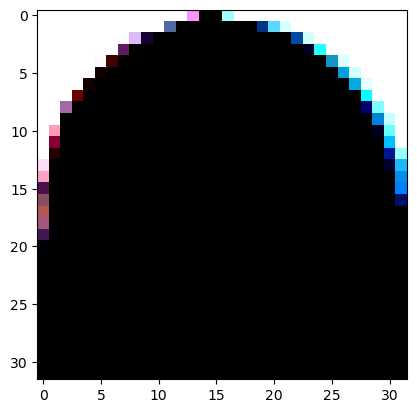

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


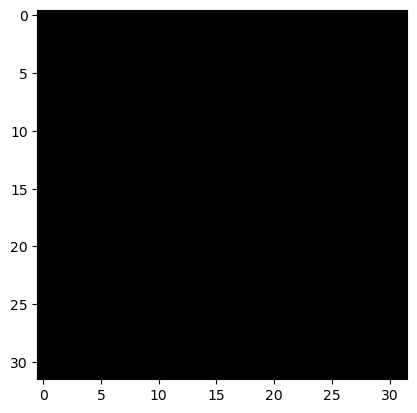

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


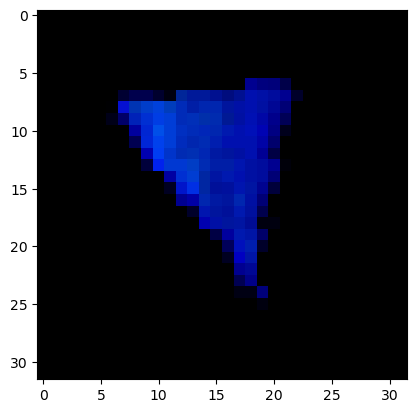

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 26
Predicted Label: 26


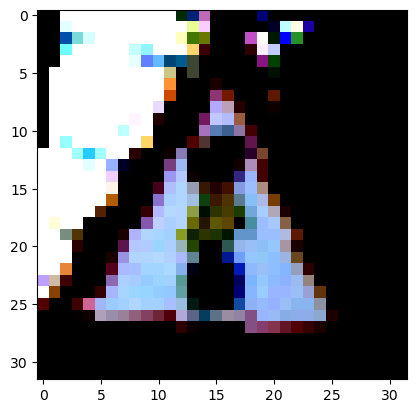

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


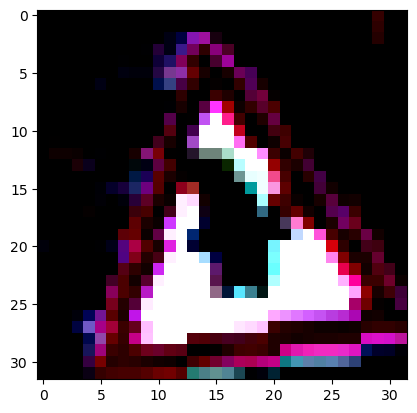

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


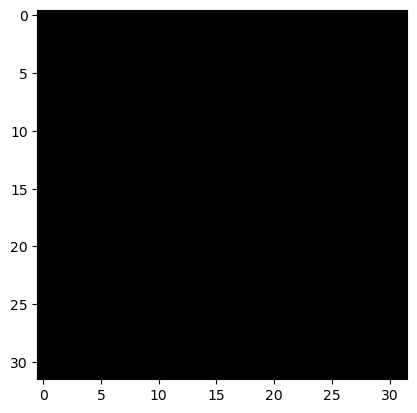

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


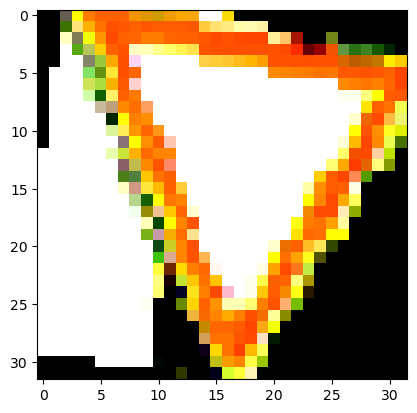

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


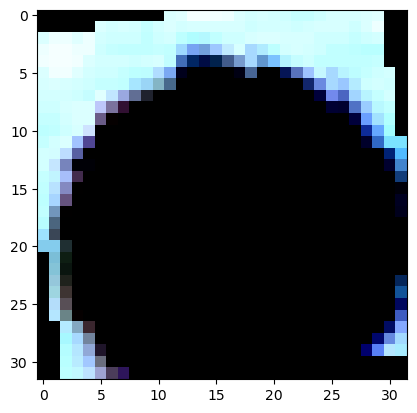

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


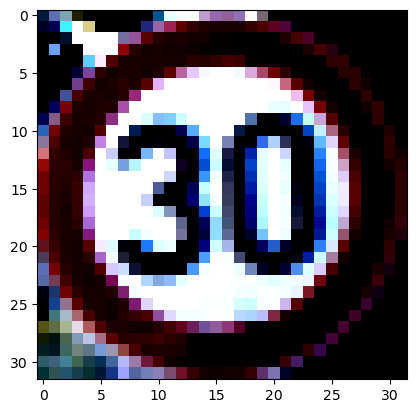

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


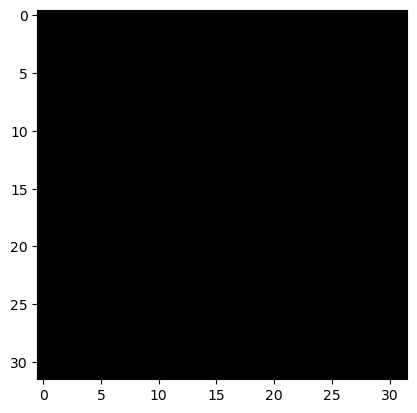

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


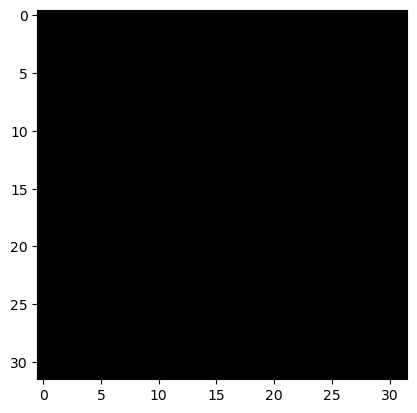

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 39
Predicted Label: 39


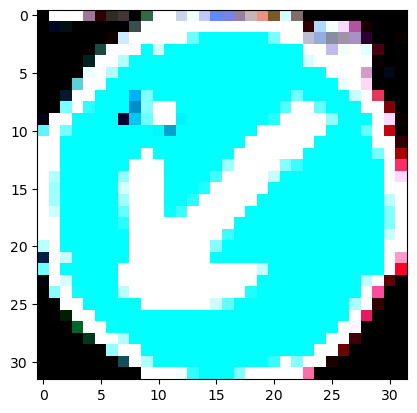

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


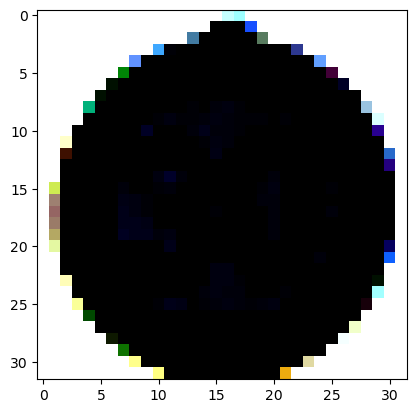

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


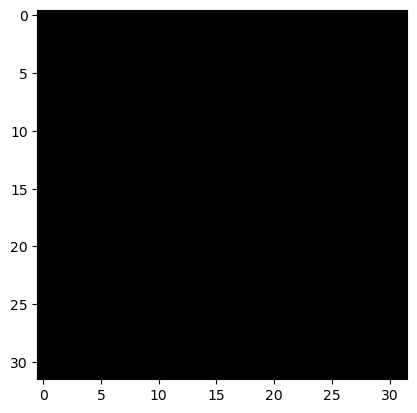

True Label: 26


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 26


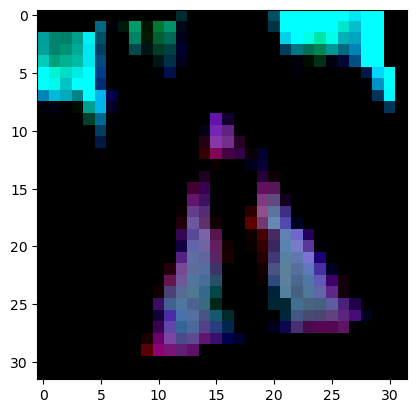

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


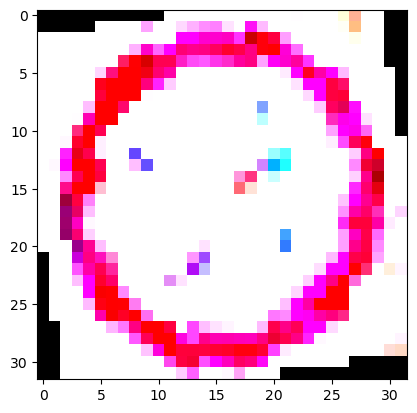

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


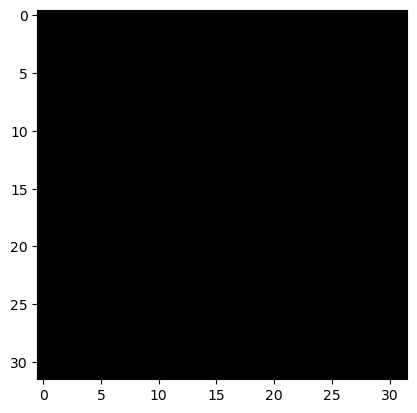

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 41
Predicted Label: 41


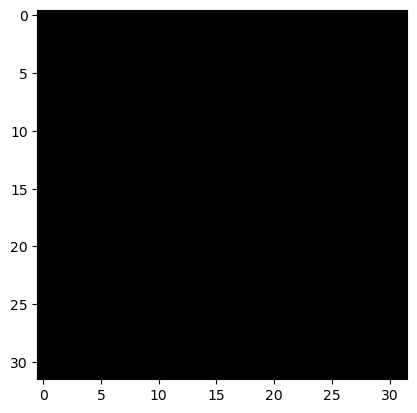

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


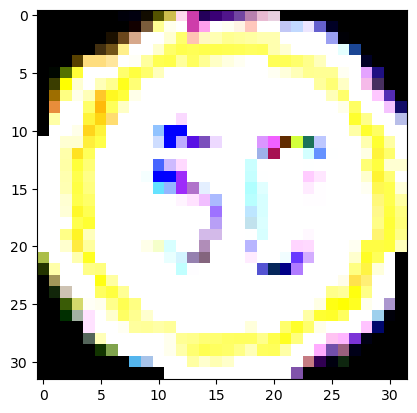

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 41
Predicted Label: 41


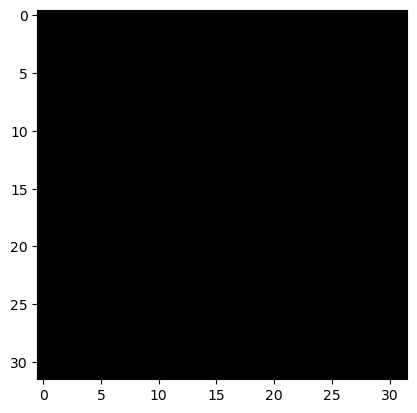

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


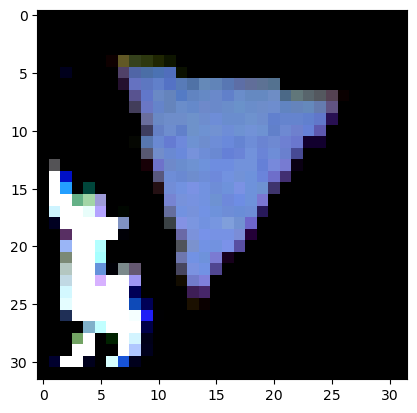

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


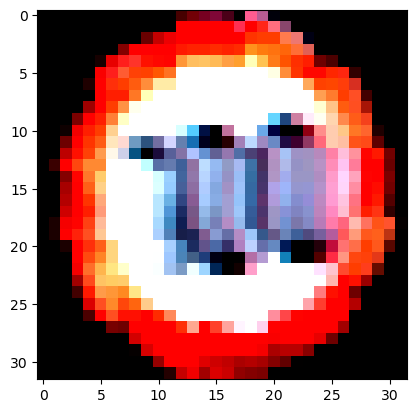

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 21


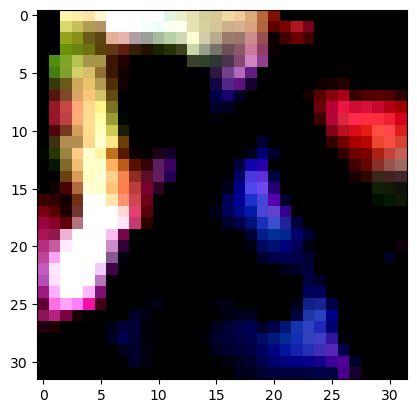

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


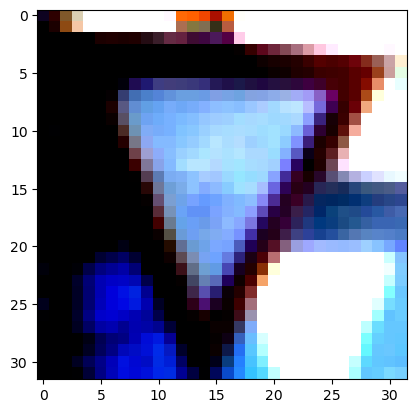

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


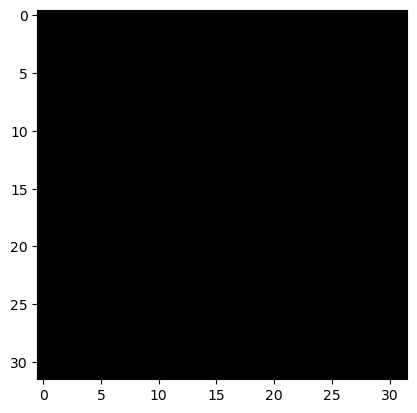

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


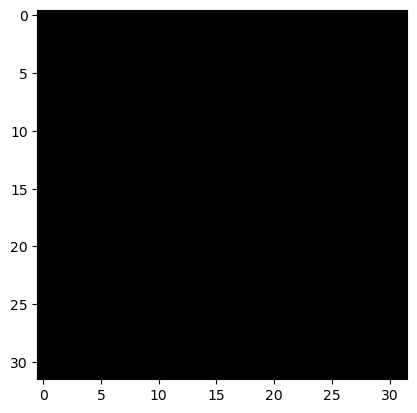

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


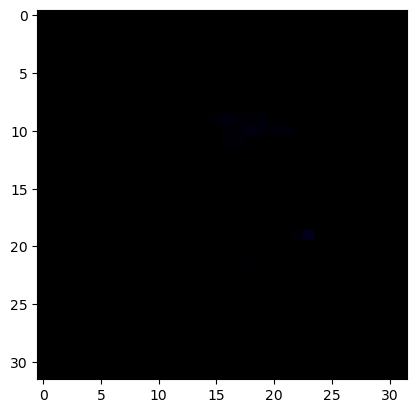

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


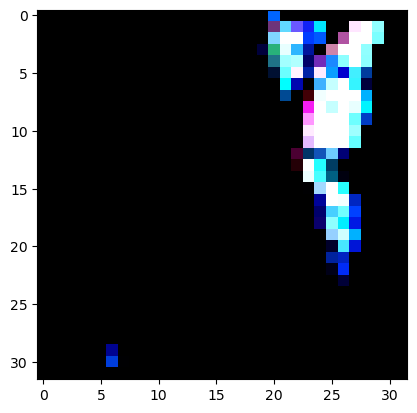

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


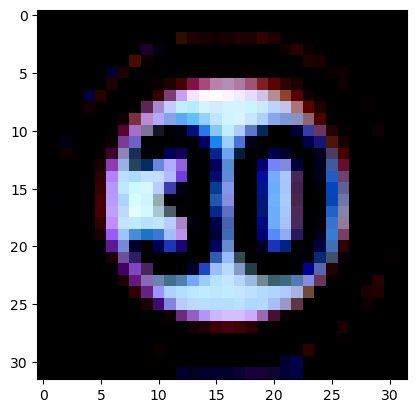

In [11]:
import matplotlib.pyplot as plt
import numpy as np
import torchvision

def imshow(img):
    img = img.cpu().numpy().transpose((1, 2, 0))  # Convert from Tensor image
    plt.imshow(img)
    plt.show()

model.eval()  # Set the model to evaluation mode

with torch.no_grad():
    for data in test_loader:
        images, labels = data['image'].to(device), data['label'].to(device)
        outputs = model(images)
        _, predicted = torch.max(outputs, 1)

        # Display images and labels
        for i in range(len(images)):
            print("True Label:", labels[i].item())
            print("Predicted Label:", predicted[i].item())
            imshow(torchvision.utils.make_grid(images[i]))
            if i == 4:  # Display first 5 images from the batch
                break


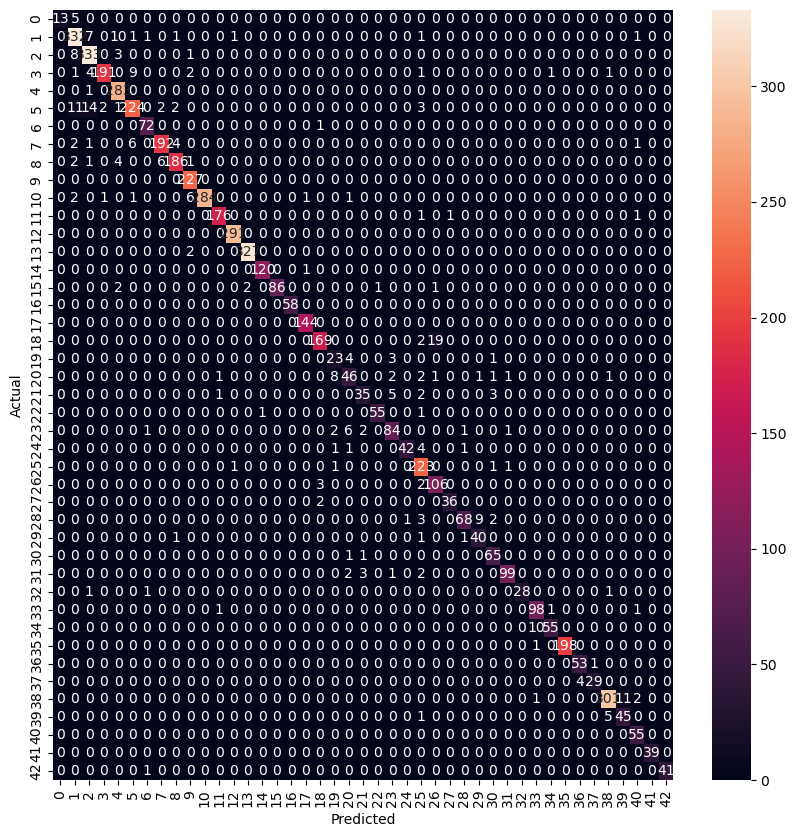

              precision    recall  f1-score   support

           0       1.00      0.72      0.84        18
           1       0.91      0.94      0.92       355
           2       0.92      0.97      0.94       345
           3       0.98      0.91      0.95       210
           4       0.93      1.00      0.96       284
           5       0.93      0.86      0.90       259
           6       0.95      0.99      0.97        73
           7       0.96      0.93      0.95       206
           8       0.96      0.93      0.94       200
           9       0.95      1.00      0.97       227
          10       1.00      0.96      0.98       296
          11       0.98      0.98      0.98       179
          12       0.99      1.00      1.00       291
          13       0.99      0.99      0.99       329
          14       0.99      0.99      0.99       121
          15       1.00      0.93      0.97        92
          16       1.00      1.00      1.00        58
          17       0.99    

In [12]:
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns

model.eval()  # Set the model to evaluation mode
y_pred = []
y_true = []

with torch.no_grad():
    for data in test_loader:
        images, labels = data['image'].to(device), data['label'].to(device)
        outputs = model(images)
        _, predicted = torch.max(outputs, 1)
        y_pred.extend(predicted.tolist())
        y_true.extend(labels.tolist())

# Generate the confusion matrix
cm = confusion_matrix(y_true, y_pred)

# Plot the confusion matrix
plt.figure(figsize=(10,10))
sns.heatmap(cm, annot=True, fmt="d")
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.show()

print(classification_report(y_true, y_pred))

Through the results, I found that lable19 and 20 have lower accuracy than others. After research, I found that it may be because these two signs are similar to mirror images, which may lead to wrong judgments.

In [13]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

accuracy = accuracy_score(y_true, y_pred)
precision = precision_score(y_true, y_pred, average='weighted')
recall = recall_score(y_true, y_pred, average='weighted')
f1 = f1_score(y_true, y_pred, average='weighted')

print(f"Accuracy: {accuracy:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1-Score: {f1:.4f}")

accuracy_values.append(float(accuracy * 100))
precision_values.append(float(precision * 100))
recall_values.append(float(recall * 100))
f1score_values.append(float(f1 * 100))

Accuracy: 0.9473
Precision: 0.9489
Recall: 0.9473
F1-Score: 0.9472


In [14]:
model.eval()
import time

num_runs = 10
total_time = 0

with torch.no_grad():
    for _ in range(num_runs):
        batch_time = 0
        for data in test_loader:
            images, labels = data['image'].to(device), data['label'].to(device)
            start_time = time.time()  # Start time for the batch
            outputs = model(images)
            end_time = time.time()  # End time for the batch
            batch_time += (end_time - start_time)
        total_time += batch_time

average_inference_time = total_time / (num_runs * len(test_loader))
print(f"Average inference time per batch over {num_runs} runs: {average_inference_time} seconds")

Average_inference_time.append(average_inference_time)


Average inference time per batch over 10 runs: 0.005510655693385912 seconds


### DenseNet

DenseNet model is a variation of the popular Dense Convolutional Network (DenseNet) architecture, known for its efficiency in parameter usage and its feature reuse capabilities. 

The architecture visualization of DenseNet would involve illustrating the sequence of layers, including DenseBlocks and Transition layers, and how they connect. Each DenseLayer within a DenseBlock concatenates its output with its input. Transition layers downsample the feature maps. Finally, the network culminates in a classification layer.

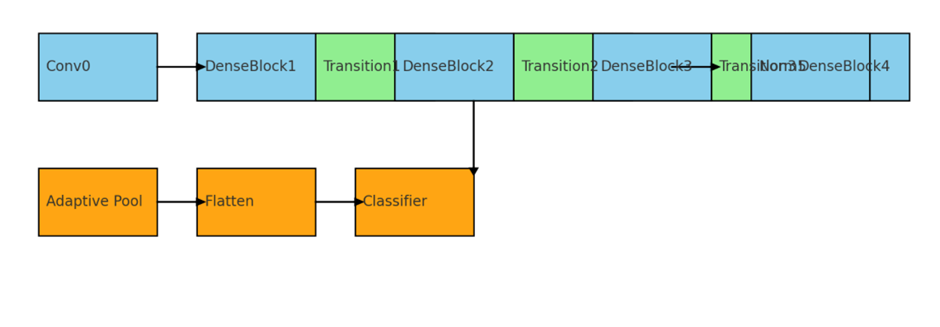

•	Conv0: The initial convolutional layer.

•	DenseBlock1 to DenseBlock4: The core of the DenseNet, where each block consists of multiple dense layers. In this model, the number of layers in each block is determined by the block_config parameter.

•	Transition1 to Transition3: These layers are placed between DenseBlocks to reduce the dimensions of feature maps.
•	Norm5: The final batch normalization layer.

•	Adaptive Pool: Adaptive average pooling layer that resizes the feature maps to a fixed size.

•	Flatten: Flattens the output from the pooling layer into a 1D vector.

•	Classifier: The final fully connected layer that outputs the class probabilities.

This visualization is a high-level representation. In reality, each DenseBlock contains several DenseLayers, where each DenseLayer performs a series of operations (BatchNorm, ReLU, Convolution) and concatenates its output to its input, promoting feature reuse.


In [15]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from collections import OrderedDict

class _DenseLayer(nn.Sequential):
    def __init__(self, num_input_features, growth_rate, bn_size, drop_rate):
        super(_DenseLayer, self).__init__()
        self.add_module('norm1', nn.BatchNorm2d(num_input_features)),
        self.add_module('relu1', nn.ReLU(inplace=True)),
        self.add_module('conv1', nn.Conv2d(num_input_features, bn_size * growth_rate,
                        kernel_size=1, stride=1, bias=False)),
        self.add_module('norm2', nn.BatchNorm2d(bn_size * growth_rate)),
        self.add_module('relu2', nn.ReLU(inplace=True)),
        self.add_module('conv2', nn.Conv2d(bn_size * growth_rate, growth_rate,
                        kernel_size=3, stride=1, padding=1, bias=False)),
        self.drop_rate = drop_rate

    def forward(self, x):
        new_features = super(_DenseLayer, self).forward(x)
        if self.drop_rate > 0:
            new_features = F.dropout(new_features, p=self.drop_rate, training=self.training)
        return torch.cat([x, new_features], 1)

class _DenseBlock(nn.Sequential):
    def __init__(self, num_layers, num_input_features, bn_size, growth_rate, drop_rate):
        super(_DenseBlock, self).__init__()
        for i in range(num_layers):
            layer = _DenseLayer(num_input_features + i * growth_rate, growth_rate, bn_size, drop_rate)
            self.add_module('denselayer%d' % (i + 1), layer)

class _Transition(nn.Sequential):
    def __init__(self, num_input_features, num_output_features):
        super(_Transition, self).__init__()
        self.add_module('norm', nn.BatchNorm2d(num_input_features))
        self.add_module('relu', nn.ReLU(inplace=True))
        self.add_module('conv', nn.Conv2d(num_input_features, num_output_features,
                                          kernel_size=1, stride=1, bias=False))
        self.add_module('pool', nn.AvgPool2d(kernel_size=2, stride=2))

class DenseNet(nn.Module):
    def __init__(self, growth_rate=32, block_config=(6, 12, 24, 16),
                 num_init_features=64, bn_size=4, drop_rate=0, num_classes=43):
        super(DenseNet, self).__init__()

        # First convolution
        self.features = nn.Sequential(OrderedDict([
            ('conv0', nn.Conv2d(3, num_init_features, kernel_size=7, stride=2, padding=3, bias=False)),
            ('norm0', nn.BatchNorm2d(num_init_features)),
            ('relu0', nn.ReLU(inplace=True)),
            ('pool0', nn.MaxPool2d(kernel_size=3, stride=2, padding=1)),
        ]))

        # Each denseblock
        num_features = num_init_features
        for i, num_layers in enumerate(block_config):
            block = _DenseBlock(num_layers=num_layers, num_input_features=num_features,
                                bn_size=bn_size, growth_rate=growth_rate, drop_rate=drop_rate)
            self.features.add_module('denseblock%d' % (i + 1), block)
            num_features = num_features + num_layers * growth_rate
            if i != len(block_config) - 1:
                trans = _Transition(num_input_features=num_features, num_output_features=num_features // 2)
                self.features.add_module('transition%d' % (i + 1), trans)
                num_features = num_features // 2

        # Final batch norm
        self.features.add_module('norm5', nn.BatchNorm2d(num_features))

        # Linear layer
        self.classifier = nn.Linear(num_features, num_classes)

        # Official init from torch repo.
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight)
            elif isinstance(m, nn.BatchNorm2d):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)
            elif isinstance(m, nn.Linear):
                nn.init.constant_(m.bias, 0)

    def forward(self, x):
        features = self.features(x)
        out = F.relu(features, inplace=True)
        out = F.adaptive_avg_pool2d(out, (1, 1))
        out = torch.flatten(out, 1)
        out = self.classifier(out)
        return out

#### 1.DenseLayer

##### This is a basic building block of the DenseNet architecture.

##### 	Each DenseLayer consists of:

Batch normalization

ReLU activation

A 1×1 convolution to reduce the number of features (bottleneck layer)

Another batch normalization

Another ReLU activation

A 3×3 convolution

##### The drop_rate applies dropout, which can help prevent overfitting.

##### The output of a DenseLayer is concatenated with its input, allowing feature reuse.

#### 2.DenseBlock


##### A DenseBlock is a sequence of DenseLayers.

##### The number of layers in a block is defined by num_layers.

##### Each layer in the block adds growth_rate number of features.

#### 3.Transition:

##### Used between DenseBlocks.

##### Comprises batch normalization, ReLU activation, a 1×1 convolution, and a 2×2 average pooling layer.

##### It reduces the number of features by half, helping to control model complexity.

#### 4.Overall Network Structure:

##### The network starts with a convolutional layer (conv0) followed by batch normalization, ReLU activation, and a max-pooling layer.

##### This is followed by a series of DenseBlocks and Transition layers. The number and size of these blocks are defined by block_config.

##### After the final DenseBlock, a batch normalization (norm5) is applied.

##### The network concludes with an adaptive average pooling layer, flattening, and a fully connected layer (classifier) for classification.


Epoch 1, Training loss: 1.5112685932146086, Training Accuracy: 53.577934853894924%, Validation Loss: 0.7684939416206401, Validation Accuracy: 74.42611800714164%
Epoch 2, Training loss: 0.45321414784673764, Training Accuracy: 84.92676528455877%, Validation Loss: 0.3705241101915422, Validation Accuracy: 87.62115286515899%
Epoch 3, Training loss: 0.2515387453989827, Training Accuracy: 91.70735261968957%, Validation Loss: 0.24499495708100175, Validation Accuracy: 91.97415405543275%
Epoch 4, Training loss: 0.18912917658651904, Training Accuracy: 93.78415798294833%, Validation Loss: 0.23147234393526678, Validation Accuracy: 92.21220880802585%
Epoch 5, Training loss: 0.14056367147062626, Training Accuracy: 95.36908839175108%, Validation Loss: 0.12130416601734317, Validation Accuracy: 95.93606529501785%
Epoch 6, Training loss: 0.11751774710435899, Training Accuracy: 96.21802812796035%, Validation Loss: 0.14794056975971098, Validation Accuracy: 95.20489712633906%
Epoch 7, Training loss: 0.10233

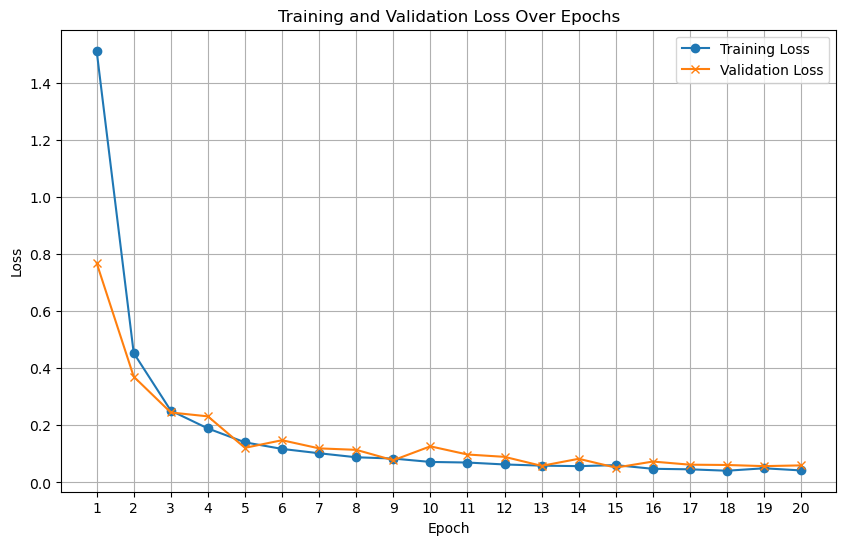

In [16]:
model1 = DenseNet(num_classes=43)  # Adjust num_classes based on your dataset
model1 = model1.to(device)

import torch.optim as optim

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model1.parameters(), lr=0.001)  # You can choose SGD or another optimizer

num_epochs = 20  # Set the number of epochs

# Epoch data
epochs = list(range(1, 21))
training_loss = []
validation_loss = []

for epoch in range(num_epochs):
    # Training Phase
    model1.train()  # Set the model to training mode
    running_loss = 0.0
    correct_train = 0
    total_train = 0

    for i, data in enumerate(train_loader, 0):
        inputs, labels = data['image'].to(device), data['label'].to(device)
        optimizer.zero_grad()
        outputs = model1(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        _, predicted = torch.max(outputs.data, 1)
        total_train += labels.size(0)
        correct_train += (predicted == labels).sum().item()

    train_accuracy = 100 * correct_train / total_train

    # Validation Phase
    model1.eval()  # Set the model to evaluation mode
    val_loss = 0.0
    correct = 0
    total = 0
    with torch.no_grad():
        for data in val_loader:
            images, labels = data['image'].to(device), data['label'].to(device)
            outputs = model1(images)
            loss = criterion(outputs, labels)
            val_loss += loss.item()
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
            
    training_loss.append(running_loss/len(train_loader))
    validation_loss.append(val_loss/len(val_loader))
    
    print(f'Epoch {epoch+1}, Training loss: {running_loss/len(train_loader)}, Training Accuracy: {train_accuracy}%, Validation Loss: {val_loss/len(val_loader)}, Validation Accuracy: {100 * correct / total}%')

print('Finished Training')

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(epochs, training_loss, label='Training Loss', marker='o')
plt.plot(epochs, validation_loss, label='Validation Loss', marker='x')
plt.title('Training and Validation Loss Over Epochs')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.show()

In [17]:
model1.eval()  # Set the model to evaluation mode

correct = 0
total = 0
with torch.no_grad():  # No need to track gradients for testing
    for data in test_loader:
        images, labels = data['image'].to(device), data['label'].to(device)
        outputs = model1(images)
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

test_accuracy = 100 * correct / total
print(f'Accuracy of the model1 on the test images: {test_accuracy}%')

ModelAccuracies.append(test_accuracy)

Accuracy of the model1 on the test images: 98.04488269296158%


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


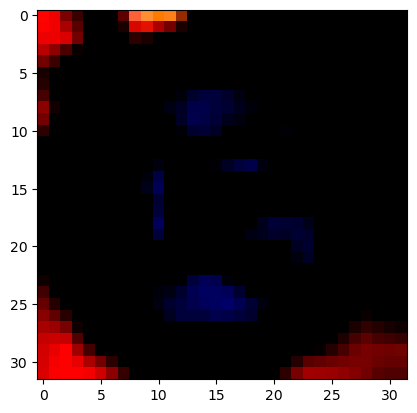

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


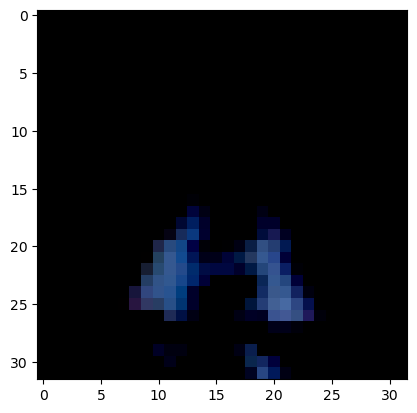

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 28
Predicted Label: 28


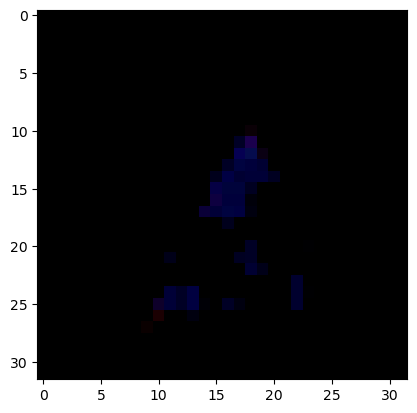

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 28
Predicted Label: 28


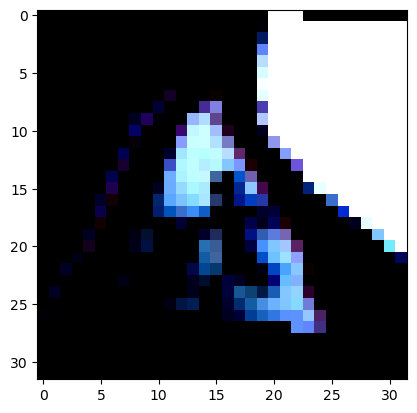

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


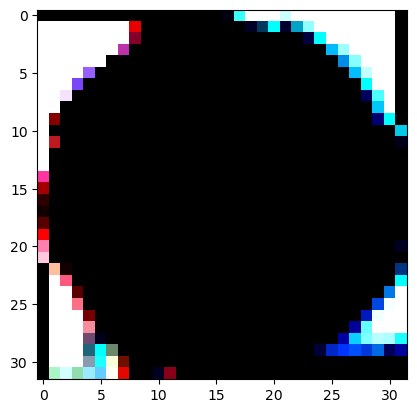

True Label: 10


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 10


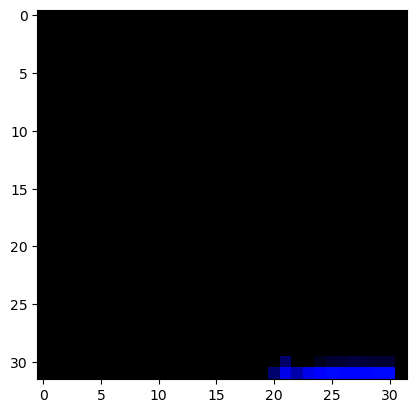

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 22
Predicted Label: 22


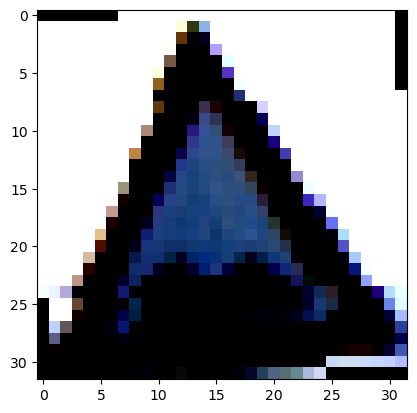

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


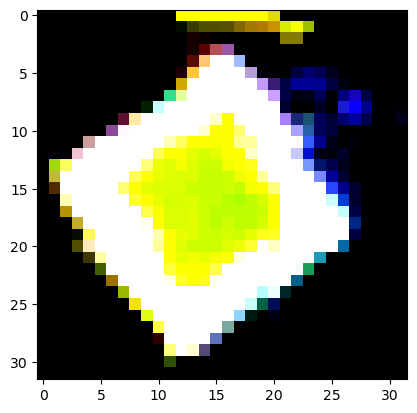

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


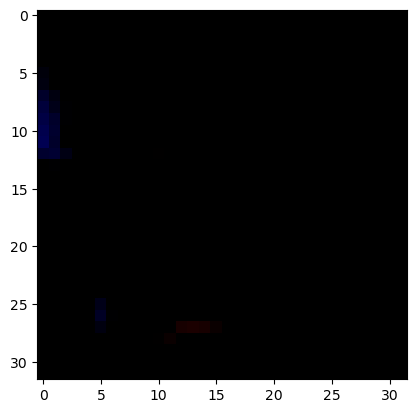

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


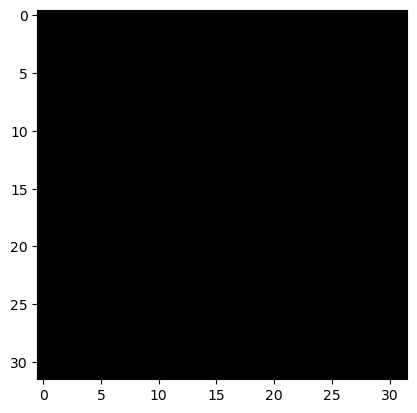

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 36
Predicted Label: 36


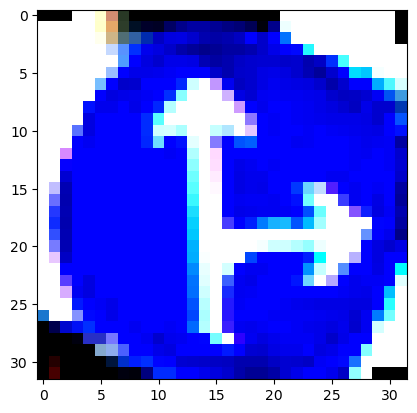

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


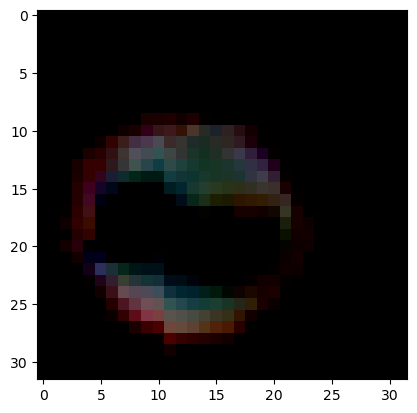

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


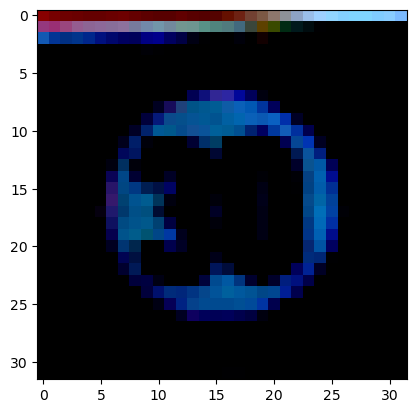

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


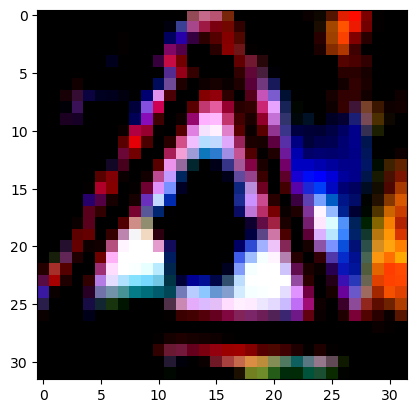

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 31
Predicted Label: 31


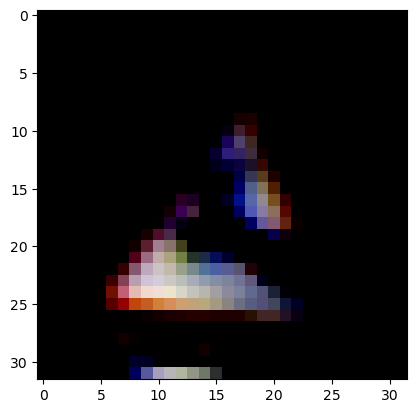

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


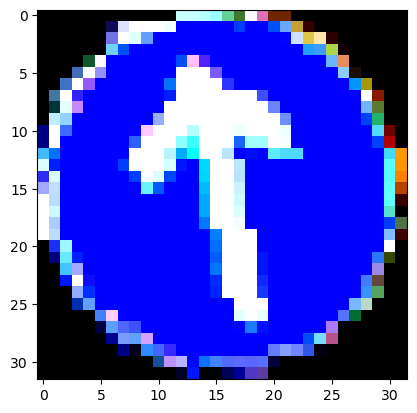

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 22
Predicted Label: 22


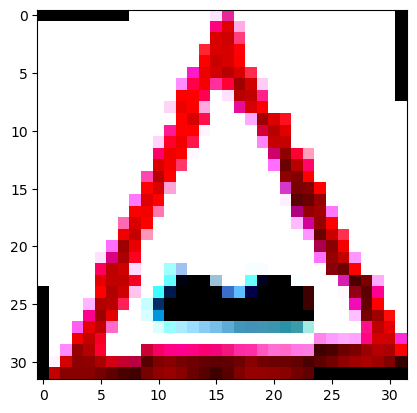

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


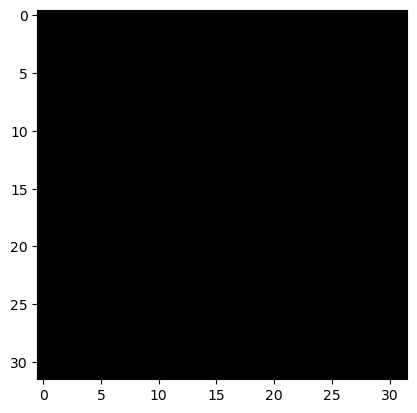

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


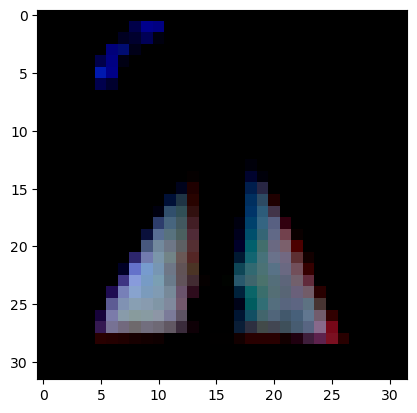

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


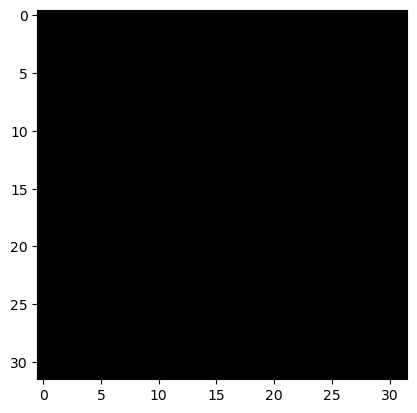

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


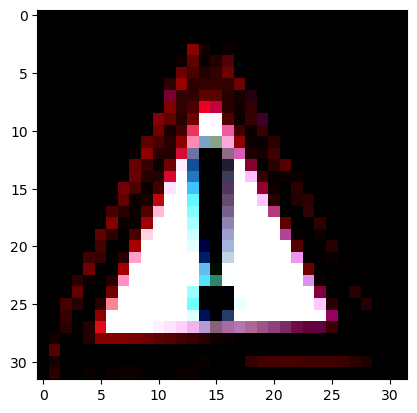

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


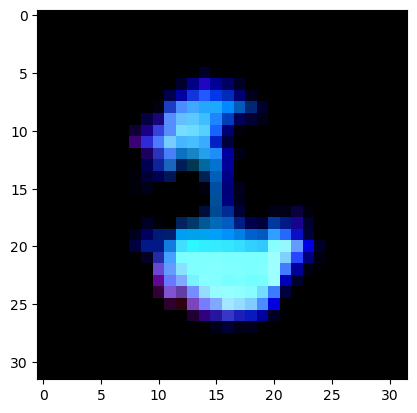

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


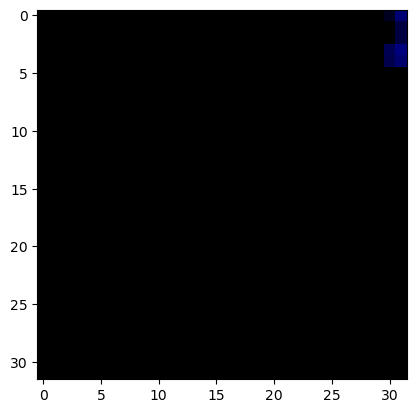

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


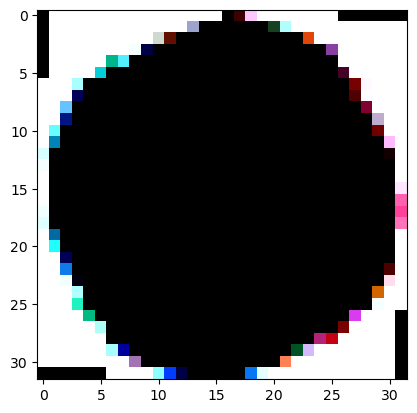

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


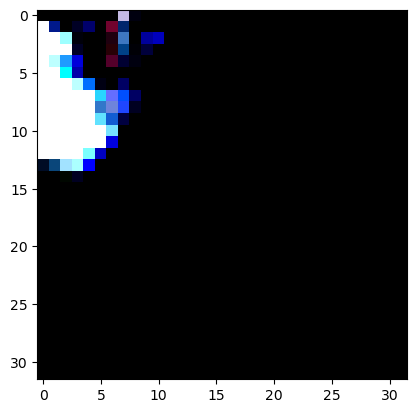

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


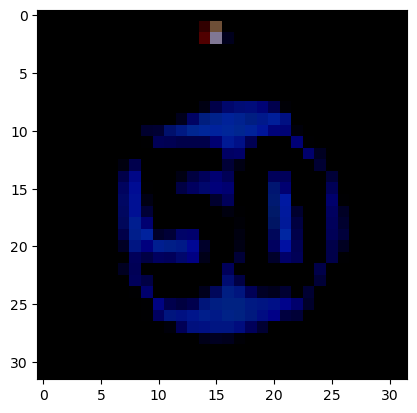

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


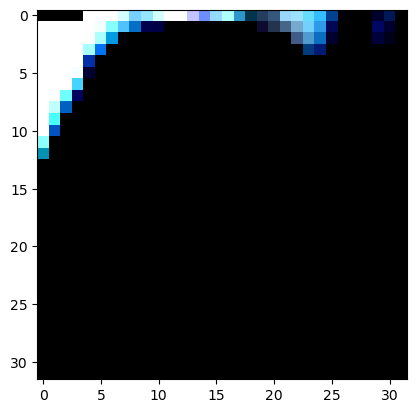

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 22
Predicted Label: 22


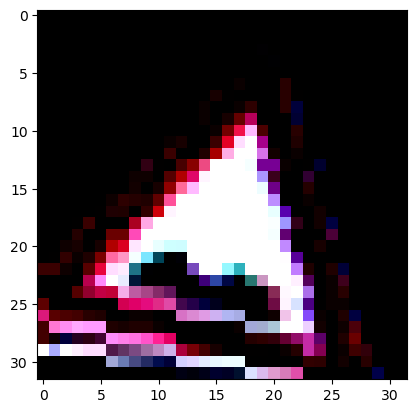

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


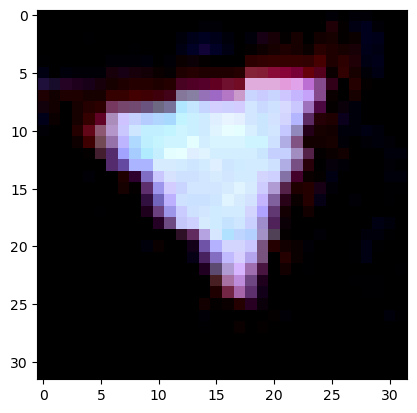

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


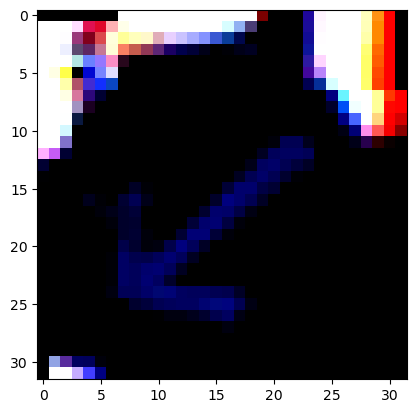

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


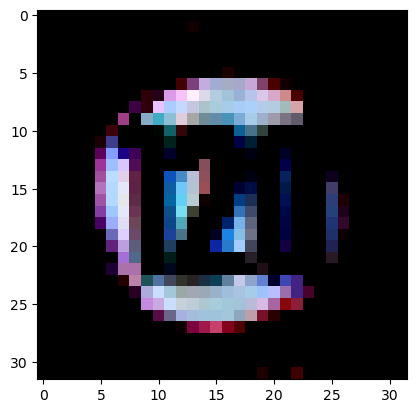

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


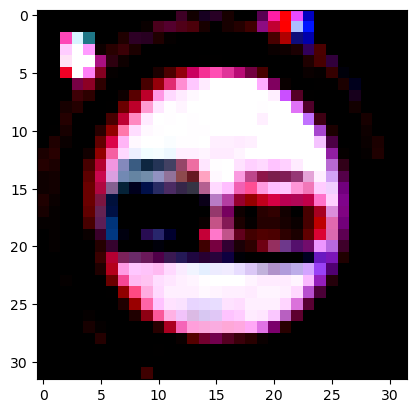

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


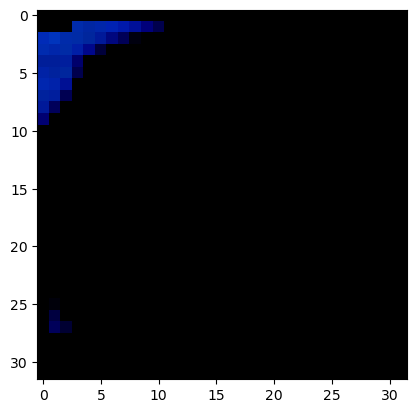

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


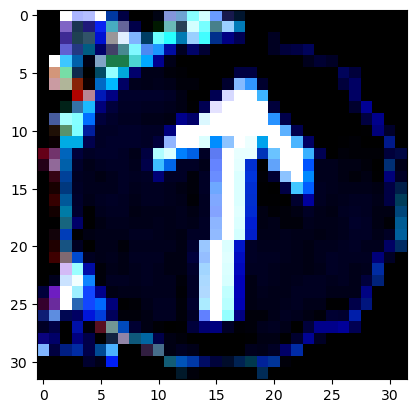

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


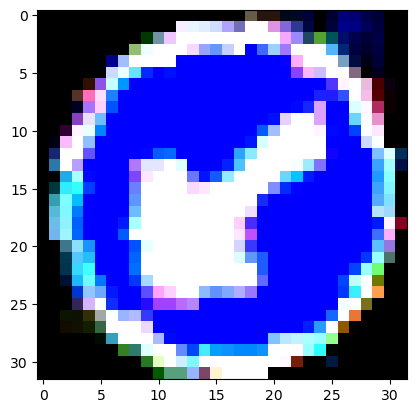

True Label: 13


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 13


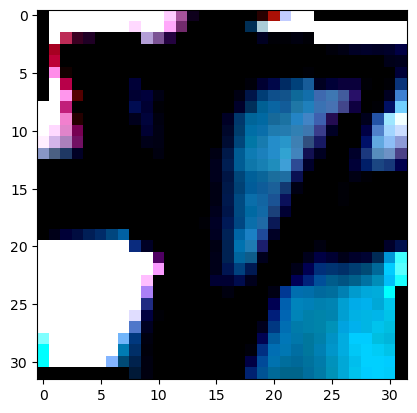

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


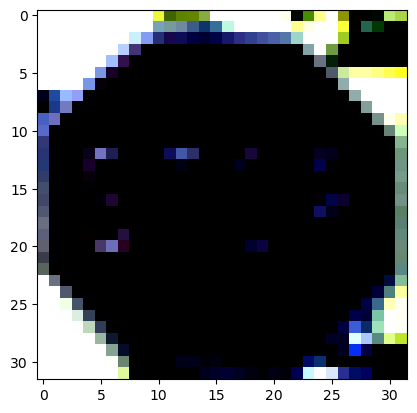

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 22
Predicted Label: 22


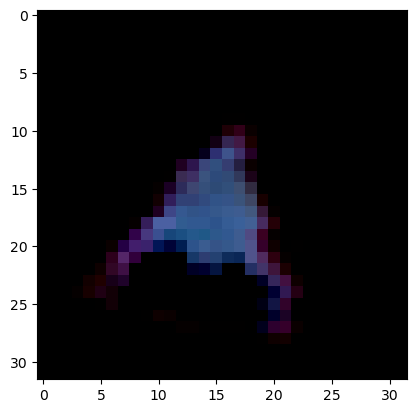

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


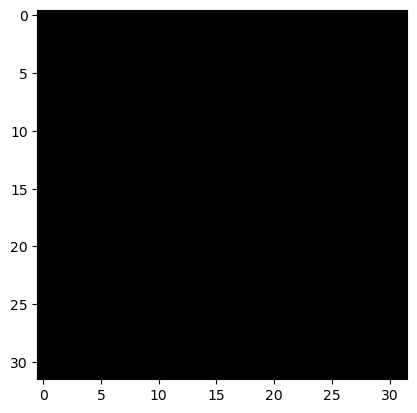

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


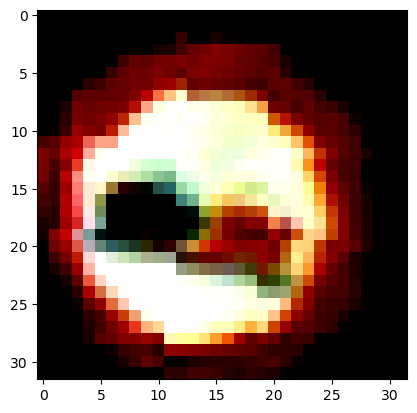

True Label: 35


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 35


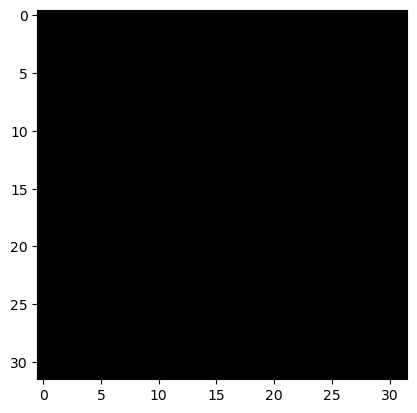

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


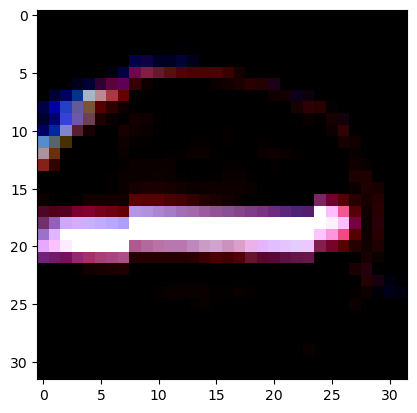

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


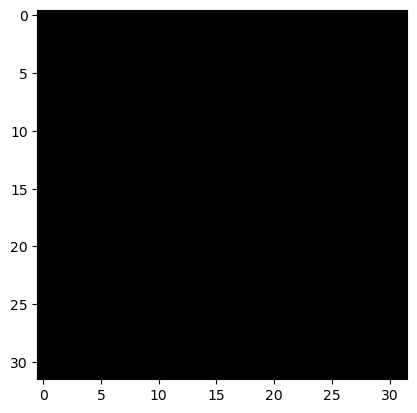

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


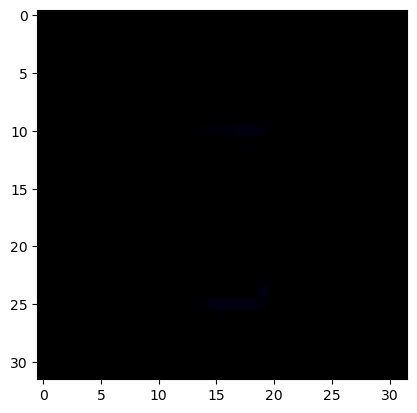

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 26
Predicted Label: 26


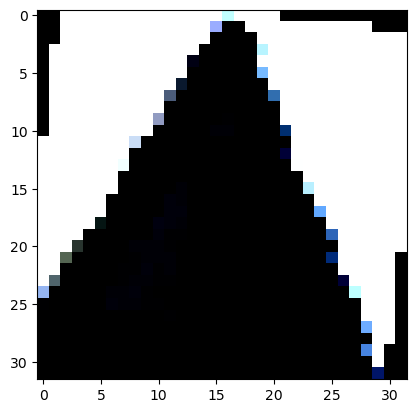

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


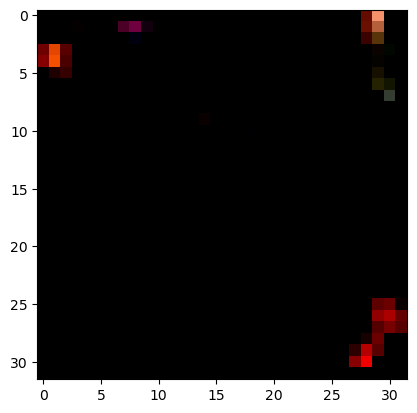

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


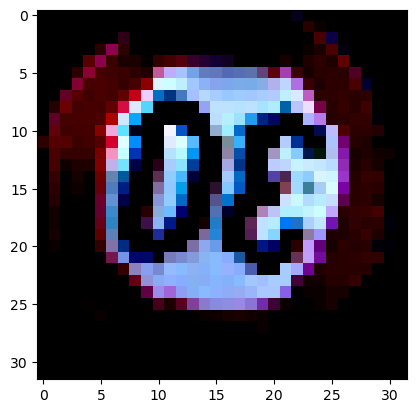

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


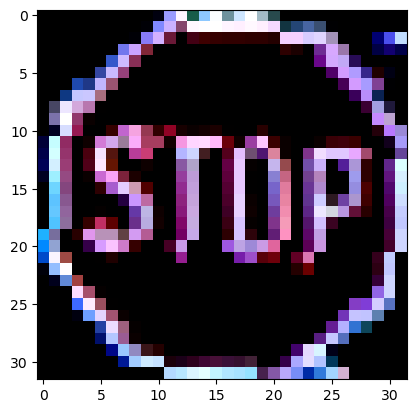

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


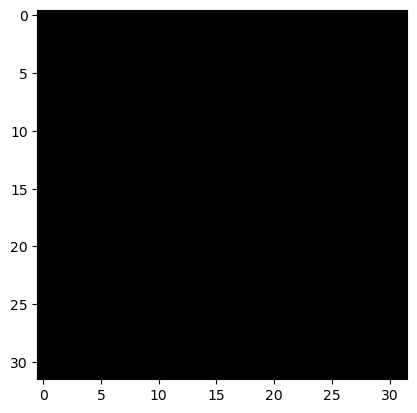

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


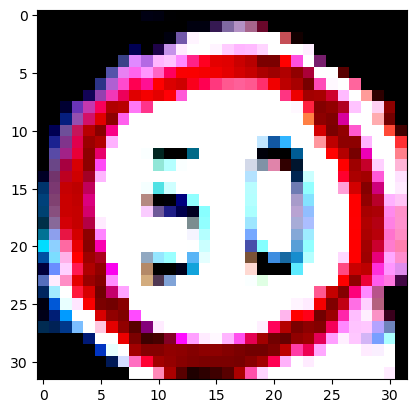

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


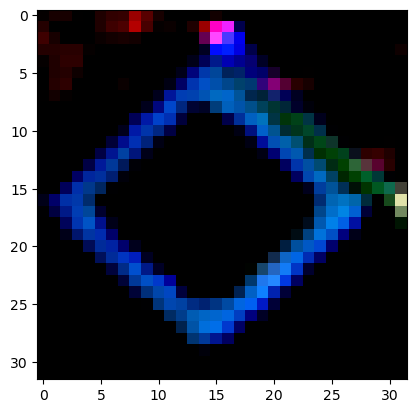

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 31
Predicted Label: 31


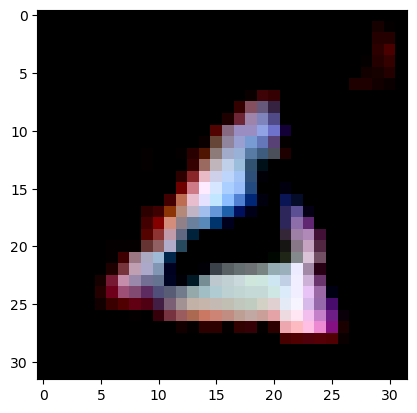

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


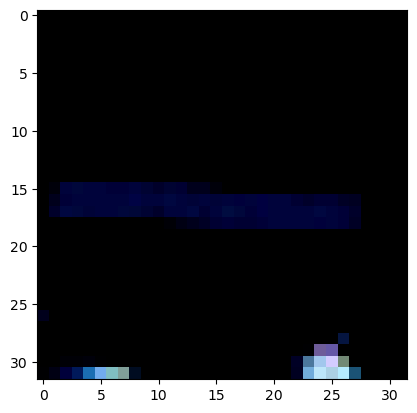

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


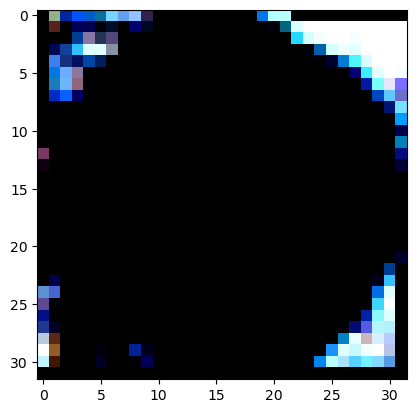

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 16
Predicted Label: 16


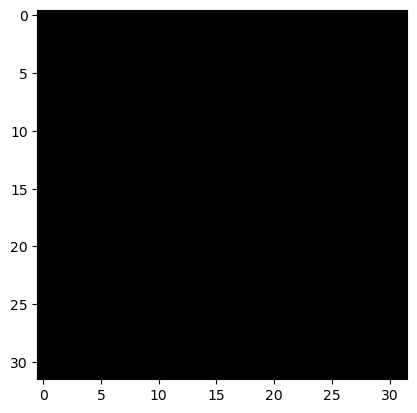

True Label: 1


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 1


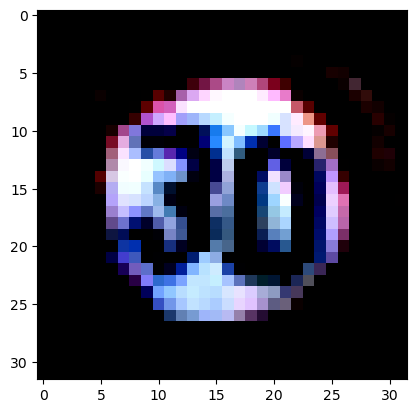

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


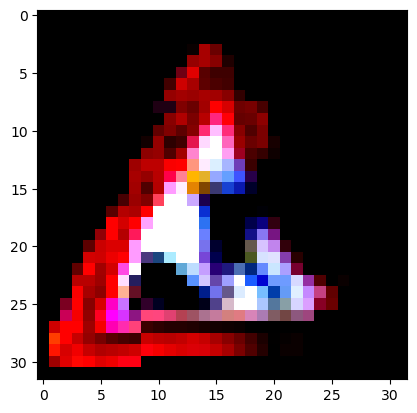

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


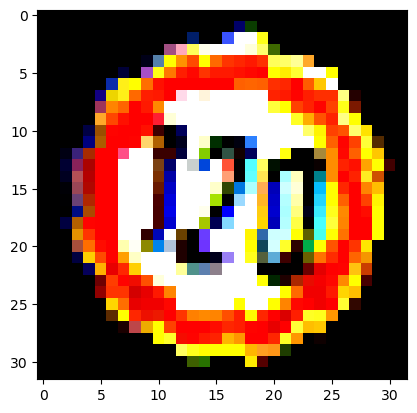

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


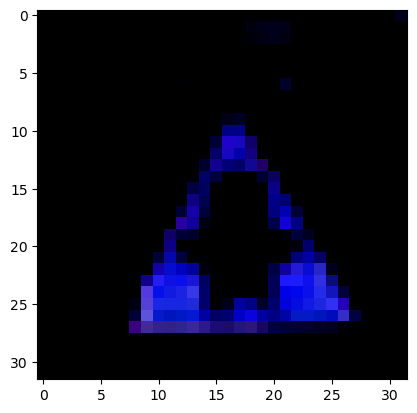

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


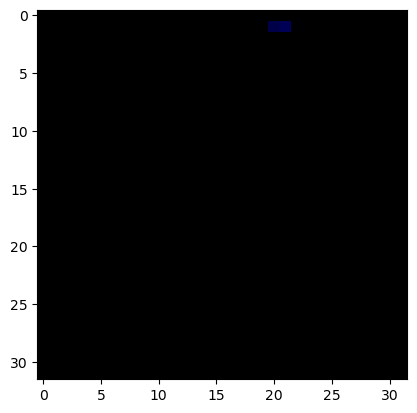

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


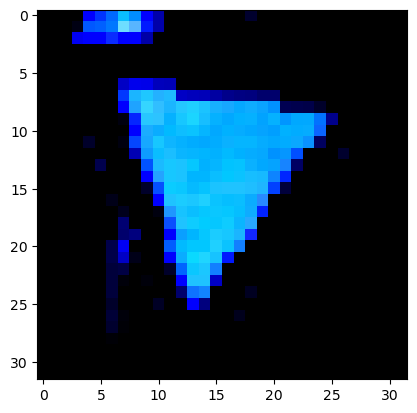

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 20
Predicted Label: 20


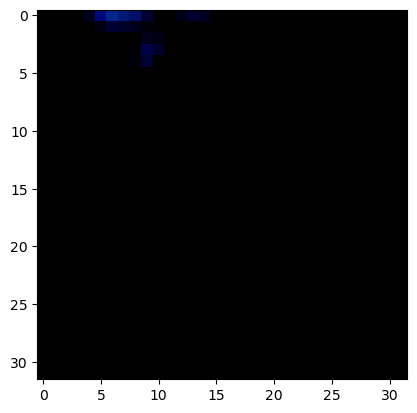

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


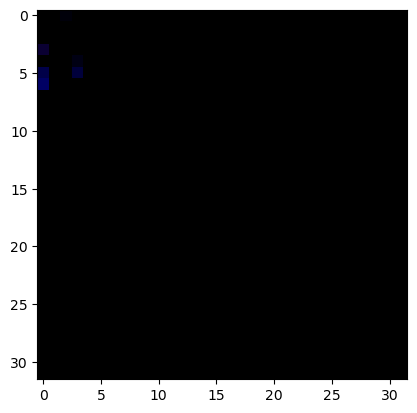

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


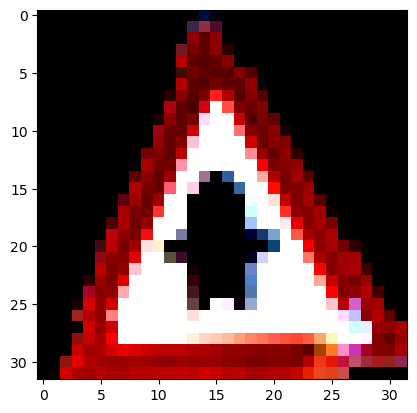

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


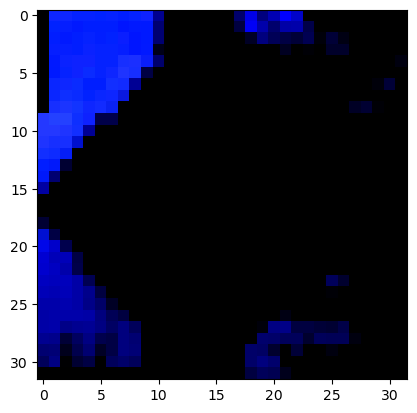

True Label: 3


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 3


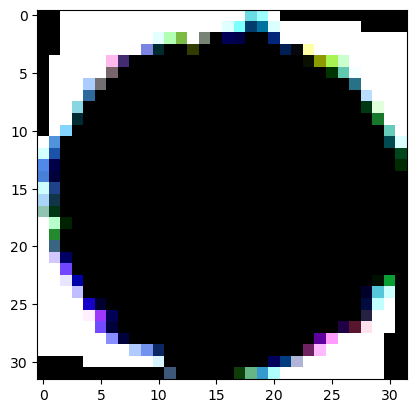

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 28
Predicted Label: 28


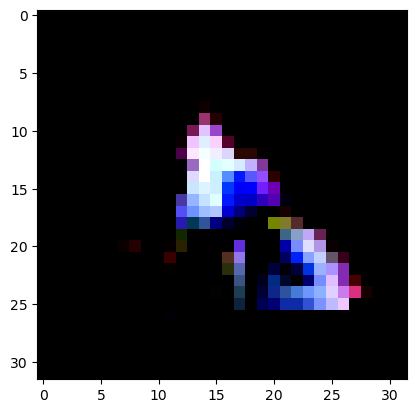

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 33
Predicted Label: 33


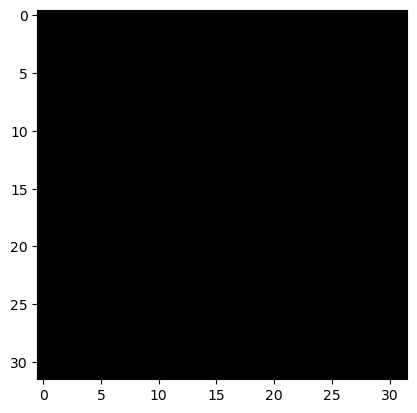

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 5


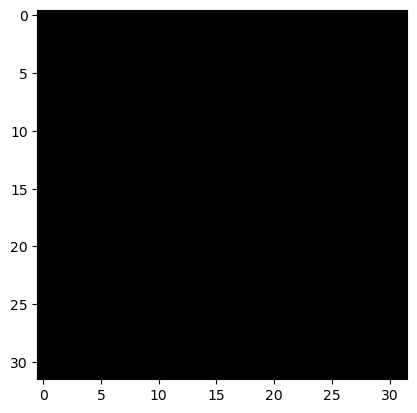

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


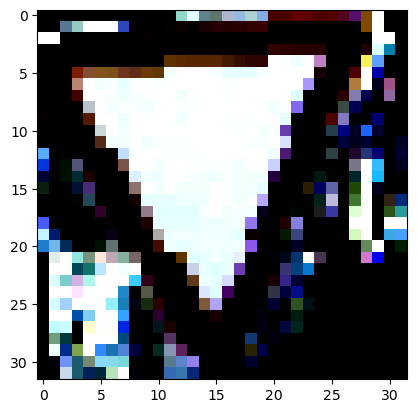

True Label: 2


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 2


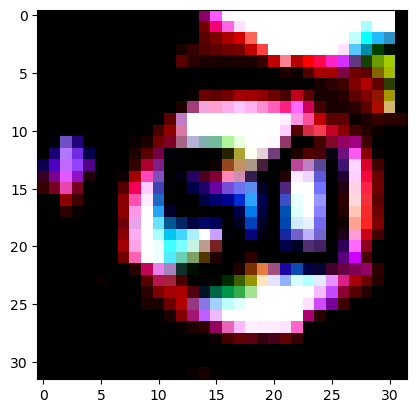

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


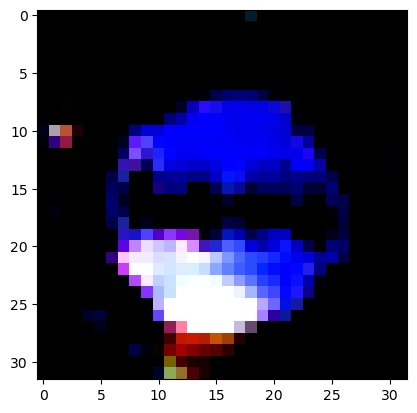

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 41
Predicted Label: 41


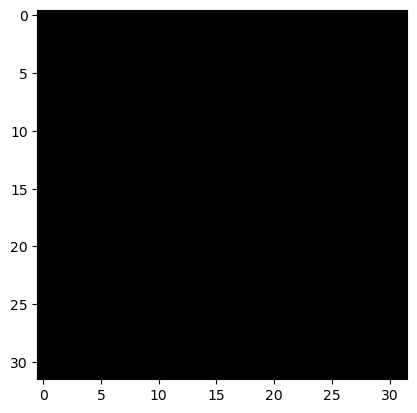

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 19
Predicted Label: 19


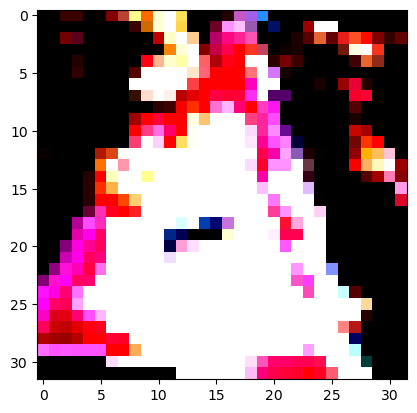

True Label: 8


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 8


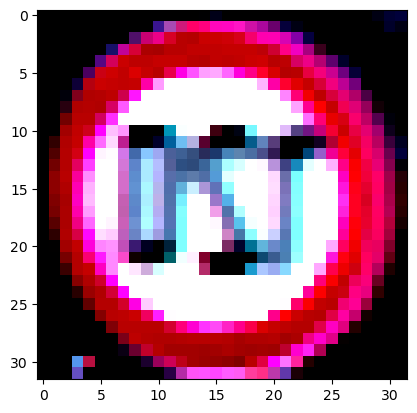

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


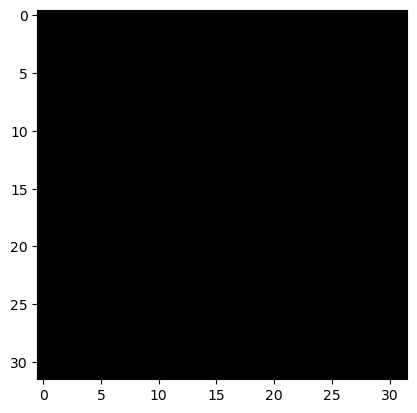

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


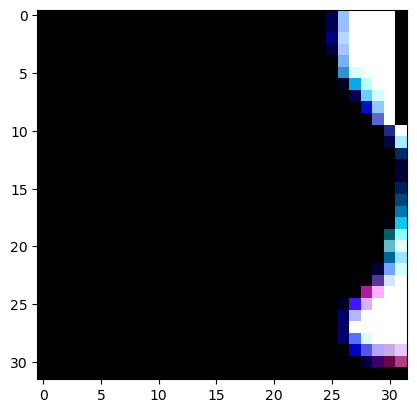

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 33
Predicted Label: 33


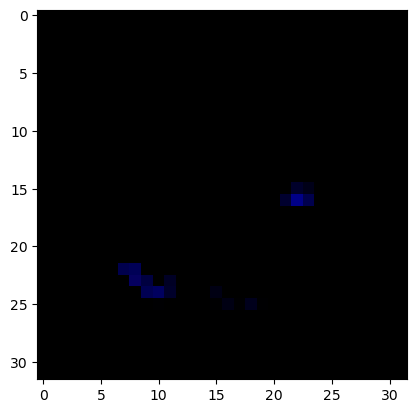

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


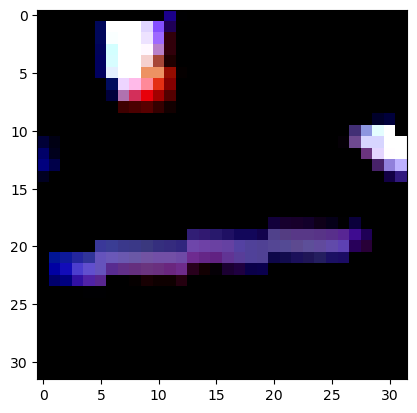

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 6
Predicted Label: 6


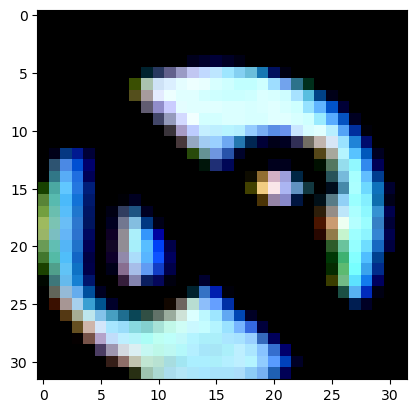

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


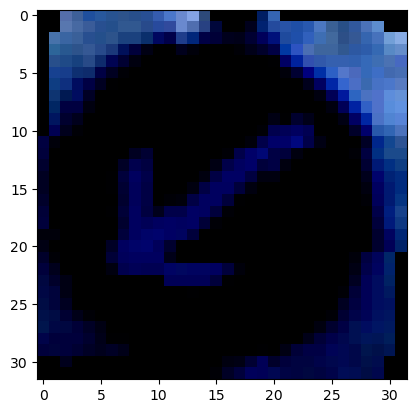

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


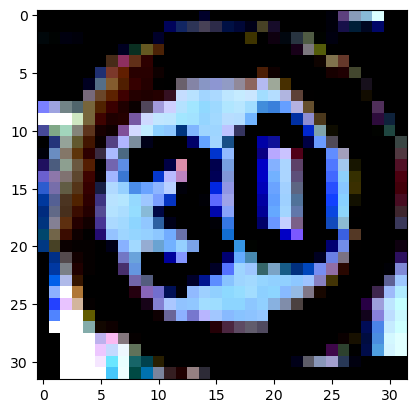

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


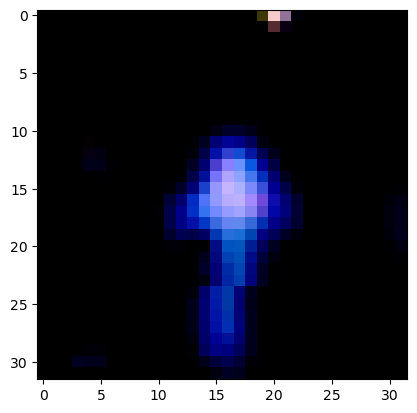

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


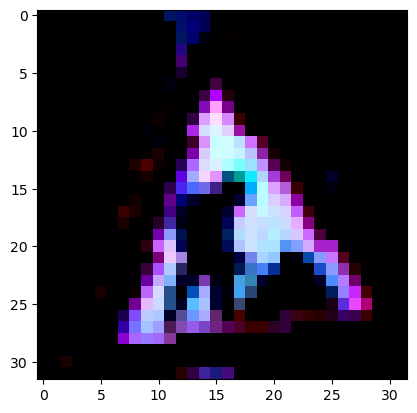

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


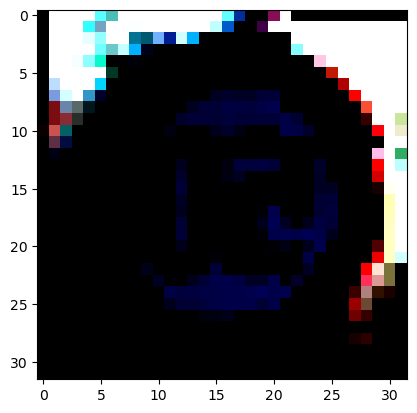

True Label: 30
Predicted Label: 30


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


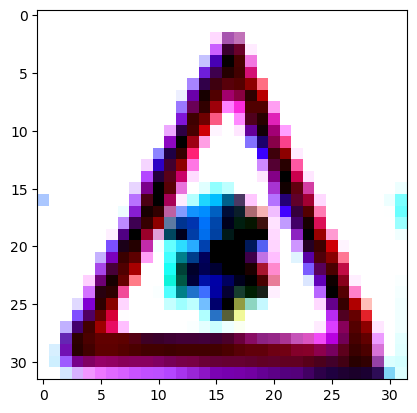

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


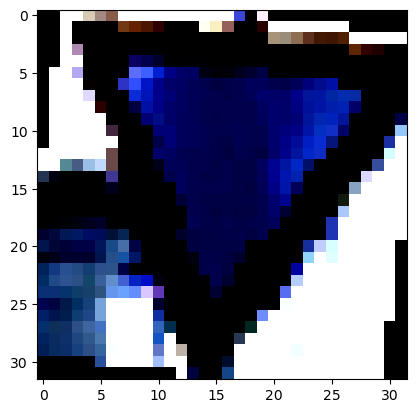

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 40
Predicted Label: 40


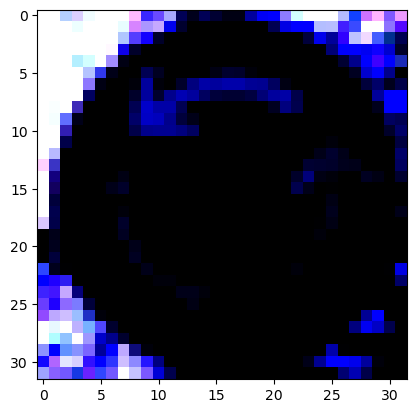

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


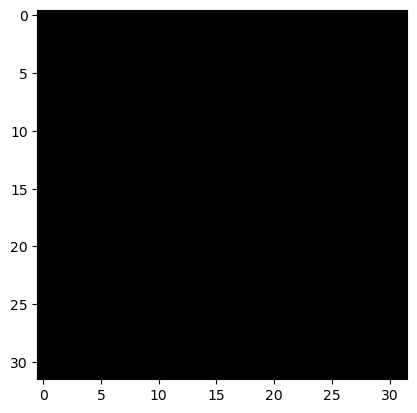

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


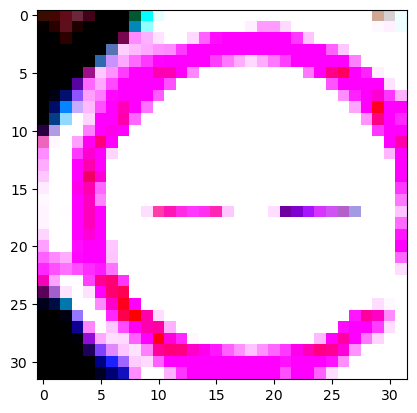

True Label: 38


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 38


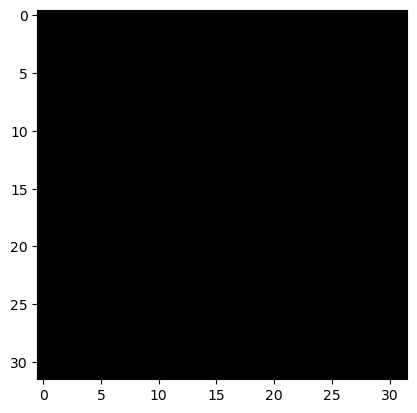

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


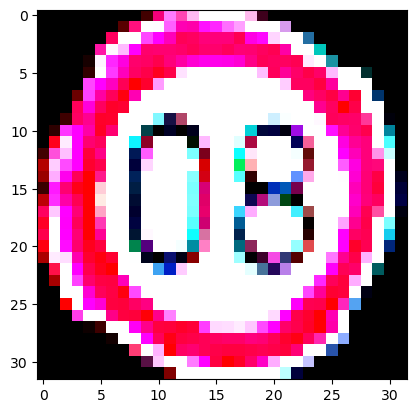

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


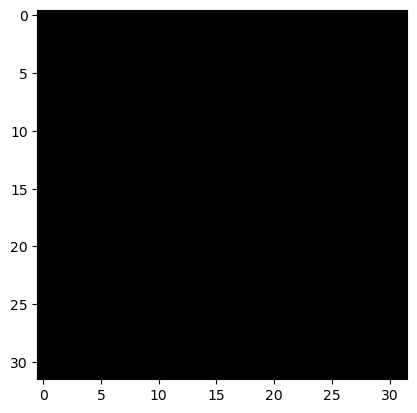

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


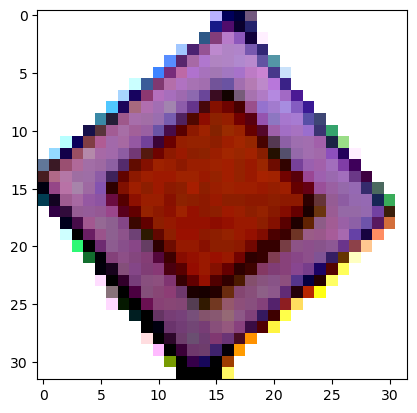

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


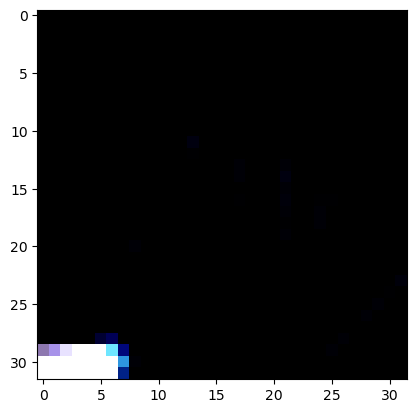

True Label: 17


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 17


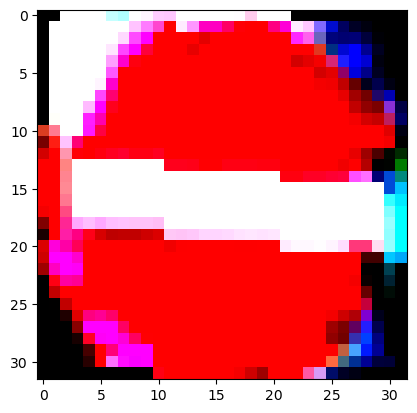

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


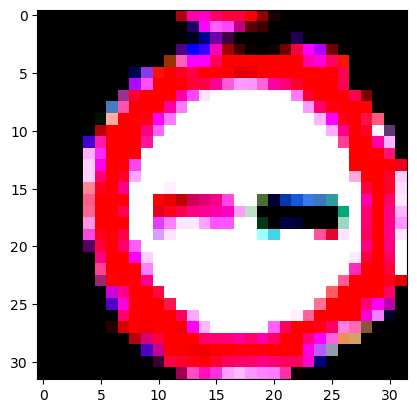

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


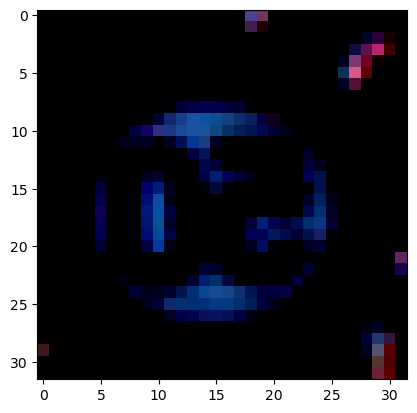

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


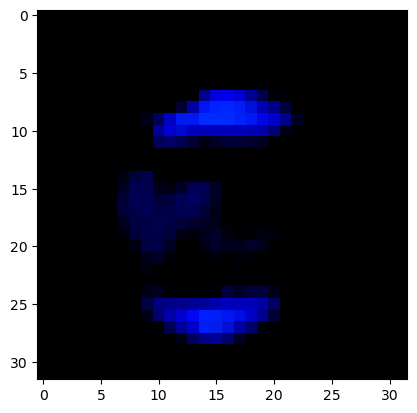

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


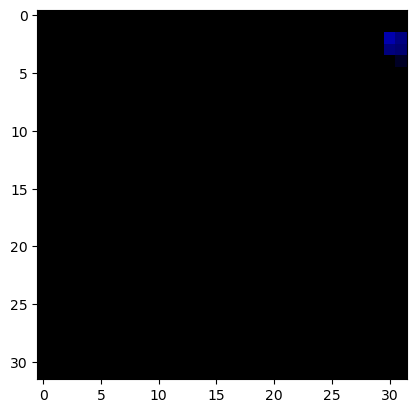

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 22
Predicted Label: 22


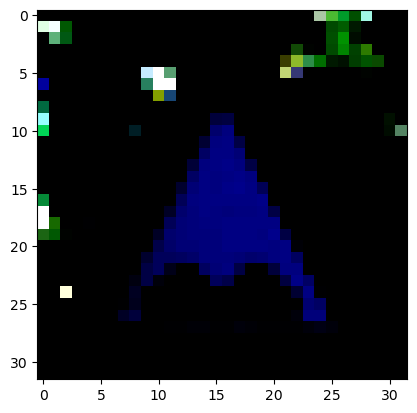

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


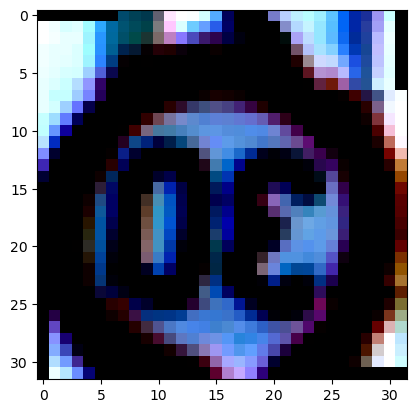

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 30
Predicted Label: 30


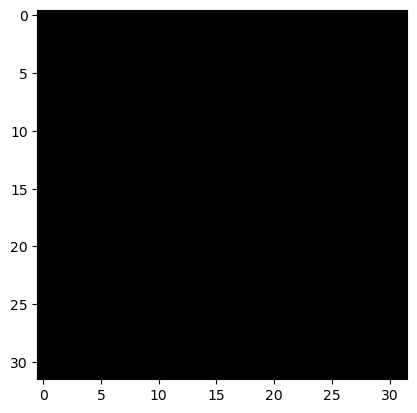

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


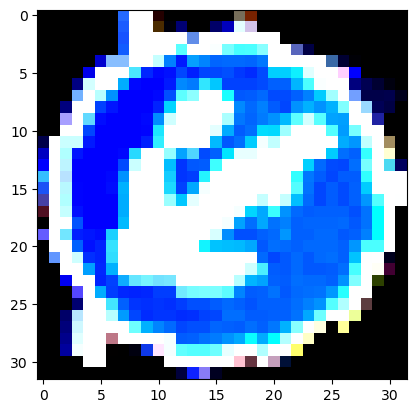

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


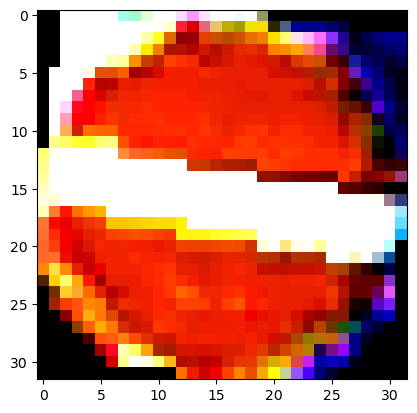

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


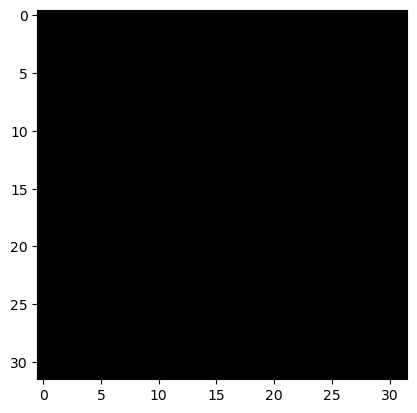

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


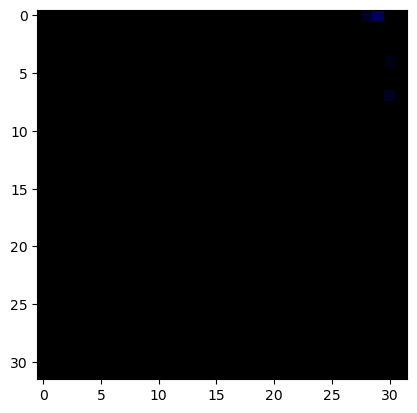

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


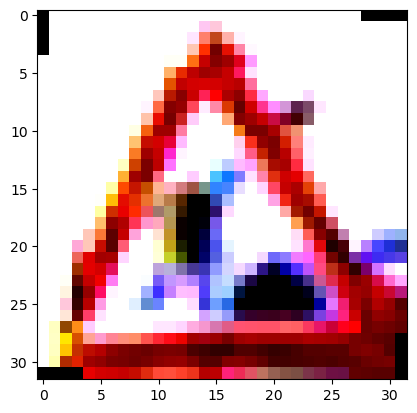

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


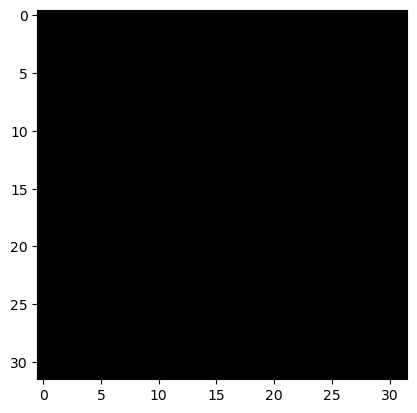

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


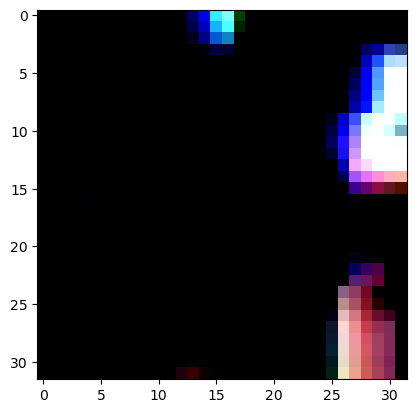

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


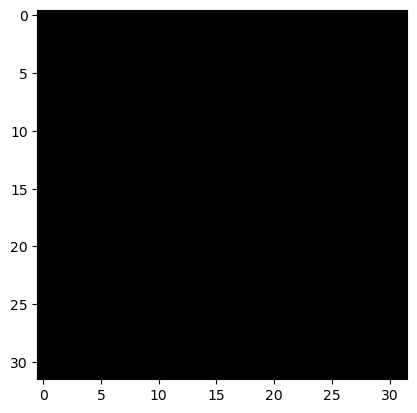

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 16
Predicted Label: 16


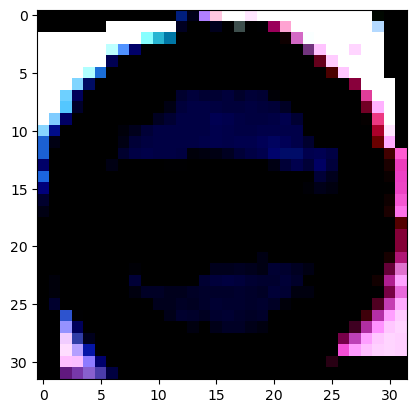

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


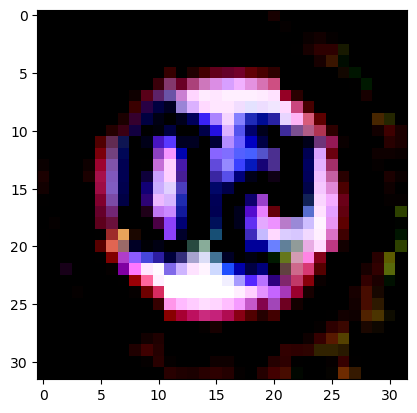

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


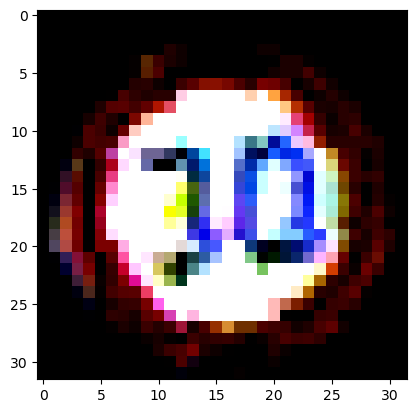

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


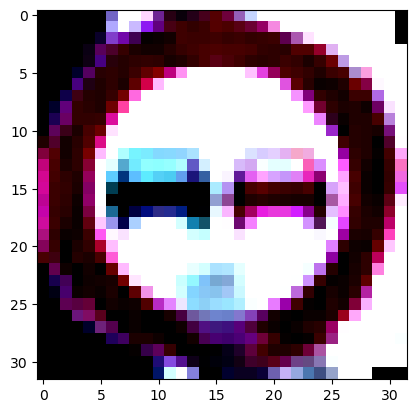

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


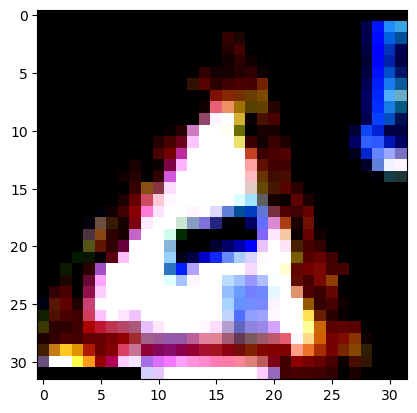

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 6
Predicted Label: 6


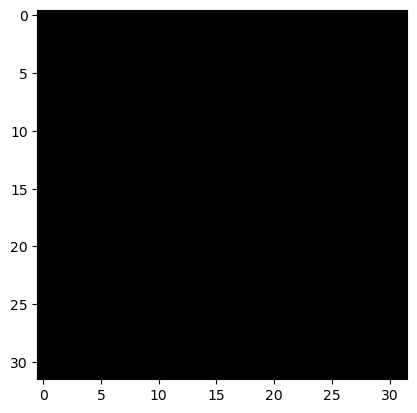

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


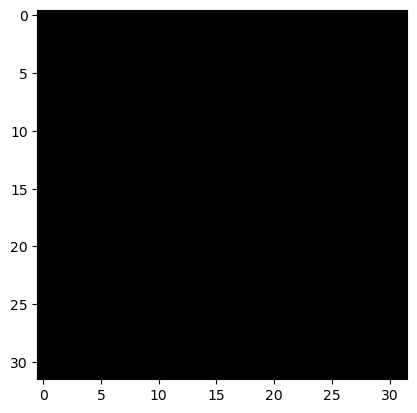

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


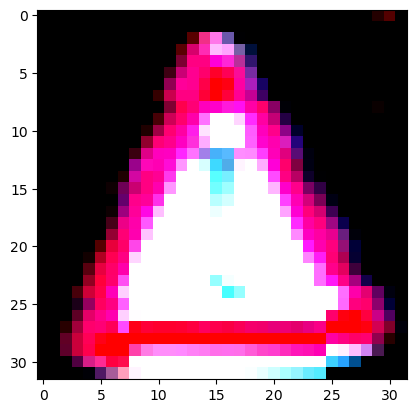

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


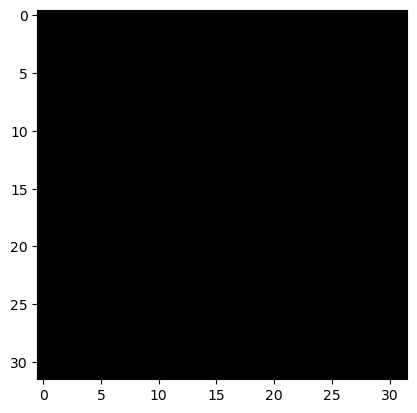

True Label: 31


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 31


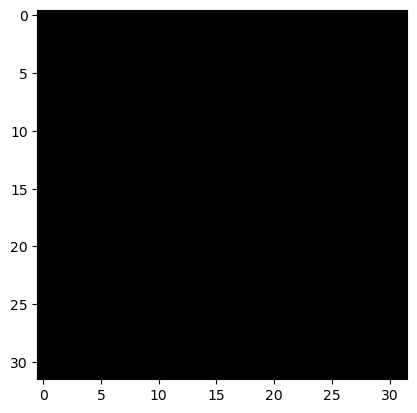

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


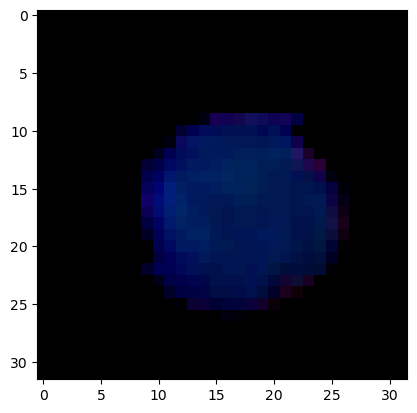

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


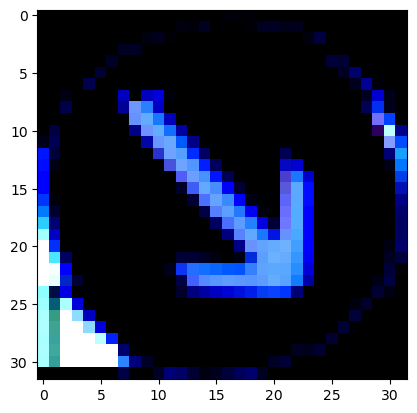

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


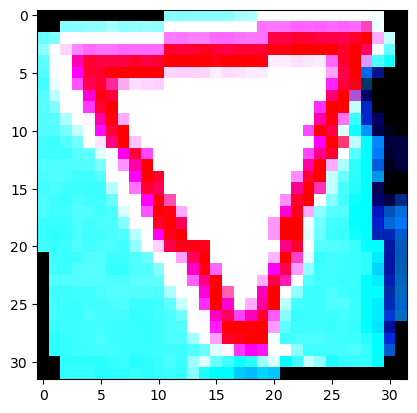

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


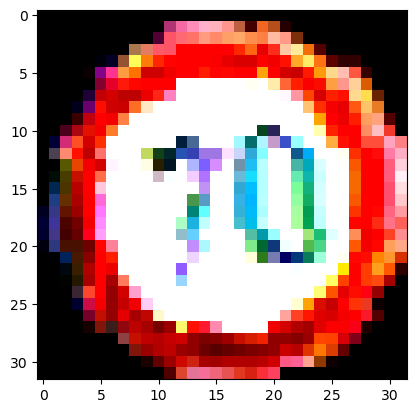

True Label: 4


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 4


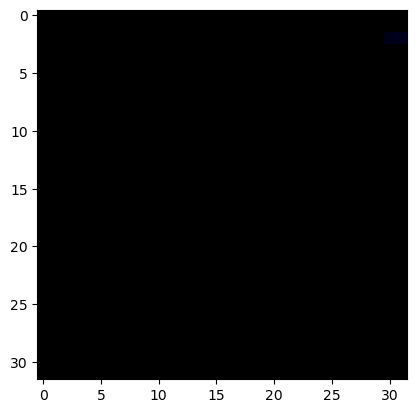

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


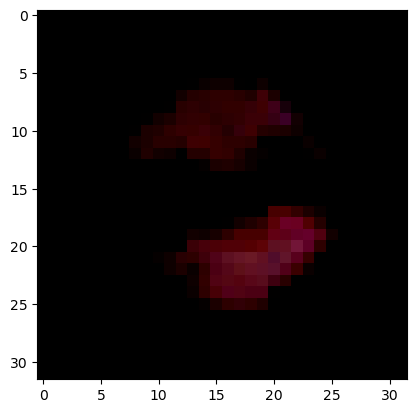

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


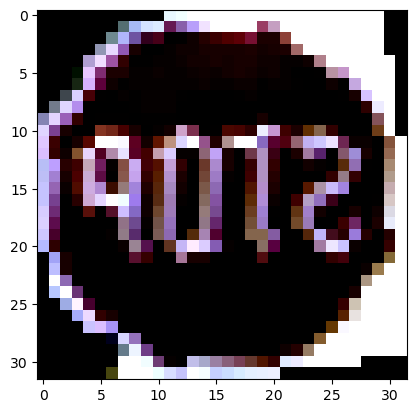

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


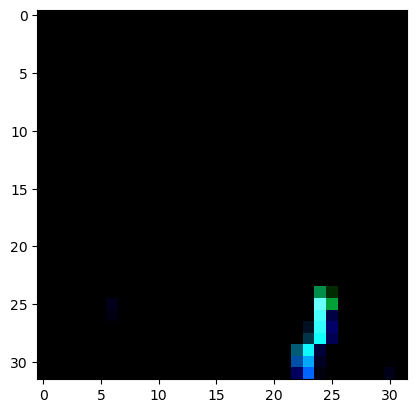

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


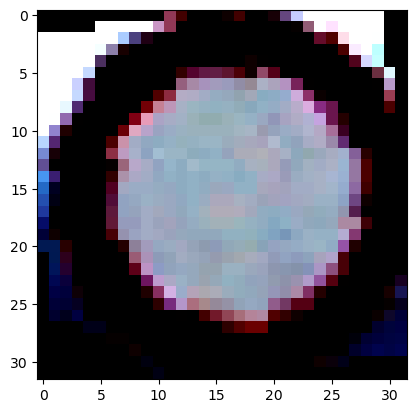

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


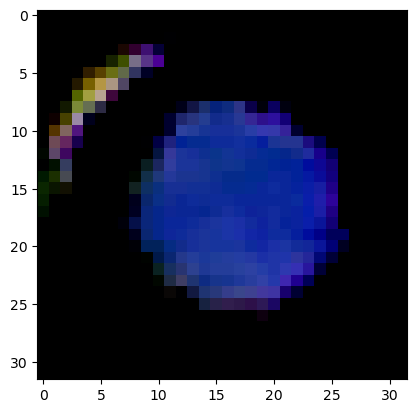

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


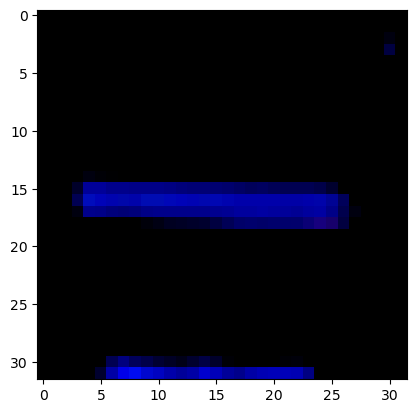

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


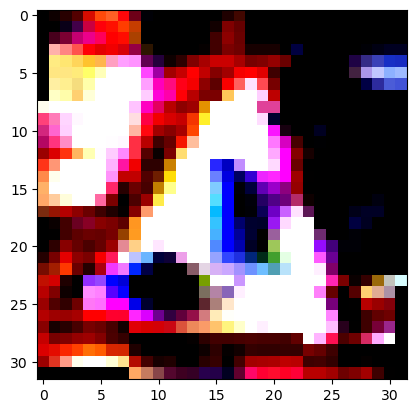

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


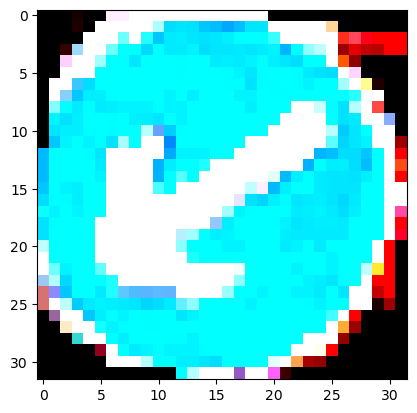

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


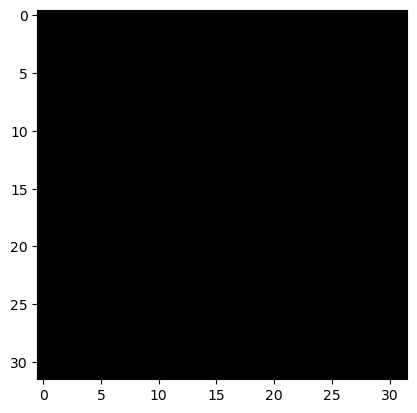

True Label: 38


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 38


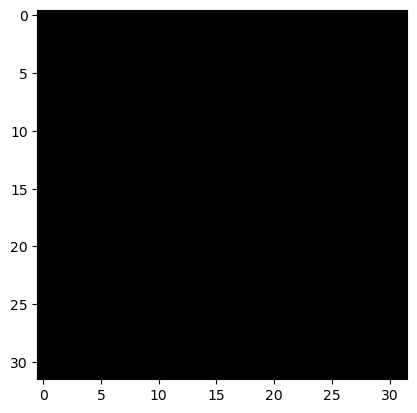

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


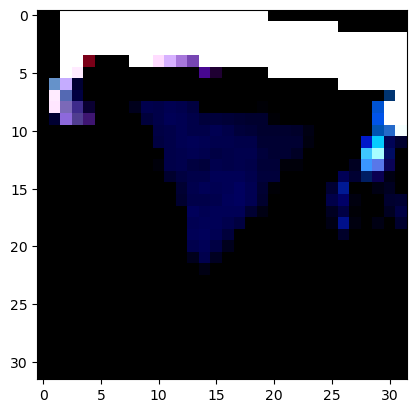

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 28
Predicted Label: 28


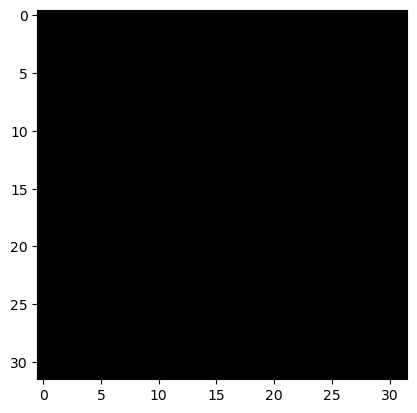

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 40
Predicted Label: 40


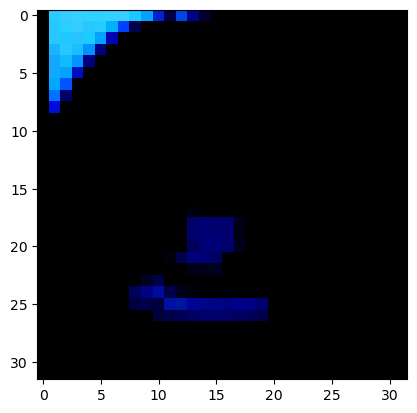

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


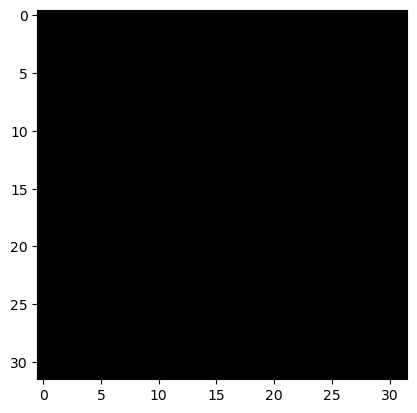

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 36
Predicted Label: 36


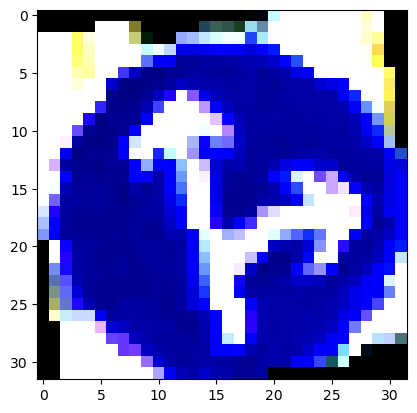

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


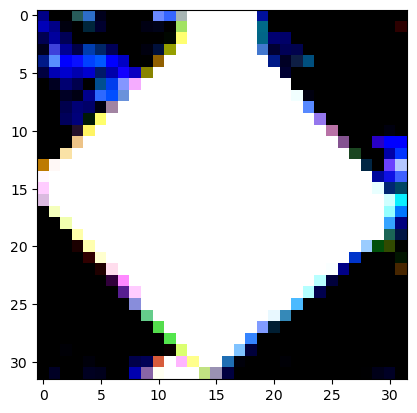

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


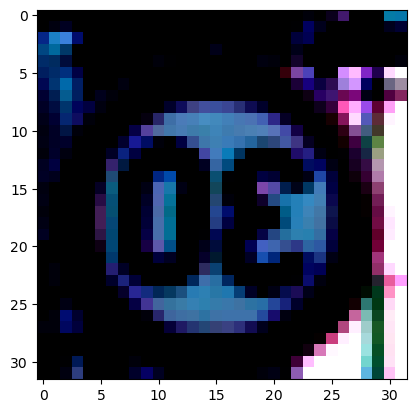

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


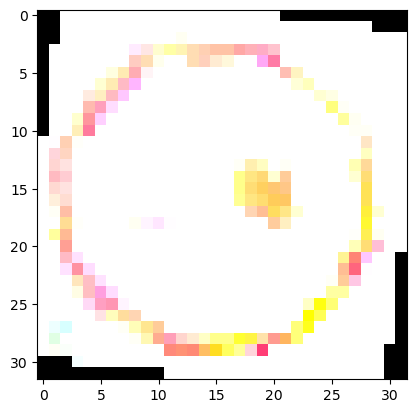

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


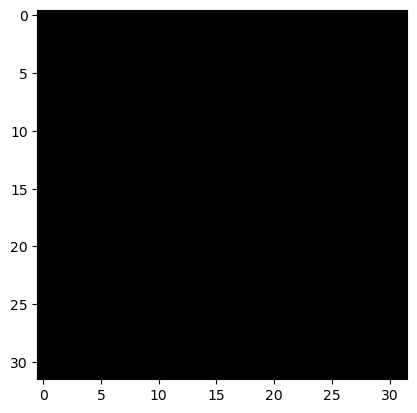

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


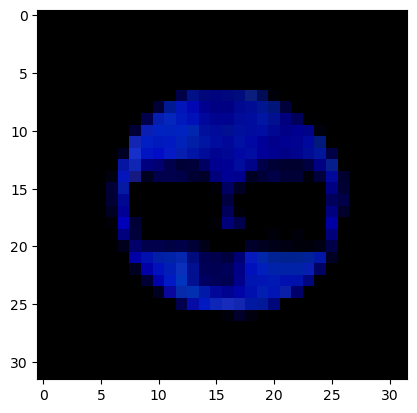

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


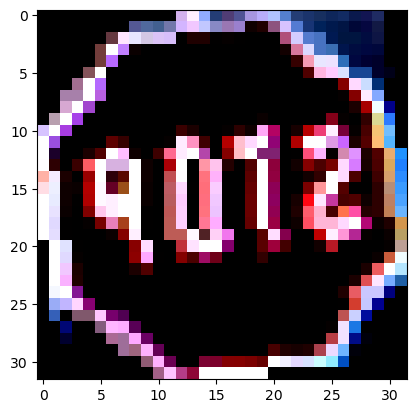

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 28
Predicted Label: 28


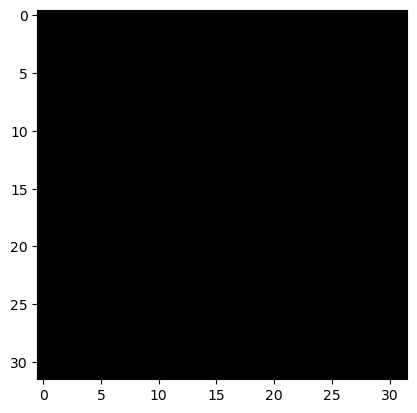

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


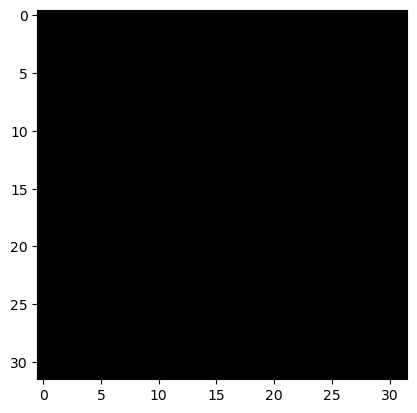

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


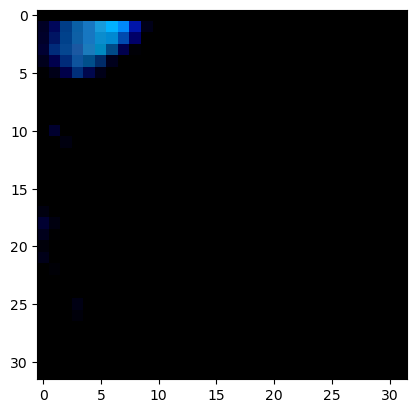

True Label: 25


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 25


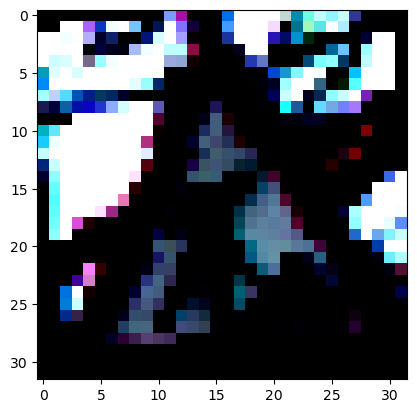

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


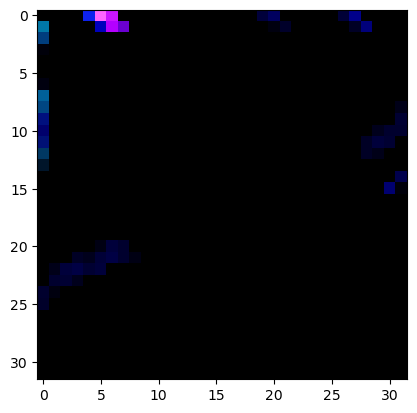

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


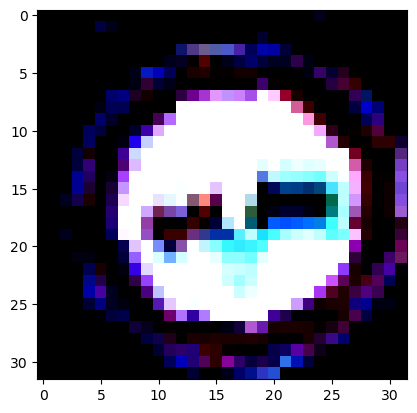

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


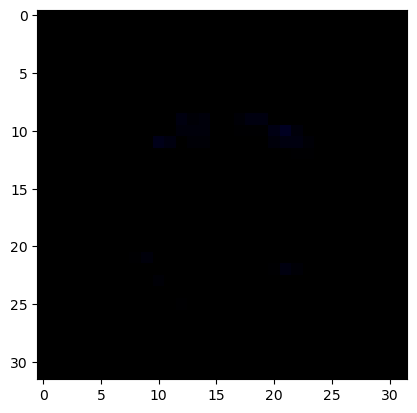

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


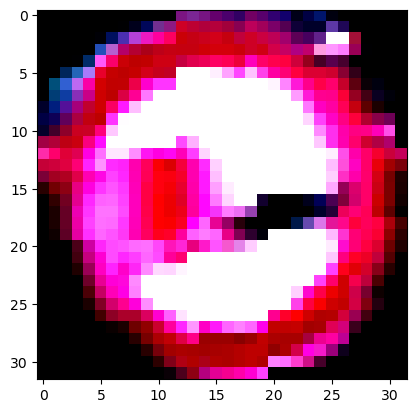

True Label: 1


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 1


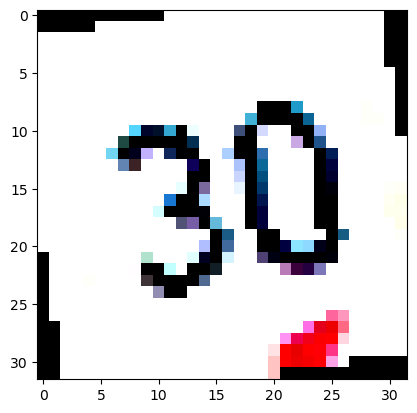

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


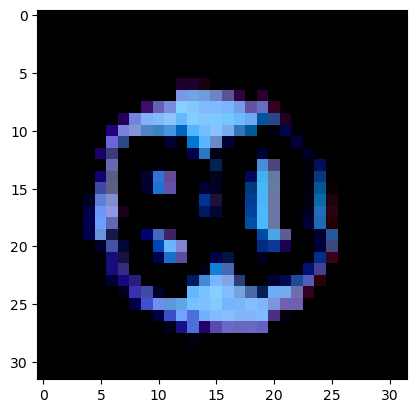

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


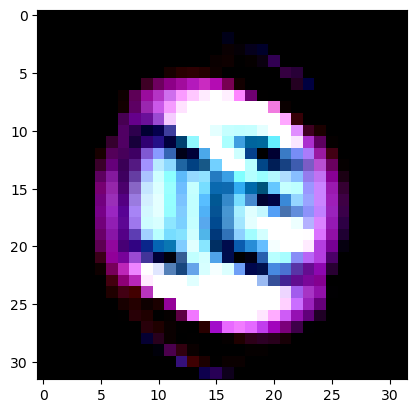

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


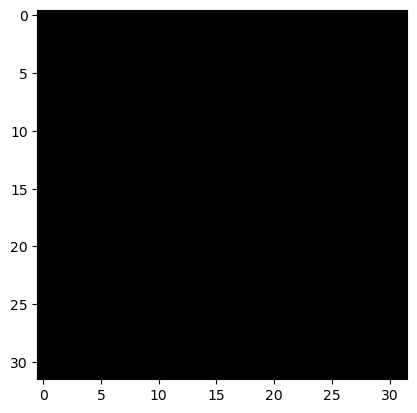

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


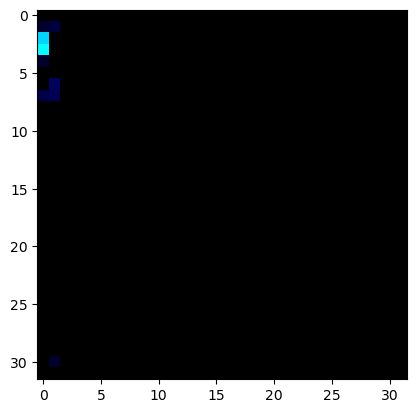

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 6
Predicted Label: 6


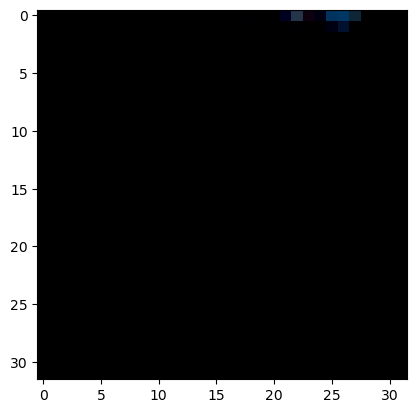

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


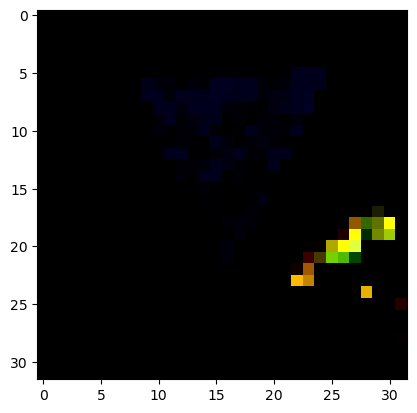

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


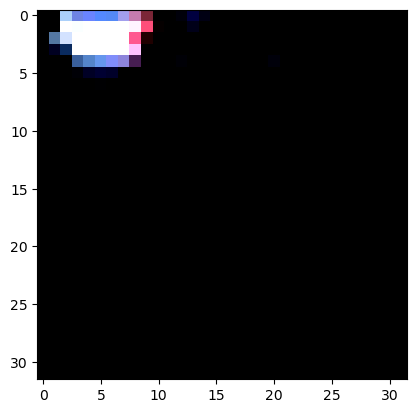

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 5


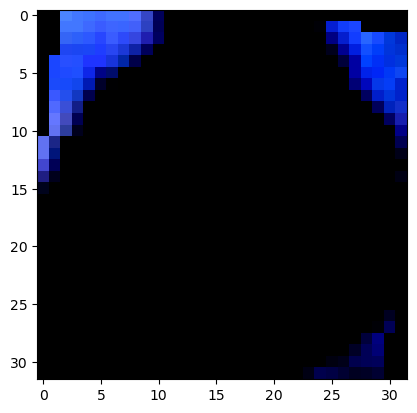

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


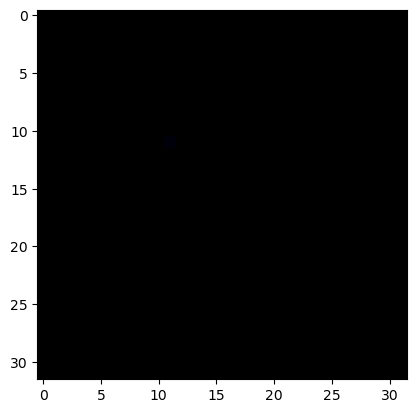

True Label: 20


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 20


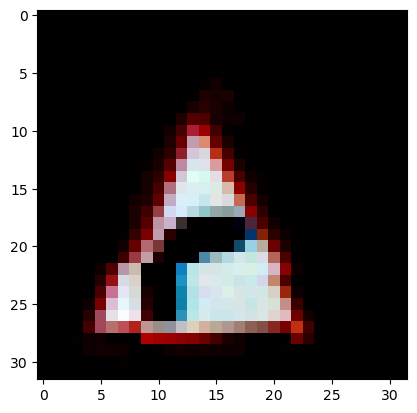

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


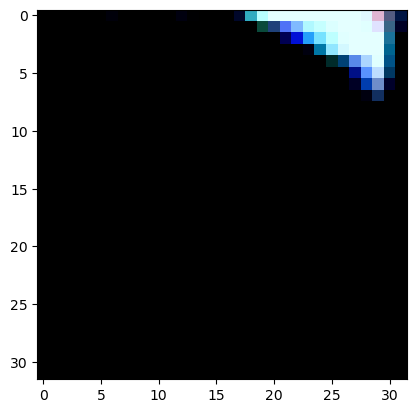

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


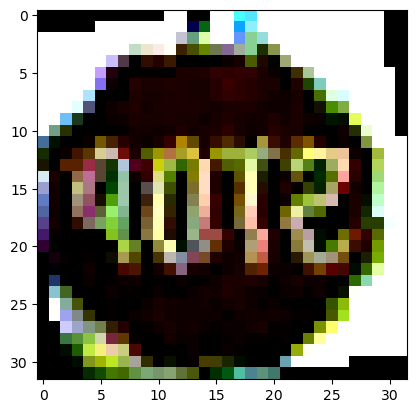

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


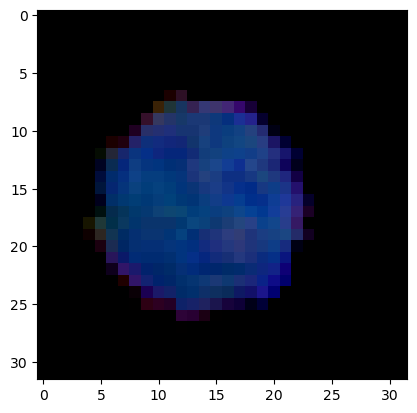

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


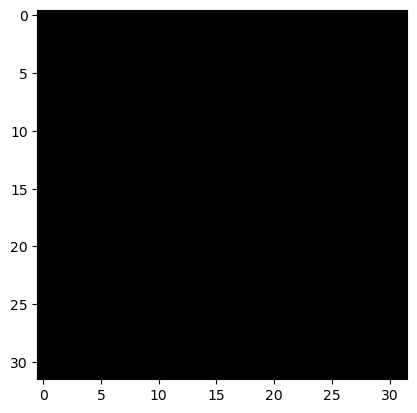

True Label: 2


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 2


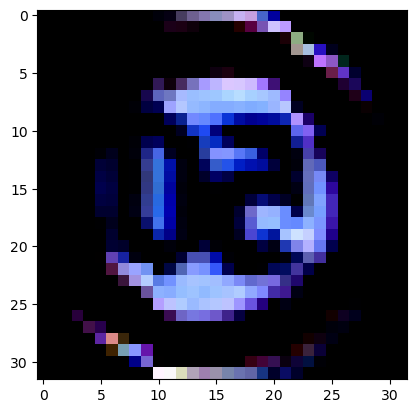

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 29
Predicted Label: 29


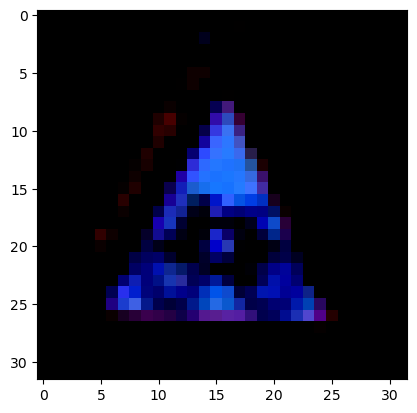

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


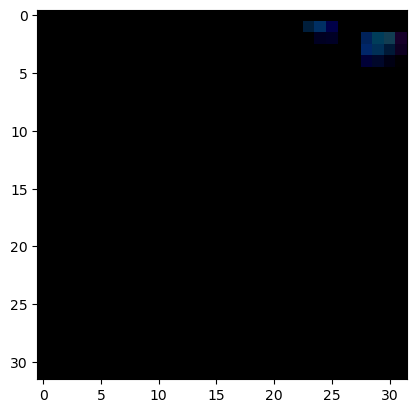

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


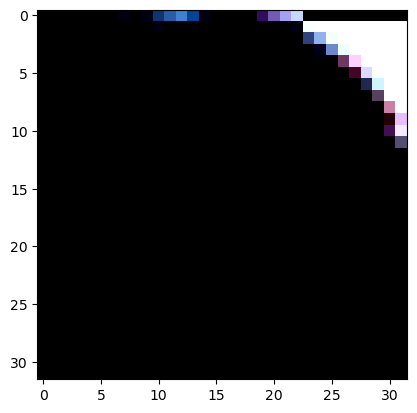

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


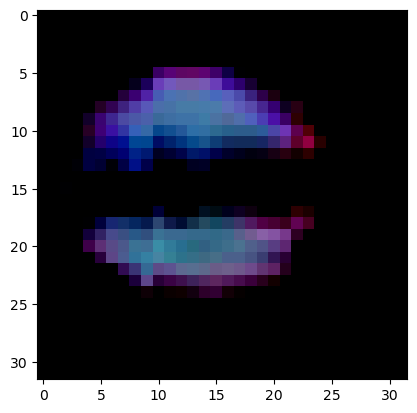

True Label: 30


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 30


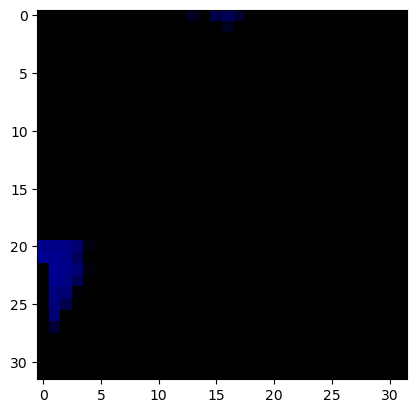

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


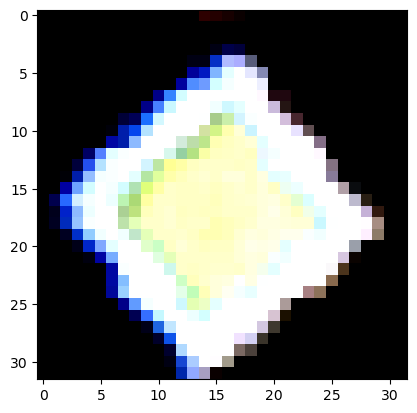

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


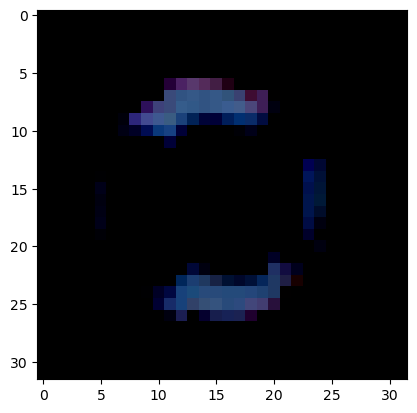

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 31
Predicted Label: 31


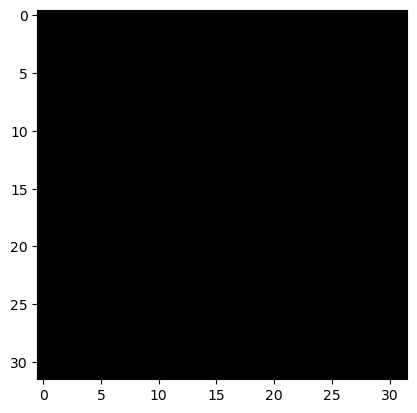

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


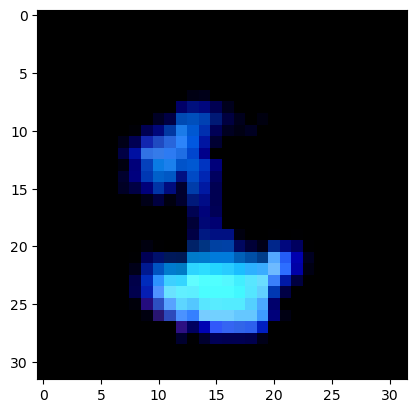

True Label: 10


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 10


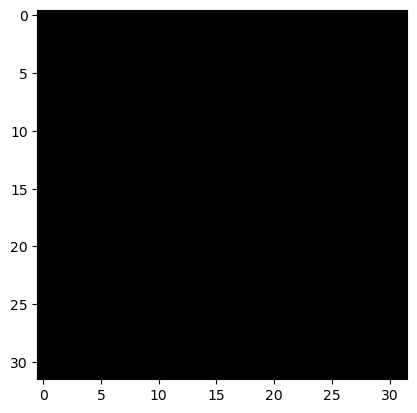

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


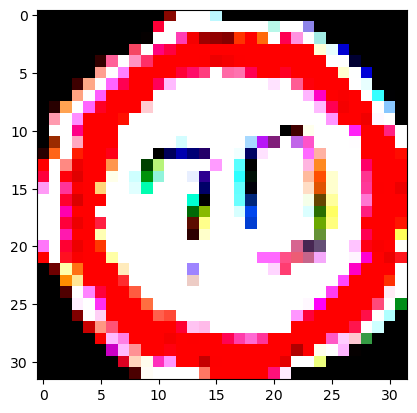

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 40
Predicted Label: 40


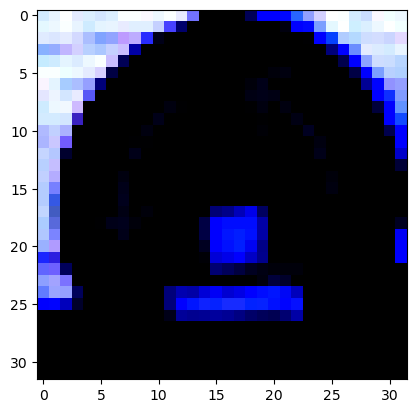

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


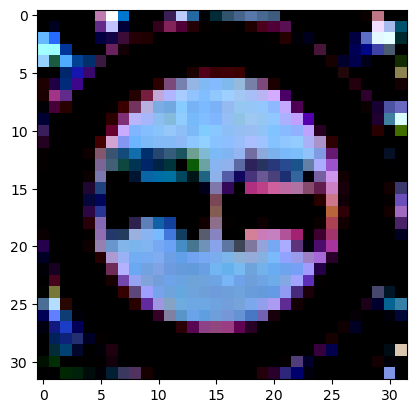

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 33
Predicted Label: 33


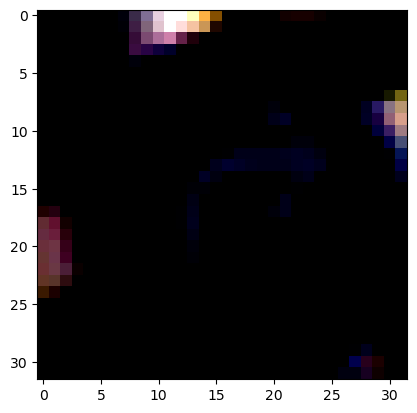

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


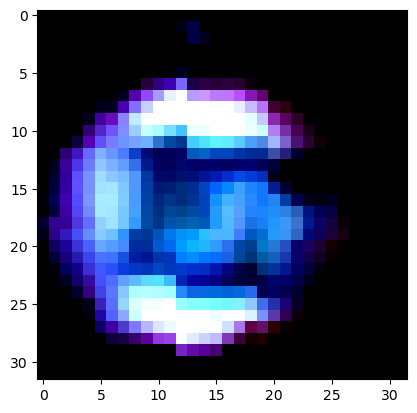

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


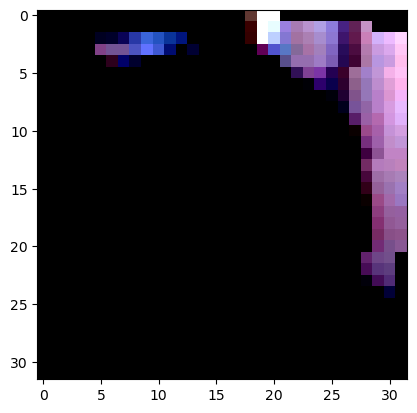

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


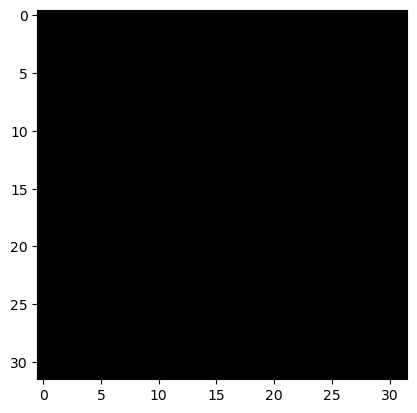

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 26
Predicted Label: 26


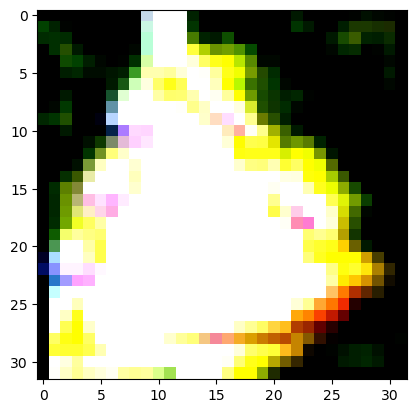

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 31
Predicted Label: 31


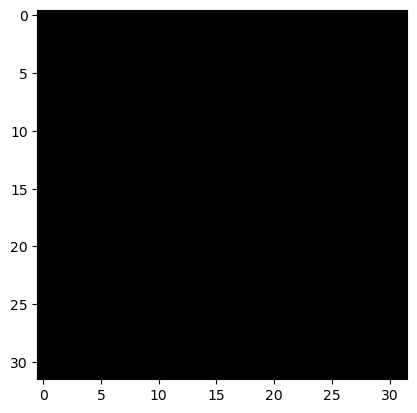

True Label: 27


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 27


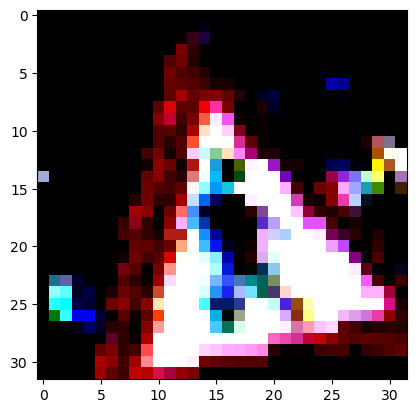

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 1


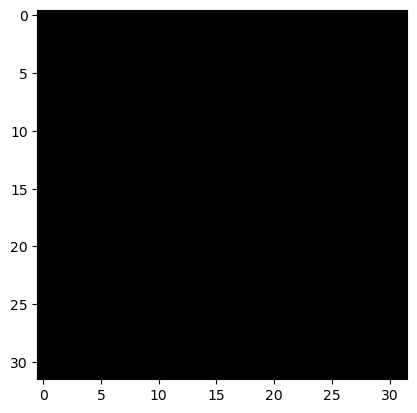

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


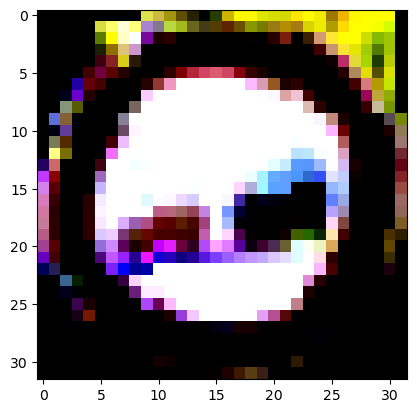

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


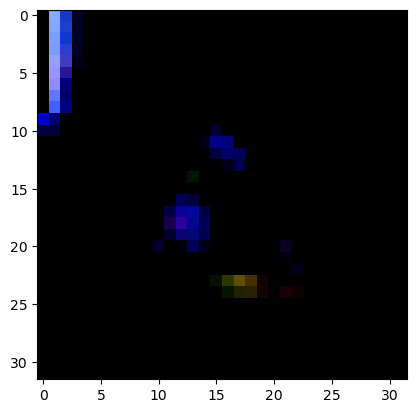

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


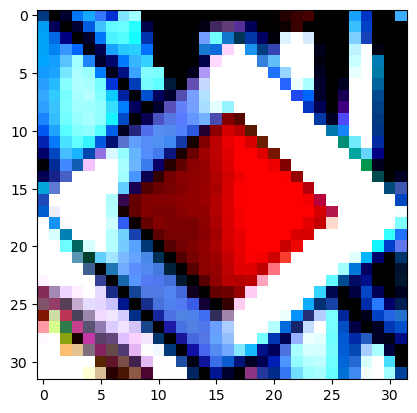

True Label: 10


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 10


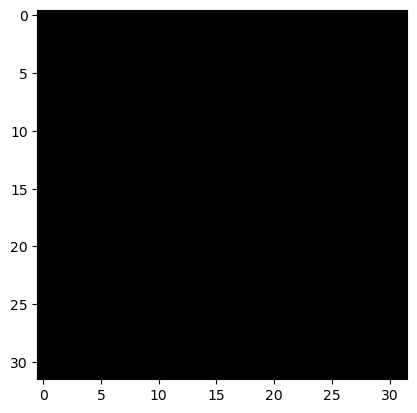

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


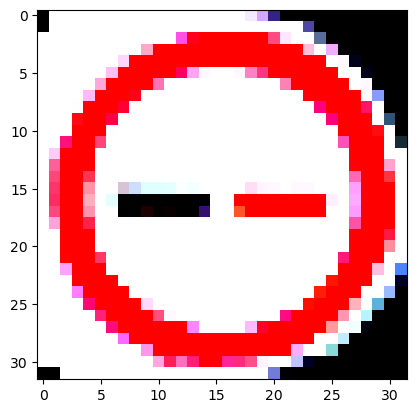

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 32
Predicted Label: 32


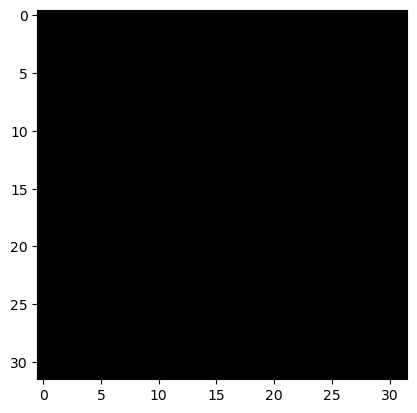

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


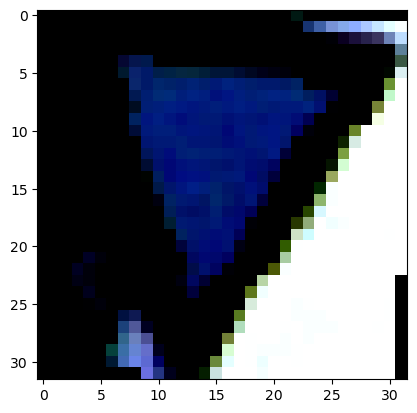

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 20
Predicted Label: 20


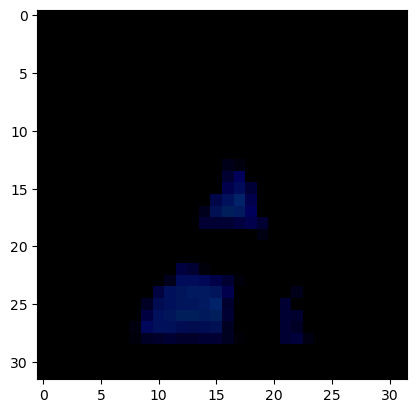

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 20
Predicted Label: 20


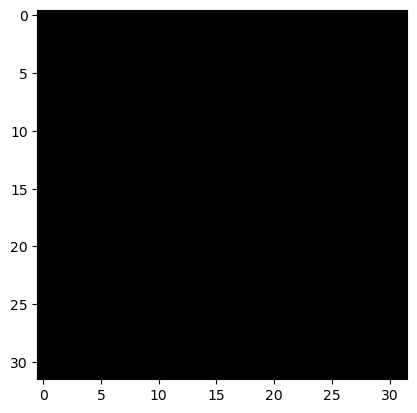

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


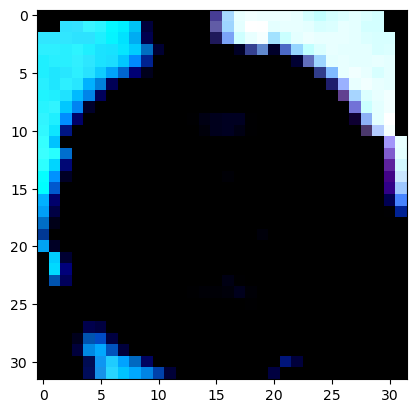

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


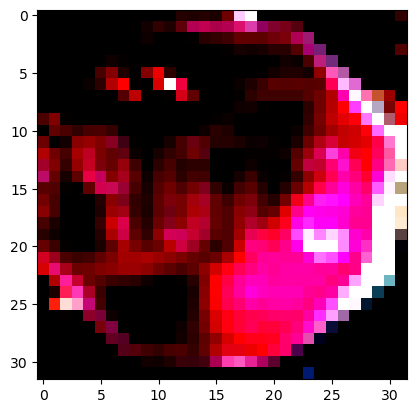

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


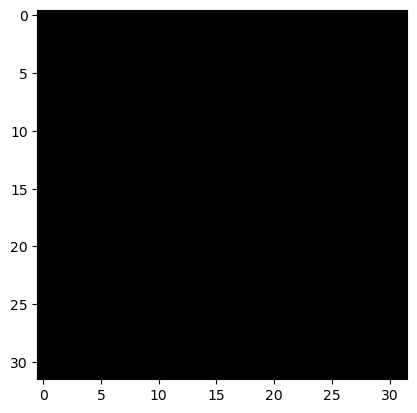

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 24
Predicted Label: 24


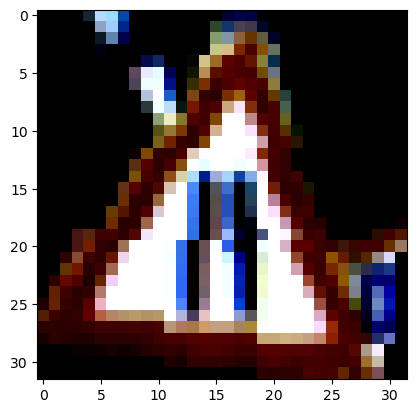

True Label: 14


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 14


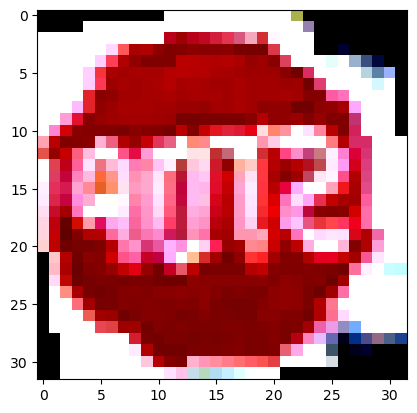

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


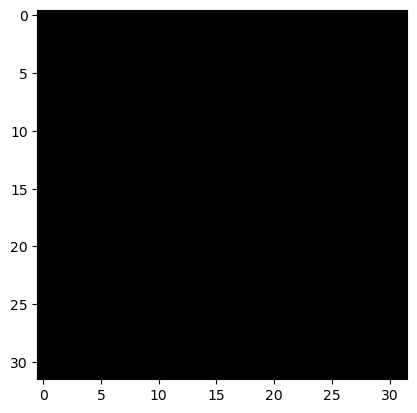

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


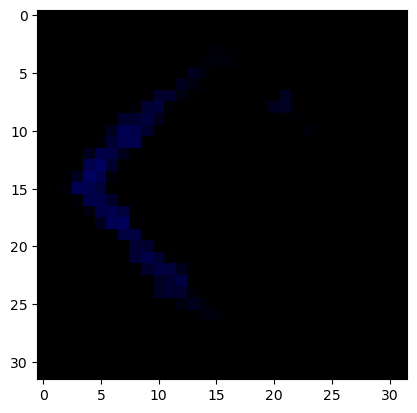

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


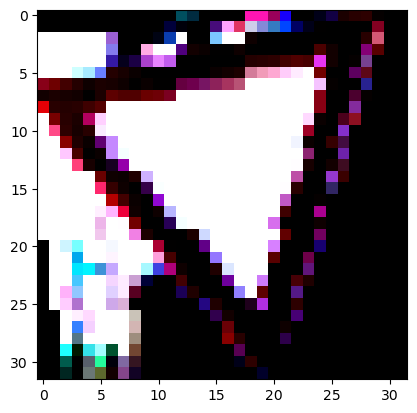

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


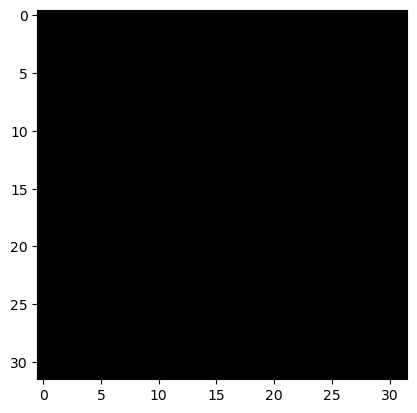

True Label: 41


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 41


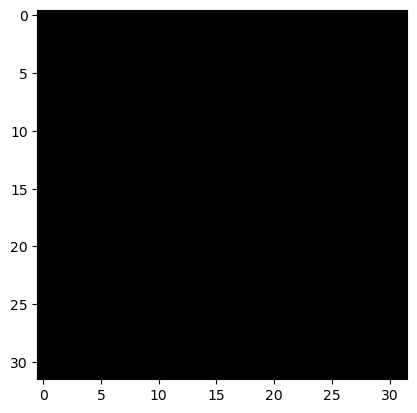

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


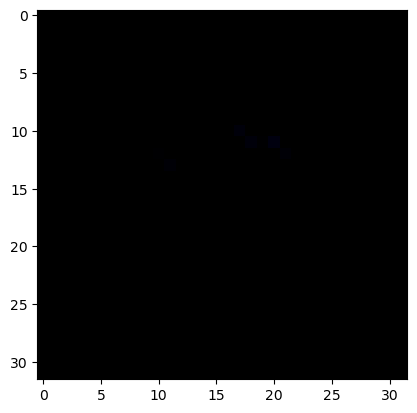

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


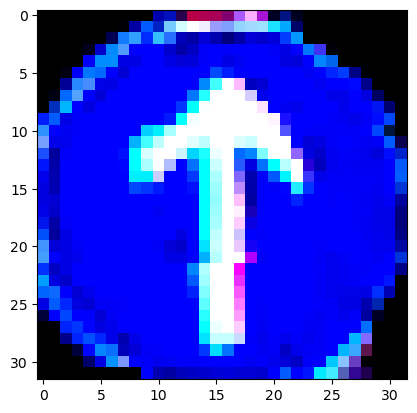

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 26
Predicted Label: 26


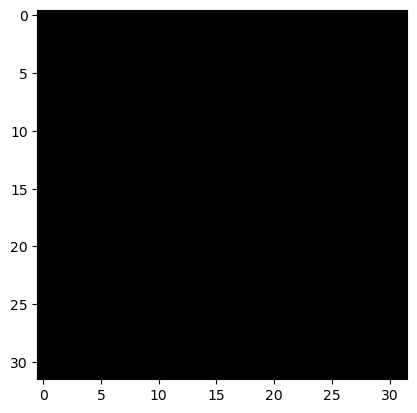

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


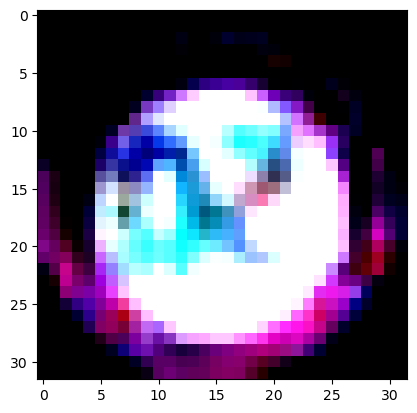

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


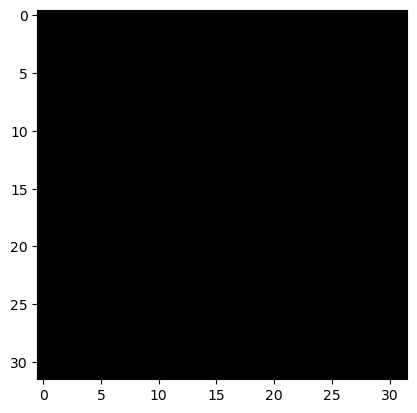

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


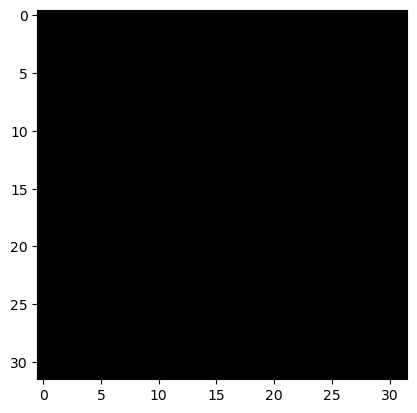

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 36
Predicted Label: 36


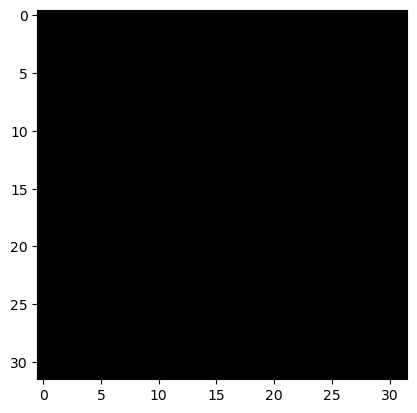

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


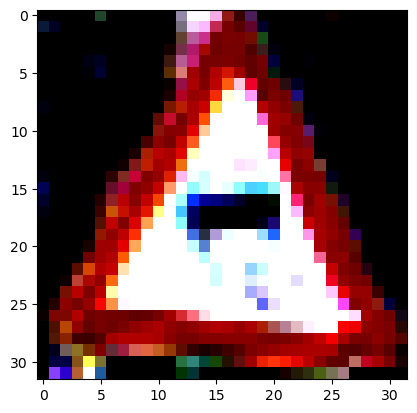

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


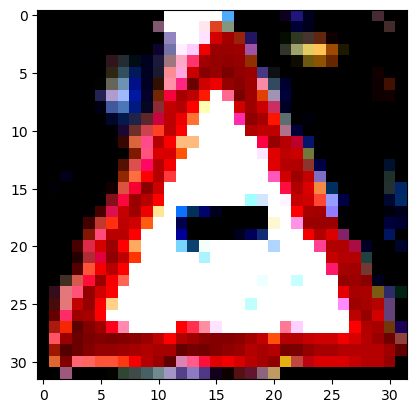

True Label: 23


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 23


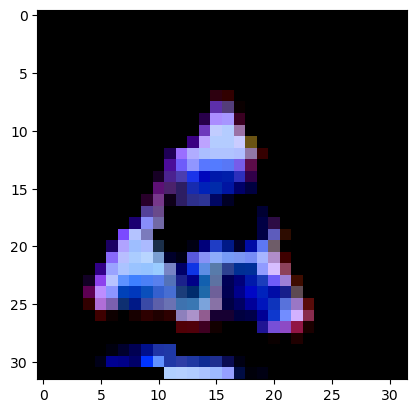

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


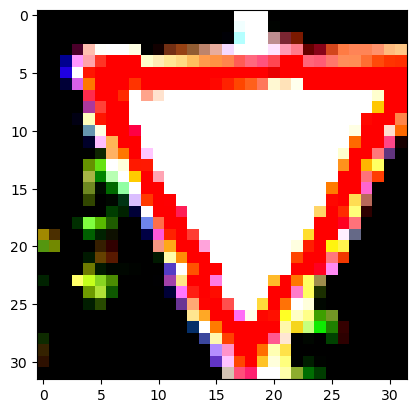

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 34
Predicted Label: 34


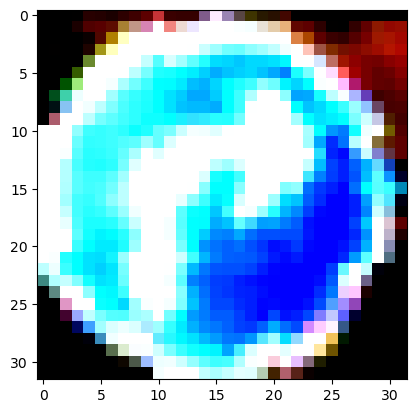

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


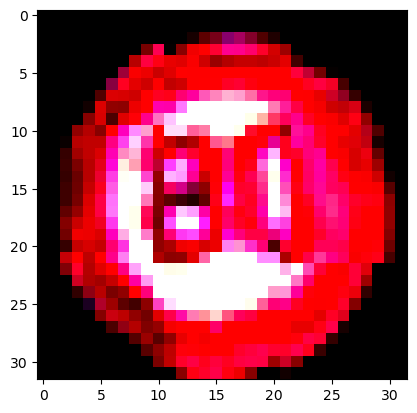

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


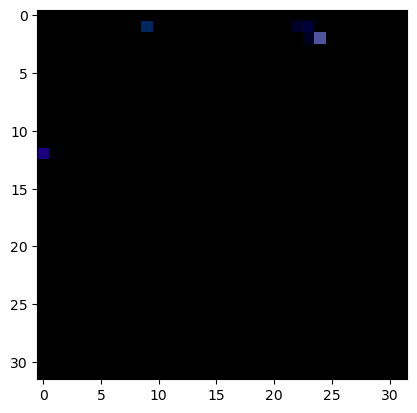

True Label: 1


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 1


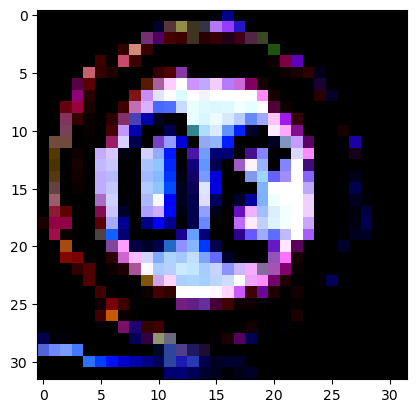

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


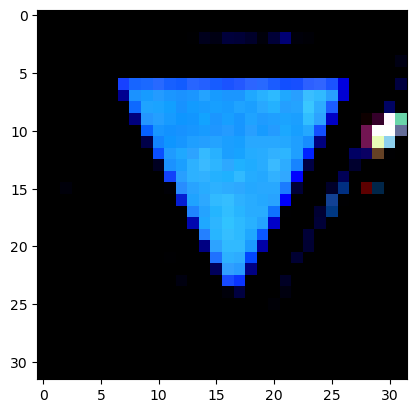

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


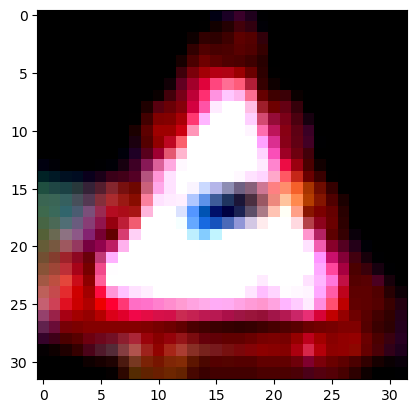

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


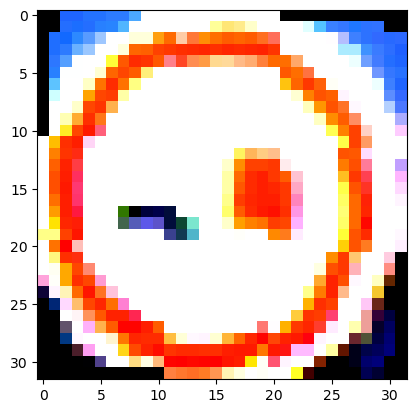

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 26
Predicted Label: 26


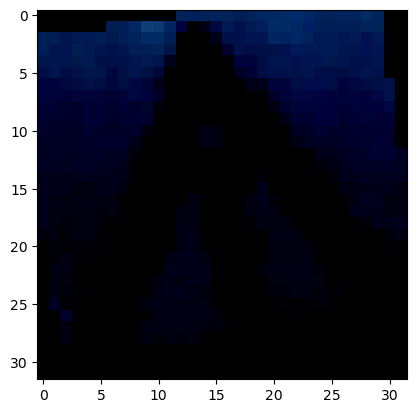

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


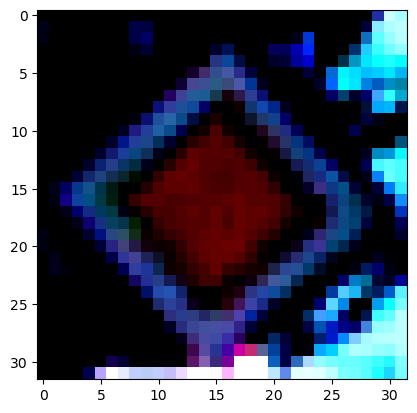

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


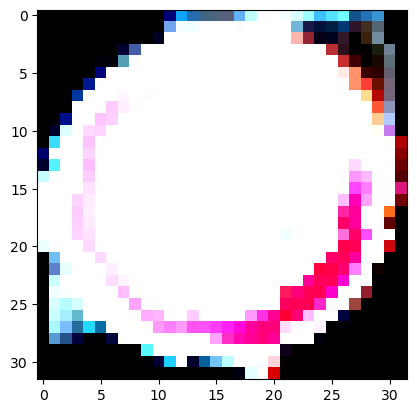

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 29
Predicted Label: 29


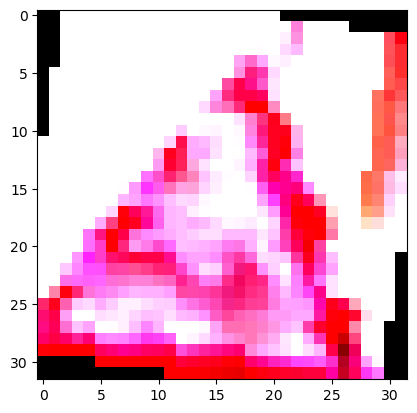

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


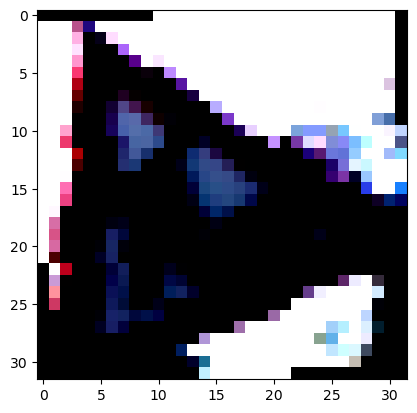

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


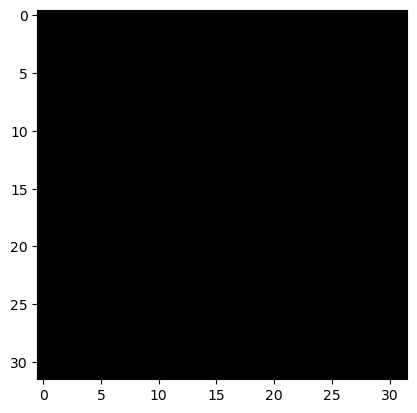

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


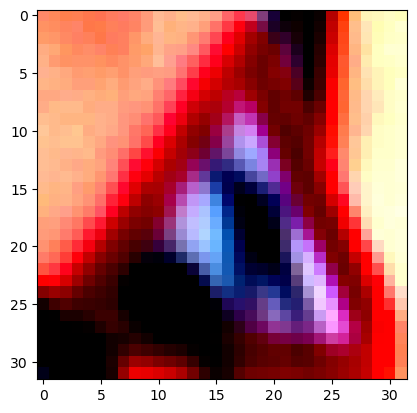

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


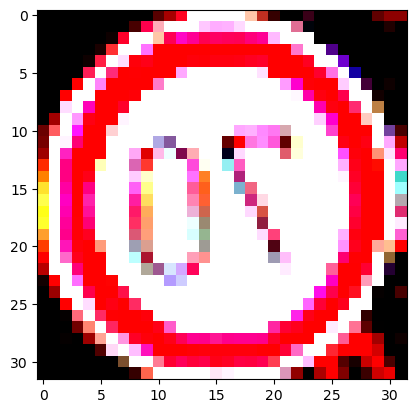

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 29
Predicted Label: 29


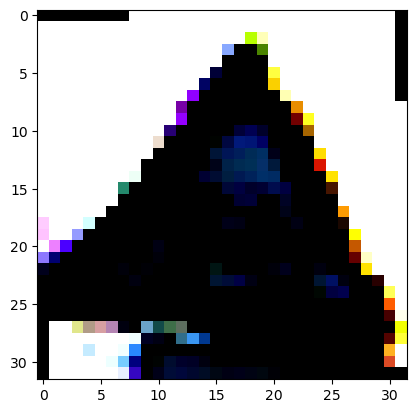

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 27
Predicted Label: 27


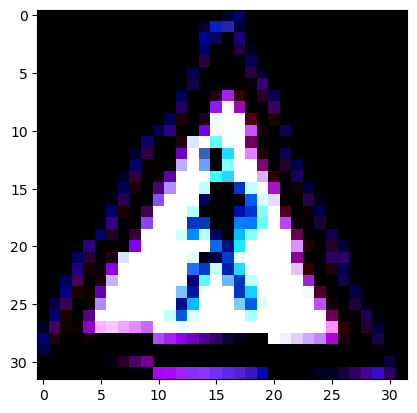

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


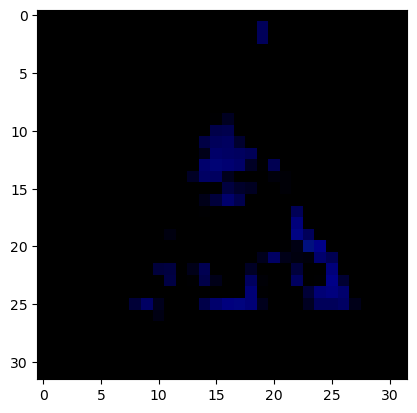

True Label: 9


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 9


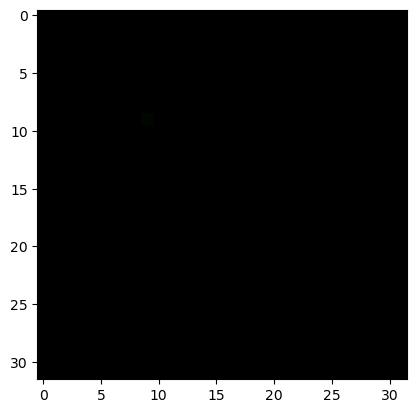

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


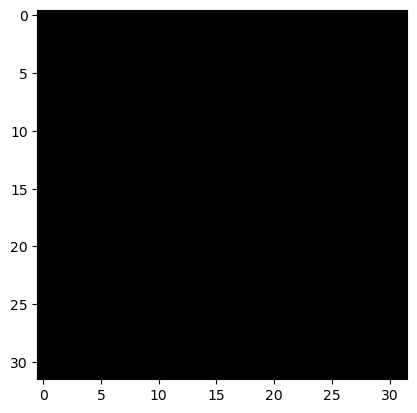

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


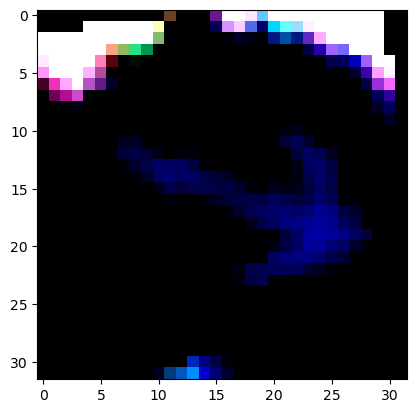

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


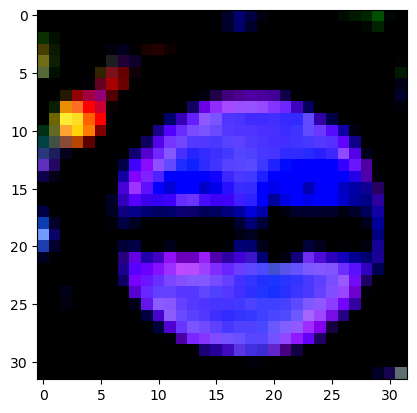

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


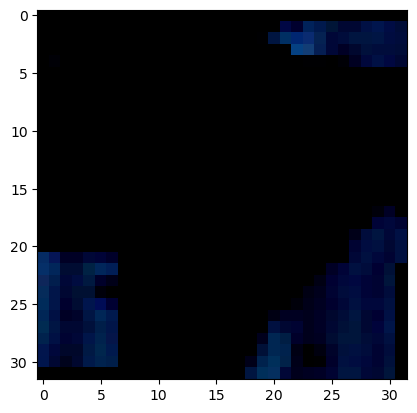

True Label: 31


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 31


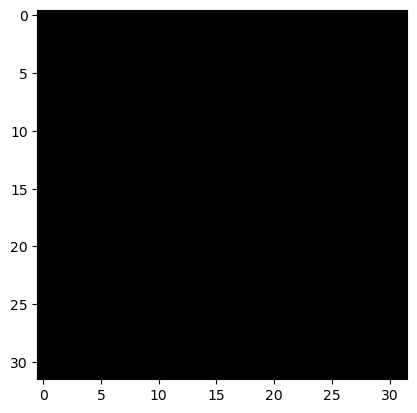

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 30
Predicted Label: 30


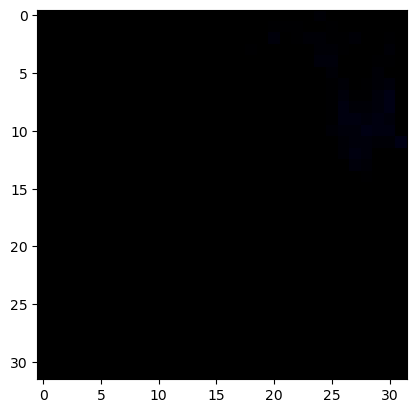

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


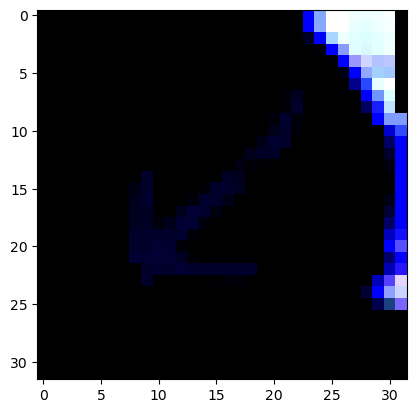

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


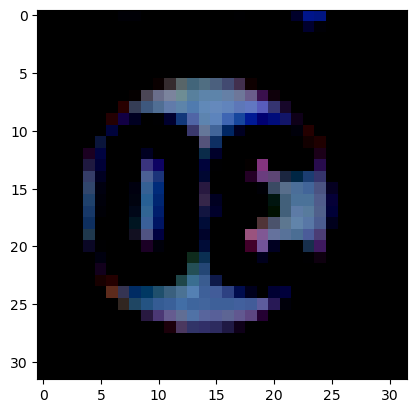

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


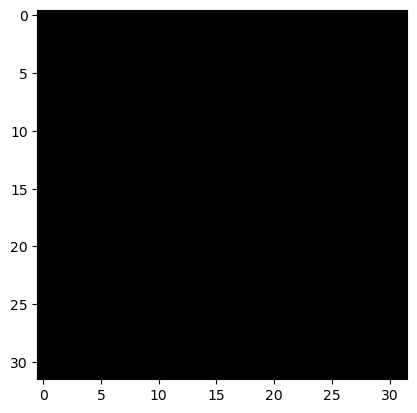

True Label: 14


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 14


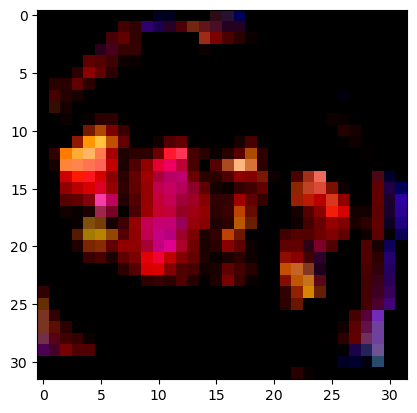

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


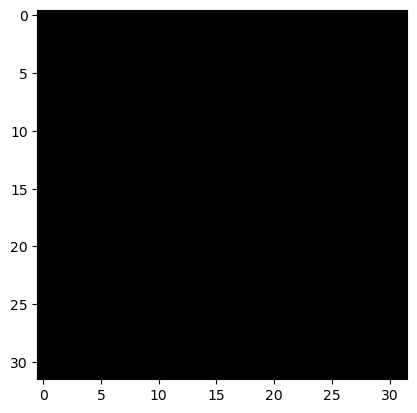

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 21
Predicted Label: 21


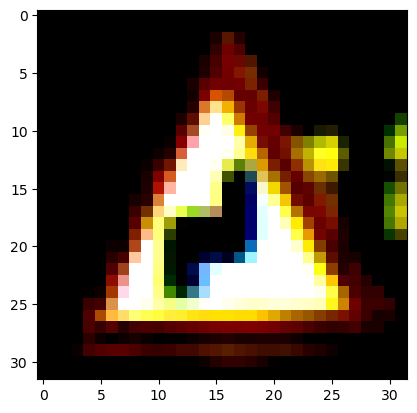

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


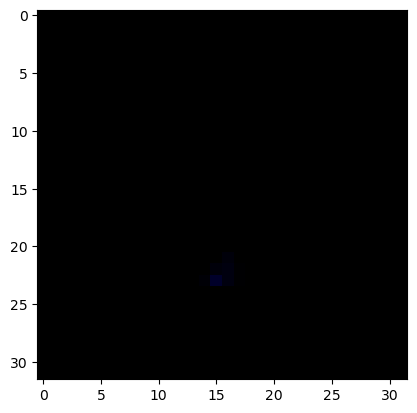

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 6
Predicted Label: 6


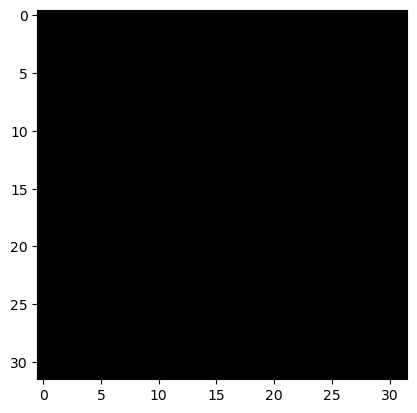

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


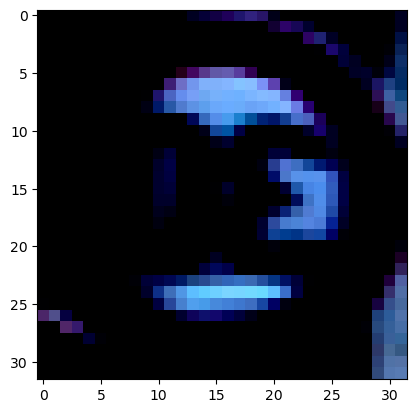

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


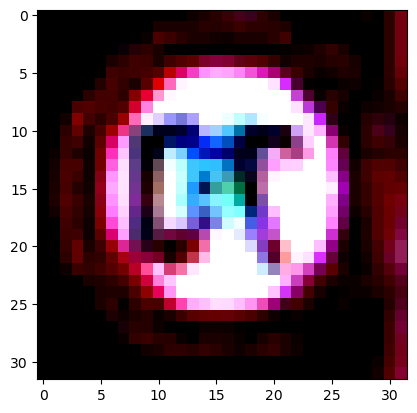

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


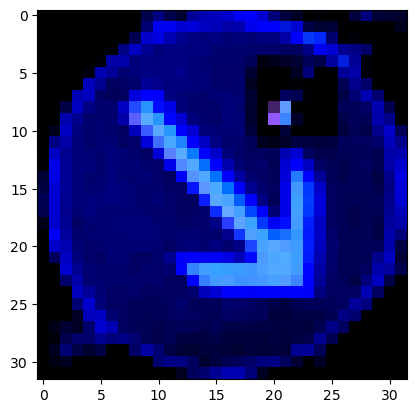

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 33
Predicted Label: 33


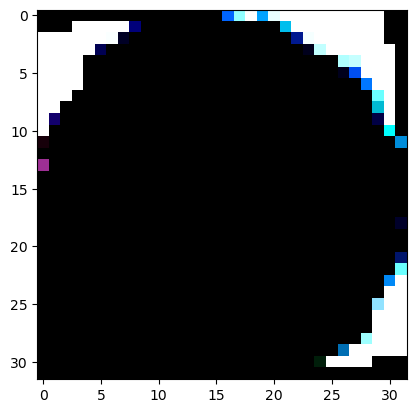

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


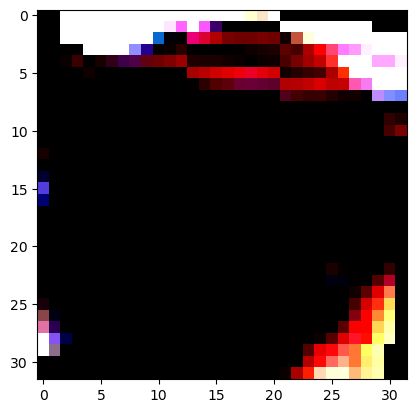

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


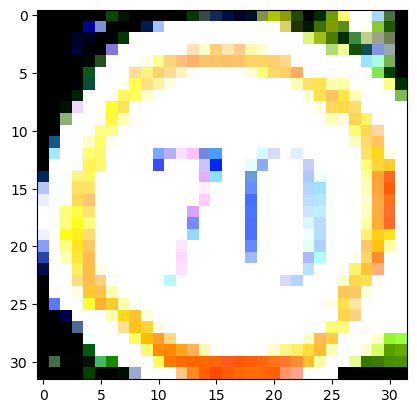

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 5


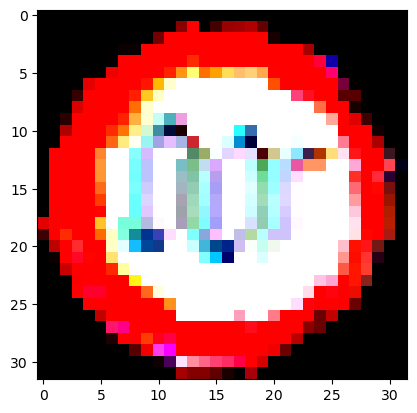

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


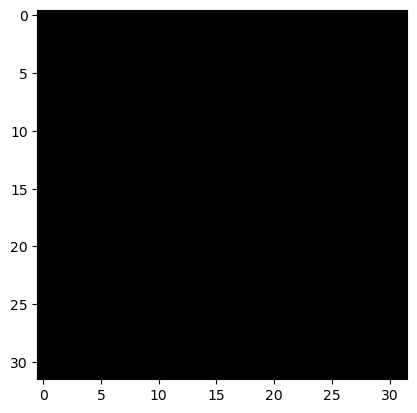

True Label: 30
Predicted Label: 30


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


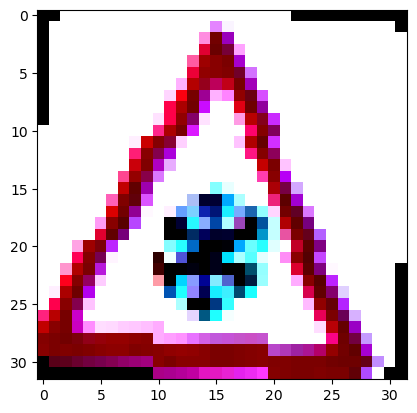

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


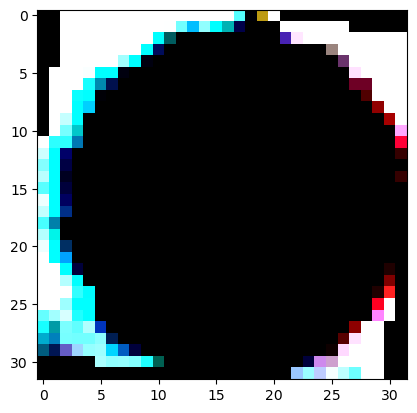

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


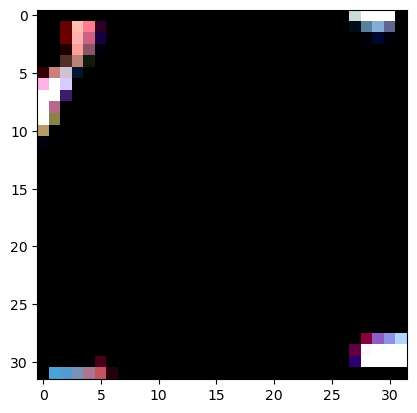

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


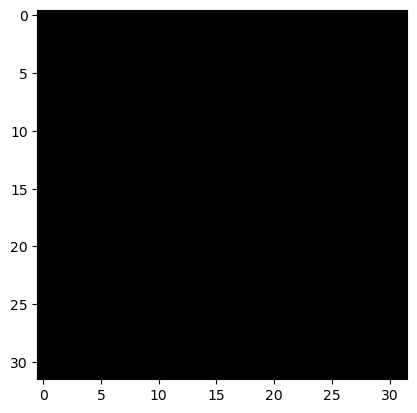

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


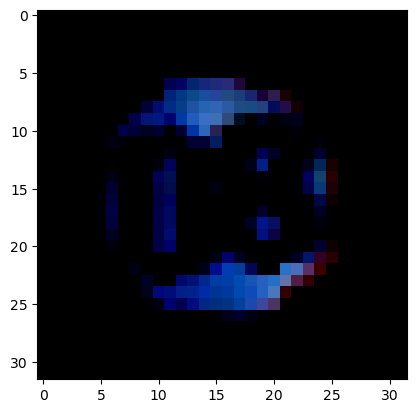

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


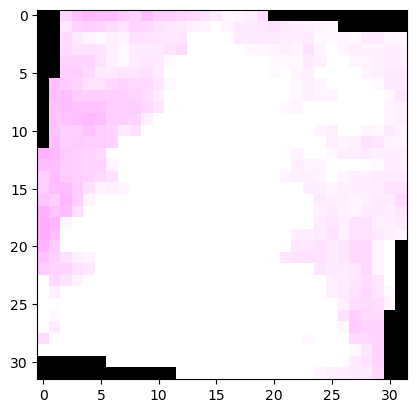

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


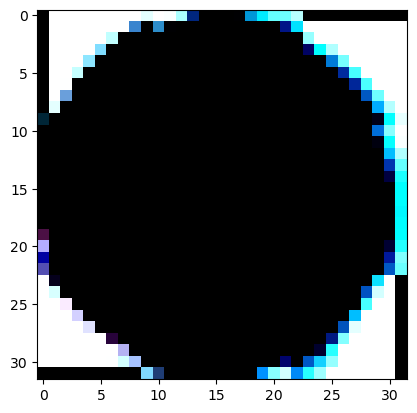

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


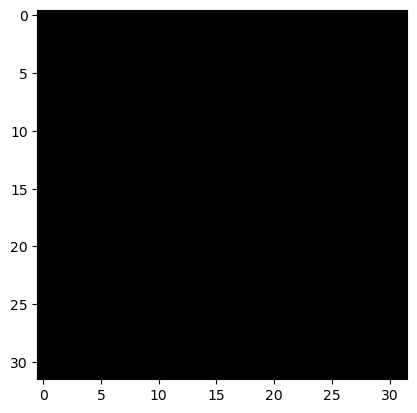

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


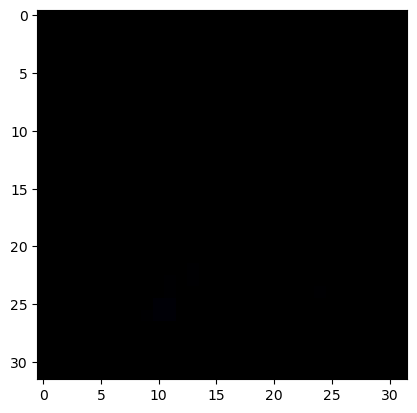

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


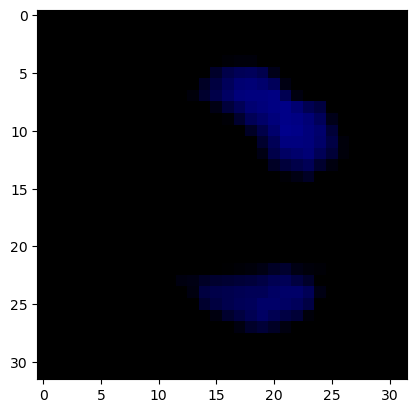

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


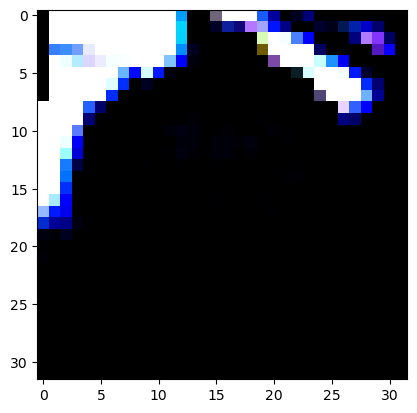

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


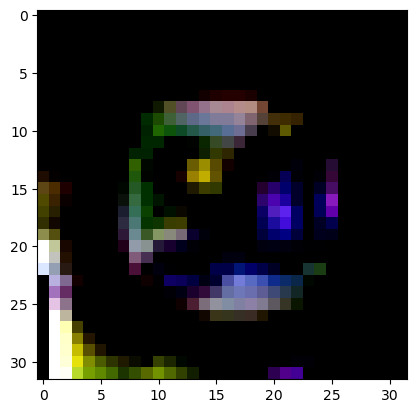

True Label: 25


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 25


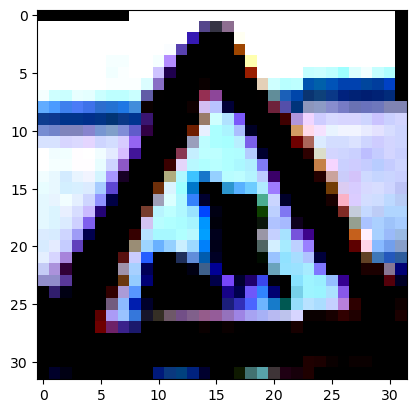

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


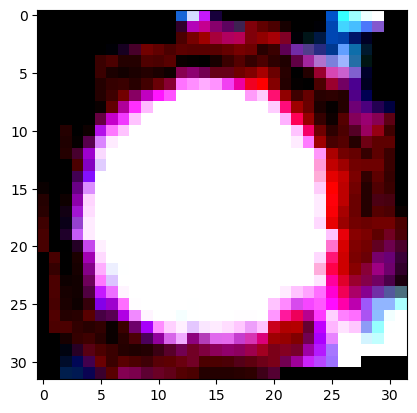

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 40
Predicted Label: 40


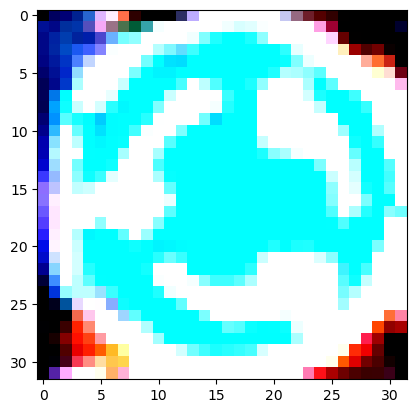

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


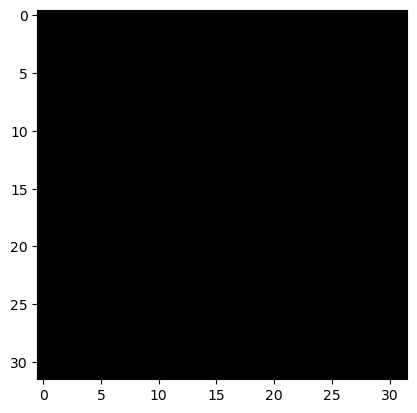

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 32
Predicted Label: 32


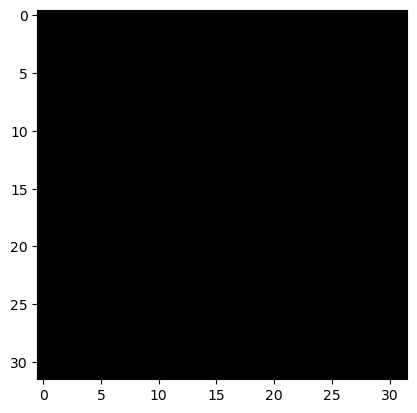

True Label: 12


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 12


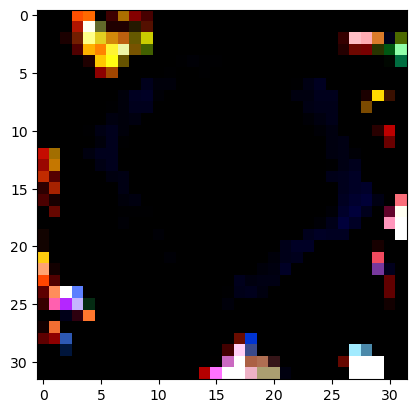

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


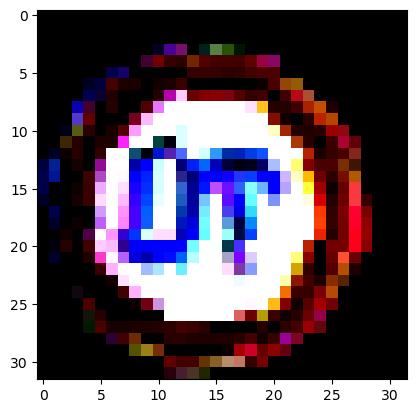

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


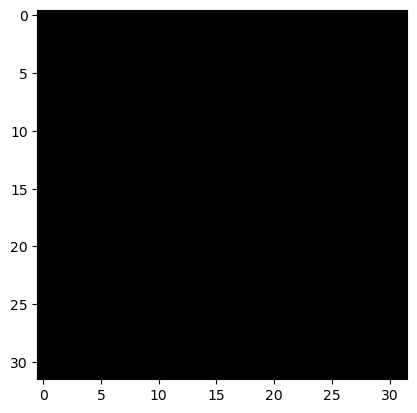

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 29
Predicted Label: 29


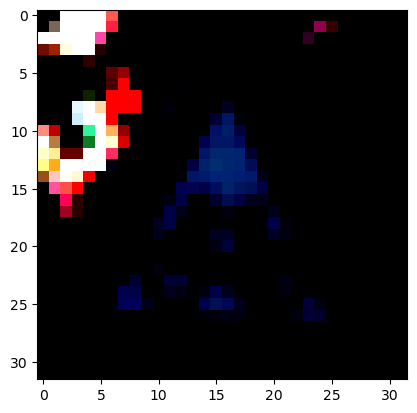

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


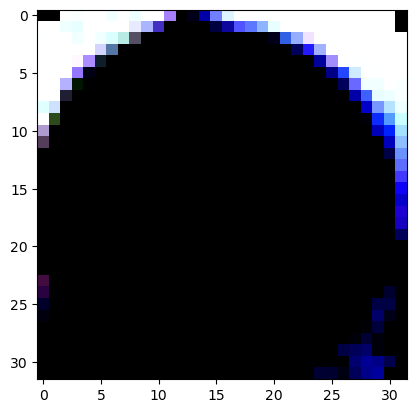

True Label: 7


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 7


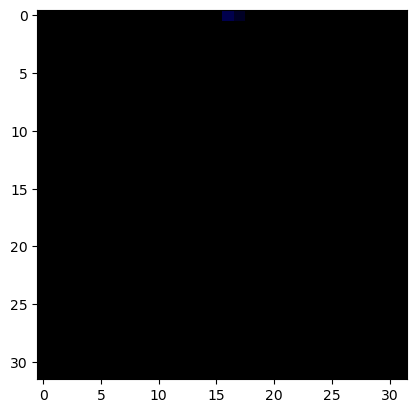

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


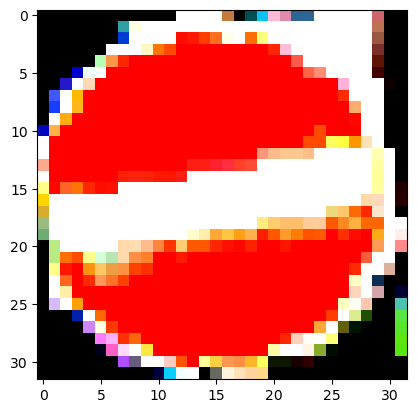

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


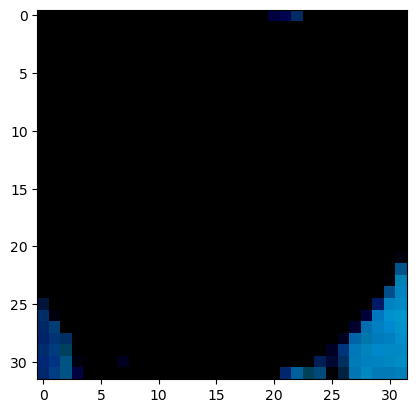

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


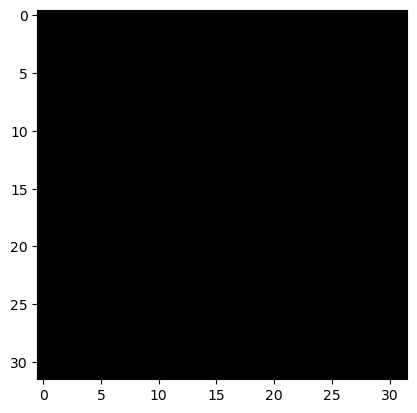

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


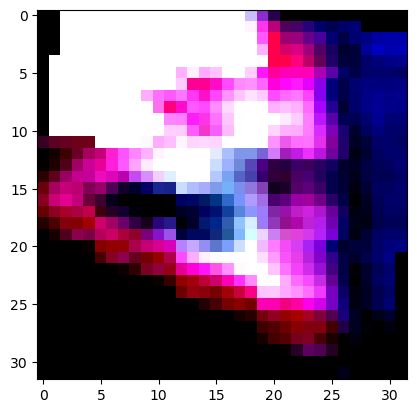

True Label: 28


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 28


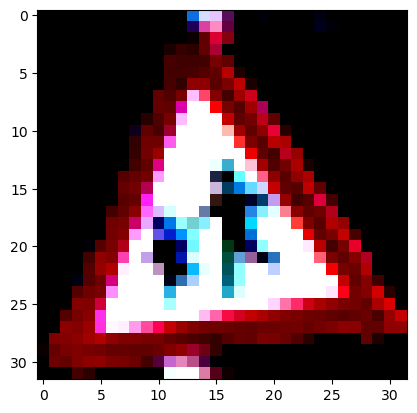

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


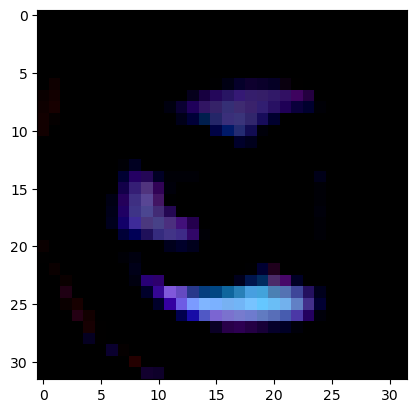

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


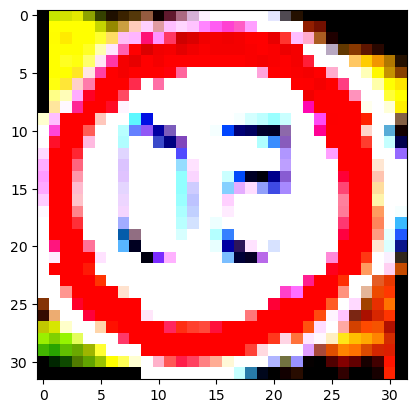

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


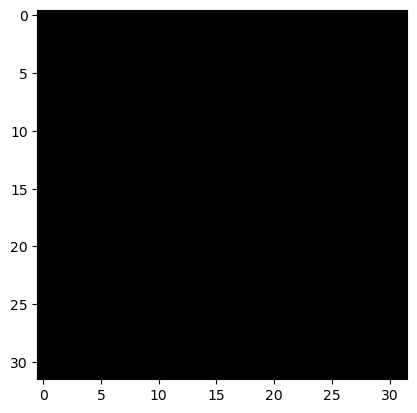

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


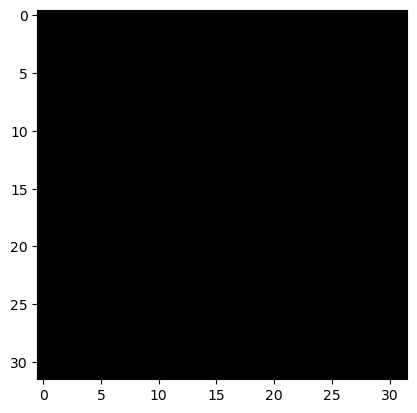

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 21
Predicted Label: 21


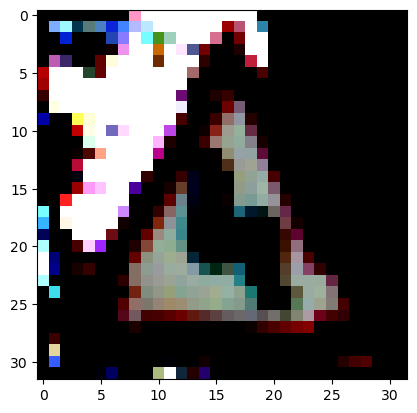

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


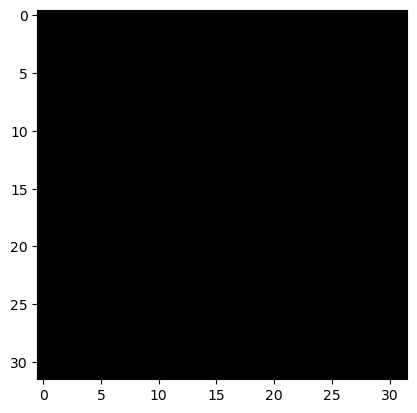

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


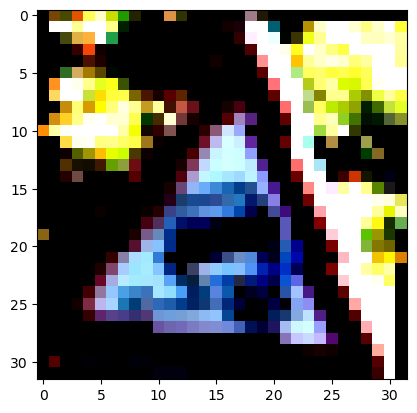

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 21
Predicted Label: 21


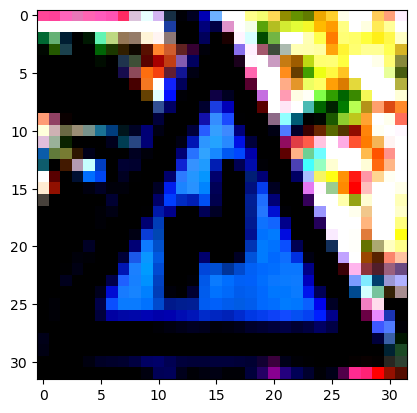

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 20
Predicted Label: 20


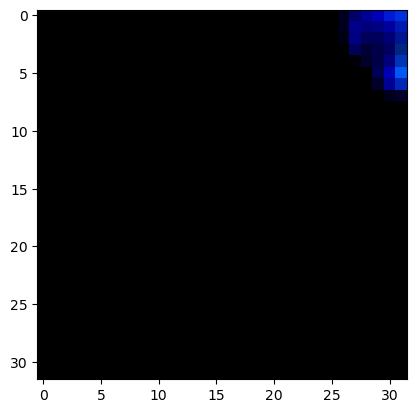

True Label: 3


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 3


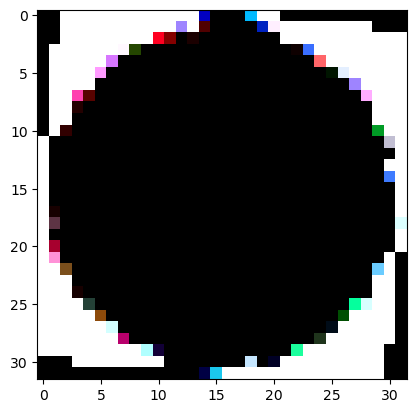

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


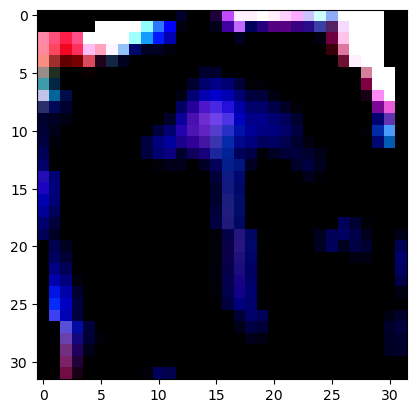

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


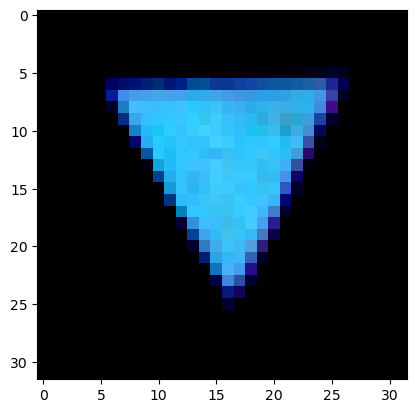

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


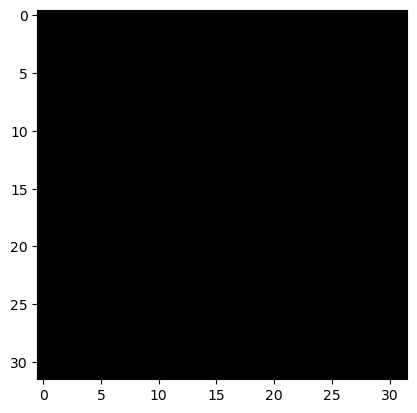

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


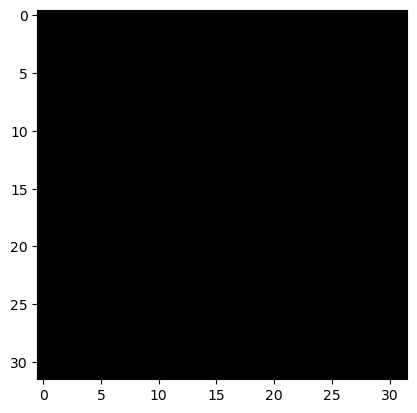

True Label: 17


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 17


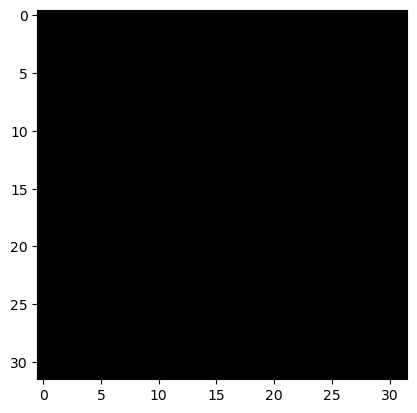

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 29
Predicted Label: 29


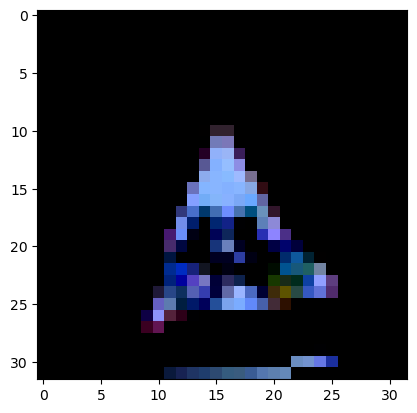

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 40
Predicted Label: 40


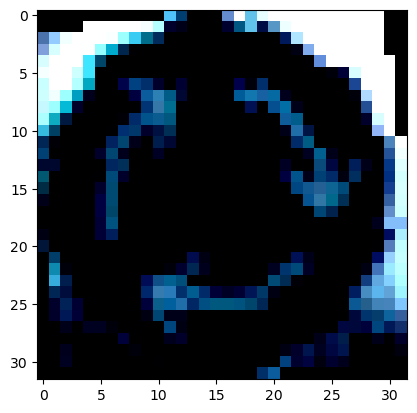

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


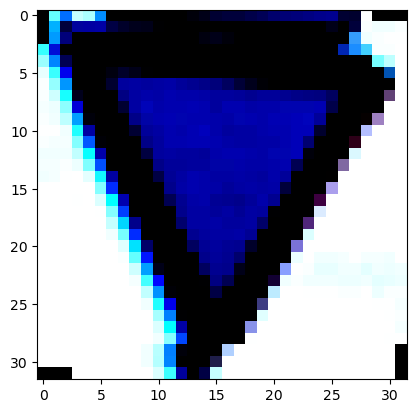

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 26
Predicted Label: 26


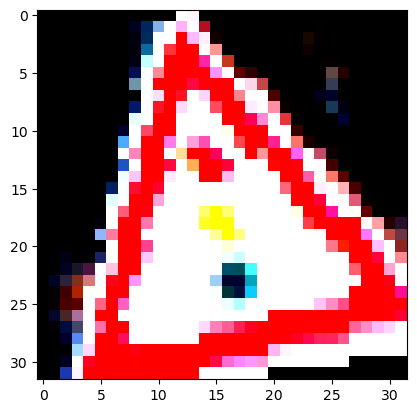

True Label: 18


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 18


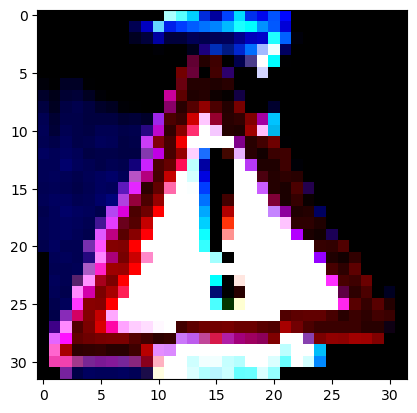

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


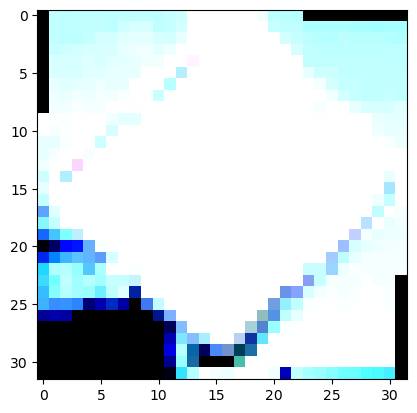

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


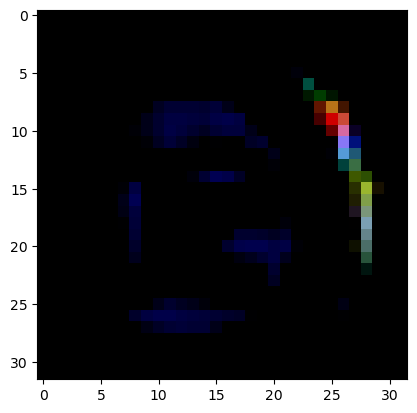

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


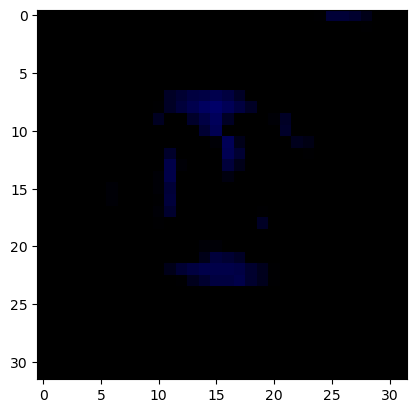

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


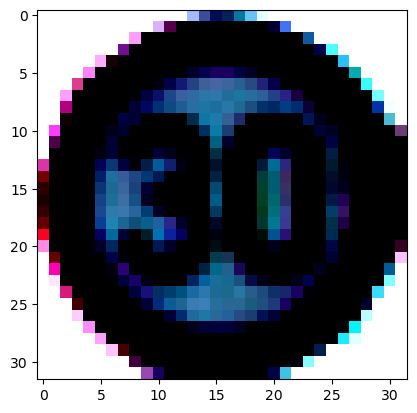

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 36
Predicted Label: 36


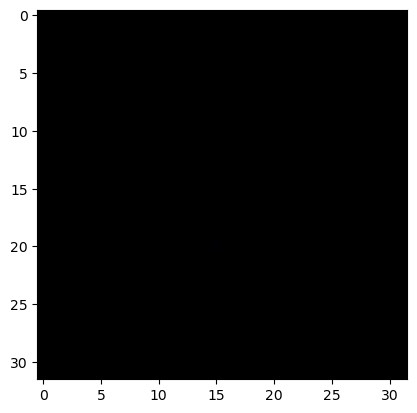

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


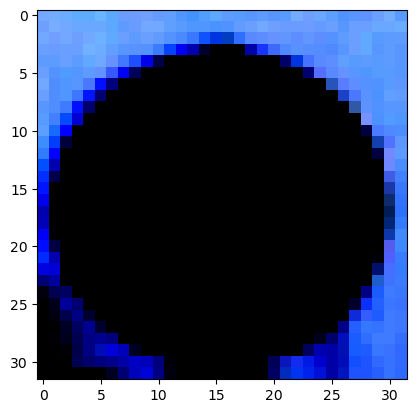

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 34
Predicted Label: 34


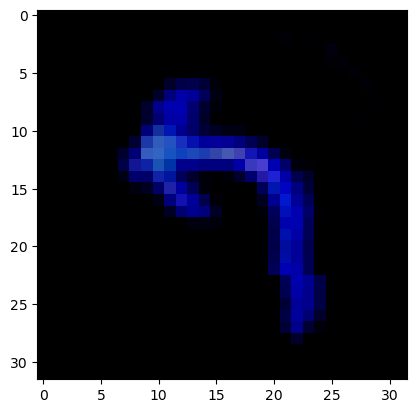

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 8


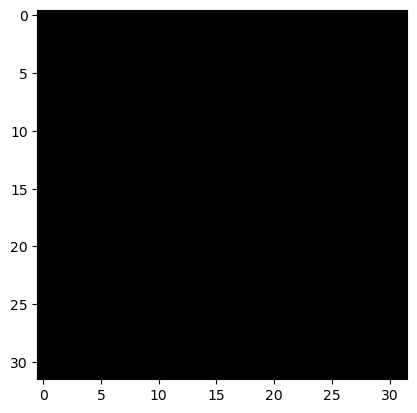

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


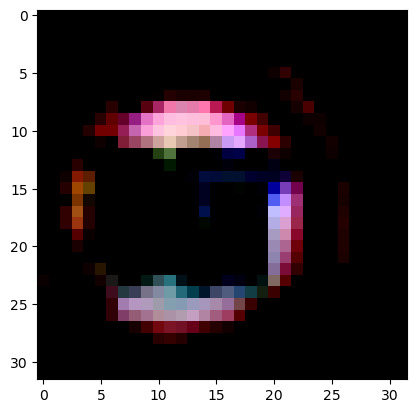

True Label: 5


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 5


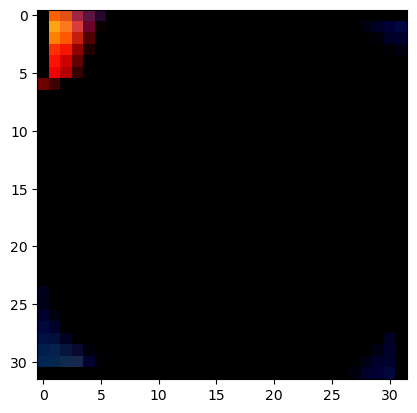

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


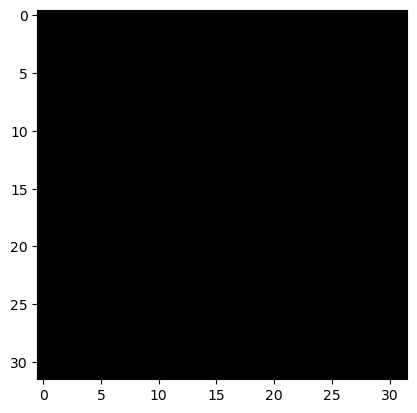

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 39
Predicted Label: 39


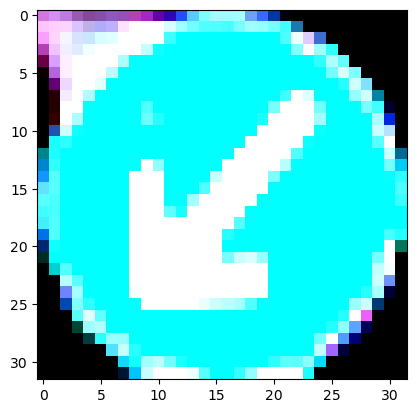

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 36
Predicted Label: 36


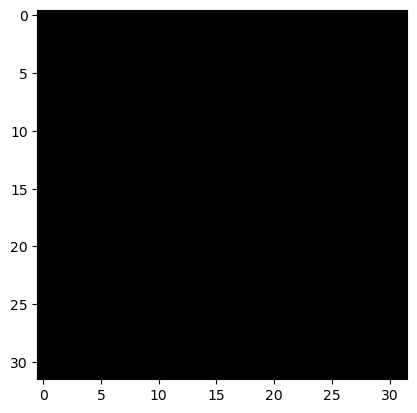

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


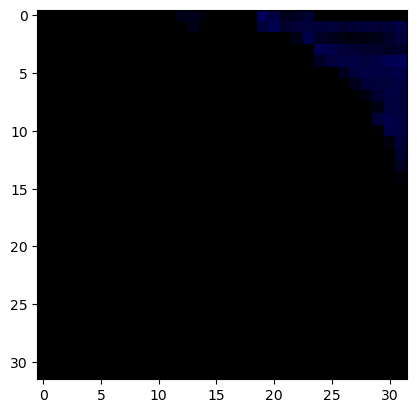

True Label: 9


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 9


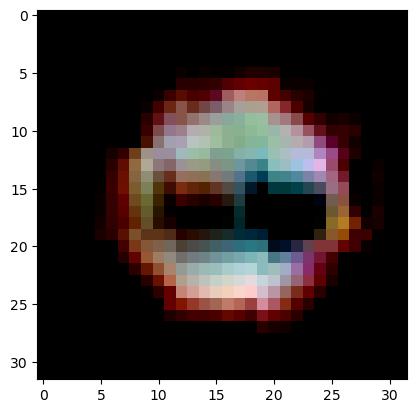

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


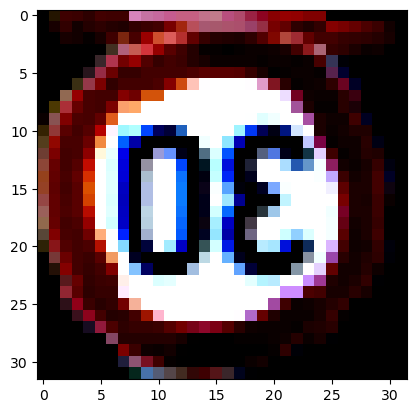

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


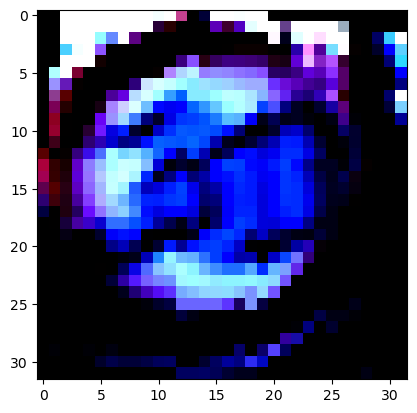

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 33
Predicted Label: 33


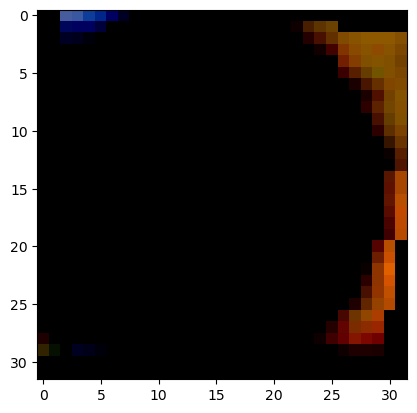

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


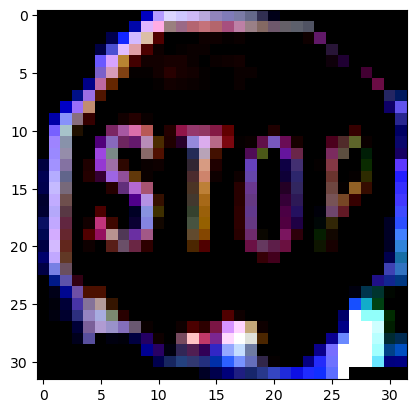

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


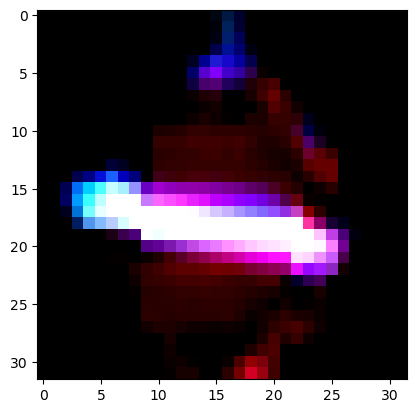

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


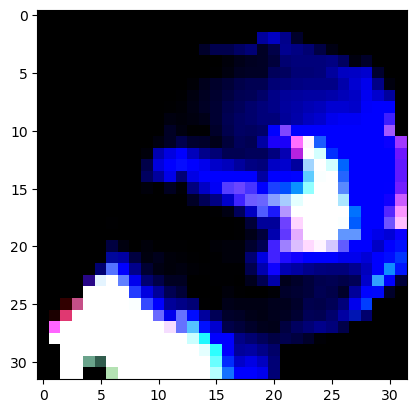

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


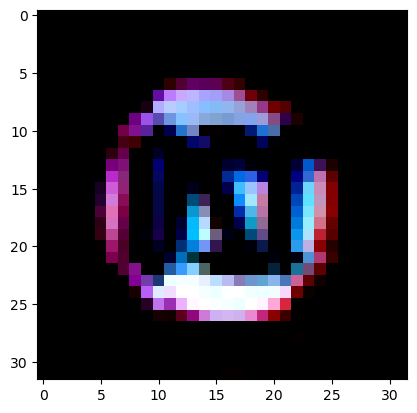

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


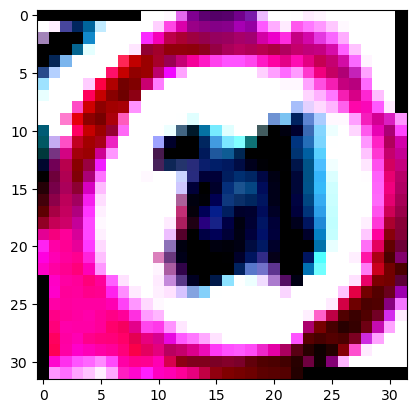

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


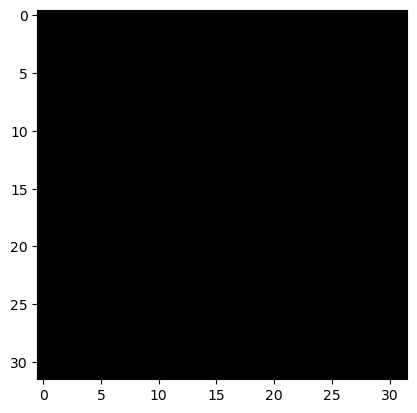

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


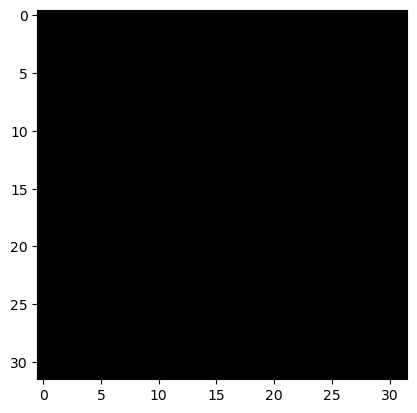

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 6
Predicted Label: 6


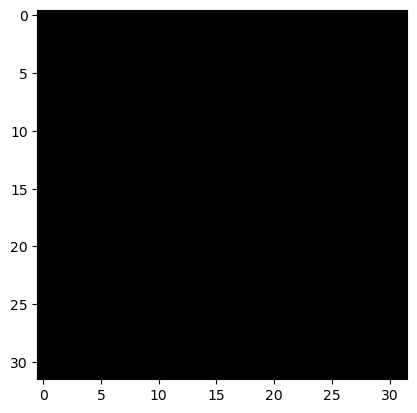

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


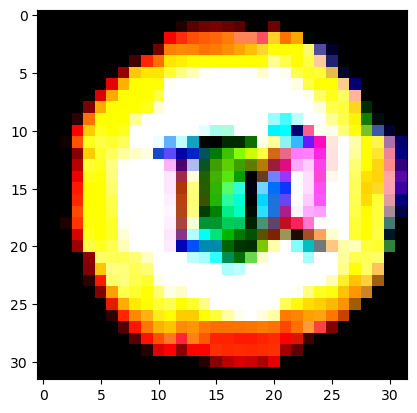

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


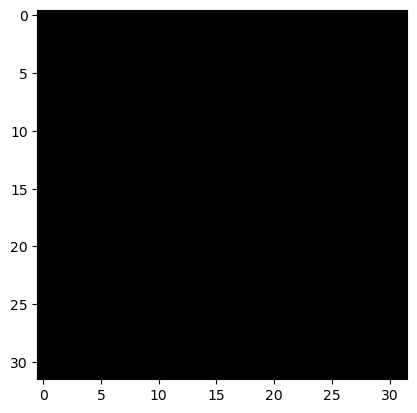

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


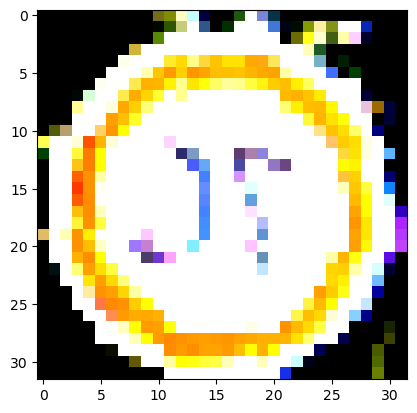

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


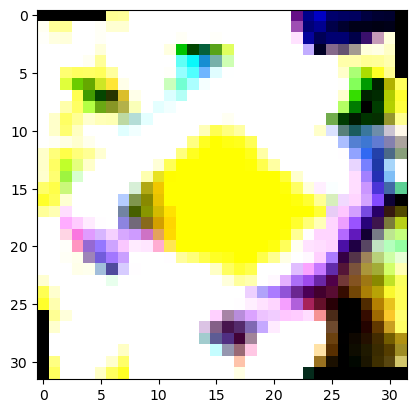

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


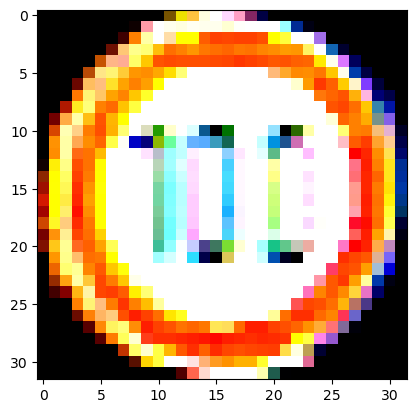

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


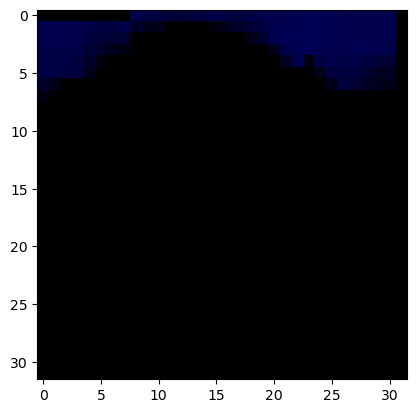

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


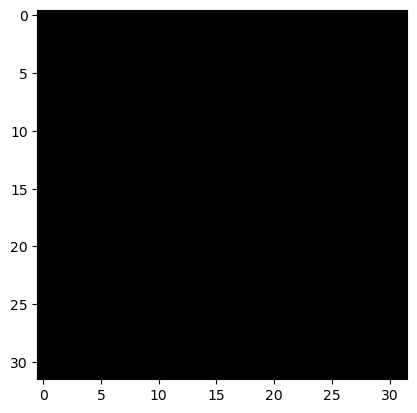

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


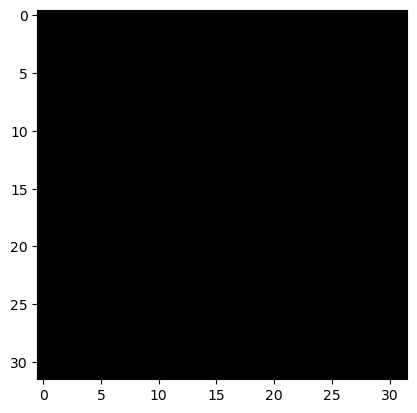

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


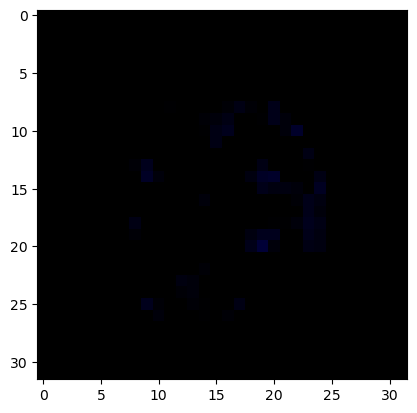

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


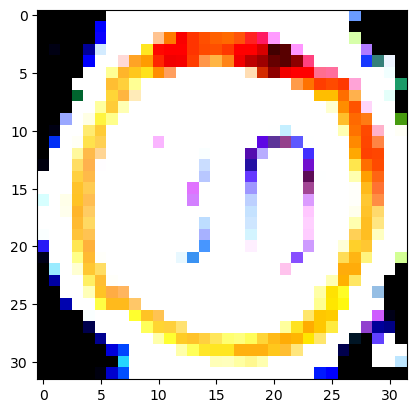

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


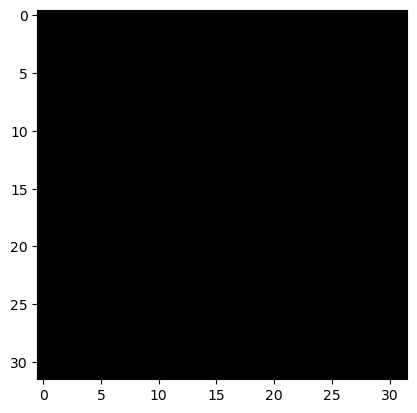

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 40
Predicted Label: 40


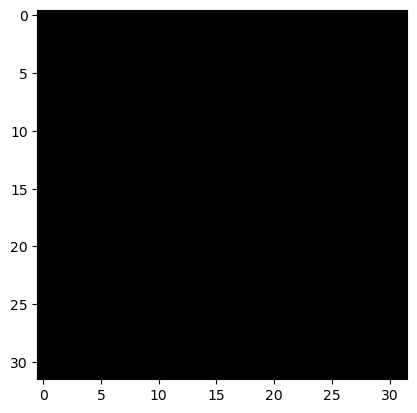

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 37
Predicted Label: 37


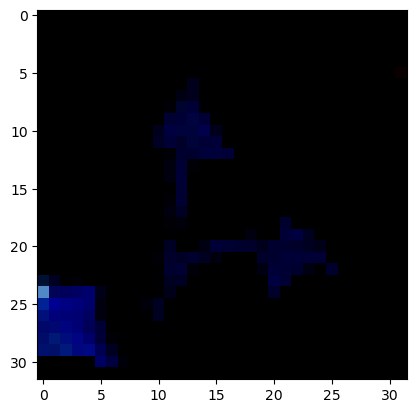

True Label: 25


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 25


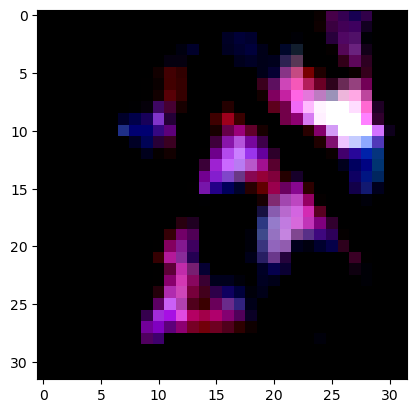

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


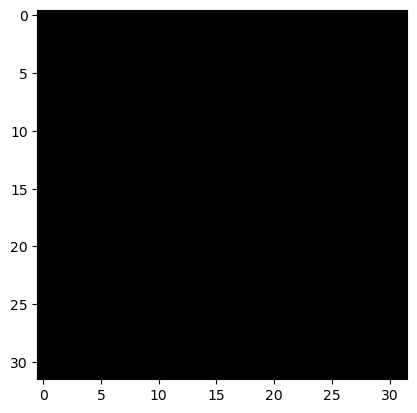

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


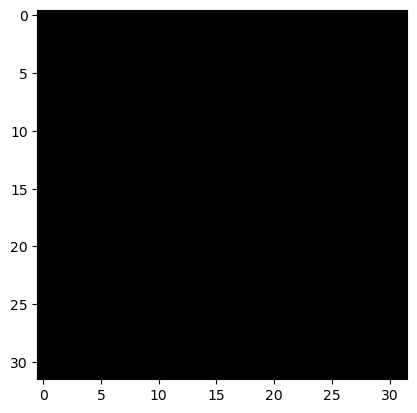

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 28
Predicted Label: 28


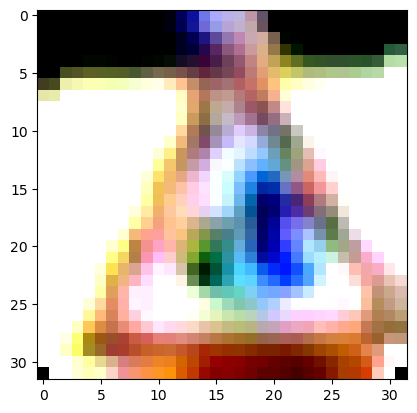

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 36
Predicted Label: 36


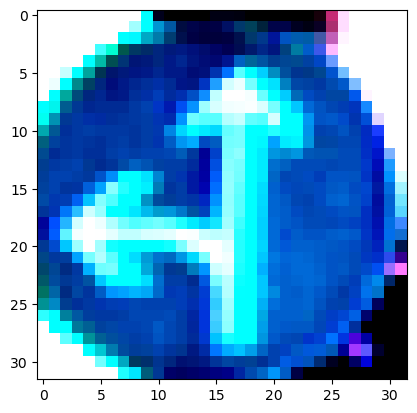

True Label: 11


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 11


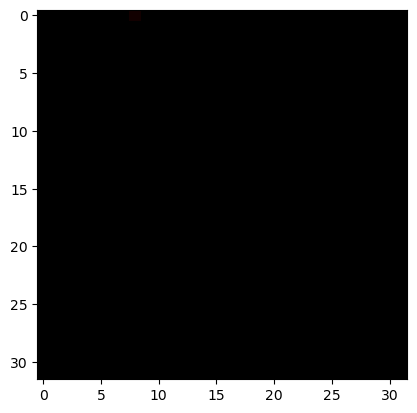

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 30
Predicted Label: 30


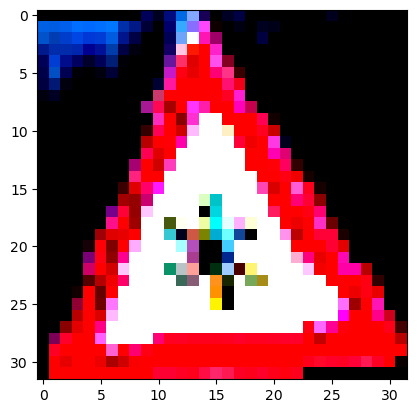

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


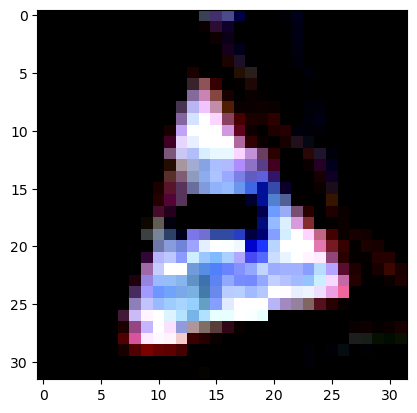

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 29
Predicted Label: 29


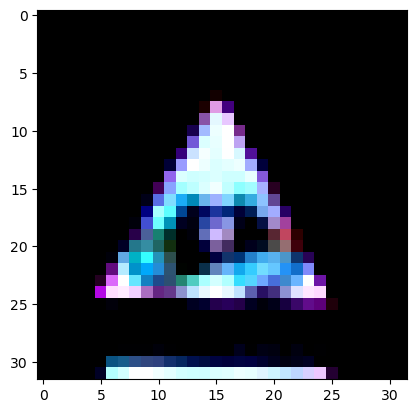

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


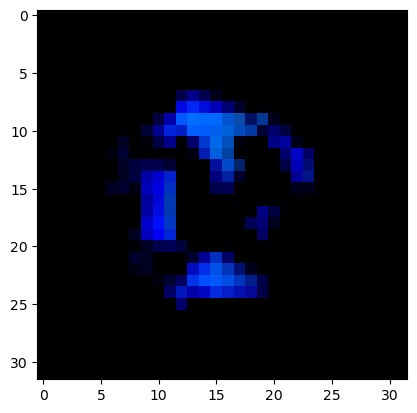

True Label: 18


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 18


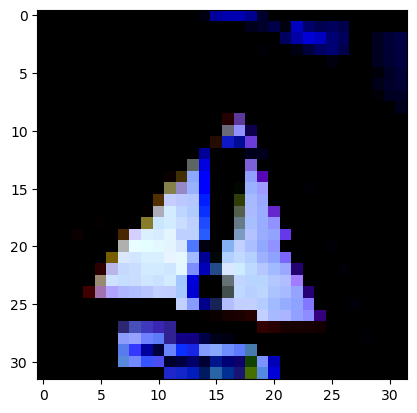

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


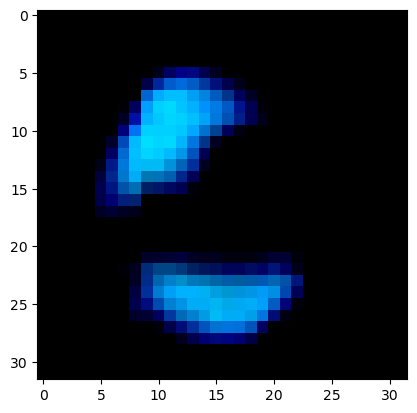

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 31
Predicted Label: 31


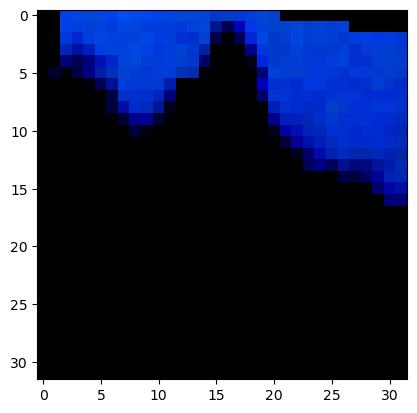

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


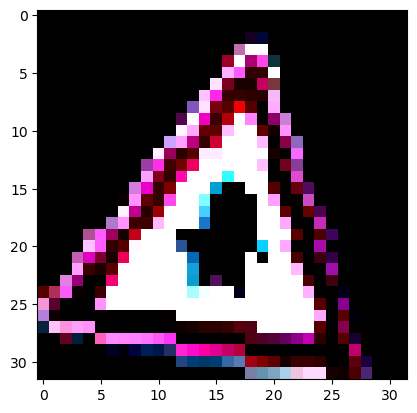

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


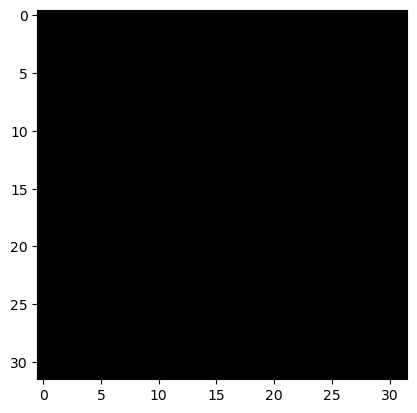

True Label: 11


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 11


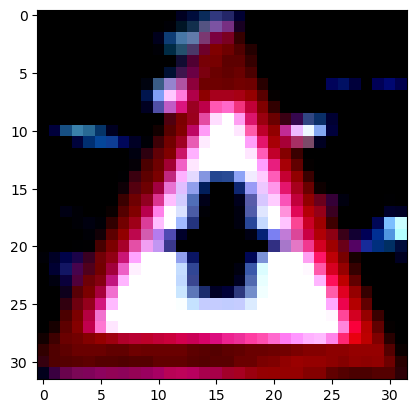

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


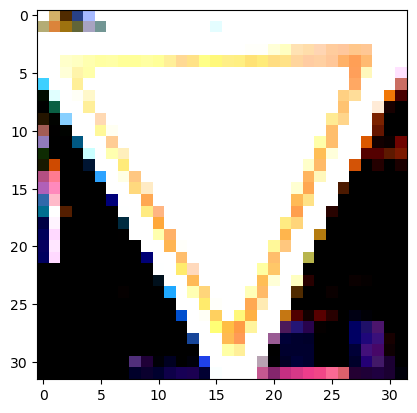

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


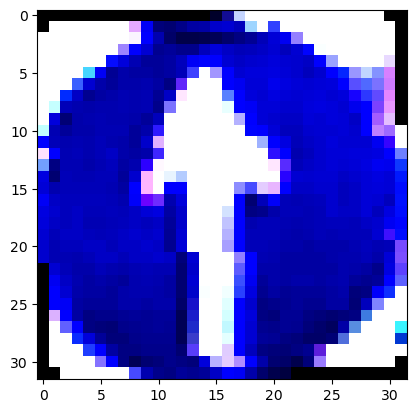

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


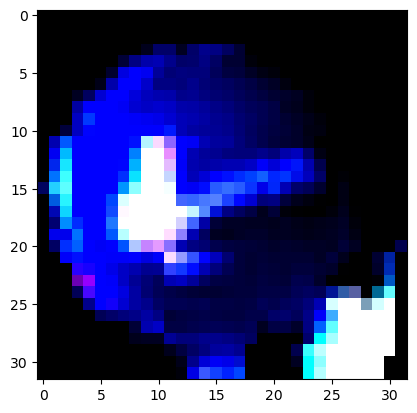

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


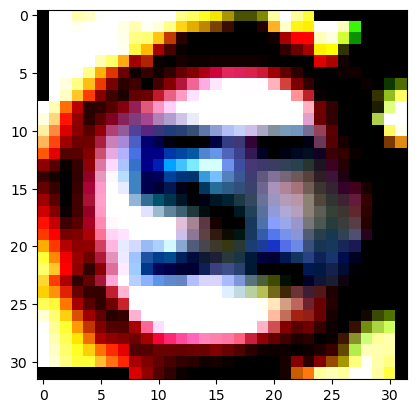

True Label: 11


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 11


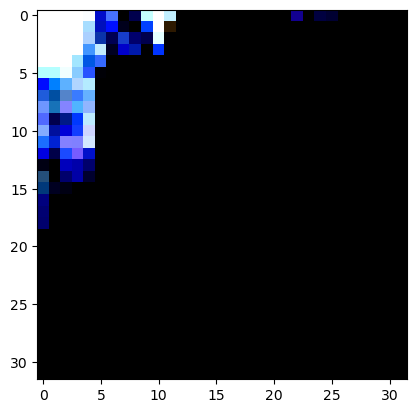

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


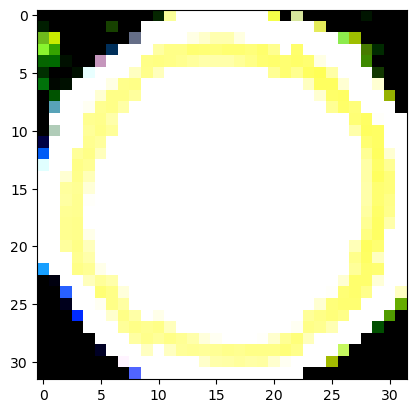

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


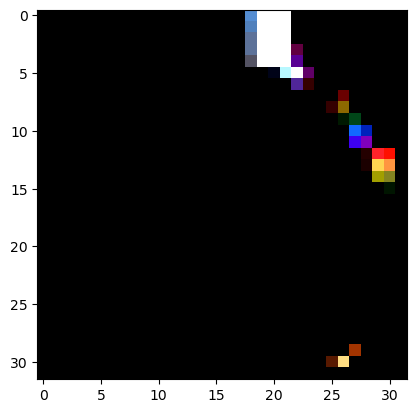

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


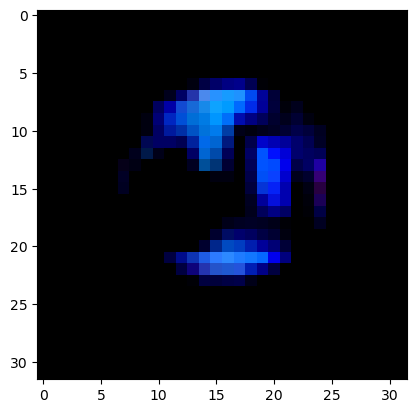

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


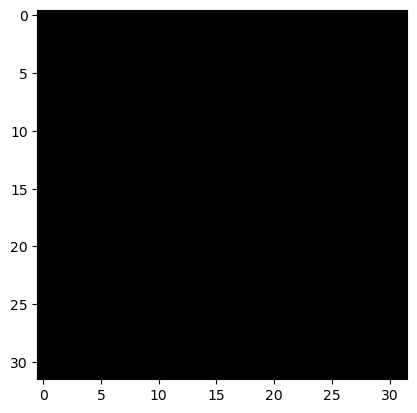

True Label: 3


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 3


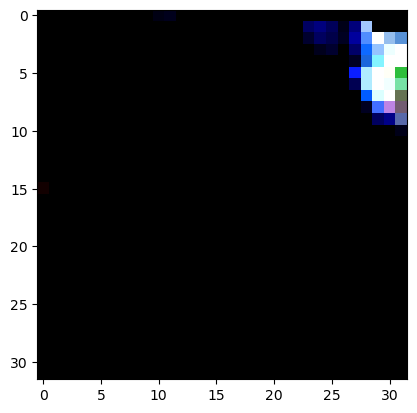

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


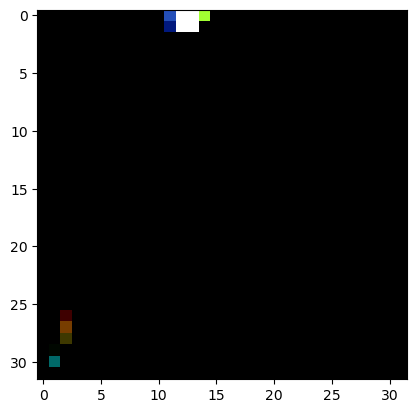

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


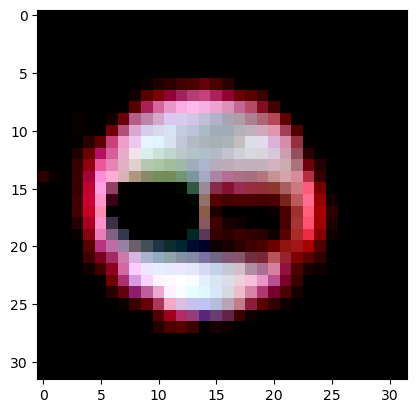

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


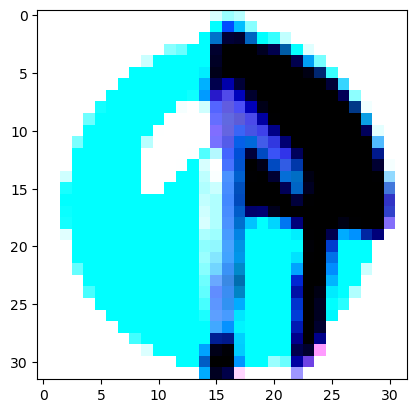

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


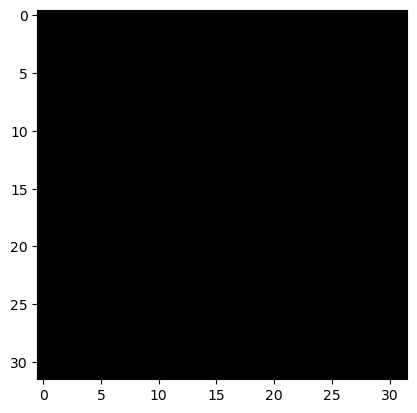

True Label: 5


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 5


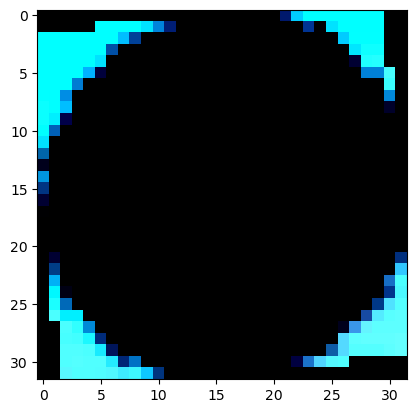

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


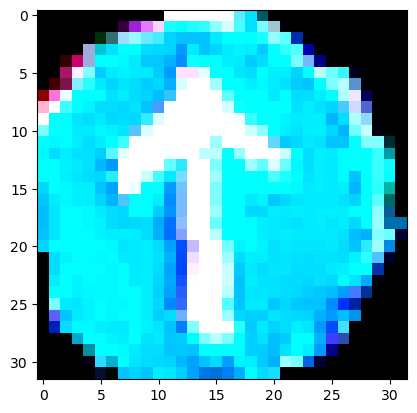

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


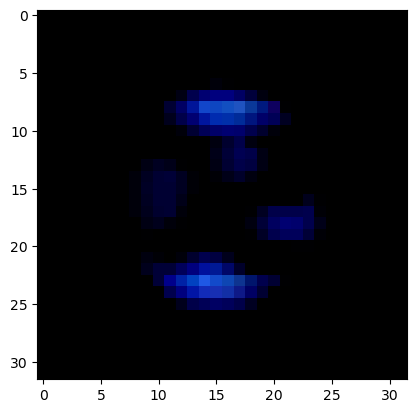

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 6
Predicted Label: 6


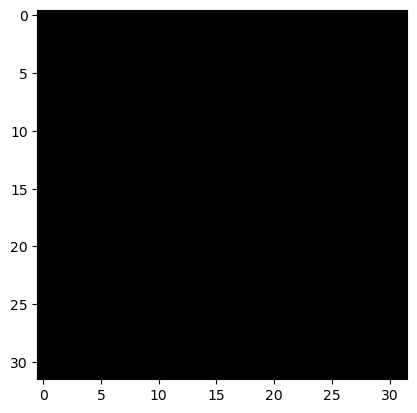

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


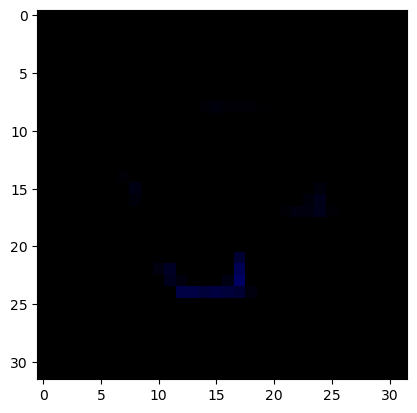

True Label: 18


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 18


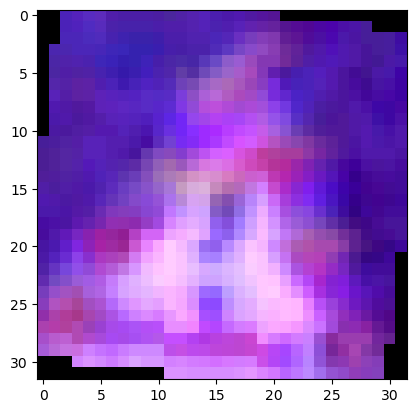

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


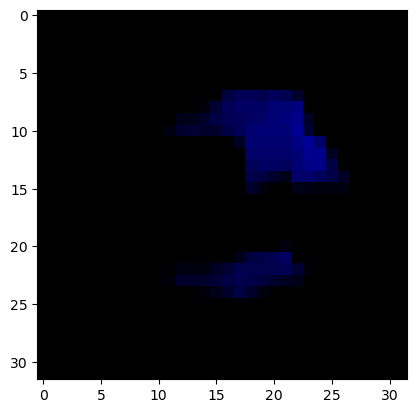

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


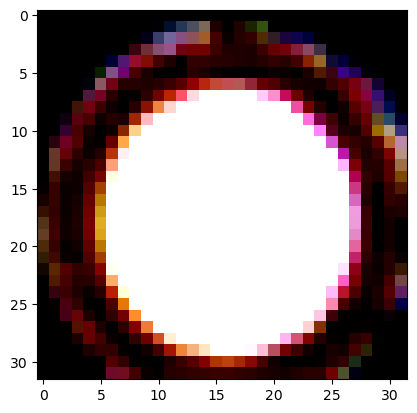

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


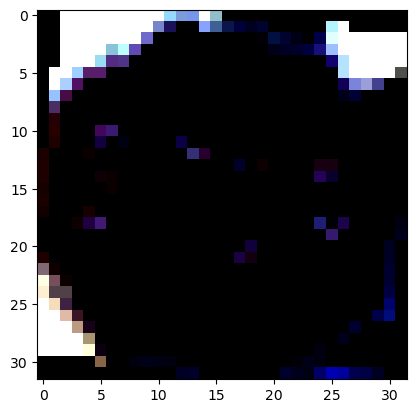

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


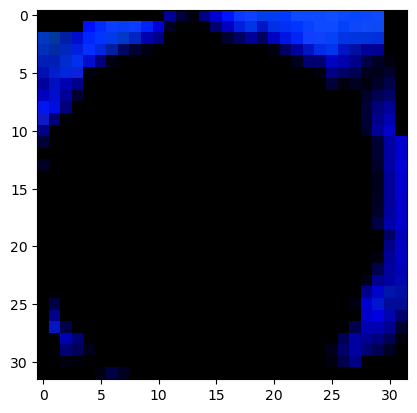

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


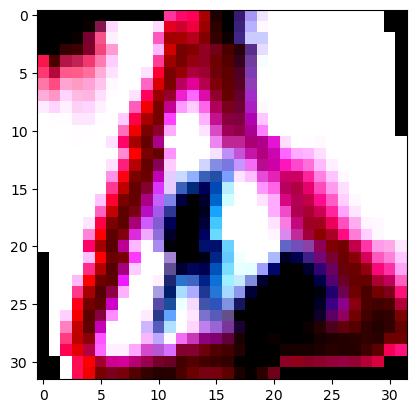

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


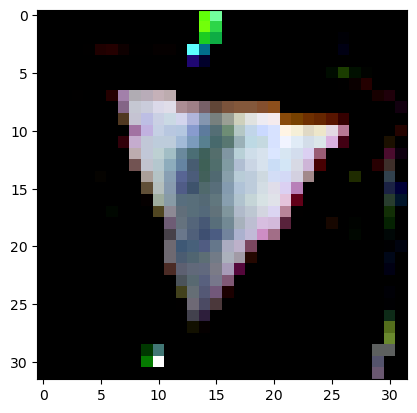

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


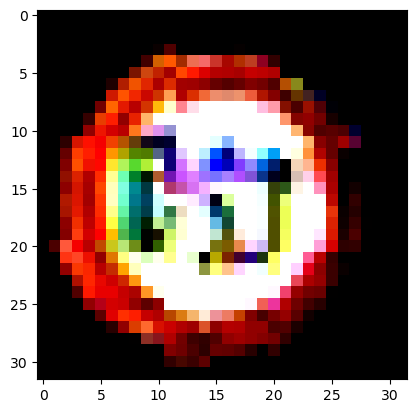

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


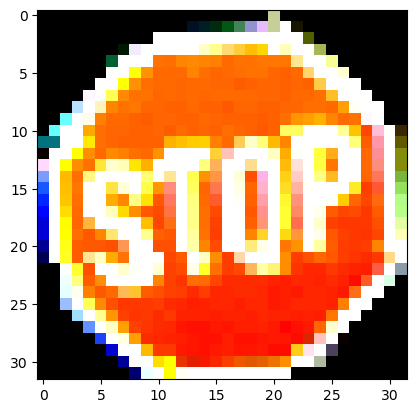

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


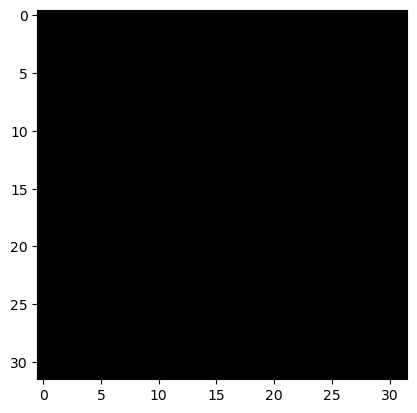

True Label: 25


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 25


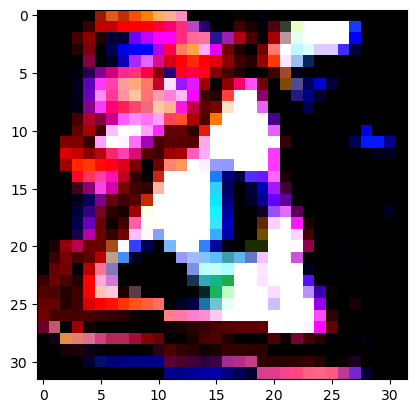

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


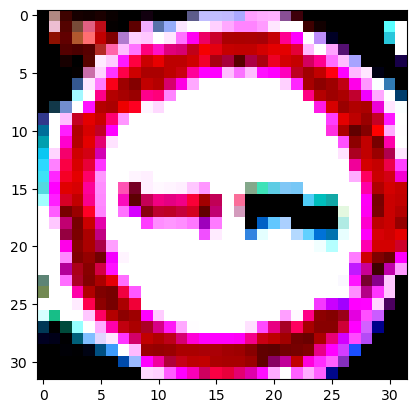

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


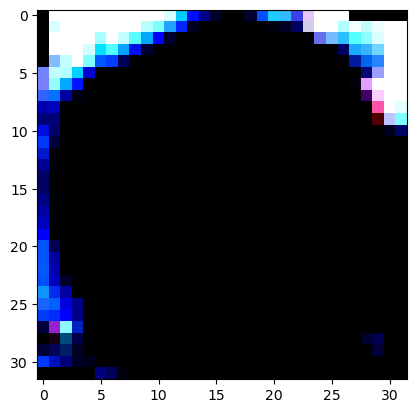

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


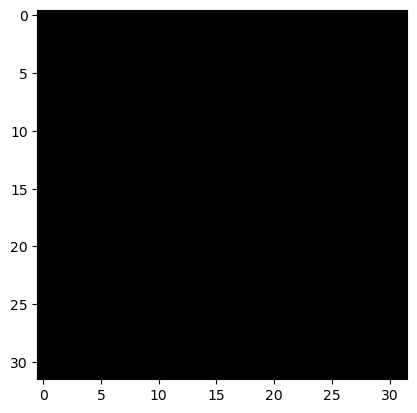

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


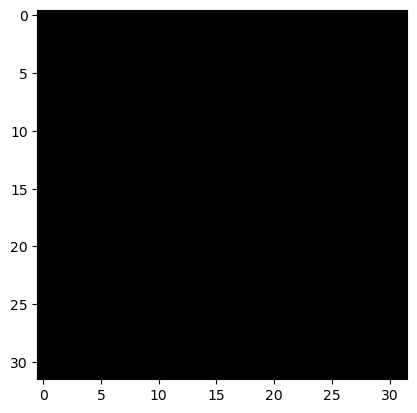

True Label: 8


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 8


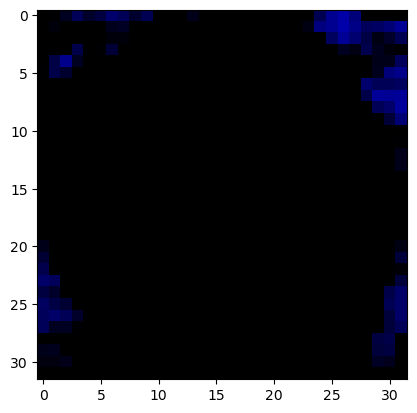

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 20
Predicted Label: 20


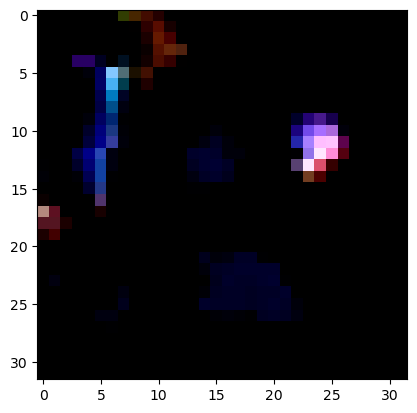

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


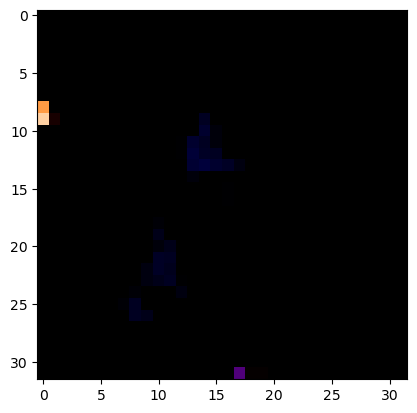

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


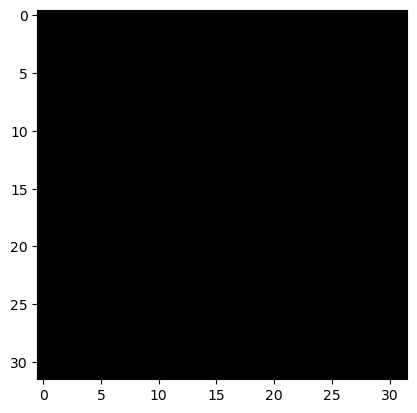

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


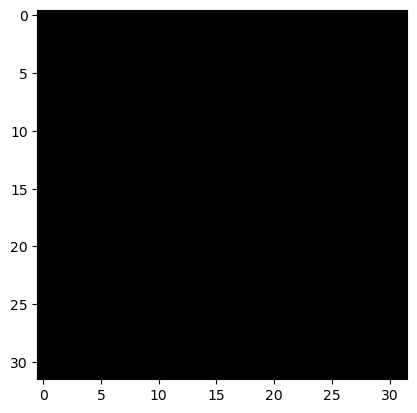

True Label: 1


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 1


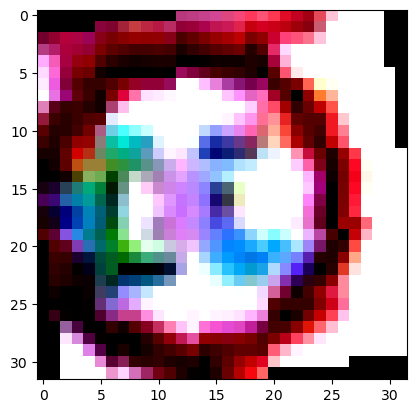

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 22
Predicted Label: 22


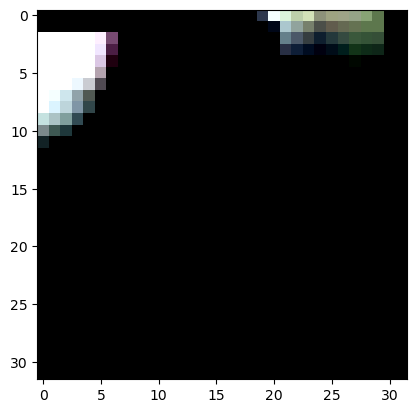

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 31
Predicted Label: 31


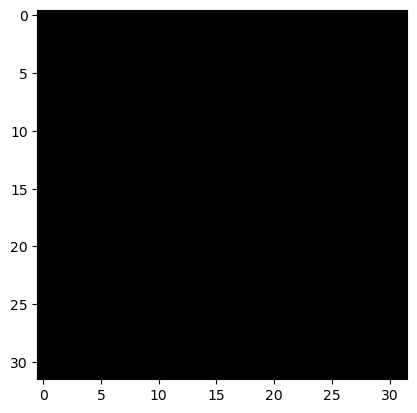

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


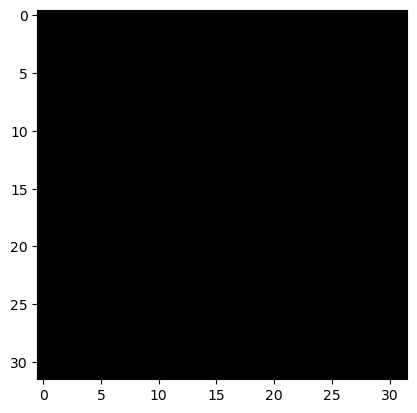

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


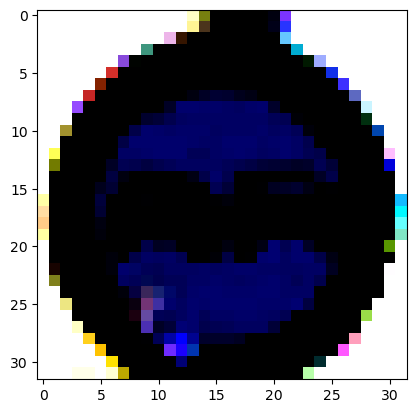

True Label: 4


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 4


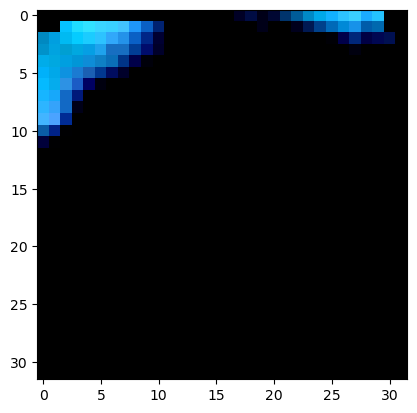

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


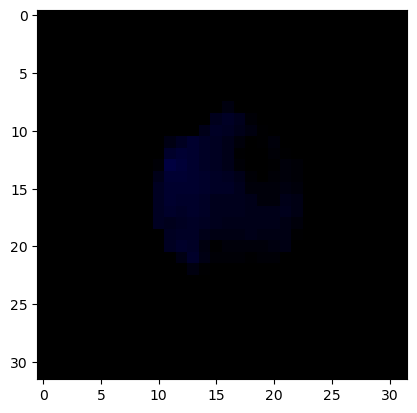

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


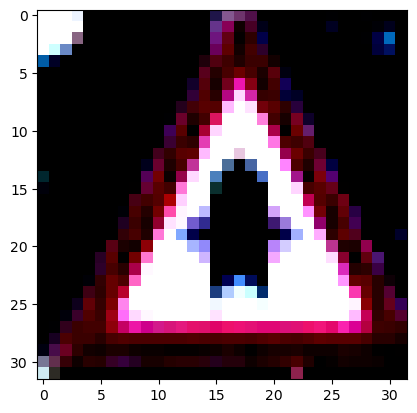

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


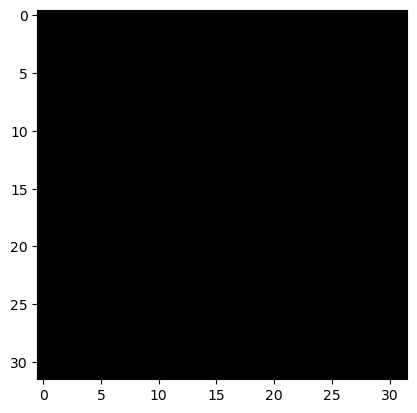

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


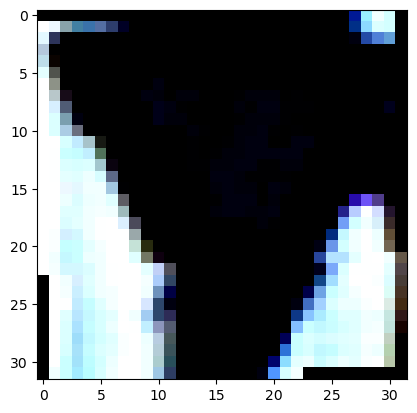

True Label: 25


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 25


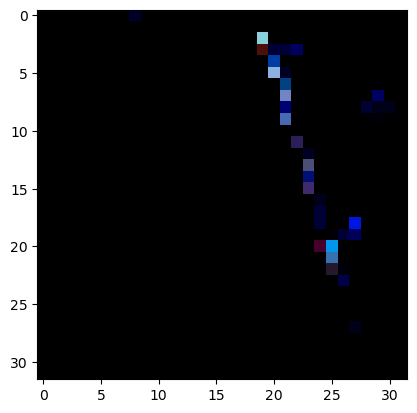

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


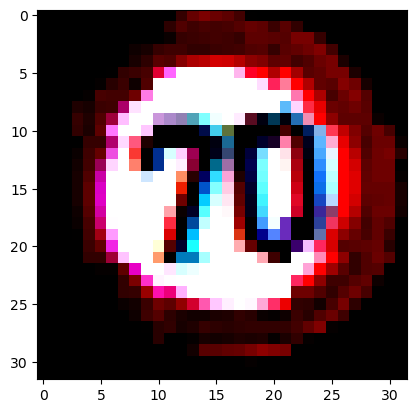

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


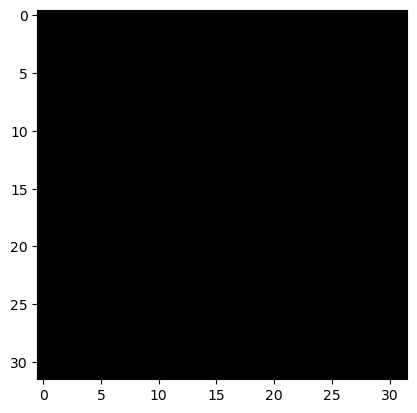

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


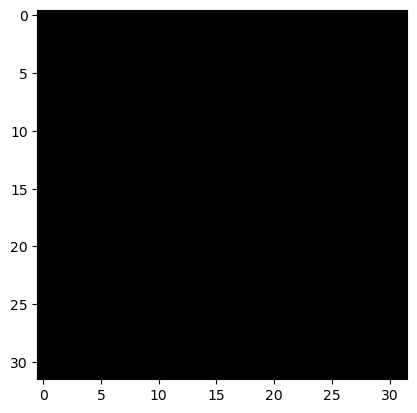

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


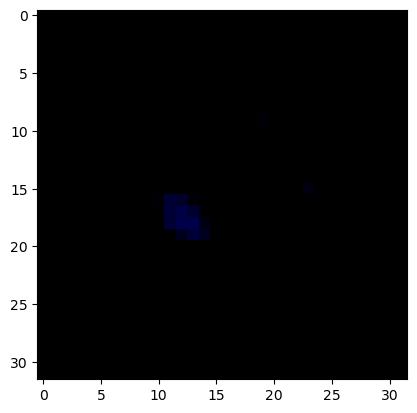

True Label: 17


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 17


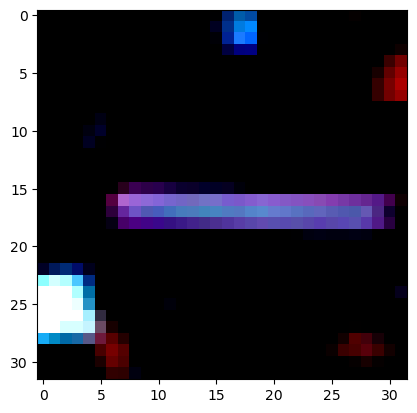

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


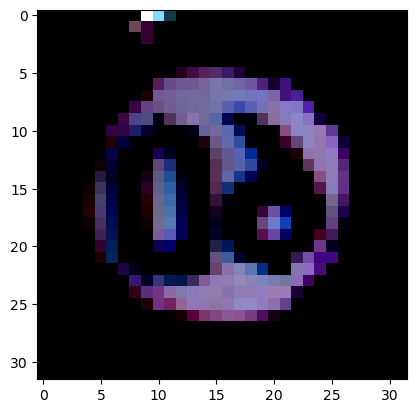

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


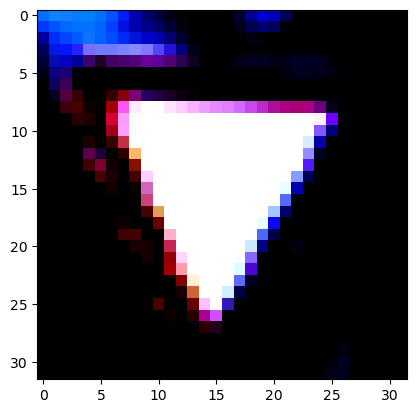

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 5


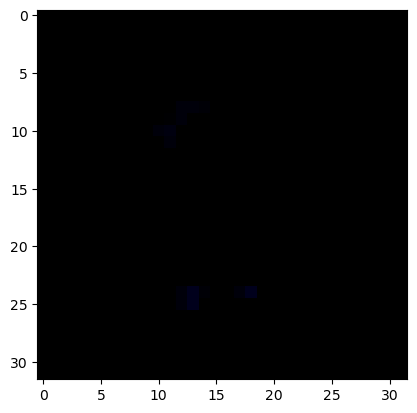

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


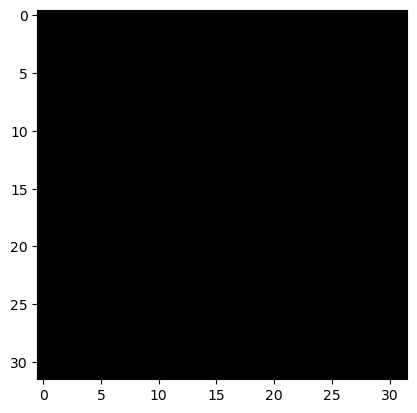

True Label: 2


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 2


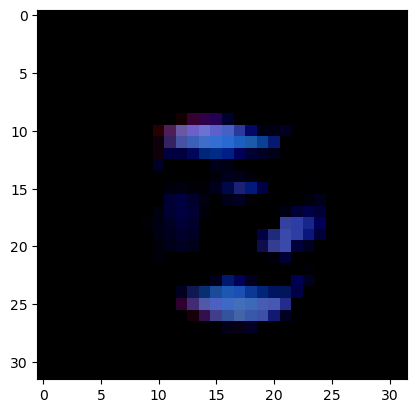

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


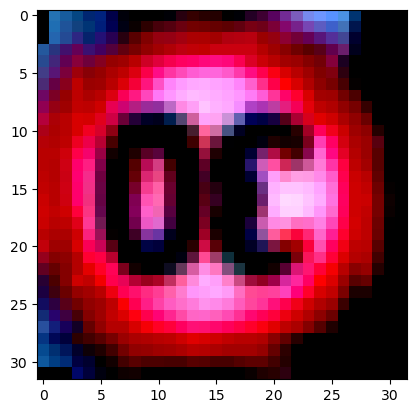

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


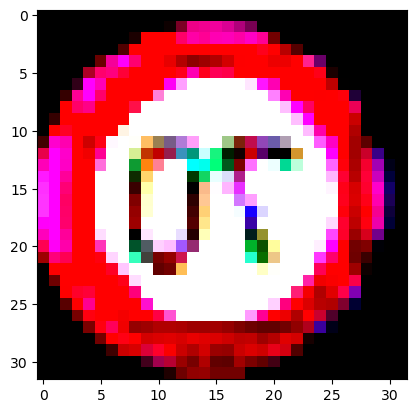

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


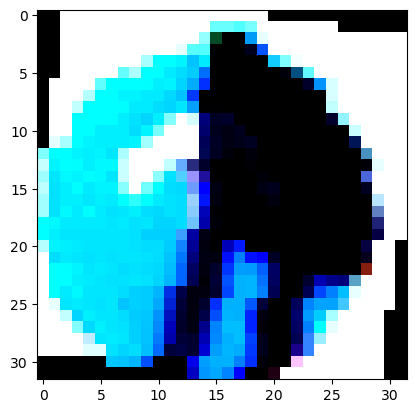

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


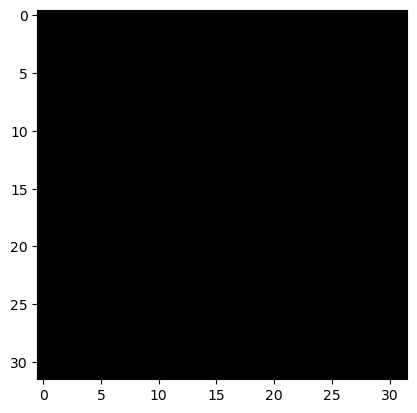

True Label: 25


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 25


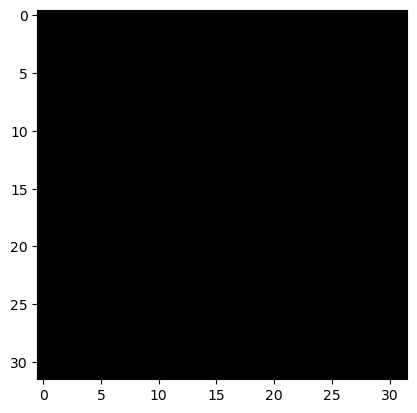

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


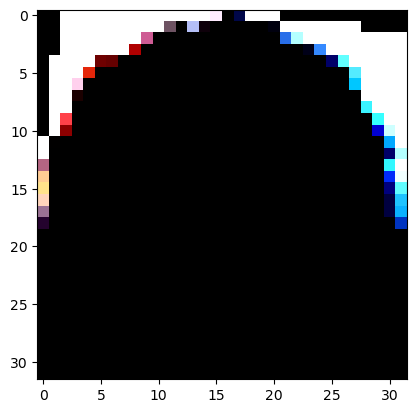

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


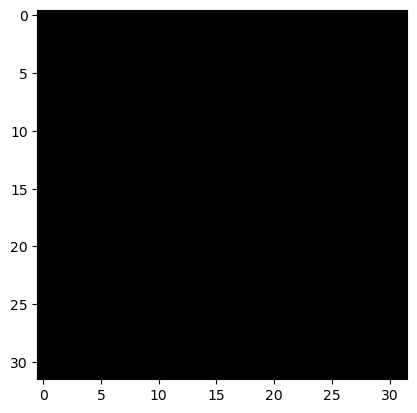

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


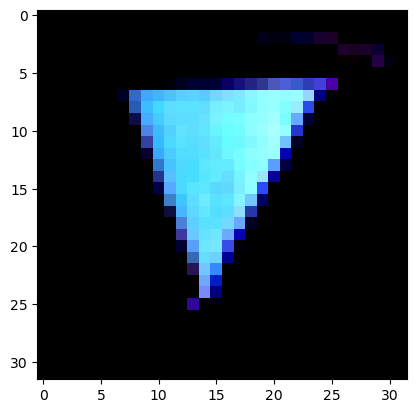

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 26
Predicted Label: 26


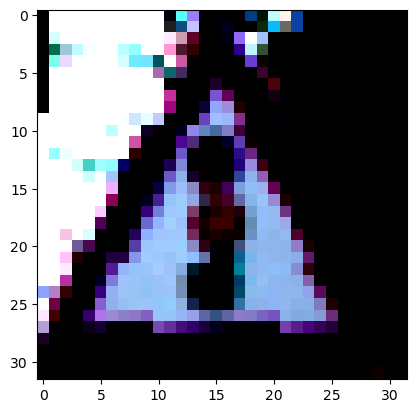

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


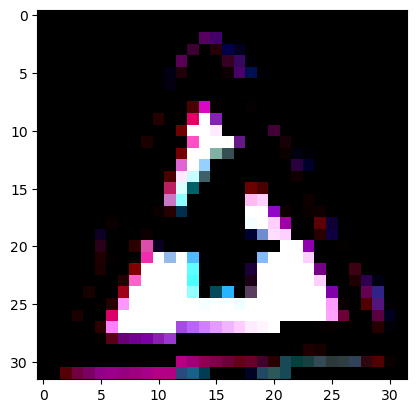

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


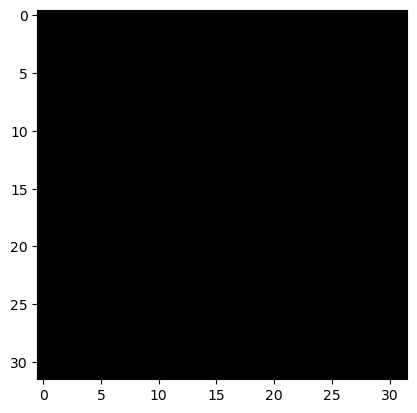

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


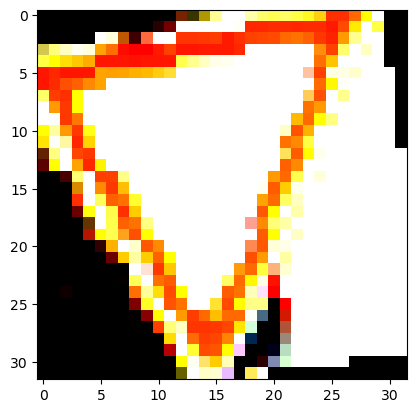

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


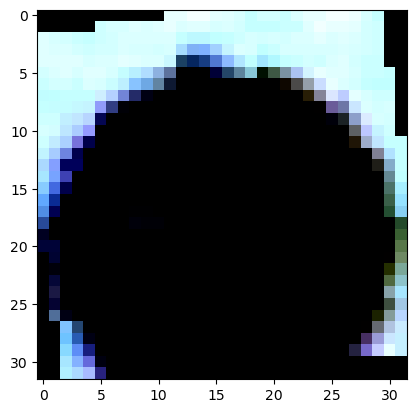

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


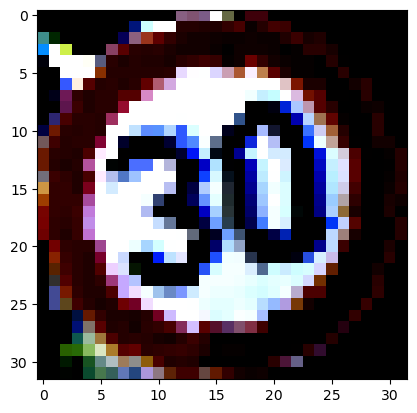

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


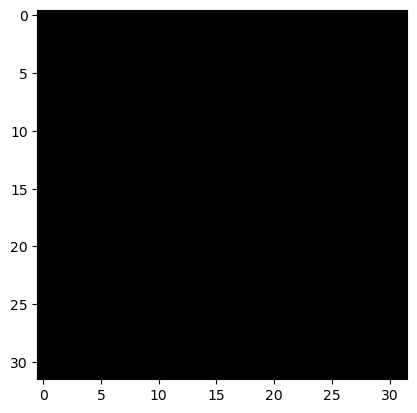

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


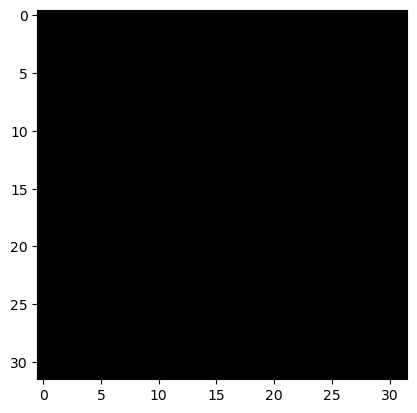

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 39
Predicted Label: 39


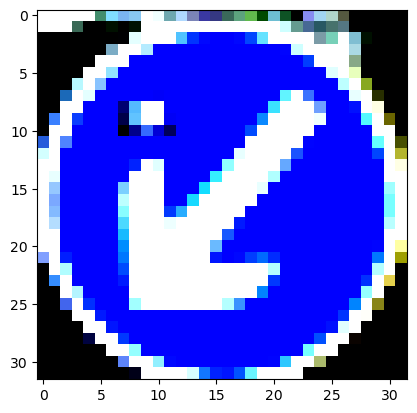

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


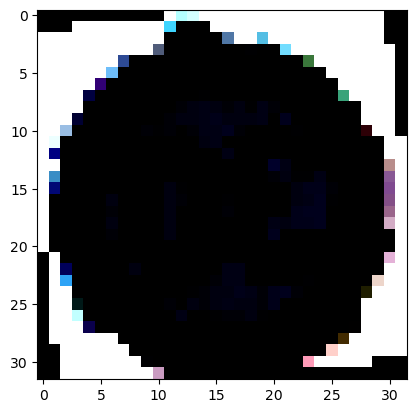

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


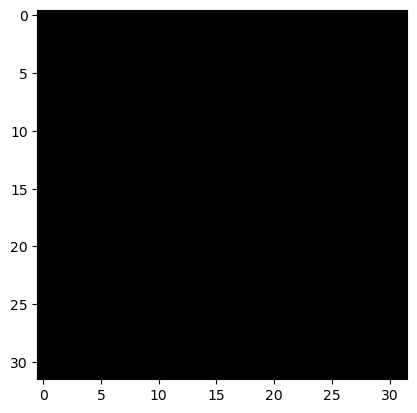

True Label: 26


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 26


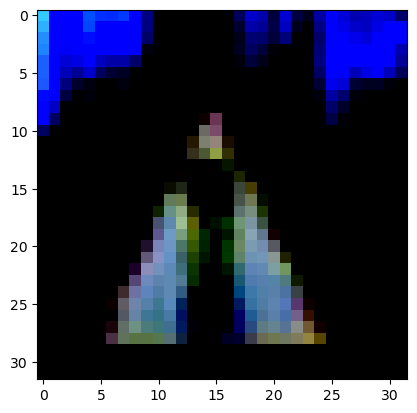

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


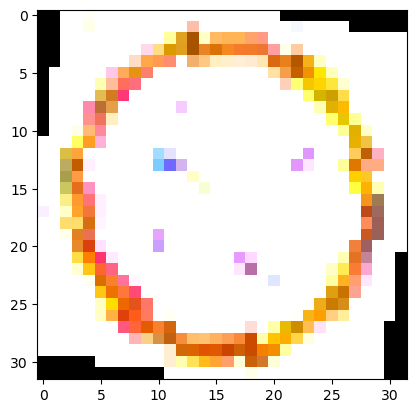

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


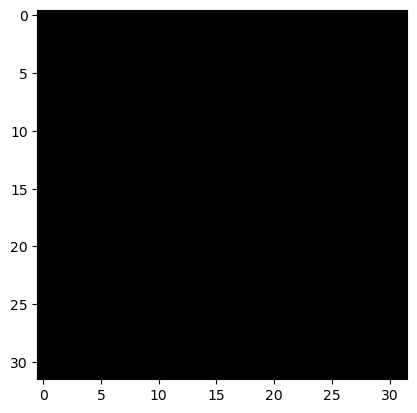

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 41
Predicted Label: 41


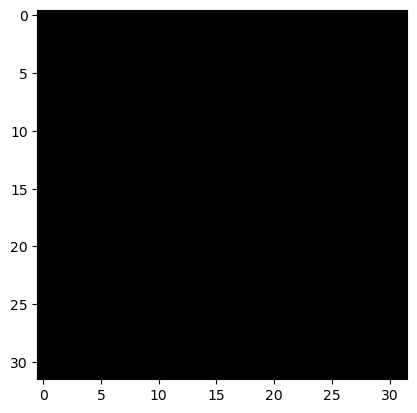

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


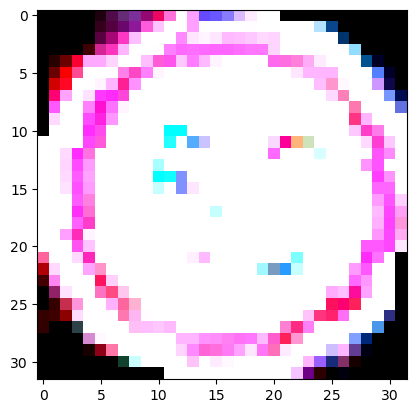

True Label: 41


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 41


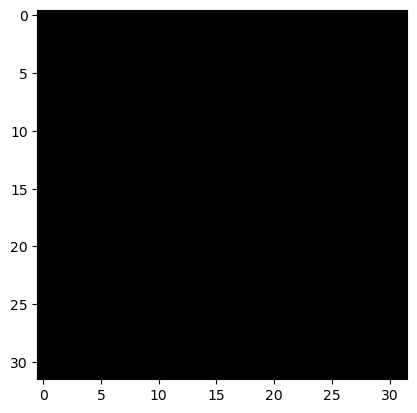

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


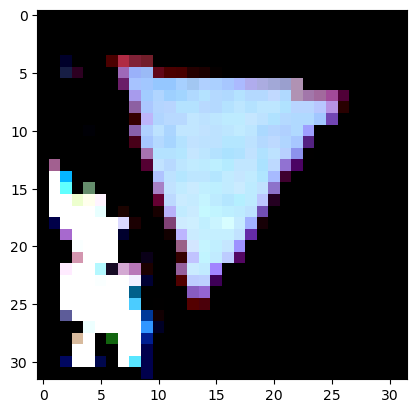

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


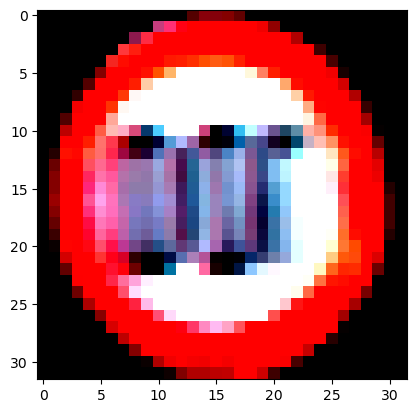

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 17


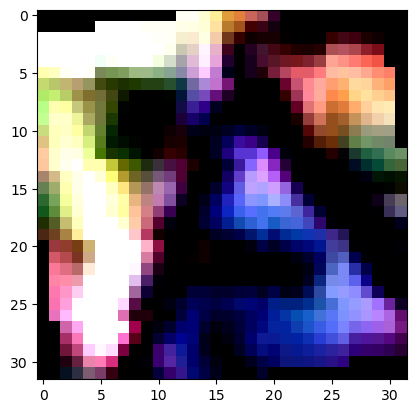

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


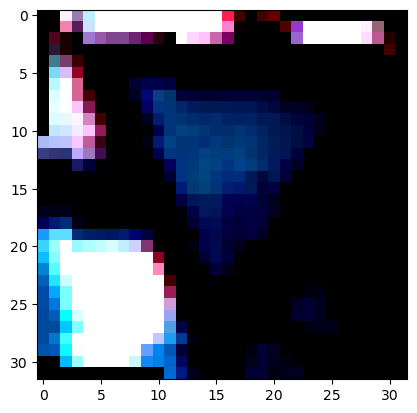

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


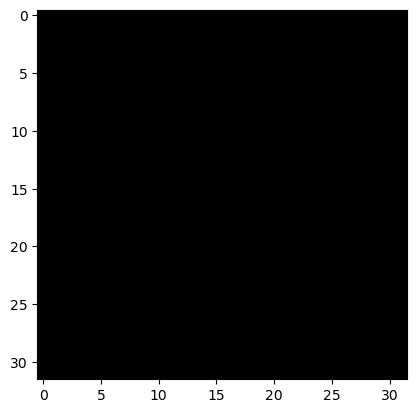

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


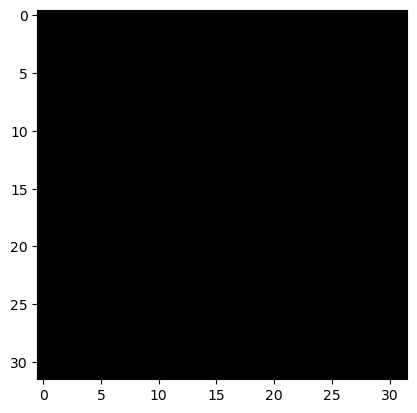

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


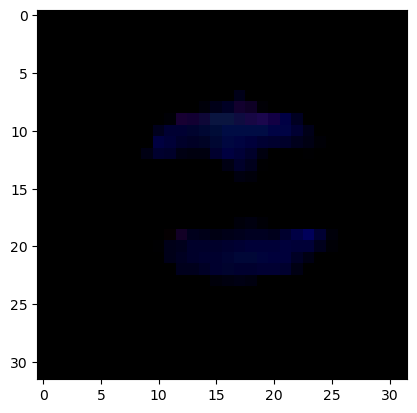

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


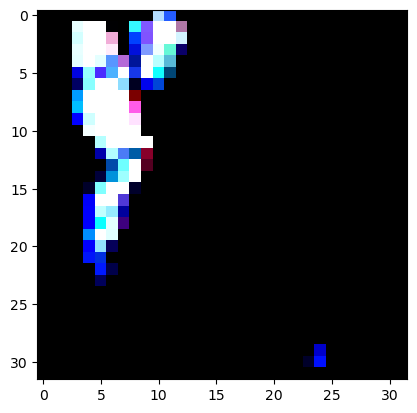

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


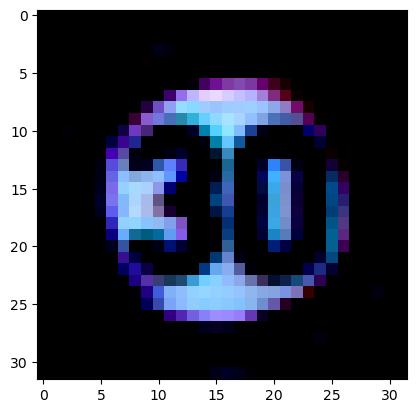

In [18]:
import matplotlib.pyplot as plt
import numpy as np

def imshow(img):
    img = img.numpy().transpose((1, 2, 0))  # Convert from Tensor image
    plt.imshow(img)
    plt.show()

model1.eval()  # Set the model to evaluation mode

with torch.no_grad():
    for data in test_loader:
        images, labels = data['image'].to(device), data['label'].to(device)
        outputs = model1(images)
        _, predicted = torch.max(outputs, 1)

        # Display images and labels
        for i in range(len(images)):
            print("True Label:", labels[i].item())
            print("Predicted Label:", predicted[i].item())
            imshow(torchvision.utils.make_grid(images[i]).cpu())
            if i == 4:  # Display first 5 images from the batch
                break

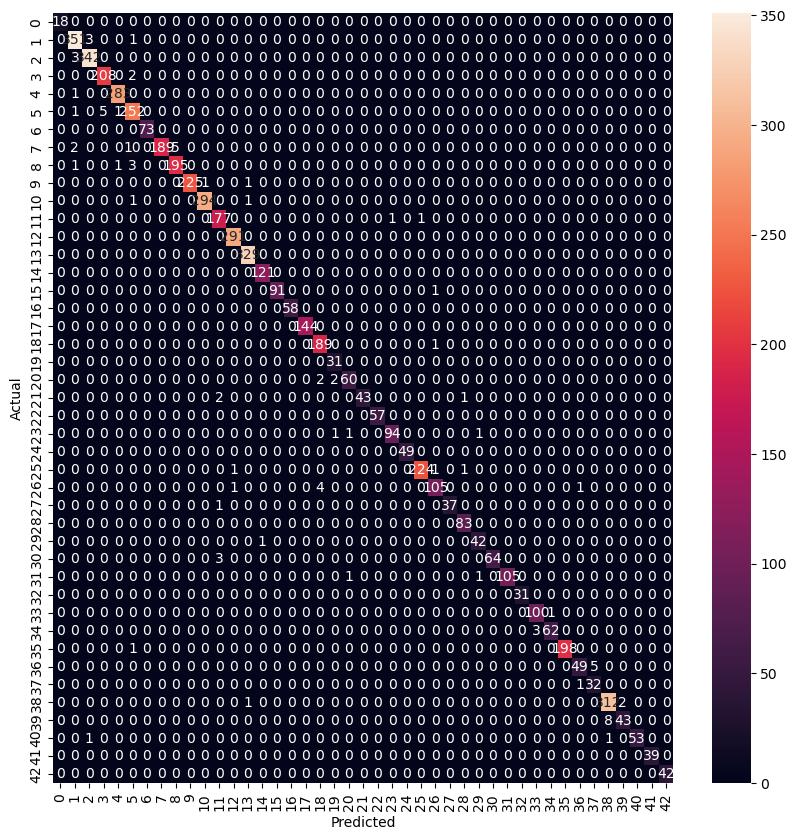

              precision    recall  f1-score   support

           0       1.00      1.00      1.00        18
           1       0.98      0.99      0.98       355
           2       0.99      0.99      0.99       345
           3       0.98      0.99      0.98       210
           4       0.99      1.00      0.99       284
           5       0.93      0.97      0.95       259
           6       1.00      1.00      1.00        73
           7       1.00      0.92      0.96       206
           8       0.97      0.97      0.97       200
           9       1.00      0.99      1.00       227
          10       1.00      0.99      0.99       296
          11       0.97      0.99      0.98       179
          12       0.99      1.00      1.00       291
          13       0.99      1.00      1.00       329
          14       0.99      1.00      1.00       121
          15       1.00      0.99      0.99        92
          16       1.00      1.00      1.00        58
          17       1.00    

In [19]:
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns

model1.eval()  # Set the model to evaluation mode
y_pred1 = []
y_true1 = []

with torch.no_grad():
    for data in test_loader:
        images, labels = data['image'].to(device), data['label'].to(device)
        outputs = model1(images)
        _, predicted = torch.max(outputs, 1)
        y_pred1.extend(predicted.tolist())
        y_true1.extend(labels.tolist())

# Generate the confusion matrix
cm1 = confusion_matrix(y_true1, y_pred1)

# Plot the confusion matrix
plt.figure(figsize=(10,10))
sns.heatmap(cm1, annot=True, fmt="d")
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.show()

print(classification_report(y_true1, y_pred1))

In [20]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

accuracy = accuracy_score(y_true1, y_pred1)
precision = precision_score(y_true1, y_pred1, average='weighted')
recall = recall_score(y_true1, y_pred1, average='weighted')
f1 = f1_score(y_true1, y_pred1, average='weighted')

print(f"Accuracy: {accuracy:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1-Score: {f1:.4f}")

accuracy_values.append(float(accuracy * 100))
precision_values.append(float(precision * 100))
recall_values.append(float(recall * 100))
f1score_values.append(float(f1 * 100))

Accuracy: 0.9835
Precision: 0.9838
Recall: 0.9835
F1-Score: 0.9835


In [21]:
model1.eval()
import time

num_runs = 10
total_time = 0

with torch.no_grad():
    for _ in range(num_runs):
        batch_time = 0
        for data in test_loader:
            images, labels = data['image'].to(device), data['label'].to(device)
            start_time = time.time()  # Start time for the batch
            outputs = model1(images)
            end_time = time.time()  # End time for the batch
            batch_time += (end_time - start_time)
        total_time += batch_time

average_inference_time = total_time / (num_runs * len(test_loader))
print(f"Average inference time per batch over {num_runs} runs: {average_inference_time} seconds")

Average_inference_time.append(average_inference_time)


Average inference time per batch over 10 runs: 0.014416063609330551 seconds


•	Efficient Parameter Usage: DenseNet's concatenation strategy makes it more parameter-efficient compared to other architectures like ResNet.

•	Feature Reuse: Features in early layers are directly used in later layers, leading to better information flow and reduced need for learning redundant feature maps.

•	Deep Supervision: The architecture naturally enables deep supervision as all layers receive additional supervision from the loss function through shorter connections.

•	Memory Intensive: The concatenation of feature maps can lead to high memory usage, especially for deeper models.


### EfficientNet

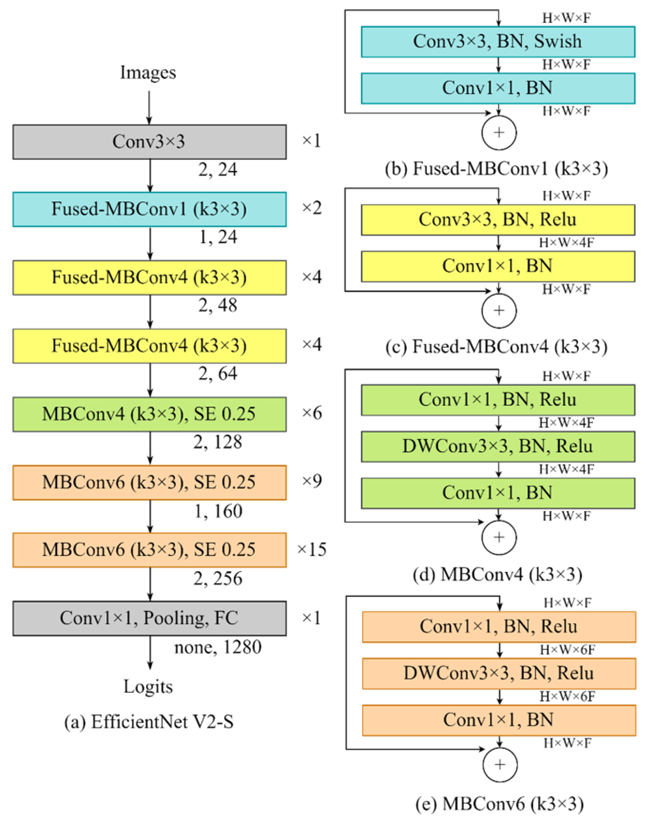

EfficientNet V2-S is a variant of the EfficientNet V2 family developed by google, they are a group of convolutional neural networks known for their high efficiency and accuracy in image classification tasks. Which is suitable for the GTSRB task.

Epoch 1, Training loss: 2.0521642037760683, Training Accuracy: 38.63222327479414%, Validation Loss: 0.9039524087439412, Validation Accuracy: 70.29416765856146%
Epoch 2, Training loss: 0.9616270788482852, Training Accuracy: 68.811484369307%, Validation Loss: 0.7780356559416522, Validation Accuracy: 74.3070906308451%
Epoch 3, Training loss: 0.7573799852168921, Training Accuracy: 75.4281133862858%, Validation Loss: 0.8800738641749257, Validation Accuracy: 72.45366434279885%
Epoch 4, Training loss: 0.6160059325344913, Training Accuracy: 80.20476572178096%, Validation Loss: 0.32498711720108986, Validation Accuracy: 89.1345009352151%
Epoch 5, Training loss: 0.5225623881483411, Training Accuracy: 83.22524229395904%, Validation Loss: 0.43776794409622316, Validation Accuracy: 85.35963271552457%
Epoch 6, Training loss: 0.658161198898351, Training Accuracy: 78.96961305836916%, Validation Loss: 0.4352708538265332, Validation Accuracy: 86.29484781499745%
Epoch 7, Training loss: 0.7899980457859995, 

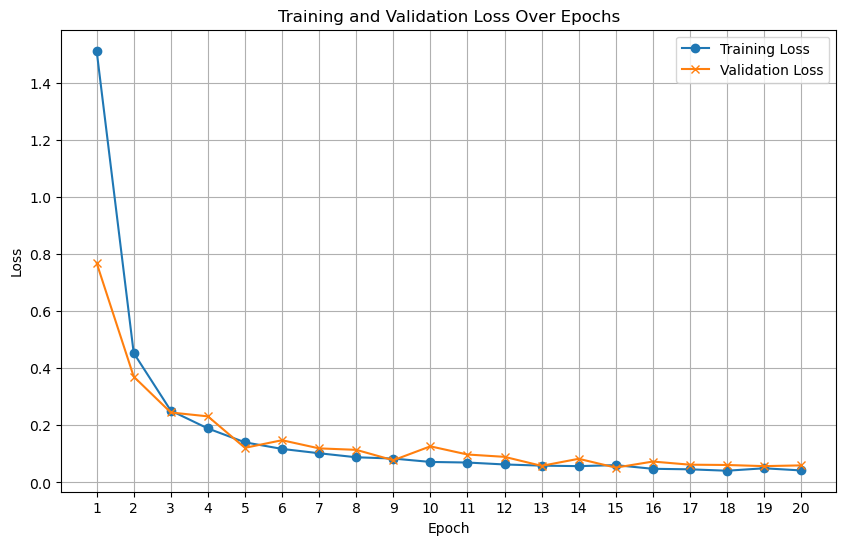

In [22]:
# This code is a comprehensive example of setting up, 
# training, and validating a neural network model using PyTorch, 
# specifically using an EfficientNet_v2_s architecture. 
import torch.optim as optim
import torchvision.models as models
import torch.nn as nn
from torch.optim import Adam,lr_scheduler

# 1. Model Initialization
model2 = models.efficientnet_v2_s(num_classes=43)  # Adjust num_classes based on your dataset

# 2. Custom Classifier
classifier = nn.Sequential(
    nn.Linear(1280, 512),  # You can choose the number of units in this layer
    nn.ReLU(),
    nn.Dropout(0.2),  # Optional dropout for regularization
    nn.Linear(512, 43)  # Adjust to match the number of classes in your dataset
)
model2.classifier = classifier

# 3. Model Preparation 'mps'
model2 = model2.to(device)

# 4. 5. Loss Function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model2.parameters(), lr=0.001)  # You can choose SGD or another optimizer

# 6. Learning Rate Scheduler
scheduler = lr_scheduler.StepLR(optimizer, step_size=7, gamma=0.1)

# Set the number of epochs
num_epochs = 20

# 7. Training Loop
for epoch in range(num_epochs):
    # Training Phase
    model2.train()  # Set the model to training mode
    running_loss = 0.0
    correct_train = 0
    total_train = 0

    for i, data in enumerate(train_loader, 0):
        # extracts the images and their corresponding labels from the data 
        # and loads them onto a device (like a CPU or GPU) for computation.
        # here is the Metal Performance Shaders (MPS) from APPLE
        inputs, labels = data['image'].to(device), data['label'].to(device)
        
        # clears old gradients from the last step otherwise they will accumulate.
        optimizer.zero_grad()
        # passes the input data through the efficientnetv2 (model2) to get the outputs.
        outputs = model2(inputs)
        # computes the loss between the model outputs and the true labels using a loss function.
        loss = criterion(outputs, labels)
        # computes the gradient of the loss with respect to the model parameters.
        loss.backward()
        # updates the model parameters based on the gradients.
        optimizer.step()

        running_loss += loss.item()

        # determines the predicted class labels by finding 
        # the index of the maximum value in the output logits.
        _, predicted = torch.max(outputs.data, 1)
        total_train += labels.size(0)
        correct_train += (predicted == labels).sum().item()

    train_accuracy = 100 * correct_train / total_train

    # Validation Phase, similar to above but doesn't need loss.backward()
    # Set the model to evaluation mode
    model2.eval()  
    val_loss = 0.0
    correct = 0
    total = 0
    with torch.no_grad():
        for data in val_loader:
            images, labels = data['image'].to(device), data['label'].to(device)
            outputs = model2(images)
            loss = criterion(outputs, labels)
            val_loss += loss.item()
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
    
    # Update the learning rate
    scheduler.step()

    print(f'Epoch {epoch+1}, Training loss: {running_loss/len(train_loader)}, Training Accuracy: {train_accuracy}%, Validation Loss: {val_loss/len(val_loader)}, Validation Accuracy: {100 * correct / total}%')

print('Finished Training')

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(epochs, training_loss, label='Training Loss', marker='o')
plt.plot(epochs, validation_loss, label='Validation Loss', marker='x')
plt.title('Training and Validation Loss Over Epochs')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.show()

In [23]:
model2.eval()  # Set the model to evaluation mode

correct = 0
total = 0
with torch.no_grad():  # No need to track gradients for testing
    for data in test_loader:
        images, labels = data['image'].to(device), data['label'].to(device)
        outputs = model2(images)
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

test_accuracy = 100 * correct / total
print(f'Accuracy of the model1 on the test images: {test_accuracy}%')

ModelAccuracies.append(test_accuracy)

Accuracy of the model1 on the test images: 94.28765725943556%


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


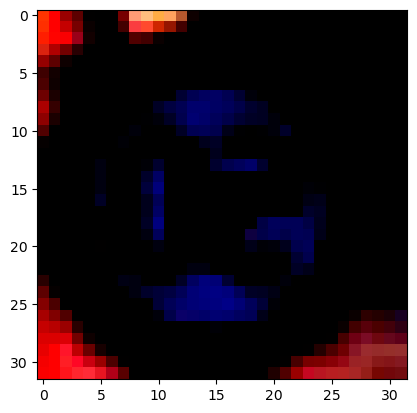

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


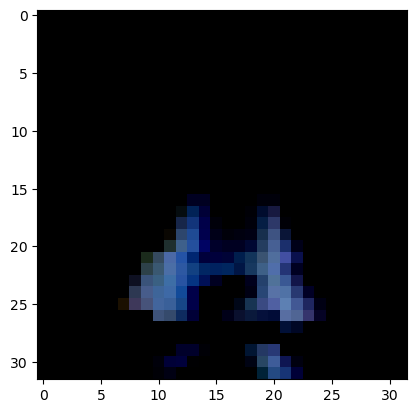

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 28
Predicted Label: 28


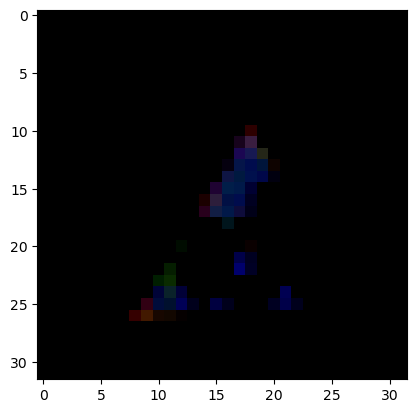

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 28
Predicted Label: 28


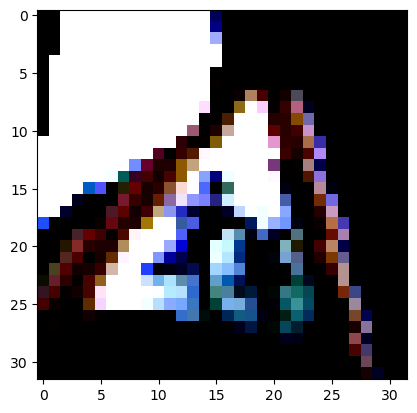

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


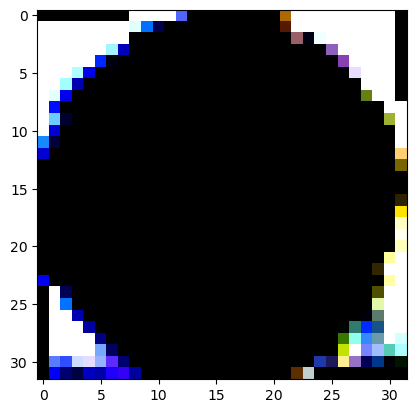

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


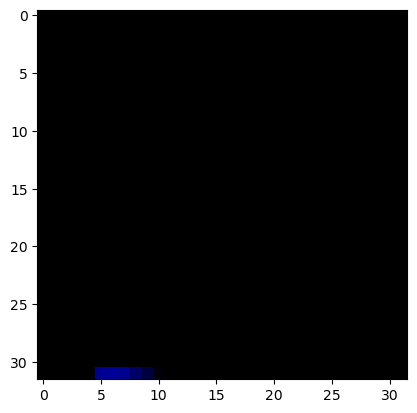

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 22
Predicted Label: 22


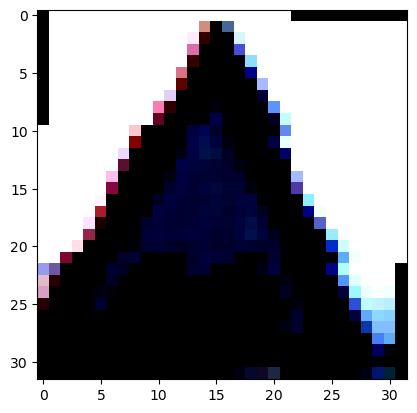

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


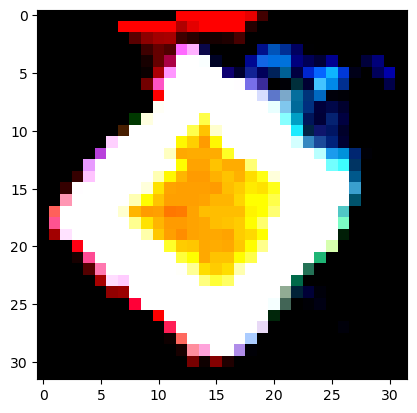

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


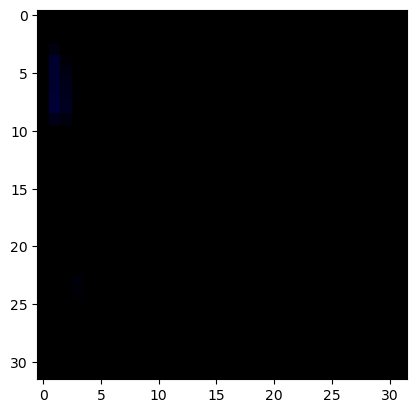

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


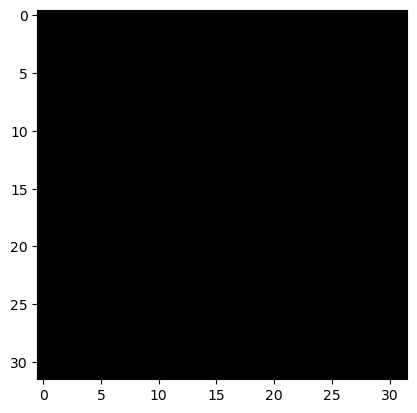

True Label: 36


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 36


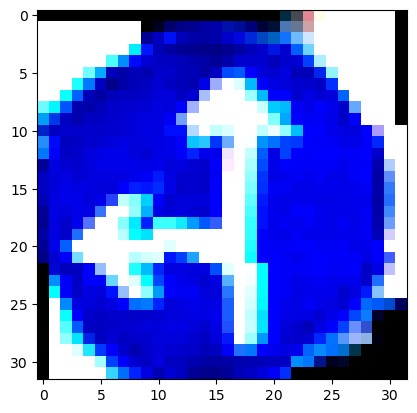

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


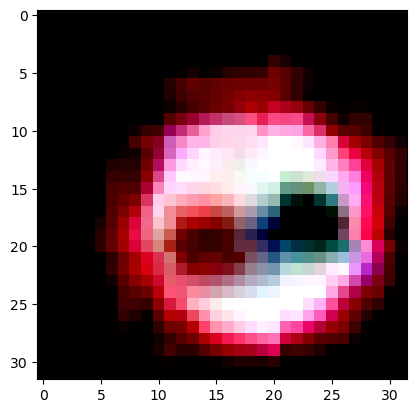

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


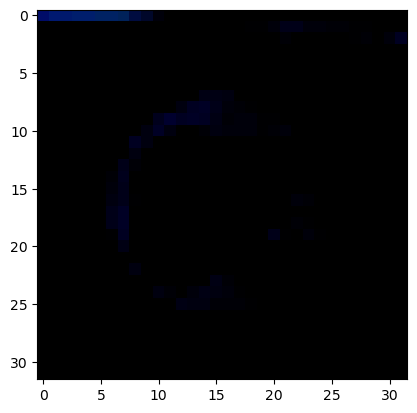

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


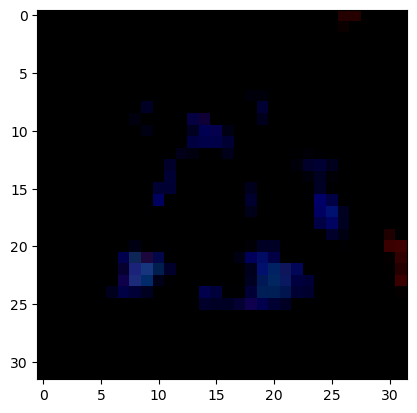

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 31
Predicted Label: 31


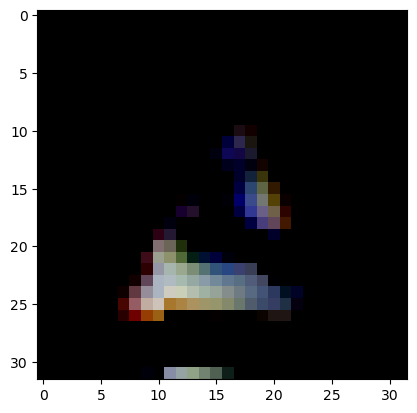

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


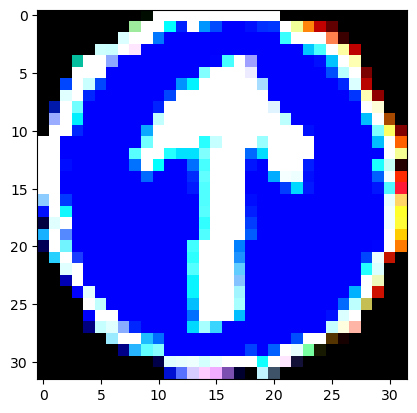

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 22
Predicted Label: 22


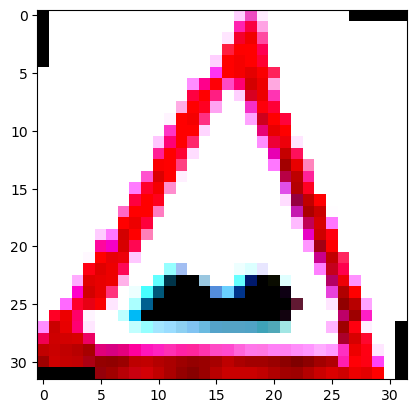

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


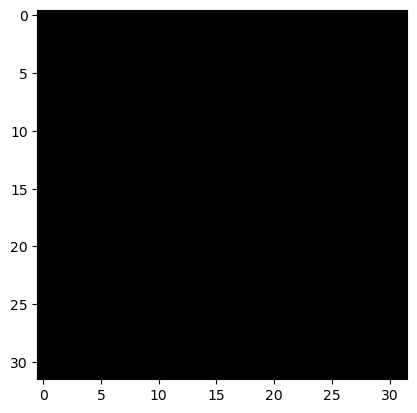

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


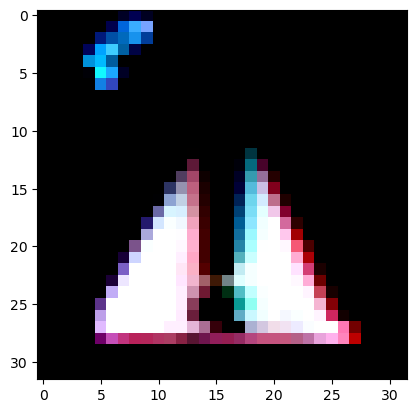

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


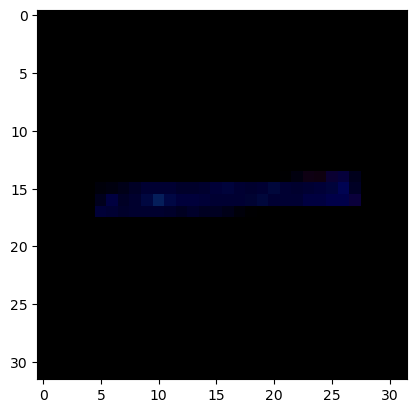

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


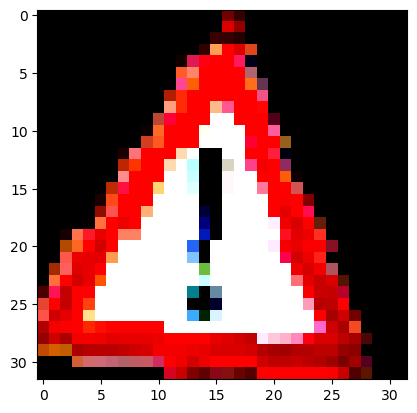

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


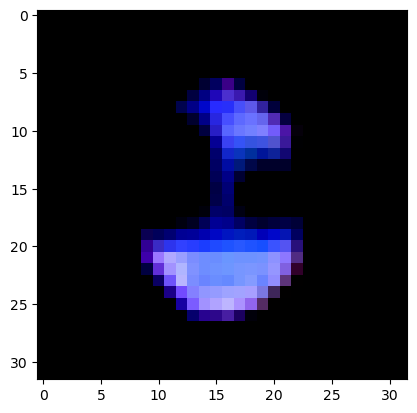

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


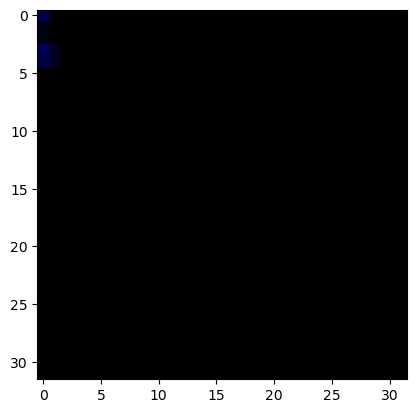

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


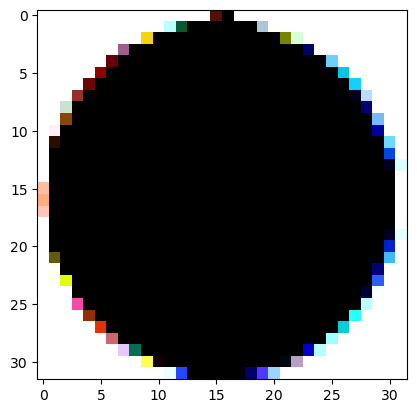

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


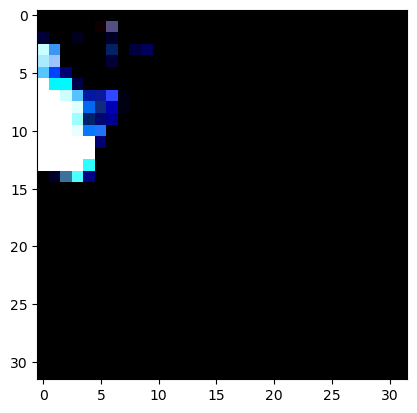

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


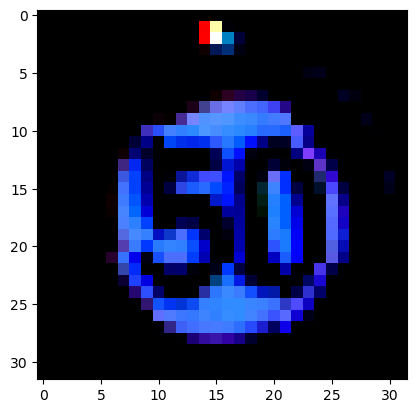

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


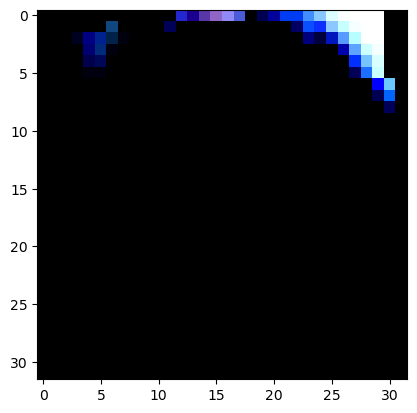

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 22
Predicted Label: 22


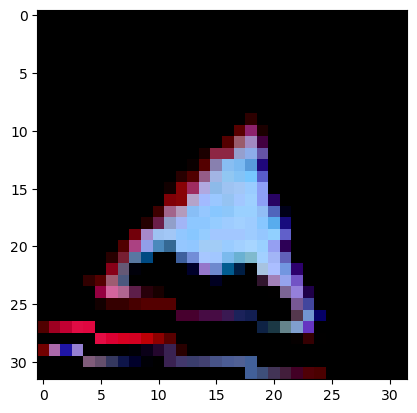

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


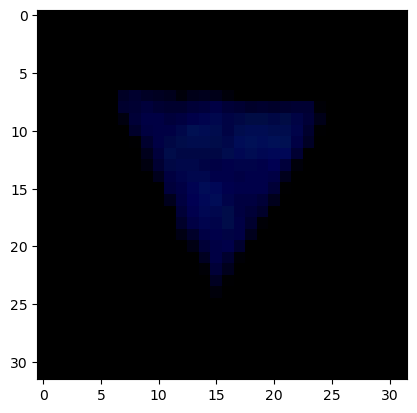

True Label: 38
Predicted Label: 38


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


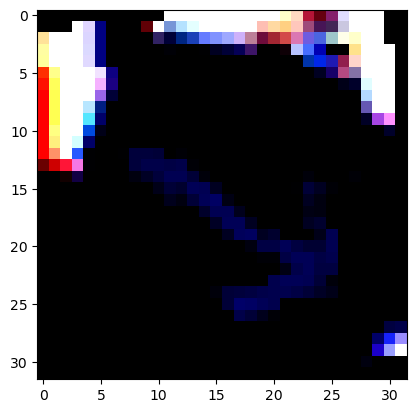

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


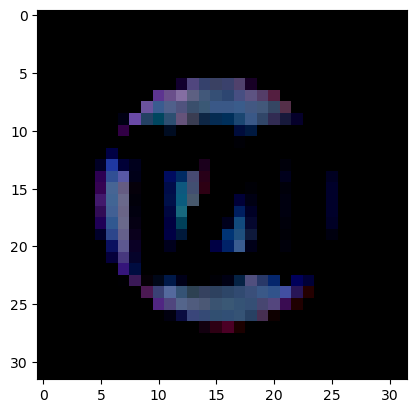

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


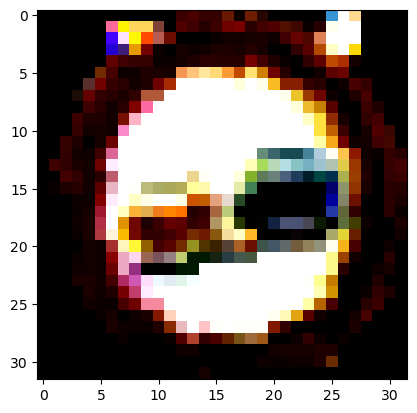

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


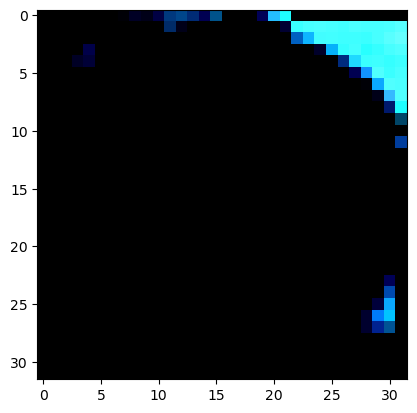

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


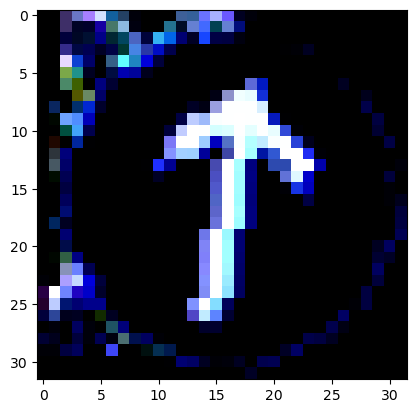

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


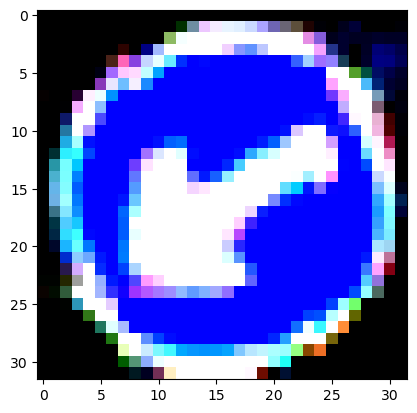

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


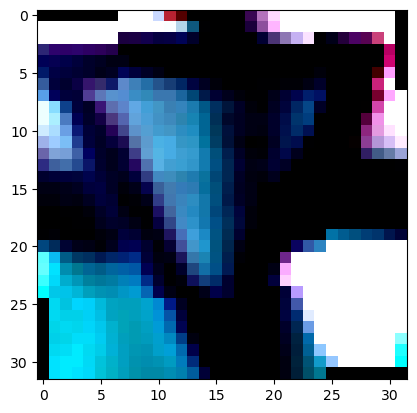

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


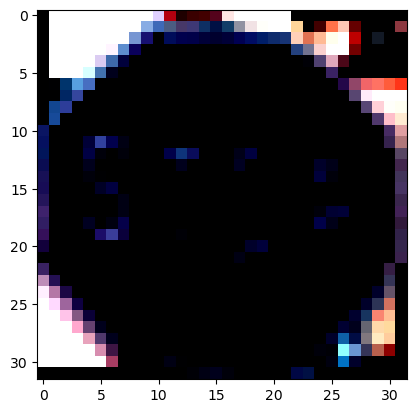

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 22
Predicted Label: 22


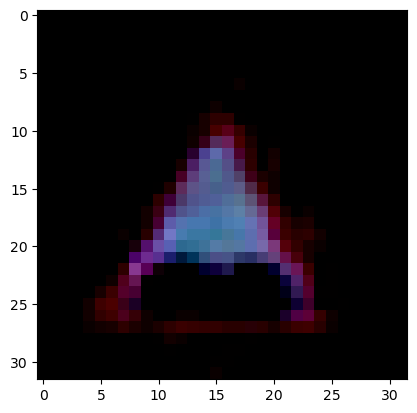

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


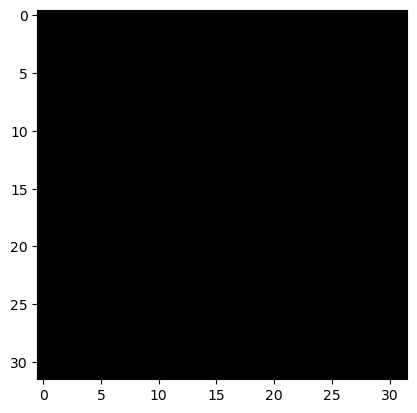

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


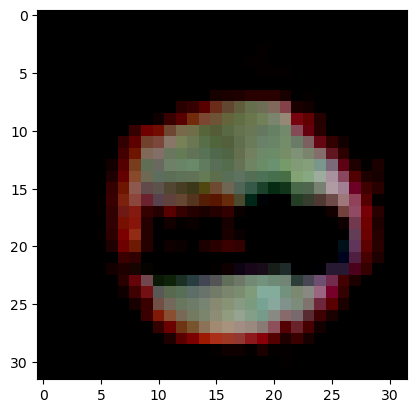

True Label: 35


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 35


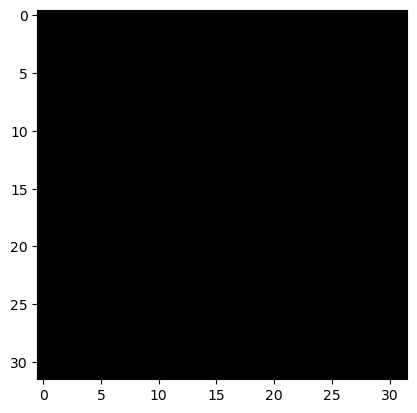

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


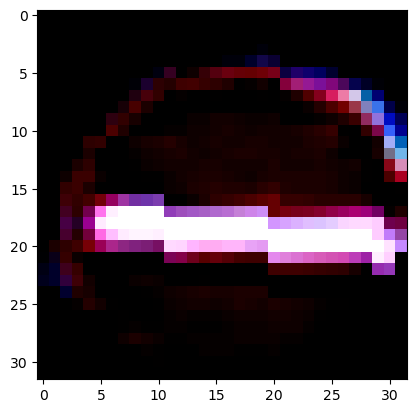

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


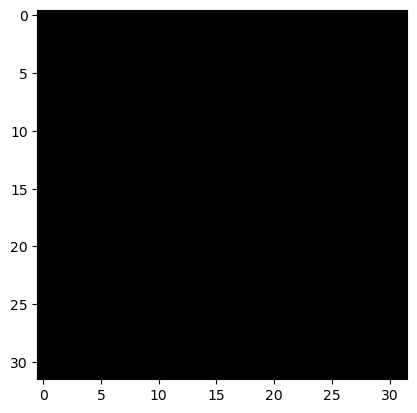

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


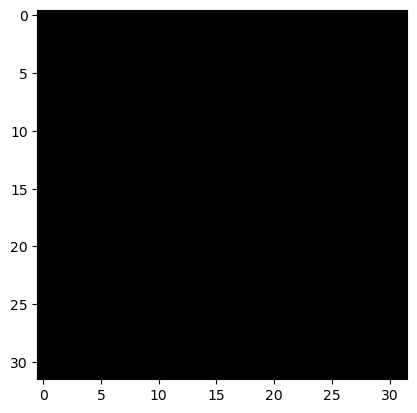

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 26
Predicted Label: 26


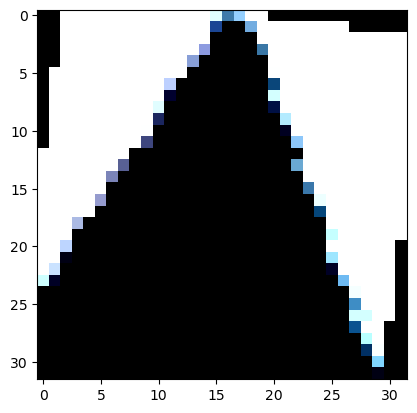

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


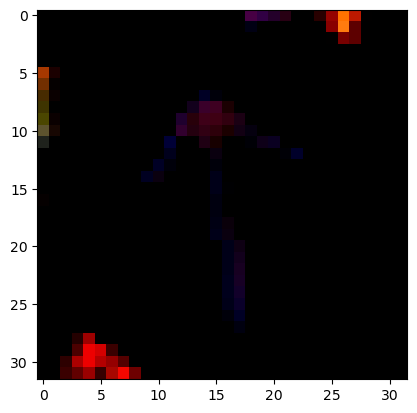

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


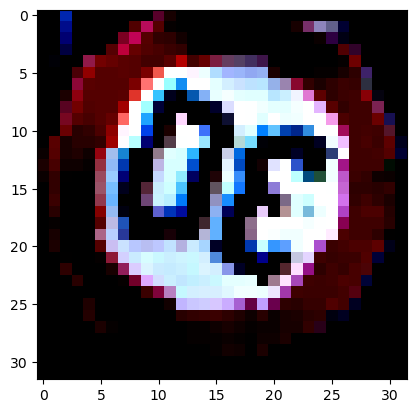

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


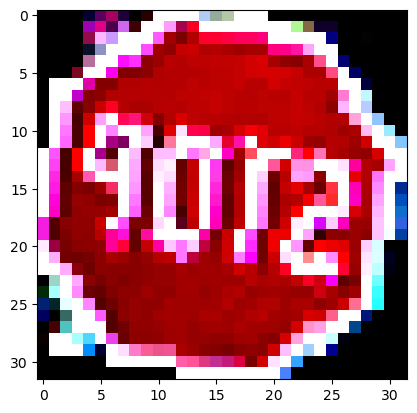

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


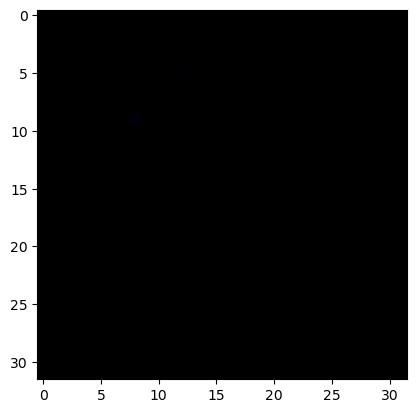

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


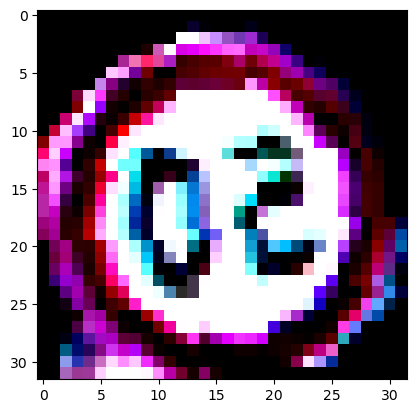

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


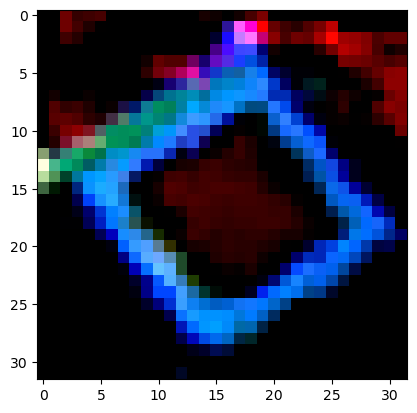

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 31
Predicted Label: 31


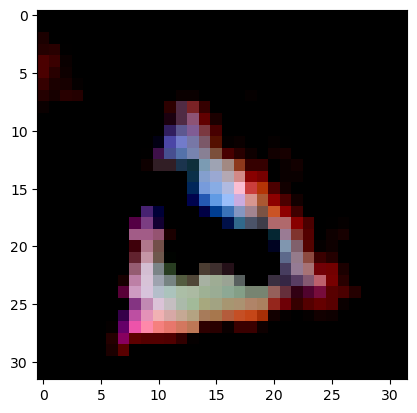

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


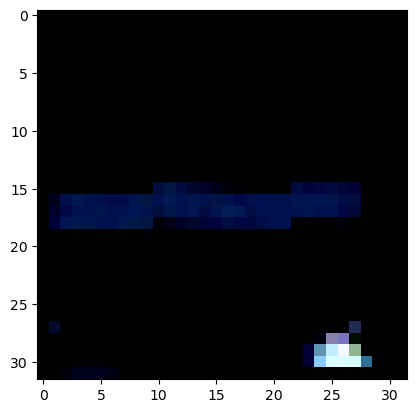

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


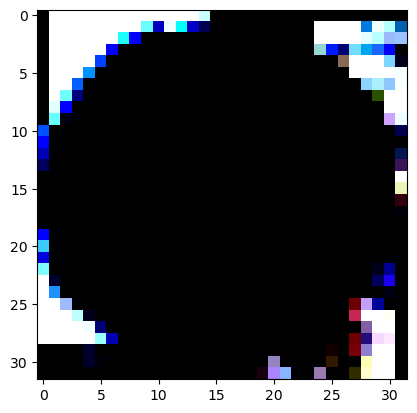

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 16
Predicted Label: 16


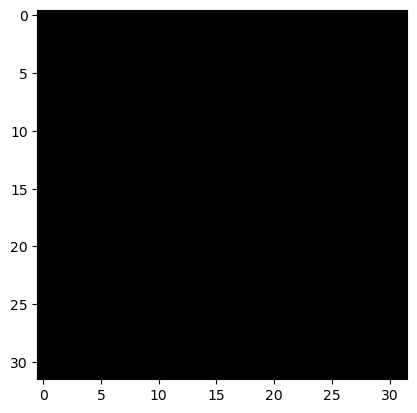

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


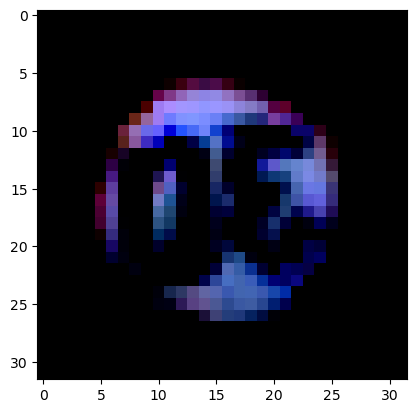

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


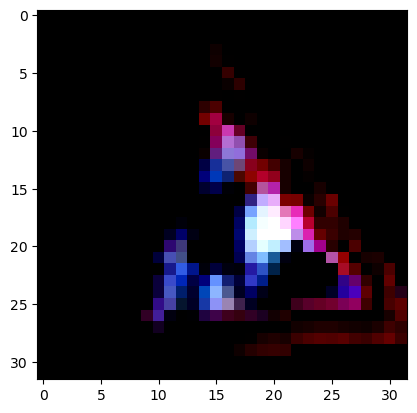

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


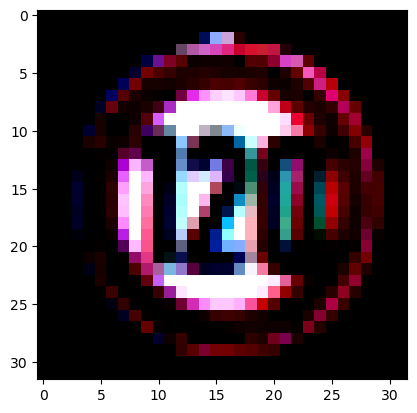

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


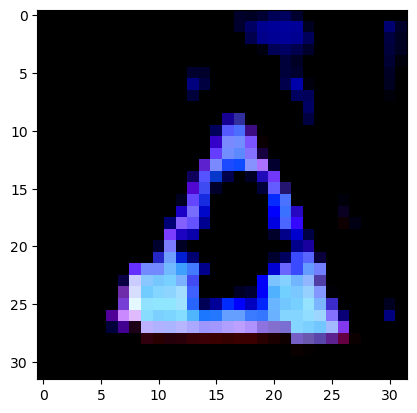

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


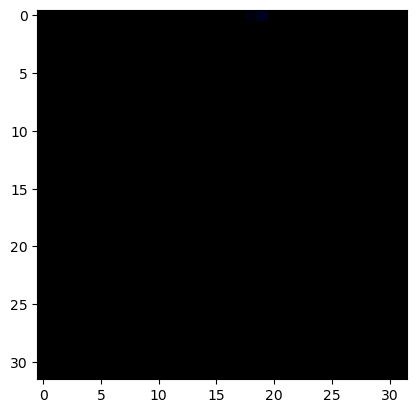

True Label: 13


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 13


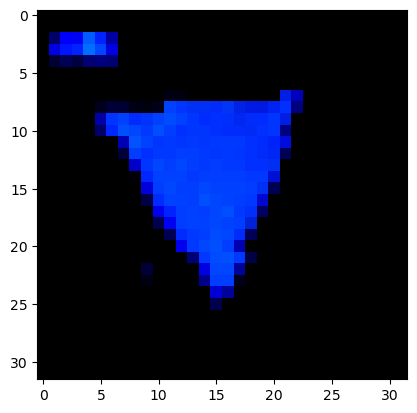

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 20
Predicted Label: 20


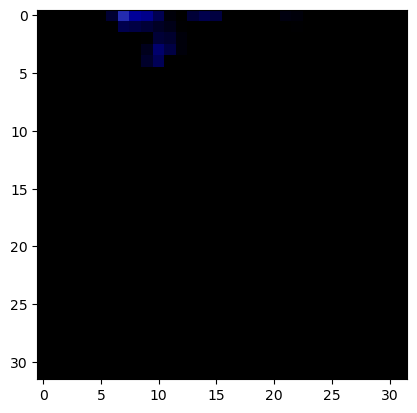

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


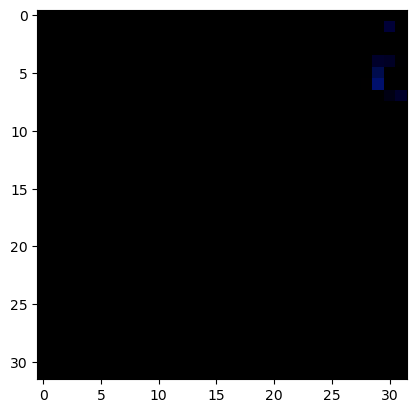

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


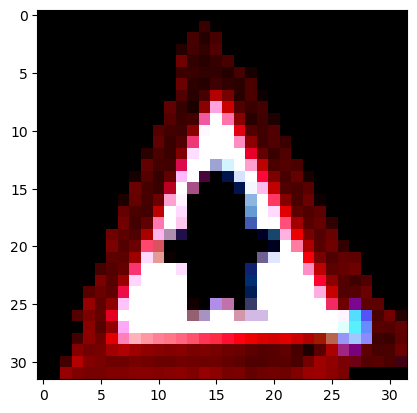

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


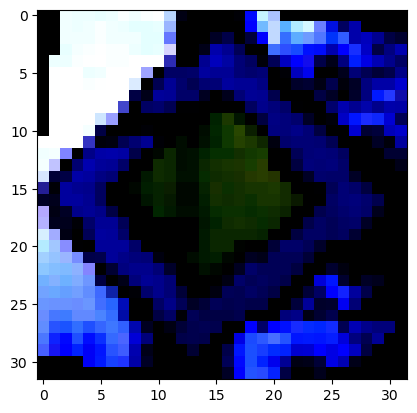

True Label: 3


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 3


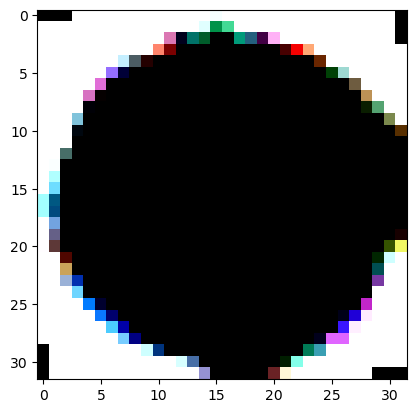

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 28
Predicted Label: 28


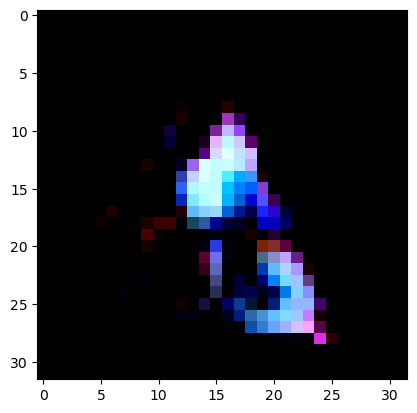

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 33
Predicted Label: 33


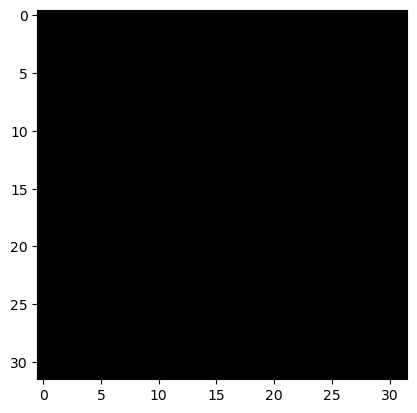

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


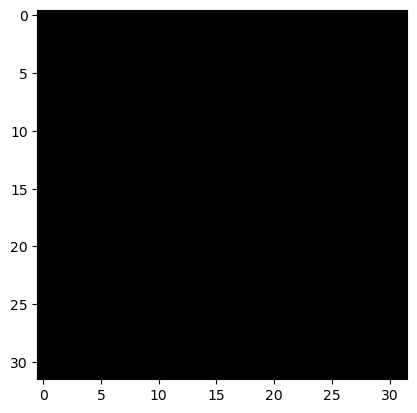

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


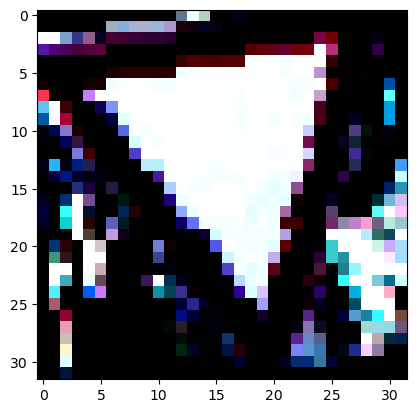

True Label: 2


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 2


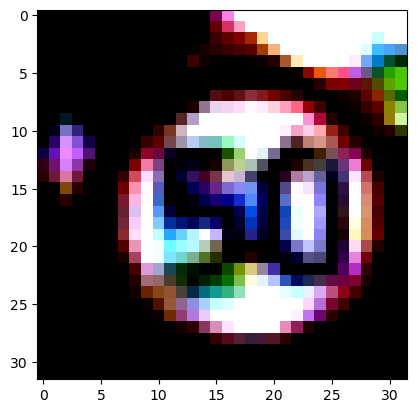

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


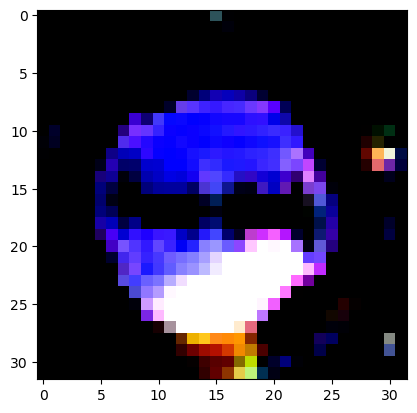

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 41
Predicted Label: 41


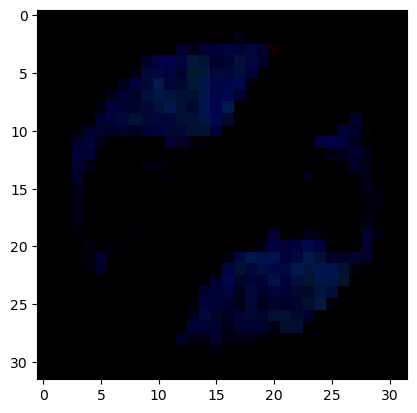

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 19
Predicted Label: 19


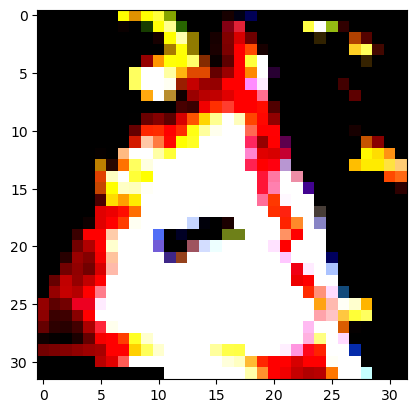

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


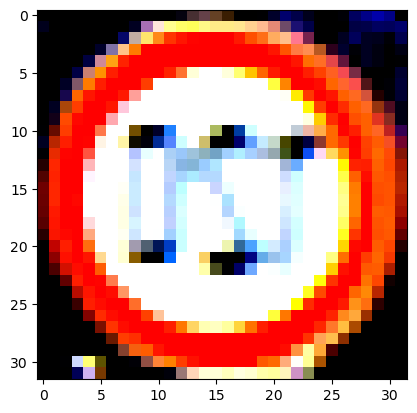

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


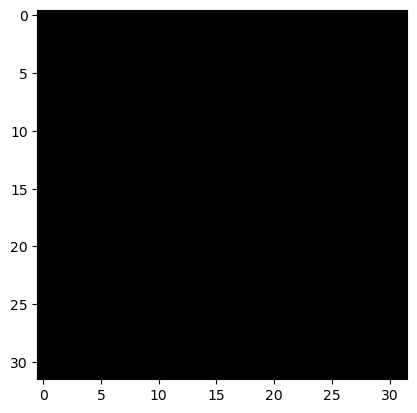

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


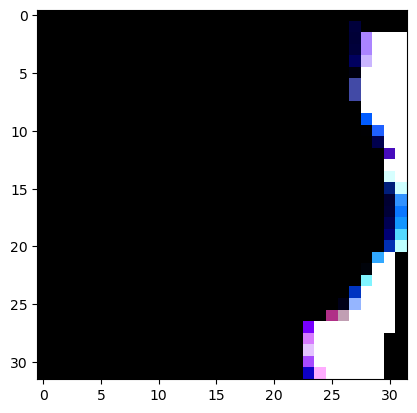

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 33
Predicted Label: 33


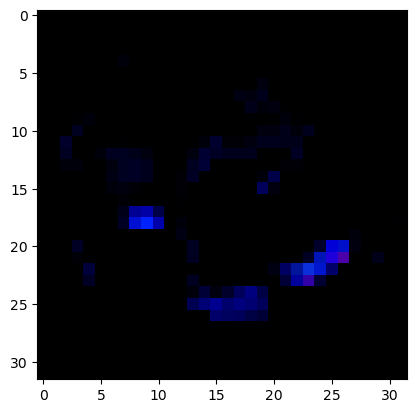

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


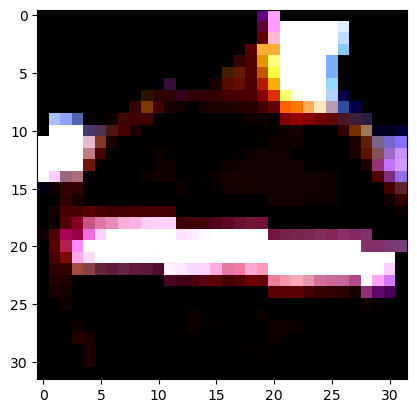

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 6
Predicted Label: 6


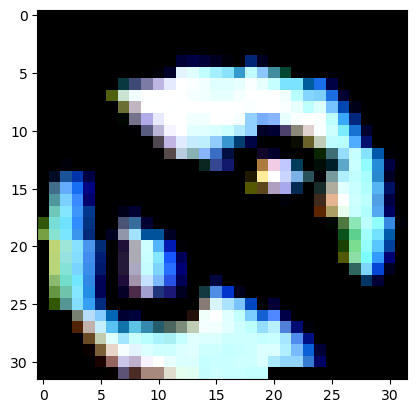

True Label: 38


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 38


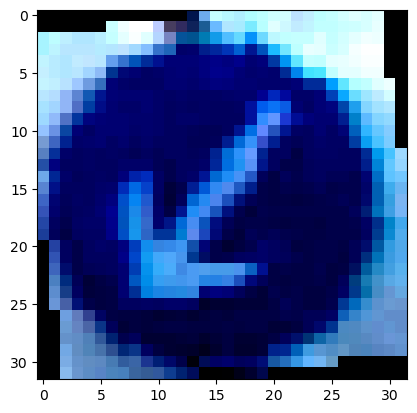

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


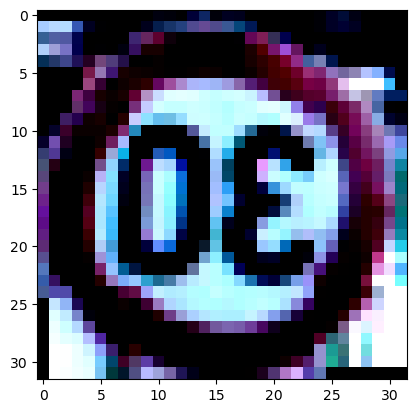

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


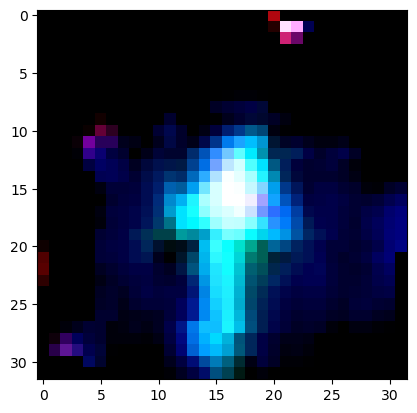

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


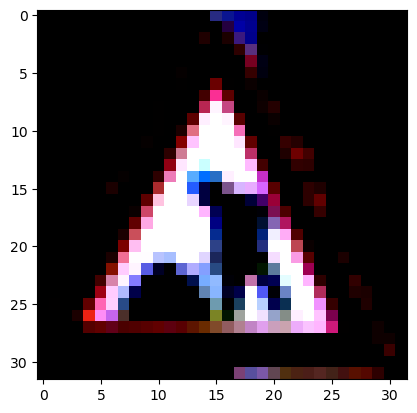

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


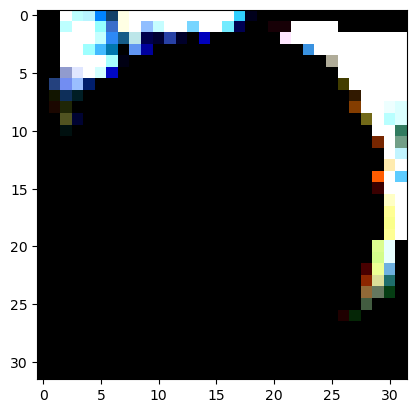

True Label: 30


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 30


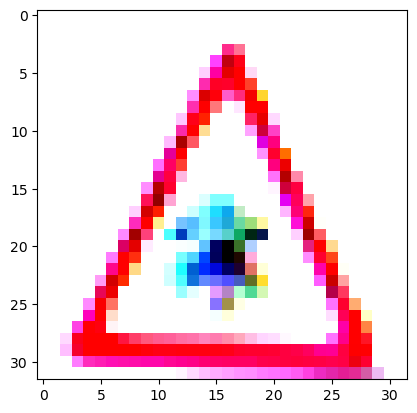

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


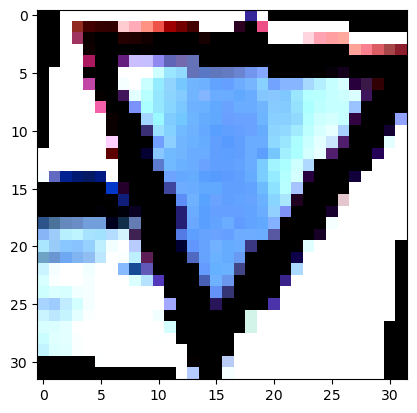

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 40
Predicted Label: 40


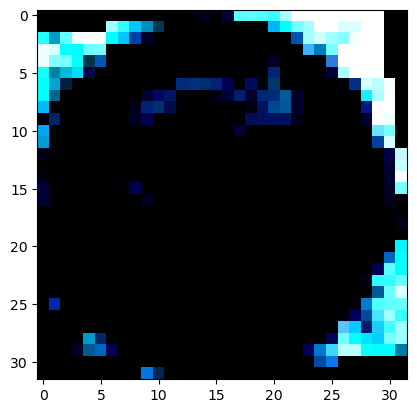

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


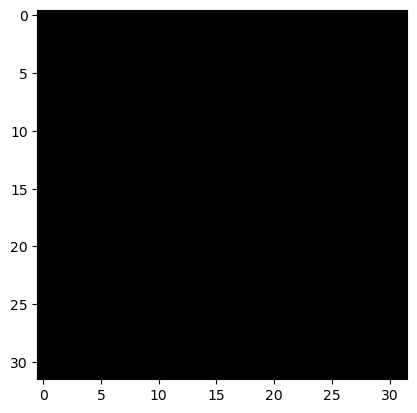

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


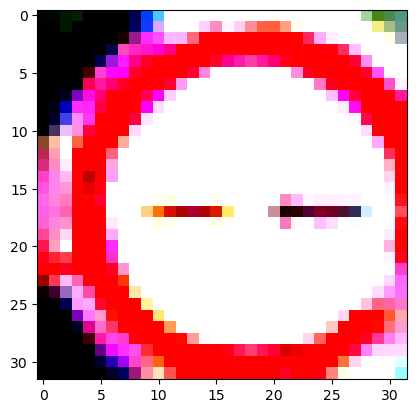

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


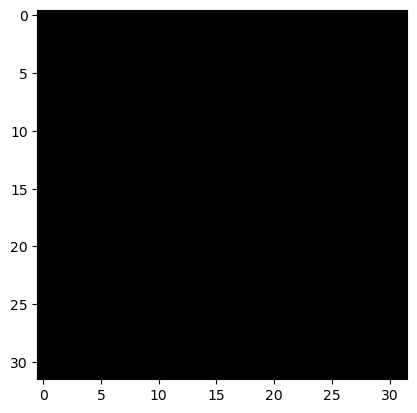

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


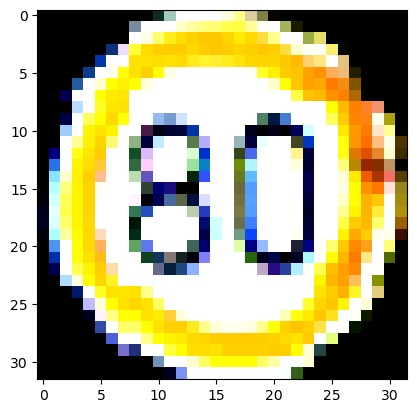

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


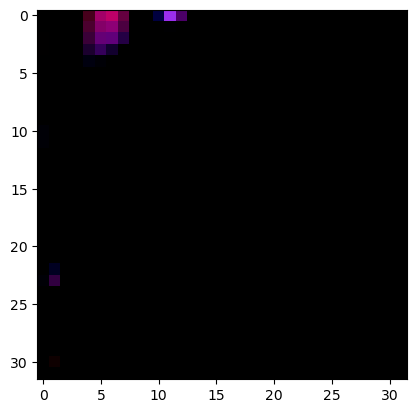

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


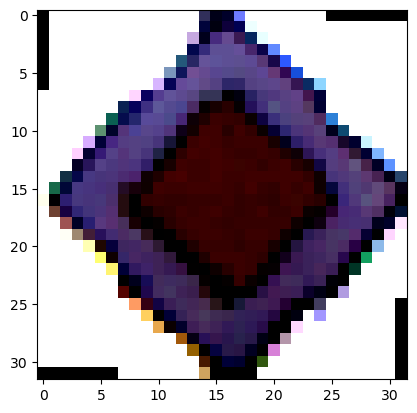

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


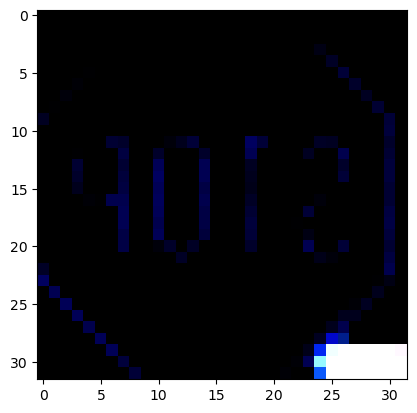

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


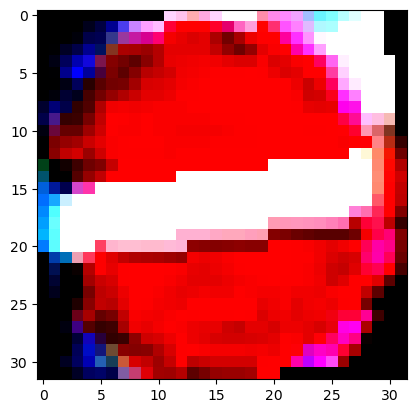

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


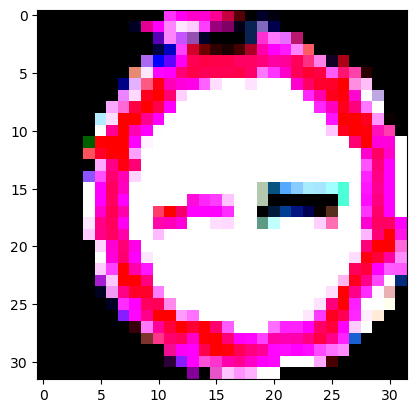

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


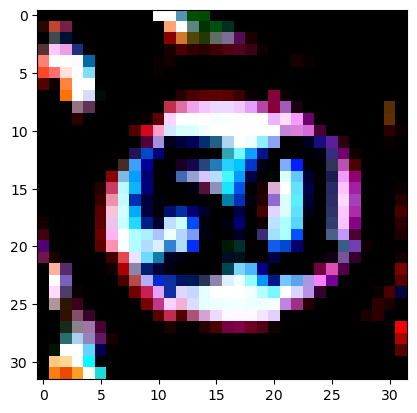

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


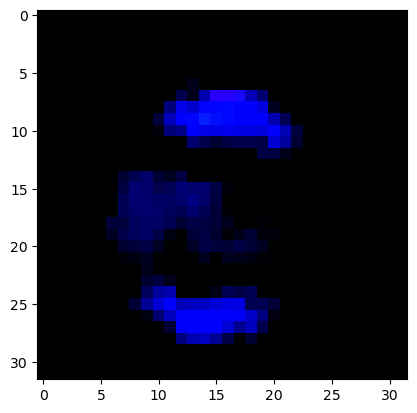

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


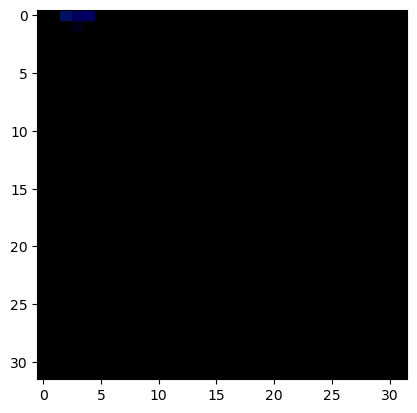

True Label: 22


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 22


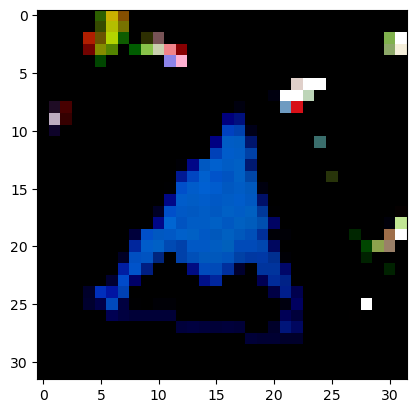

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


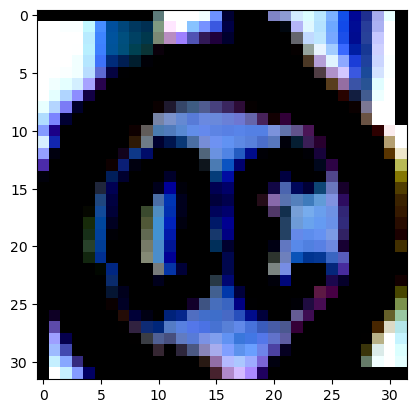

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 30
Predicted Label: 30


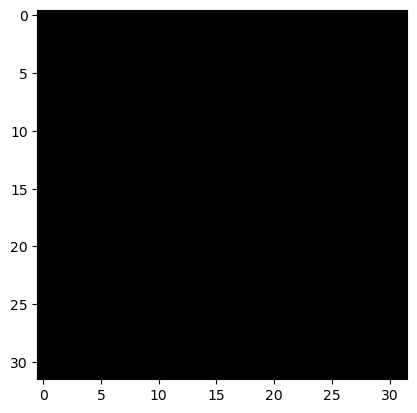

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


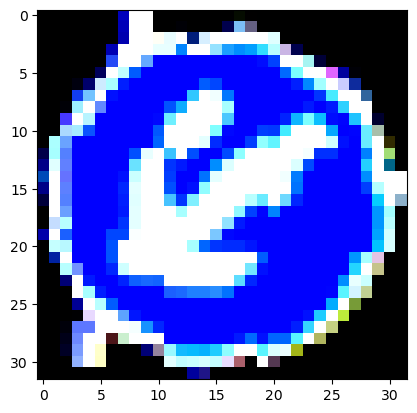

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


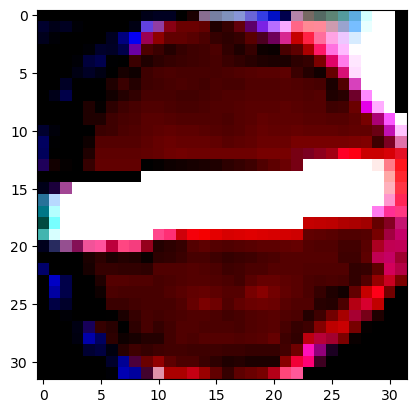

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


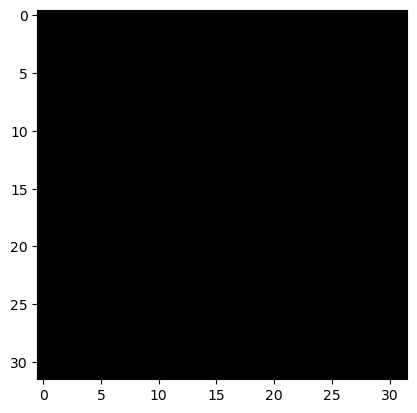

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


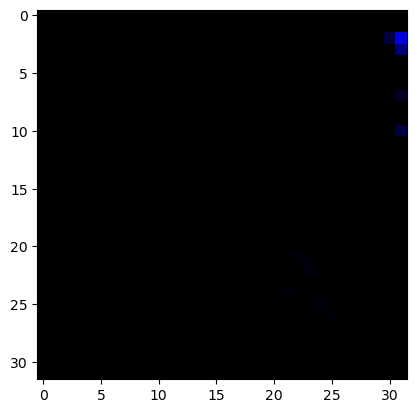

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


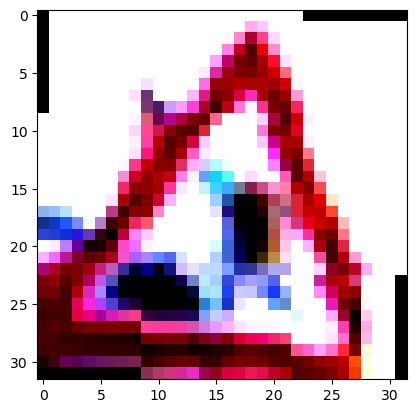

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


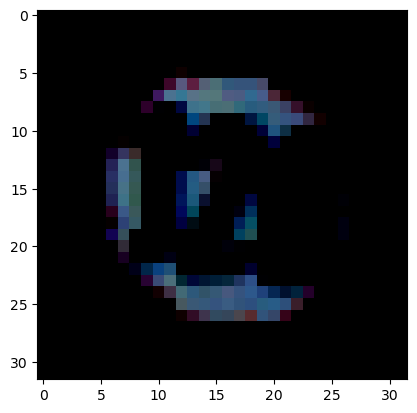

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


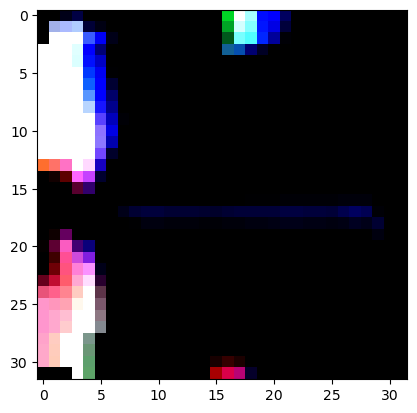

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


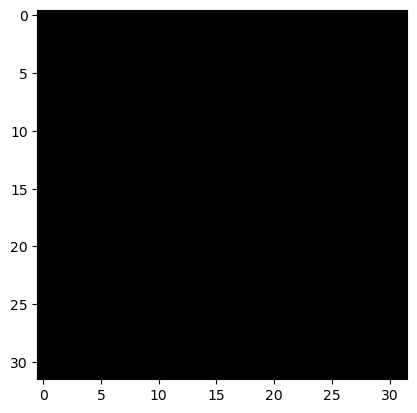

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 16
Predicted Label: 16


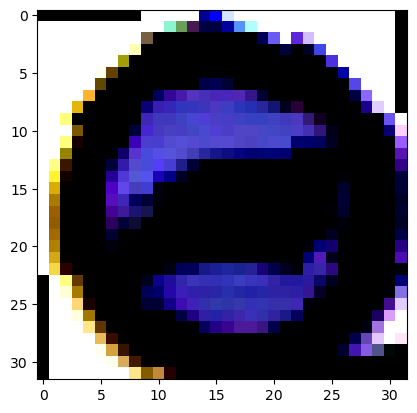

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


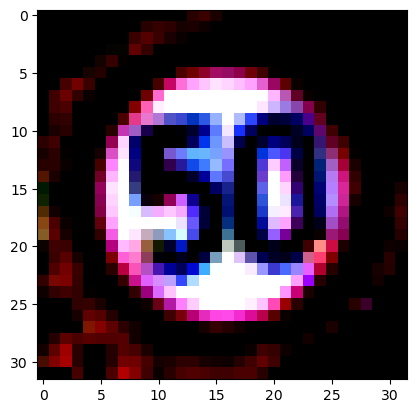

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


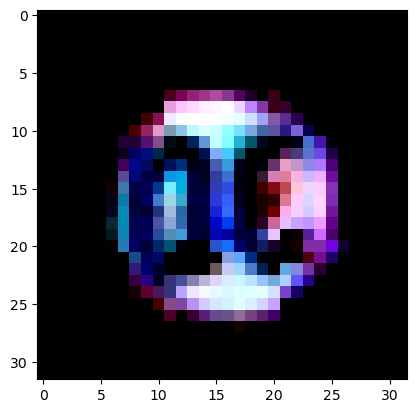

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


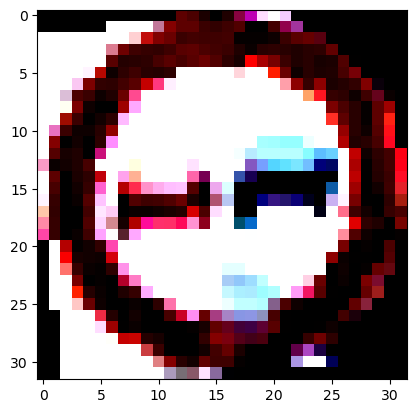

True Label: 23


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 23


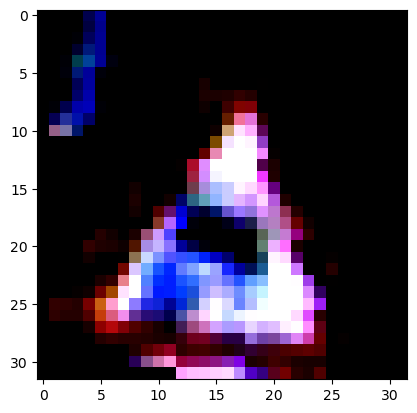

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 6
Predicted Label: 6


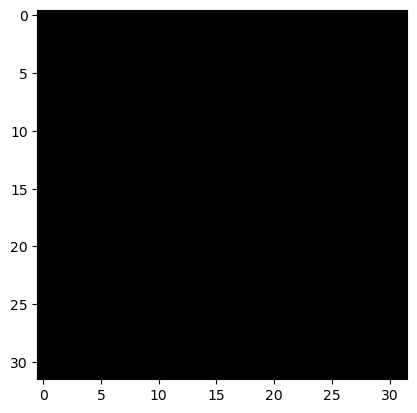

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


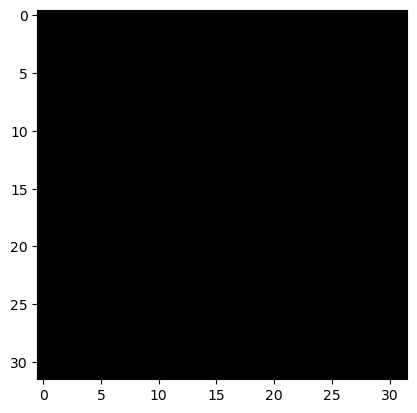

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


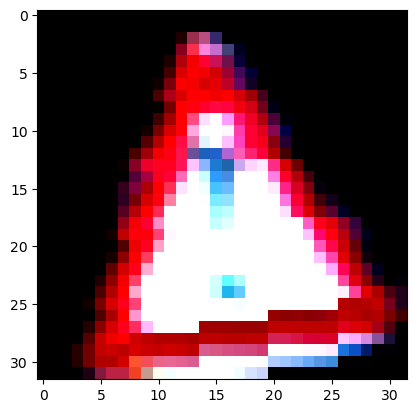

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


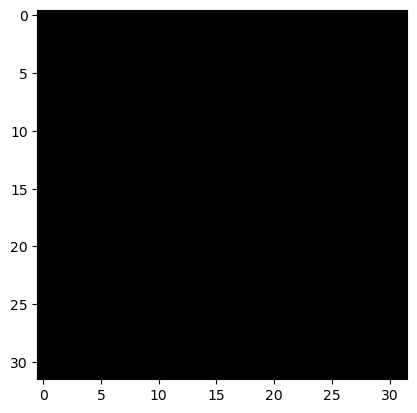

True Label: 31


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 31


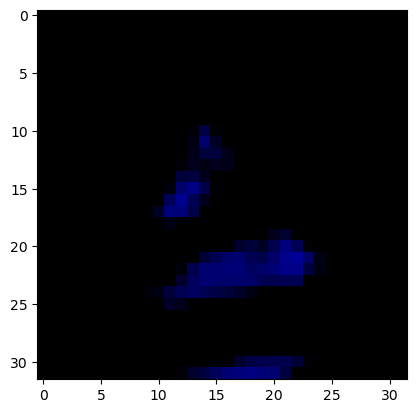

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


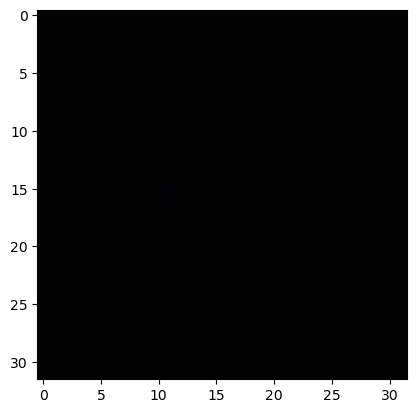

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


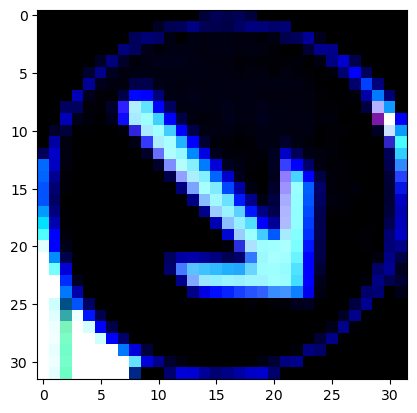

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


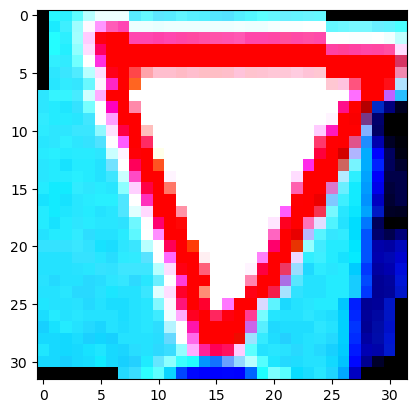

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


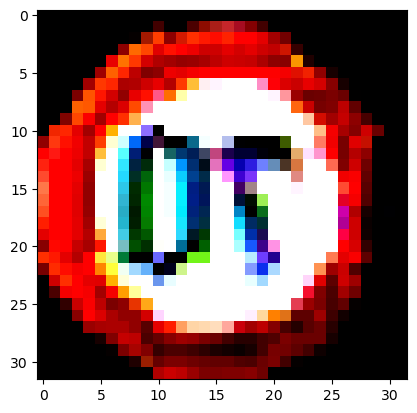

True Label: 4


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 4


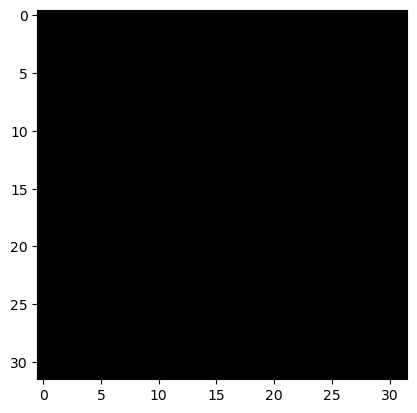

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


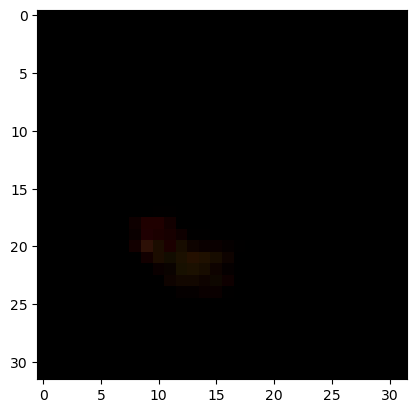

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


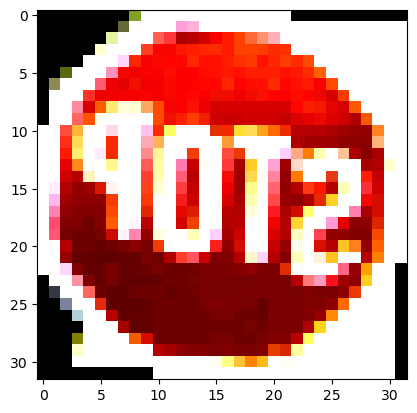

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


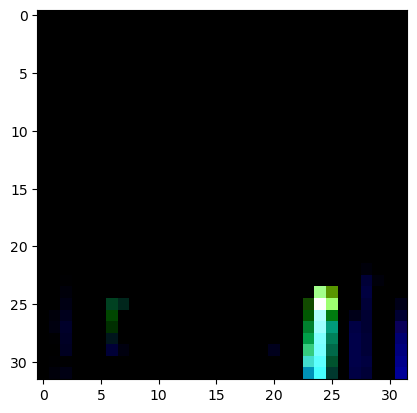

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


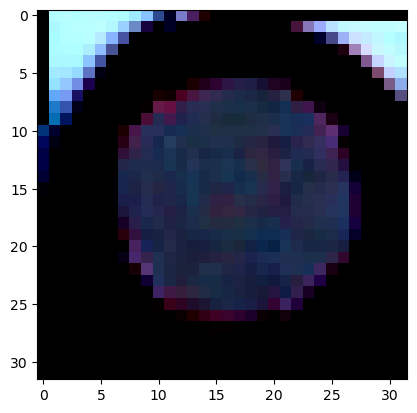

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


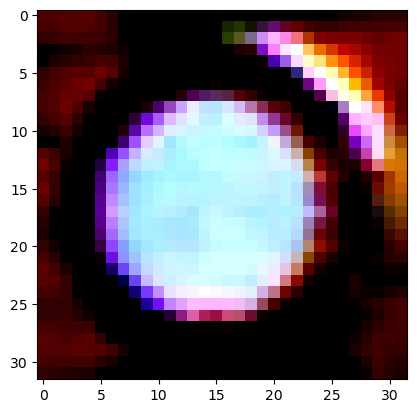

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


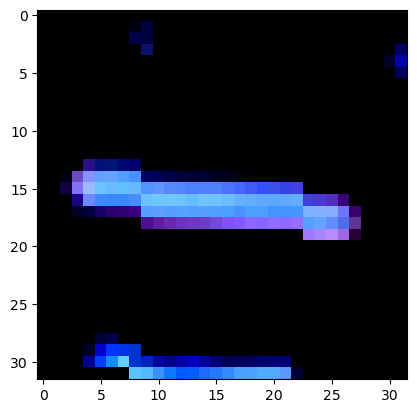

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


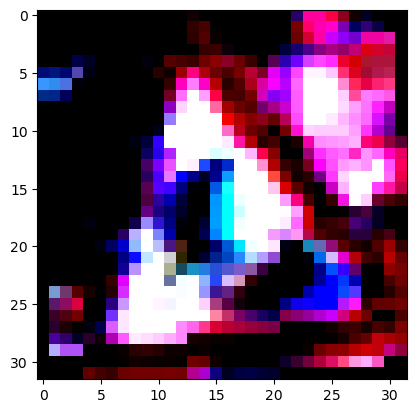

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


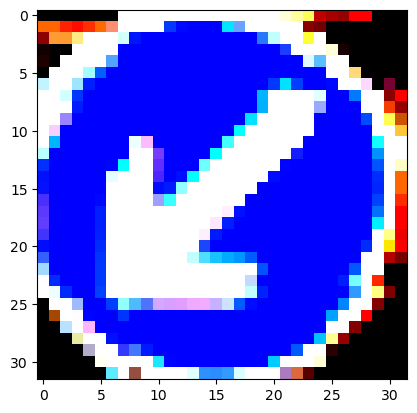

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


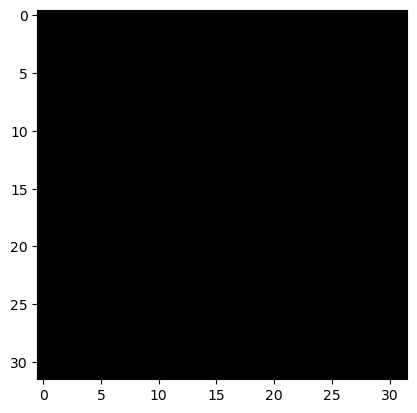

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


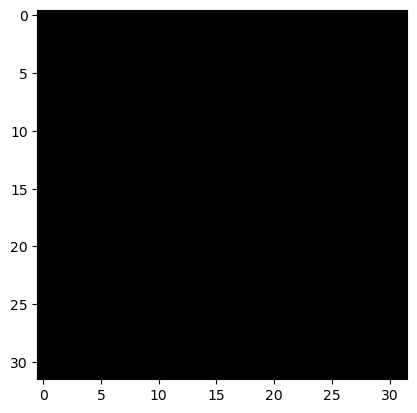

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


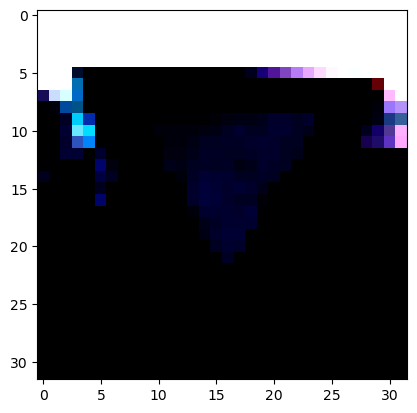

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 28
Predicted Label: 28


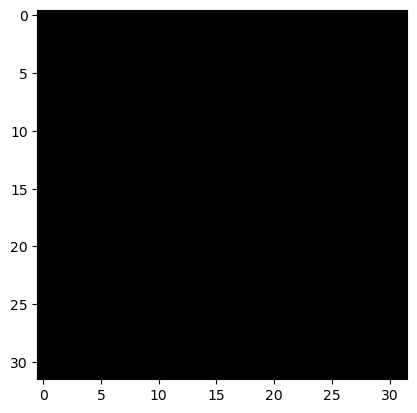

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 40
Predicted Label: 40


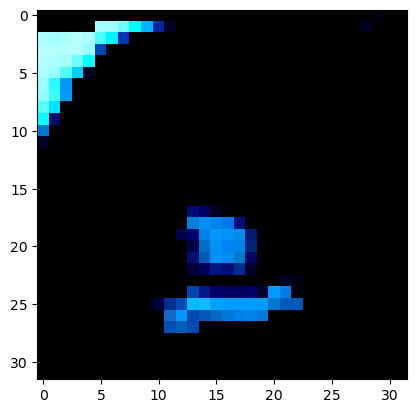

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


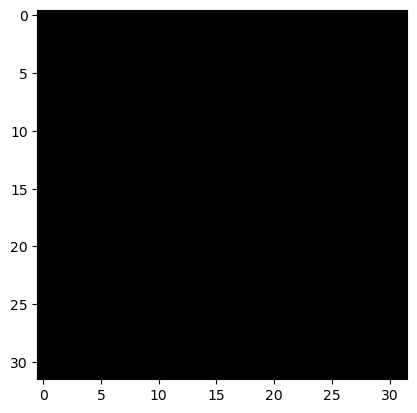

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 36
Predicted Label: 36


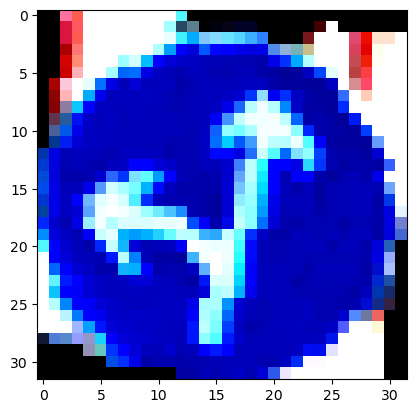

True Label: 12
Predicted Label: 12


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


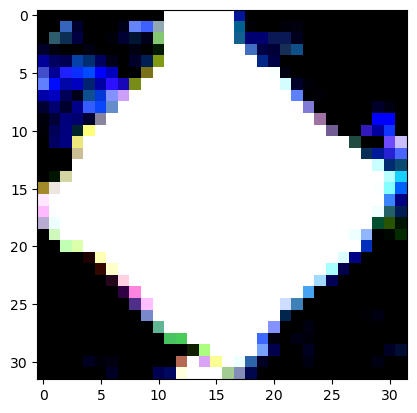

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


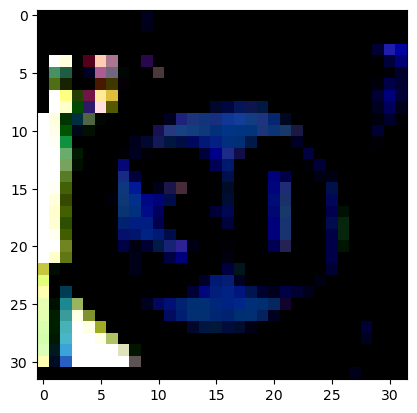

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


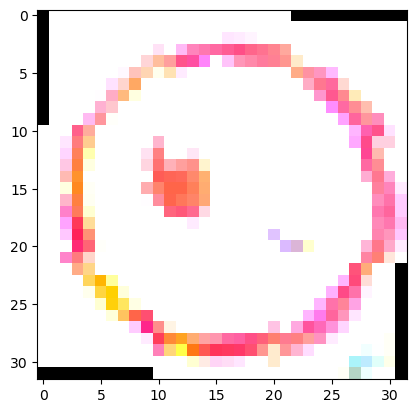

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


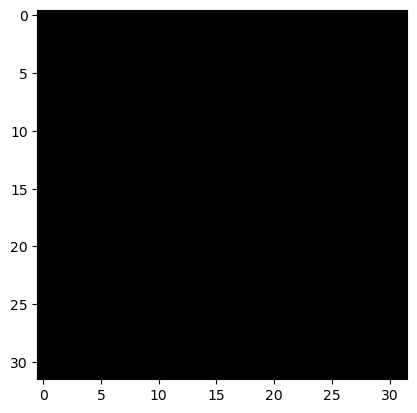

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


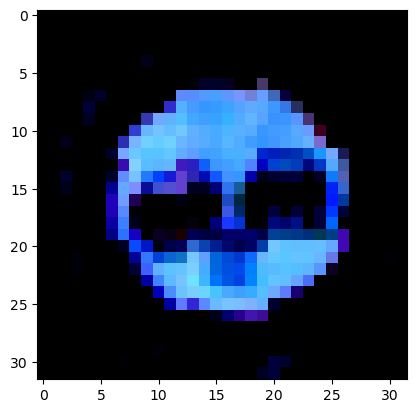

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


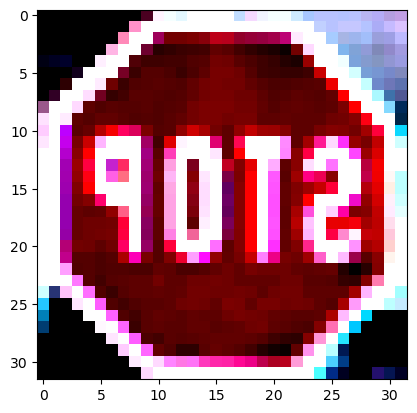

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 28
Predicted Label: 28


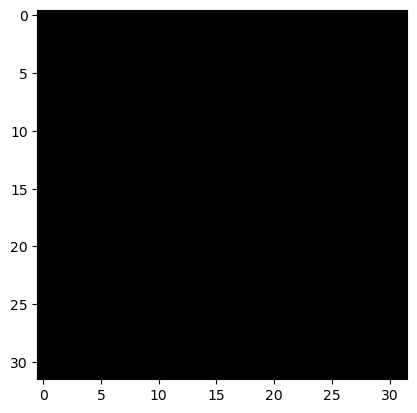

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


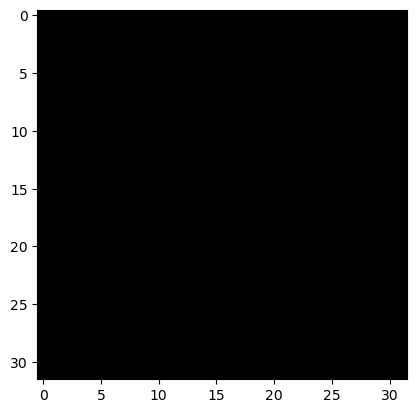

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


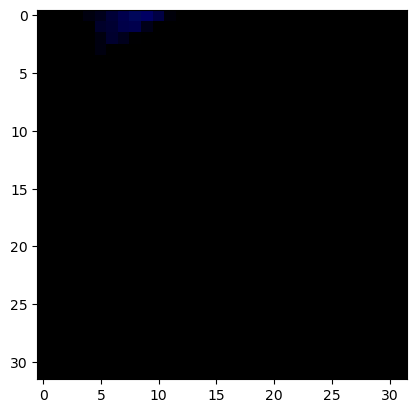

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


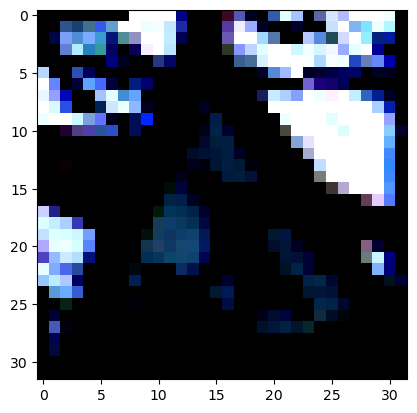

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


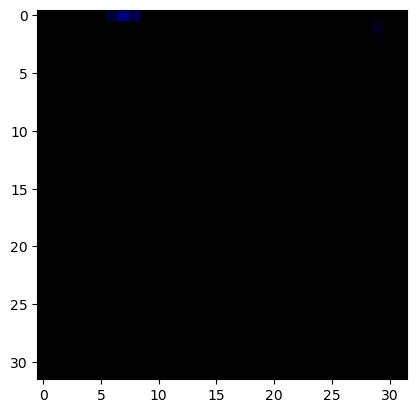

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


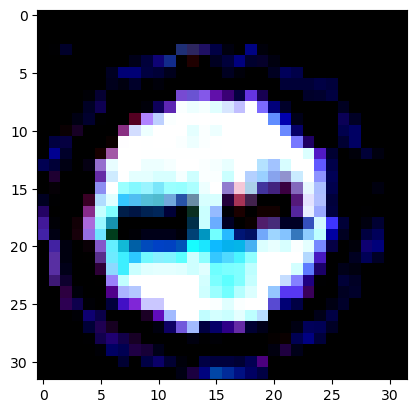

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


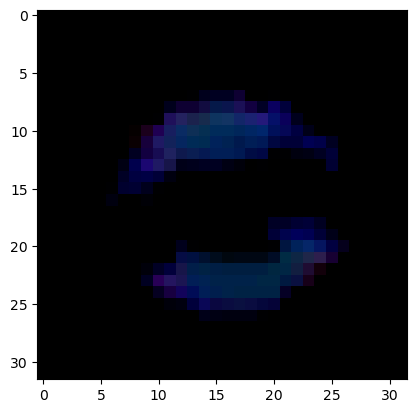

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


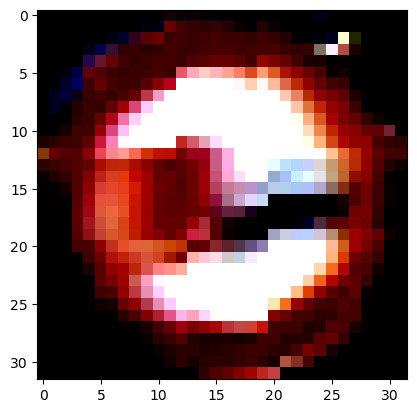

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


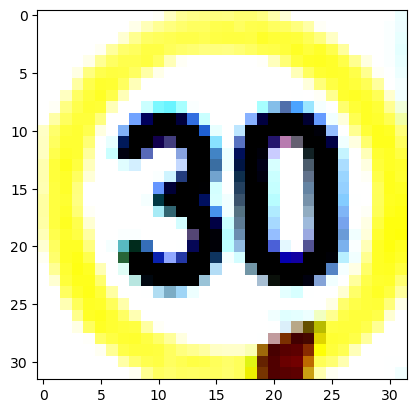

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


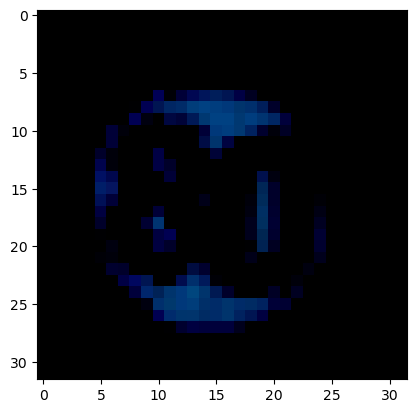

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


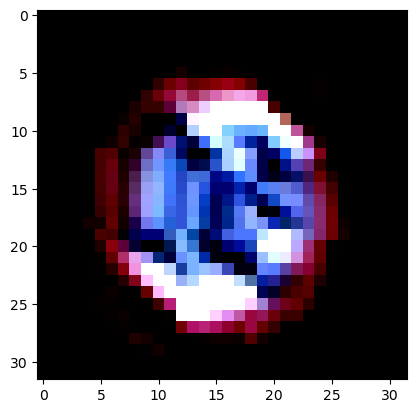

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


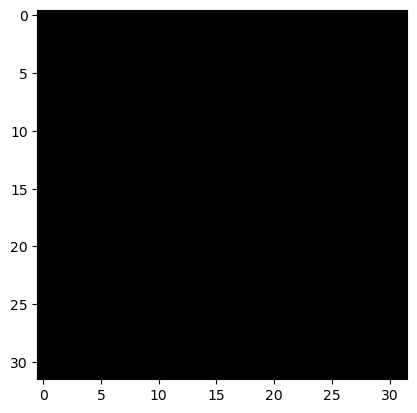

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


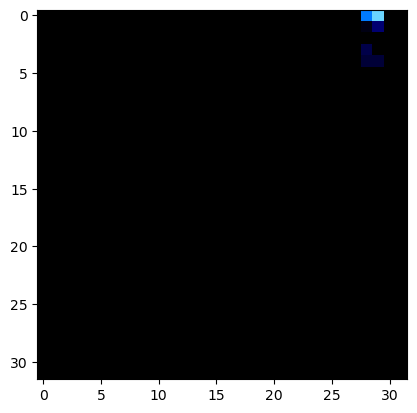

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 6
Predicted Label: 6


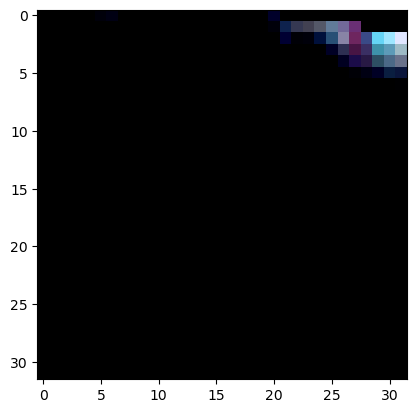

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


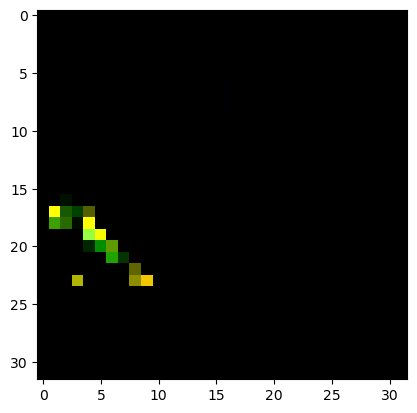

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


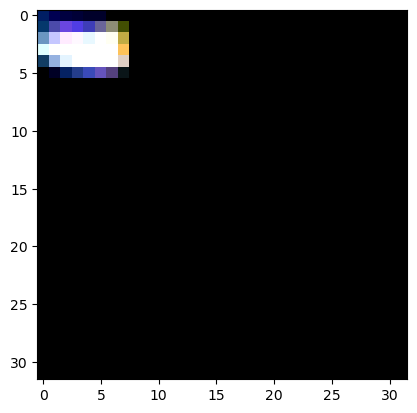

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


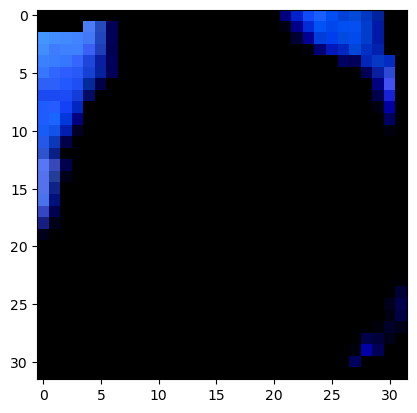

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


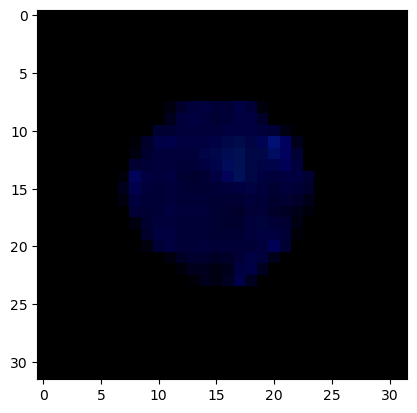

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 20
Predicted Label: 20


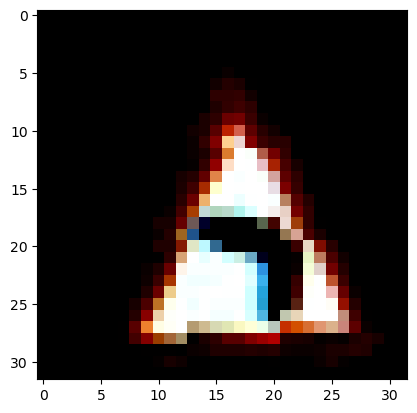

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


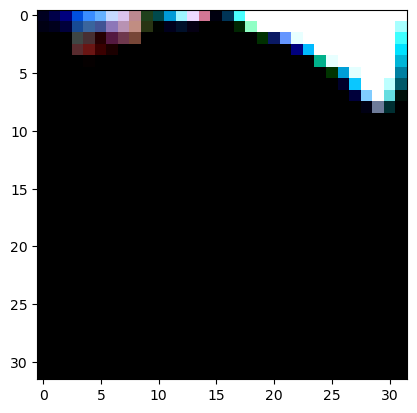

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


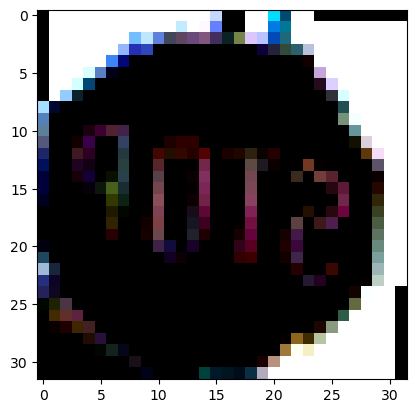

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


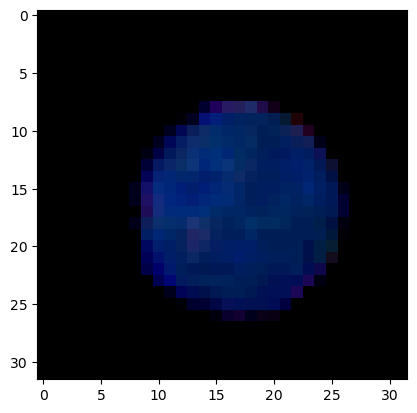

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


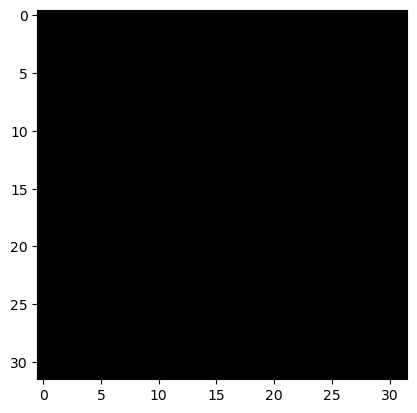

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


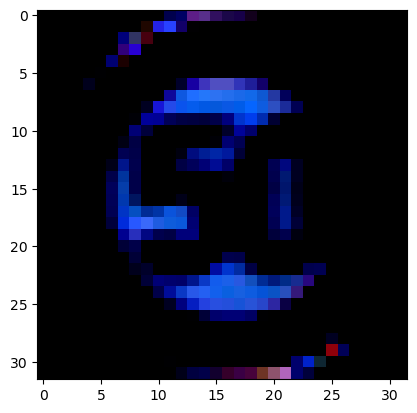

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 29
Predicted Label: 29


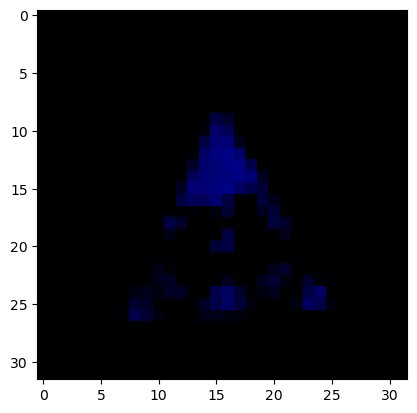

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


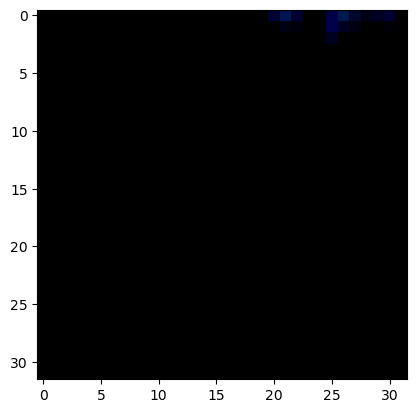

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


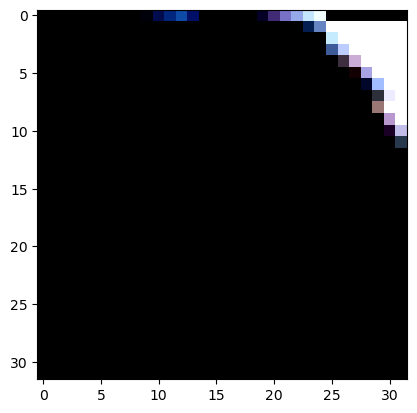

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


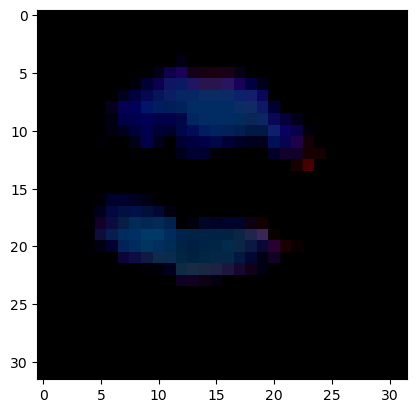

True Label: 30


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 30


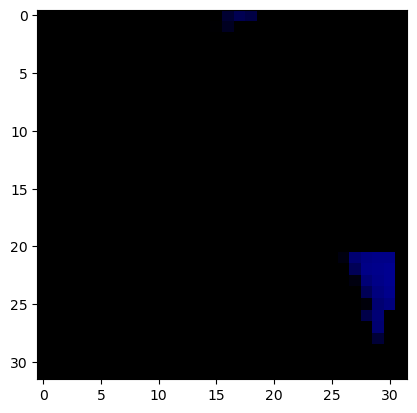

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


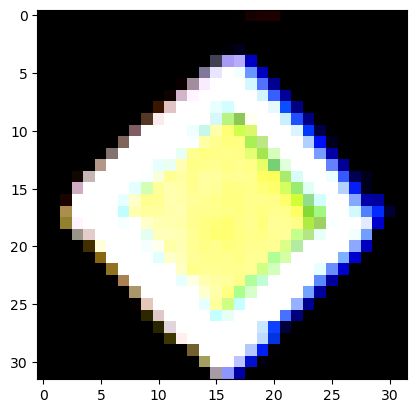

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


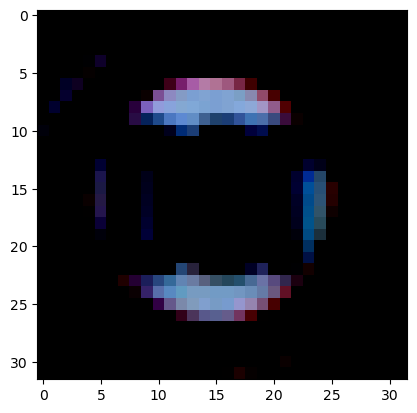

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 31
Predicted Label: 31


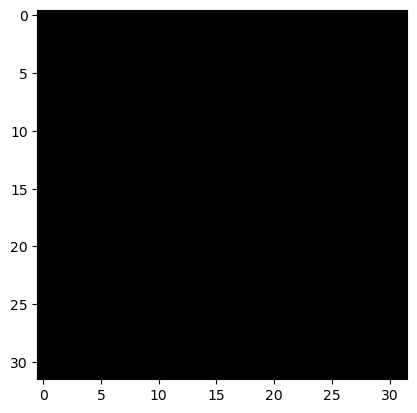

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


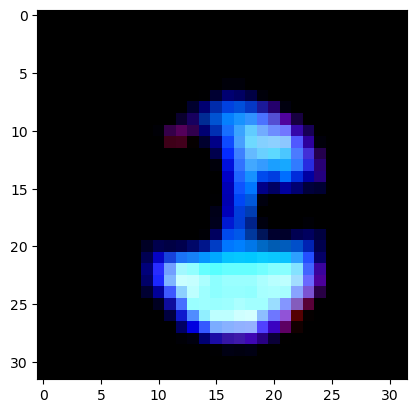

True Label: 10


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 10


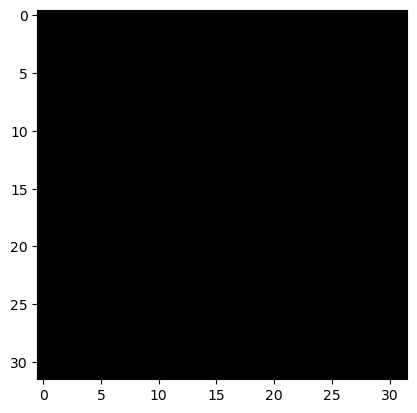

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


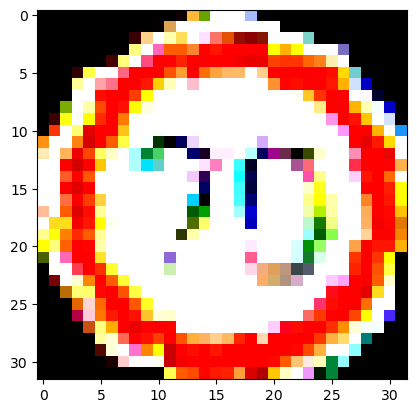

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 40
Predicted Label: 40


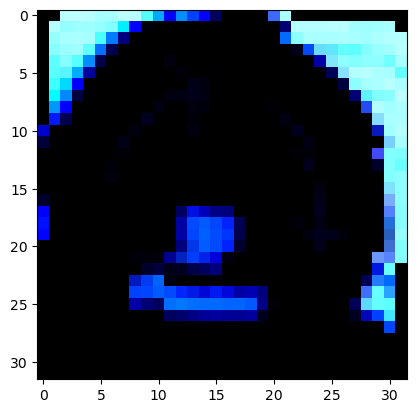

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


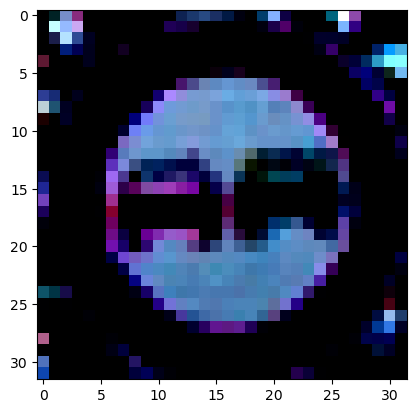

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 33
Predicted Label: 33


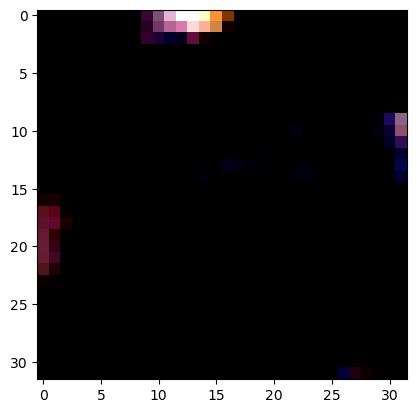

True Label: 8


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 8


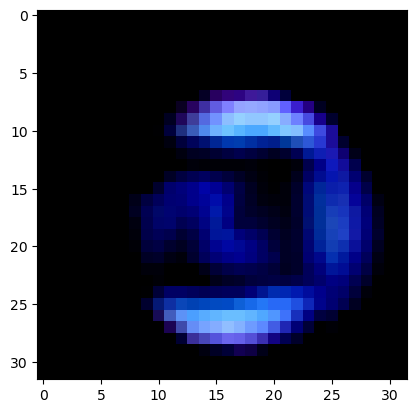

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


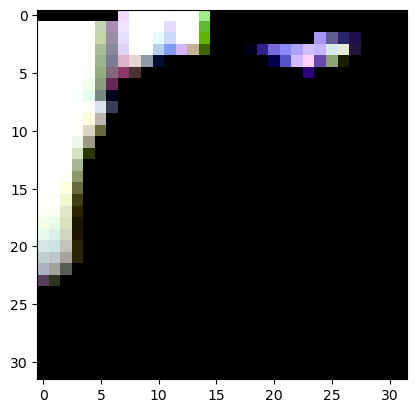

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


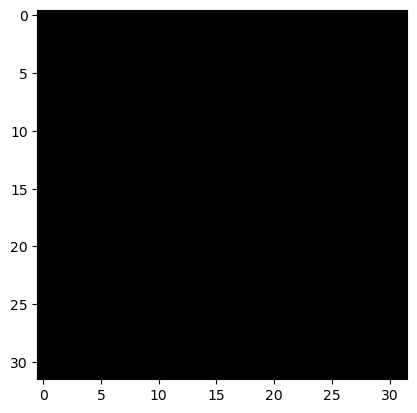

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 26
Predicted Label: 26


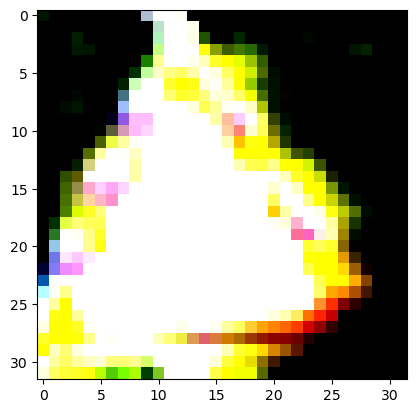

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 31
Predicted Label: 31


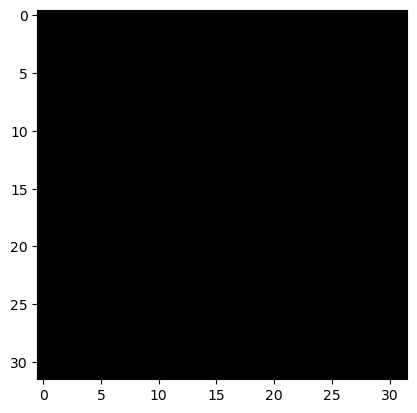

True Label: 27


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 27


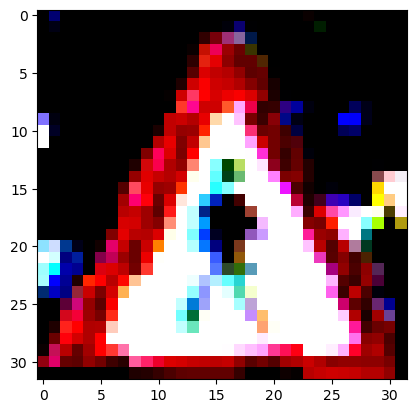

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


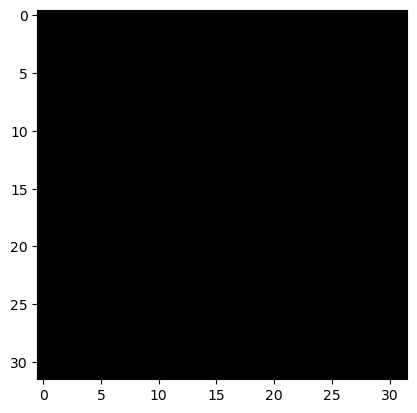

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


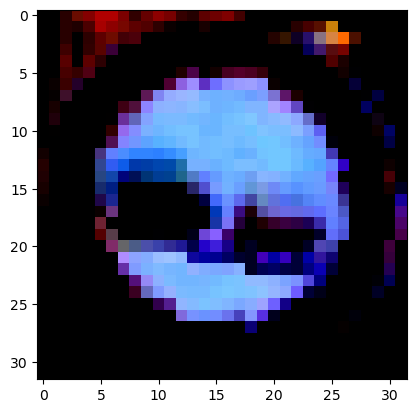

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


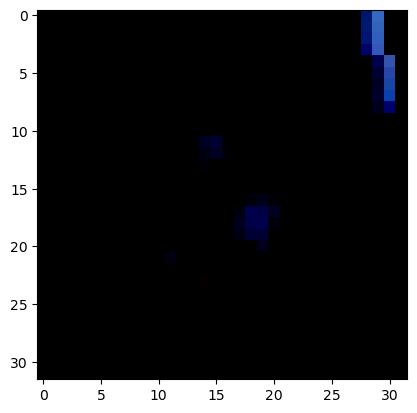

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


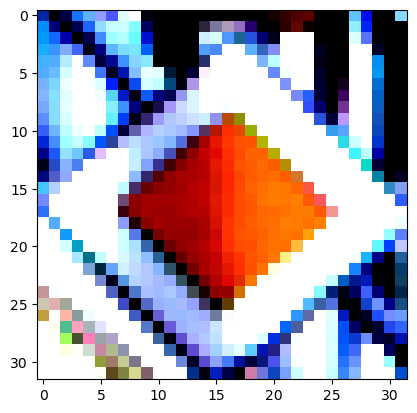

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


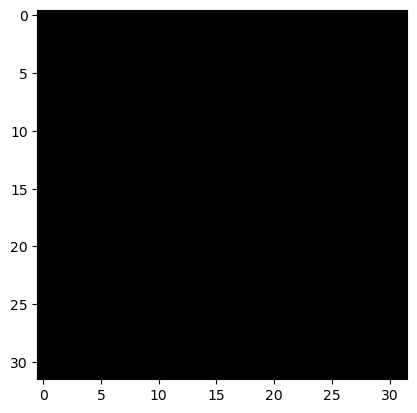

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


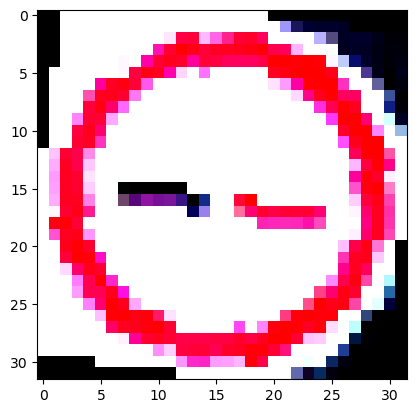

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 32
Predicted Label: 32


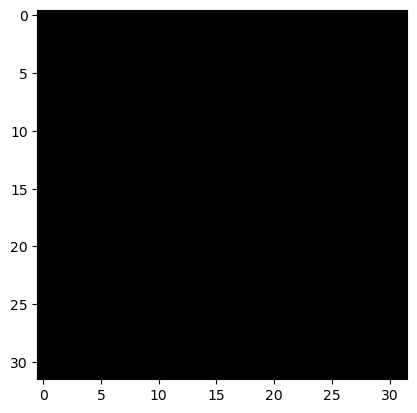

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


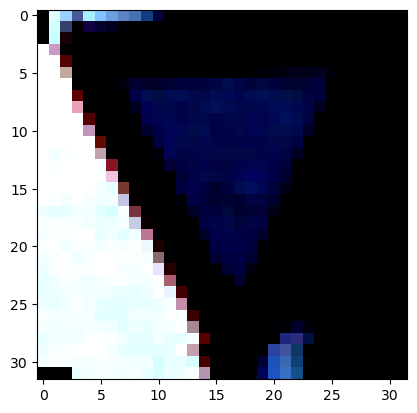

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 20
Predicted Label: 20


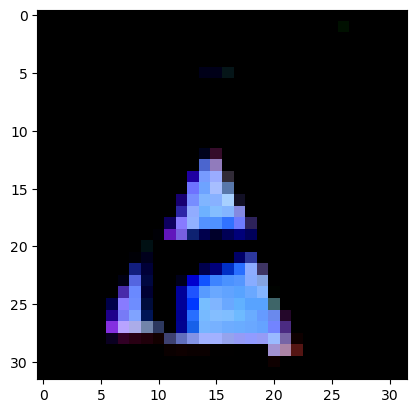

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 20
Predicted Label: 20


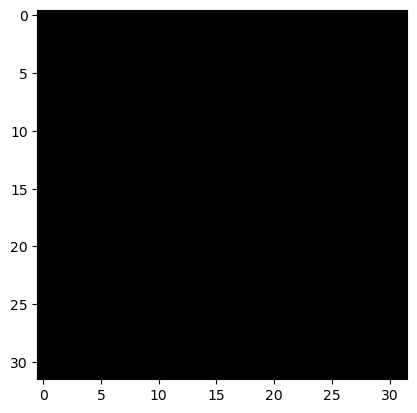

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


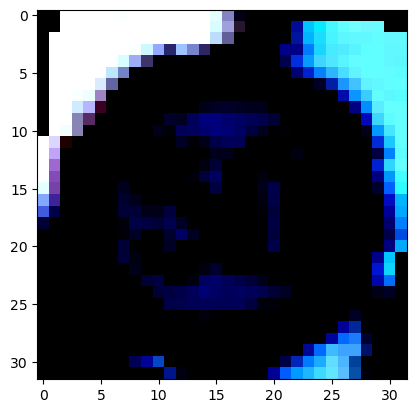

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


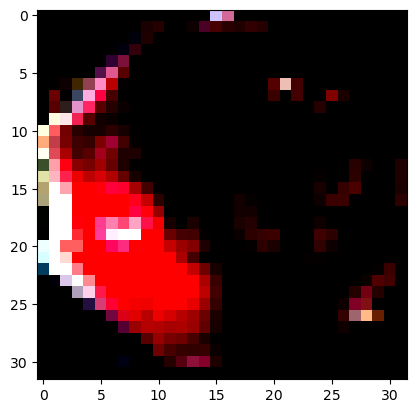

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


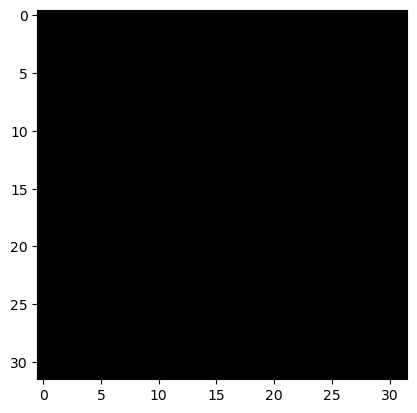

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 24
Predicted Label: 24


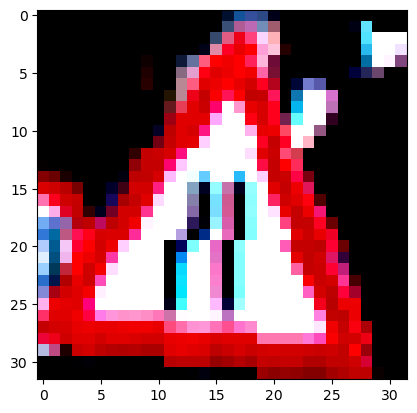

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


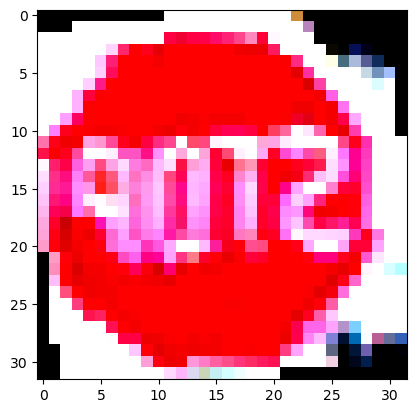

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


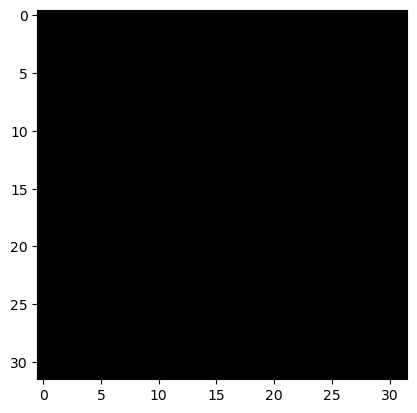

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


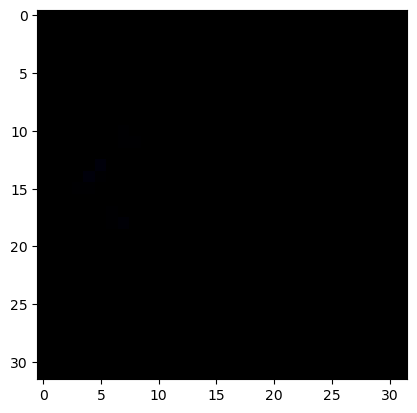

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


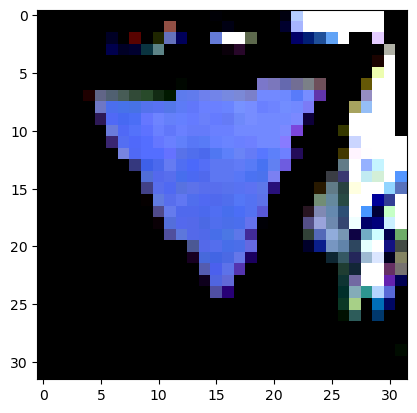

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


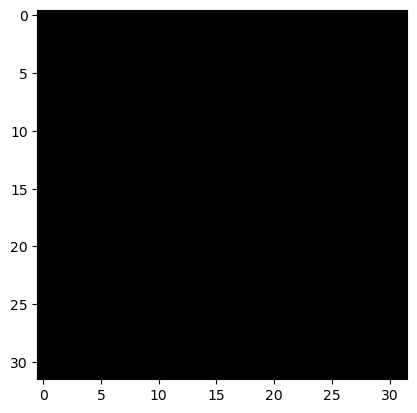

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 41
Predicted Label: 41


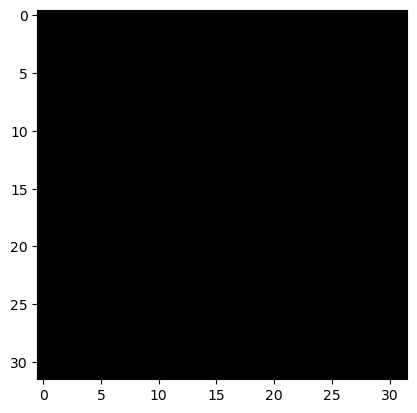

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


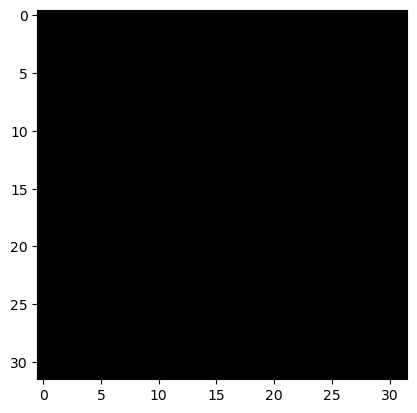

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


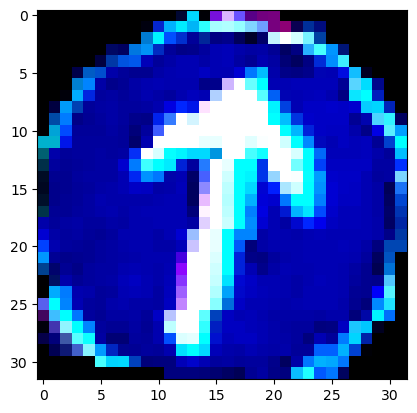

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 26
Predicted Label: 26


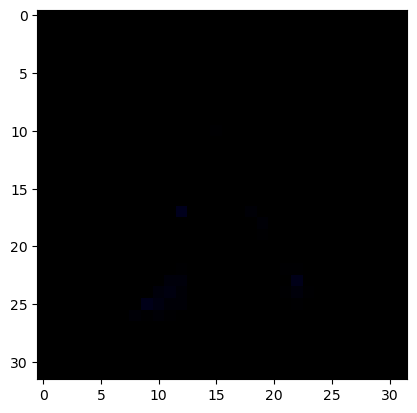

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


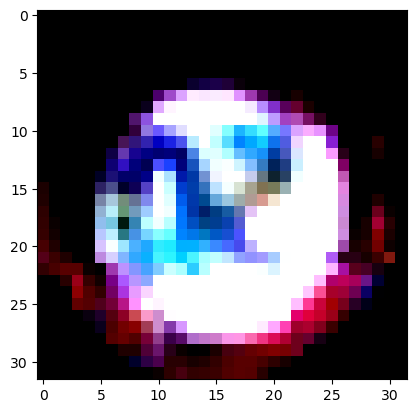

True Label: 23


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 23


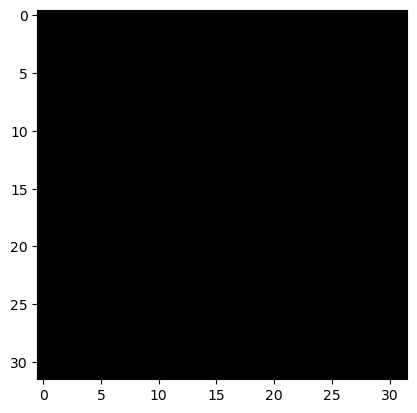

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


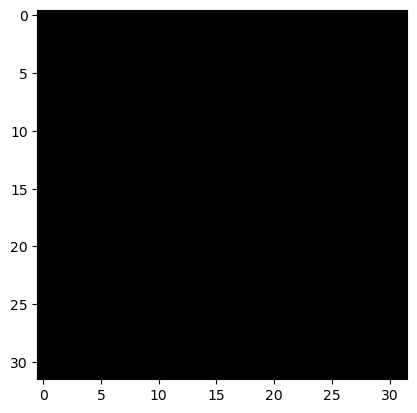

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 36
Predicted Label: 36


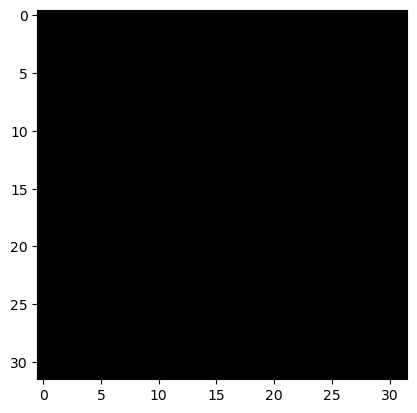

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


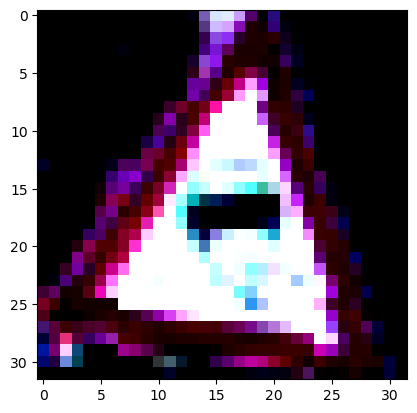

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


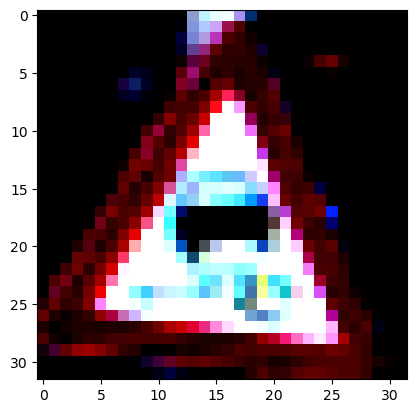

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


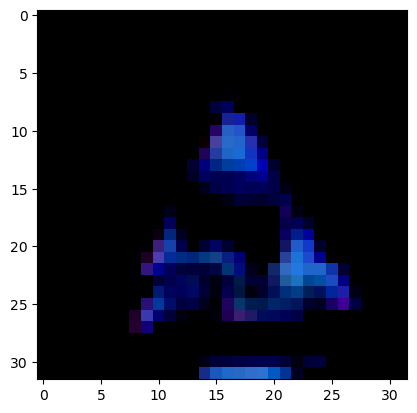

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


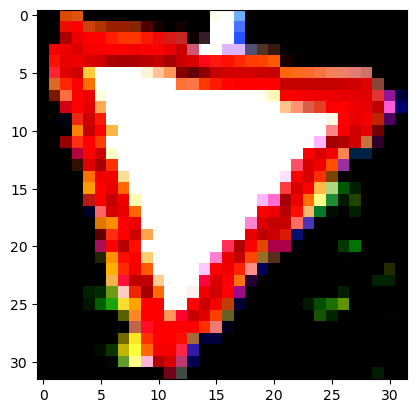

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 34
Predicted Label: 34


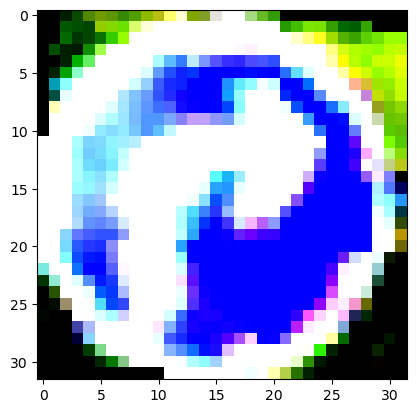

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


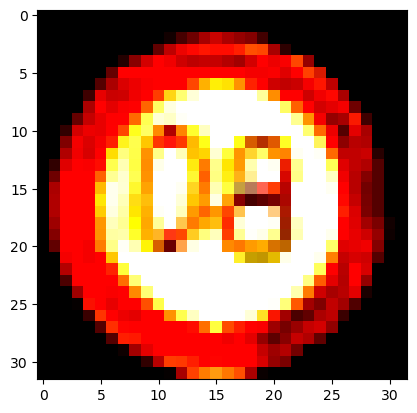

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


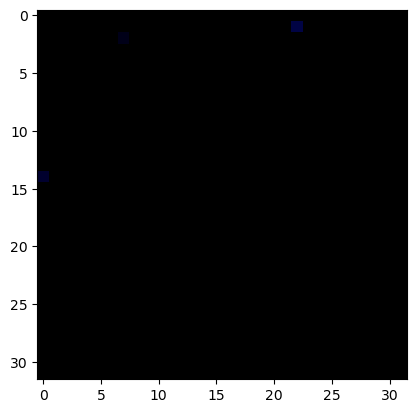

True Label: 1


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 1


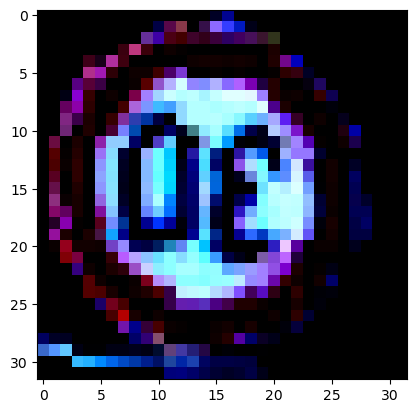

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


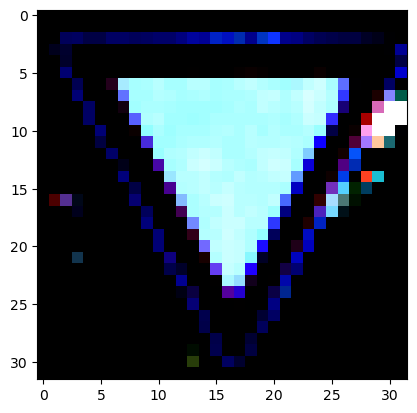

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


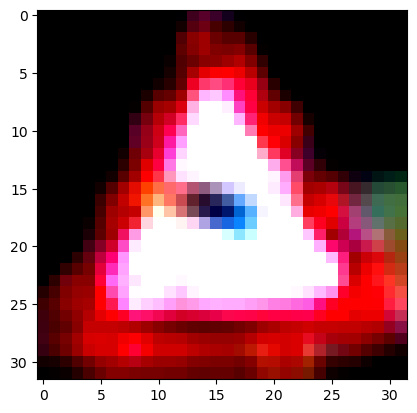

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


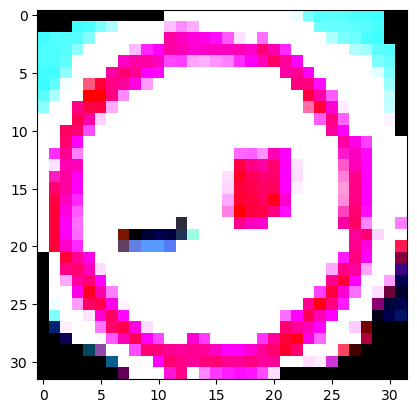

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 26
Predicted Label: 26


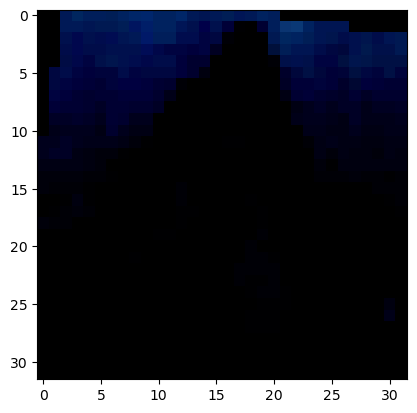

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


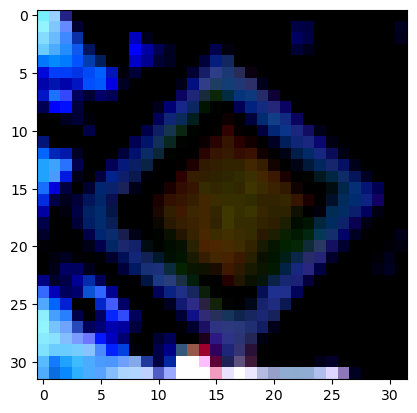

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


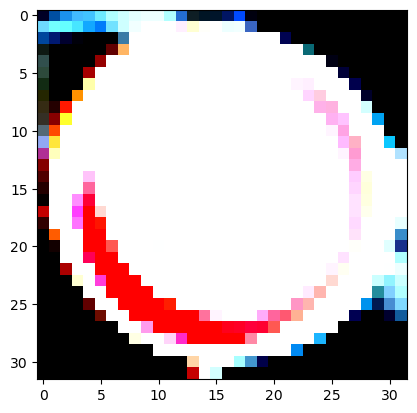

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 29
Predicted Label: 29


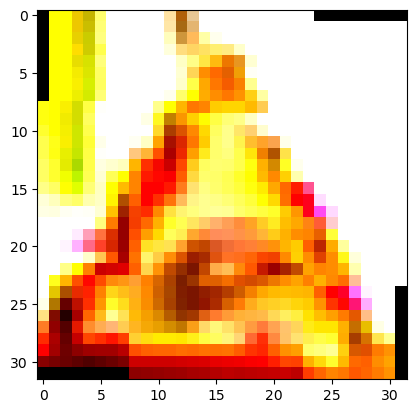

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


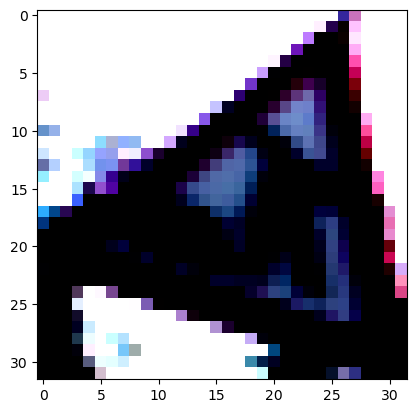

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


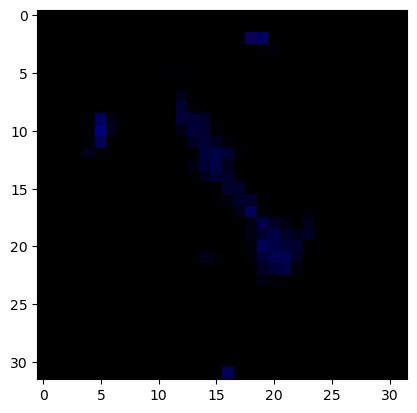

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


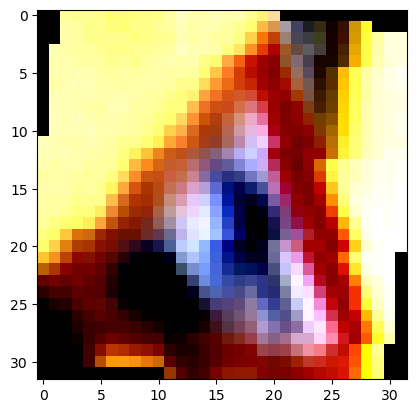

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


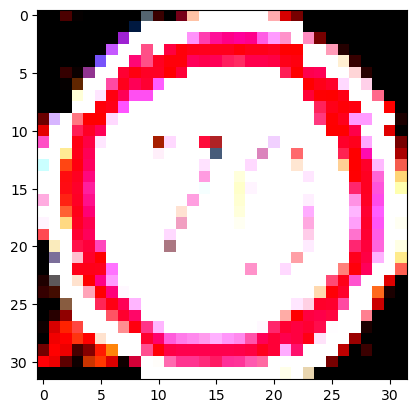

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 29
Predicted Label: 29


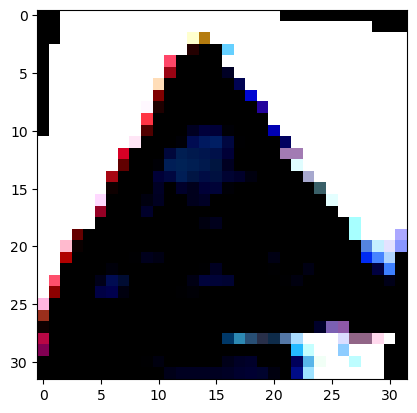

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 27
Predicted Label: 27


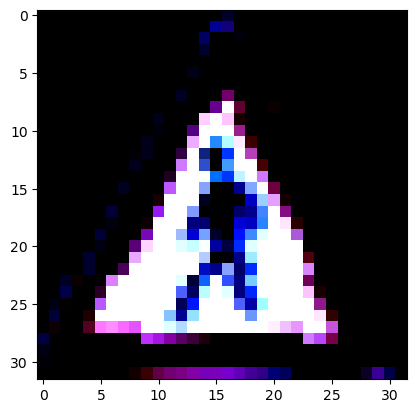

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


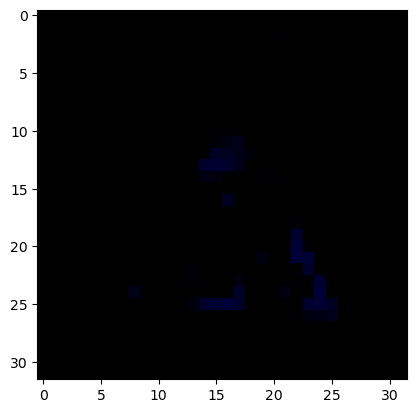

True Label: 9


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 9


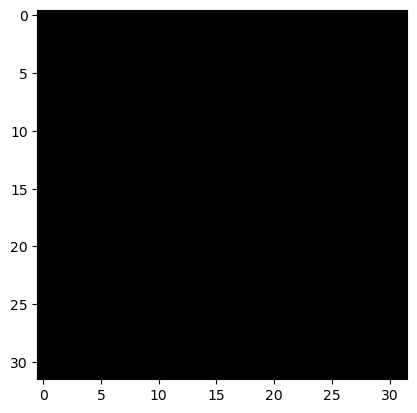

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


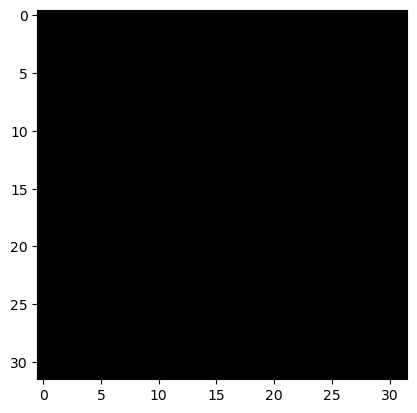

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


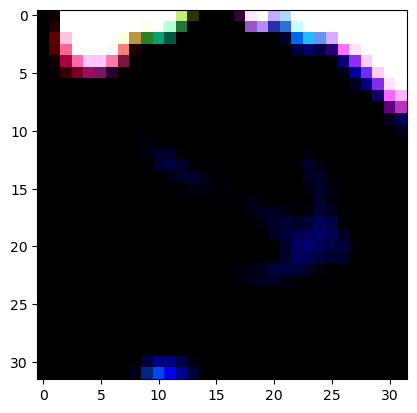

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


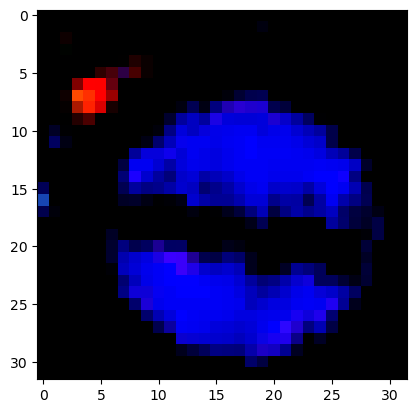

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


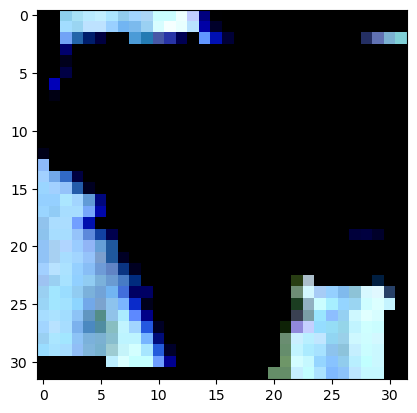

True Label: 31


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 31


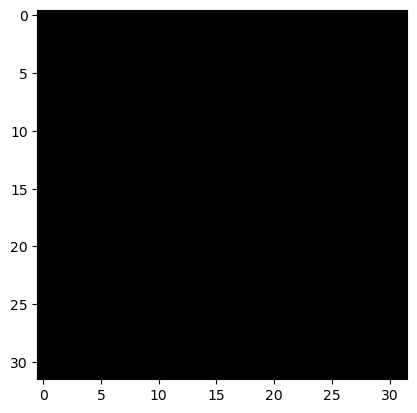

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 30
Predicted Label: 30


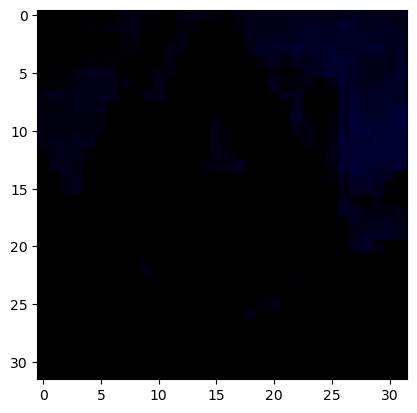

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


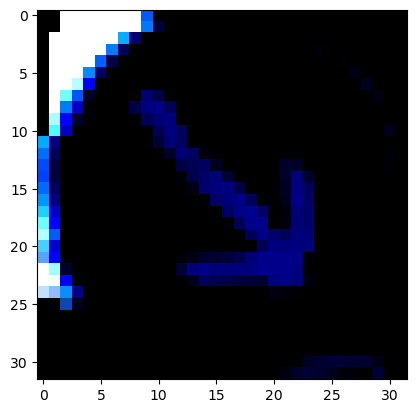

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


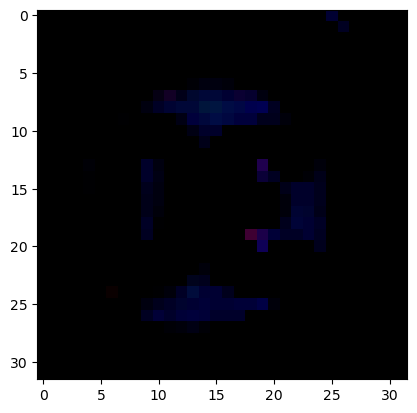

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


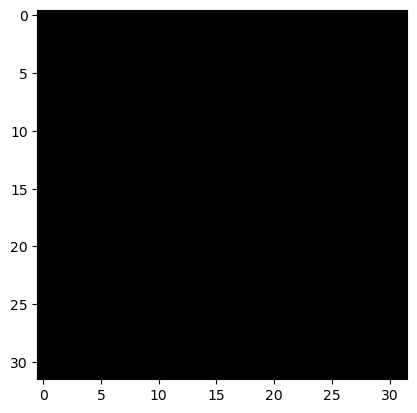

True Label: 14


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 14


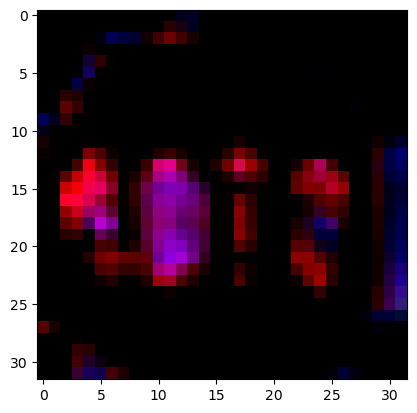

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


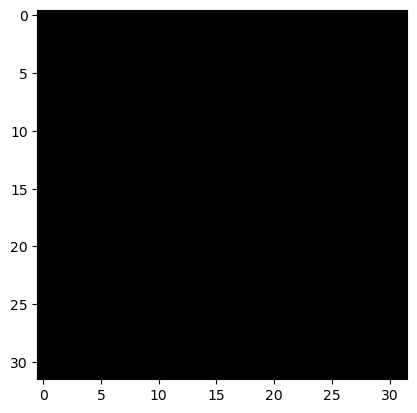

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 21
Predicted Label: 21


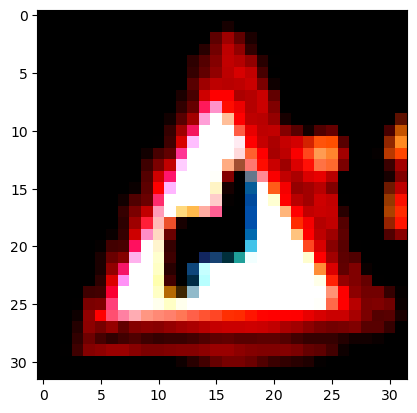

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


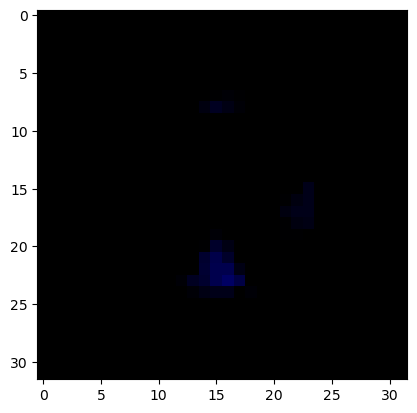

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 6
Predicted Label: 6


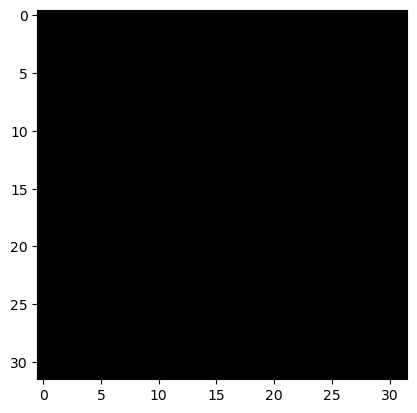

True Label: 1


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 1


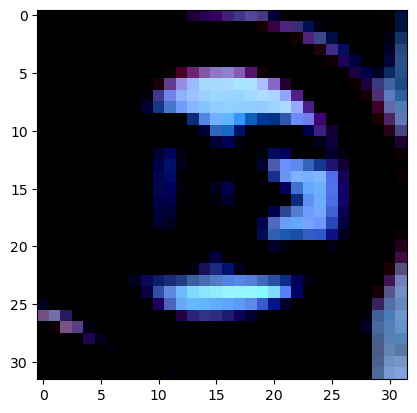

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


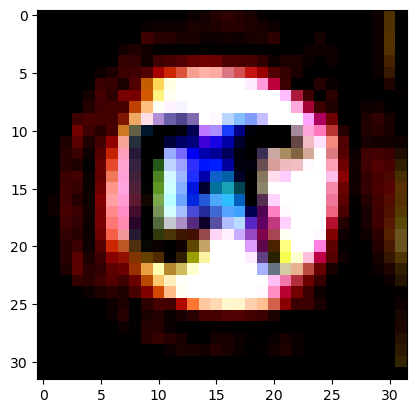

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


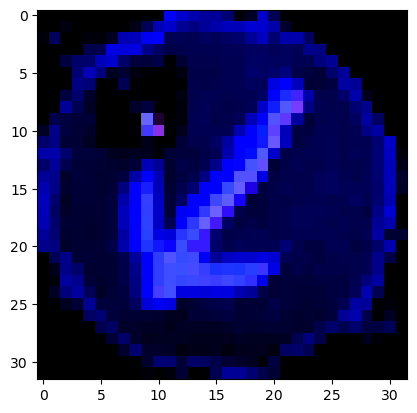

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 33
Predicted Label: 33


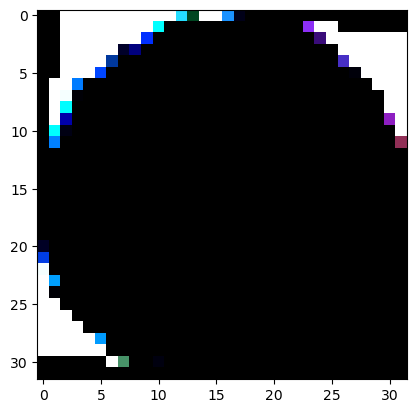

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


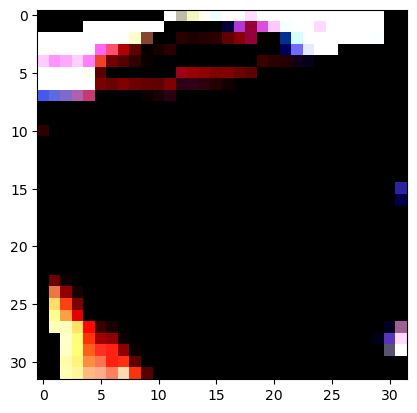

True Label: 4


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 4


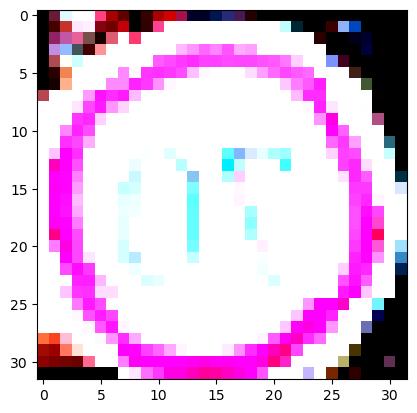

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


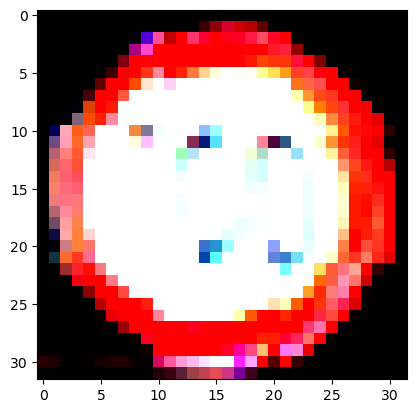

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


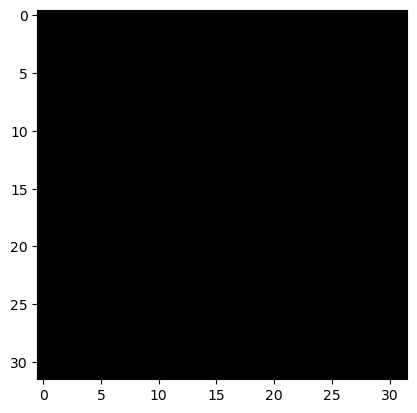

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 30
Predicted Label: 30


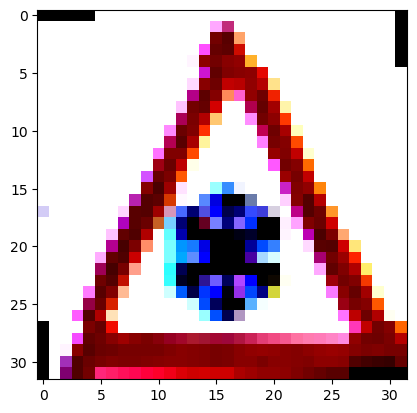

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


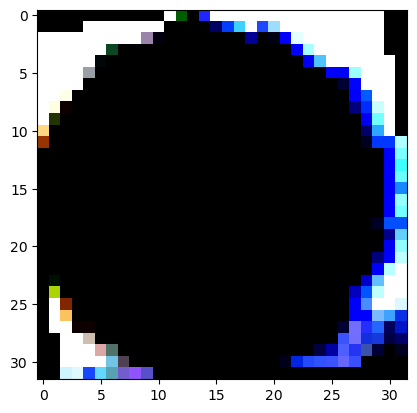

True Label: 38


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 38


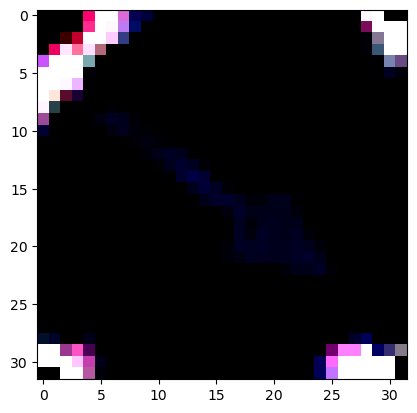

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


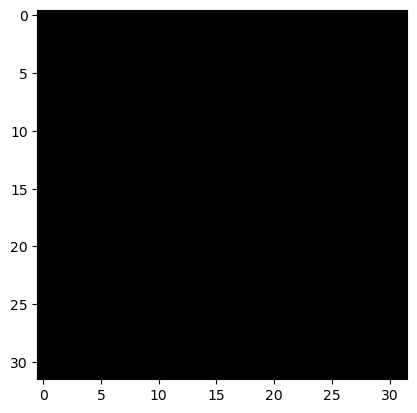

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


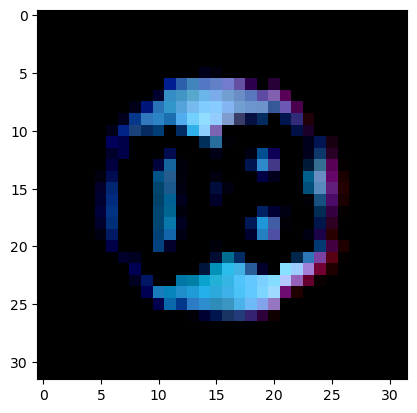

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


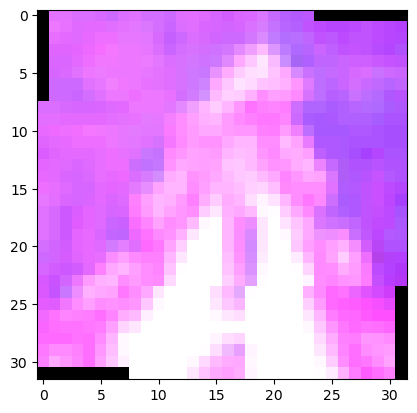

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


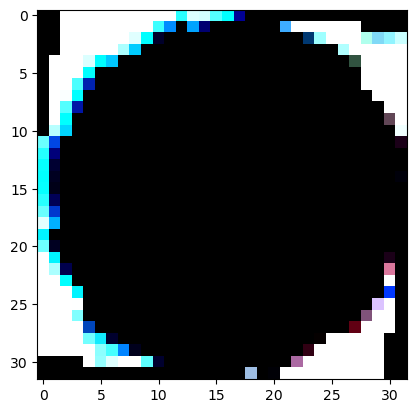

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


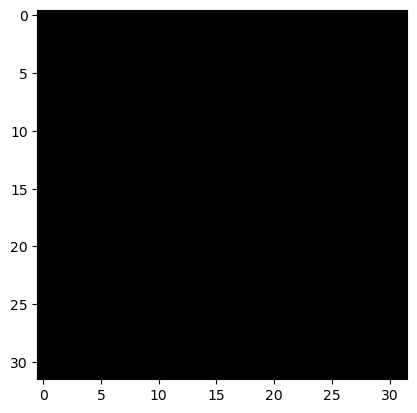

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


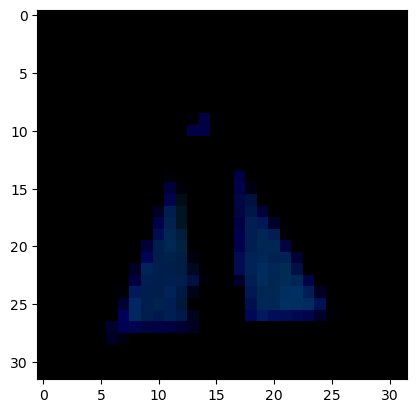

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


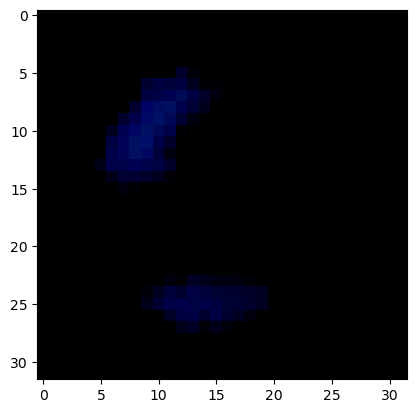

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


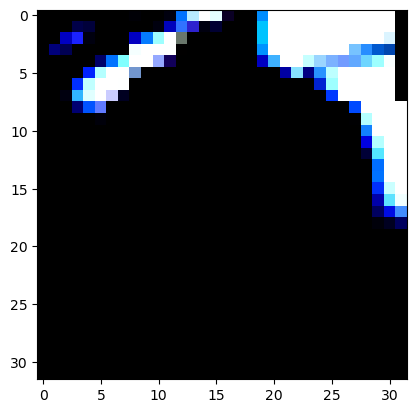

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 1


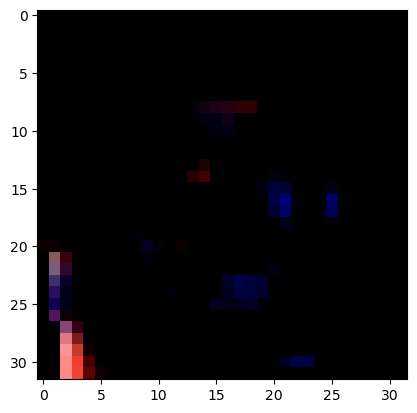

True Label: 25


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 25


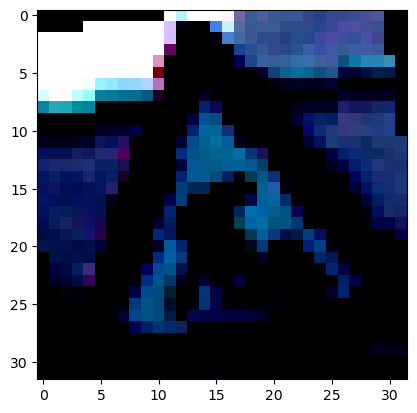

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


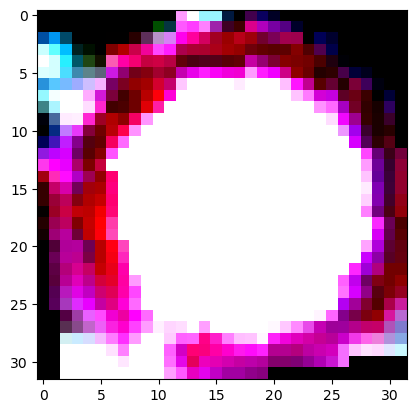

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 40
Predicted Label: 40


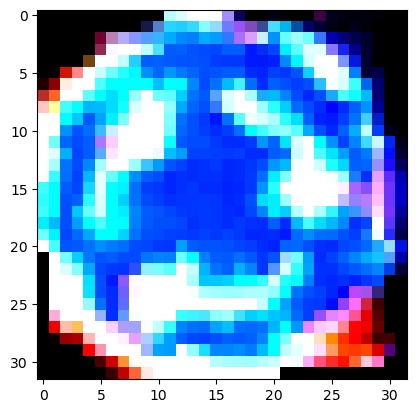

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


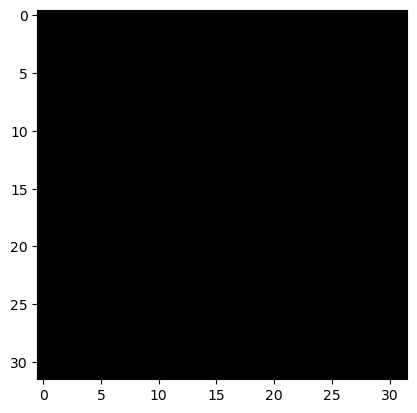

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 32
Predicted Label: 32


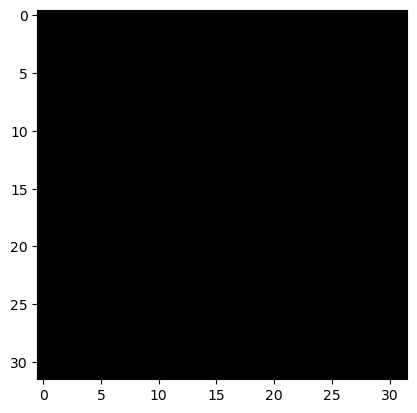

True Label: 12


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 12


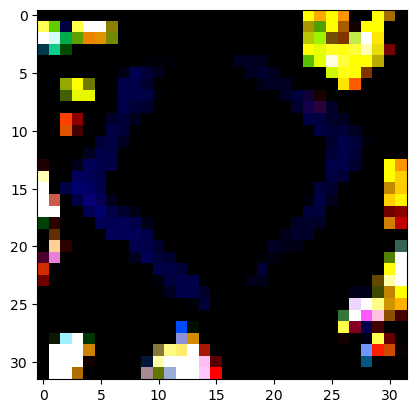

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


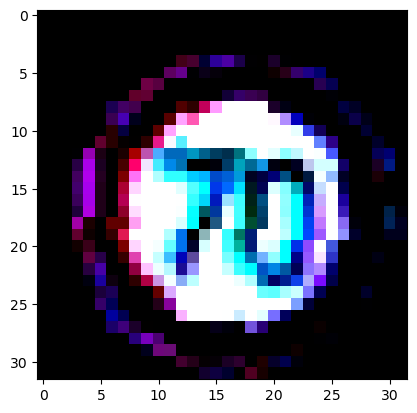

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


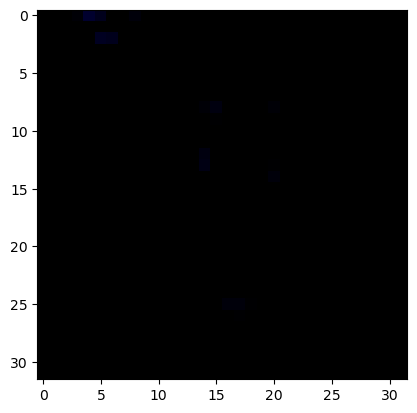

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 29
Predicted Label: 29


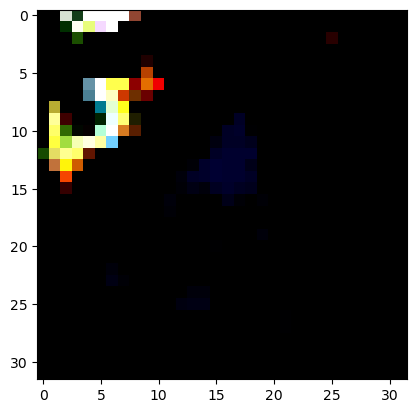

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


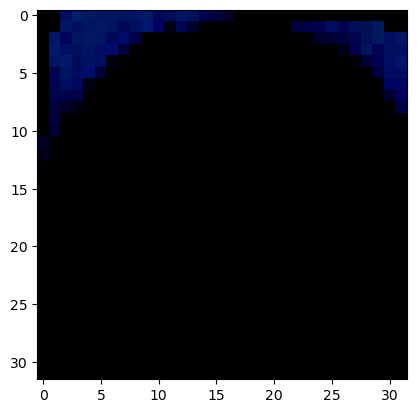

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


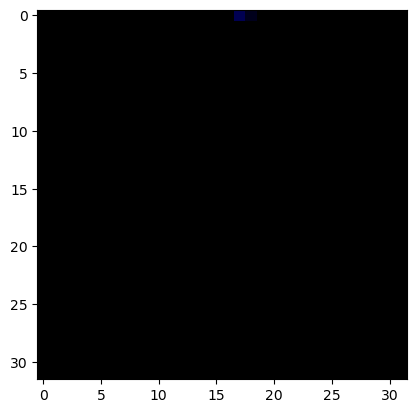

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


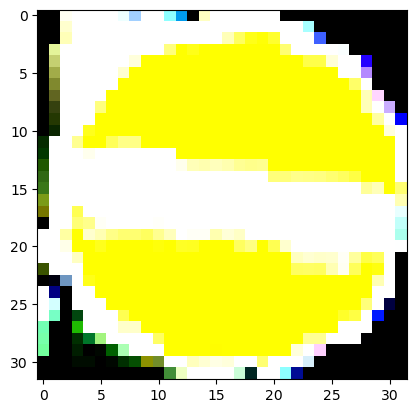

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


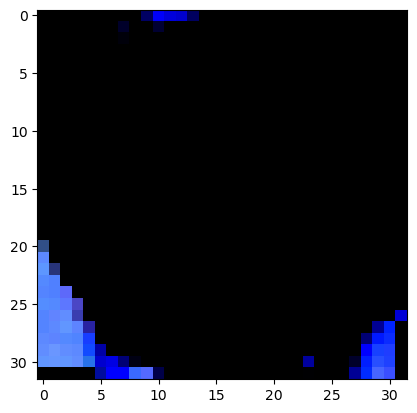

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


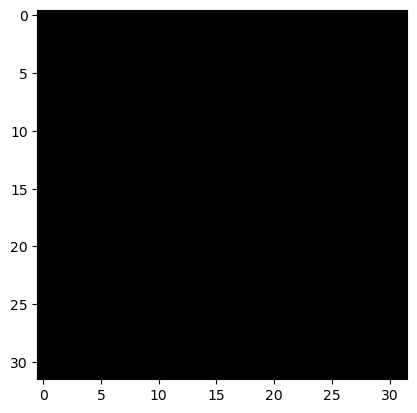

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


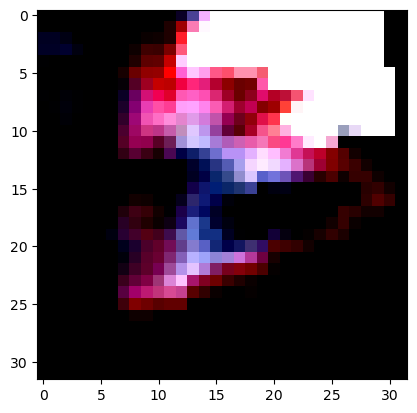

True Label: 28


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 28


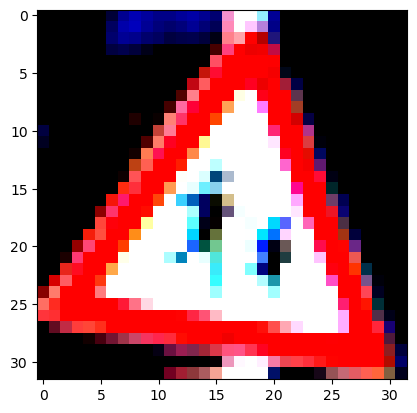

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


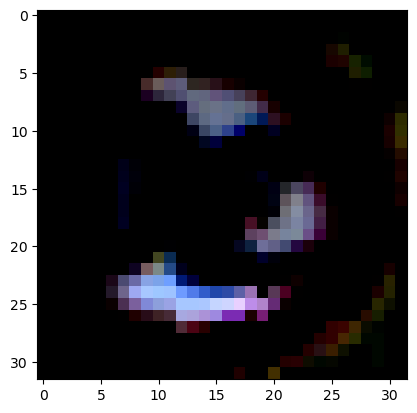

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


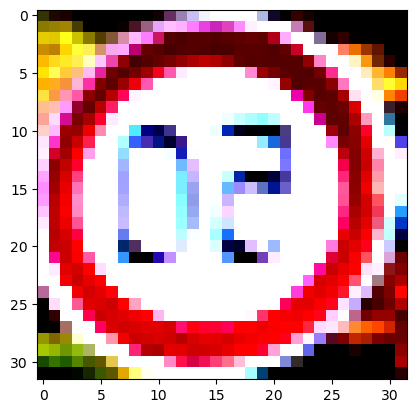

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


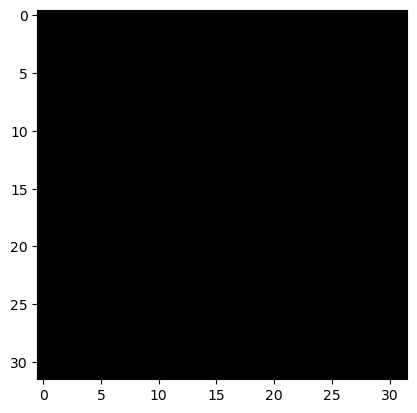

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


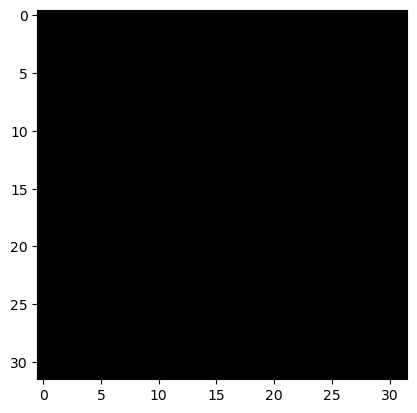

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 21
Predicted Label: 21


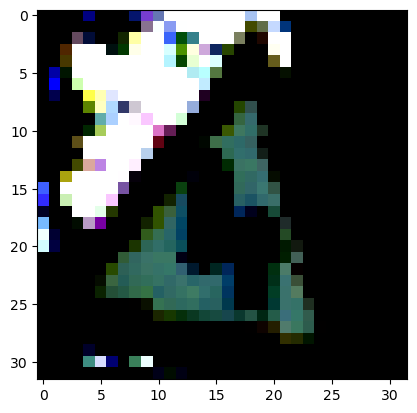

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


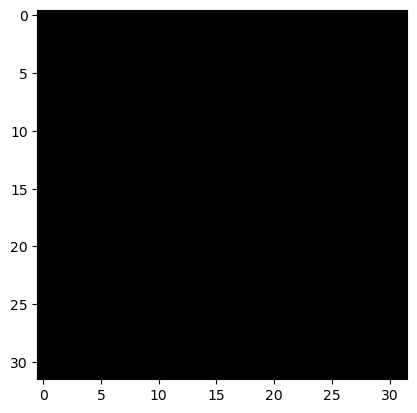

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


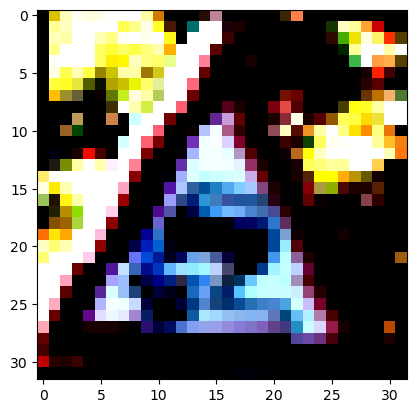

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 21
Predicted Label: 21


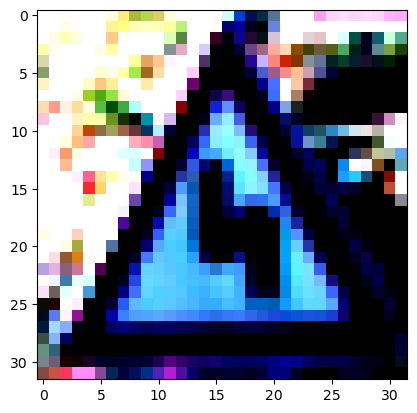

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 20
Predicted Label: 20


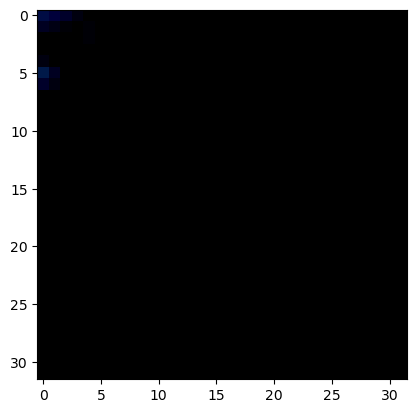

True Label: 3


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 3


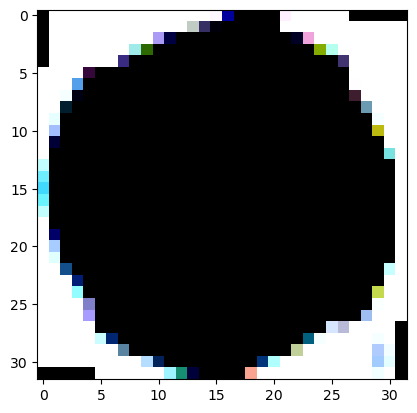

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


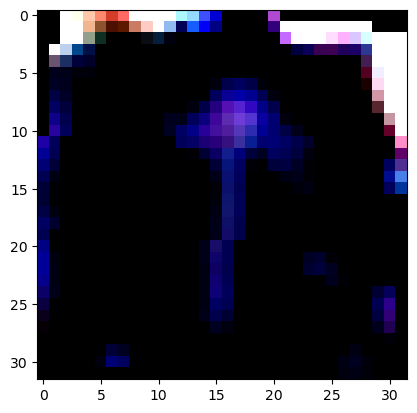

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


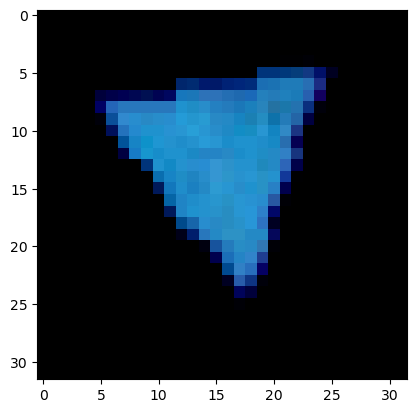

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


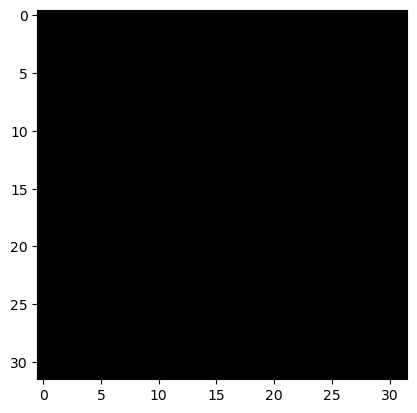

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


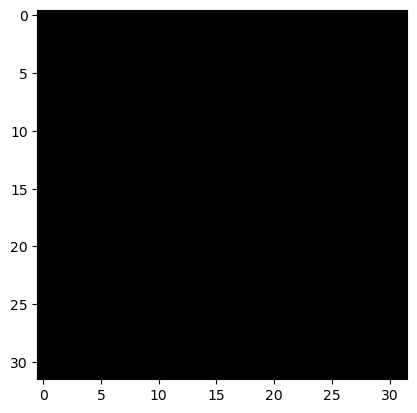

True Label: 17
Predicted Label: 17


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


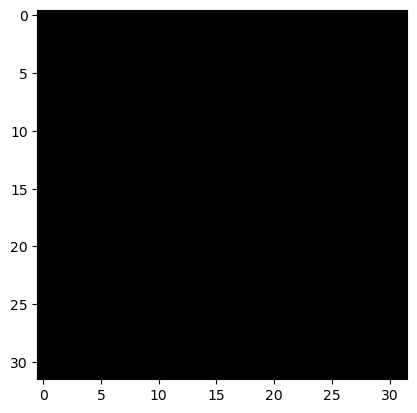

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 29
Predicted Label: 29


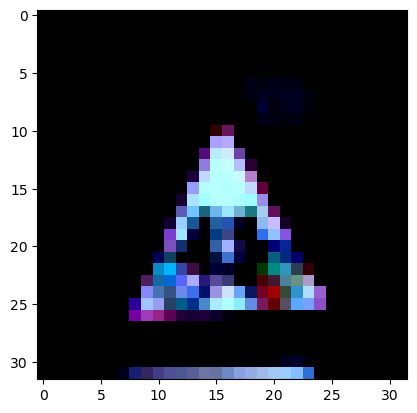

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 40
Predicted Label: 40


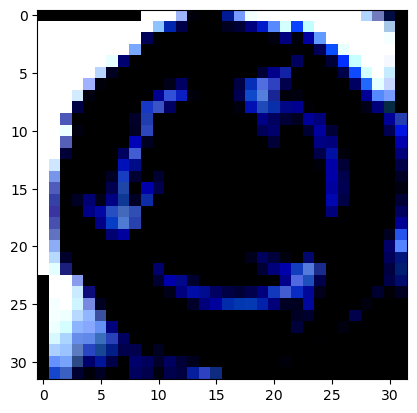

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


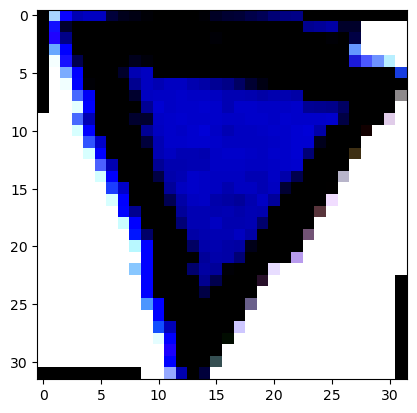

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 26
Predicted Label: 26


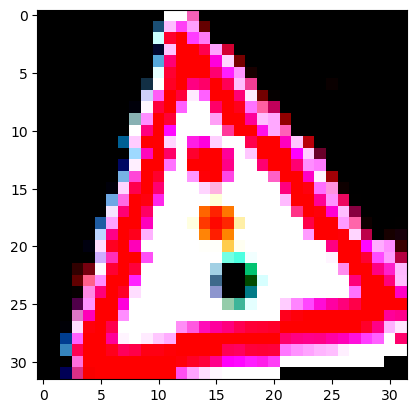

True Label: 18


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 18


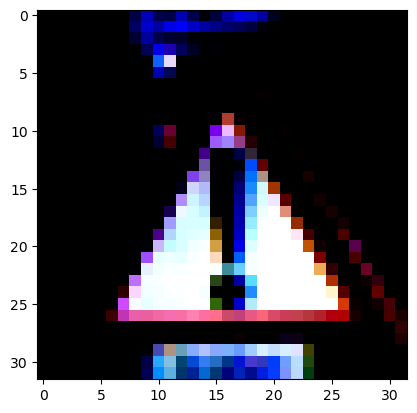

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


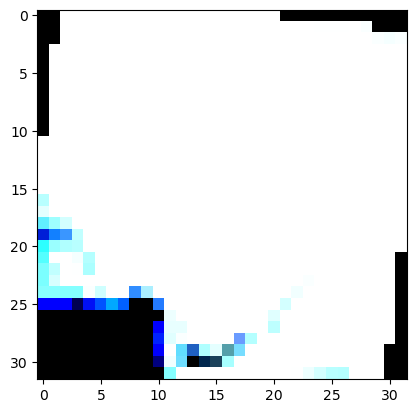

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


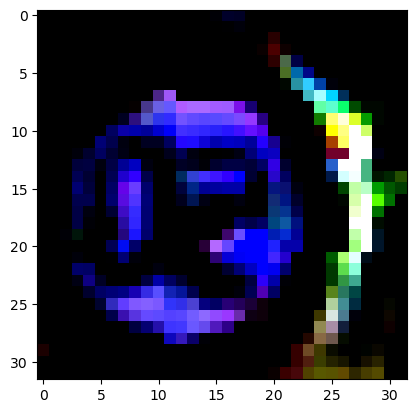

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


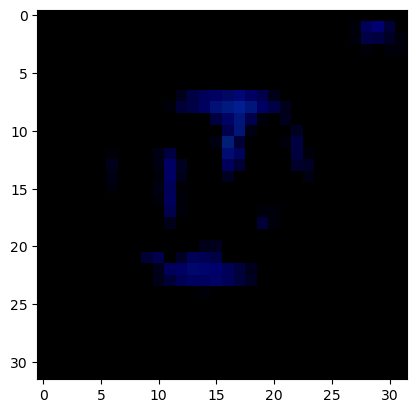

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


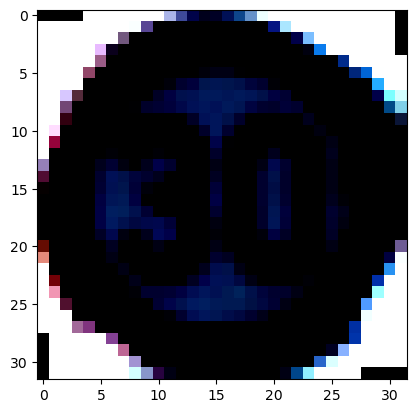

True Label: 36


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 36


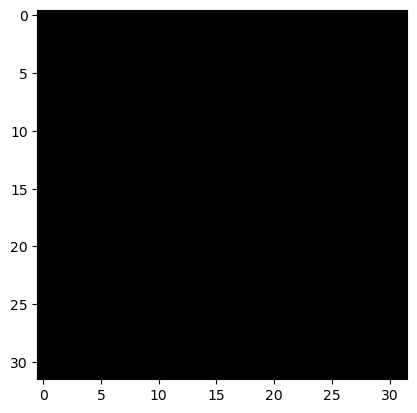

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


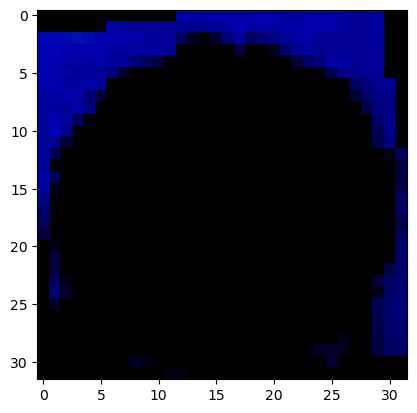

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 34
Predicted Label: 34


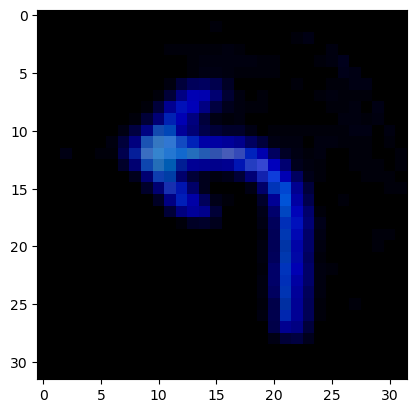

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 5


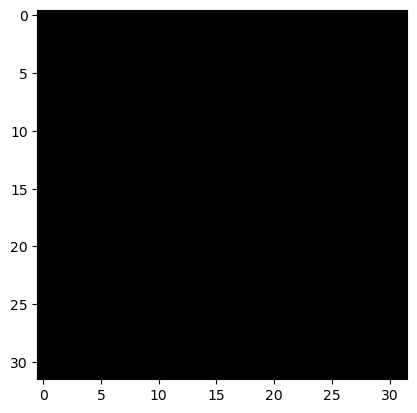

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


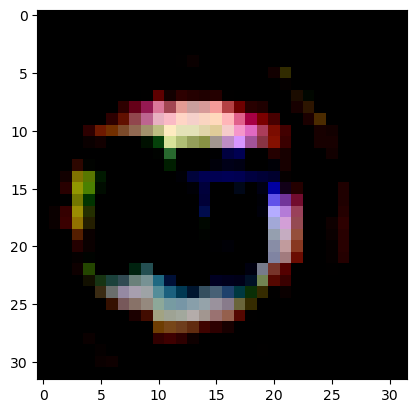

True Label: 5


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 5


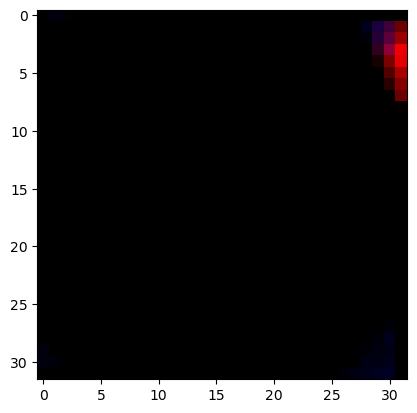

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


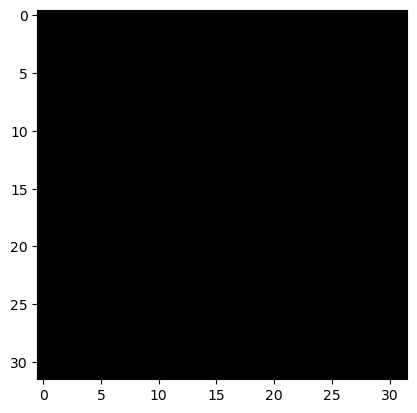

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 39
Predicted Label: 39


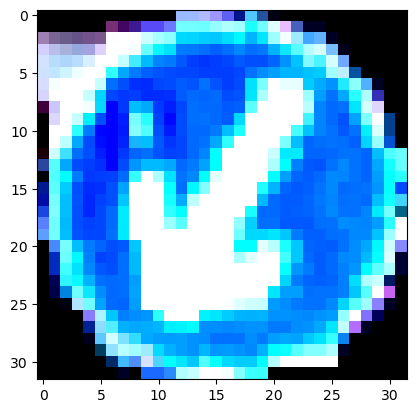

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 36
Predicted Label: 36


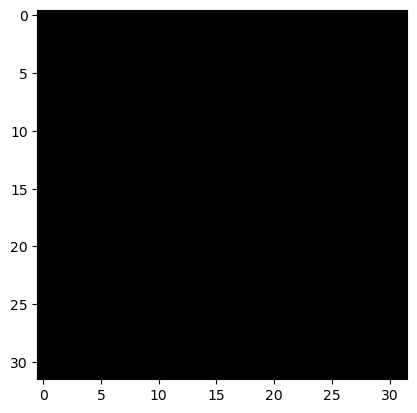

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


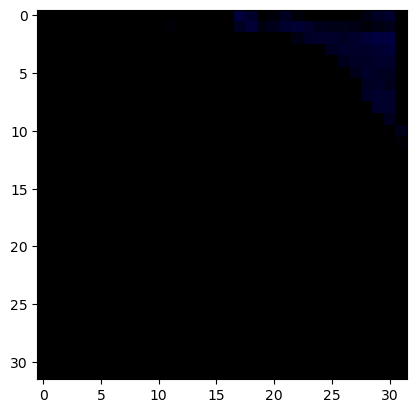

True Label: 9


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 9


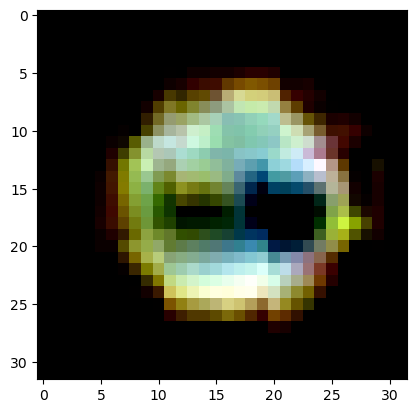

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


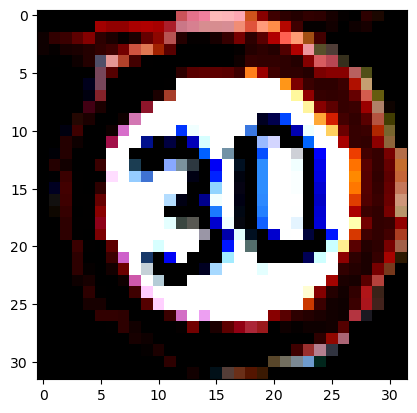

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


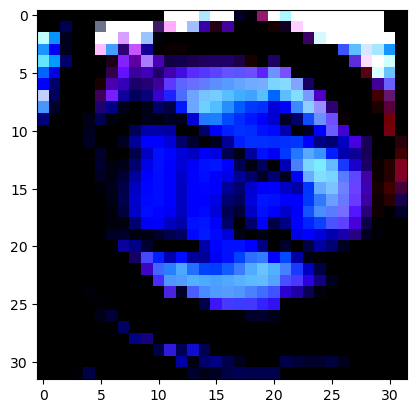

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 33
Predicted Label: 33


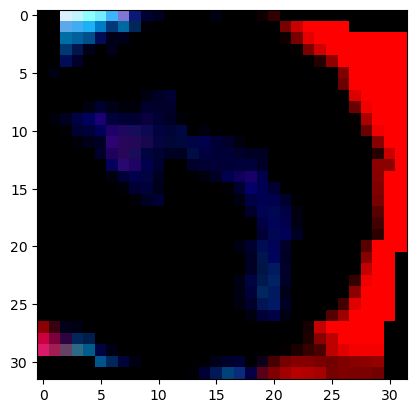

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


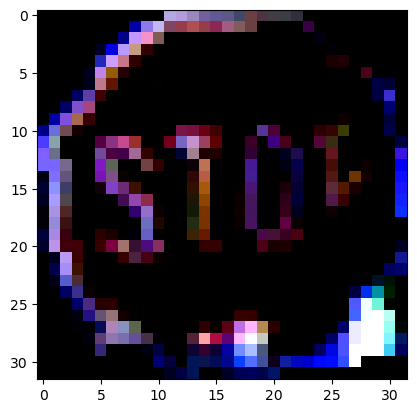

True Label: 17


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 17


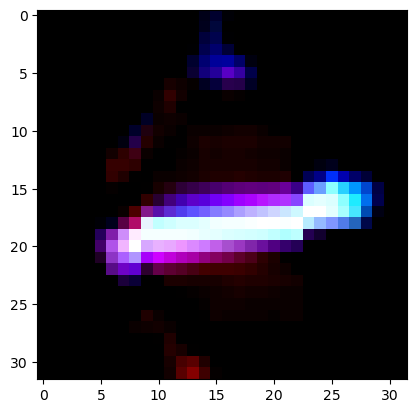

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


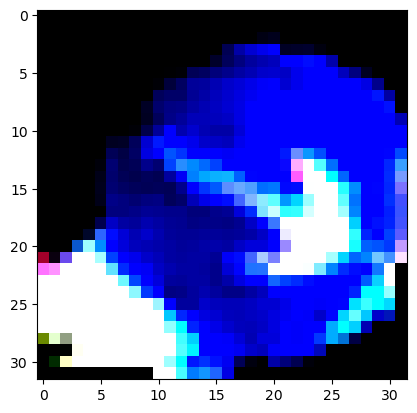

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


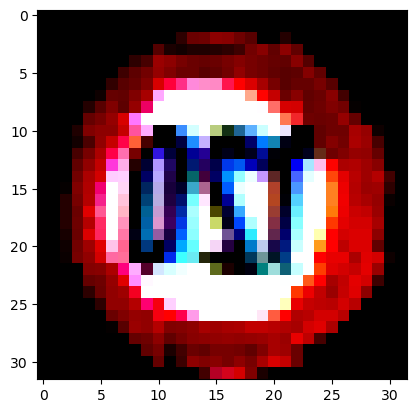

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


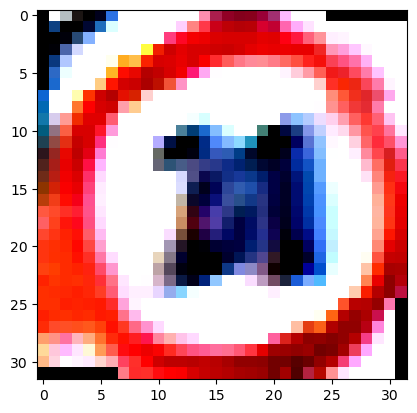

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


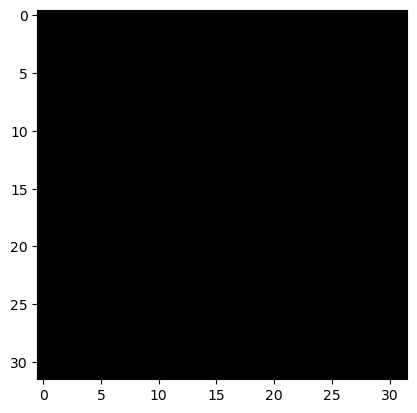

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


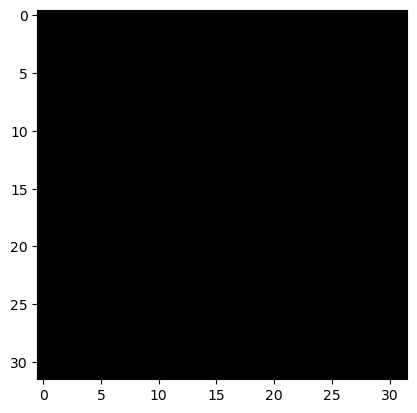

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 6
Predicted Label: 6


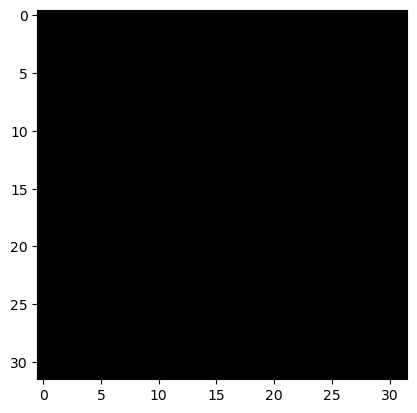

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


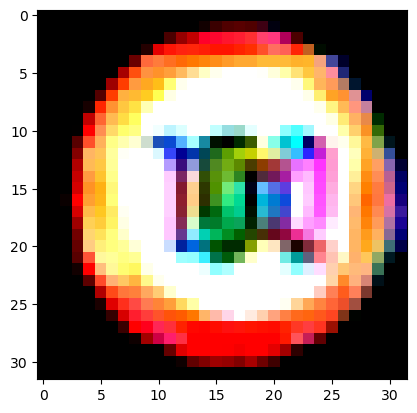

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


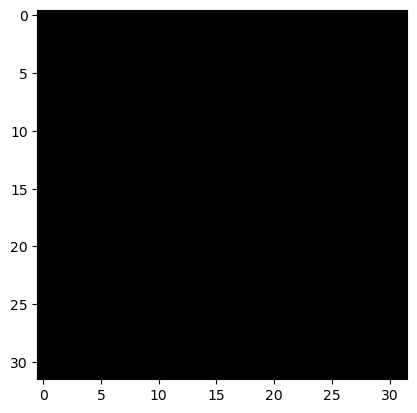

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


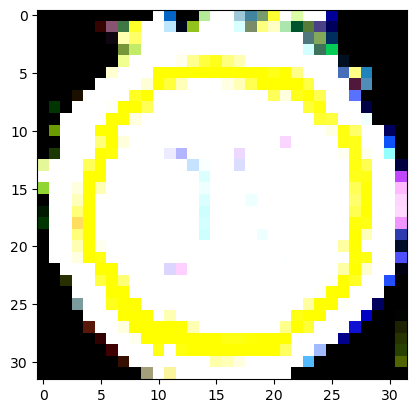

True Label: 12


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 12


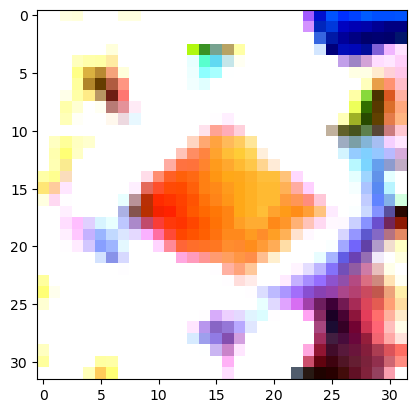

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


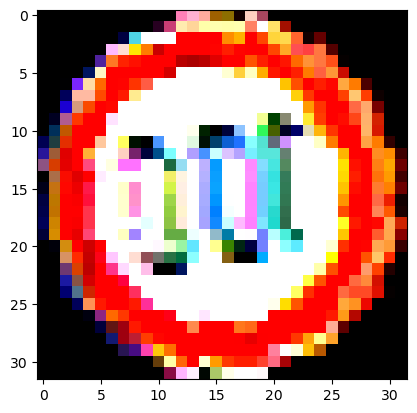

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


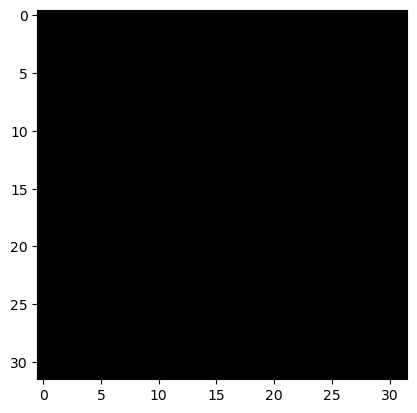

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


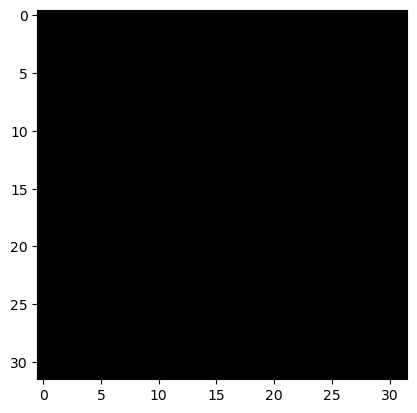

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


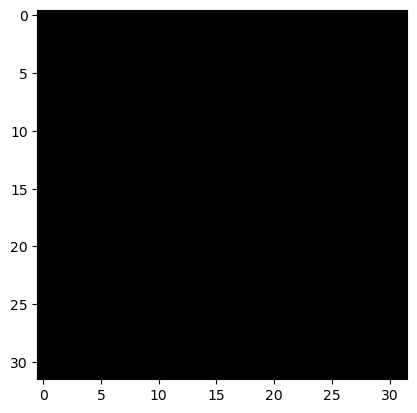

True Label: 1


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 1


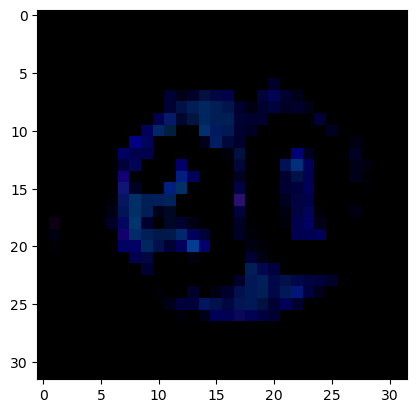

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


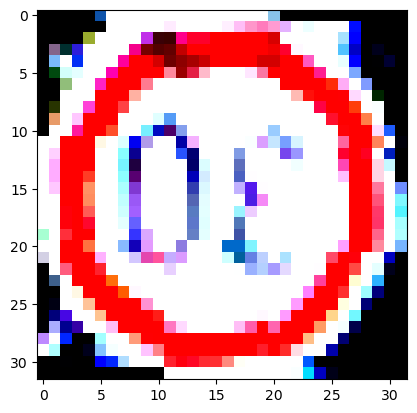

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


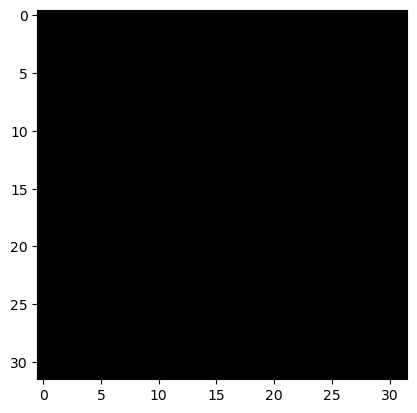

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 40
Predicted Label: 40


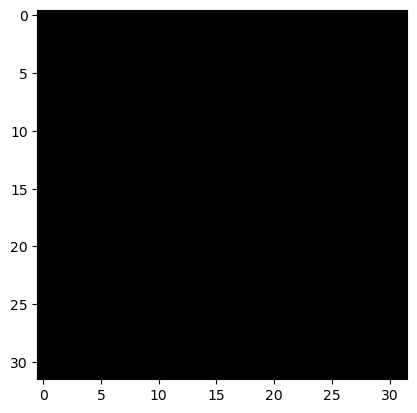

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 37
Predicted Label: 37


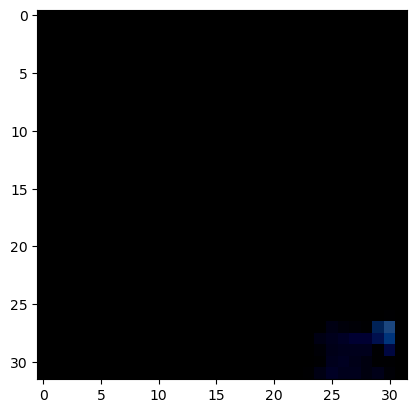

True Label: 25


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 25


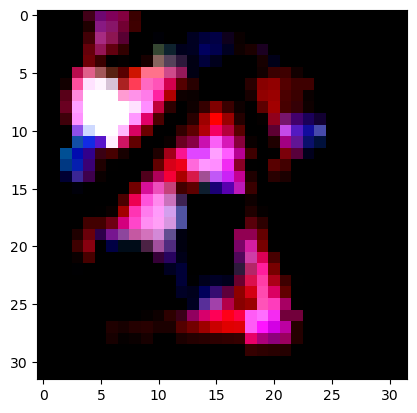

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


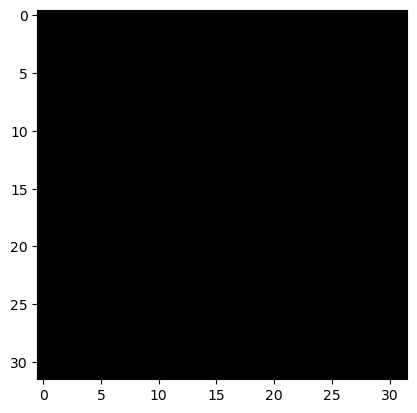

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


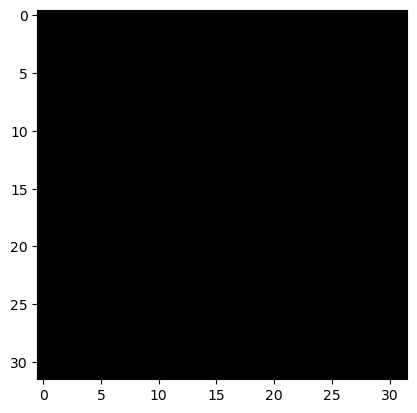

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 28
Predicted Label: 28


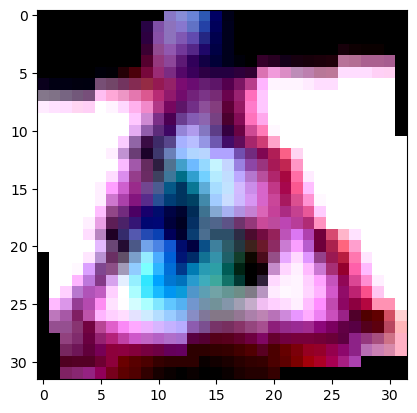

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 36
Predicted Label: 36


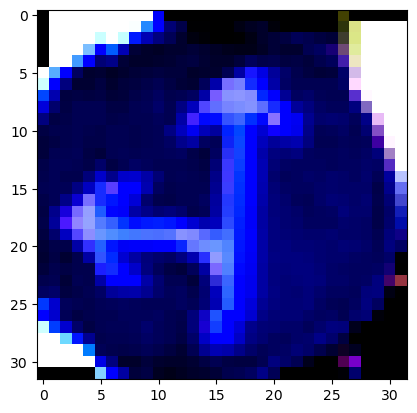

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


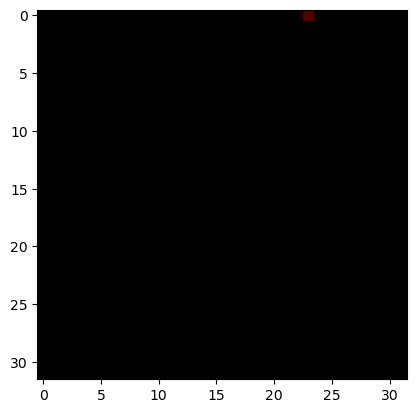

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 30
Predicted Label: 30


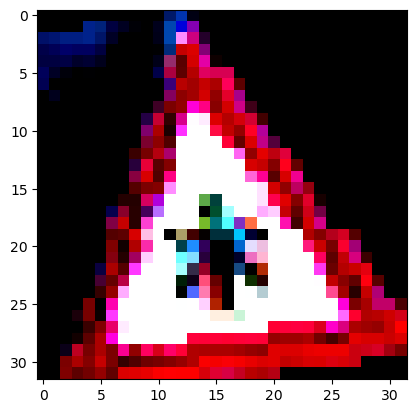

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


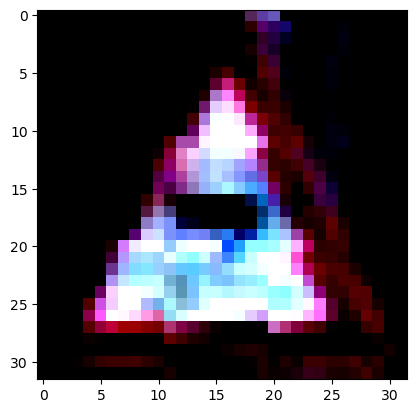

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 29
Predicted Label: 29


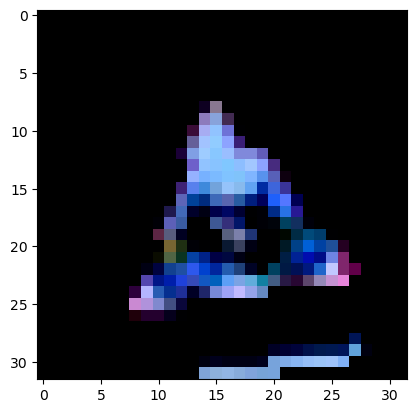

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


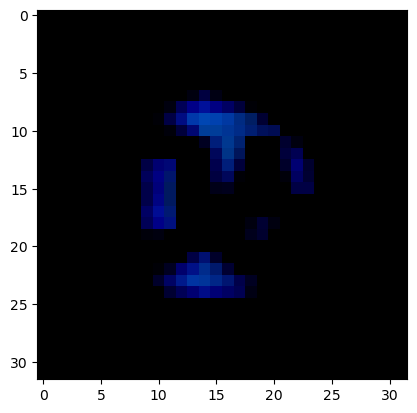

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


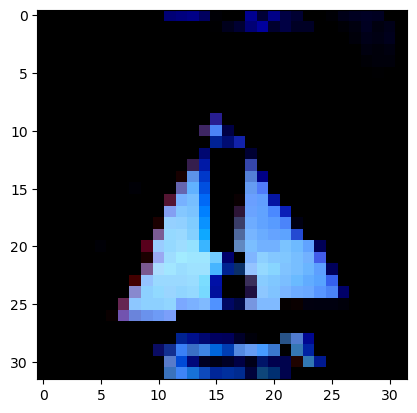

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


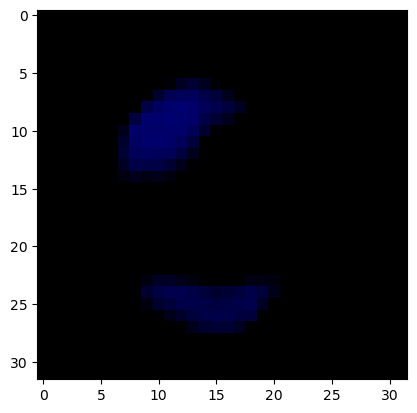

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 31
Predicted Label: 31


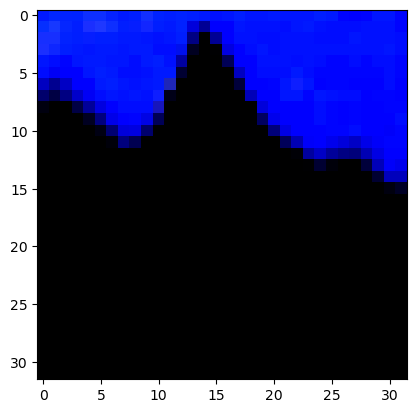

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


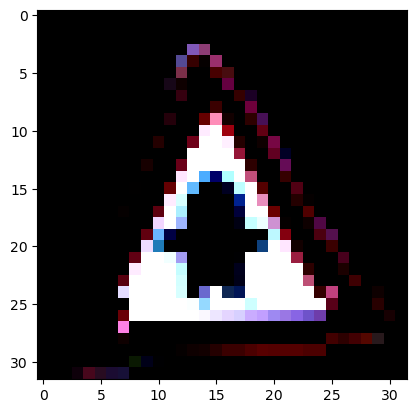

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


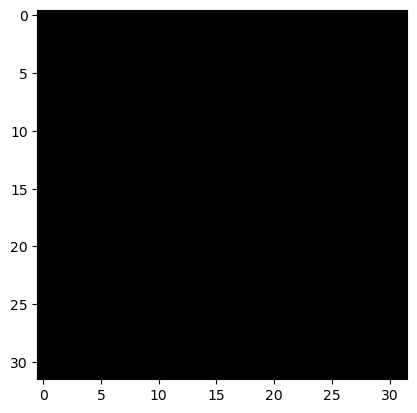

True Label: 11


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 11


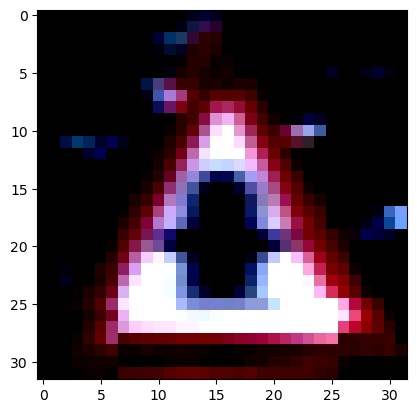

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


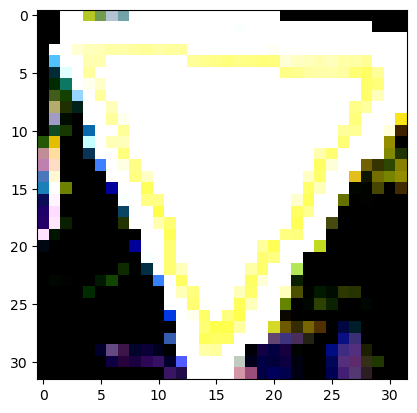

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


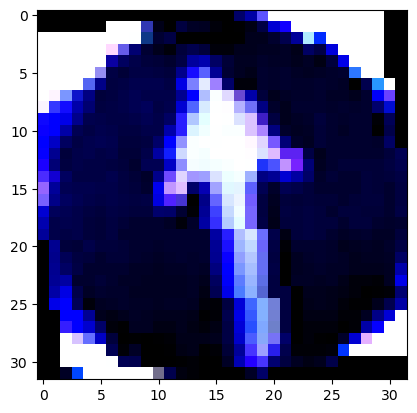

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


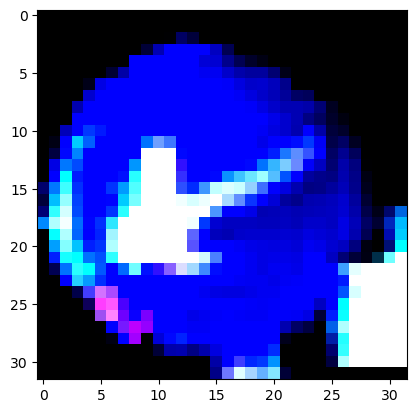

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


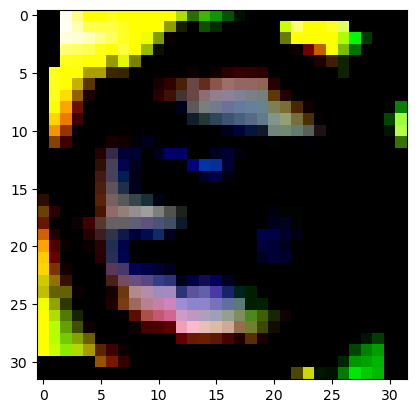

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


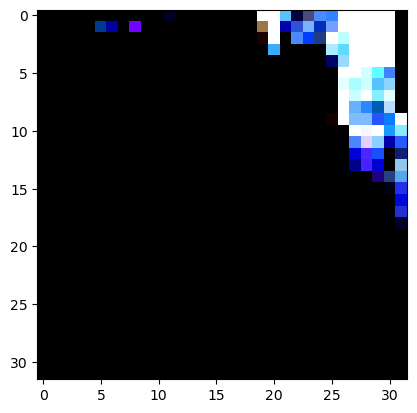

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


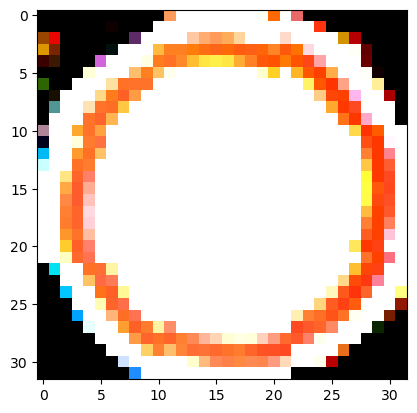

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


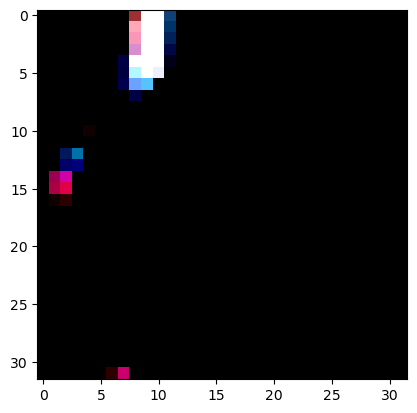

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


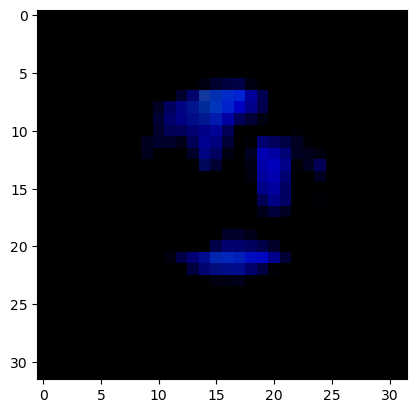

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


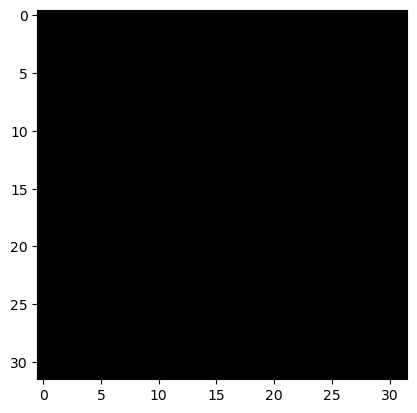

True Label: 3


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 3


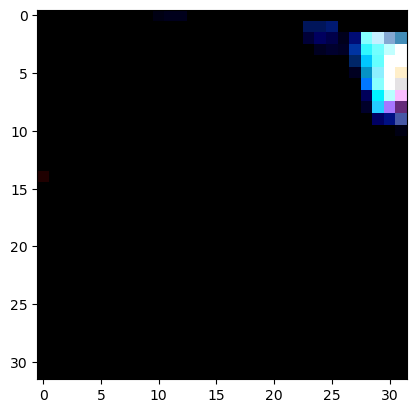

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


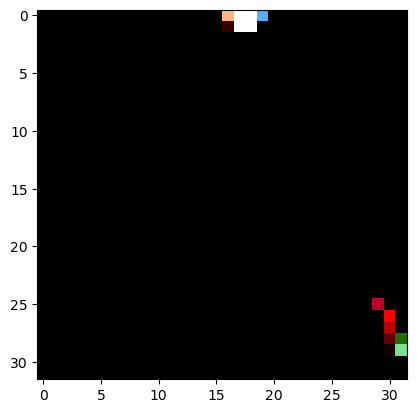

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


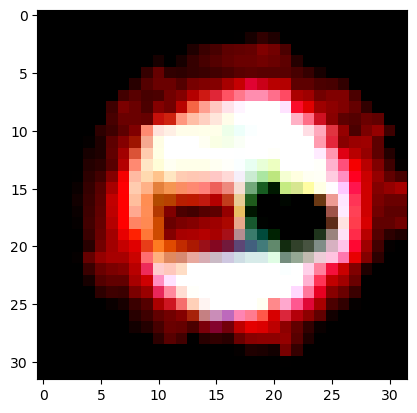

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


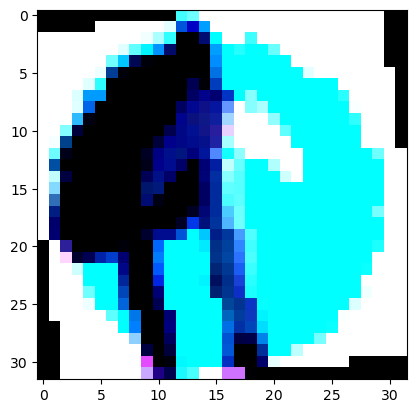

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


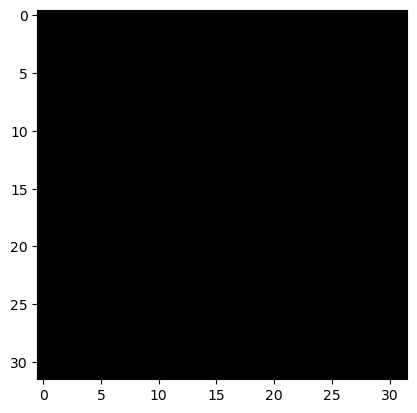

True Label: 5


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 5


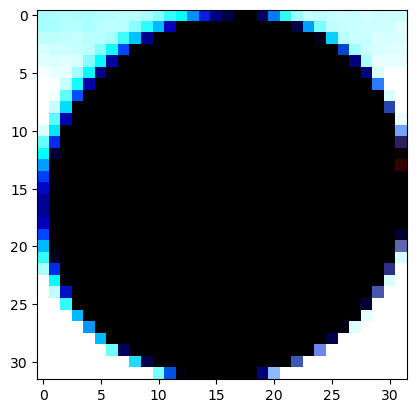

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


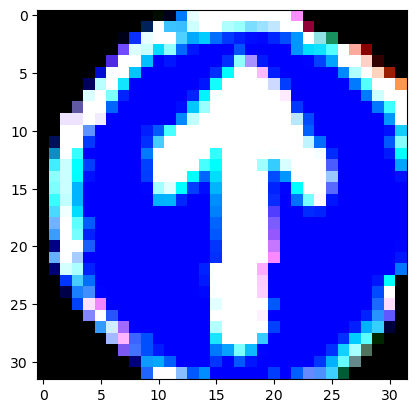

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


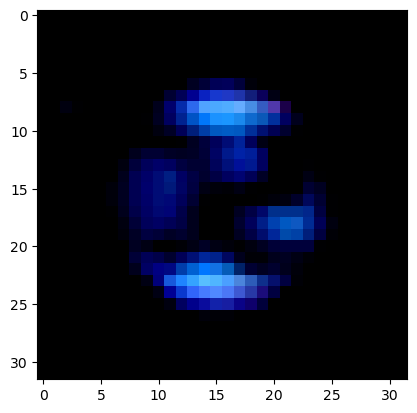

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 6
Predicted Label: 6


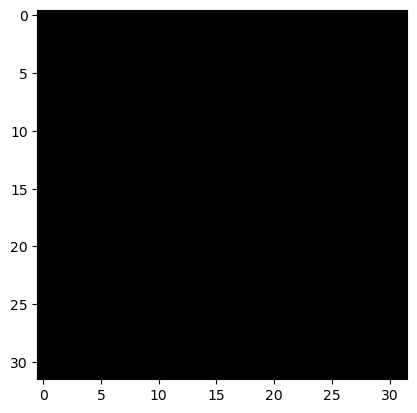

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


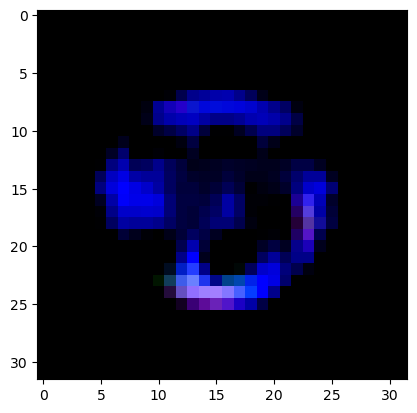

True Label: 18


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 18


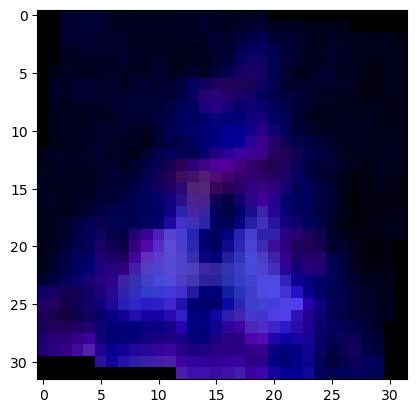

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


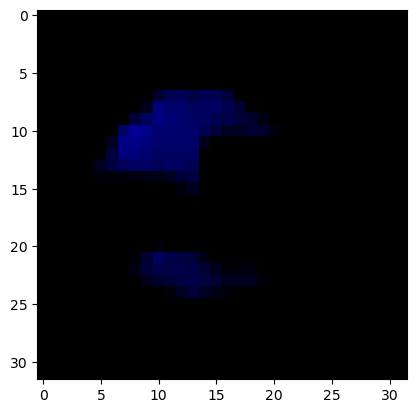

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


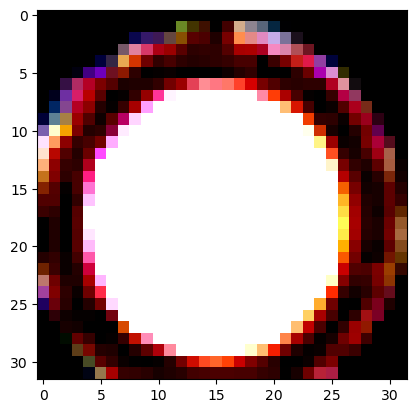

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


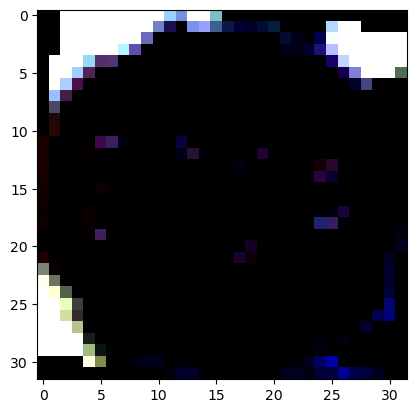

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


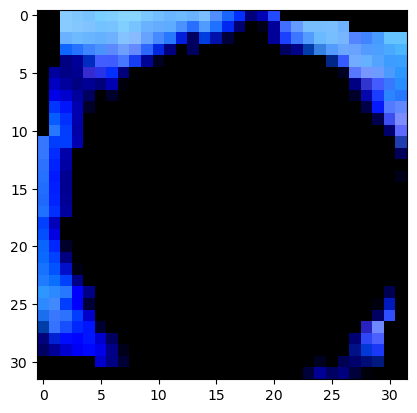

True Label: 25


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 25


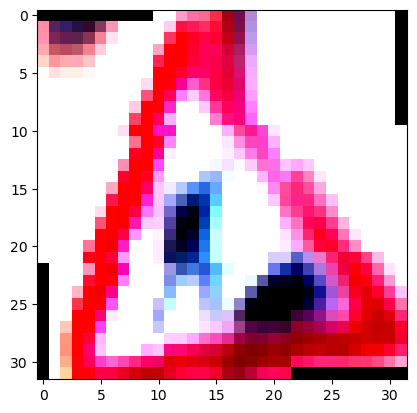

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


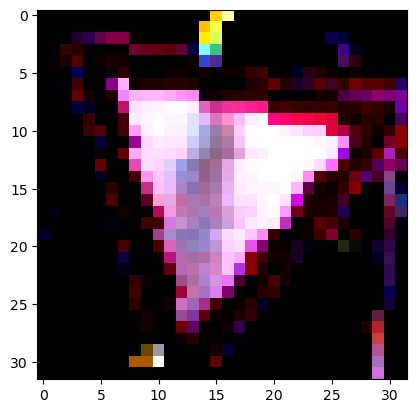

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


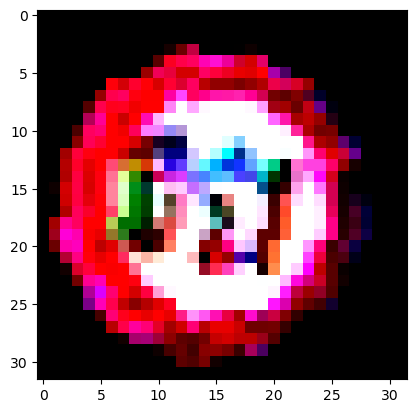

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


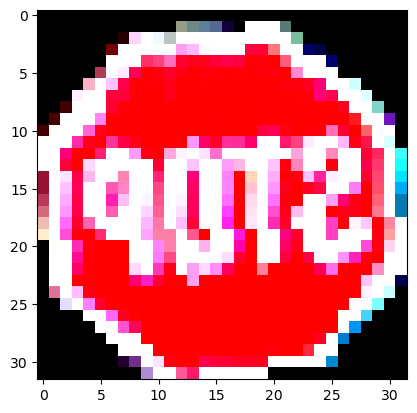

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


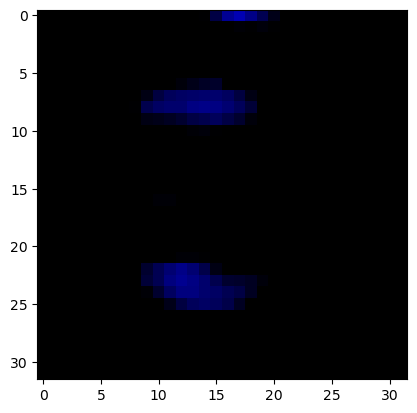

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


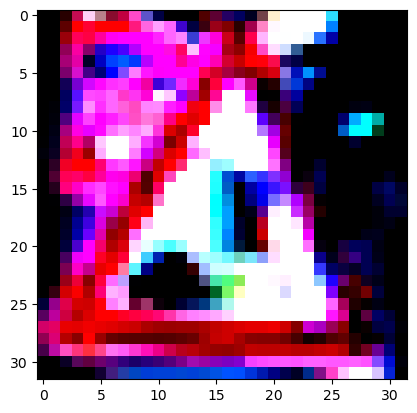

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


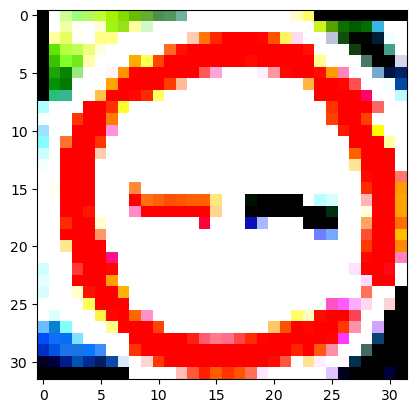

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


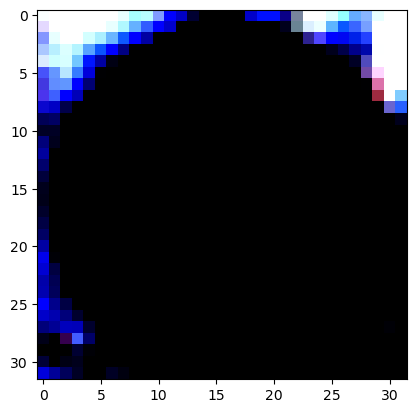

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


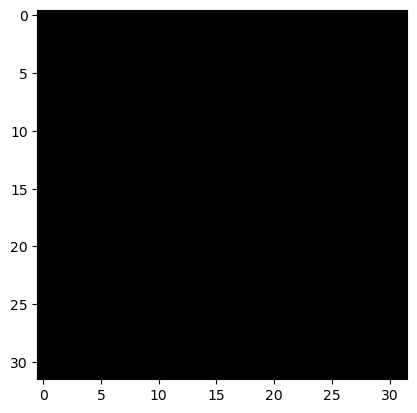

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


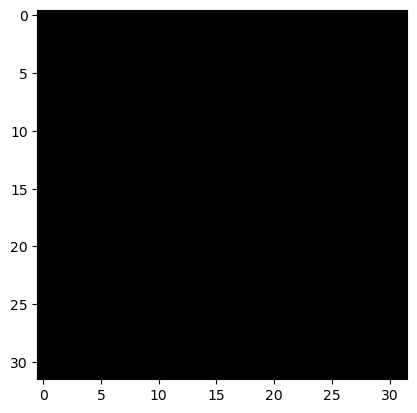

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


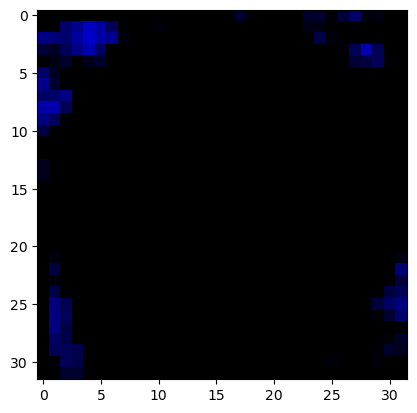

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 20
Predicted Label: 20


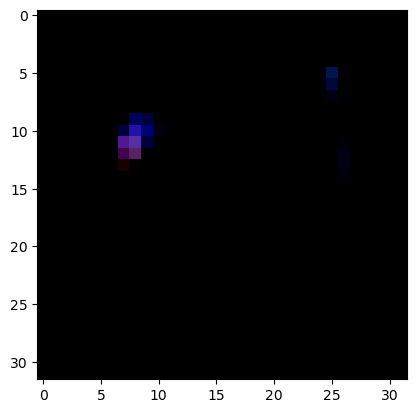

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


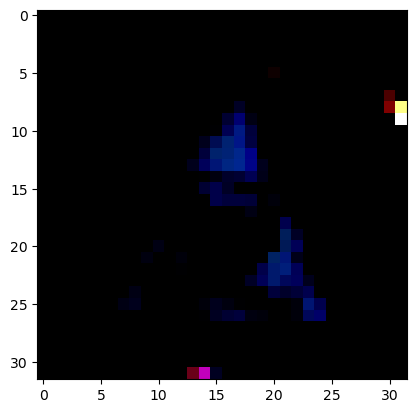

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


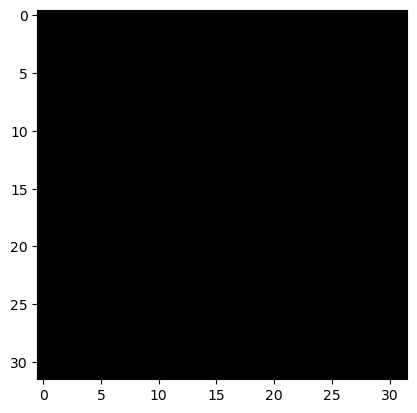

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


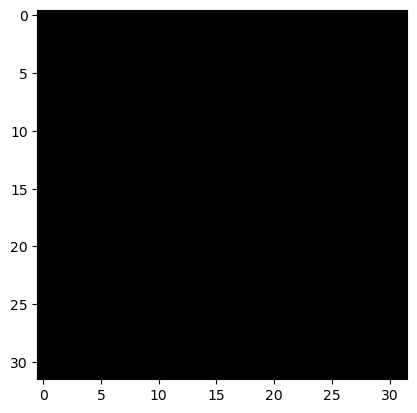

True Label: 1


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 1


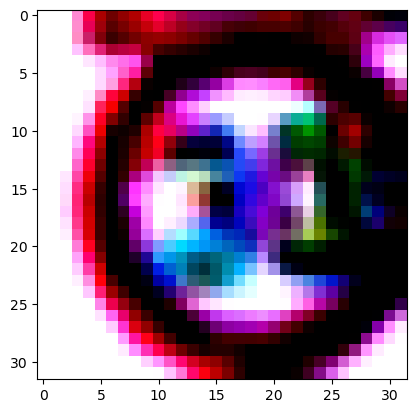

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 22
Predicted Label: 22


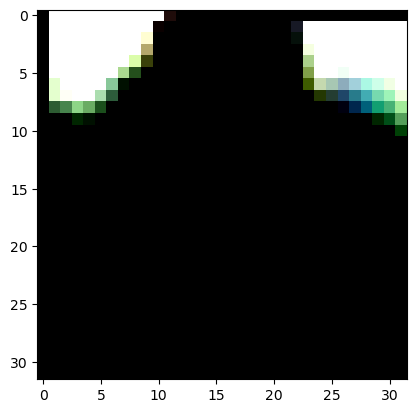

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 31
Predicted Label: 31


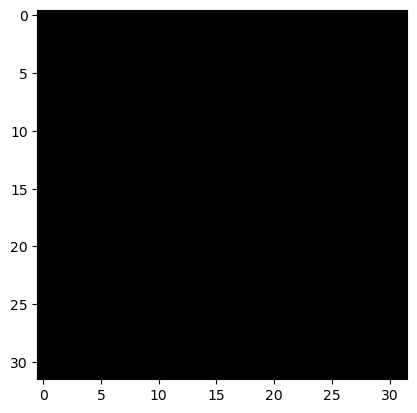

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


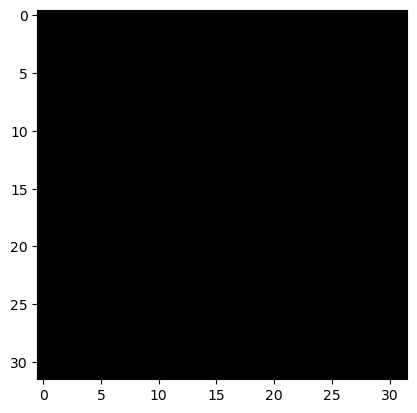

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


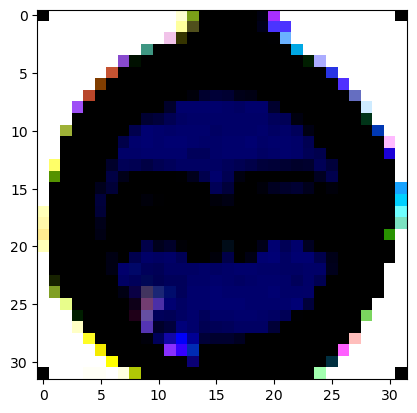

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


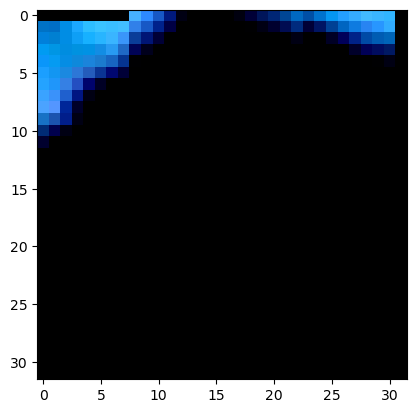

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


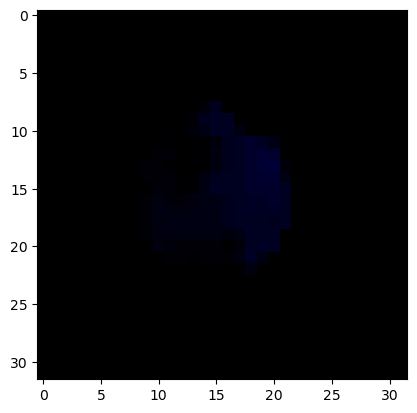

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


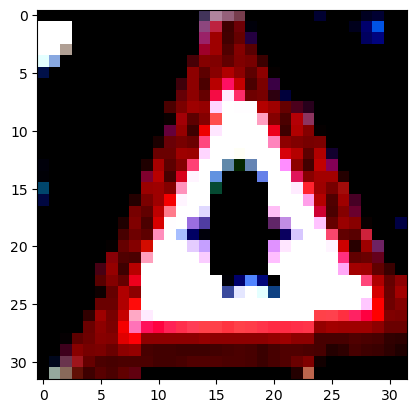

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


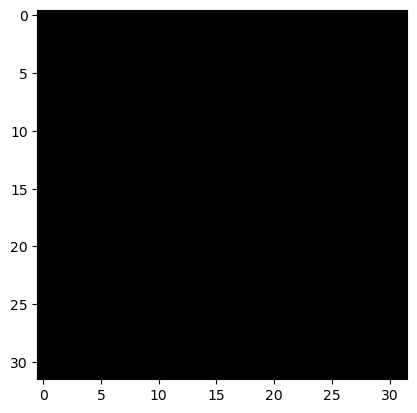

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


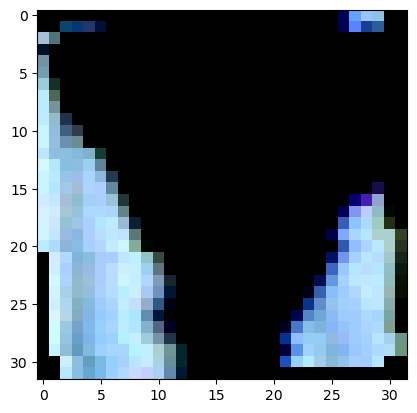

True Label: 25


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 25


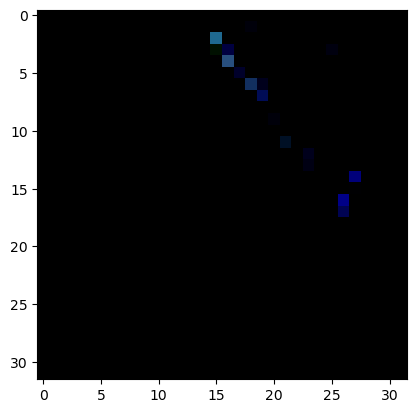

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


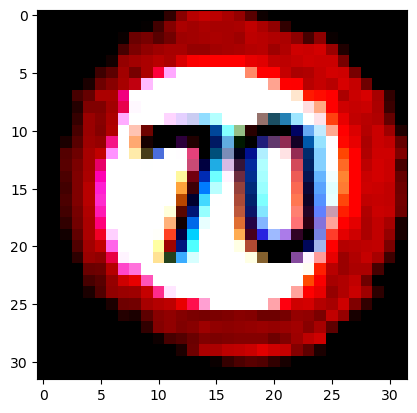

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


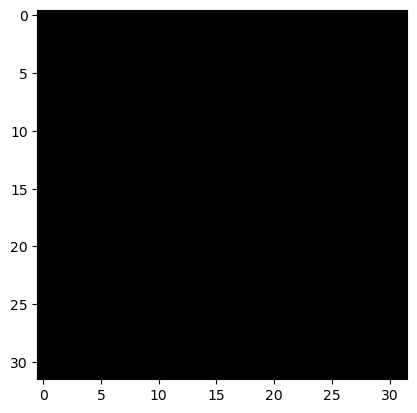

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


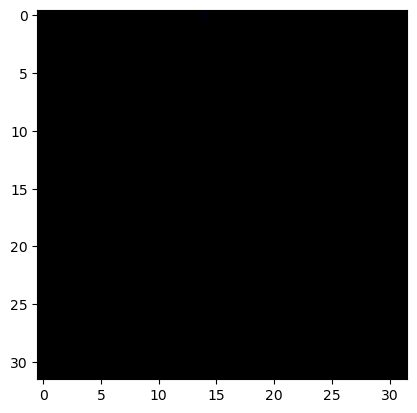

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


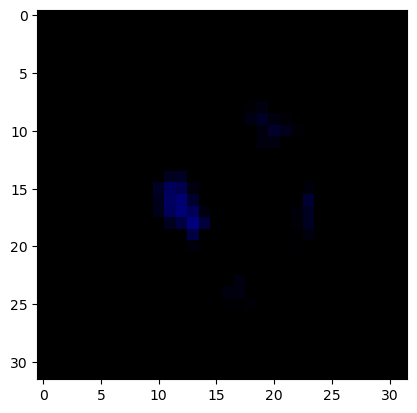

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


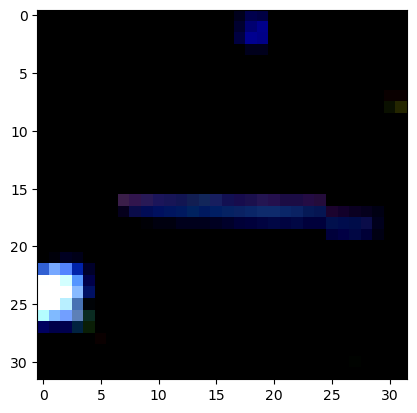

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


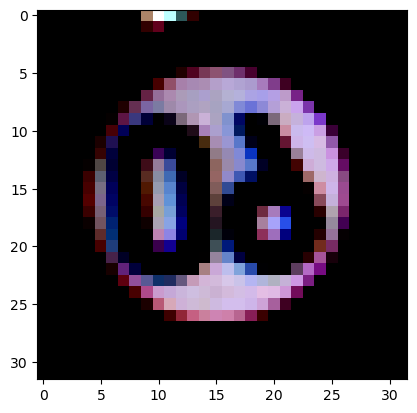

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


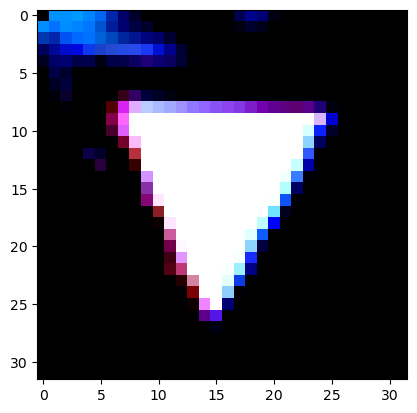

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


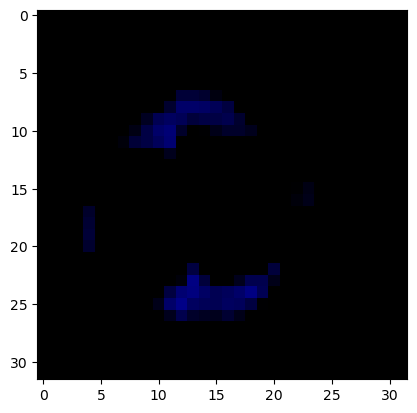

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


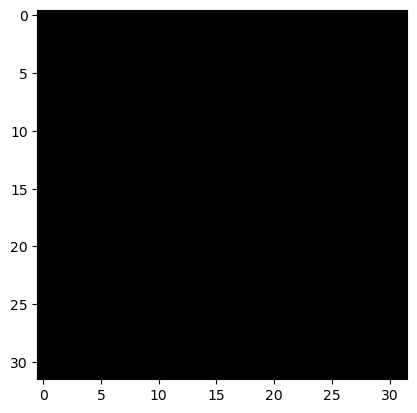

True Label: 2


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 2


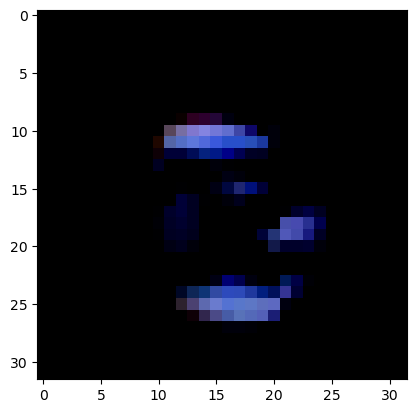

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


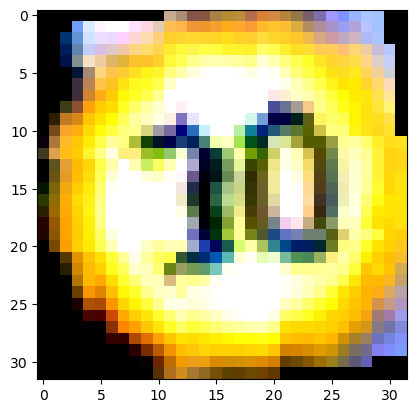

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


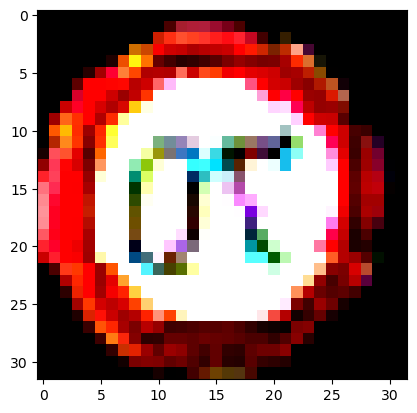

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


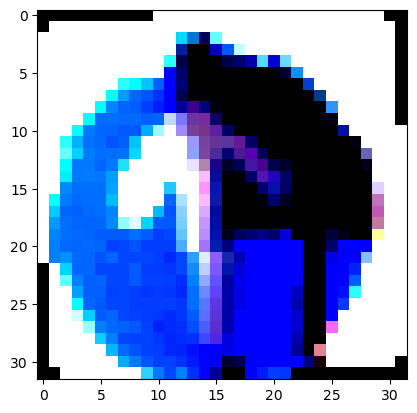

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


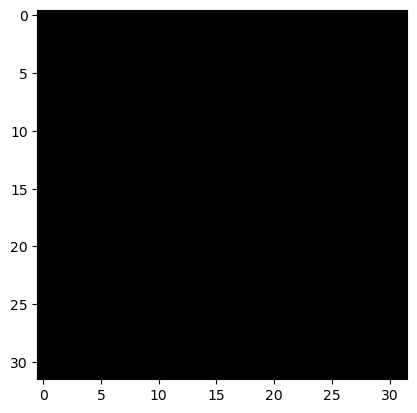

True Label: 25


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 25


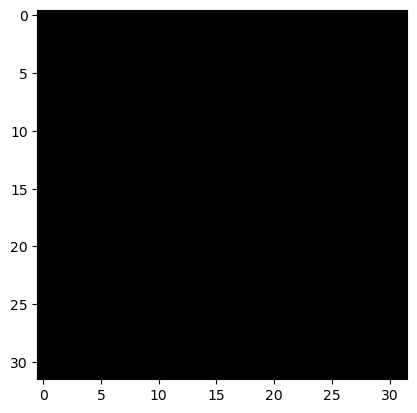

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


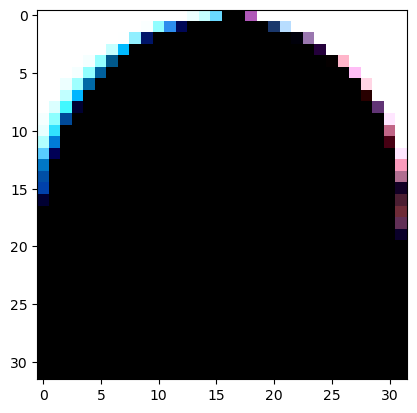

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


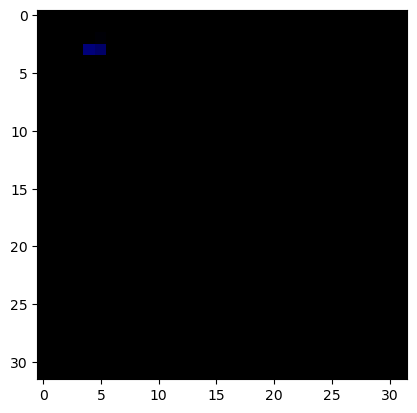

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


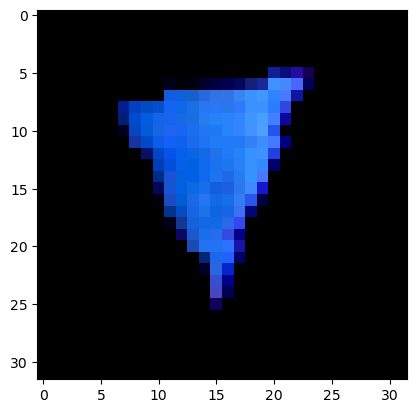

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 26
Predicted Label: 26


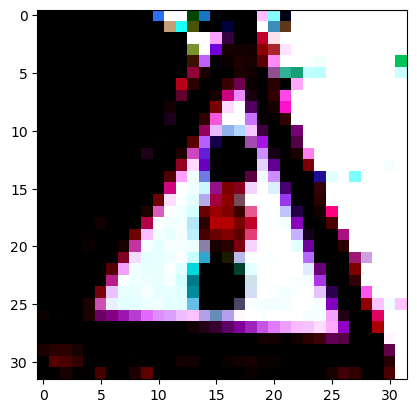

True Label: 11


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 11


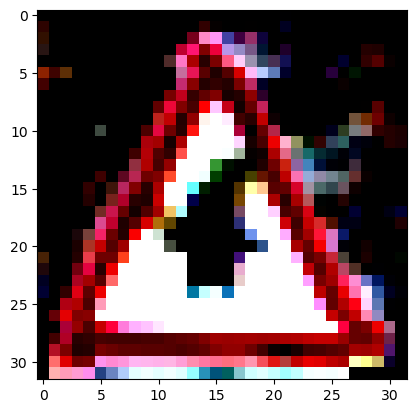

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


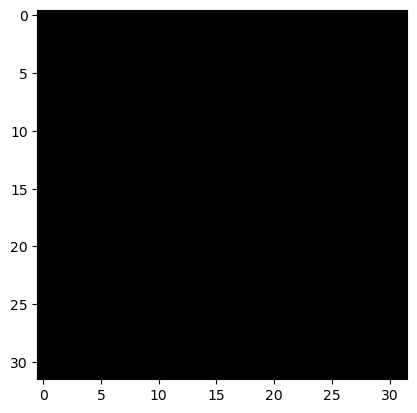

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


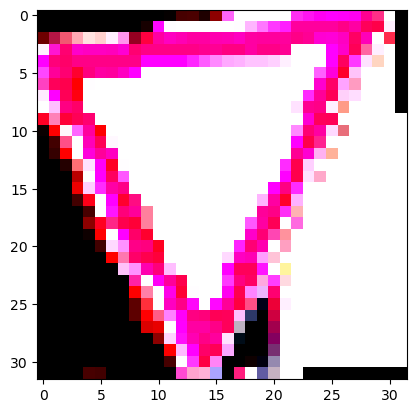

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


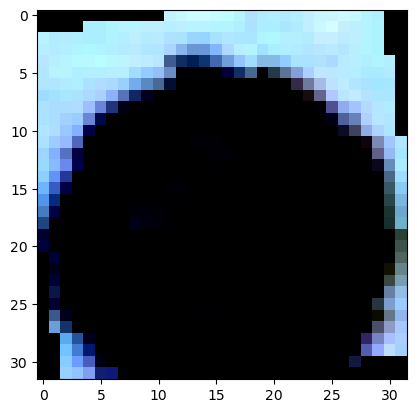

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


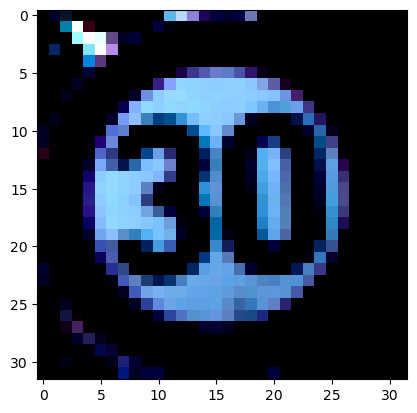

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


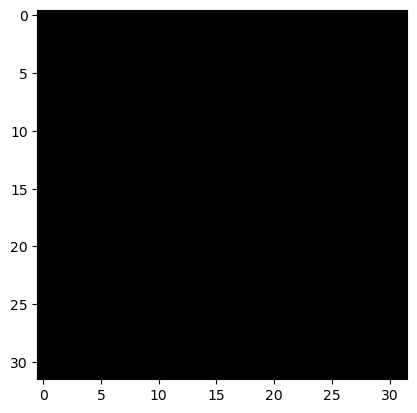

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


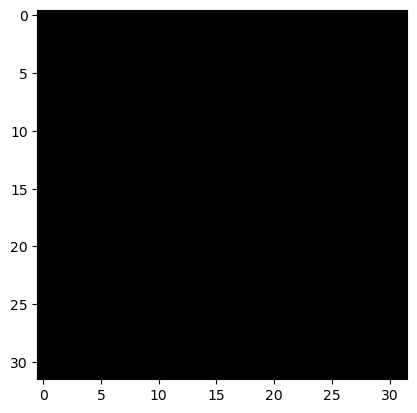

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 39
Predicted Label: 39


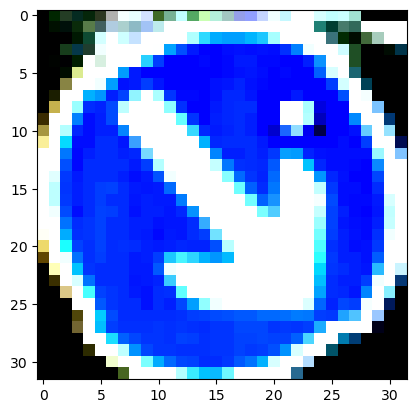

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


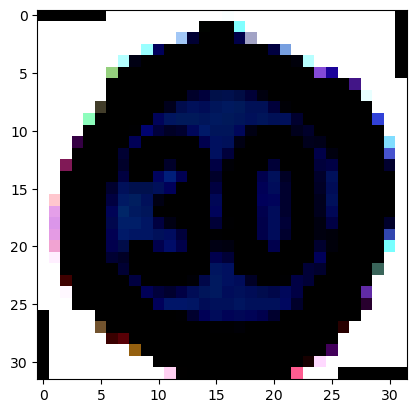

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


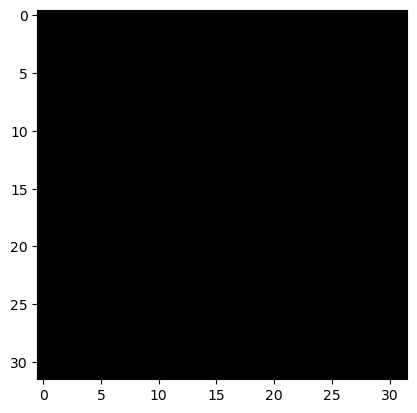

True Label: 26


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 26


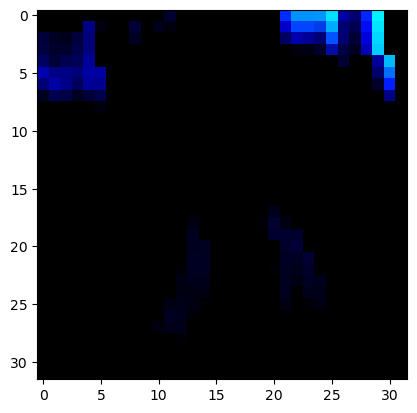

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


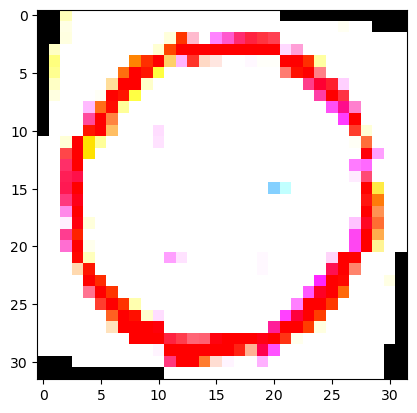

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


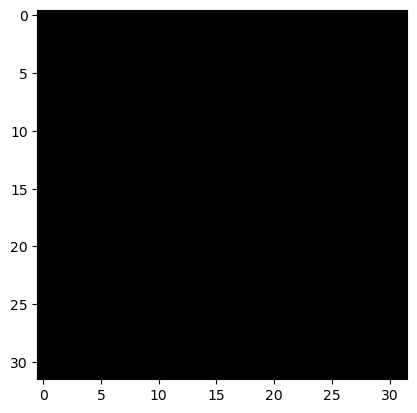

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 41
Predicted Label: 41


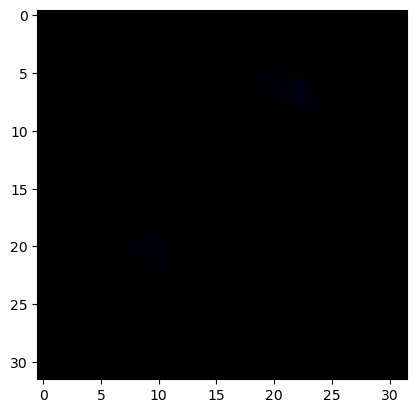

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


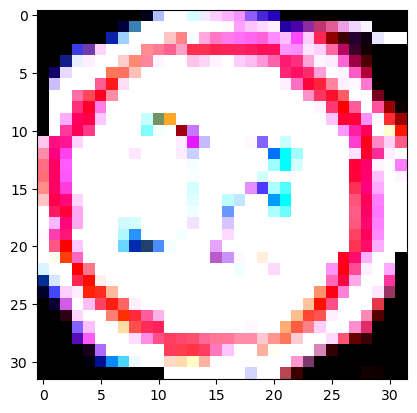

True Label: 41


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 41


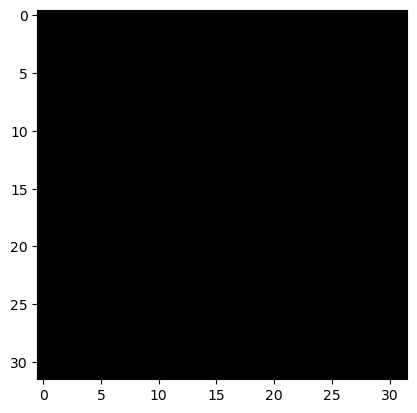

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


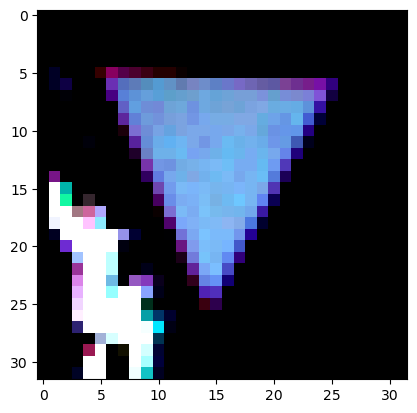

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


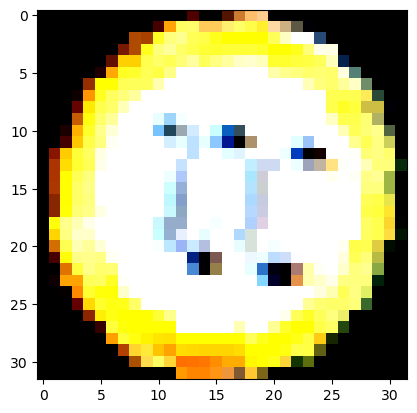

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


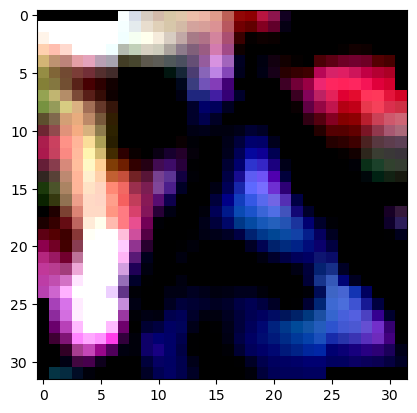

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


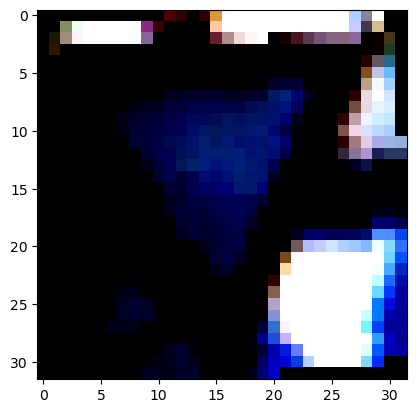

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


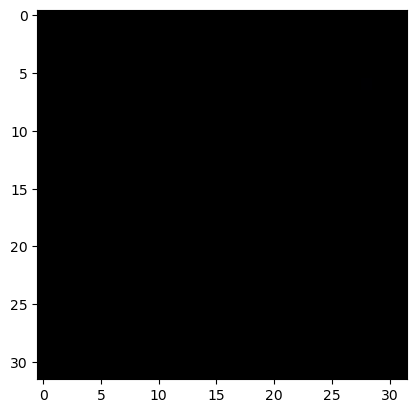

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


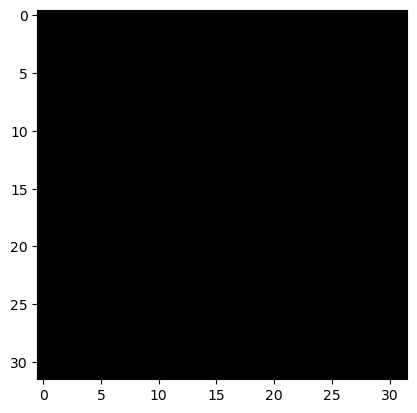

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


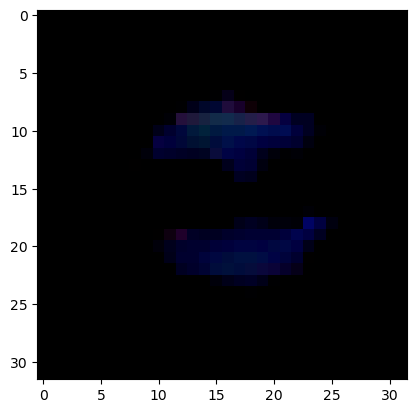

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


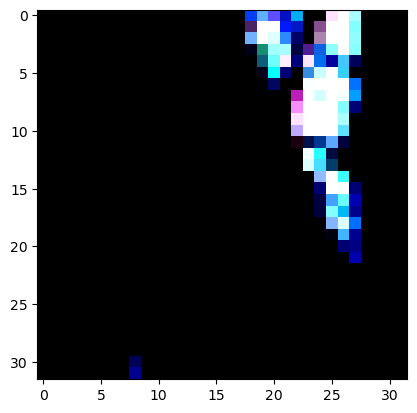

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


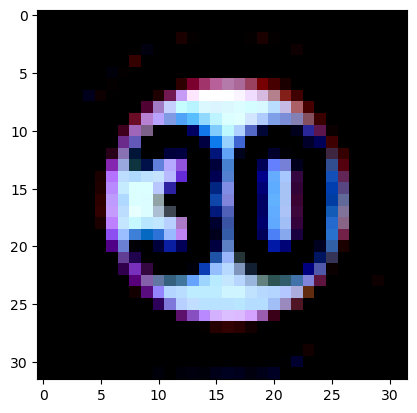

In [24]:
import matplotlib.pyplot as plt
import numpy as np

def imshow(img):
    img = img.numpy().transpose((1, 2, 0))  # Convert from Tensor image
    plt.imshow(img)
    plt.show()

model1.eval()  # Set the model to evaluation mode

with torch.no_grad():
    for data in test_loader:
        images, labels = data['image'].to(device), data['label'].to(device)
        outputs = model1(images)
        _, predicted = torch.max(outputs, 1)

        # Display images and labels
        for i in range(len(images)):
            print("True Label:", labels[i].item())
            print("Predicted Label:", predicted[i].item())
            imshow(torchvision.utils.make_grid(images[i]).cpu())
            if i == 4:  # Display first 5 images from the batch
                break

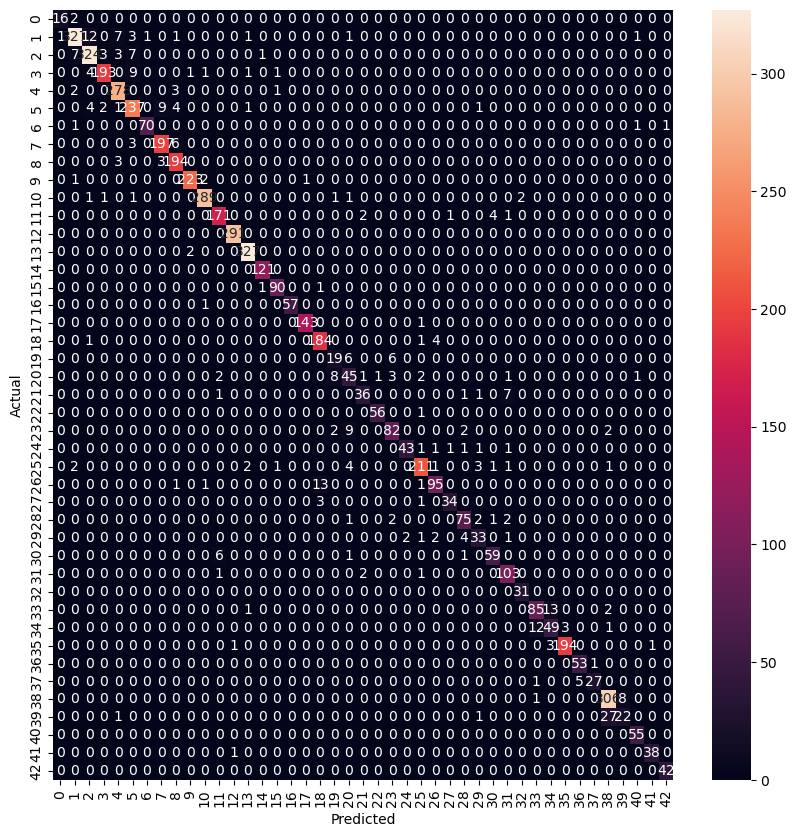

              precision    recall  f1-score   support

           0       0.94      0.89      0.91        18
           1       0.96      0.92      0.94       355
           2       0.94      0.94      0.94       345
           3       0.97      0.92      0.94       210
           4       0.95      0.98      0.96       284
           5       0.91      0.92      0.91       259
           6       0.99      0.96      0.97        73
           7       0.94      0.96      0.95       206
           8       0.93      0.97      0.95       200
           9       0.99      0.98      0.98       227
          10       0.98      0.98      0.98       296
          11       0.94      0.96      0.95       179
          12       0.99      1.00      1.00       291
          13       0.98      0.99      0.99       329
          14       0.98      1.00      0.99       121
          15       0.97      0.98      0.97        92
          16       1.00      0.98      0.99        58
          17       0.99    

In [25]:
# The code here is for evaluating the performance of a neural network model 
# trained in PyTorch, using test data to generate a confusion matrix 
# and a classification report:
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns

model2.eval() 
y_pred2 = []
y_true2 = []

# This no_grad() is used to stop computing and storing gradients, 
# which reduces memory consumption and speeds up computation, 
# as gradients are not needed for evaluation.
with torch.no_grad():
    for data in test_loader:
        images, labels = data['image'].to(device), data['label'].to(device)
        outputs = model2(images)
        _, predicted = torch.max(outputs, 1)
        y_pred2.extend(predicted.tolist())
        y_true2.extend(labels.tolist())

# Generate the confusion matrix
cm = confusion_matrix(y_true2, y_pred2)

# Plot the confusion matrix
plt.figure(figsize=(10,10))
sns.heatmap(cm, annot=True, fmt="d")
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.show()

print(classification_report(y_true2, y_pred2))

For the training and test results.
We can see that there is a slight inconsistency over the predicted and actual resalt in label 19 and 20.
After digging through the datasets.
I found out the reason causing this inconsistency is that we implemented the Random horizontal flip which made these two classes of images hard to inference by the model.


In [26]:
# The code here is for evaluating the performance of a 
# classification model using metrics like accuracy, 
# precision, recall, and F1-score. 
# These metrics are calculated using the predictions made by 
# the model (y_pred2) and the actual labels (y_true2)
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

accuracy2 = accuracy_score(y_true2, y_pred2)
precision2 = precision_score(y_true2, y_pred2, average='weighted', zero_division = 1)
recall2 = recall_score(y_true2, y_pred2, average='weighted')
f12 = f1_score(y_true2, y_pred2, average='weighted')

print(f"Accuracy: {accuracy2:.4f}")
print(f"Precision: {precision2:.4f}")
print(f"Recall: {recall2:.4f}")
print(f"F1-Score: {f12:.4f}")

accuracy_values.append(float(accuracy2 * 100))
precision_values.append(float(precision2 * 100))
recall_values.append(float(recall2 * 100))
f1score_values.append(float(f12 * 100))

Accuracy: 0.9393
Precision: 0.9390
Recall: 0.9393
F1-Score: 0.9384


In [27]:
model2.eval()
import time

num_runs = 10
total_time = 0

with torch.no_grad():
    for _ in range(num_runs):
        batch_time = 0
        for data in test_loader:
            images, labels = data['image'].to(device), data['label'].to(device)
            start_time = time.time()  # Start time for the batch
            outputs = model2(images)
            end_time = time.time()  # End time for the batch
            batch_time += (end_time - start_time)
        total_time += batch_time

average_inference_time = total_time / (num_runs * len(test_loader))
print(f"Average inference time per batch over {num_runs} runs: {average_inference_time} seconds")

Average_inference_time.append(average_inference_time)

Average inference time per batch over 10 runs: 0.017393965824790622 seconds


### ShuffleNet

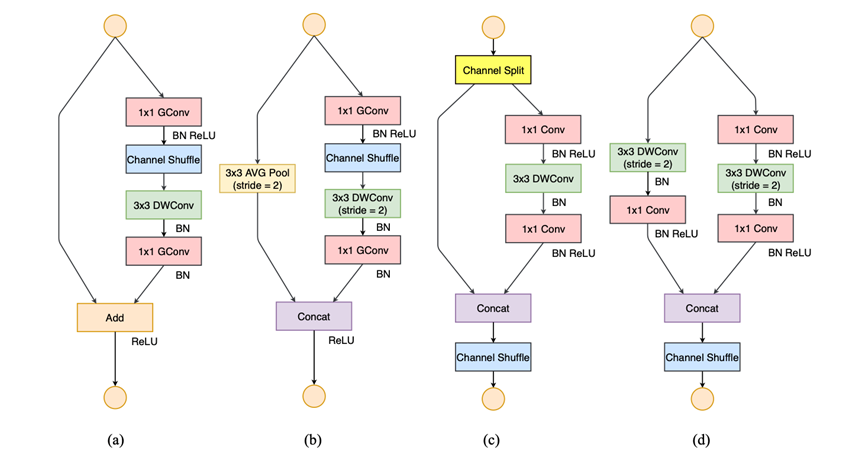
https://pytorch.org/hub/pytorch_vision_shufflenet_v2/

ShuffleNetV2 is designed to be a lightweight neural network architecture, particularly well-suited for resource-constrained environments such as mobile devices and edge devices. 

False
Epoch 1, Training loss: 2.229129098789953, Training Accuracy: 32.693288639510314%, Validation Loss: 1.4388163335945294, Validation Accuracy: 52.01496344159157%
Epoch 2, Training loss: 1.2004909209716015, Training Accuracy: 59.68811484369307%, Validation Loss: 0.902285340687503, Validation Accuracy: 68.6277843904098%
Epoch 3, Training loss: 0.826706565204478, Training Accuracy: 72.0615025868979%, Validation Loss: 0.682802111234354, Validation Accuracy: 77.07872810746471%
Epoch 4, Training loss: 0.631396875306443, Training Accuracy: 78.68177512205786%, Validation Loss: 0.5551358876021012, Validation Accuracy: 81.36371365414045%
Epoch 5, Training loss: 0.5071784372513111, Training Accuracy: 82.97019602127814%, Validation Loss: 0.43265004812375357, Validation Accuracy: 85.71671484441421%
Epoch 6, Training loss: 0.4266593680480421, Training Accuracy: 85.74291335713765%, Validation Loss: 0.3661360571403866, Validation Accuracy: 88.08025845944567%
Epoch 7, Training loss: 0.3667217837277

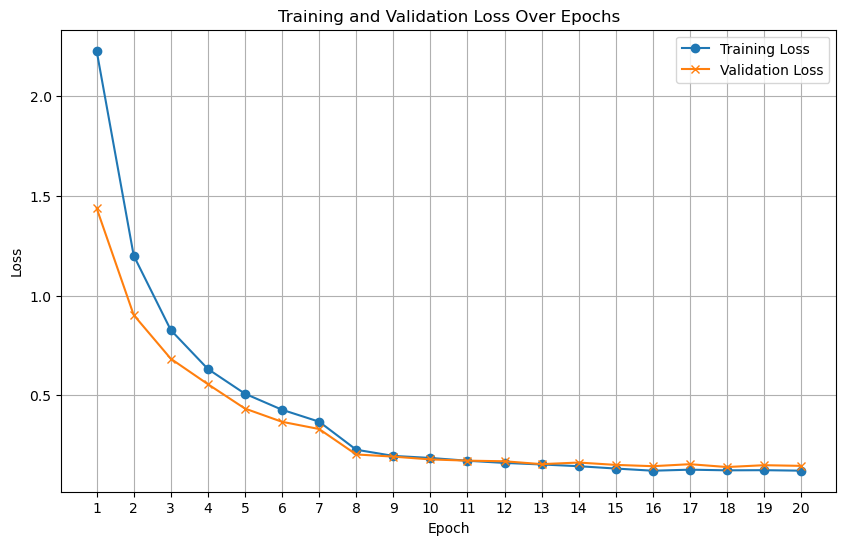

In [28]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler
import torchvision.models as models
import ssl
ssl._create_default_https_context = ssl._create_unverified_context

# use ShuffleNetV2 x1.0 model
model3 = models.shufflenet_v2_x1_0()
num_classes = 43

# Modify the classifier (fully connected layer) for your specific number of classes
model3.fc = nn.Linear(model3.fc.in_features, num_classes)


model3 = model3.to(device)
# Define the loss function and the optimizer
criterion = nn.CrossEntropyLoss()

optimizer = optim.Adam(model3.parameters(), lr=0.0008)
# Optional: Learning rate scheduler

scheduler = lr_scheduler.StepLR(optimizer, step_size=7, gamma=0.1)



print(torch.backends.mps.is_available())
num_epochs = 20  # Set the number of epochs

# Epoch data
epochs = list(range(1, 21))
training_loss = []
validation_loss = []

for epoch in range(num_epochs):
    # Training Phase
    model3.train()  # Set the model to training mode
    running_loss = 0.0
    correct_train = 0
    total_train = 0

    for i, data in enumerate(train_loader, 0):
        inputs, labels = data['image'].to(device), data['label'].to(device)
        optimizer.zero_grad()
        outputs = model3(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        _, predicted = torch.max(outputs.data, 1)
        total_train += labels.size(0)
        correct_train += (predicted == labels).sum().item()

    train_accuracy = 100 * correct_train / total_train

    # Validation Phase
    model3.eval()  # Set the model to evaluation mode
    val_loss = 0.0
    correct = 0
    total = 0
    with torch.no_grad():
        for data in val_loader:
            images, labels = data['image'].to(device), data['label'].to(device)
            outputs = model3(images)
            loss = criterion(outputs, labels)
            val_loss += loss.item()
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
            
    training_loss.append(running_loss/len(train_loader))
    validation_loss.append(val_loss/len(val_loader))

    scheduler.step()
    print(f'Epoch {epoch+1}, Training loss: {running_loss/len(train_loader)}, Training Accuracy: {train_accuracy}%, Validation Loss: {val_loss/len(val_loader)}, Validation Accuracy: {100 * correct / total}%')

print('Finished Training')

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(epochs, training_loss, label='Training Loss', marker='o')
plt.plot(epochs, validation_loss, label='Validation Loss', marker='x')
plt.title('Training and Validation Loss Over Epochs')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.show()

I set the model’s final layer to output 43 classes, matching the dataset.
Then modifie the classifier (fully connected layer) to output predictions for 43 classes in our task.
I move the model to the specified device to improve the operating speed.
And define the CrossEntropyLoss as the loss function, this loss is commonly used for classification tasks.
Define the Adam optimizer with a specific learning rate 0.0008. Adjusting the learning rate can improve out final accuracy.
Define a learning rate scheduler that decreases the learning rate by a factor of 0.1 every 7 epochs. This can help improve convergence during training.
Without the scheduler, the accuracy is 91%, which is lower than our final result 95%.


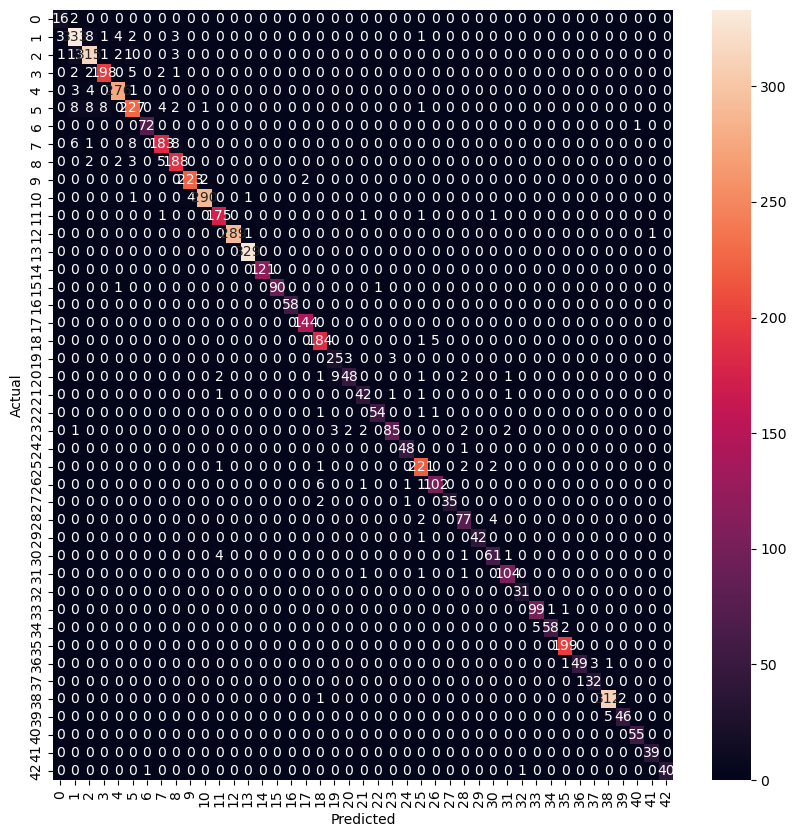

              precision    recall  f1-score   support

           0       0.80      0.89      0.84        18
           1       0.90      0.94      0.92       355
           2       0.93      0.91      0.92       345
           3       0.95      0.94      0.95       210
           4       0.97      0.97      0.97       284
           5       0.88      0.88      0.88       259
           6       0.99      0.99      0.99        73
           7       0.94      0.89      0.91       206
           8       0.92      0.94      0.93       200
           9       0.98      0.98      0.98       227
          10       0.99      0.98      0.98       296
          11       0.96      0.98      0.97       179
          12       1.00      0.99      1.00       291
          13       0.99      1.00      1.00       329
          14       1.00      1.00      1.00       121
          15       1.00      0.98      0.99        92
          16       1.00      1.00      1.00        58
          17       0.99    

In [29]:
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns

model3.eval()  # Set the model to evaluation mode
y_pred3 = []
y_true3 = []

with torch.no_grad():
    for data in test_loader:
        images, labels = data['image'].to(device), data['label'].to(device)
        outputs = model3(images)
        _, predicted = torch.max(outputs, 1)
        y_pred3.extend(predicted.tolist())
        y_true3.extend(labels.tolist())

# Generate the confusion matrix
cm3 = confusion_matrix(y_true3, y_pred3)

# Plot the confusion matrix
plt.figure(figsize=(10,10))
sns.heatmap(cm3, annot=True, fmt="d")
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.show()

print(classification_report(y_true3, y_pred3))

In [30]:
model3.eval()  # Set the model to evaluation mode

correct = 0
total = 0
with torch.no_grad():  # No need to track gradients for testing
    for data in test_loader:
        images, labels = data['image'].to(device), data['label'].to(device)
        outputs = model3(images)
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

test_accuracy = 100 * correct / total
print(f'Accuracy of the model on the test images: {test_accuracy}%')

ModelAccuracies.append(test_accuracy)

Accuracy of the model on the test images: 95.03570214212853%


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


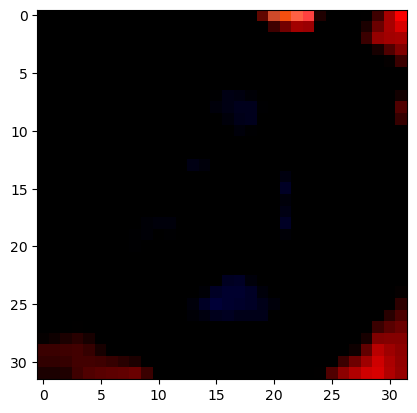

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


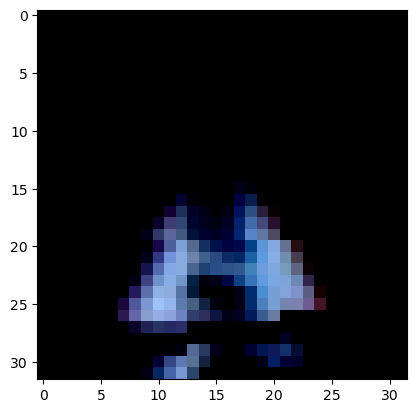

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 28
Predicted Label: 28


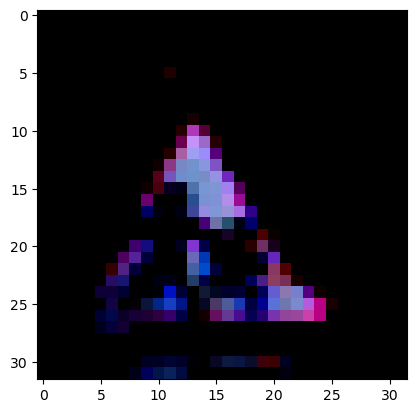

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 28
Predicted Label: 28


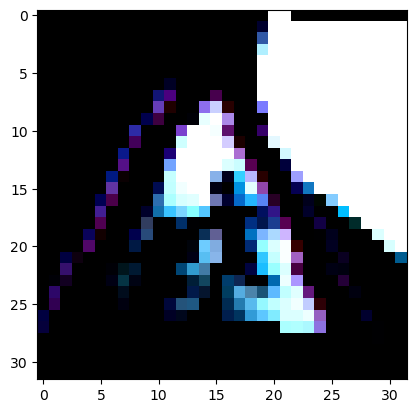

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


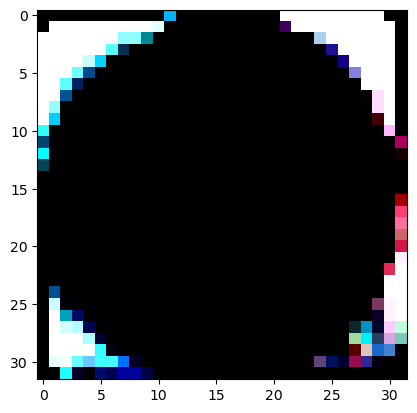

True Label: 10


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 10


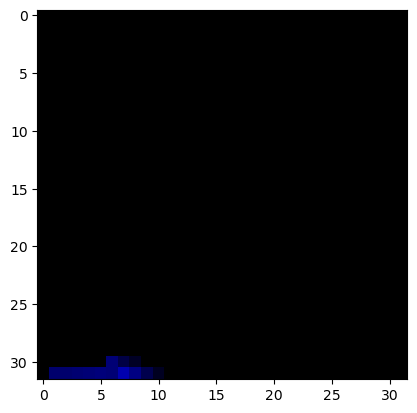

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 22
Predicted Label: 22


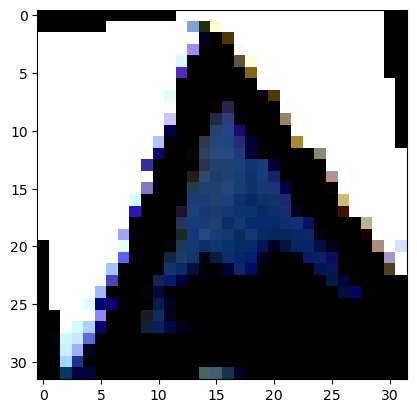

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


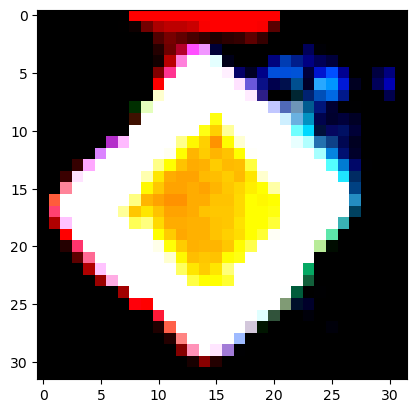

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


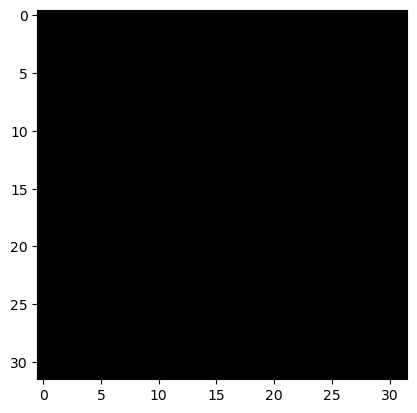

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


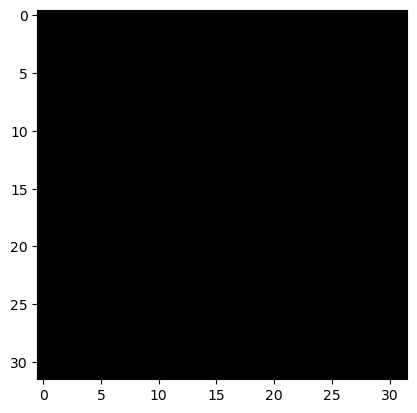

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 36
Predicted Label: 36


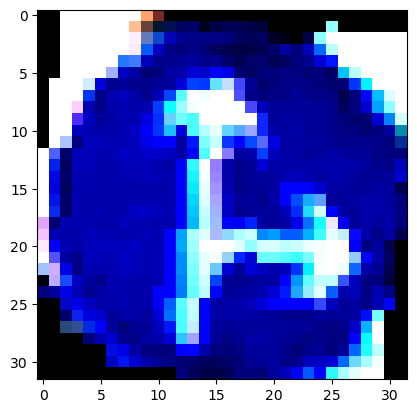

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


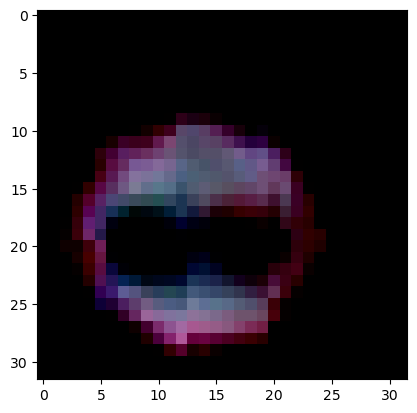

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


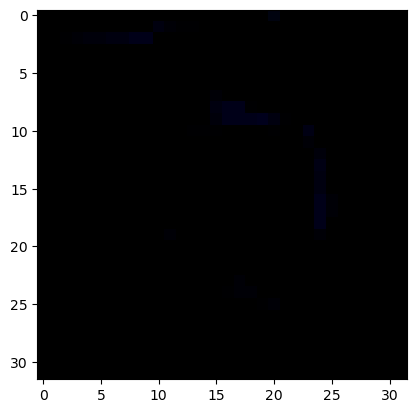

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


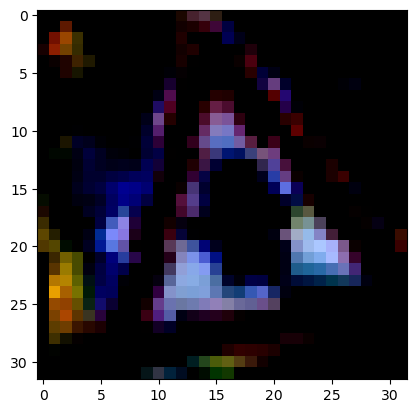

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 31
Predicted Label: 31


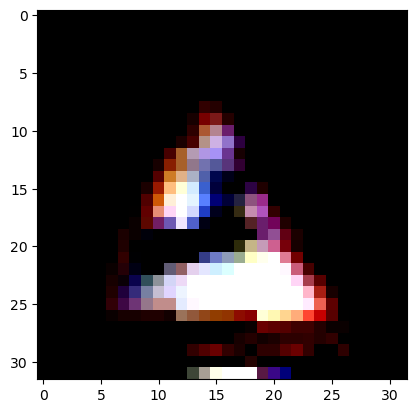

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


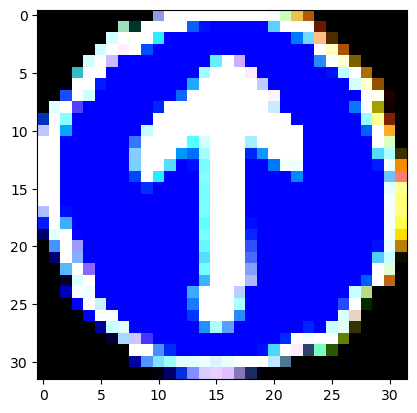

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 22
Predicted Label: 22


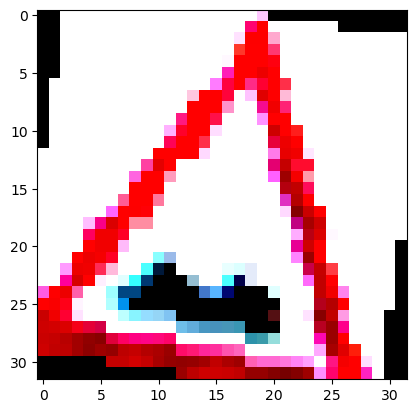

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


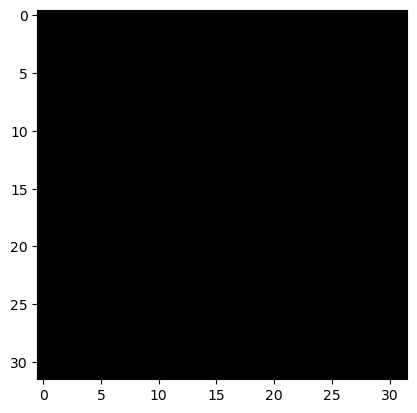

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


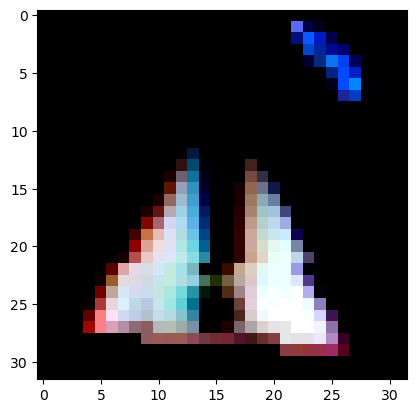

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


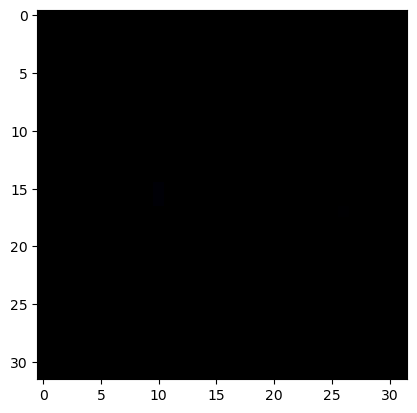

True Label: 18


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 18


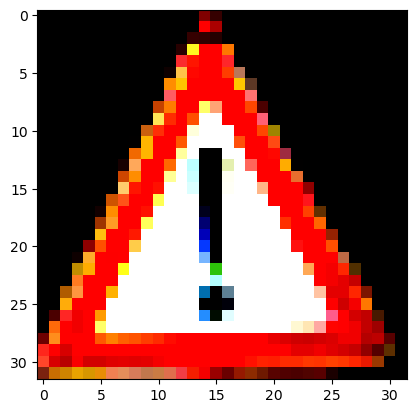

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


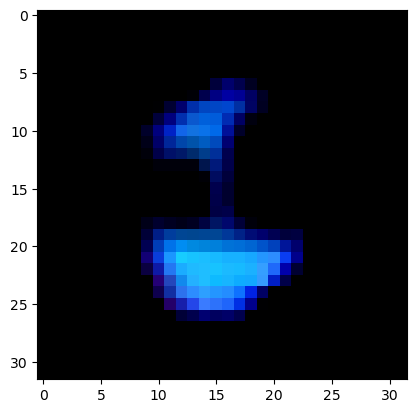

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


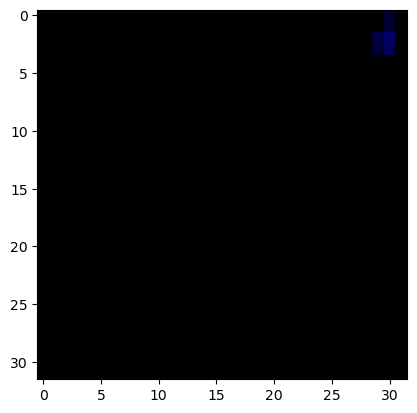

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


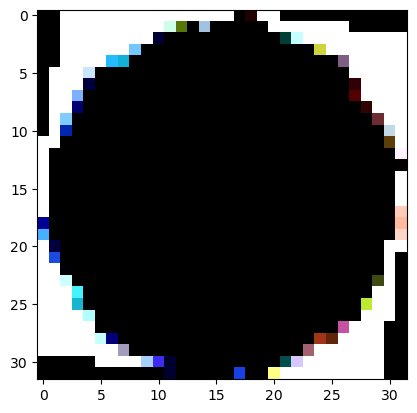

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


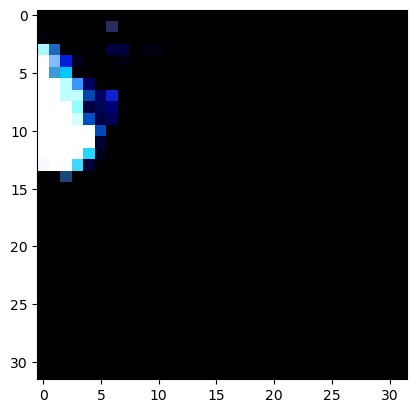

True Label: 2


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 2


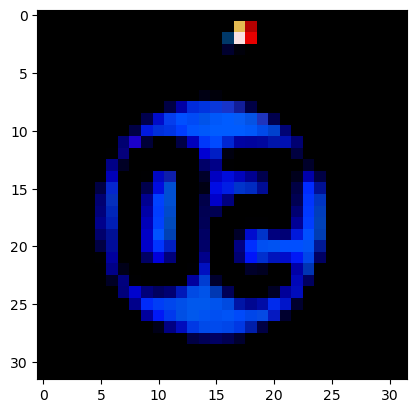

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


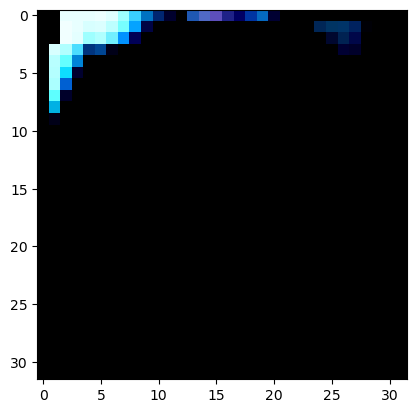

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 22
Predicted Label: 22


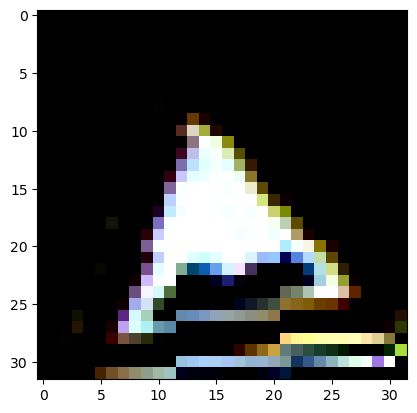

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


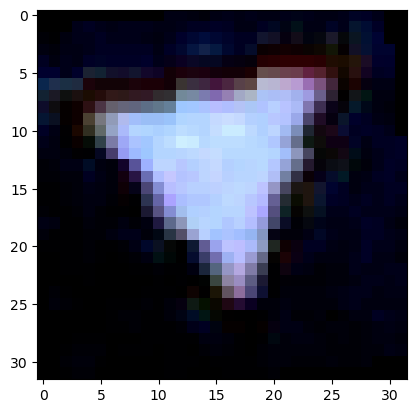

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


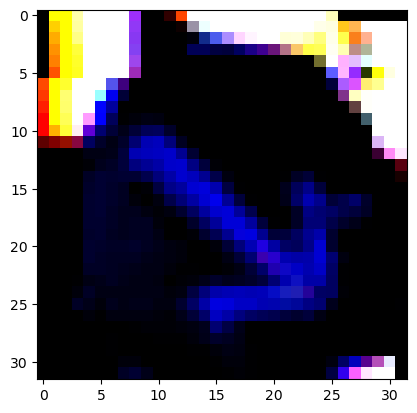

True Label: 8


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 8


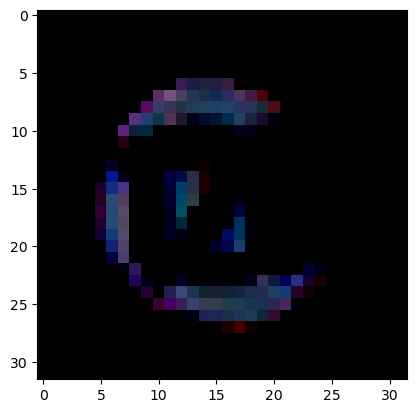

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


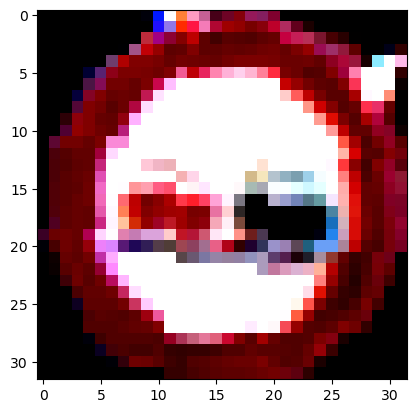

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


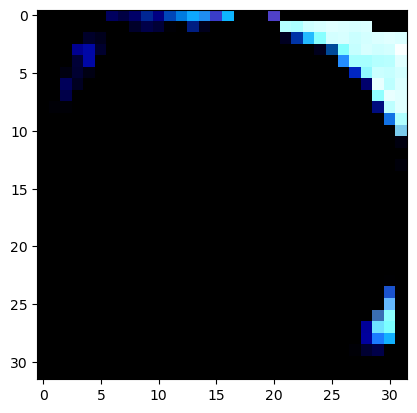

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


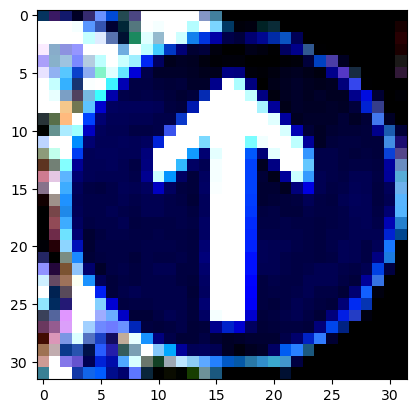

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


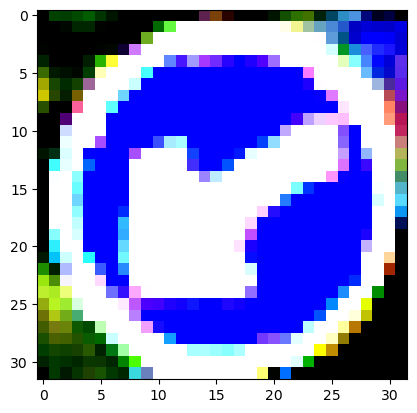

True Label: 13


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 13


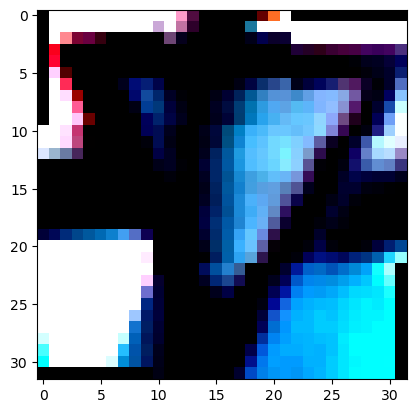

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


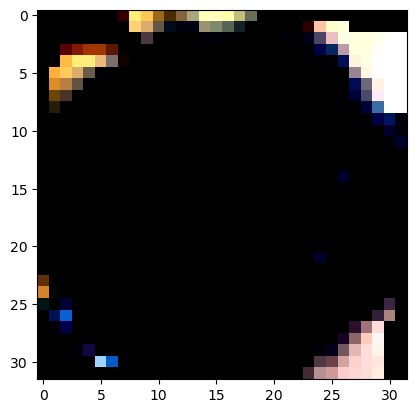

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 22
Predicted Label: 22


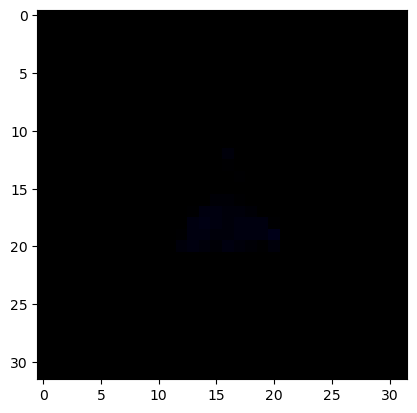

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 8


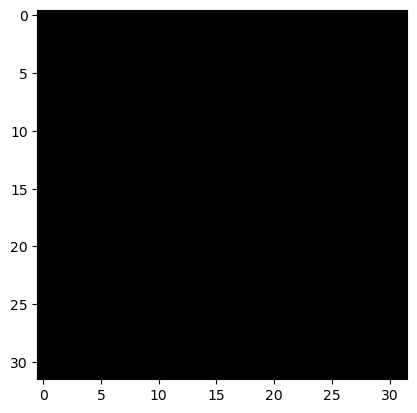

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


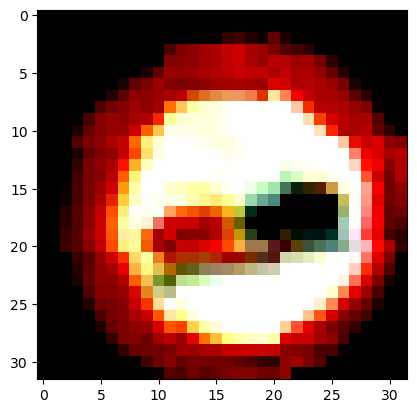

True Label: 35


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 35


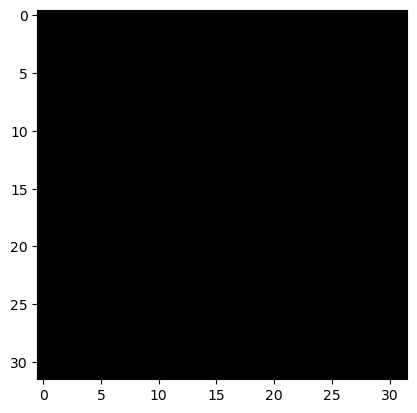

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


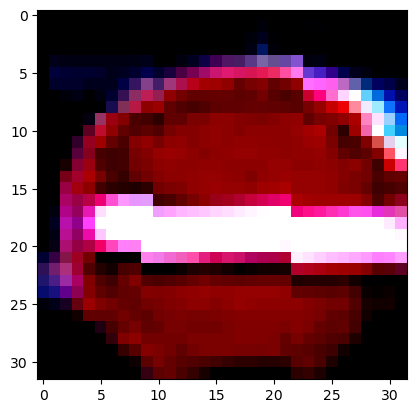

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


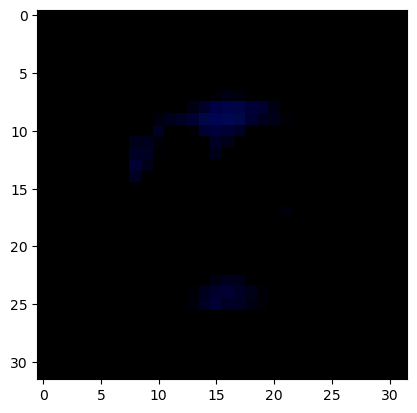

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 2


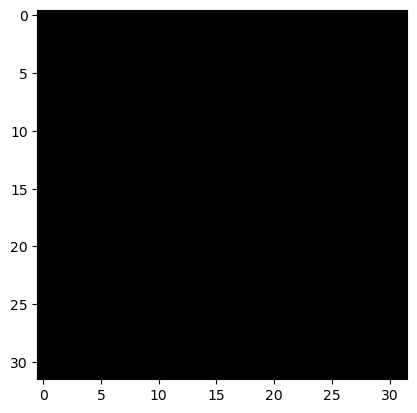

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 26
Predicted Label: 26


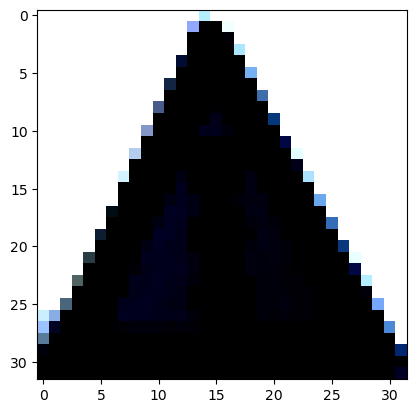

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


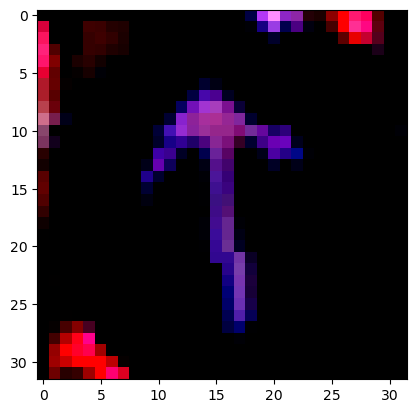

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


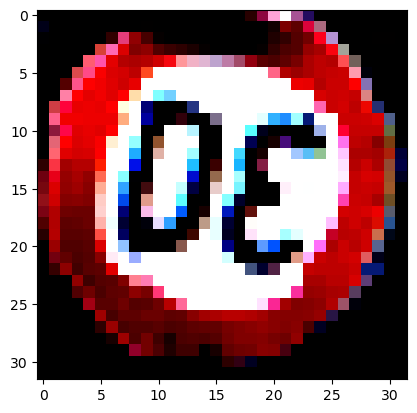

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


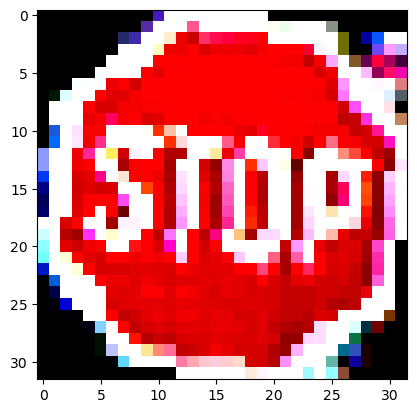

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


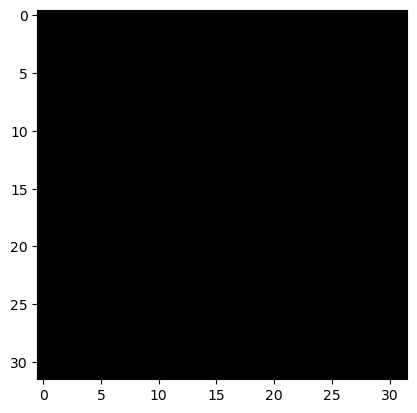

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


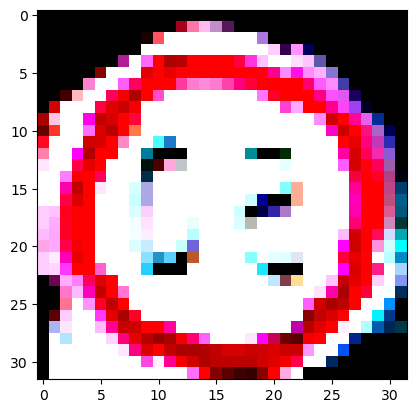

True Label: 12


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 12


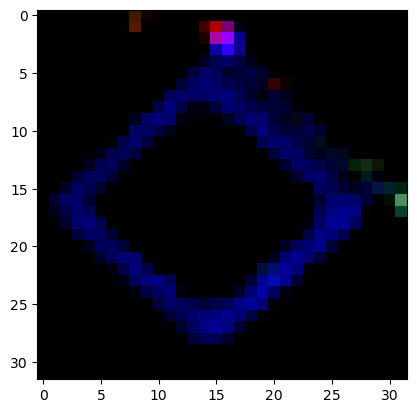

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 31
Predicted Label: 21


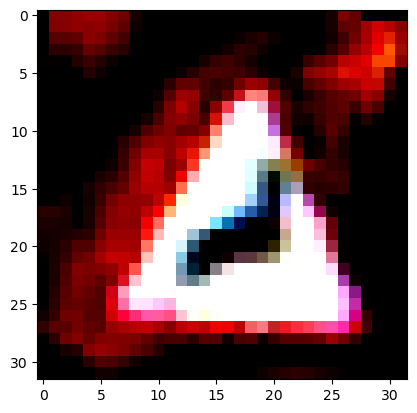

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


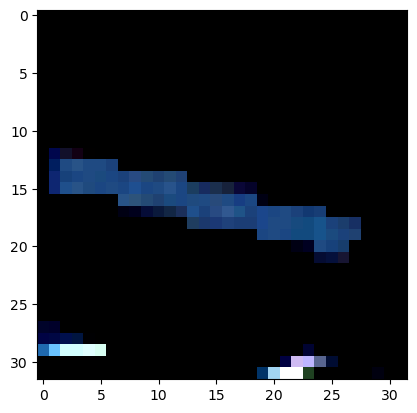

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


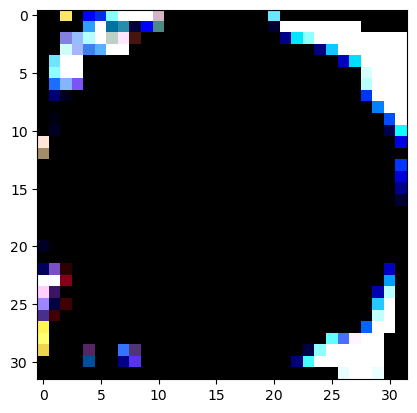

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 16
Predicted Label: 16


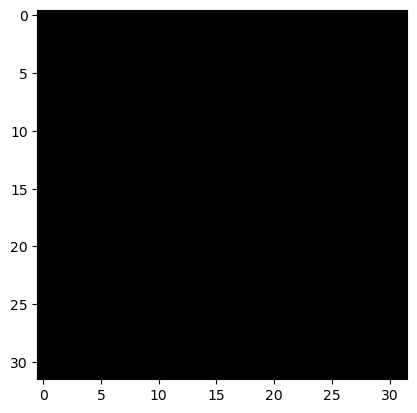

True Label: 1


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 1


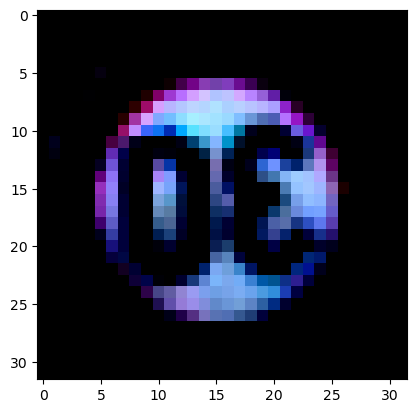

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


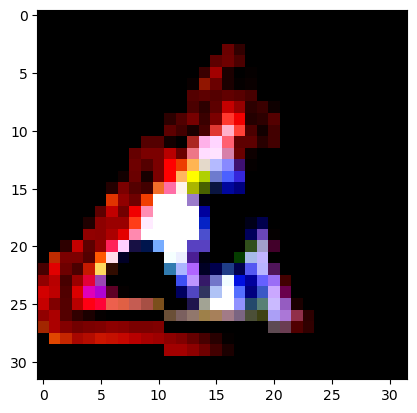

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


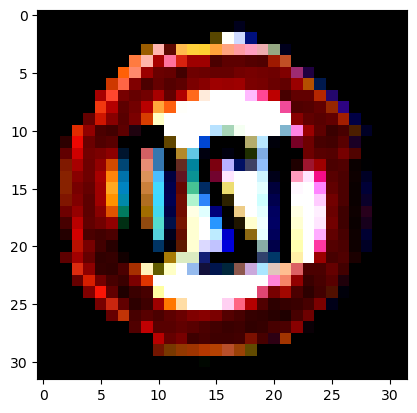

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


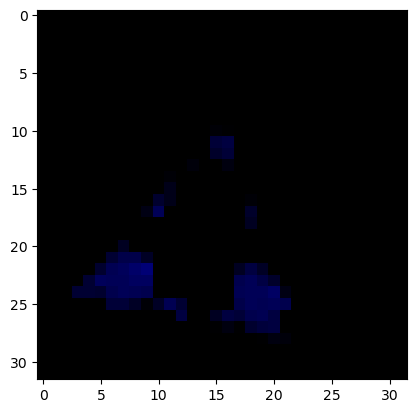

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


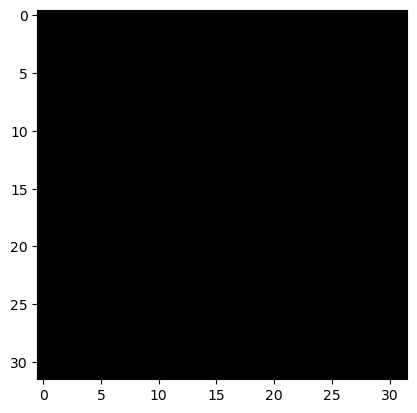

True Label: 13


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 13


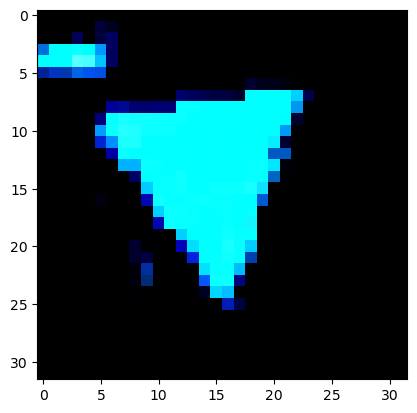

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 20
Predicted Label: 20


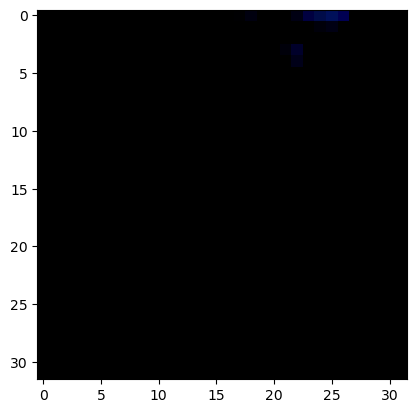

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


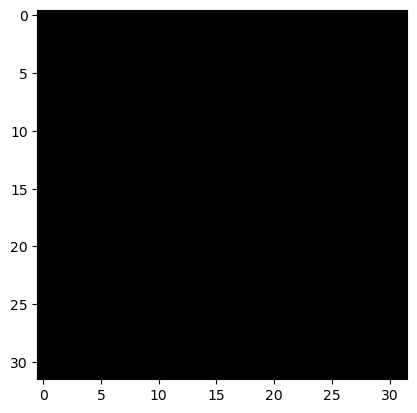

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


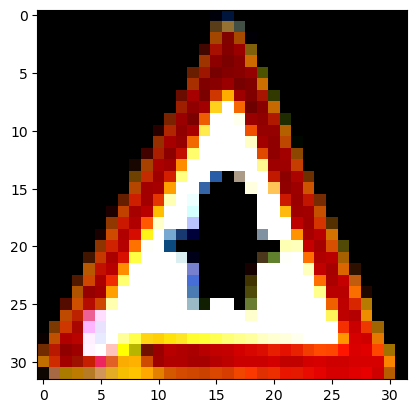

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


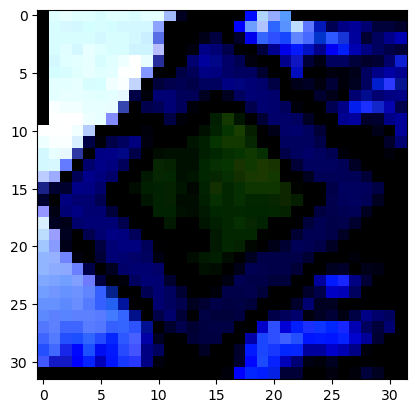

True Label: 3


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 3


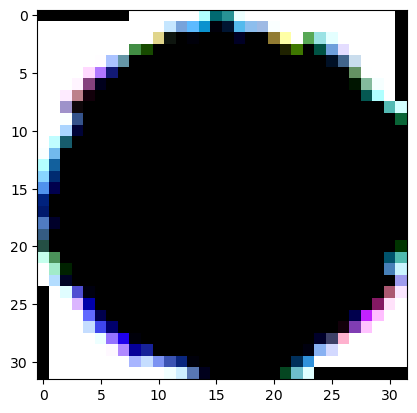

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 28
Predicted Label: 28


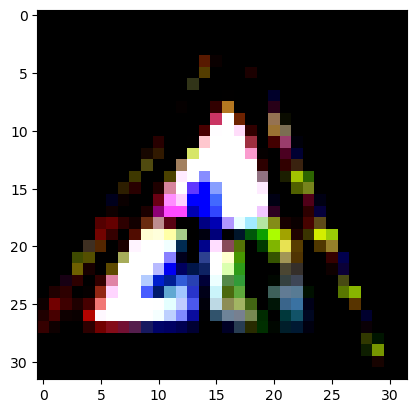

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 33
Predicted Label: 33


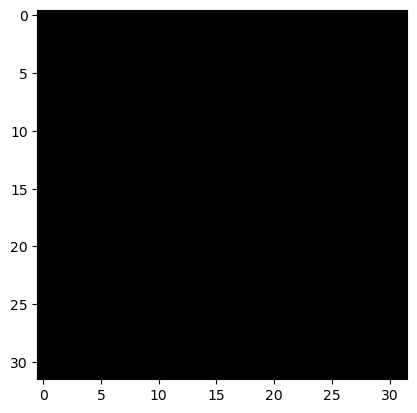

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


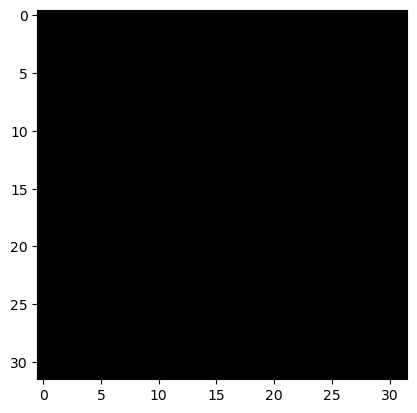

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


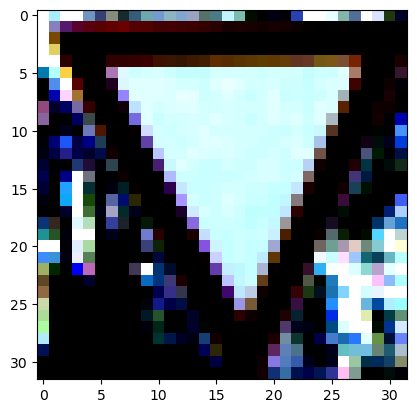

True Label: 2


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 2


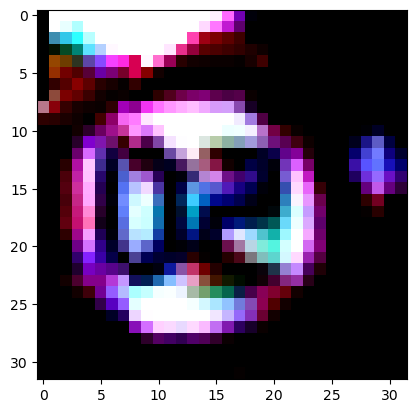

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


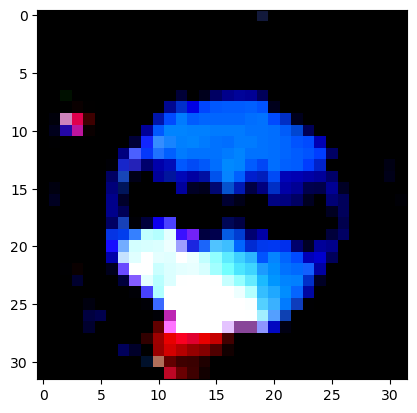

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 41
Predicted Label: 41


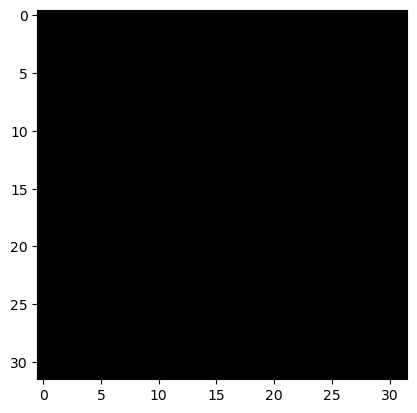

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 19
Predicted Label: 19


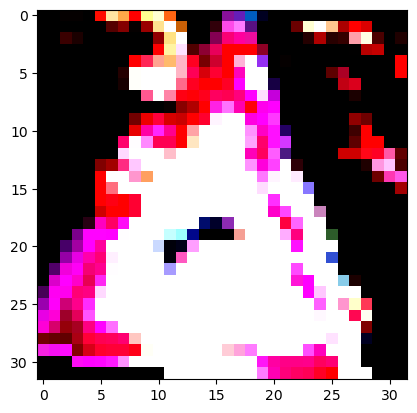

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


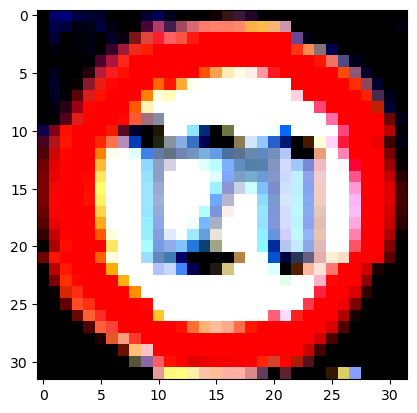

True Label: 38
Predicted Label: 38


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


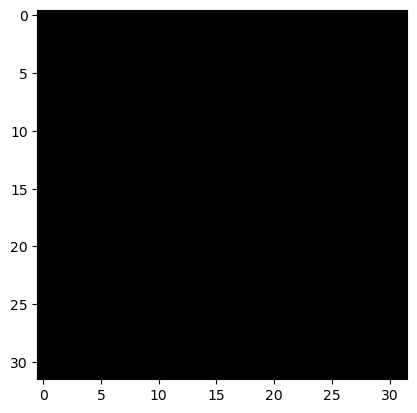

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


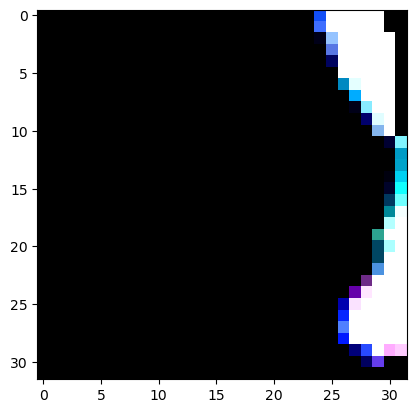

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 33
Predicted Label: 33


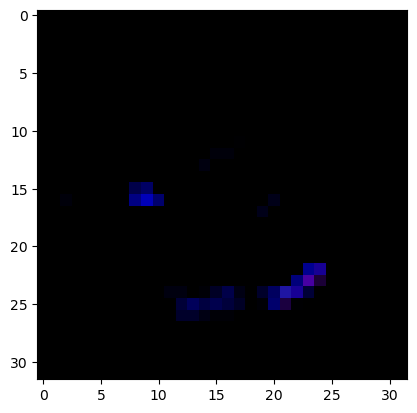

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


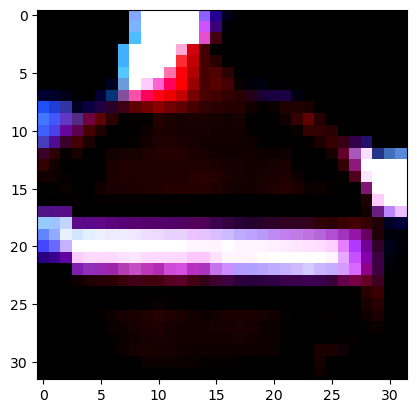

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 6
Predicted Label: 6


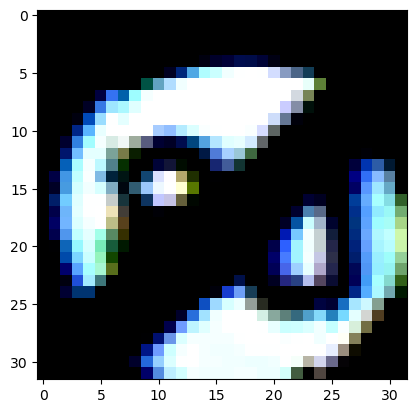

True Label: 38


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 38


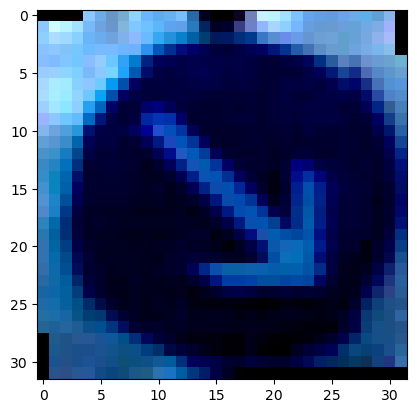

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


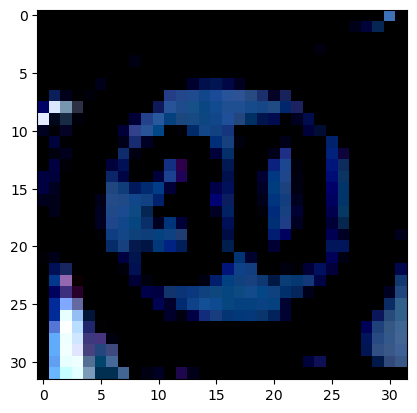

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


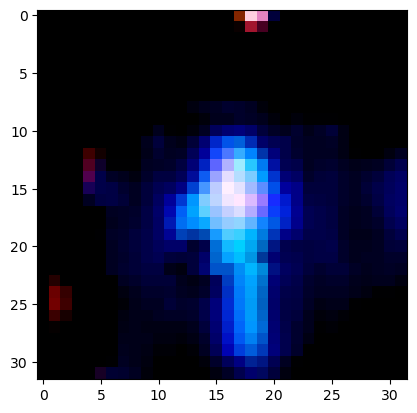

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


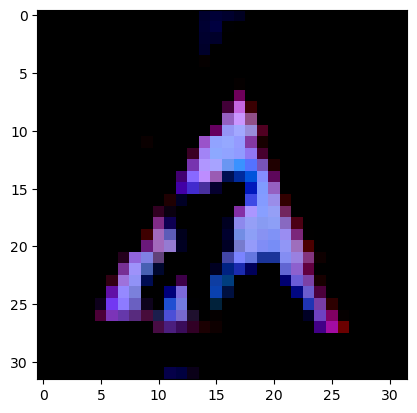

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


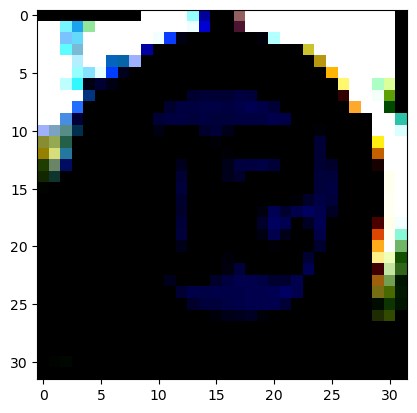

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 30
Predicted Label: 30


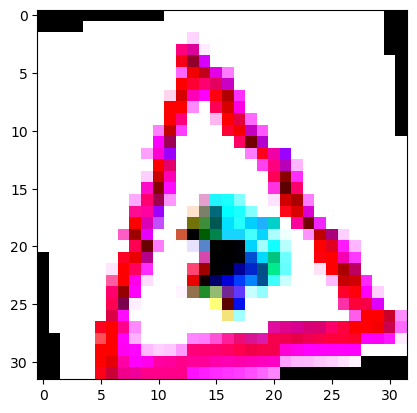

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


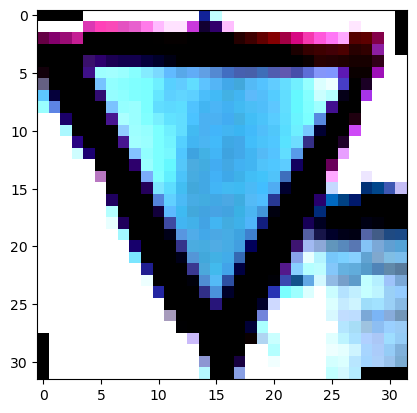

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 40
Predicted Label: 40


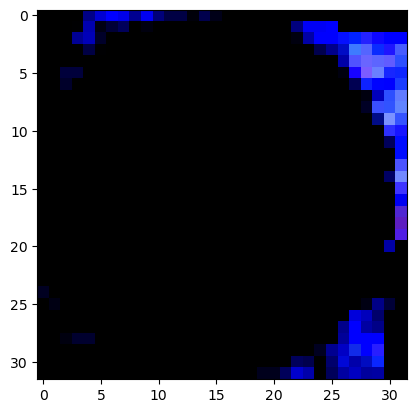

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


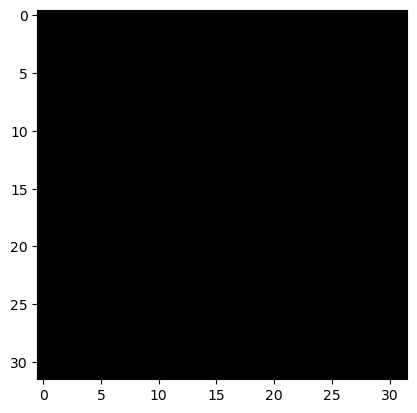

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


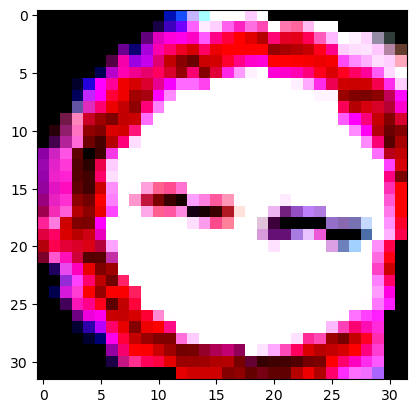

True Label: 38


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 38


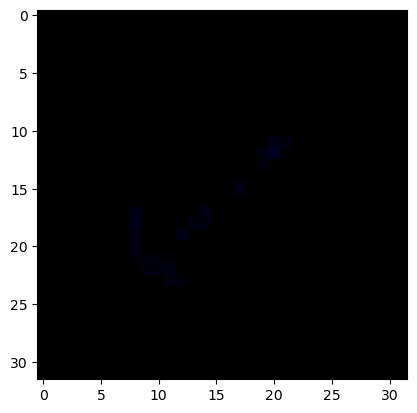

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 2


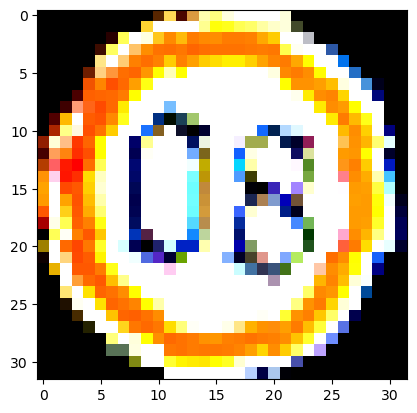

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


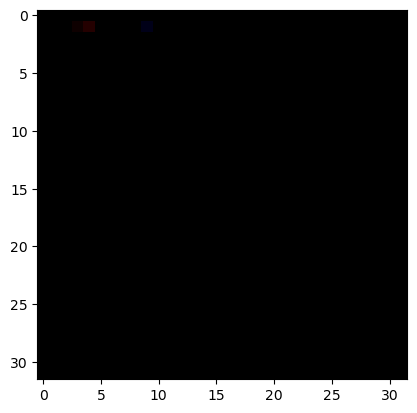

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


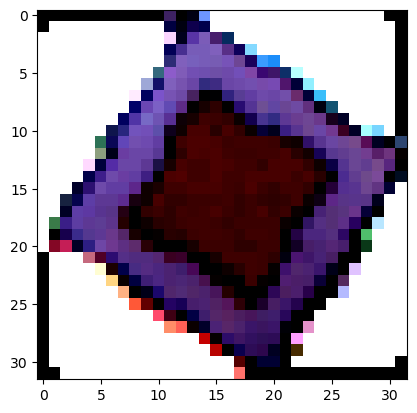

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


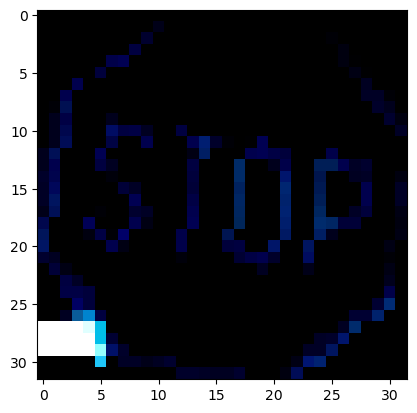

True Label: 17


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 17


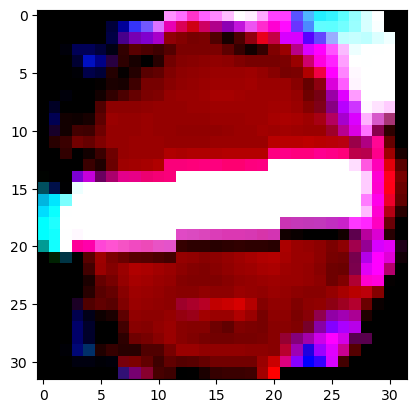

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


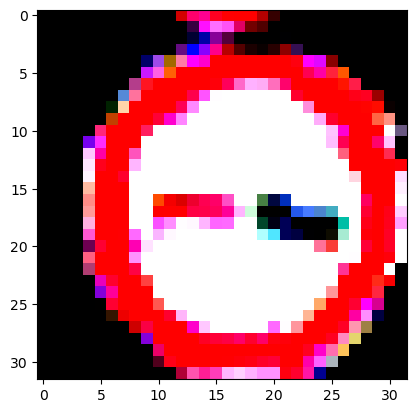

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


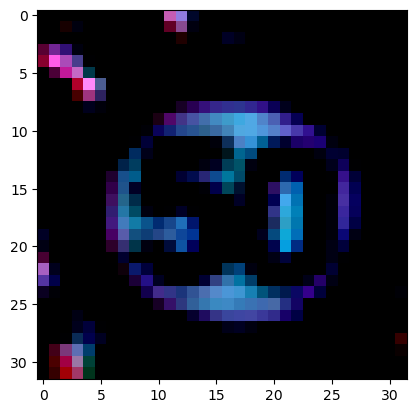

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


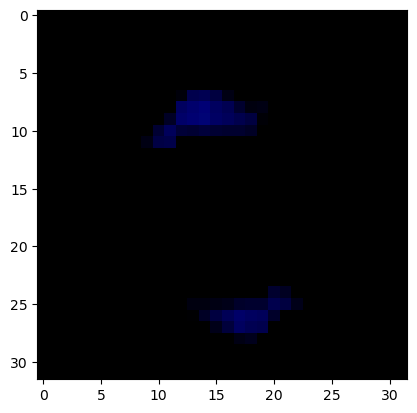

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


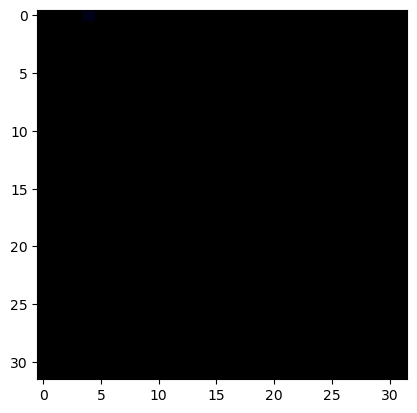

True Label: 22


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 22


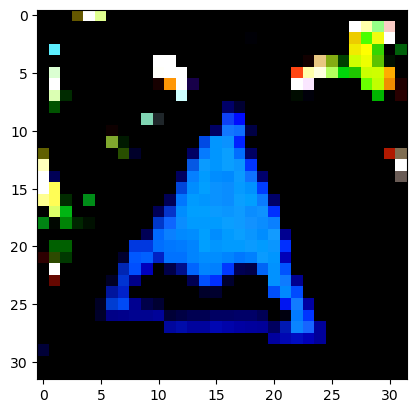

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


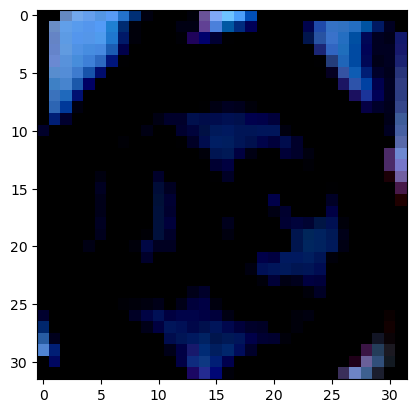

True Label: 30
Predicted Label: 11


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


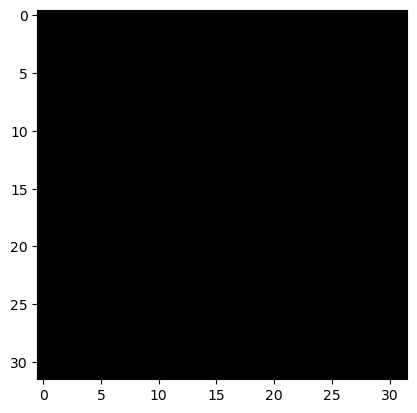

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


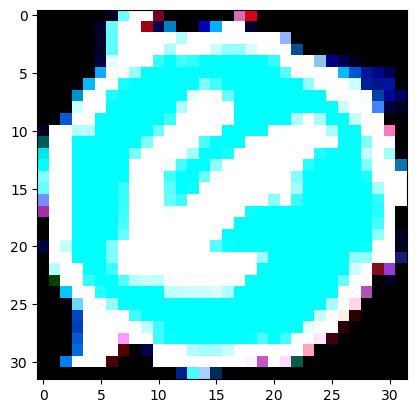

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


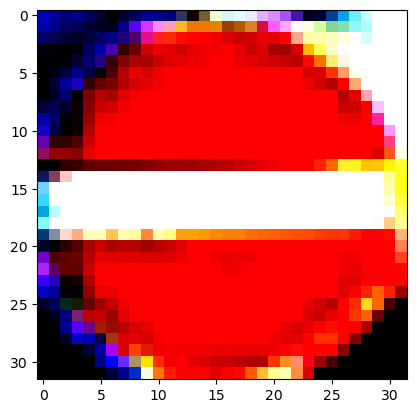

True Label: 4


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 4


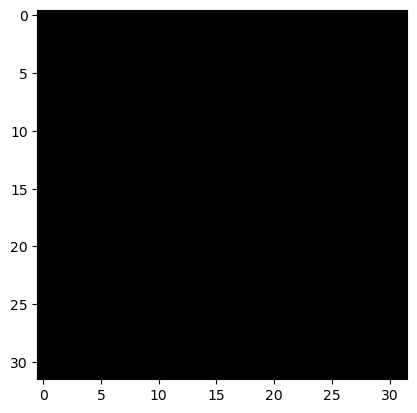

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


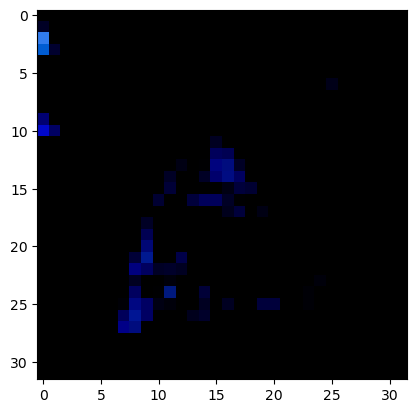

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


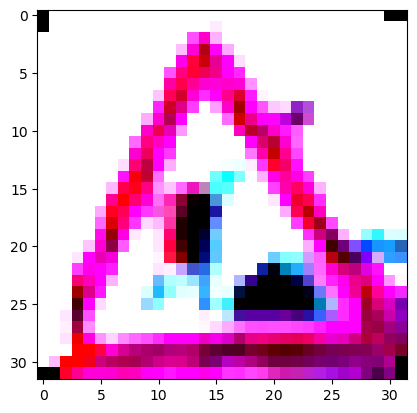

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


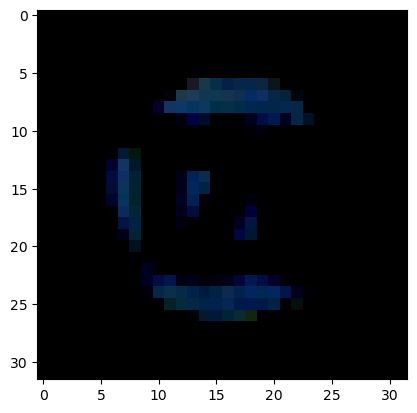

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


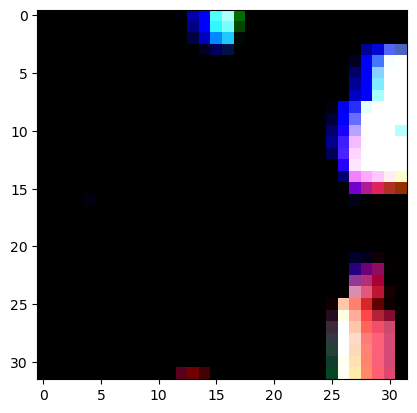

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


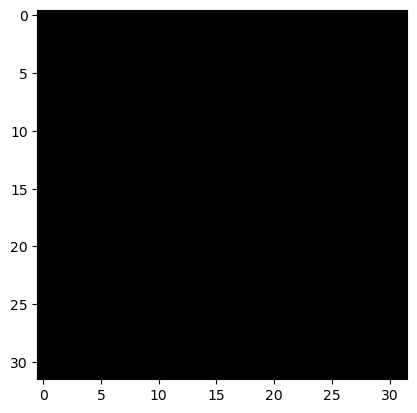

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 16
Predicted Label: 16


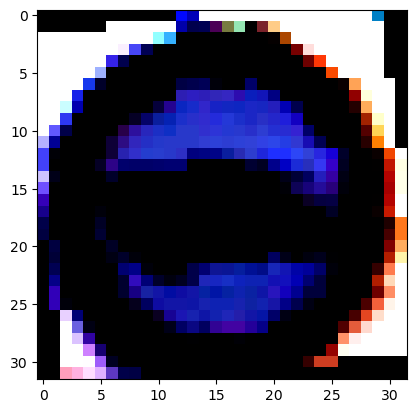

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


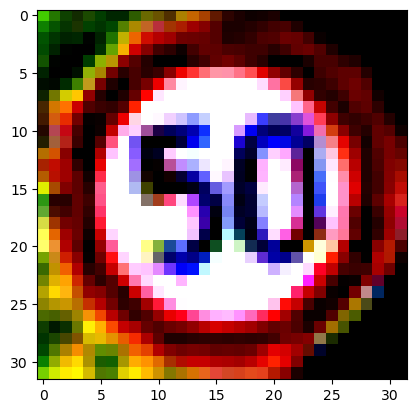

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


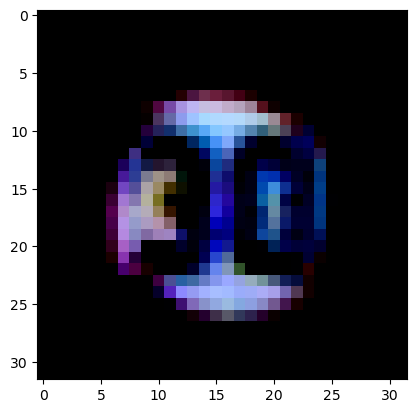

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


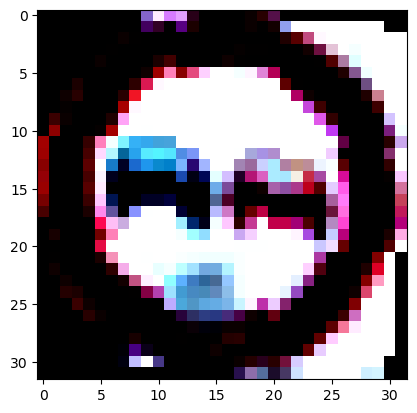

True Label: 23


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 23


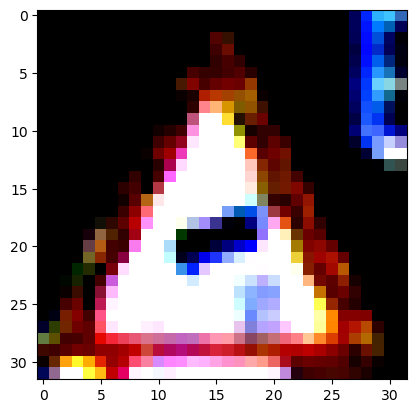

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 6
Predicted Label: 6


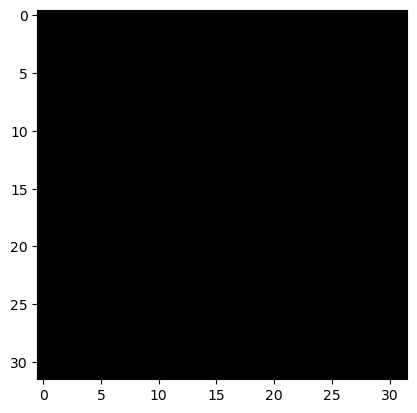

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


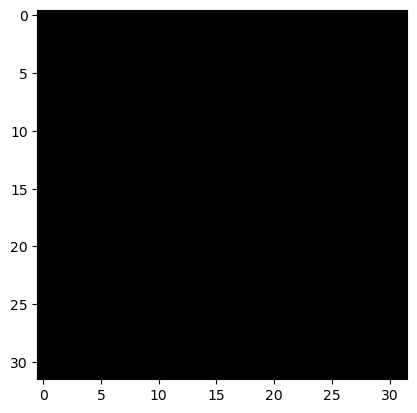

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


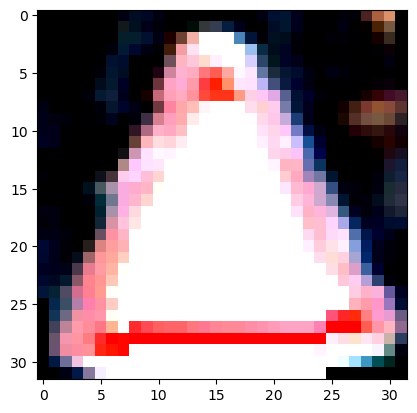

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


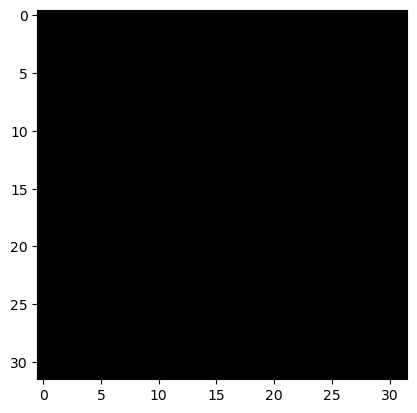

True Label: 31


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 31


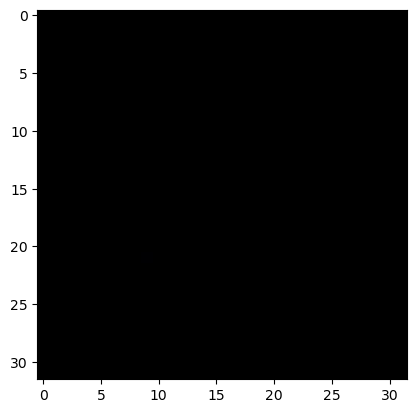

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


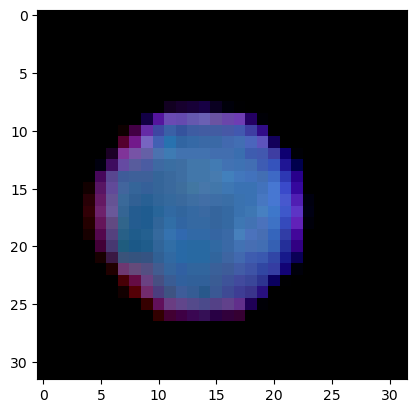

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


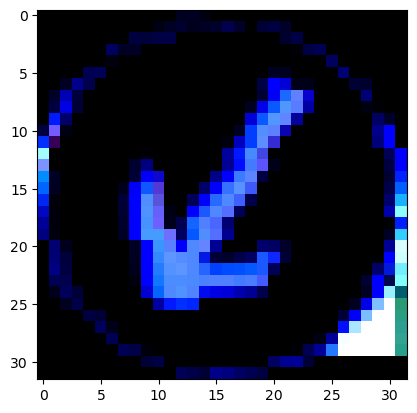

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


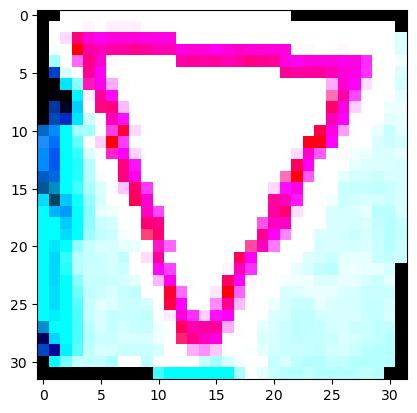

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


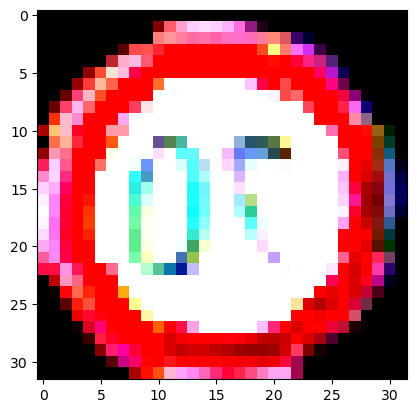

True Label:

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 4
Predicted Label: 4


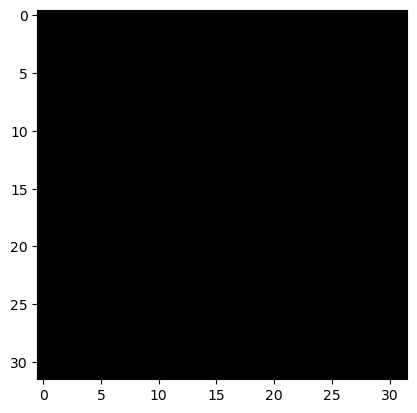

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


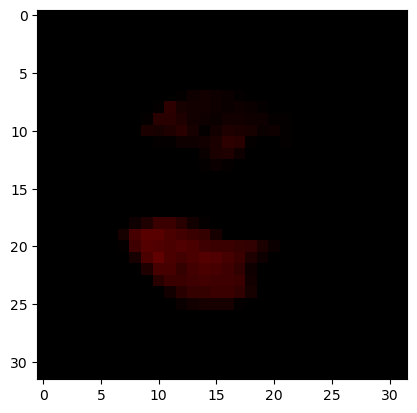

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


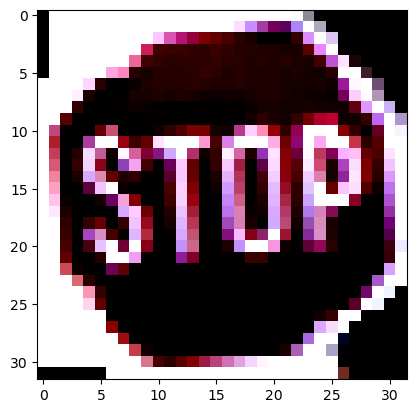

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


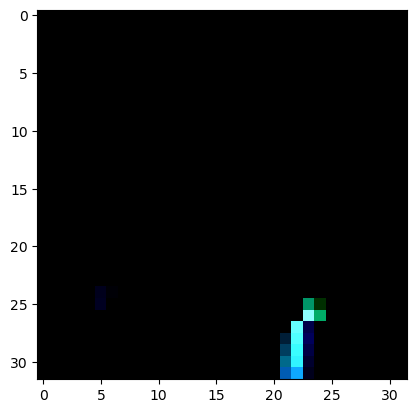

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


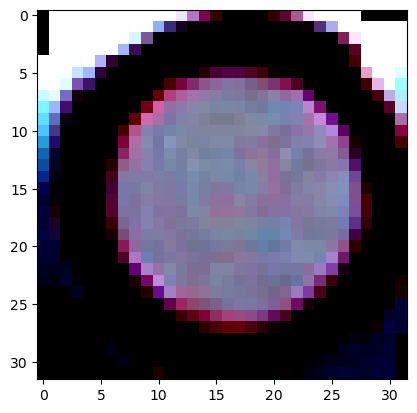

True Label: 15


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 15


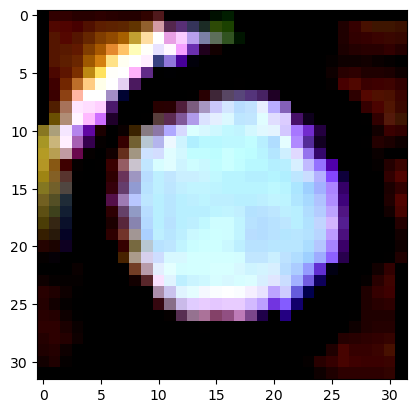

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


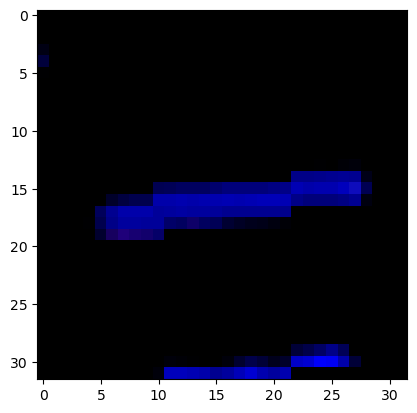

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


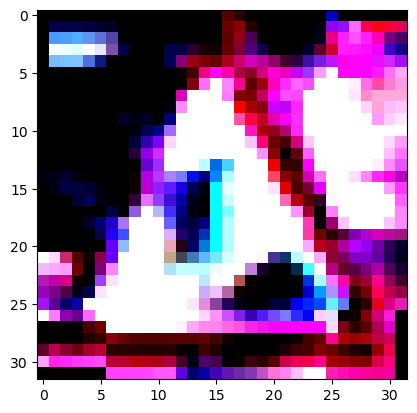

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


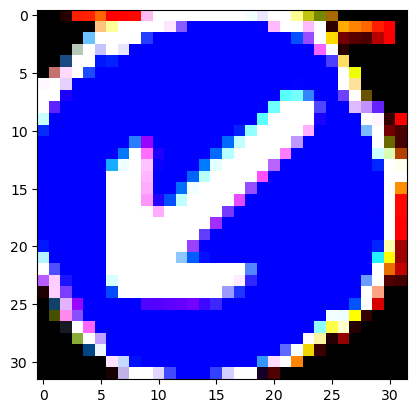

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


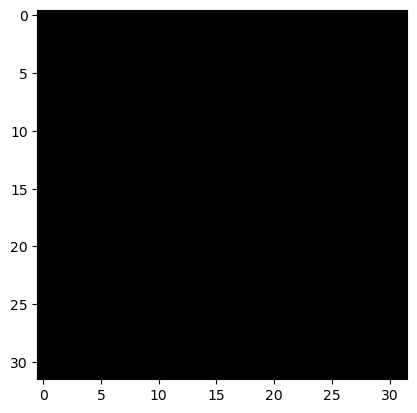

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


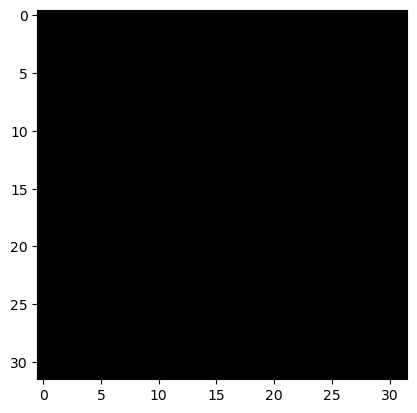

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


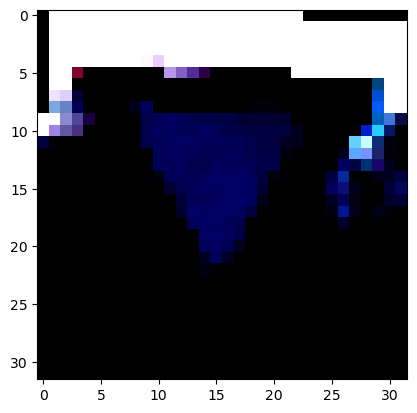

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 28
Predicted Label: 28


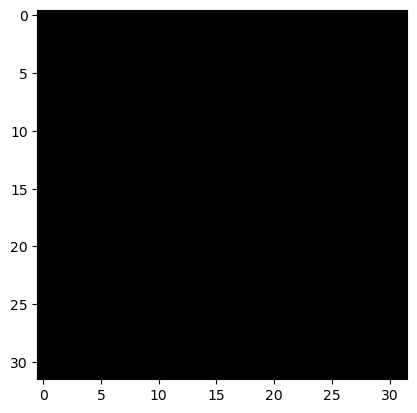

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 40
Predicted Label: 40


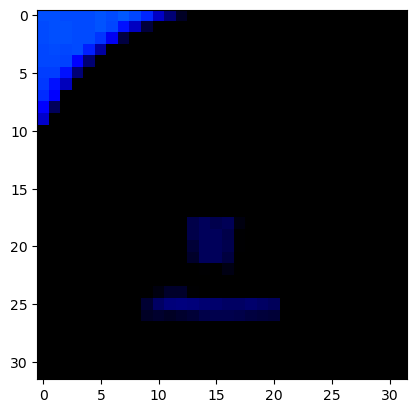

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


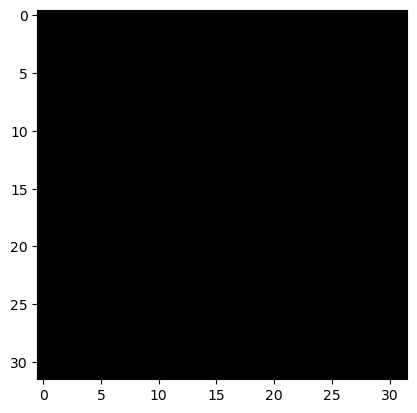

True Label: 36


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 36


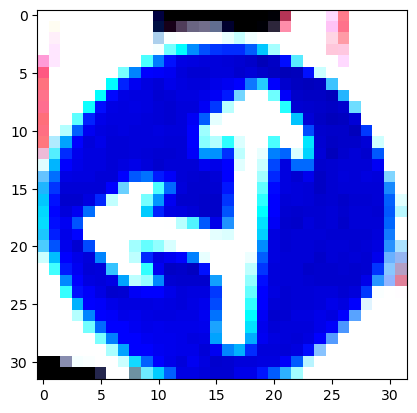

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


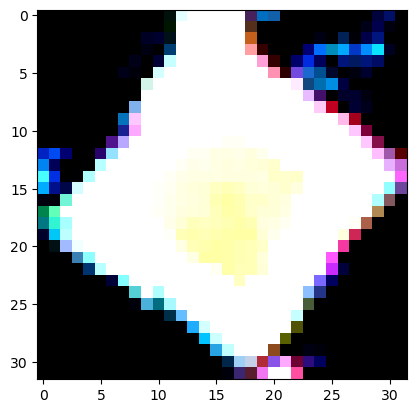

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


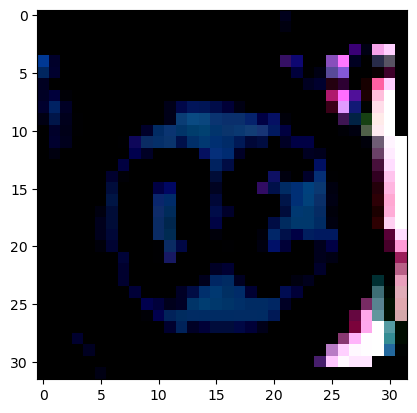

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


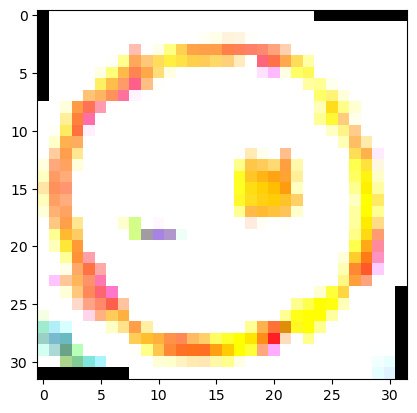

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


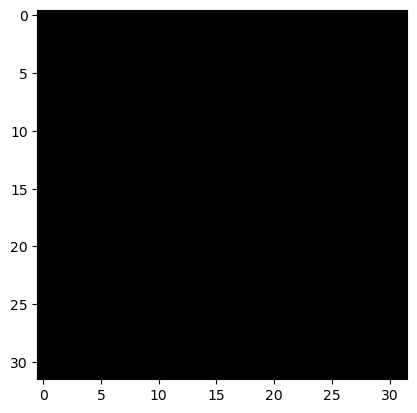

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


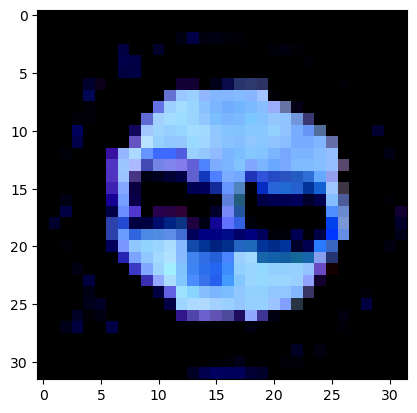

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


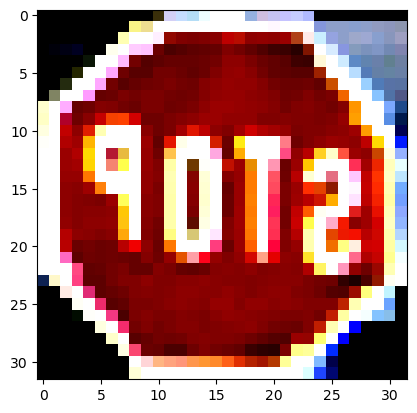

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 28
Predicted Label: 28


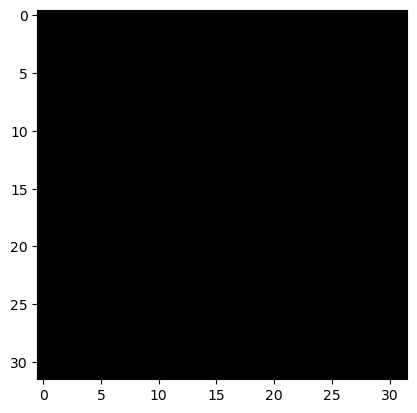

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 3


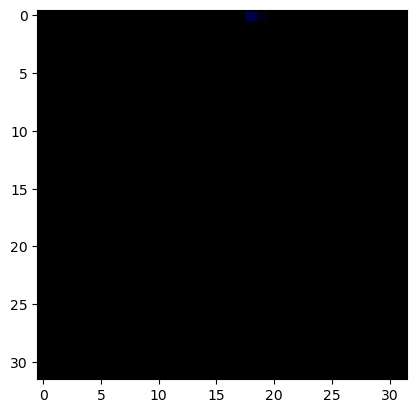

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


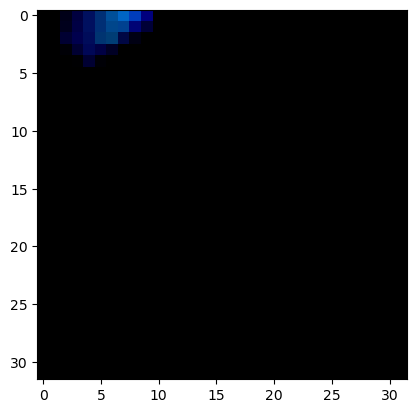

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


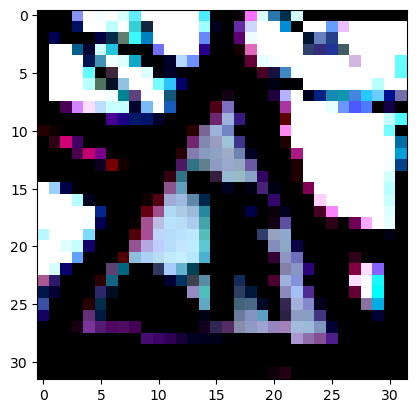

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


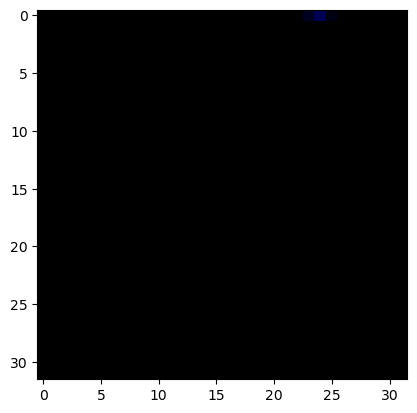

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


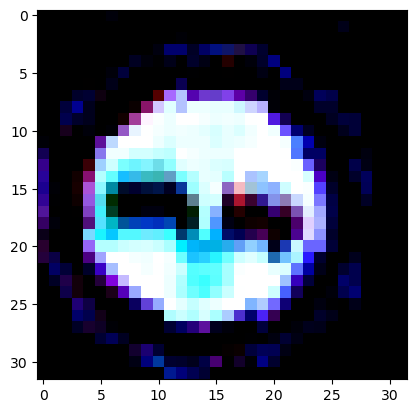

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


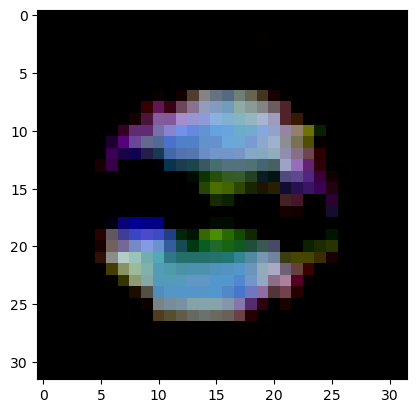

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


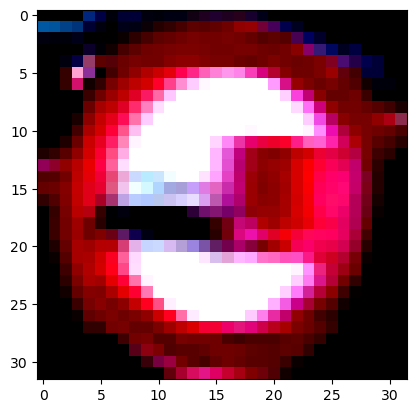

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


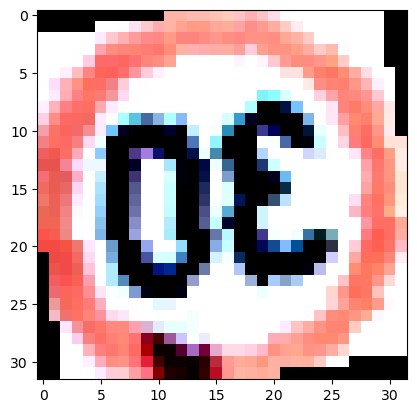

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


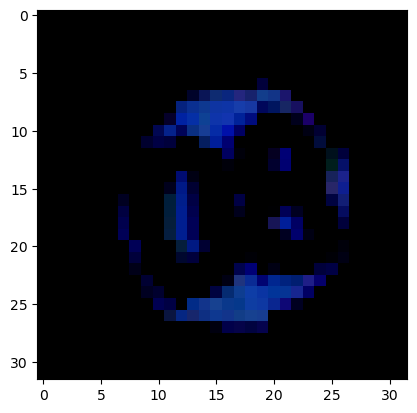

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


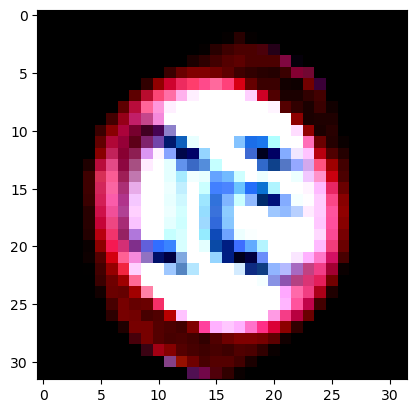

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


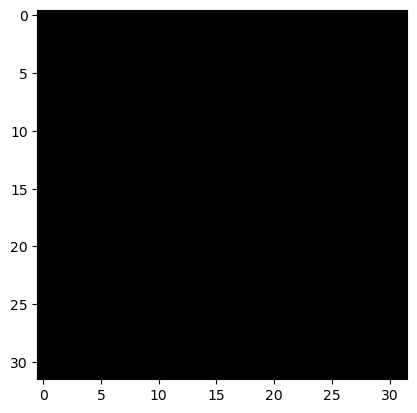

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


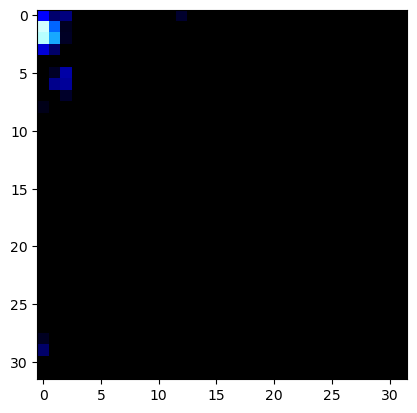

True Label: 6


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 6


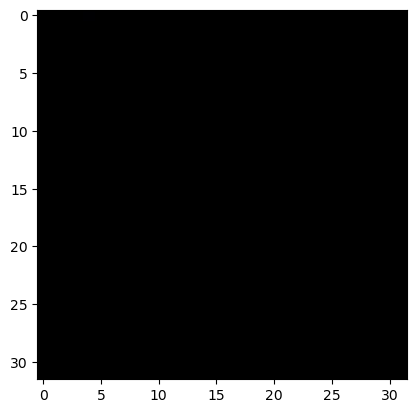

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


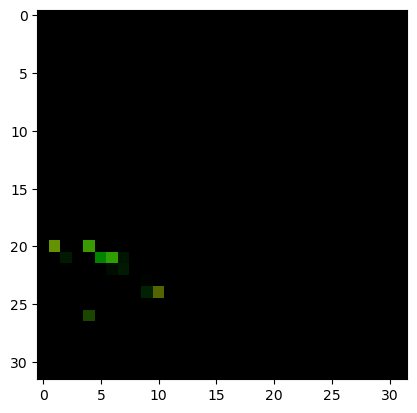

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 21


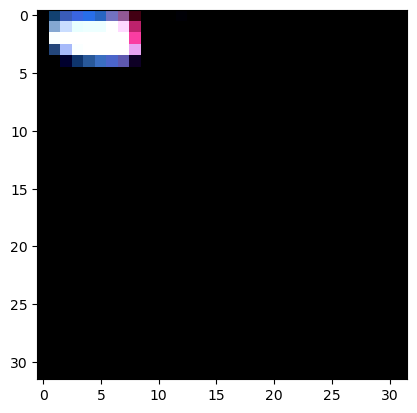

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 8


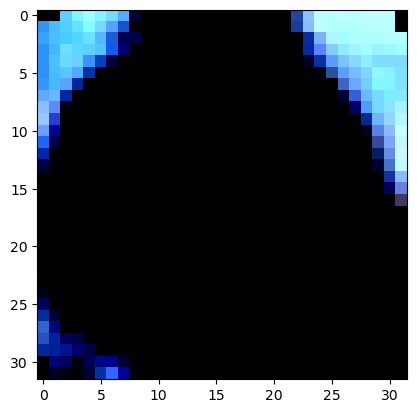

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


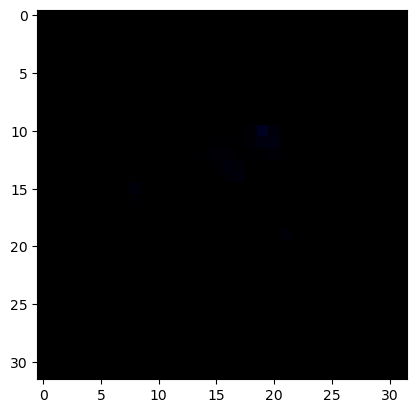

True Label: 20


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 19


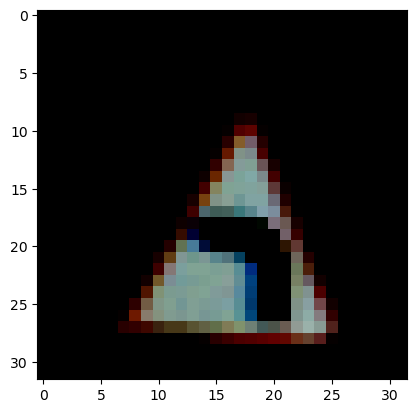

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


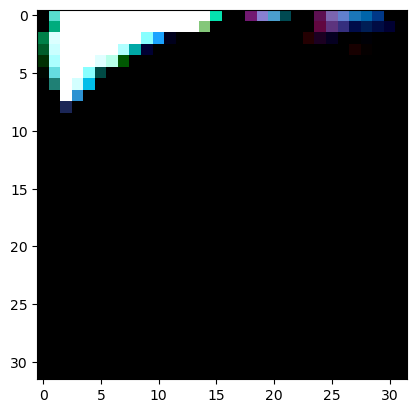

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


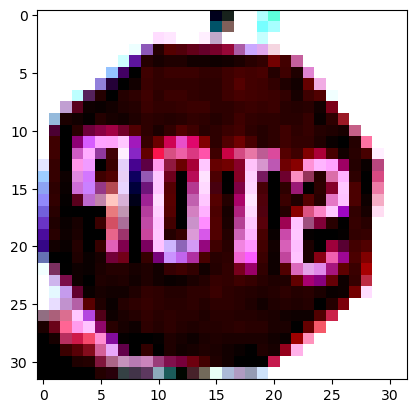

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


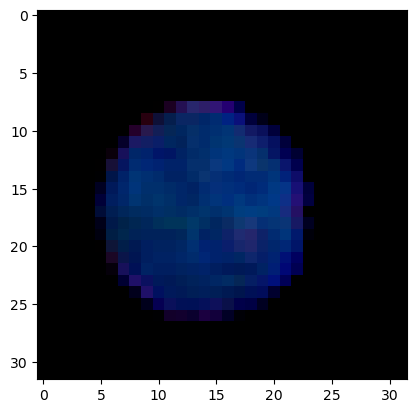

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


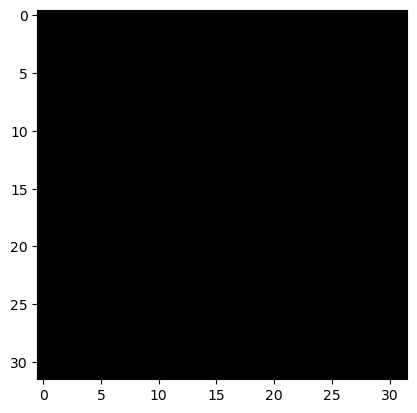

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


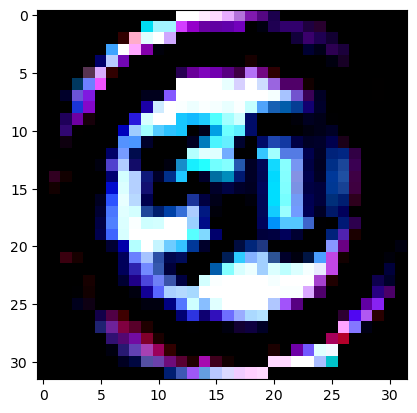

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 29
Predicted Label: 29


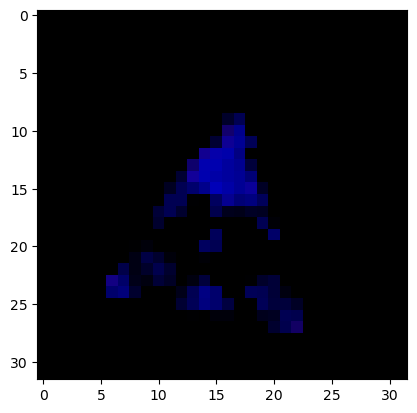

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


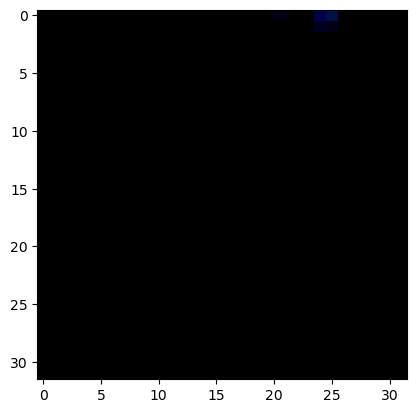

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


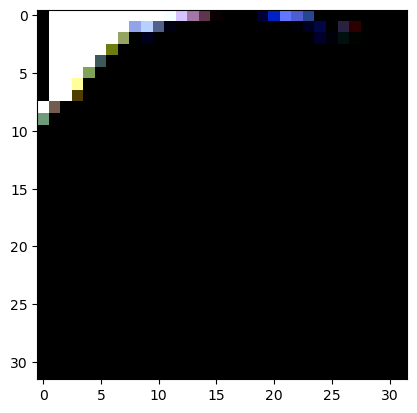

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


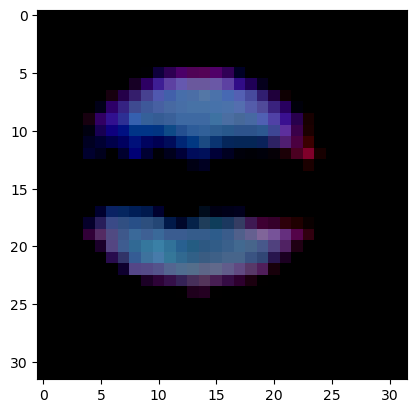

True Label: 30


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 30


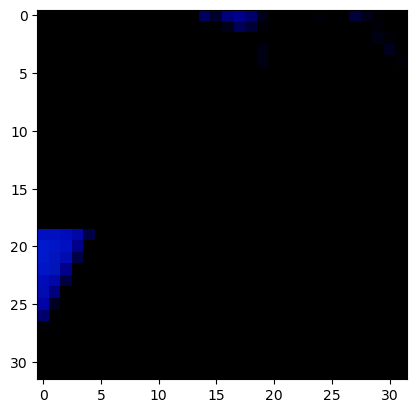

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


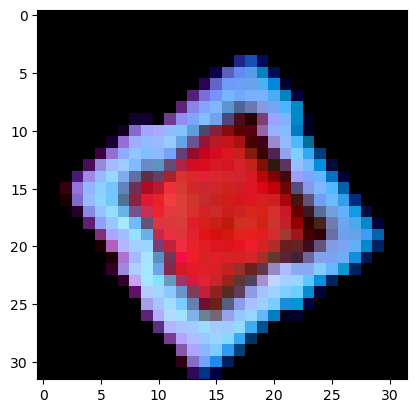

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


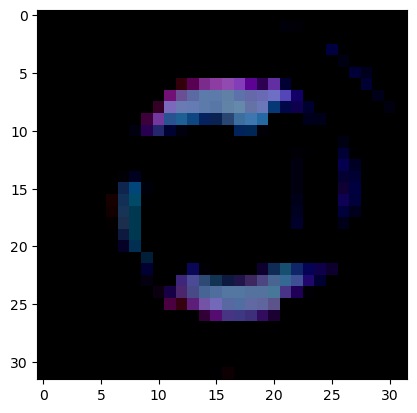

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 31
Predicted Label: 31


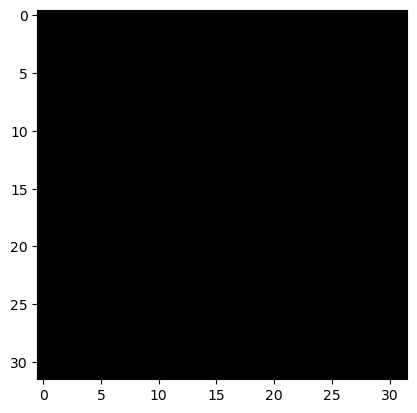

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


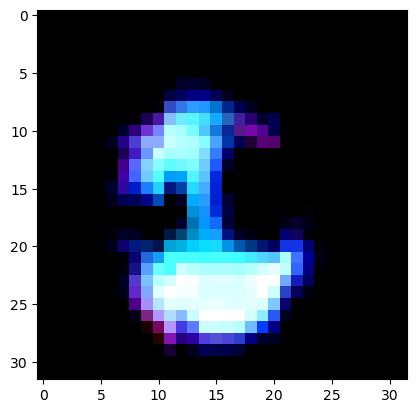

True Label: 10


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 10


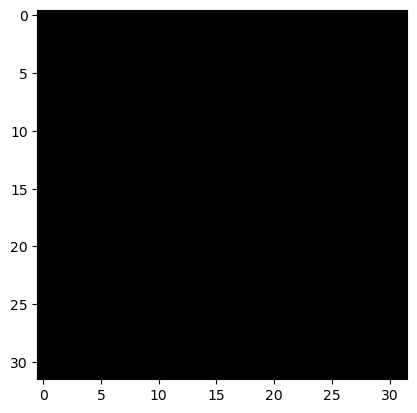

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


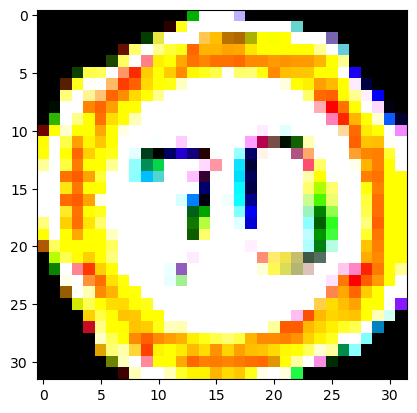

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 40
Predicted Label: 40


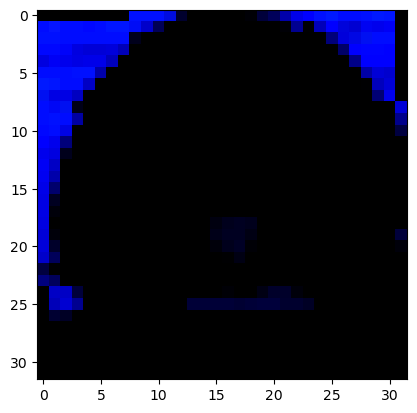

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


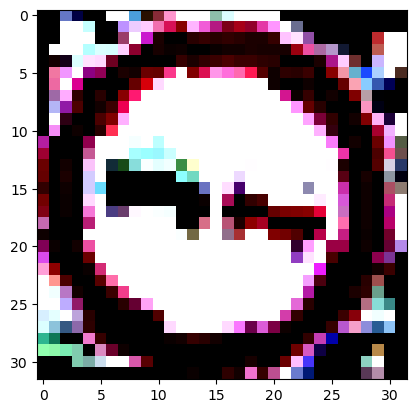

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 33
Predicted Label: 33


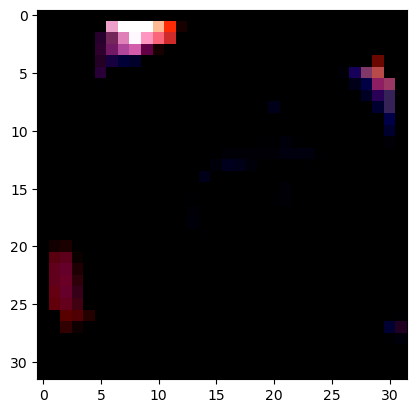

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


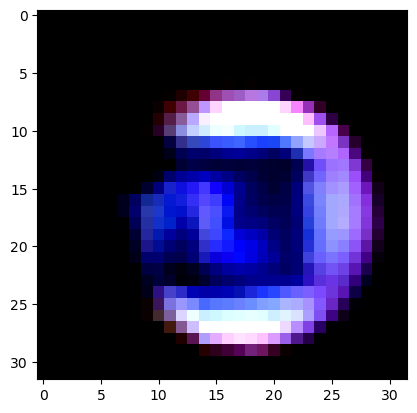

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


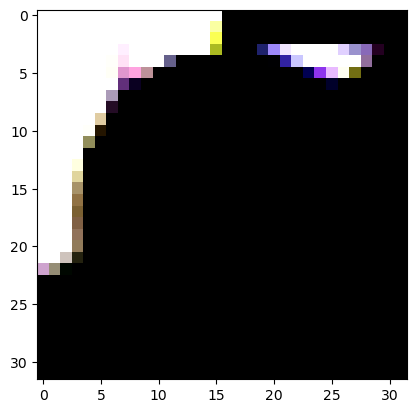

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


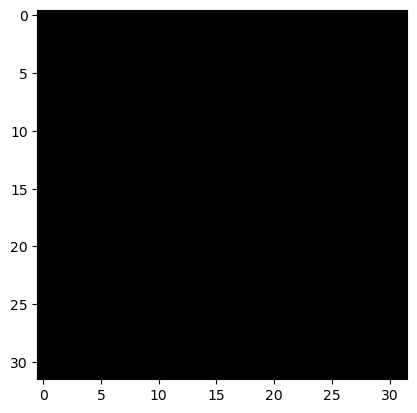

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 26
Predicted Label: 26


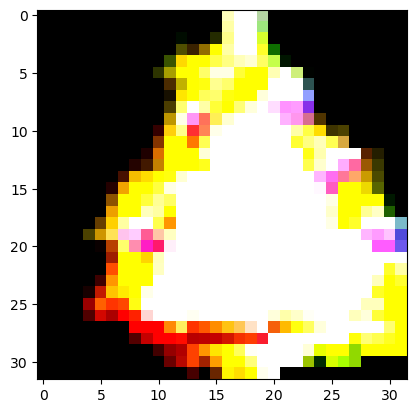

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 31
Predicted Label: 31


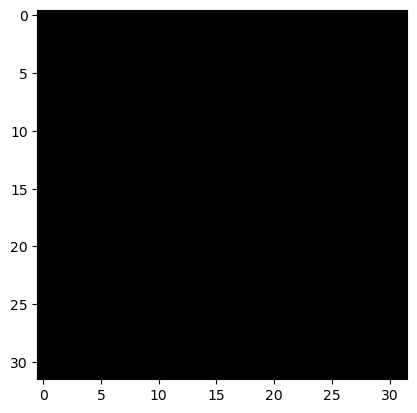

True Label: 27


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 27


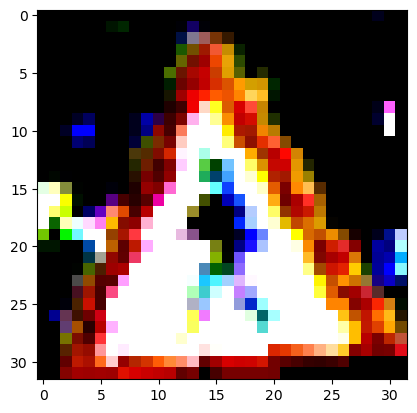

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


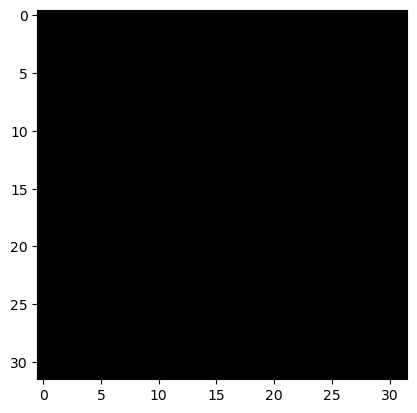

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


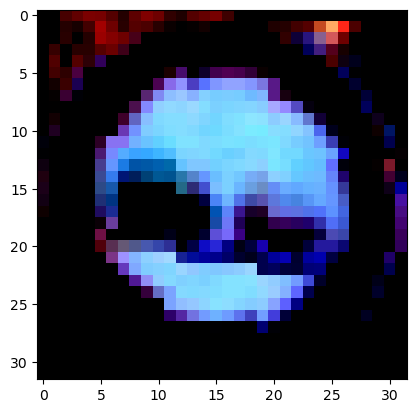

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


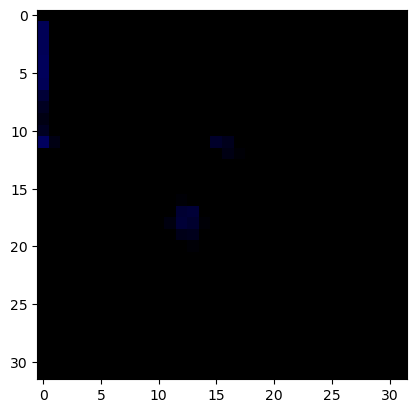

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


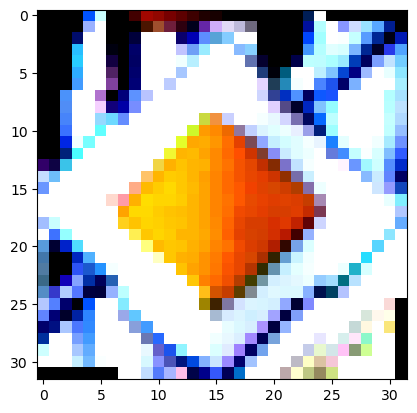

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


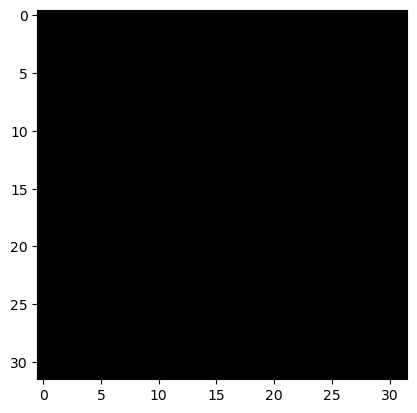

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


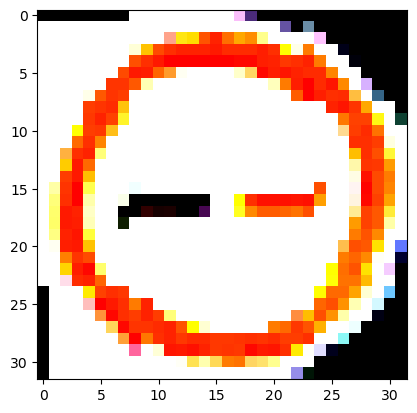

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 32
Predicted Label: 32


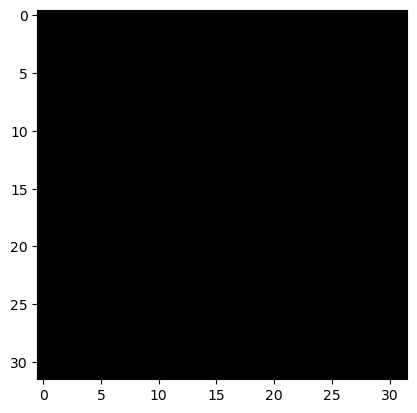

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


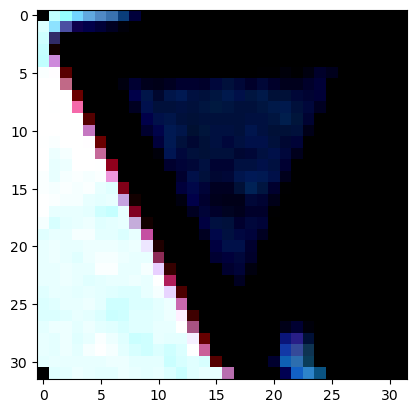

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 20
Predicted Label: 20


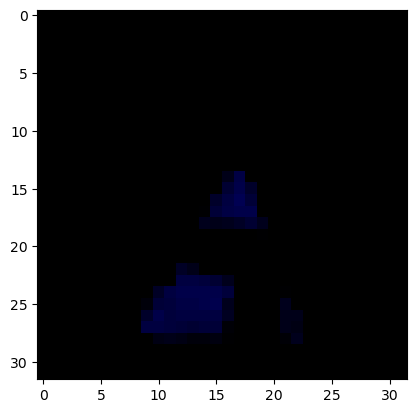

True Label: 20


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 20


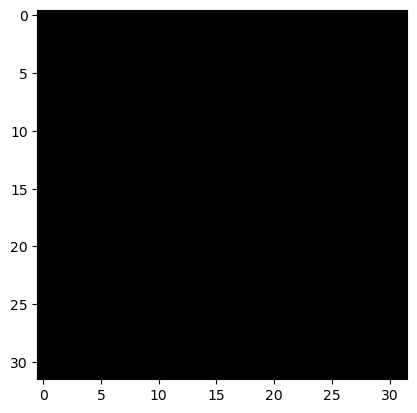

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


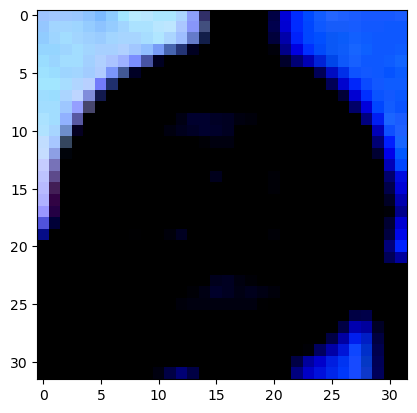

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


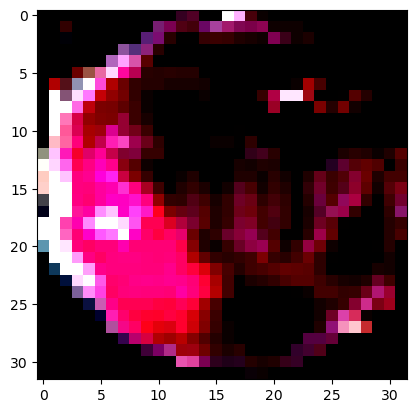

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


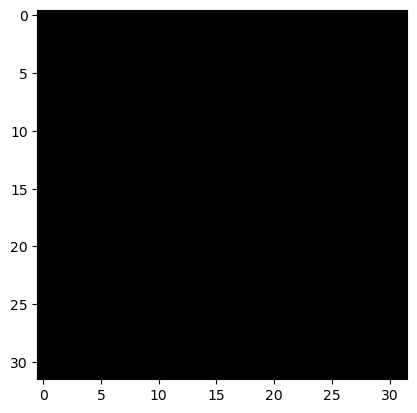

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 24
Predicted Label: 24


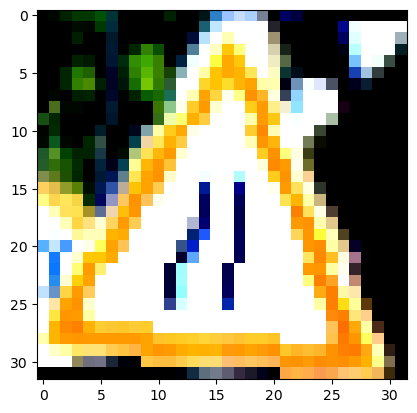

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


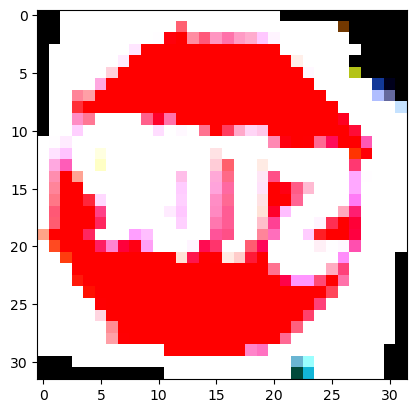

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


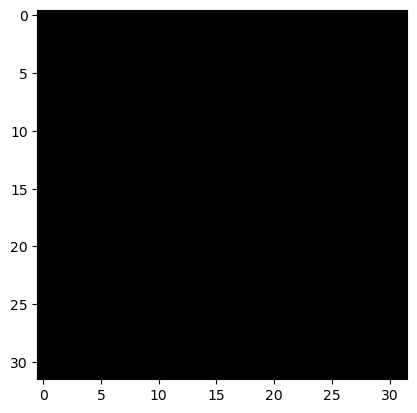

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


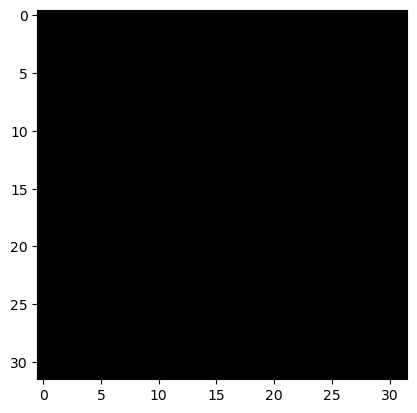

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


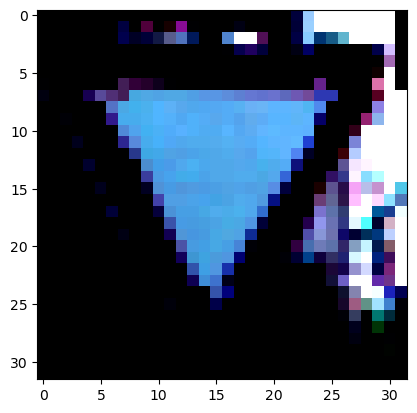

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


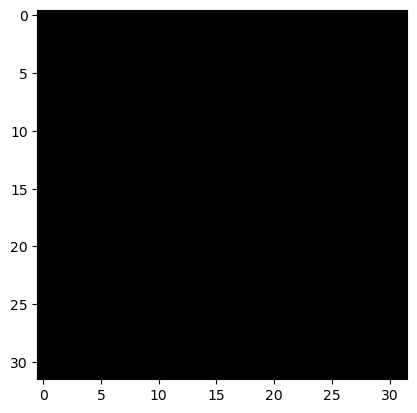

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 41
Predicted Label: 41


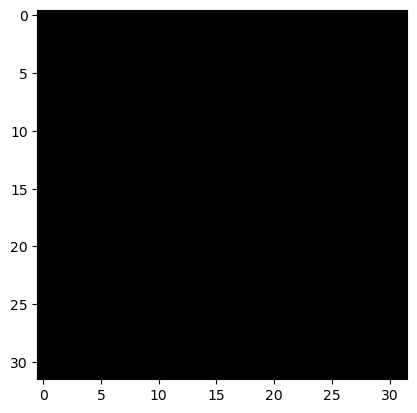

True Label: 35
Predicted Label: 35


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


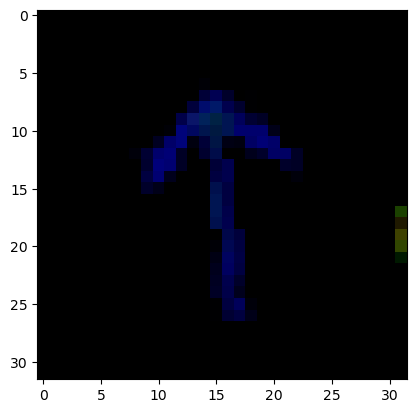

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


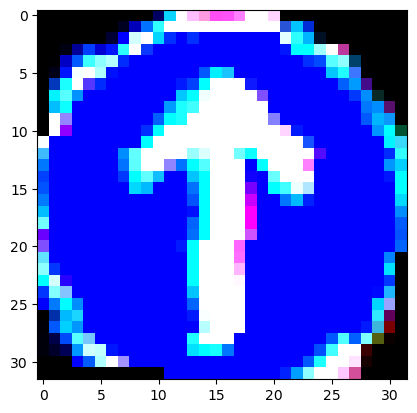

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 26
Predicted Label: 26


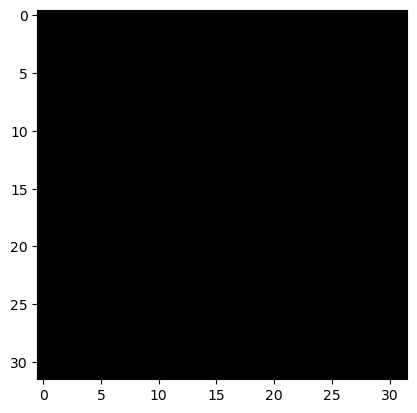

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


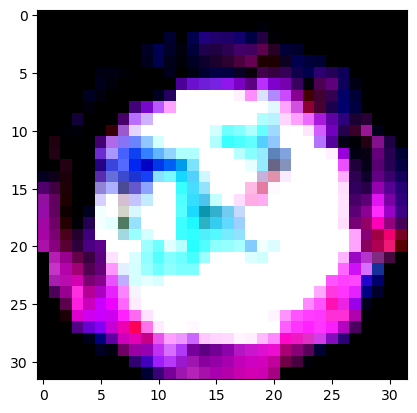

True Label: 23


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 23


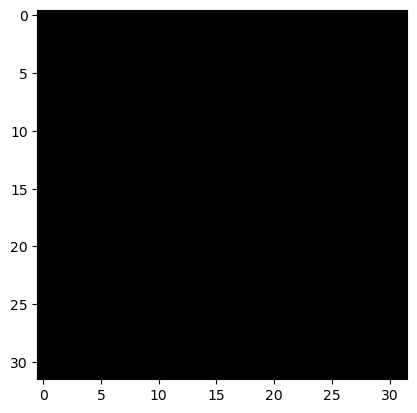

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


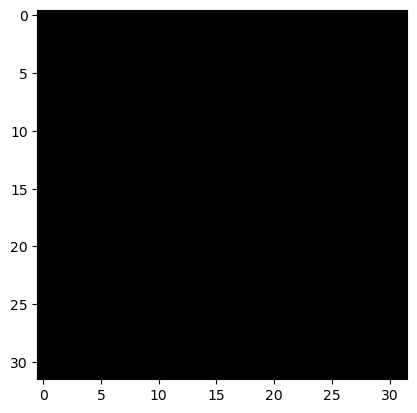

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 36
Predicted Label: 36


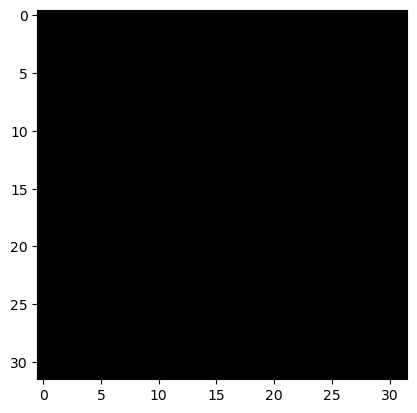

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


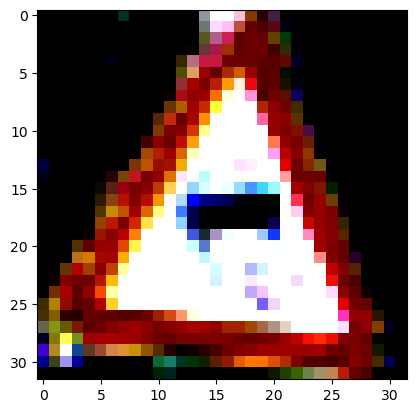

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


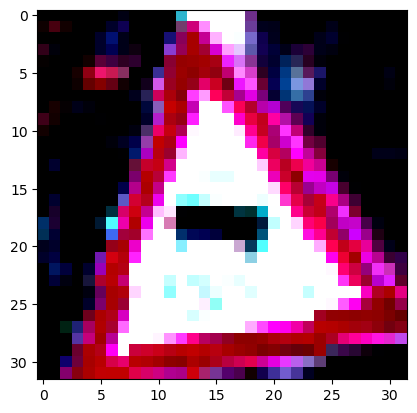

True Label: 23


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 23


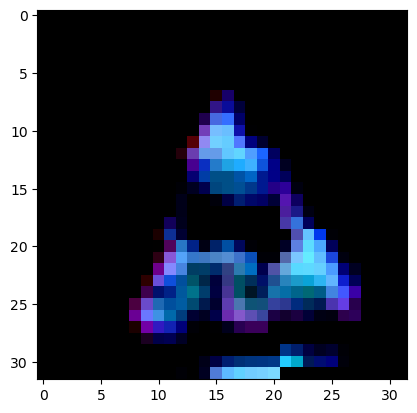

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


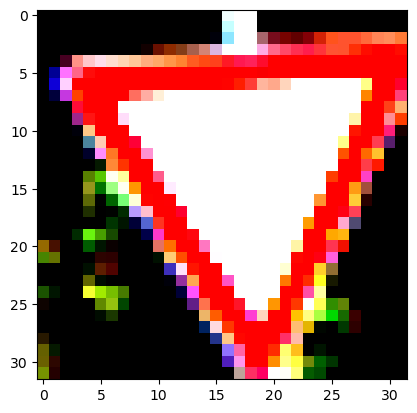

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 34
Predicted Label: 34


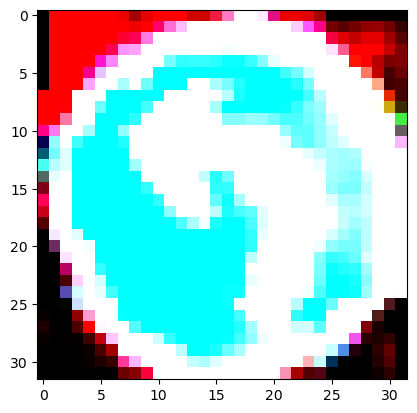

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


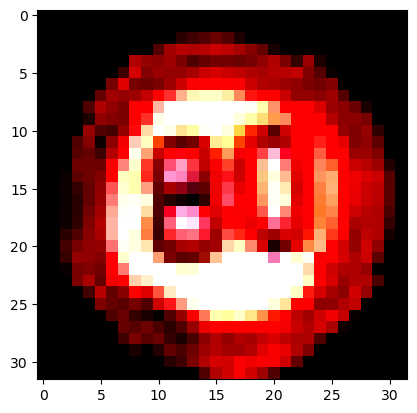

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


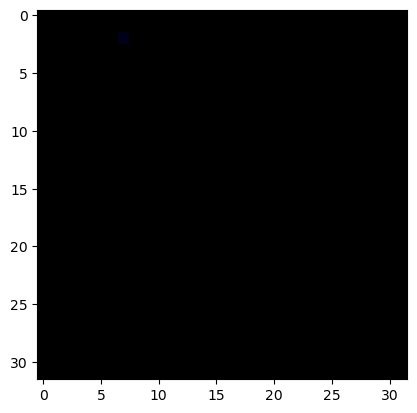

True Label: 1


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 1


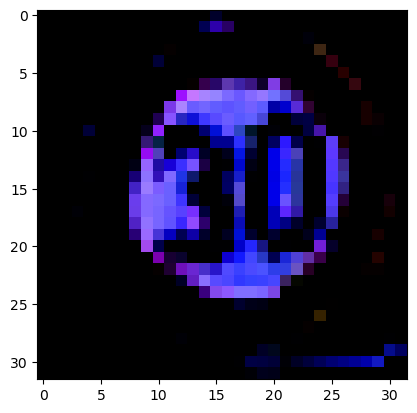

True Label: 13


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 13


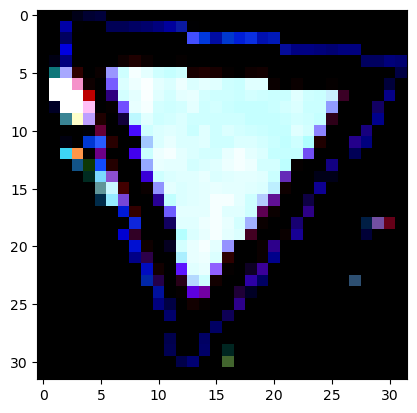

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 27


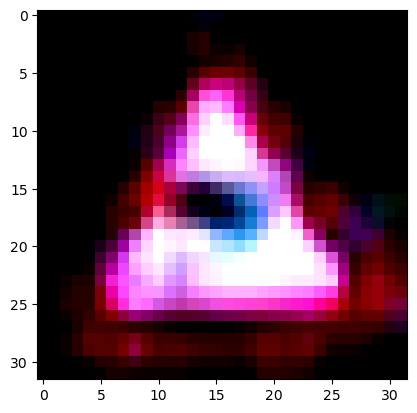

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


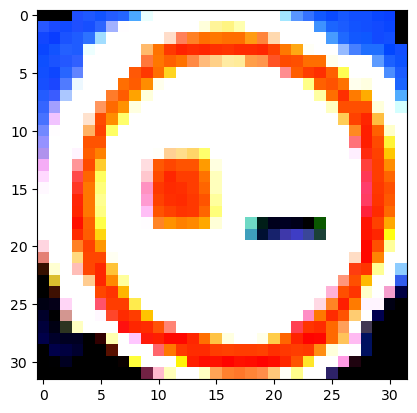

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 26
Predicted Label: 26


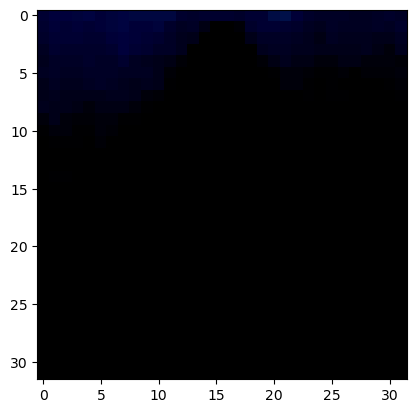

True Label: 12


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 12


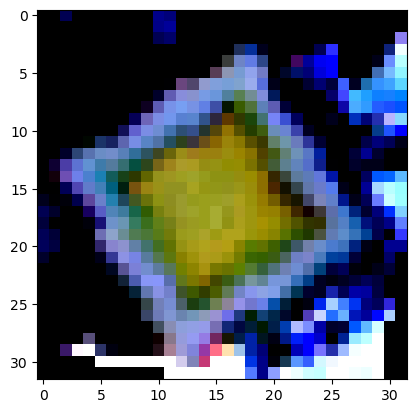

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


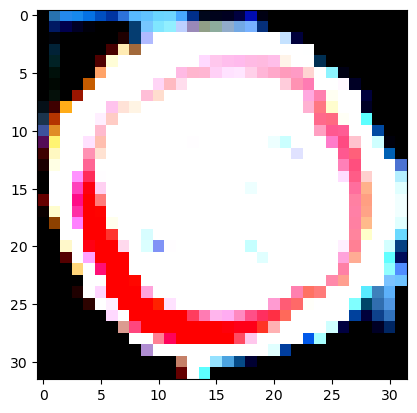

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 29
Predicted Label: 29


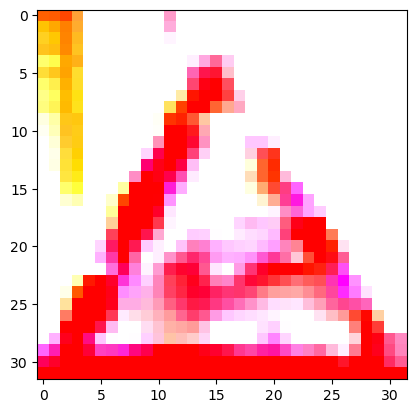

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 28


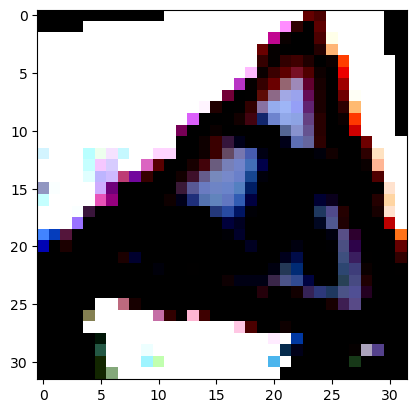

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


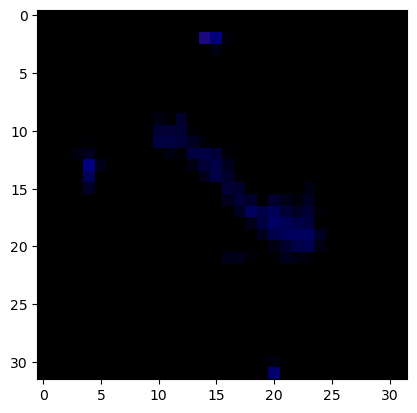

True Label: 25


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 25


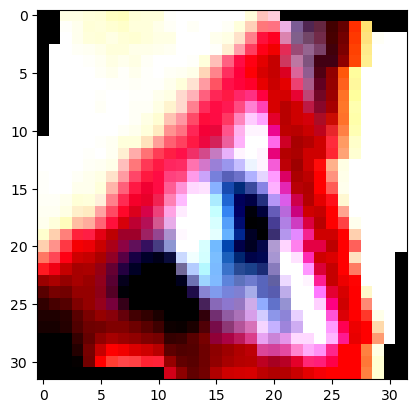

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


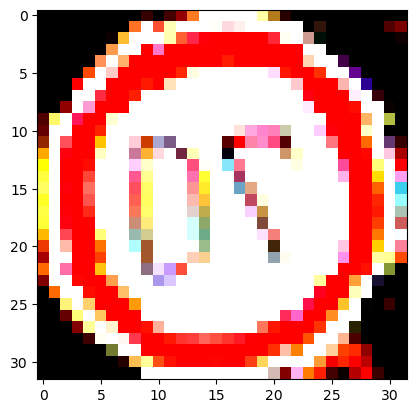

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 29
Predicted Label: 29


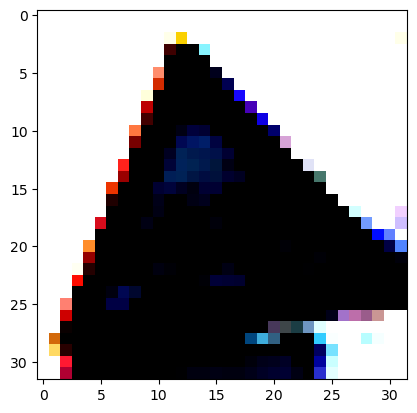

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 27
Predicted Label: 27


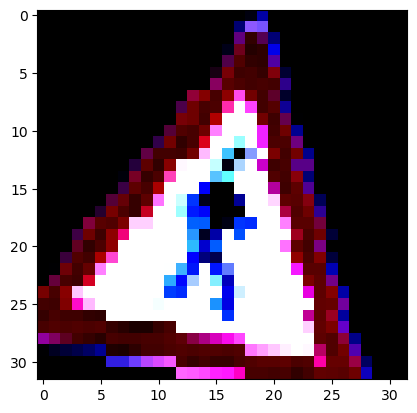

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


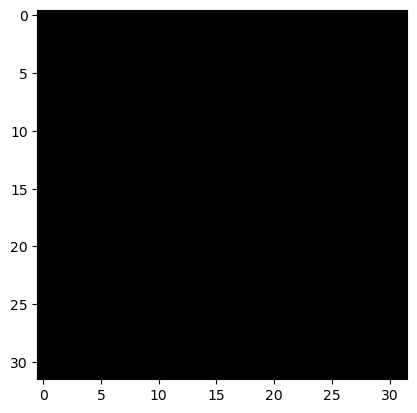

True Label: 9


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 9


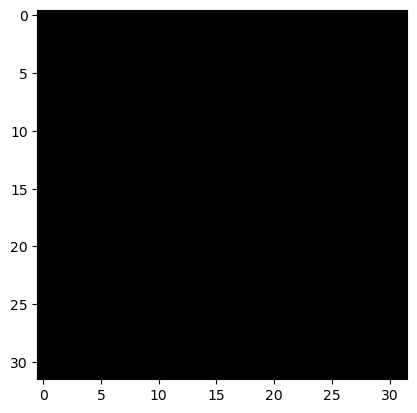

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


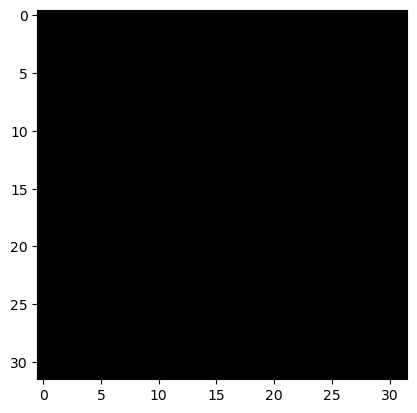

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


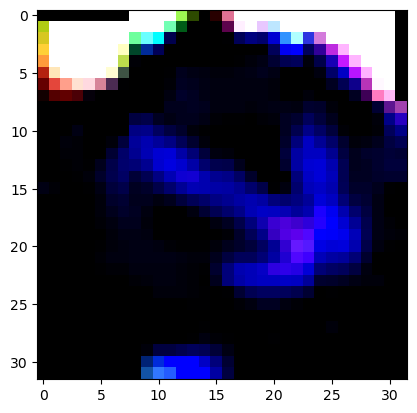

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 41


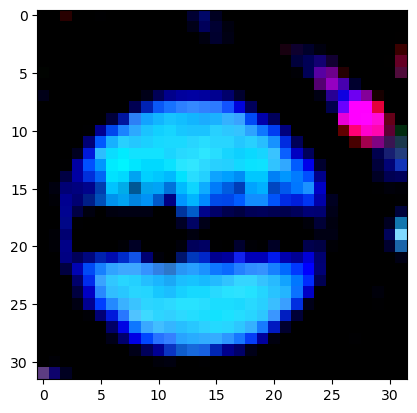

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


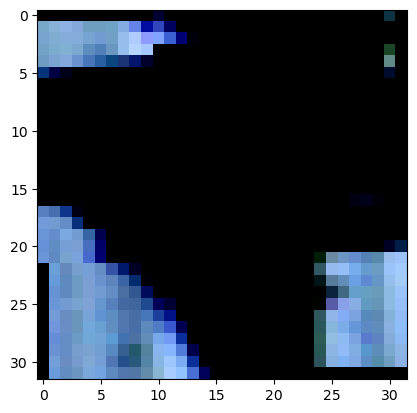

True Label: 31


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 31


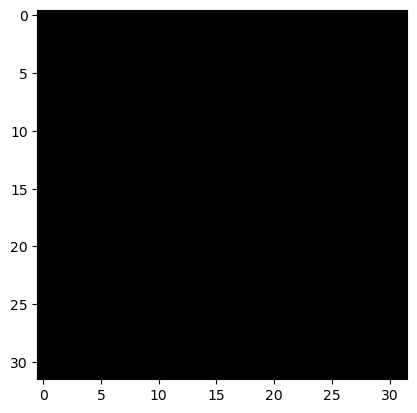

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 30
Predicted Label: 30


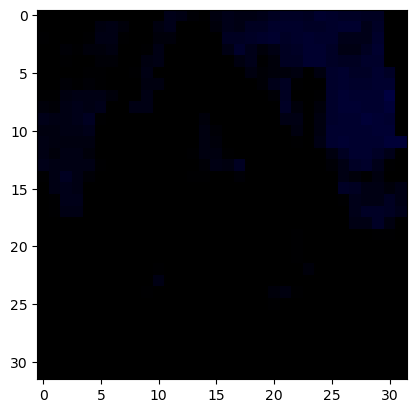

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


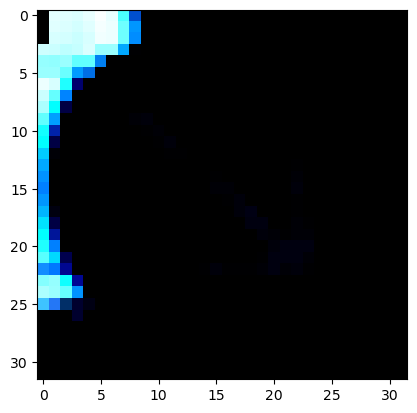

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


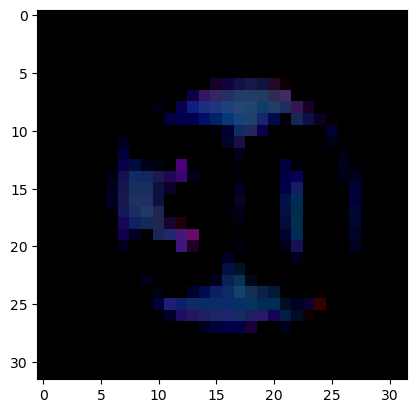

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


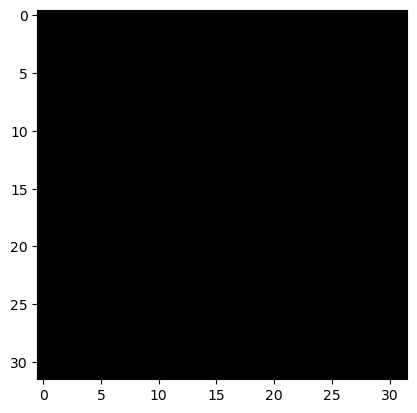

True Label: 14


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 14


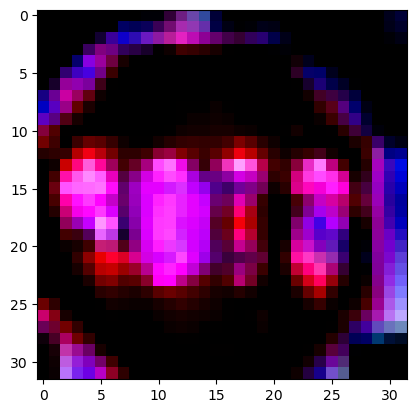

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


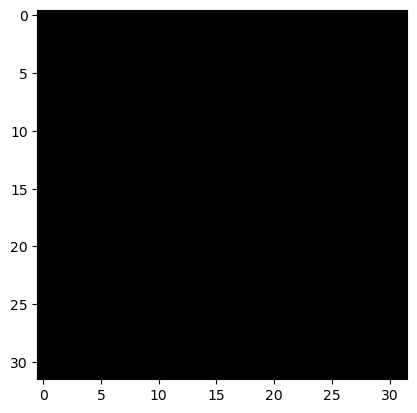

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 21
Predicted Label: 21


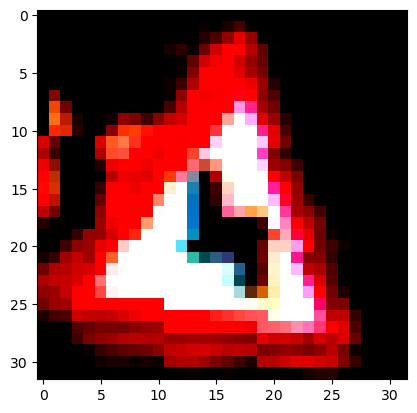

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


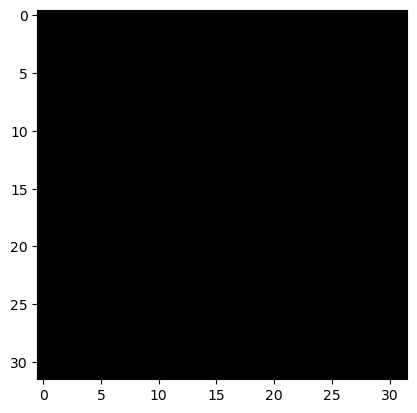

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 6
Predicted Label: 6


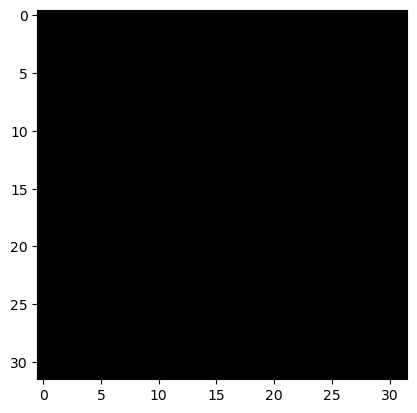

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


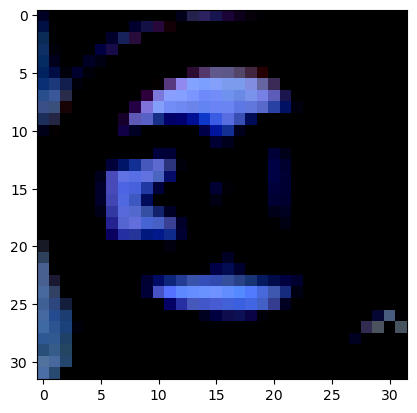

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


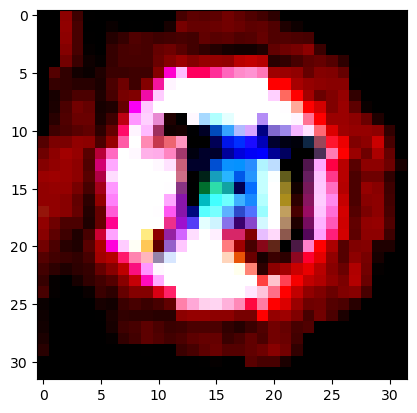

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


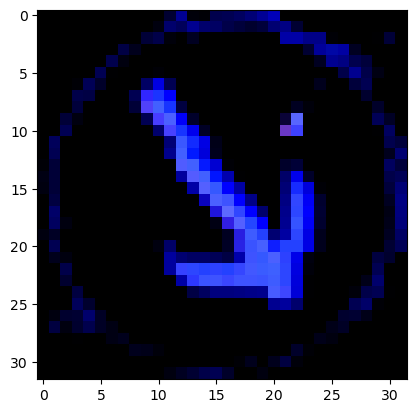

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 33
Predicted Label: 33


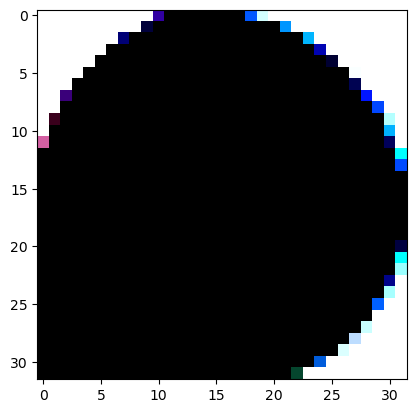

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


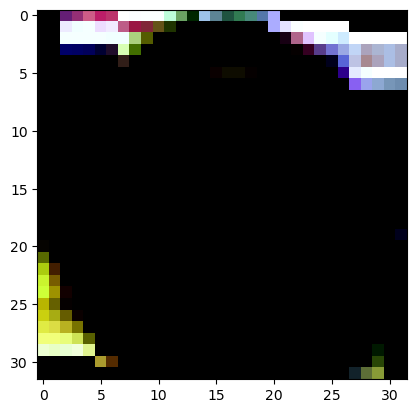

True Label: 4


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 4


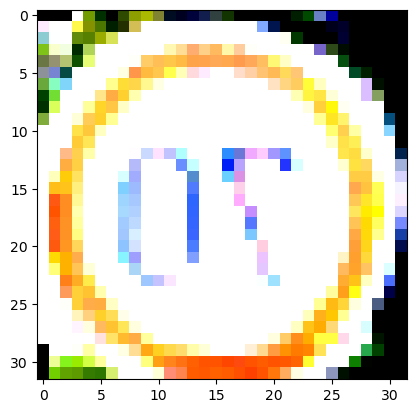

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


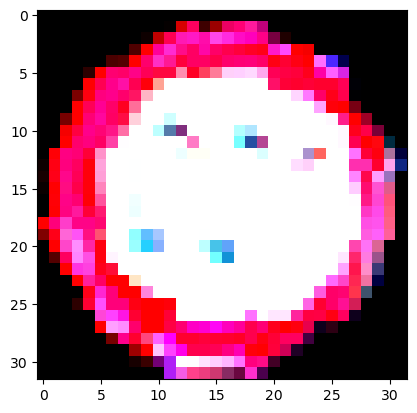

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


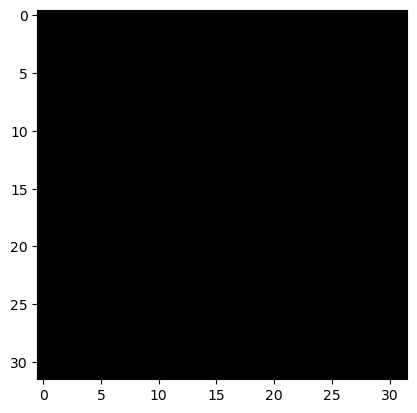

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 30
Predicted Label: 30


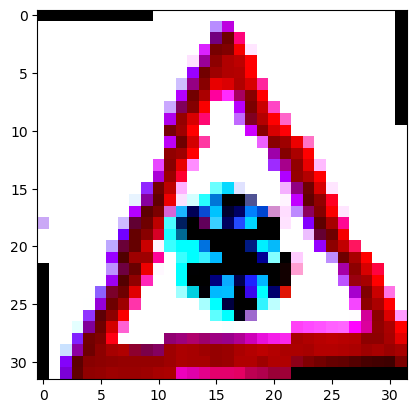

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


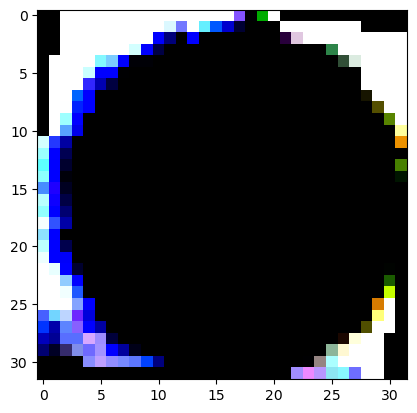

True Label: 38


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 38


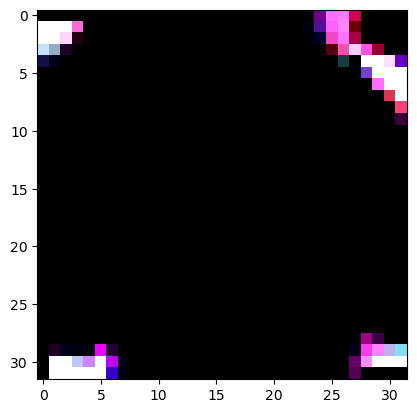

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


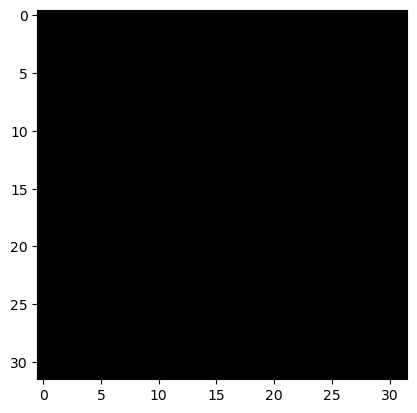

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


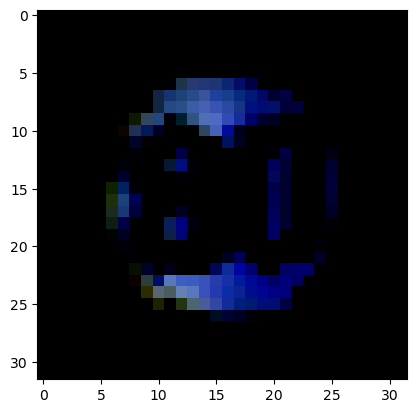

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


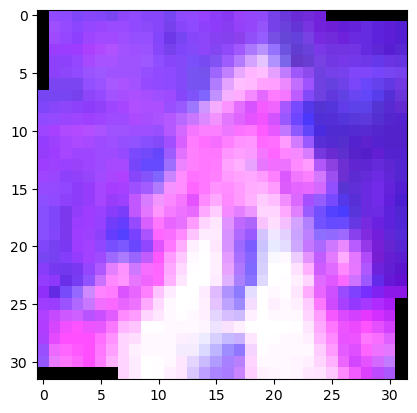

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


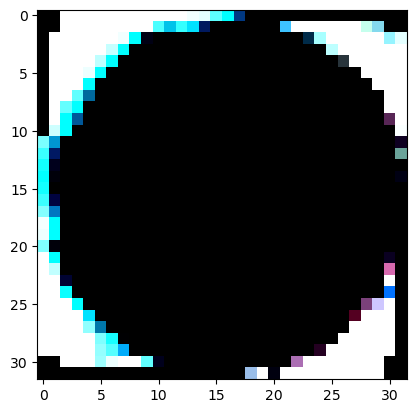

True Label: 13


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 13


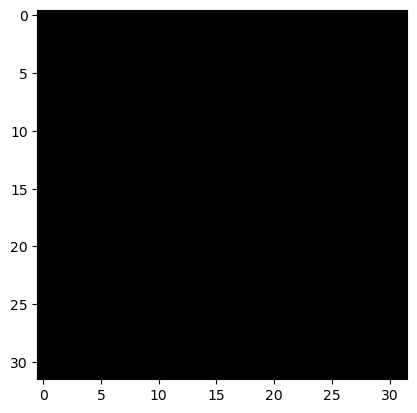

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


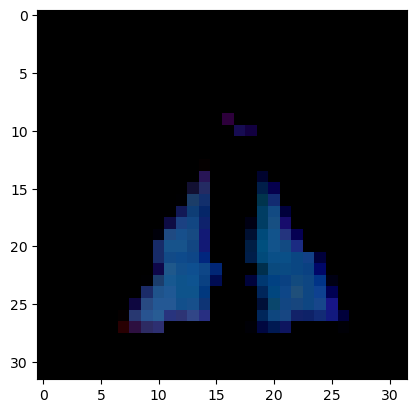

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


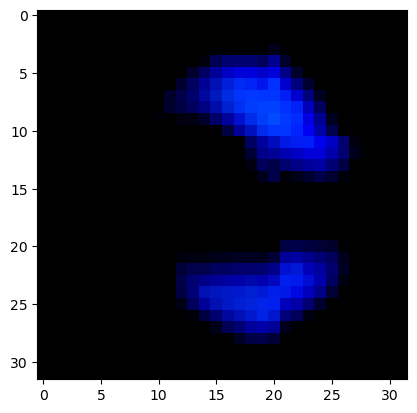

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


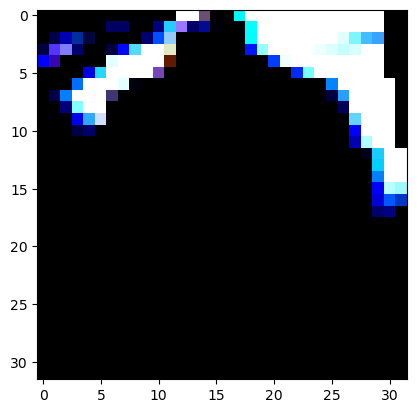

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


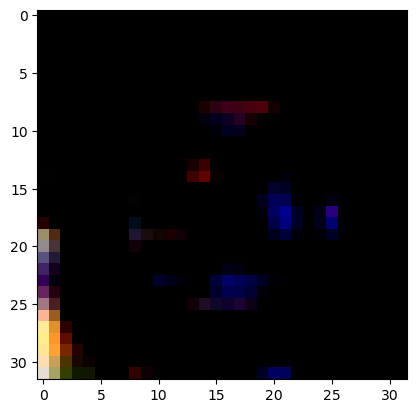

True Label: 25


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 25


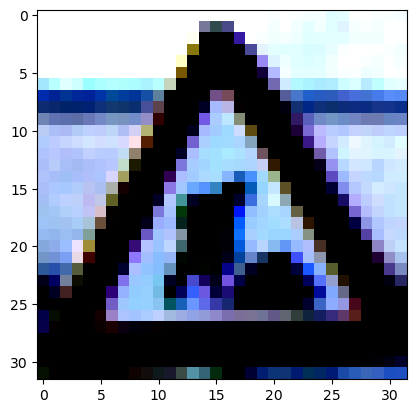

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


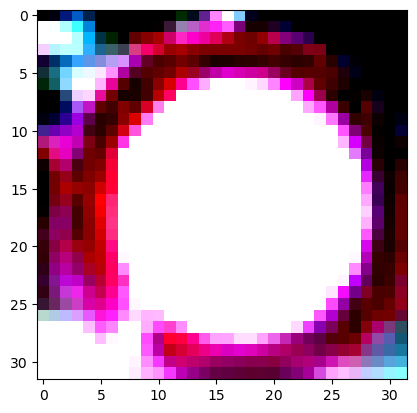

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 40
Predicted Label: 40


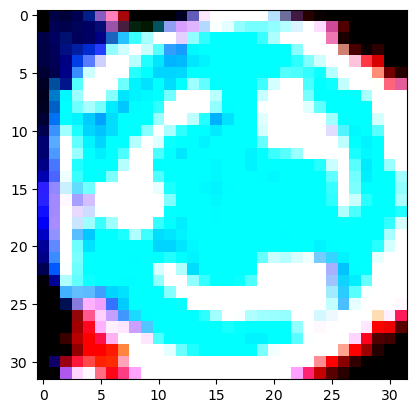

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


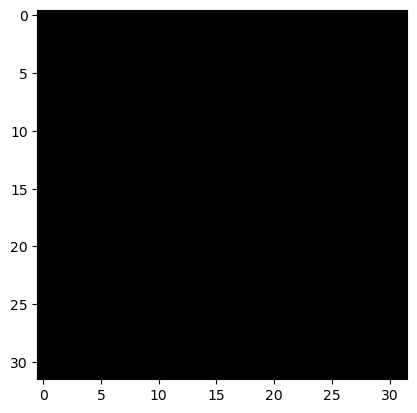

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 32
Predicted Label: 32


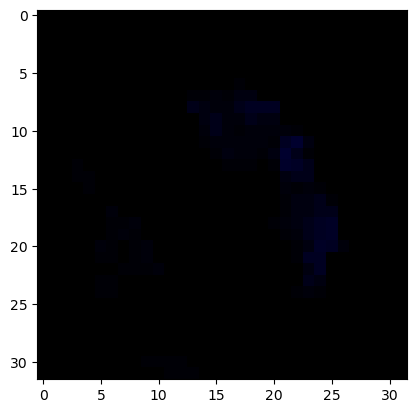

True Label: 12


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 12


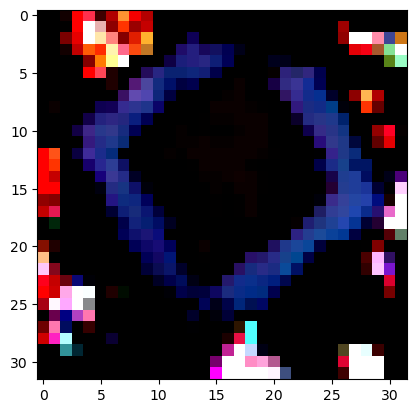

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


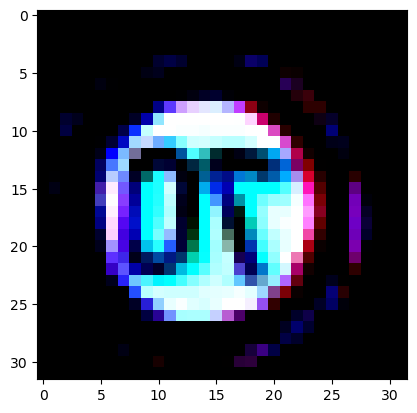

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


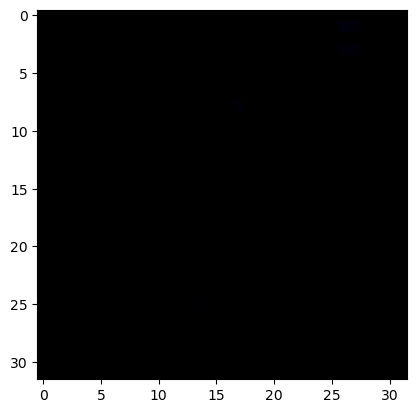

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 29
Predicted Label: 29


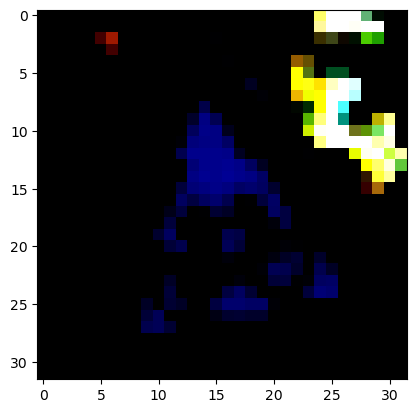

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


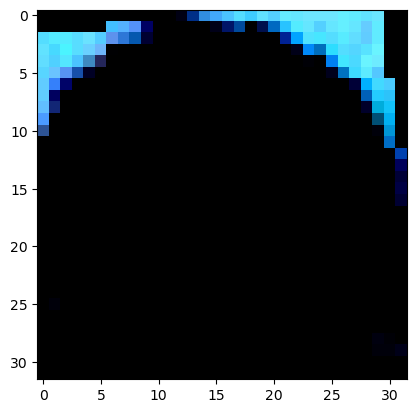

True Label: 7


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 7


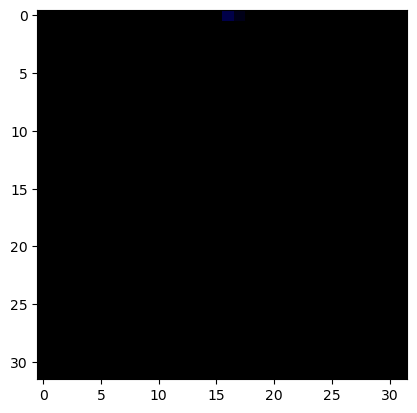

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


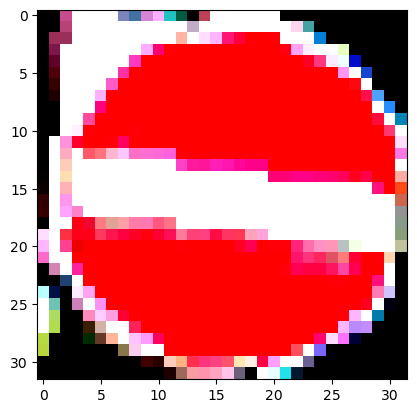

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


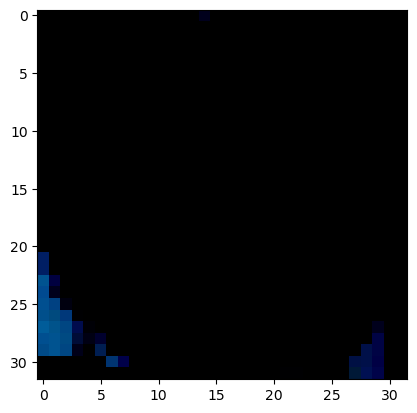

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


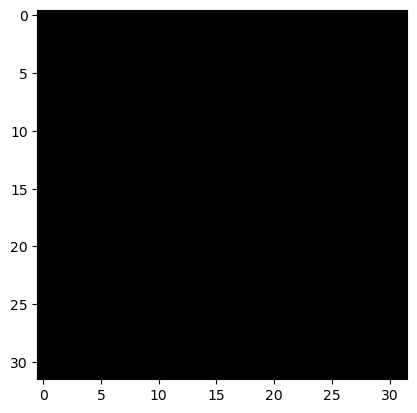

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 13


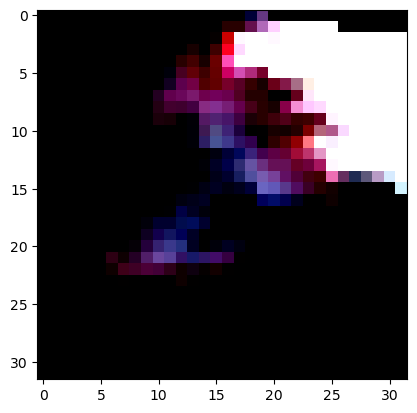

True Label: 28


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 28


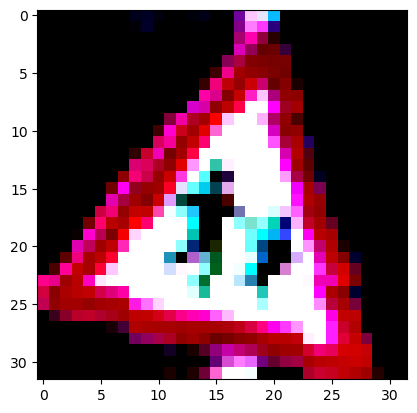

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


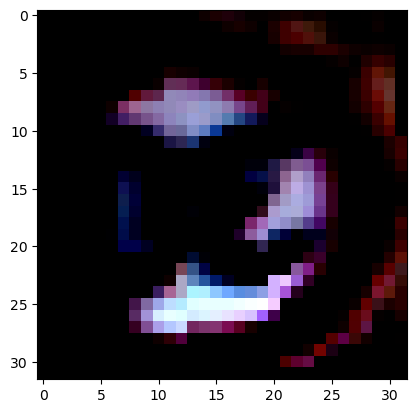

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


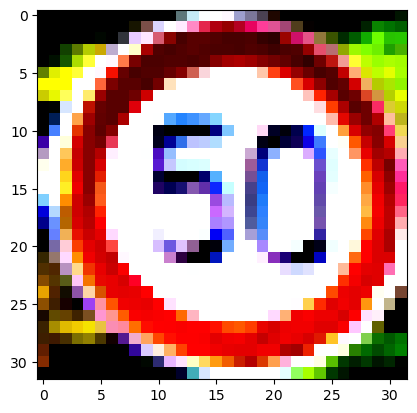

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


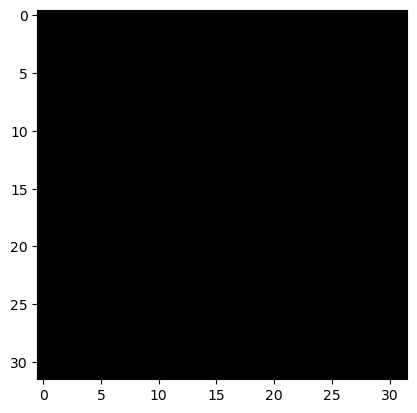

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


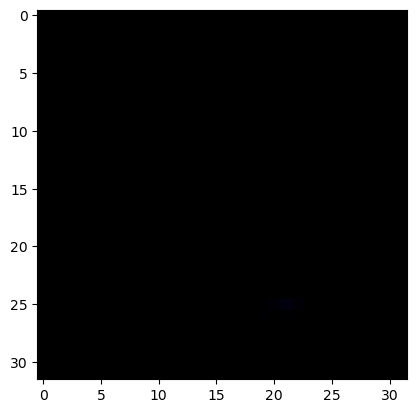

True Label: 21


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 21


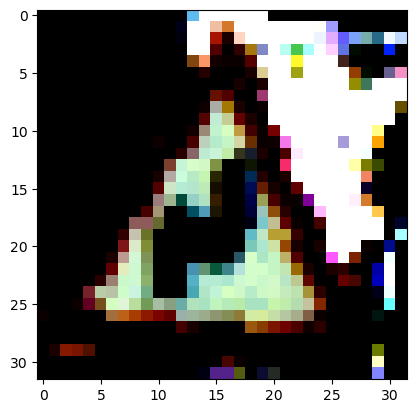

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


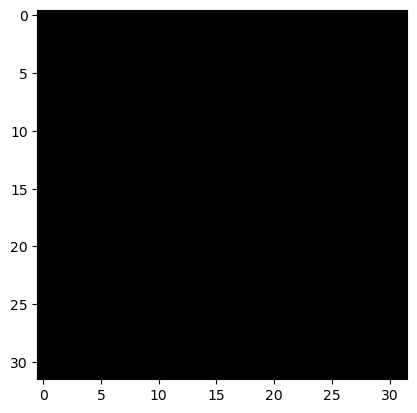

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


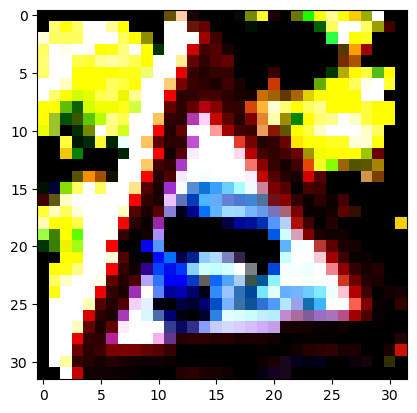

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 21
Predicted Label: 21


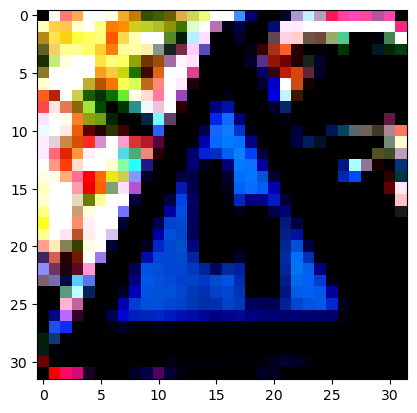

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 20
Predicted Label: 20


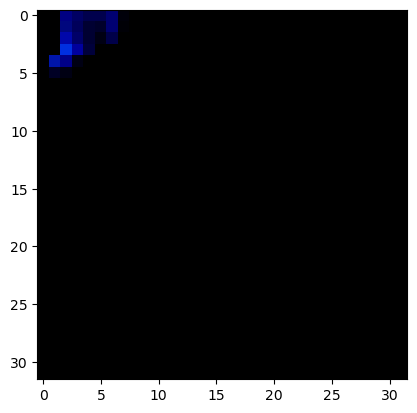

True Label: 3


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 3


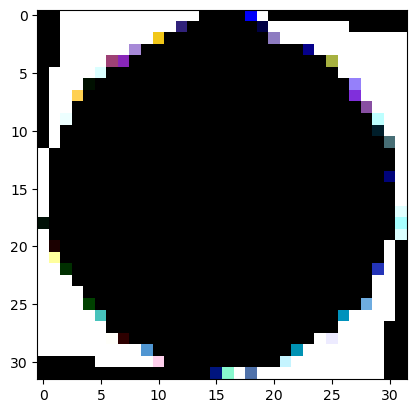

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


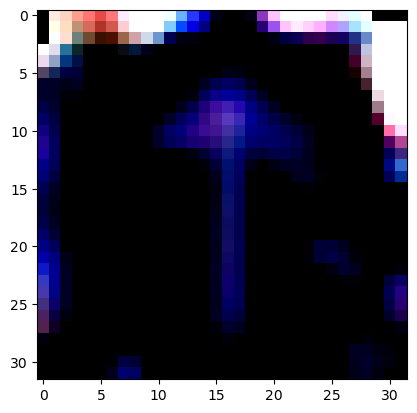

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


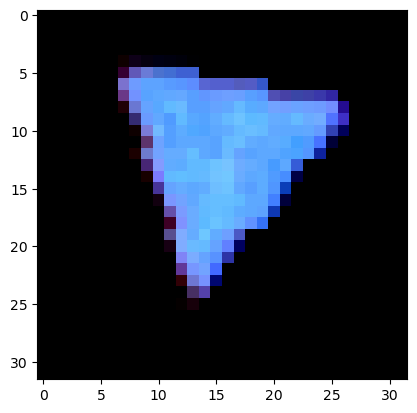

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


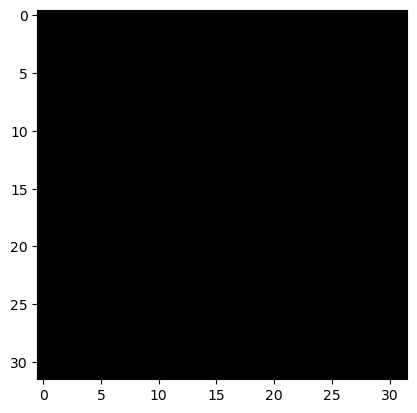

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


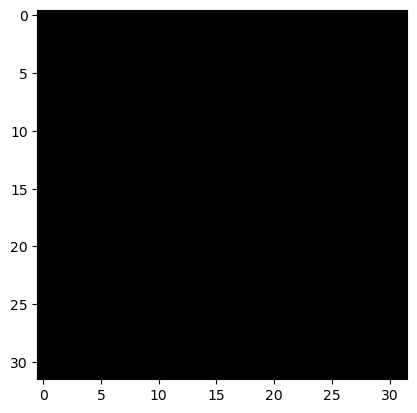

True Label: 17


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 17


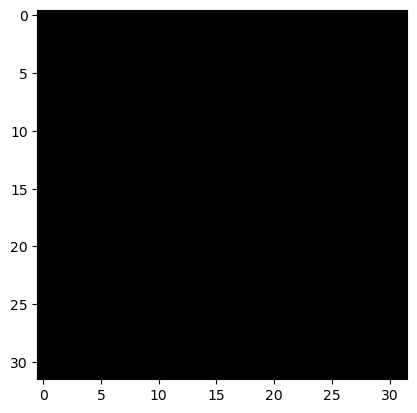

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 29
Predicted Label: 29


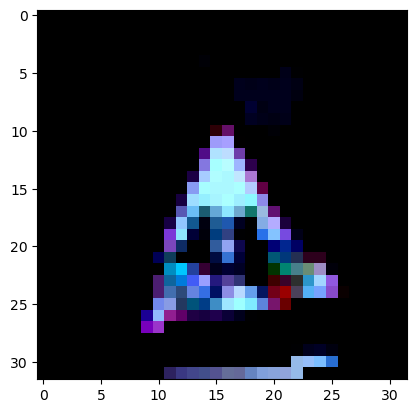

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 40
Predicted Label: 40


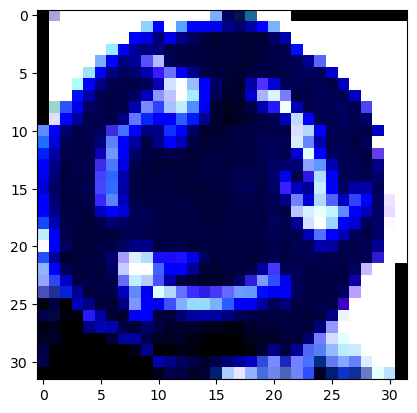

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


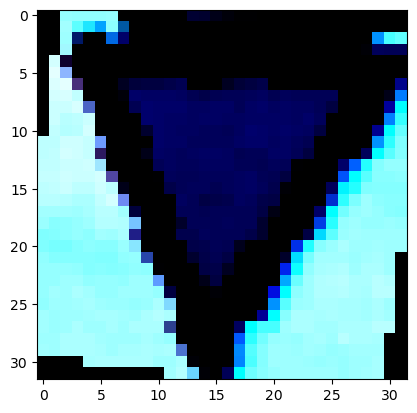

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 26
Predicted Label: 26


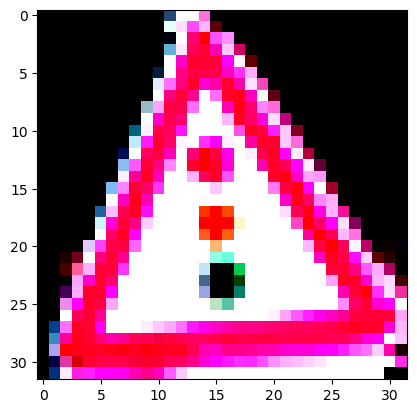

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


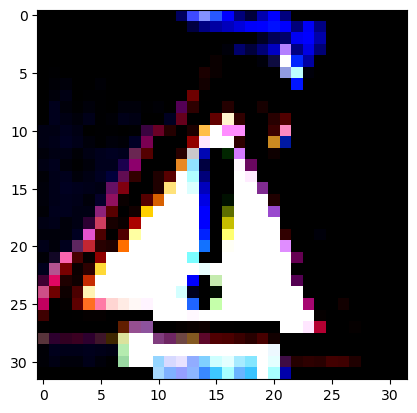

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


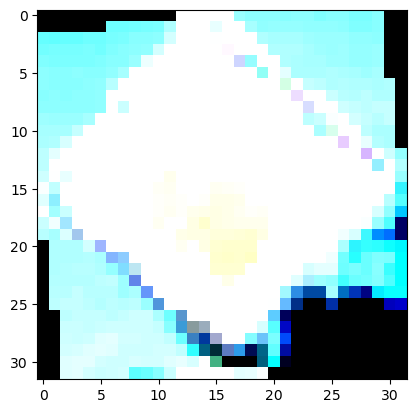

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


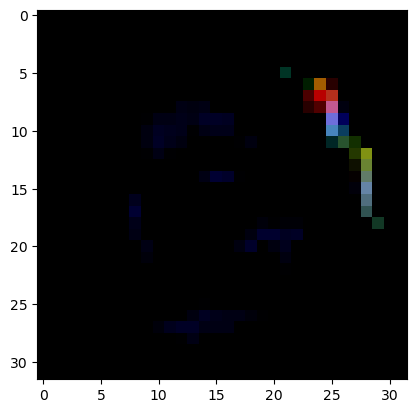

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


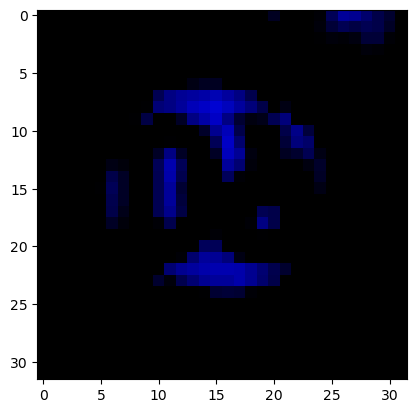

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


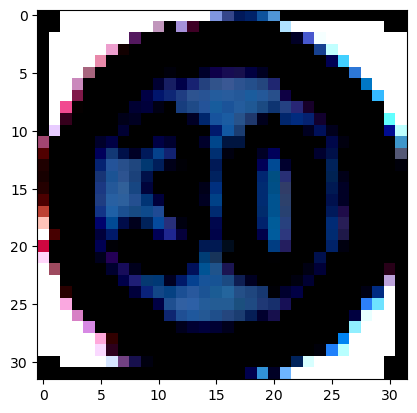

True Label: 36


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 36


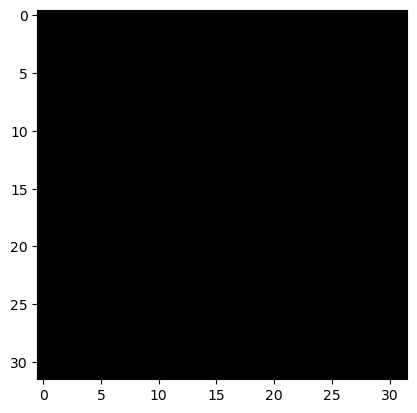

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


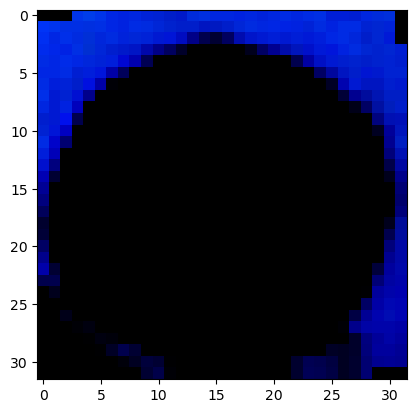

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 34
Predicted Label: 34


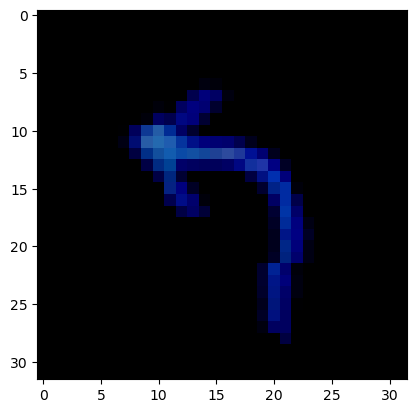

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


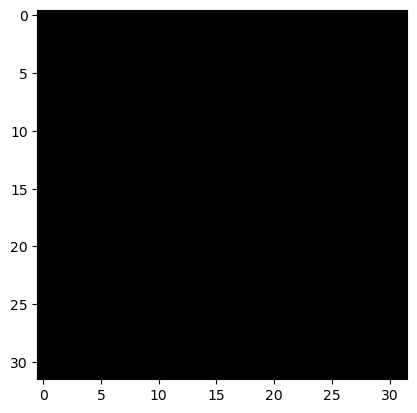

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


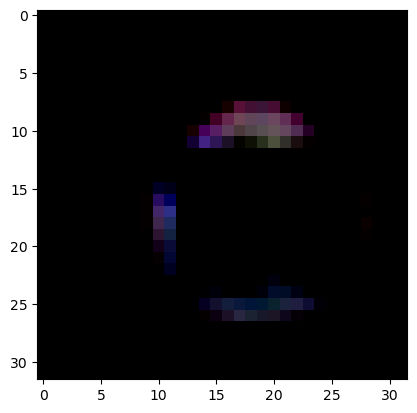

True Label: 5
Predicted Label: 5


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


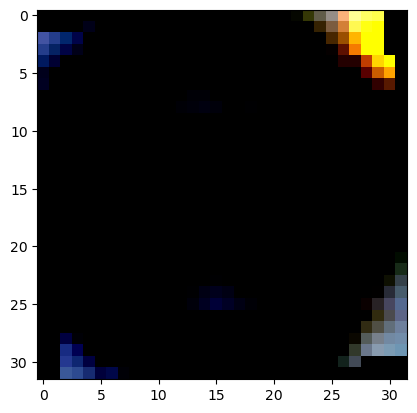

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


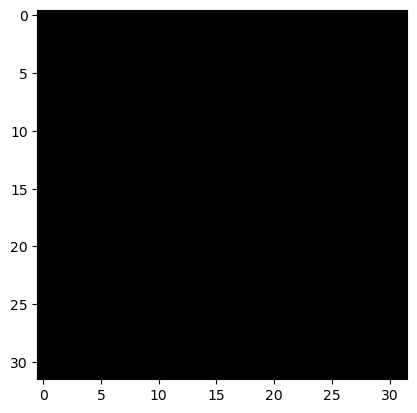

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 39
Predicted Label: 39


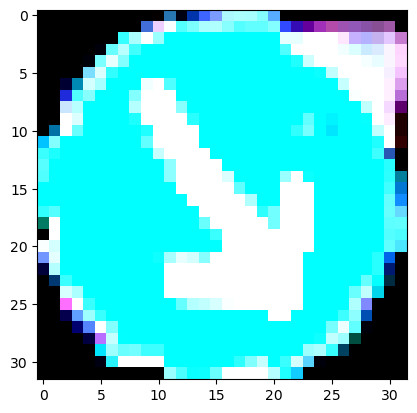

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 36
Predicted Label: 36


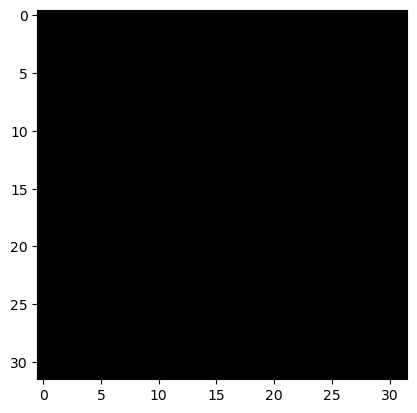

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


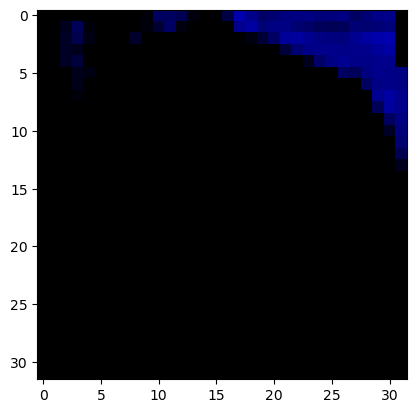

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


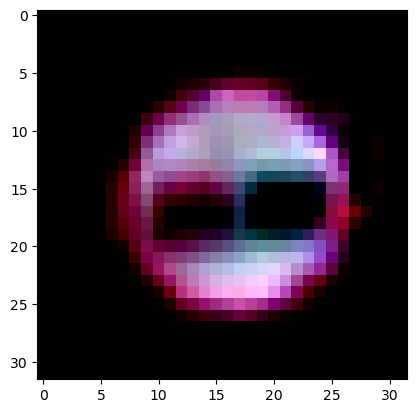

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


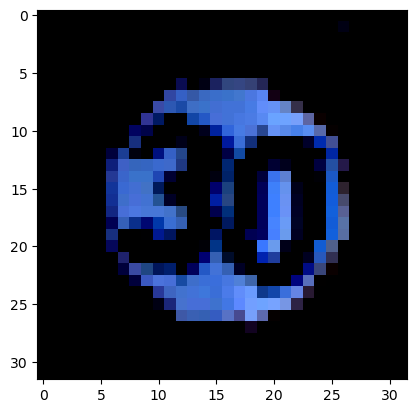

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


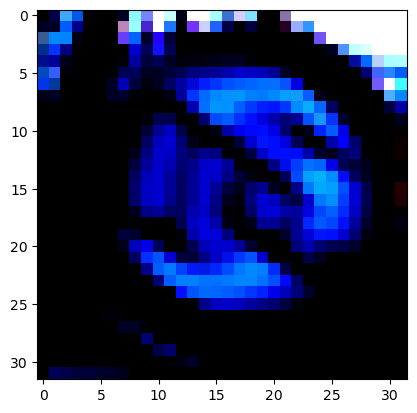

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 33
Predicted Label: 33


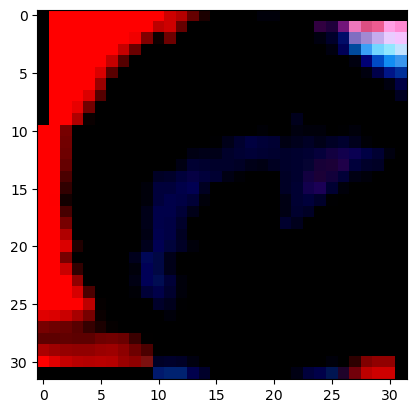

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


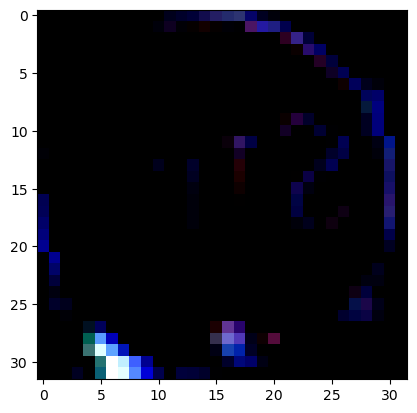

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


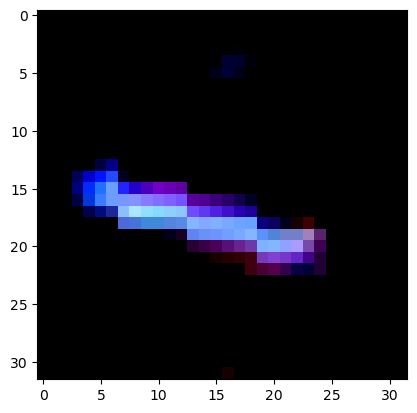

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


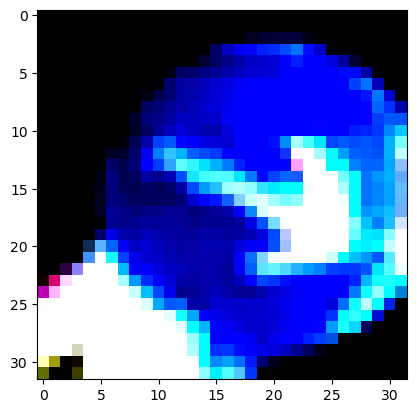

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


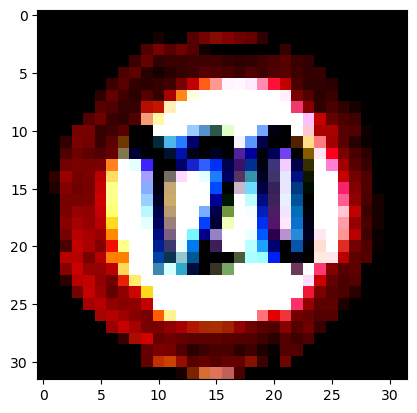

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


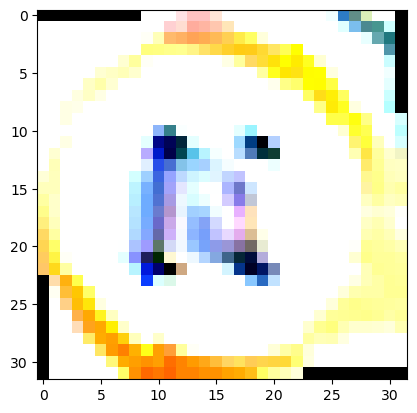

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


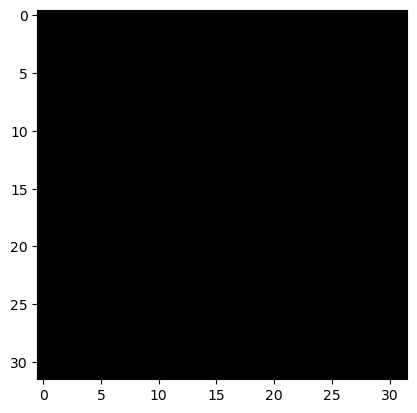

True Label: 3


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 3


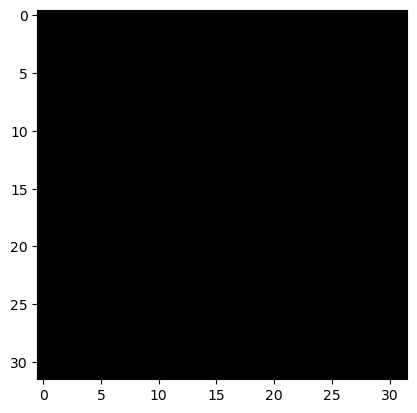

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 6
Predicted Label: 6


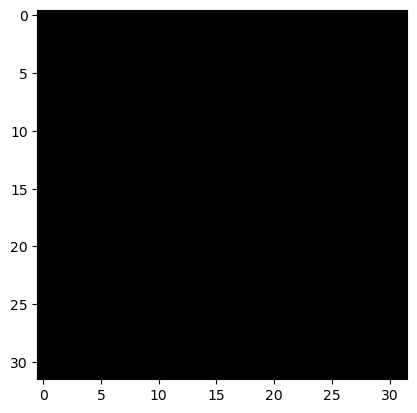

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


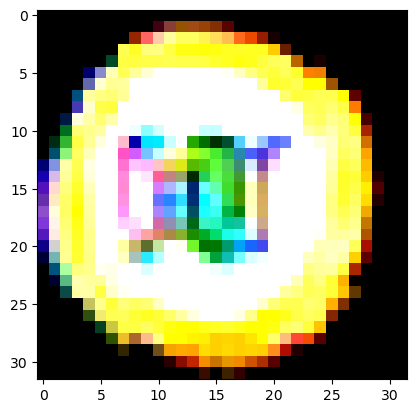

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


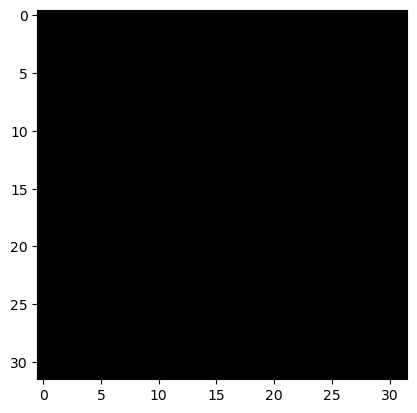

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


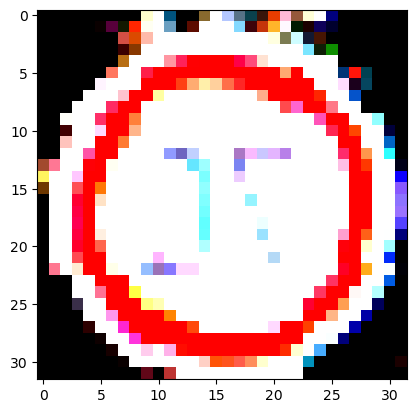

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


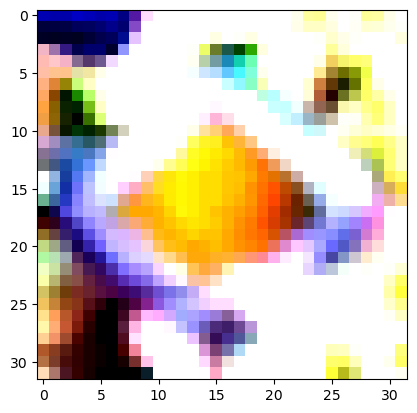

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


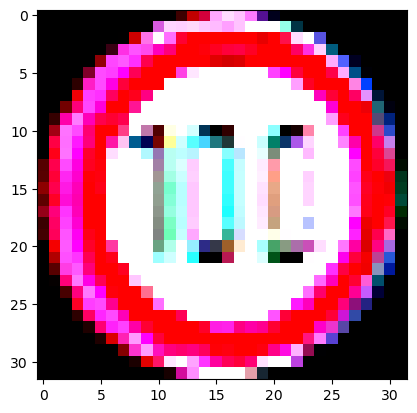

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


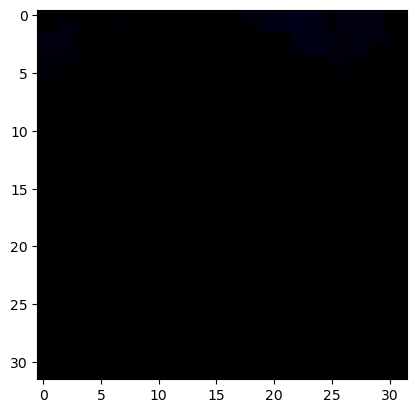

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


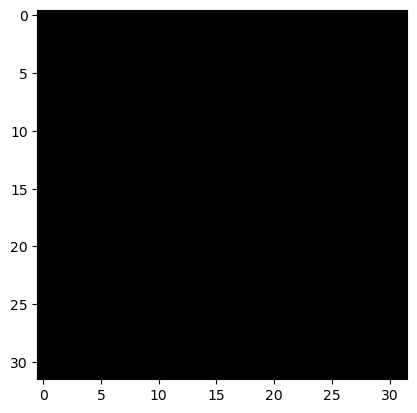

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


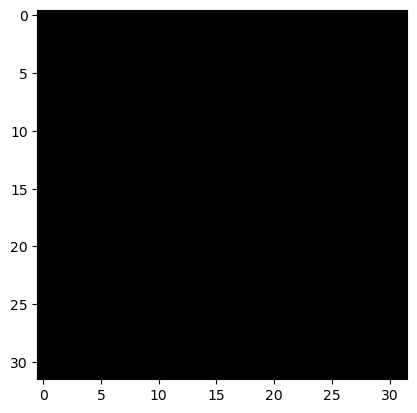

True Label: 1


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 1


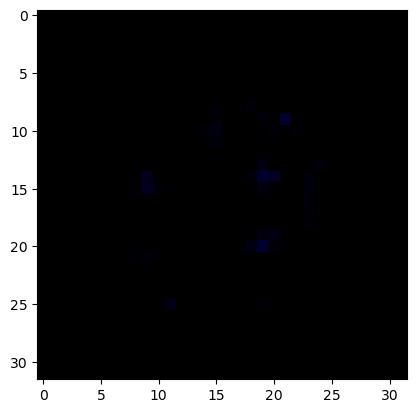

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


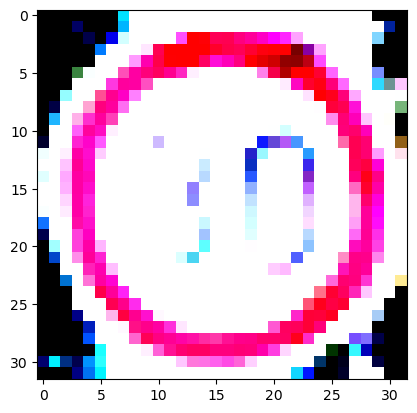

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


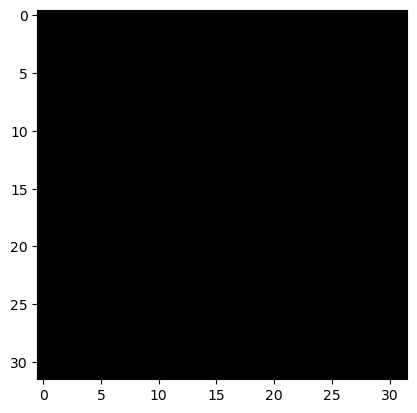

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 40
Predicted Label: 40


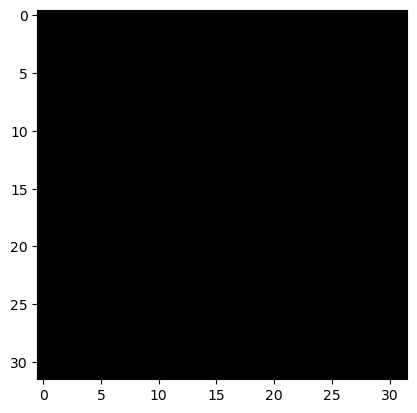

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 37
Predicted Label: 37


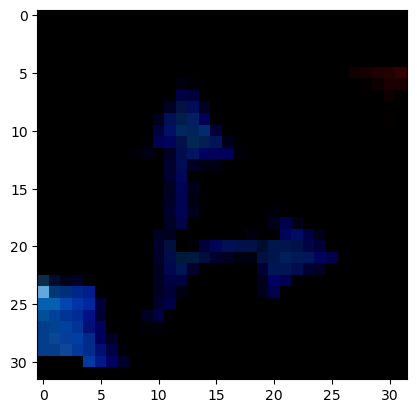

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


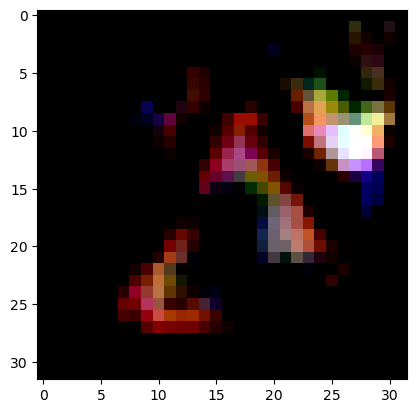

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


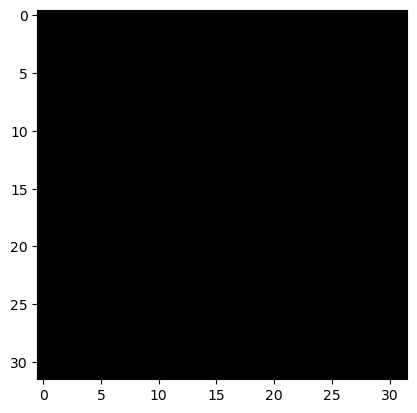

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


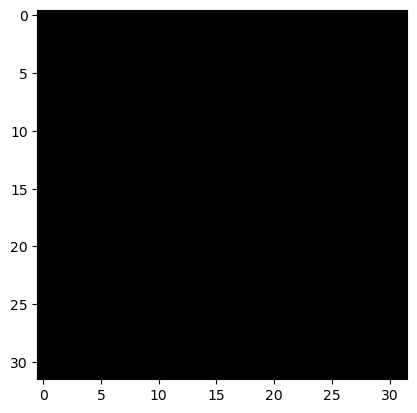

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 28
Predicted Label: 28


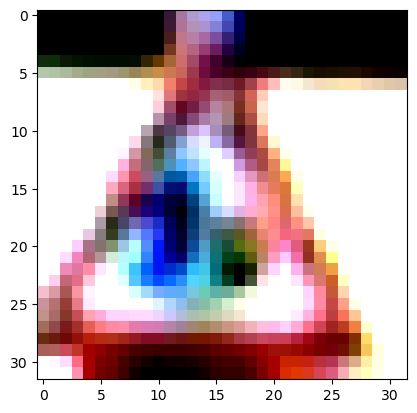

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 36
Predicted Label: 36


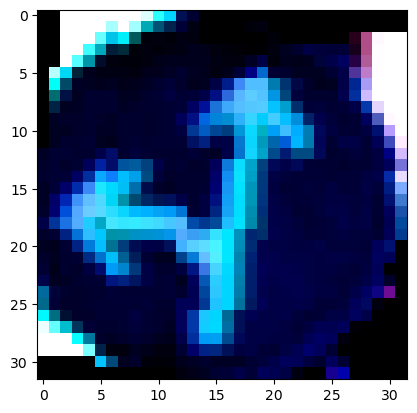

True Label: 11


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 11


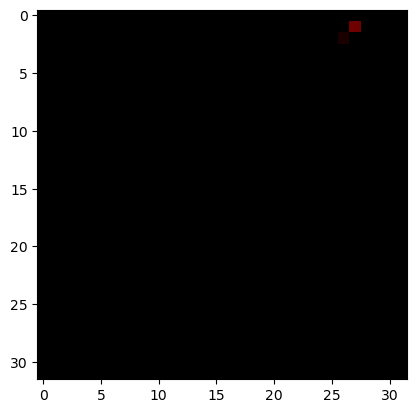

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 30
Predicted Label: 30


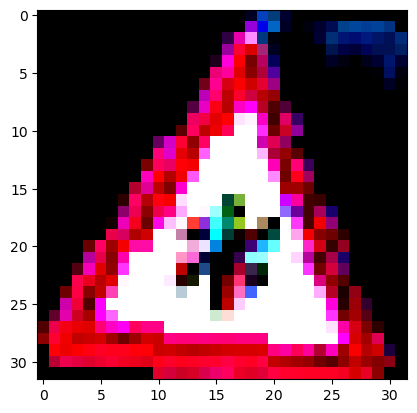

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


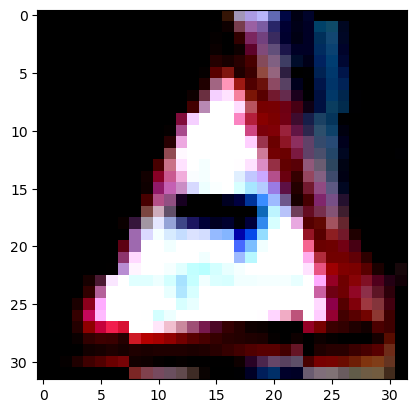

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 29
Predicted Label: 29


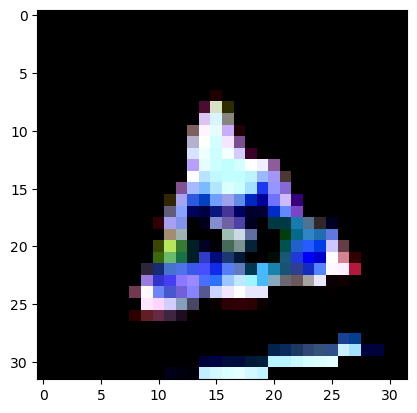

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


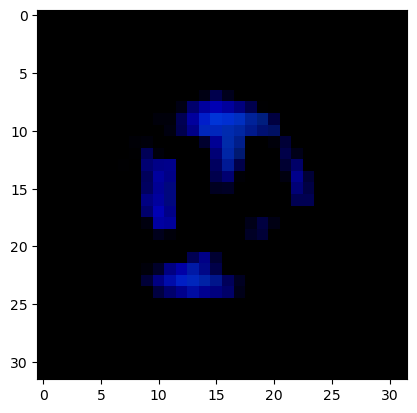

True Label: 18


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 18


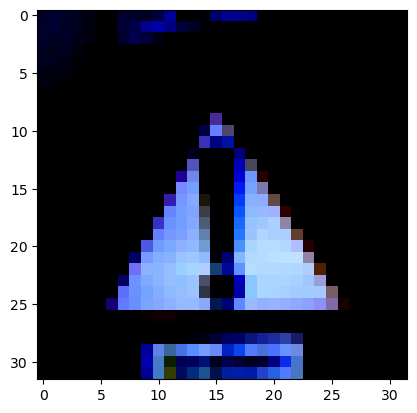

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


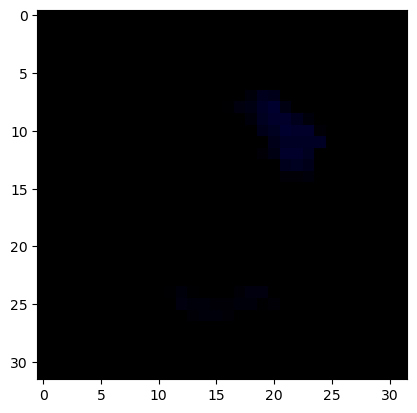

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 31
Predicted Label: 31


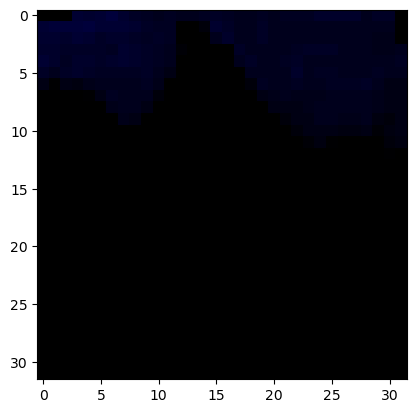

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


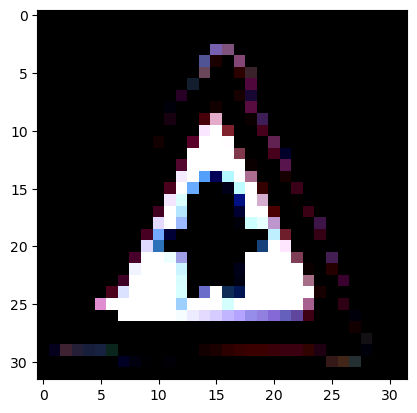

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


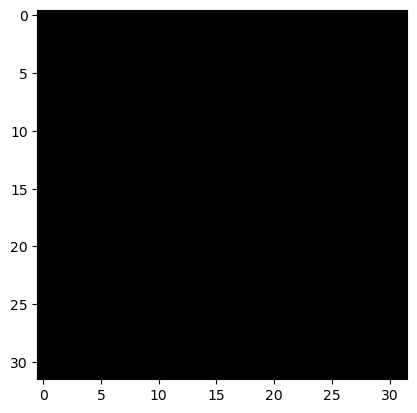

True Label: 11


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 11


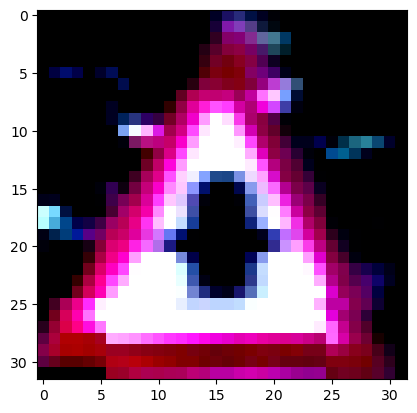

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


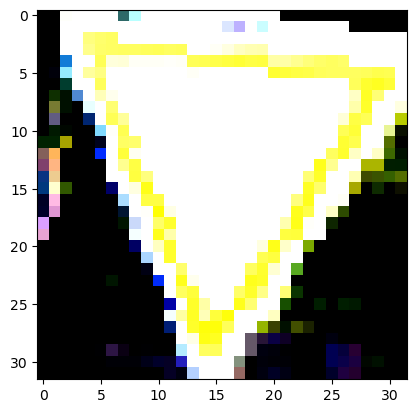

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


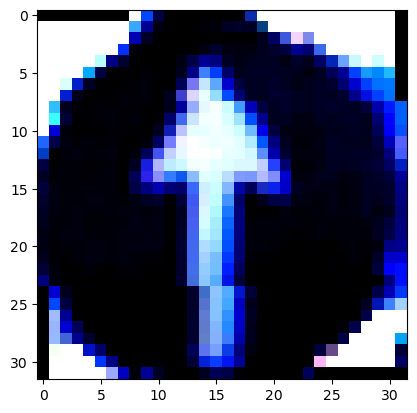

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


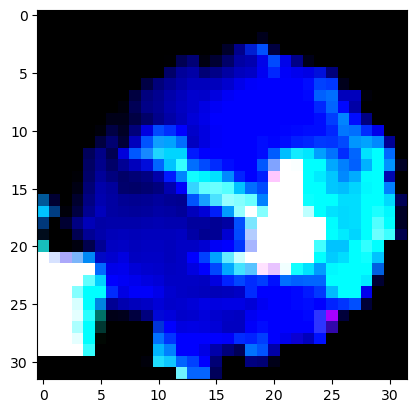

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


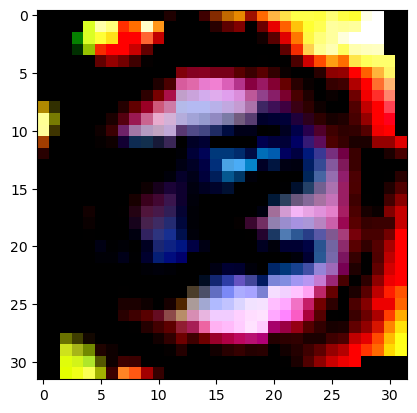

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


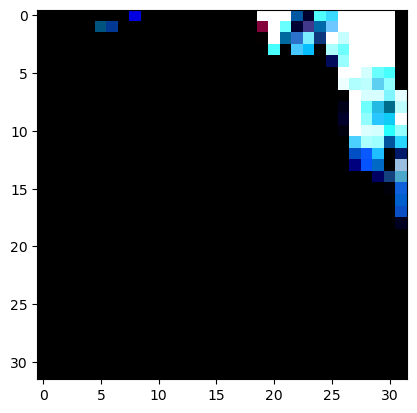

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


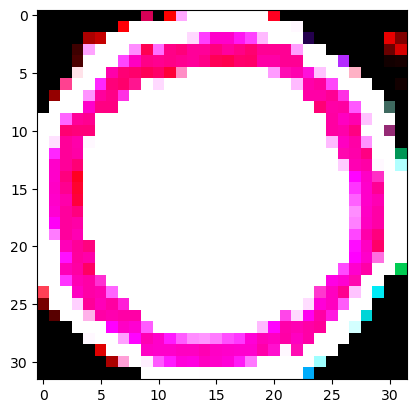

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 23


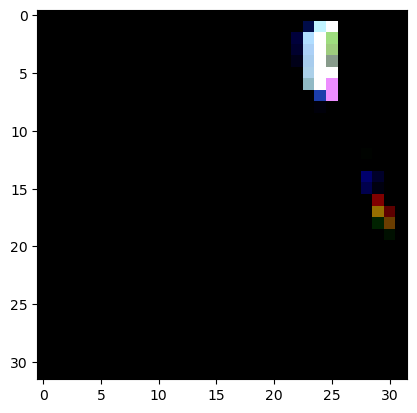

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


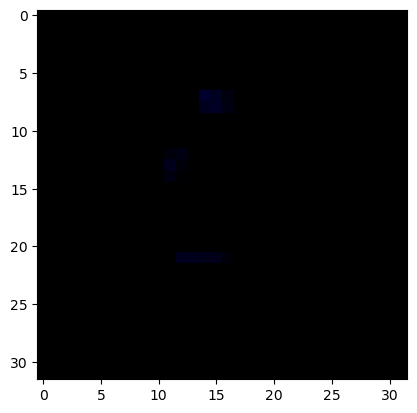

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


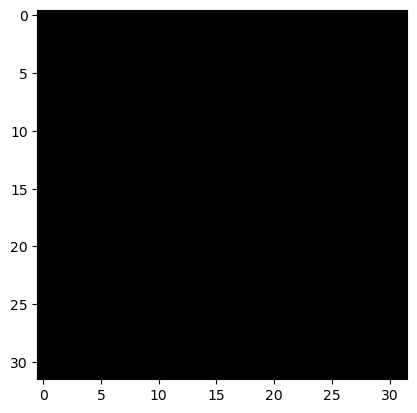

True Label: 3


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 3


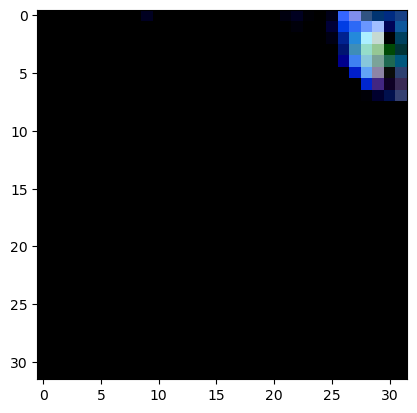

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


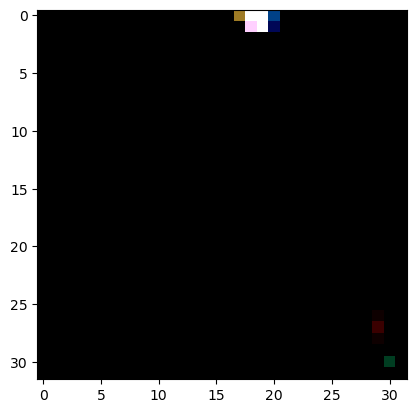

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


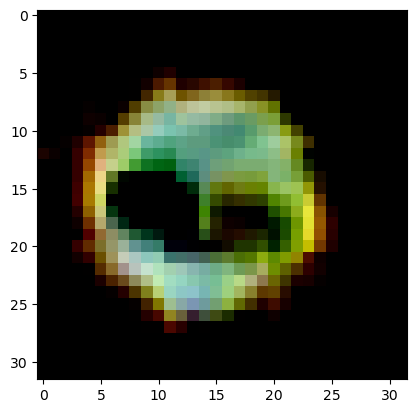

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


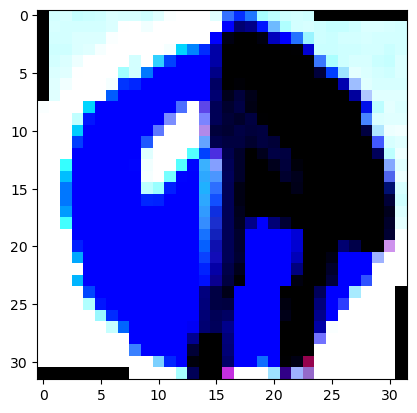

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


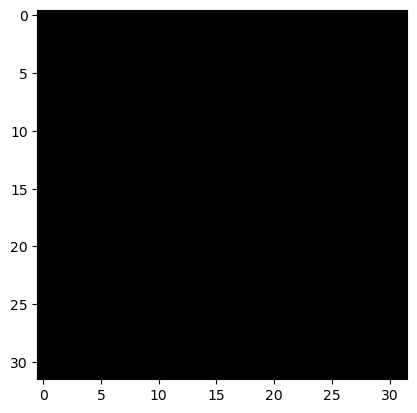

True Label: 5


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 5


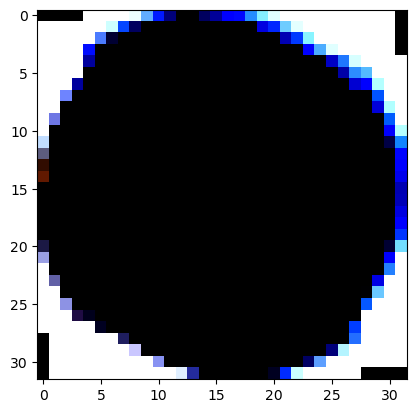

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


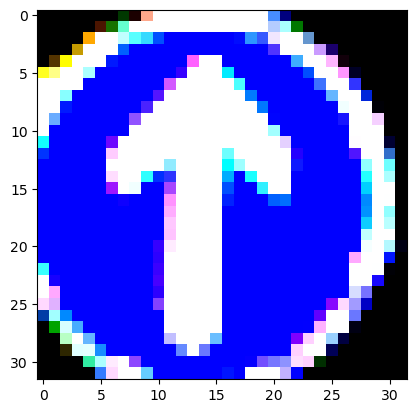

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


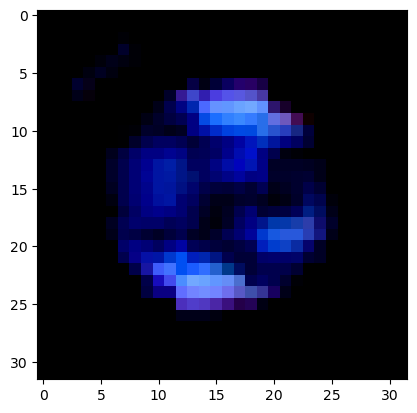

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 6
Predicted Label: 6


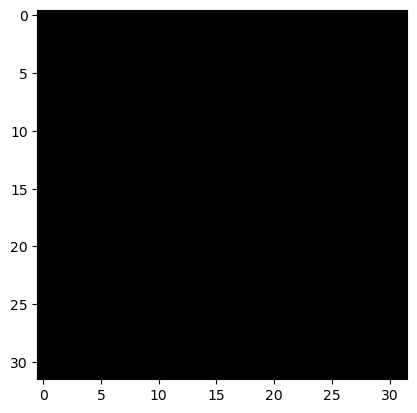

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


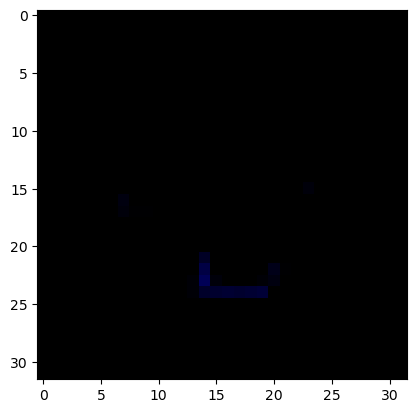

True Label: 18


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 18


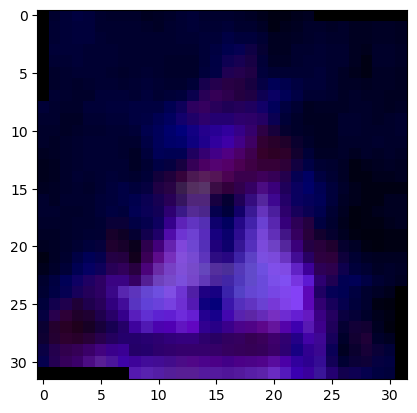

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


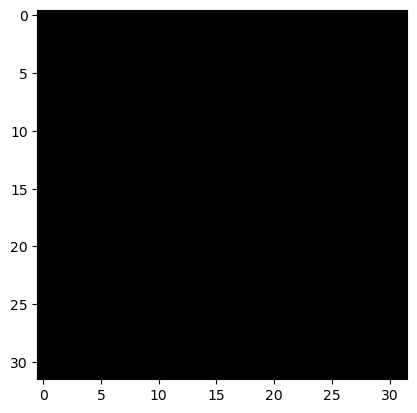

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


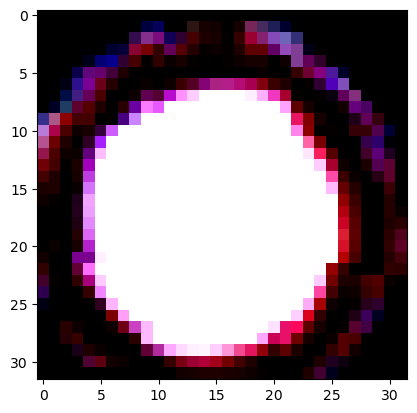

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


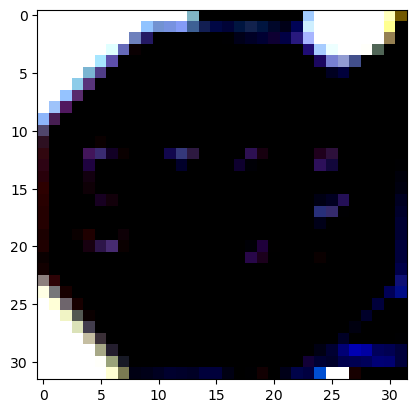

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


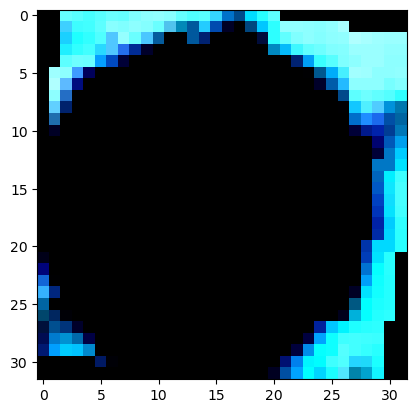

True Label: 25


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 25


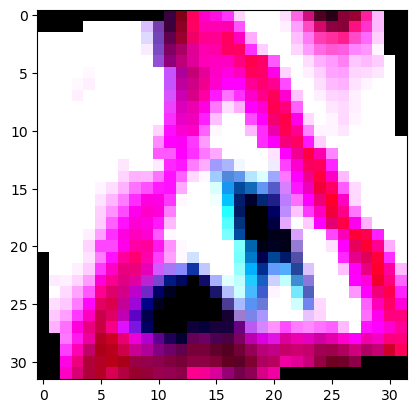

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


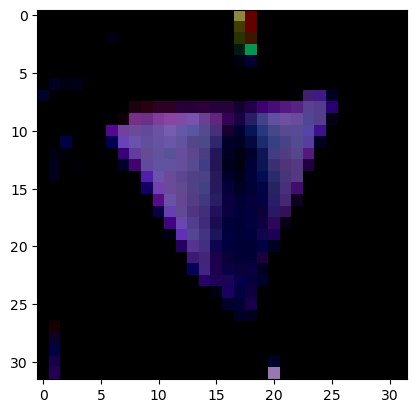

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


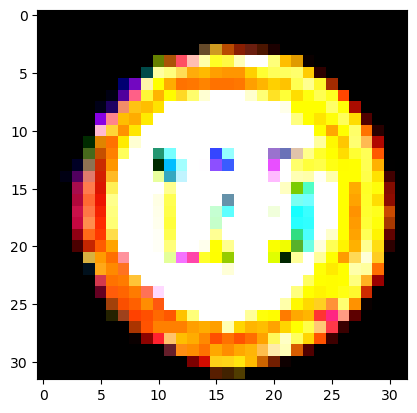

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


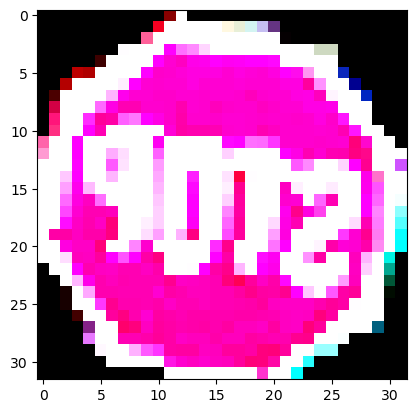

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


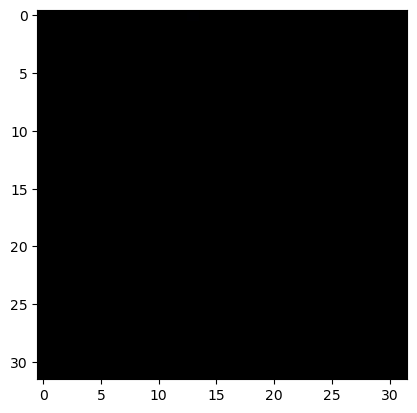

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


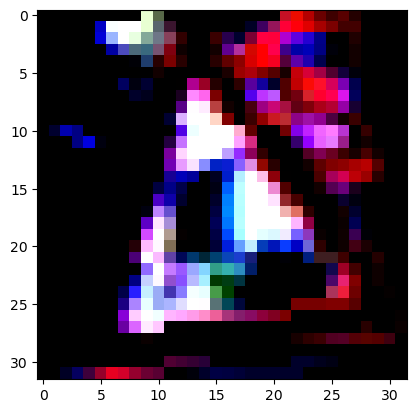

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


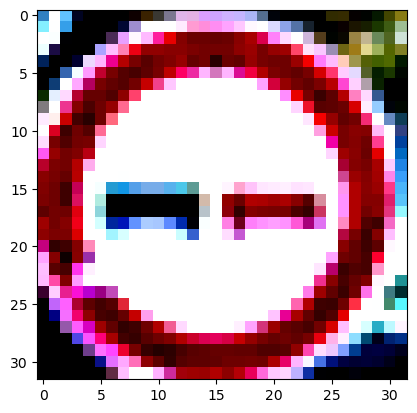

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


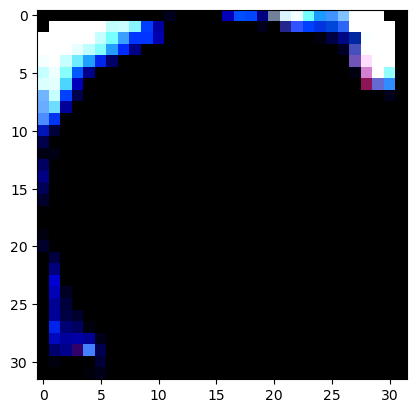

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


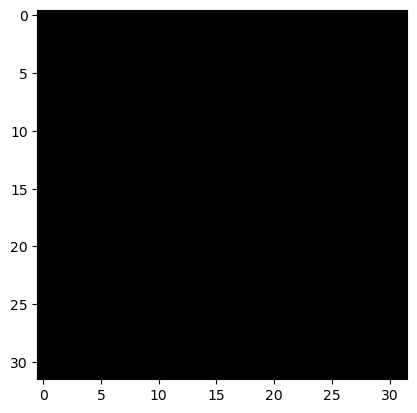

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


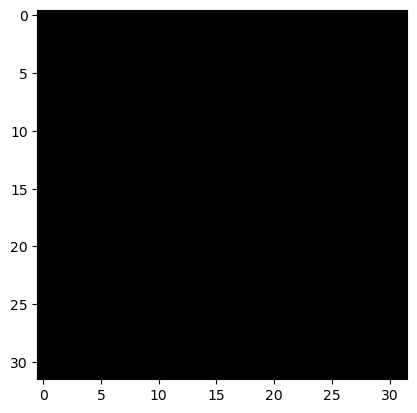

True Label: 8


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 8


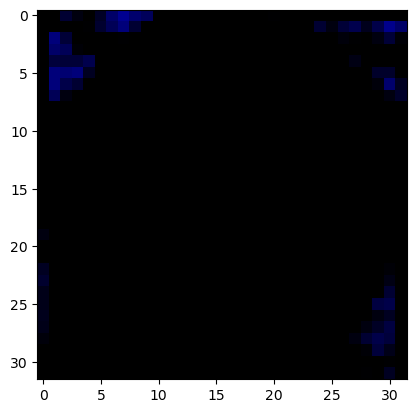

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 20
Predicted Label: 20


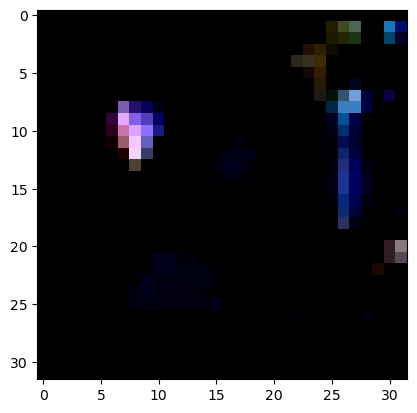

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


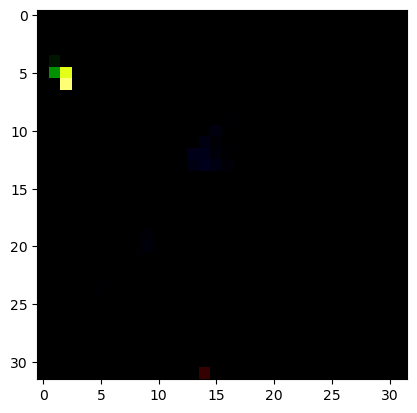

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


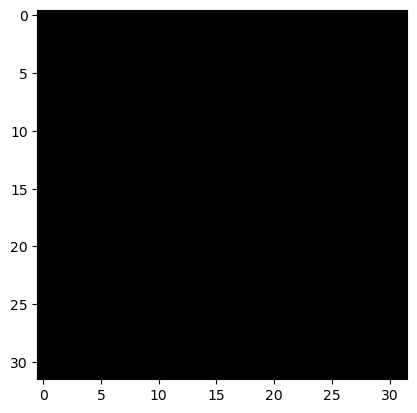

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


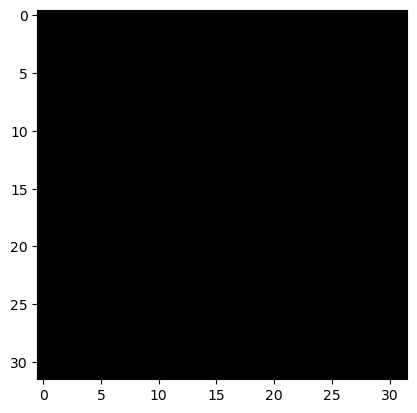

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


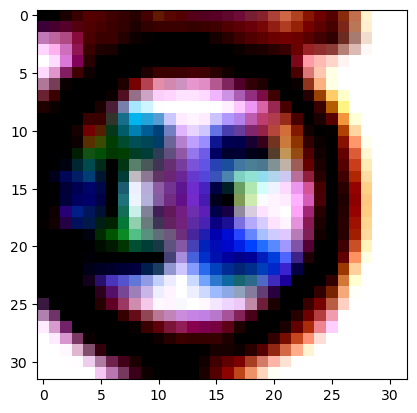

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 22
Predicted Label: 22


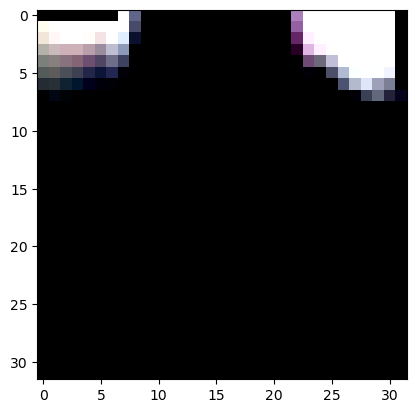

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 31
Predicted Label: 31


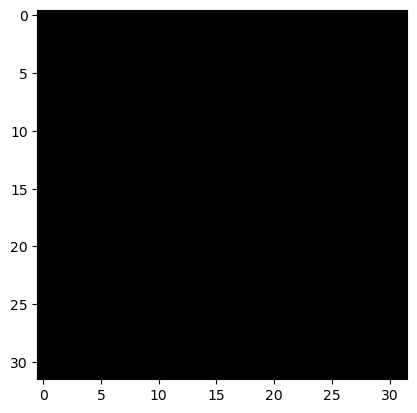

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


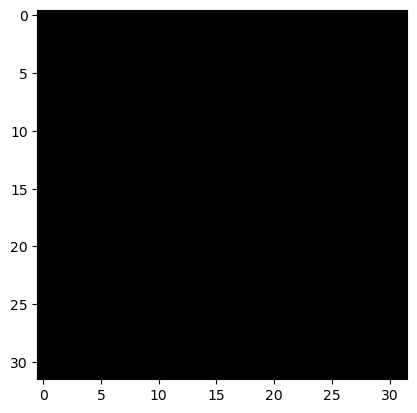

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


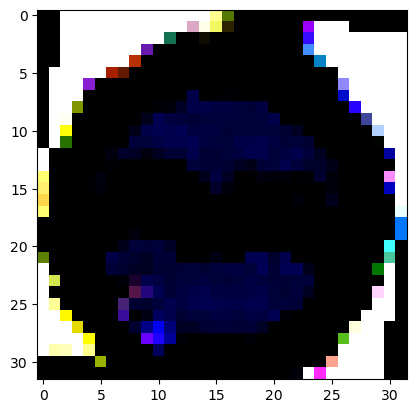

True Label: 4


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 5


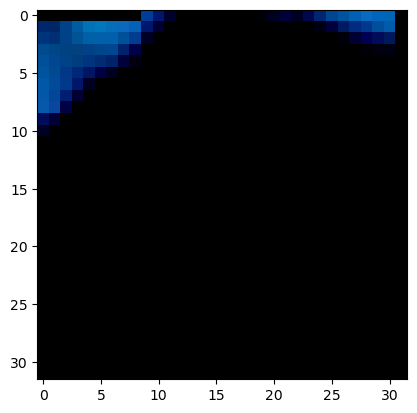

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


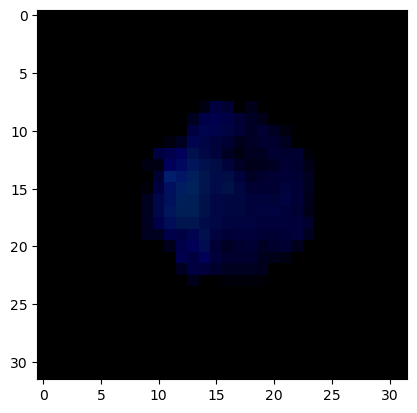

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


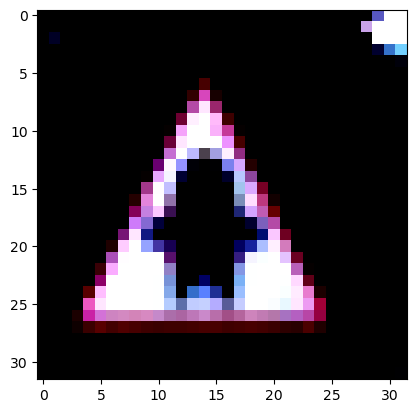

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


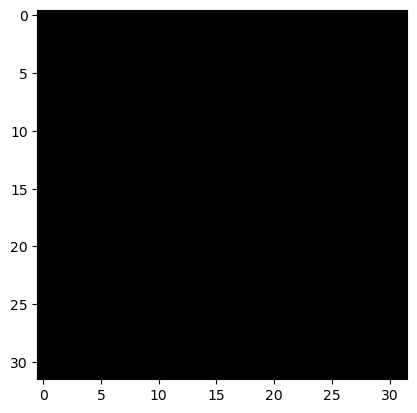

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


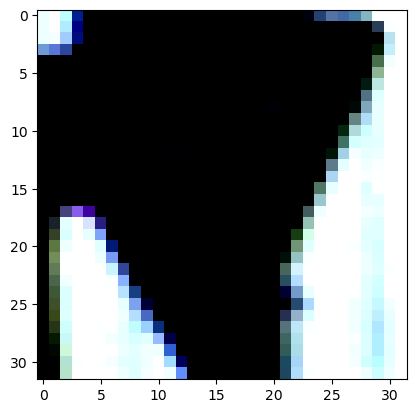

True Label: 25


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 25


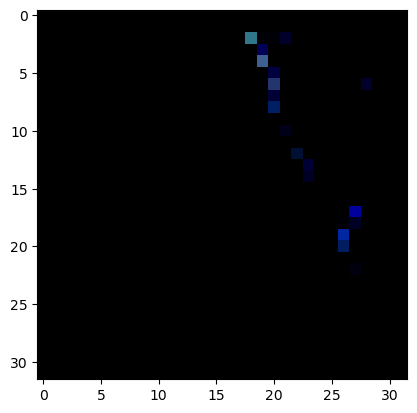

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


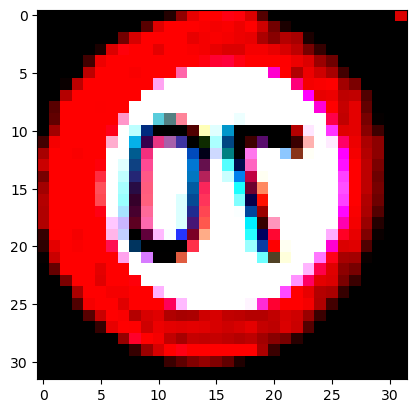

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


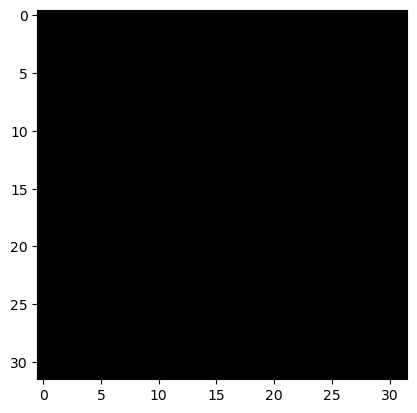

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


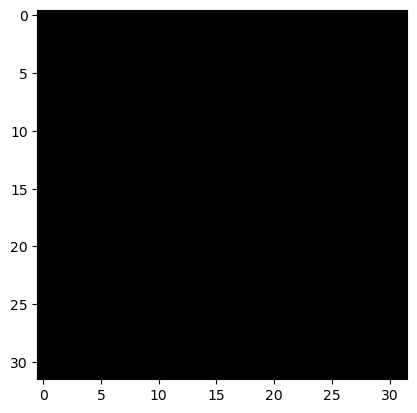

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


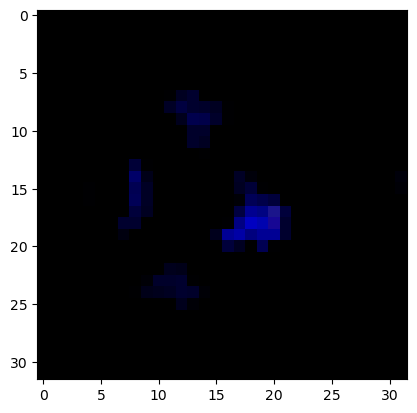

True Label: 17


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 17


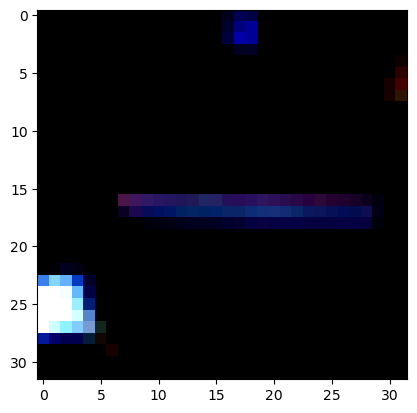

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


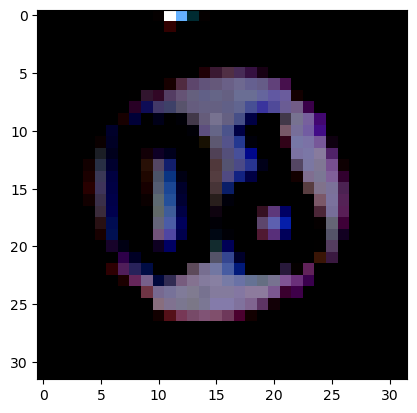

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


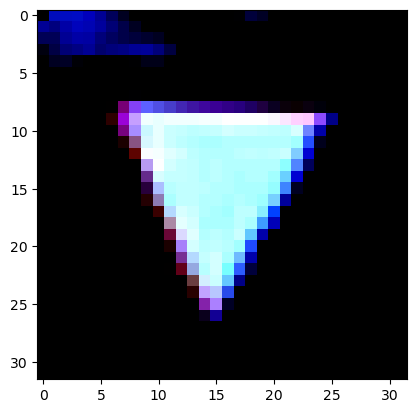

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


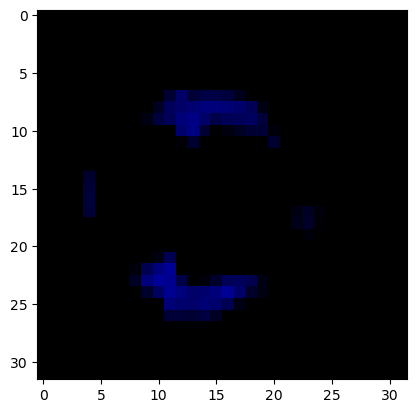

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


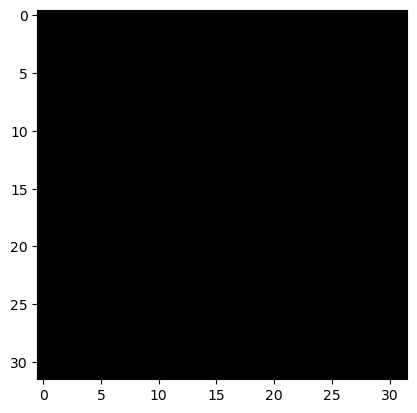

True Label: 2


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 2


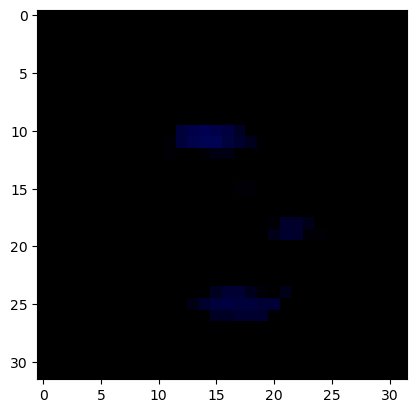

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


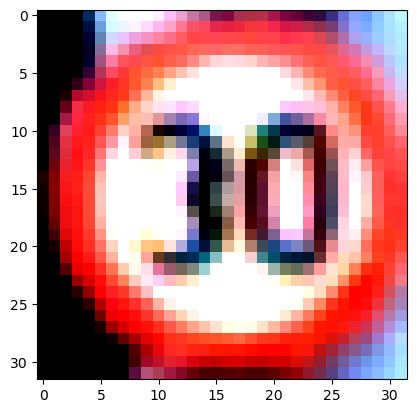

True Label: 4
Predicted Label: 4


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


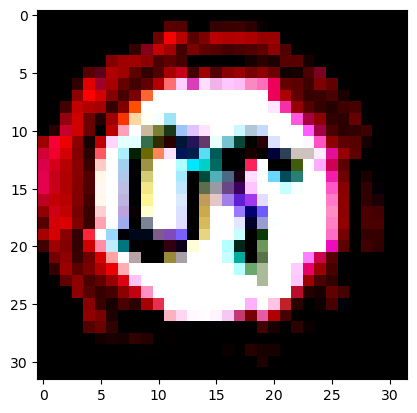

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


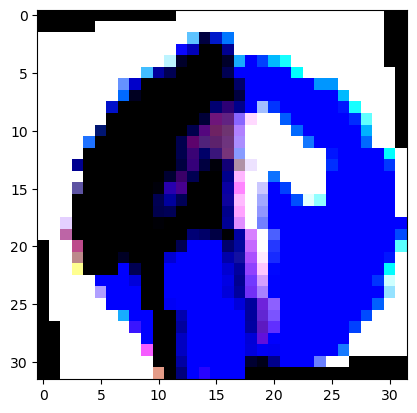

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


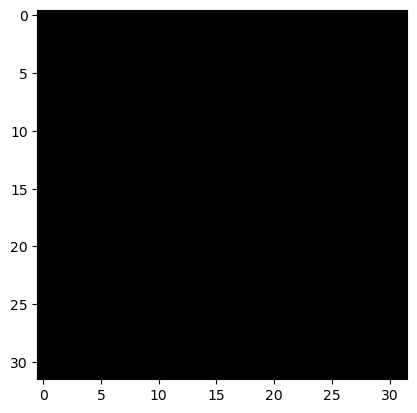

True Label: 25


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 25


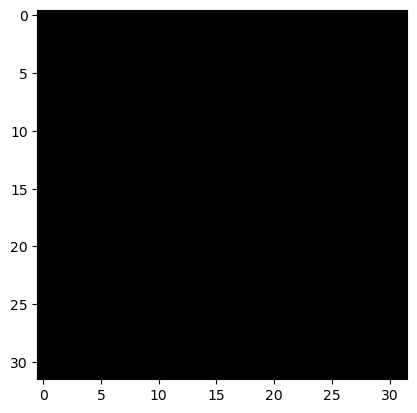

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


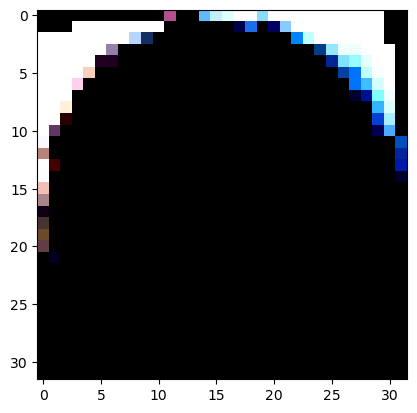

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


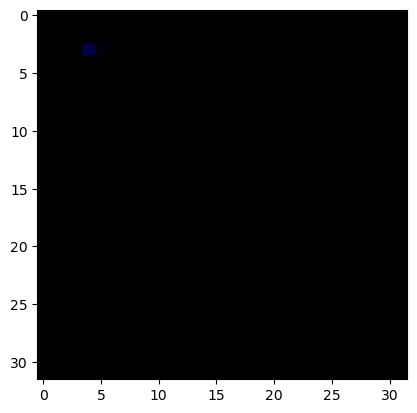

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


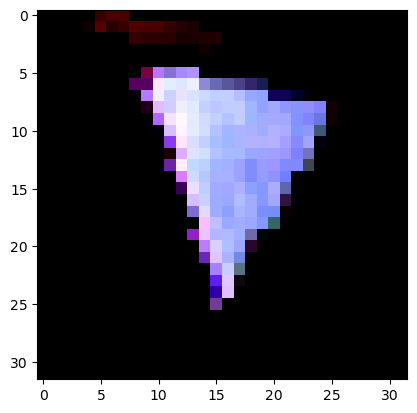

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 26
Predicted Label: 26


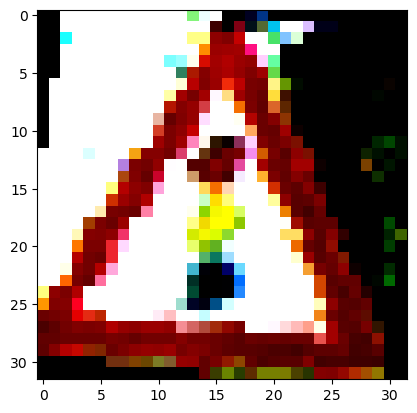

True Label: 11


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 11


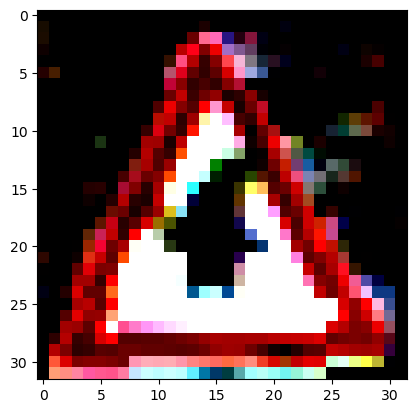

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


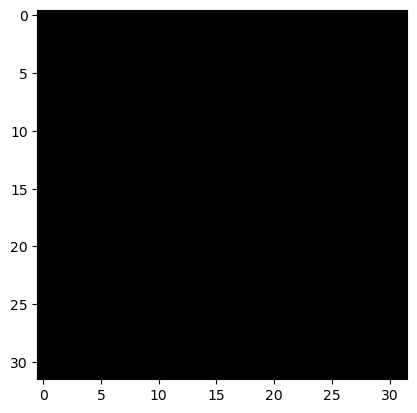

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


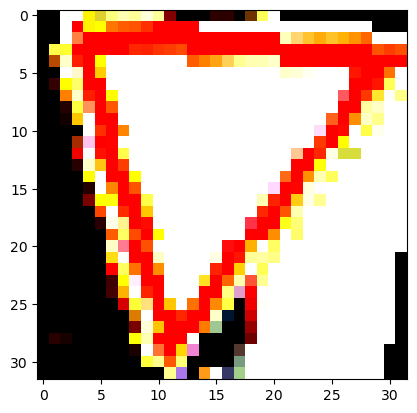

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


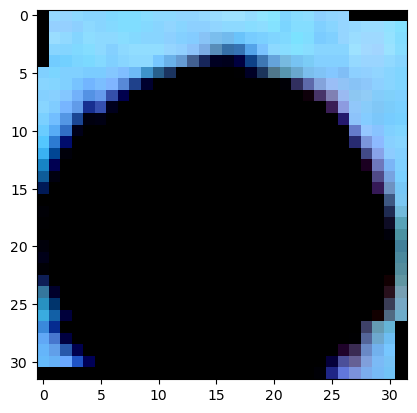

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


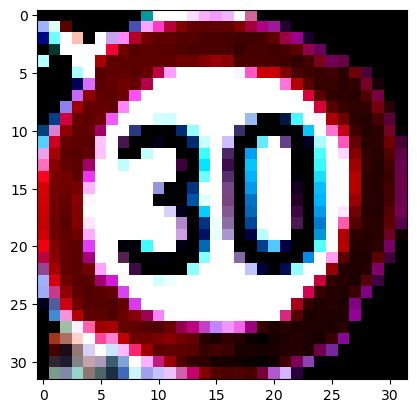

True Label: 38


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 38


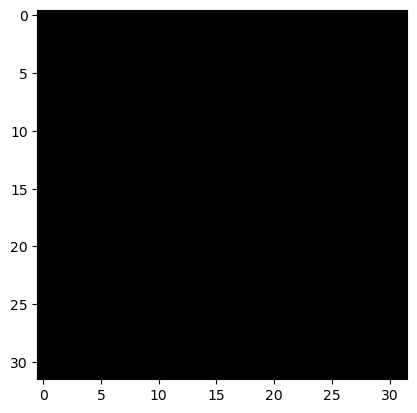

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


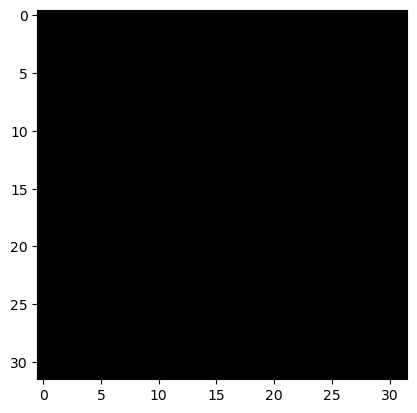

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 39
Predicted Label: 39


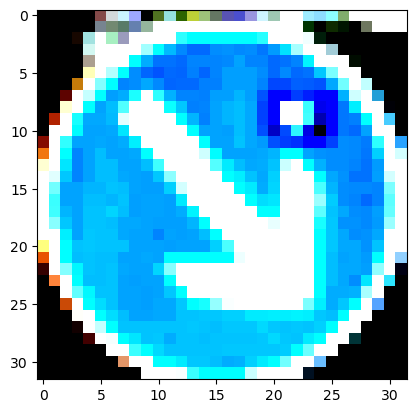

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


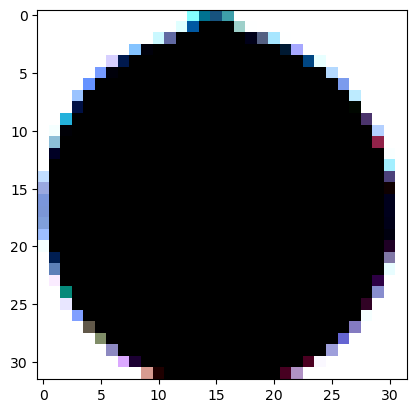

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


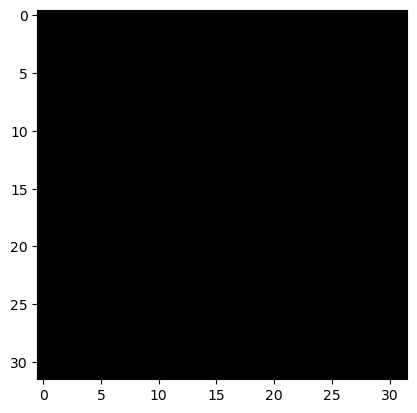

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 26
Predicted Label: 26


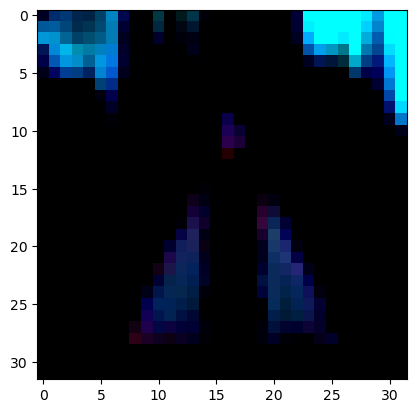

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


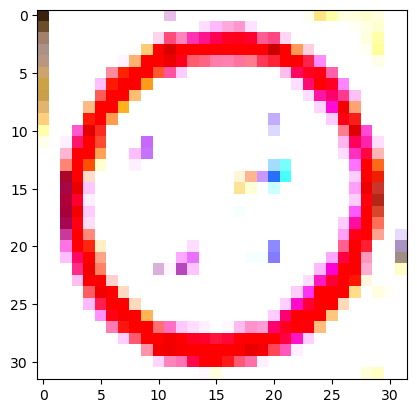

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


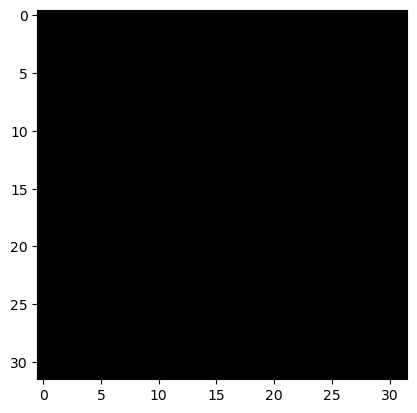

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 41
Predicted Label: 41


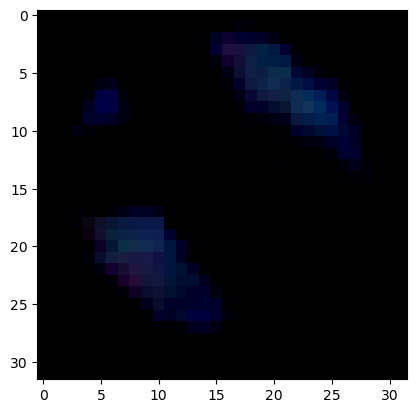

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


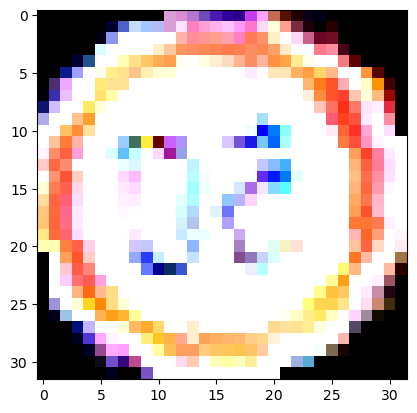

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 41
Predicted Label: 41


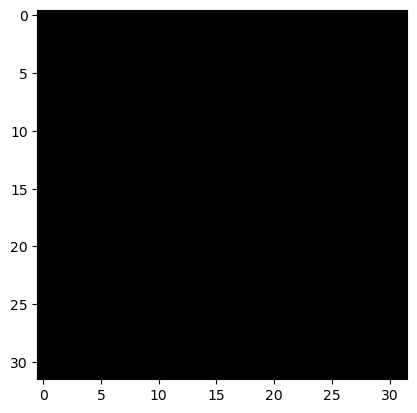

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


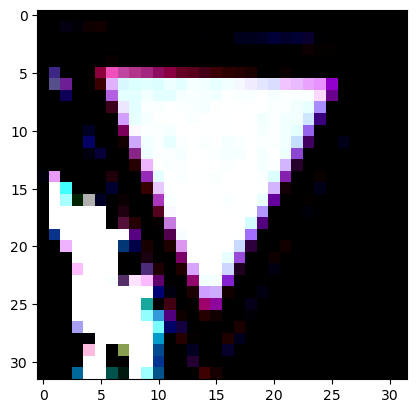

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


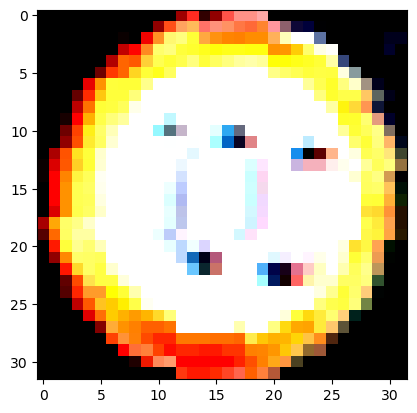

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 21


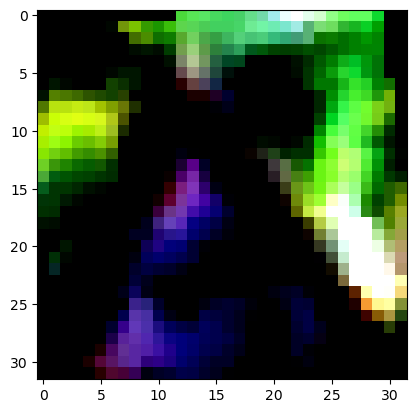

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


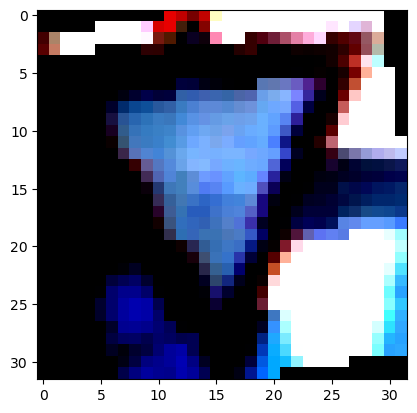

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


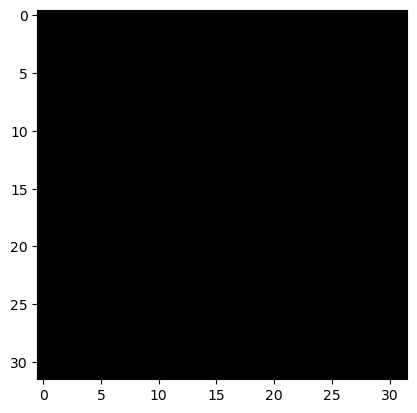

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


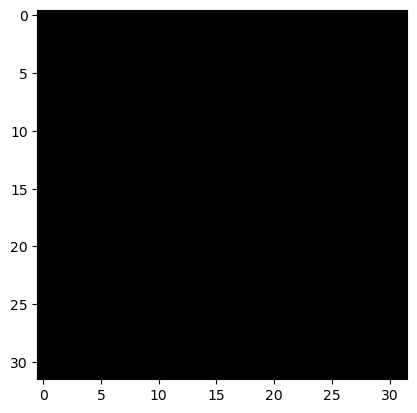

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


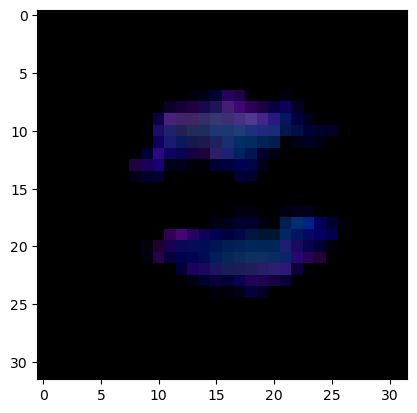

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


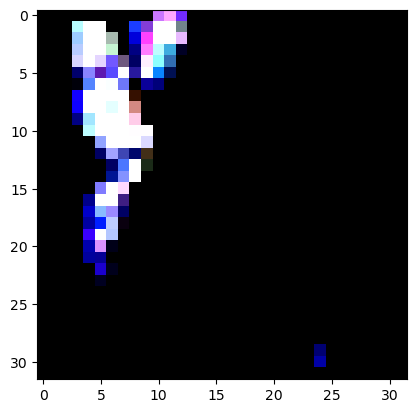

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


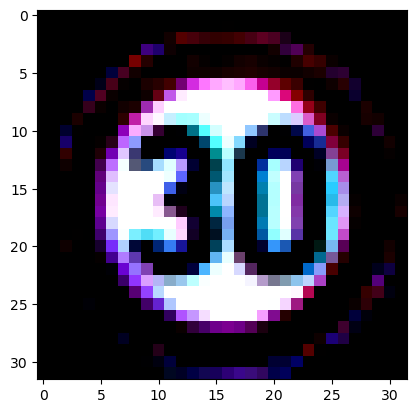

In [31]:
import matplotlib.pyplot as plt
import numpy as np

def imshow(img):
    img = img.numpy().transpose((1, 2, 0))  # Convert from Tensor image
    plt.imshow(img)
    plt.show()

model3.eval()  # Set the model to evaluation mode

with torch.no_grad():
    for data in test_loader:
        images, labels = data['image'].to(device), data['label'].to(device)
        outputs = model3(images)
        _, predicted = torch.max(outputs, 1)

        # Display images and labels
        for i in range(len(images)):
            print("True Label:", labels[i].item())
            print("Predicted Label:", predicted[i].item())
            imshow(torchvision.utils.make_grid(images[i]).cpu())
            if i == 4:  # Display first 5 images from the batch
                break

In [32]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

accuracy = accuracy_score(y_true3, y_pred3)
precision = precision_score(y_true3, y_pred3, average='weighted')
recall = recall_score(y_true3, y_pred3, average='weighted')
f1 = f1_score(y_true3, y_pred3, average='weighted')

print(f"Accuracy: {accuracy:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1-Score: {f1:.4f}")

accuracy_values.append(float(accuracy * 100))
precision_values.append(float(precision * 100))
recall_values.append(float(recall * 100))
f1score_values.append(float(f1 * 100))

Accuracy: 0.9546
Precision: 0.9551
Recall: 0.9546
F1-Score: 0.9545


In [33]:
model3.eval()
import time

num_runs = 10
total_time = 0

with torch.no_grad():
    for _ in range(num_runs):
        batch_time = 0
        for data in test_loader:
            images, labels = data['image'].to(device), data['label'].to(device)
            start_time = time.time()  # Start time for the batch
            outputs = model3(images)
            end_time = time.time()  # End time for the batch
            batch_time += (end_time - start_time)
        total_time += batch_time

average_inference_time = total_time / (num_runs * len(test_loader))
print(f"Average inference time per batch over {num_runs} runs: {average_inference_time} seconds")

Average_inference_time.append(average_inference_time)

Average inference time per batch over 10 runs: 0.007380127906799316 seconds


### CustomCNN

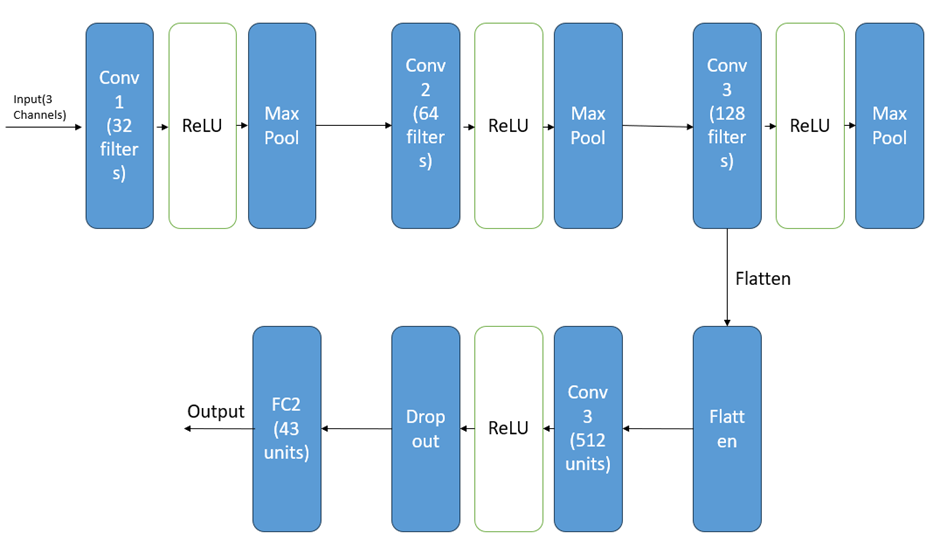

The reason why I choose custom CNN as the image processing training model is:
Custom CNN allows me to design models based on specific image processing tasks. Different image processing tasks require different network structures, and custom models can be adjusted according to the needs of specific tasks. Compared with other models, custom CNN is more customizable and more convenient. At the same time, the convolution kernel can effectively capture the local structure of the image, which is very helpful for processing information in the image.


In [34]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from collections import OrderedDict
from torch.optim import Adam,lr_scheduler
import torchvision.models as models

# Set up the model CNN
class CustomCNN(nn.Module):
    # Initialize the network
    # Define network architecture
    def __init__(self, num_classes=43):
        super(CustomCNN, self).__init__()
        # convolution layer
        self.conv1 = nn.Conv2d(in_channels=3, out_channels=32, kernel_size=3, padding=1)
        self.conv2 = nn.Conv2d(in_channels=32, out_channels=64, kernel_size=3, padding=1)
        self.conv3 = nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, padding=1)
        # Pooling layer
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)
        # Calculate the size of the flattened features
        self.fc1 = nn.Linear(128 * 4 * 4, 512)
        self.fc2 = nn.Linear(512, num_classes)
        self.dropout = nn.Dropout(0.5)
    
    # dropout relu：Regularization to prevent overfitting.

    def forward(self, x):
        # Extract image features
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = self.pool(F.relu(self.conv3(x)))
        # Two-dimensional features
        # Need to be converted to a 1-dimensional feature
        x = x.view(-1, 128 * 4 * 4)
        x = self.dropout(F.relu(self.fc1(x)))
        x = self.fc2(x)
        return x

# Define and transfer the model to device
model4 = CustomCNN()
model4 = model4.to(device)



# Define the loss function and the optimizer
# cross entropy
criterion = nn.CrossEntropyLoss()
# optimizer
optimizer = Adam(model4.parameters(), lr=0.0001)

# Optional: Learning rate scheduler

scheduler = lr_scheduler.StepLR(optimizer, step_size=7, gamma=0.1)

As can be seen from this figure, I defined a simple convolutional neural network model. My model has three convolutional layers for extracting image features. The convolutional layer is followed by a pooling layer to reduce the spatial size of the feature map. Finally, there are two fully connected layers that map the features extracted by the convolutional layer to the final category. One of them has activation functions ReLU and Dropout to prevent overfitting.

Epoch 1, Training loss: 2.9355793438313444, Training Accuracy: 20.571303650805216%, Validation Loss: 2.008093025373376, Validation Accuracy: 42.186702941676586%
Epoch 2, Training loss: 1.708427121589234, Training Accuracy: 48.320338118487214%, Validation Loss: 1.2008698284626007, Validation Accuracy: 63.61163067505526%
Epoch 3, Training loss: 1.1589654218622576, Training Accuracy: 63.10209137943598%, Validation Loss: 0.8226769663717436, Validation Accuracy: 74.66417275973474%
Epoch 4, Training loss: 0.869856516936998, Training Accuracy: 72.2181738686876%, Validation Loss: 0.619307483991851, Validation Accuracy: 82.33293657541235%
Epoch 5, Training loss: 0.678784800992979, Training Accuracy: 78.21540479486993%, Validation Loss: 0.46986611252245697, Validation Accuracy: 86.94099642917871%
Epoch 6, Training loss: 0.5500125109037876, Training Accuracy: 82.76980252131459%, Validation Loss: 0.39155128177093423, Validation Accuracy: 89.35555177690868%
Epoch 7, Training loss: 0.463185588866124

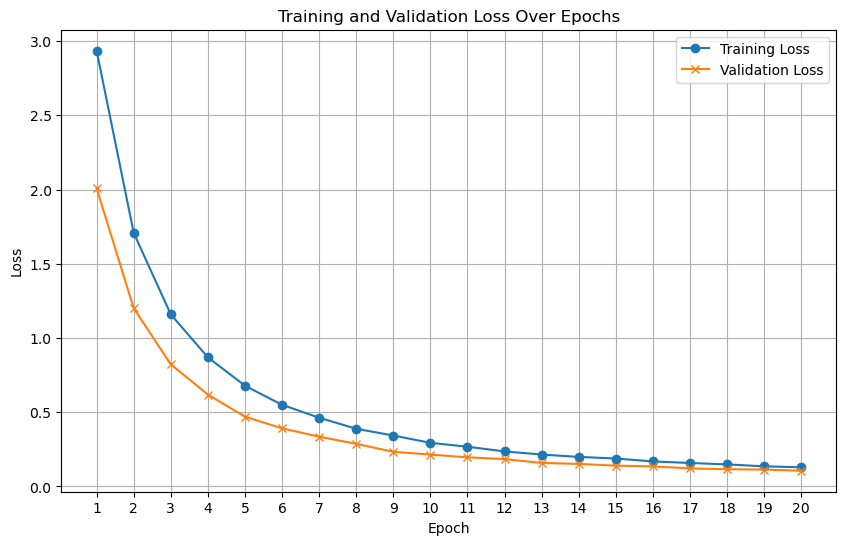

In [35]:
num_epochs = 20  # Set the number of epochs

# Epoch data
epochs = list(range(1, 21))
training_loss = []
validation_loss = []

for epoch in range(num_epochs):
    # Training Phase
    model4.train()  # Set the model to training mode
    running_loss = 0.0
    correct_train = 0
    total_train = 0

    for i, data in enumerate(train_loader, 0):

        inputs, labels = data['image'].to(device), data['label'].to(device)
        # Gradient clear
        optimizer.zero_grad()
        # Input image forward propagation
        outputs = model4(inputs)
       
        # Estimating the difference between the actual value and the predicted value
        loss = criterion(outputs, labels)
        # Backpropagation
        loss.backward()
        
        optimizer.step()
            
        running_loss += loss.item()
        
    
        _, predicted = torch.max(outputs.data, 1)
        total_train += labels.size(0)
        correct_train += (predicted == labels).sum().item()
    
    train_accuracy = 100 * correct_train / total_train


    model4.eval()  # Set the model to evaluation mode
    val_loss = 0.0
    correct = 0
    total = 0
    with torch.no_grad():
        for data in val_loader:
            images, labels = data['image'].to(device), data['label'].to(device)
            outputs = model4(images)
            loss = criterion(outputs, labels)
            val_loss += loss.item()
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
    
    training_loss.append(running_loss/len(train_loader))
    validation_loss.append(val_loss/len(val_loader))

    print(f'Epoch {epoch+1}, Training loss: {running_loss/len(train_loader)}, Training Accuracy: {train_accuracy}%, Validation Loss: {val_loss/len(val_loader)}, Validation Accuracy: {100 * correct / total}%')

print('Finished Training')

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(epochs, training_loss, label='Training Loss', marker='o')
plt.plot(epochs, validation_loss, label='Validation Loss', marker='x')
plt.title('Training and Validation Loss Over Epochs')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.xticks(epochs)
plt.legend()
plt.grid(True)
plt.show()

In [36]:
model4.eval()  # Set the model to evaluation mode

correct = 0
total = 0
with torch.no_grad():  # No need to track gradients for testing
    for data in test_loader:
        images, labels = data['image'].to(device), data['label'].to(device)
        outputs = model4(images)
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

test_accuracy = 100 * correct / total
print(f'Accuracy of the model on the test images: {test_accuracy}%')

ModelAccuracies.append(test_accuracy)

Accuracy of the model on the test images: 97.09282556953417%


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


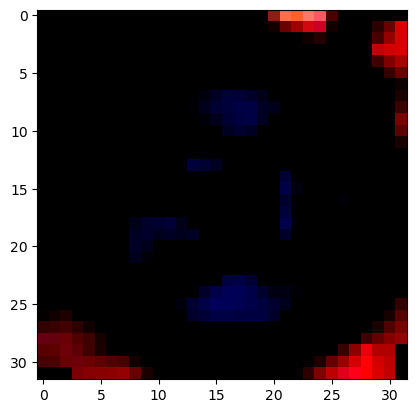

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


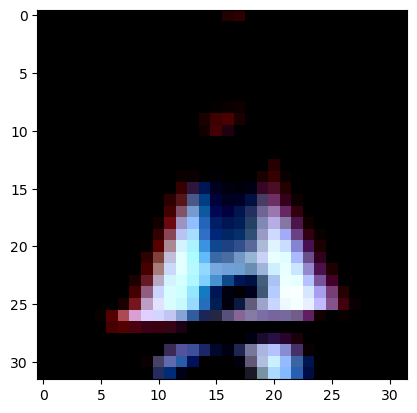

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 28
Predicted Label: 28


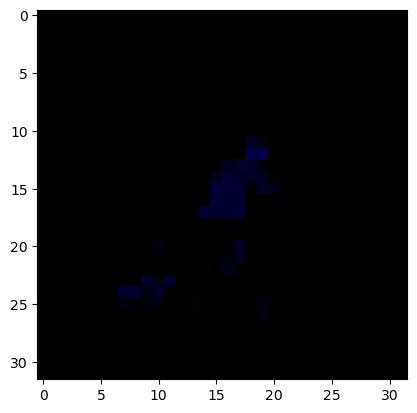

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 28
Predicted Label: 28


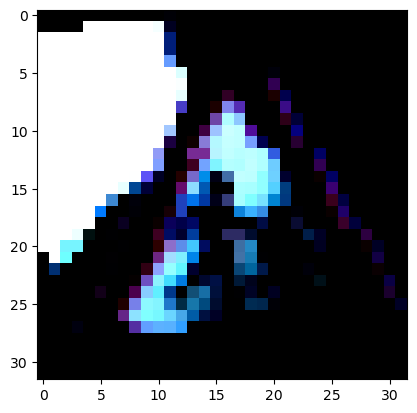

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


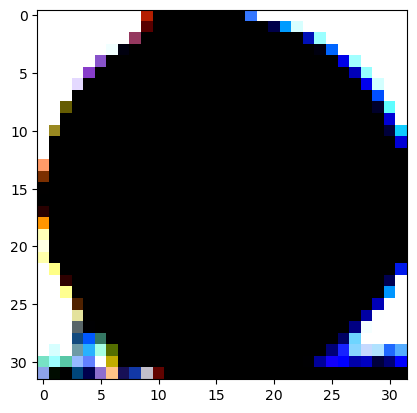

True Label: 10


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 10


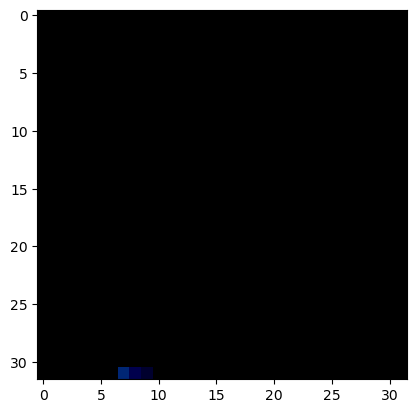

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 22
Predicted Label: 22


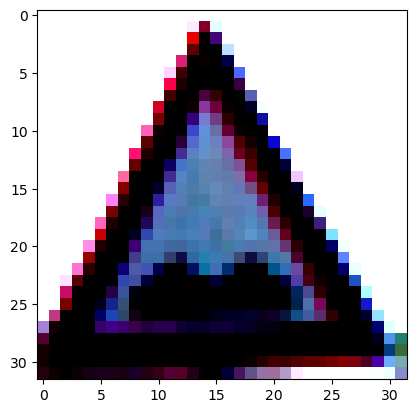

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


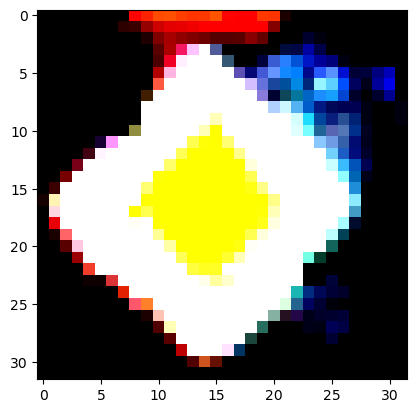

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


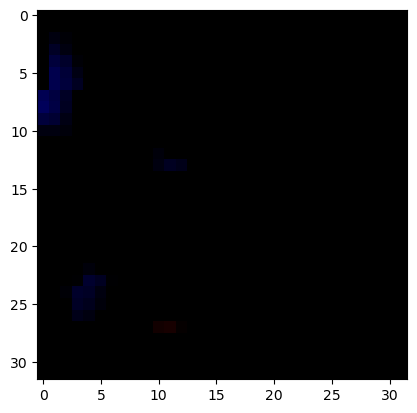

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


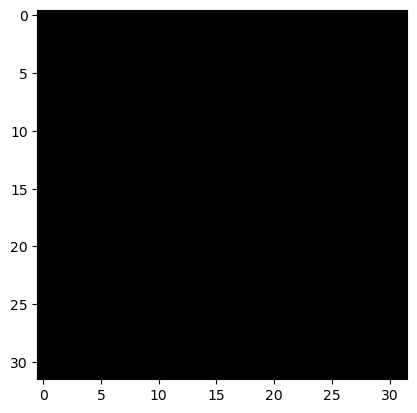

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 36
Predicted Label: 36


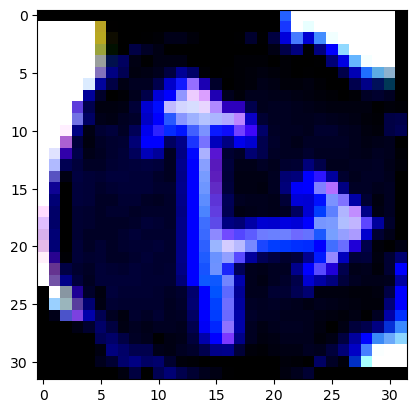

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


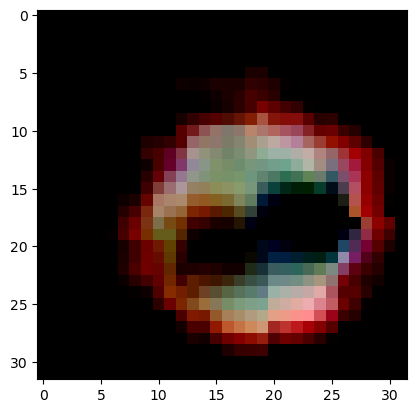

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


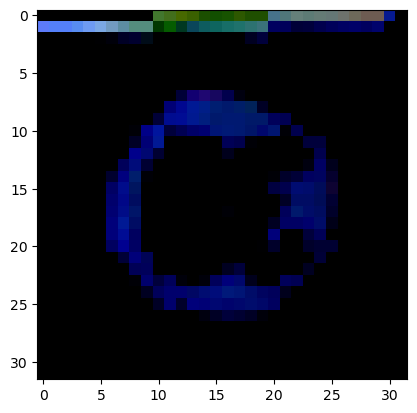

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


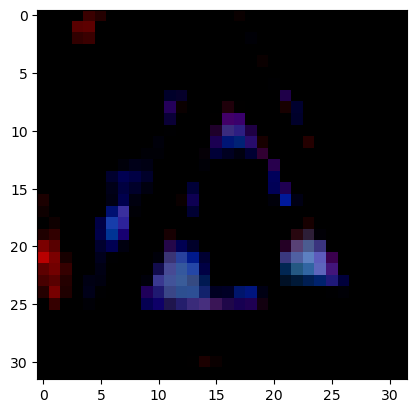

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 31
Predicted Label: 31


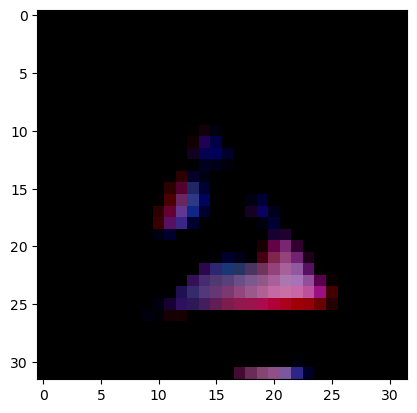

True Label: 35


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 35


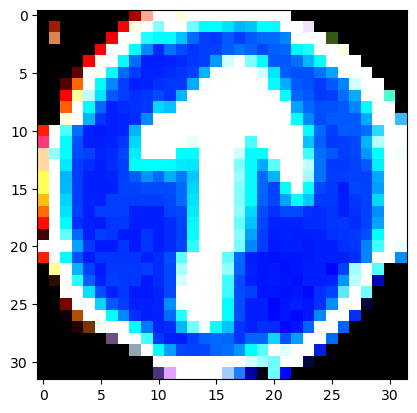

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 22
Predicted Label: 22


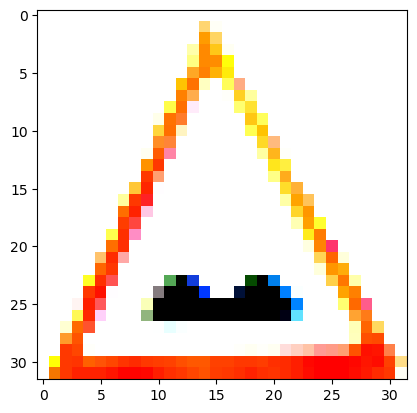

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


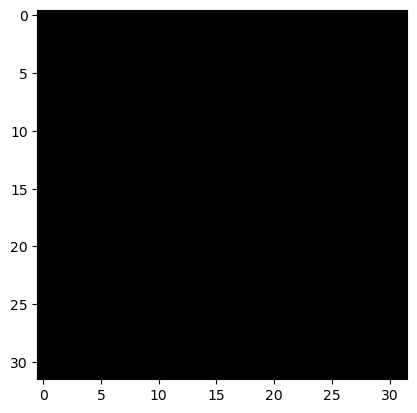

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


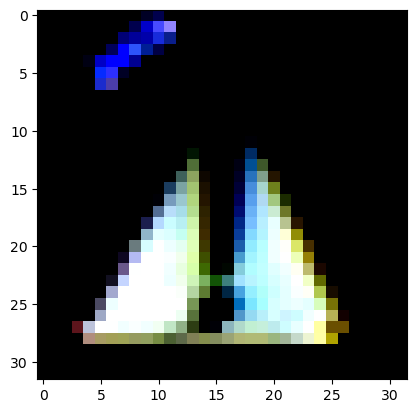

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


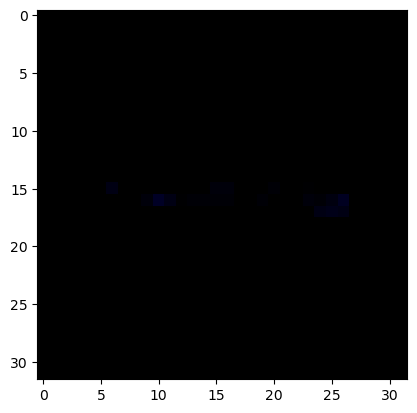

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


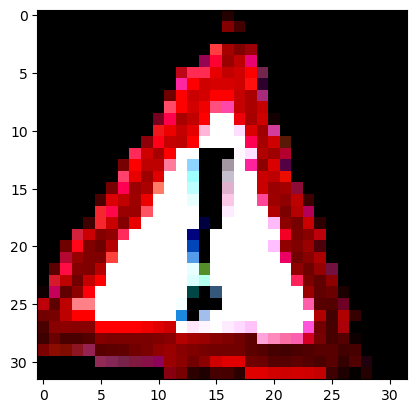

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


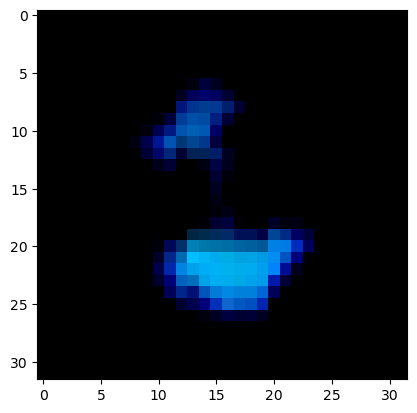

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


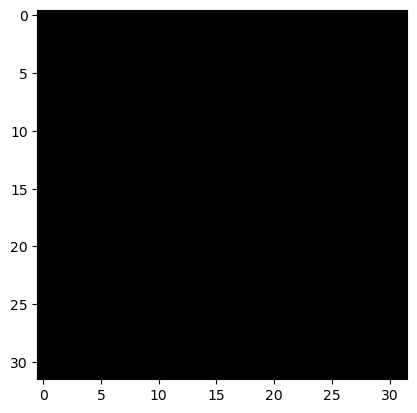

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


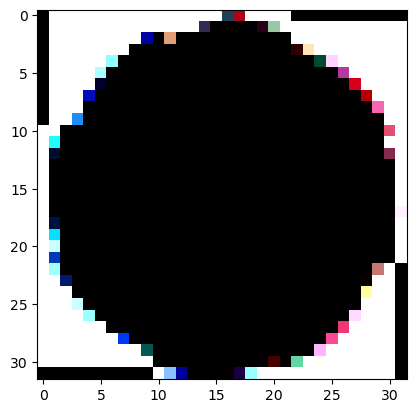

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


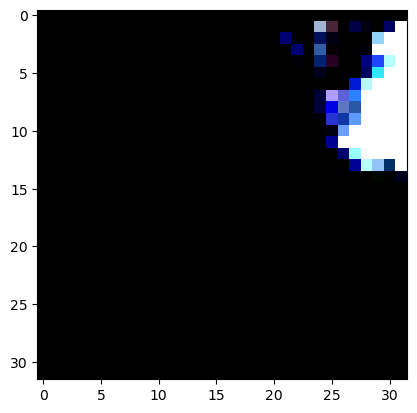

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


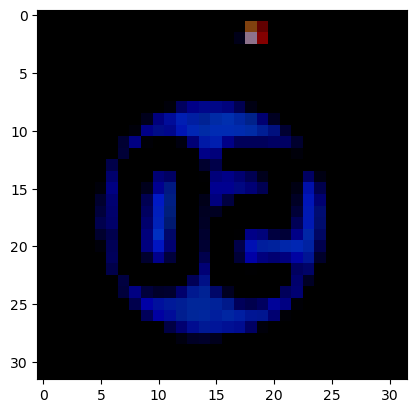

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


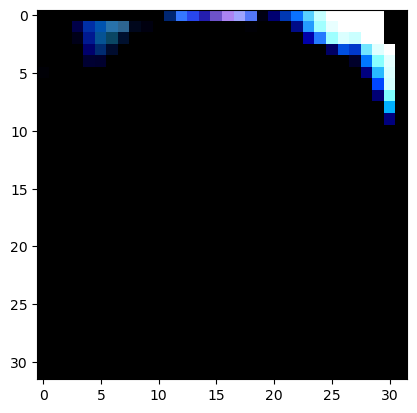

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 22
Predicted Label: 22


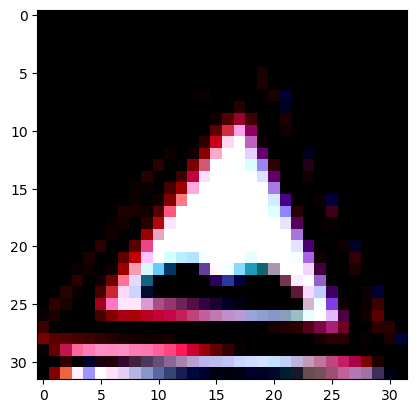

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


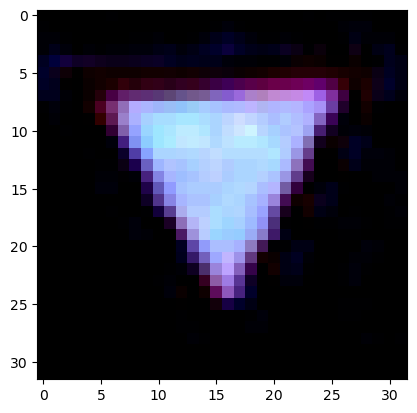

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


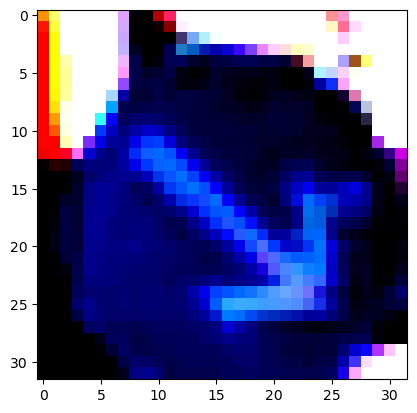

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


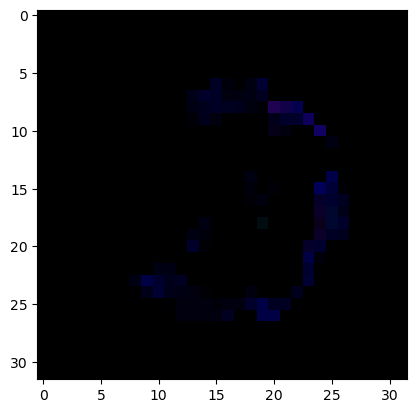

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


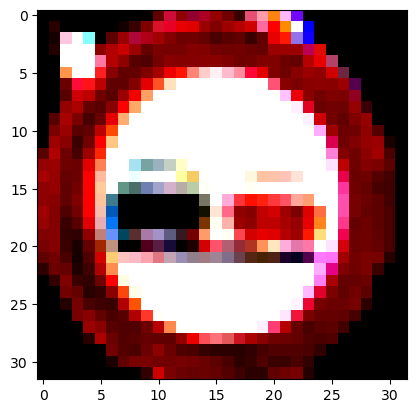

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


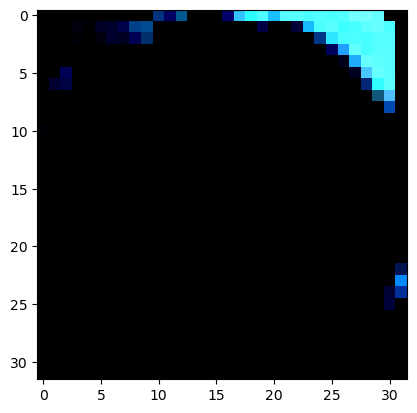

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


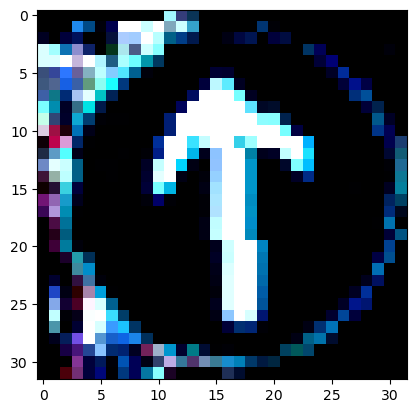

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


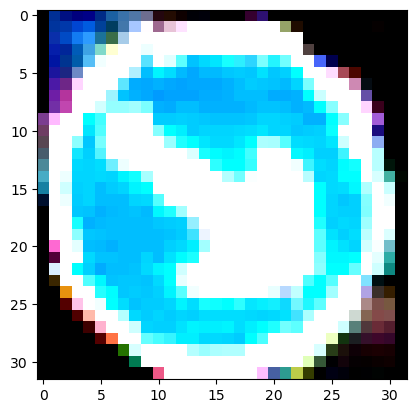

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


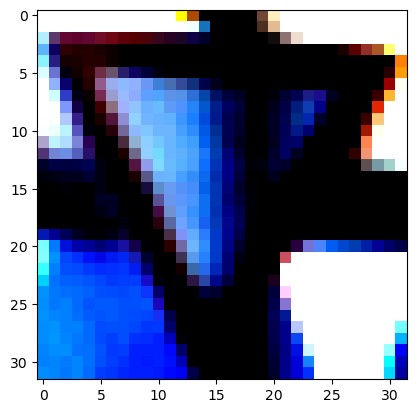

True Label: 14
Predicted Label: 14


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


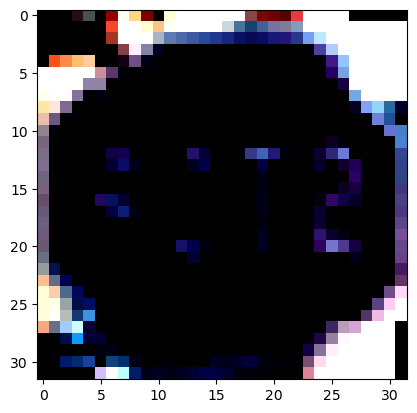

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 22
Predicted Label: 22


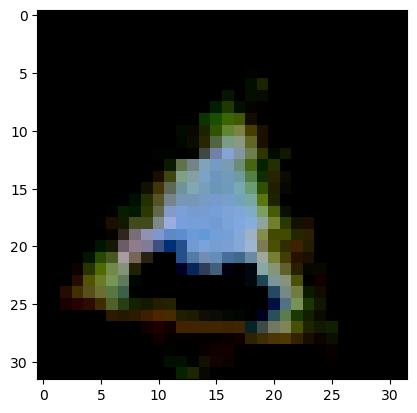

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


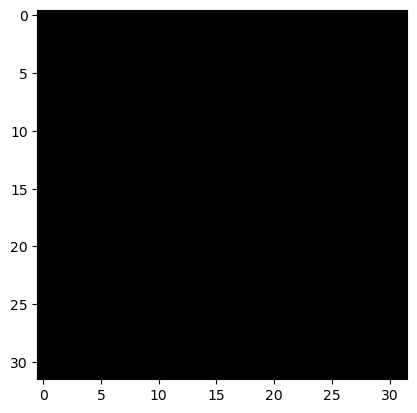

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


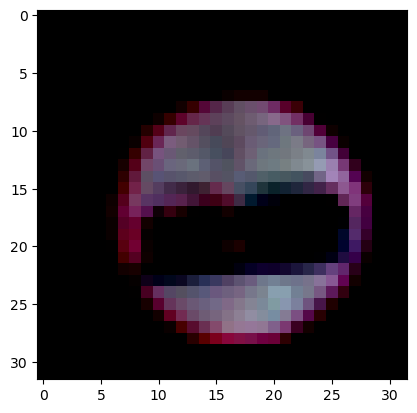

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


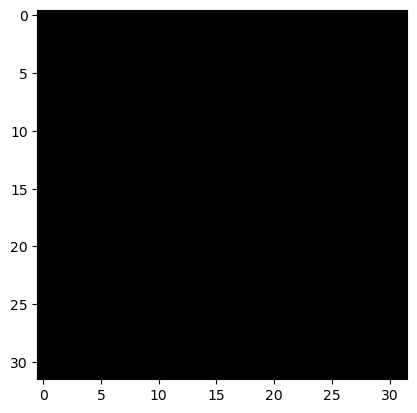

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


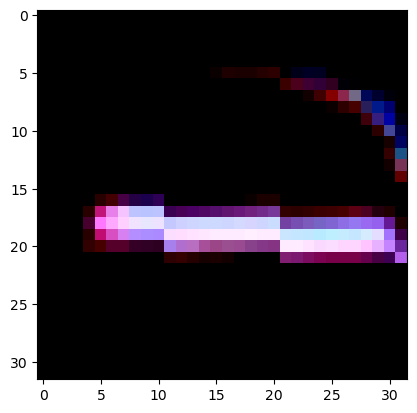

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


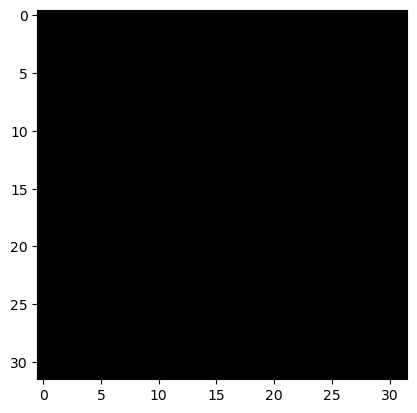

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


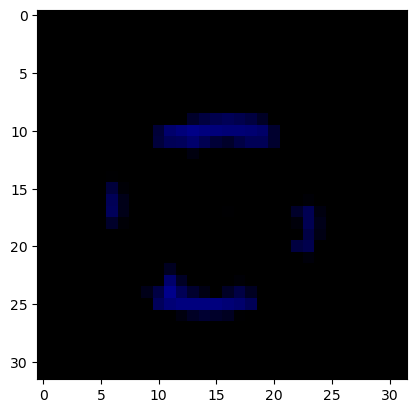

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 26
Predicted Label: 26


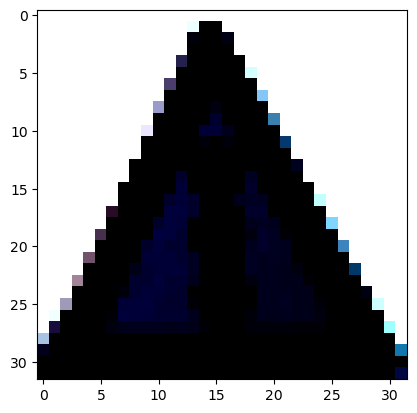

True Label: 35


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 35


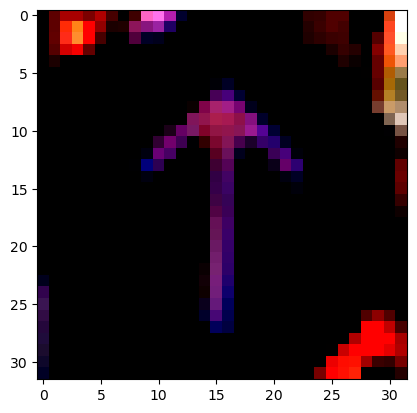

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 2


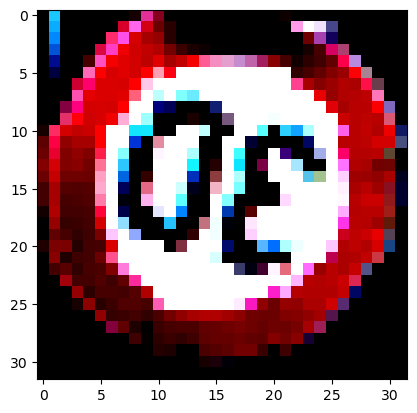

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


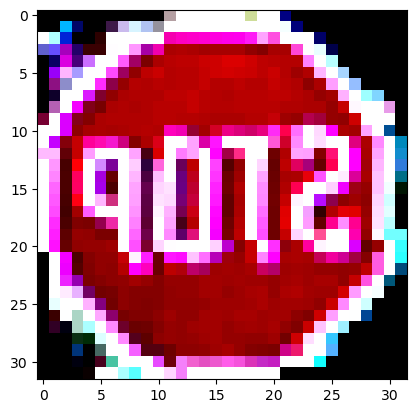

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


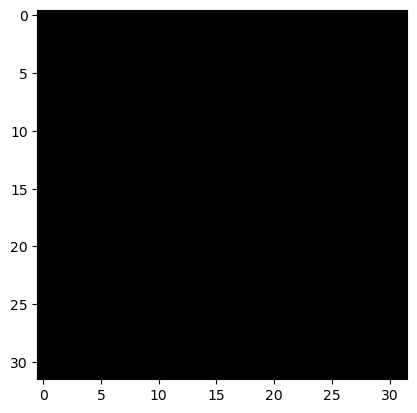

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


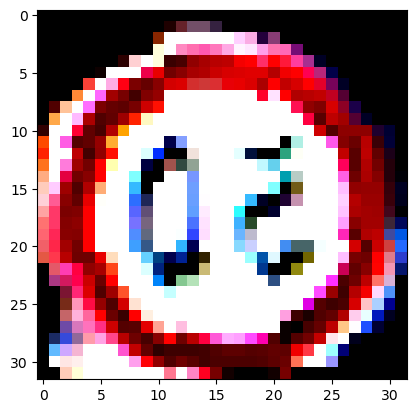

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


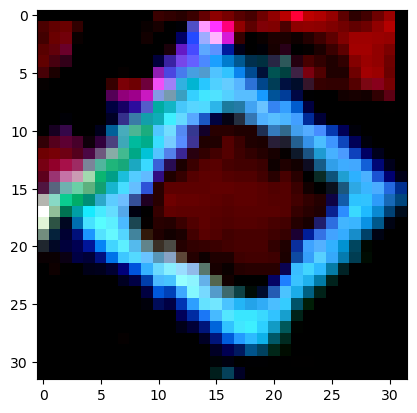

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 31
Predicted Label: 31


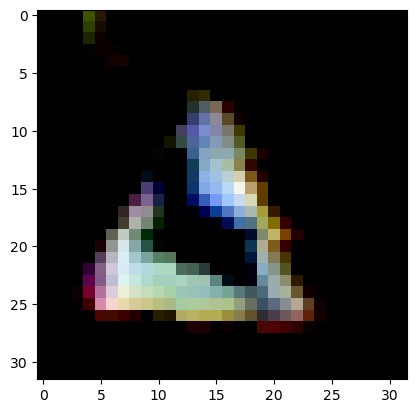

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


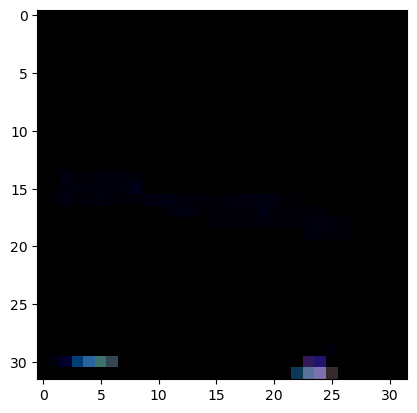

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


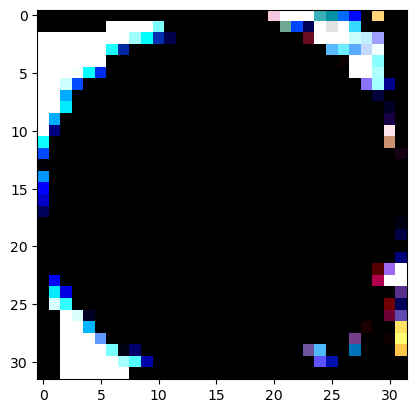

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 16
Predicted Label: 16


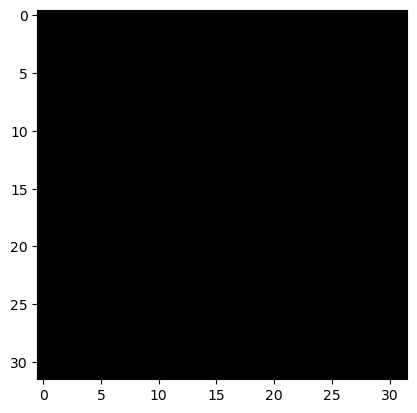

True Label: 1


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 1


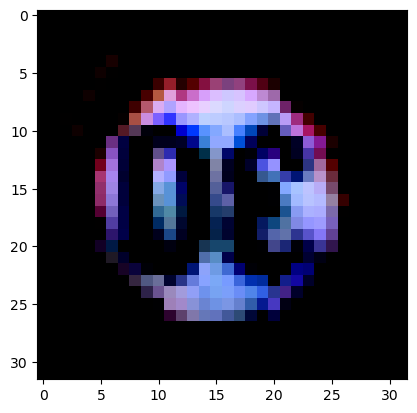

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


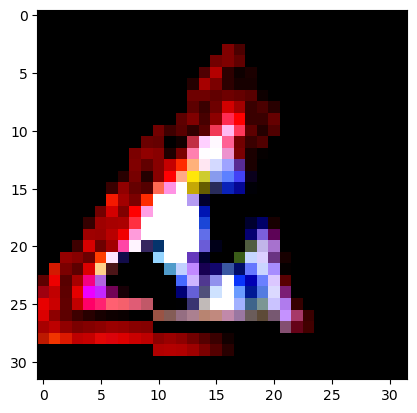

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


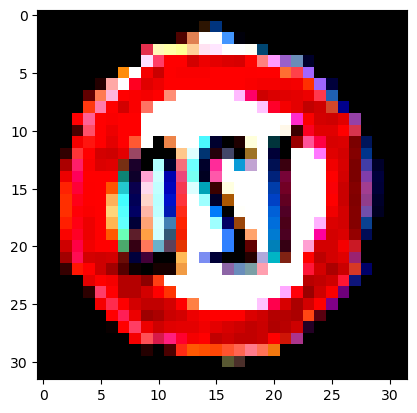

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


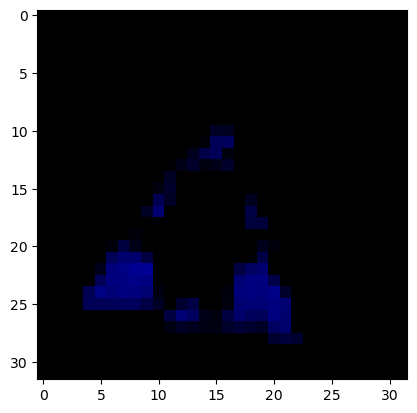

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


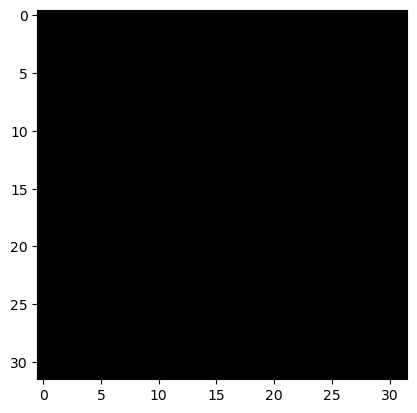

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


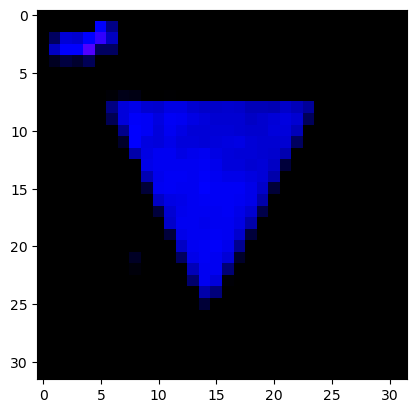

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 20
Predicted Label: 20


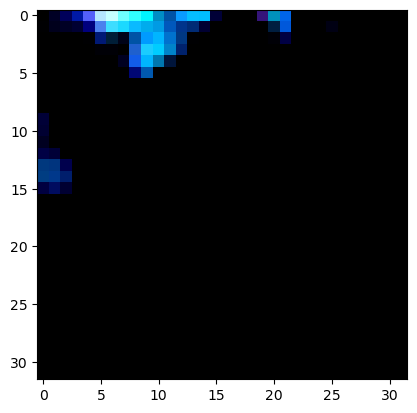

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


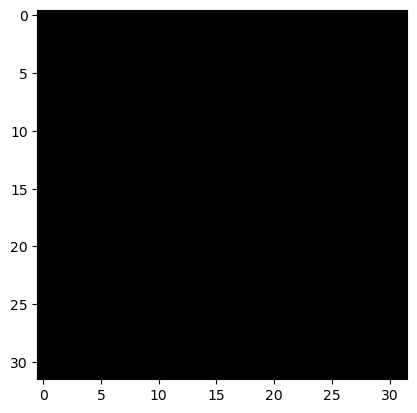

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


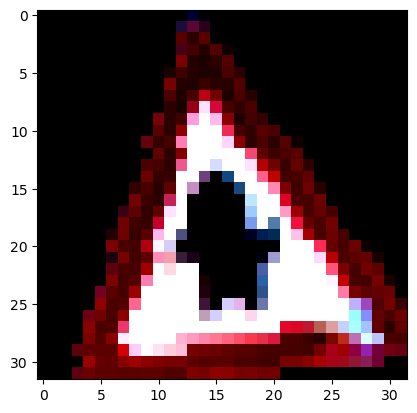

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


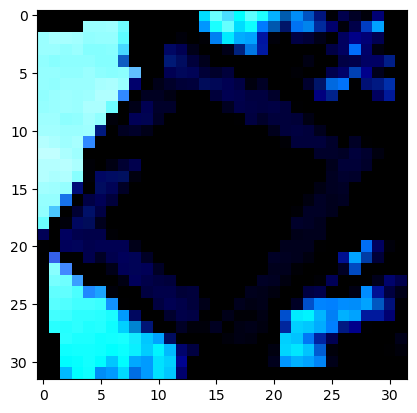

True Label: 3


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 3


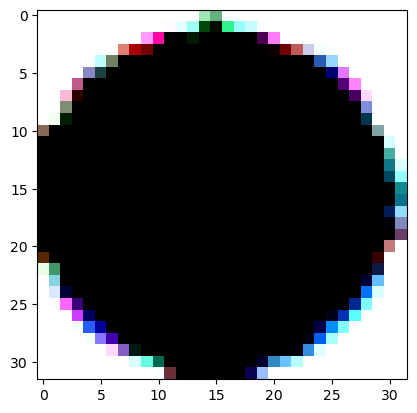

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 28
Predicted Label: 28


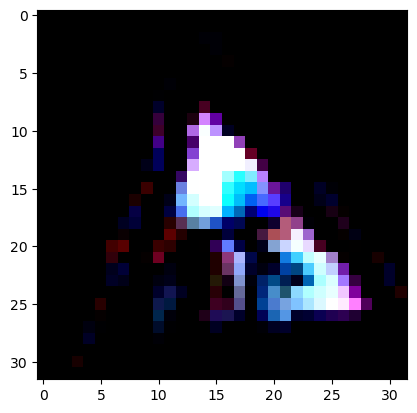

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 33
Predicted Label: 38


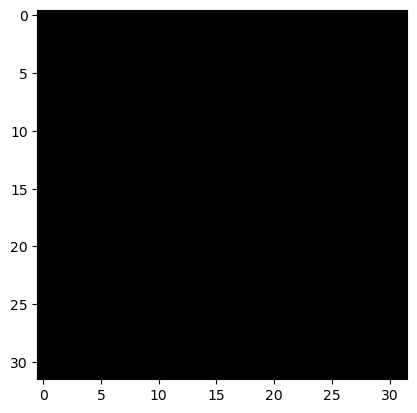

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


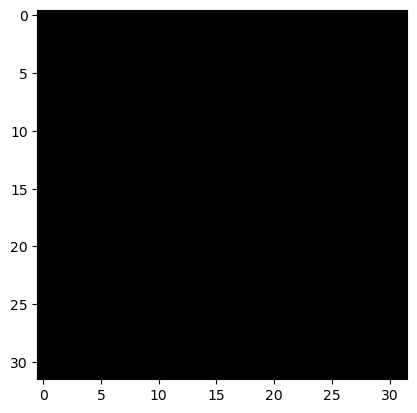

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


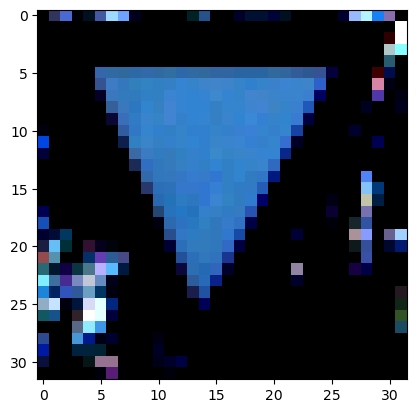

True Label: 2


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 2


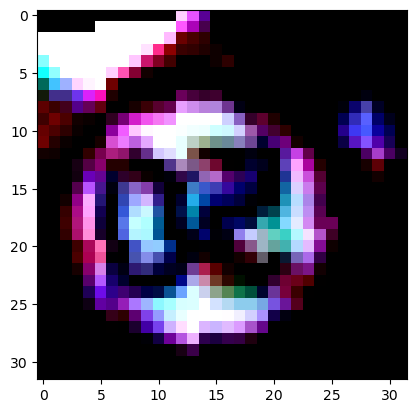

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


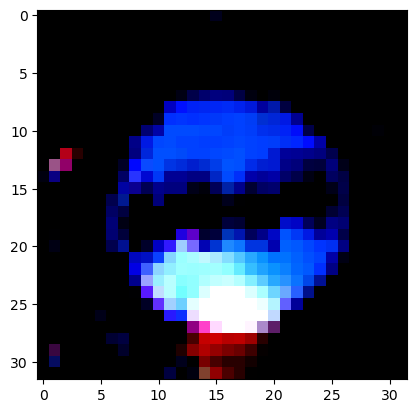

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 41
Predicted Label: 41


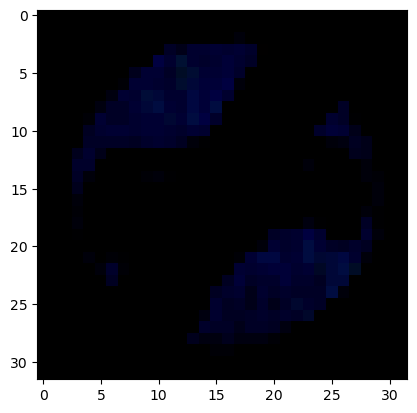

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 19
Predicted Label: 19


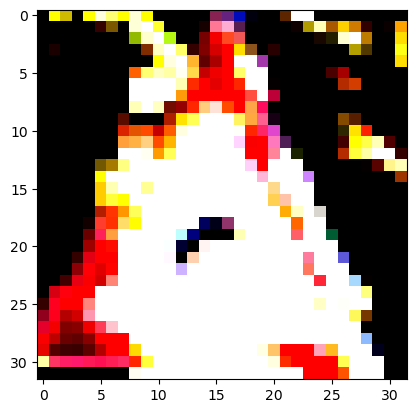

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


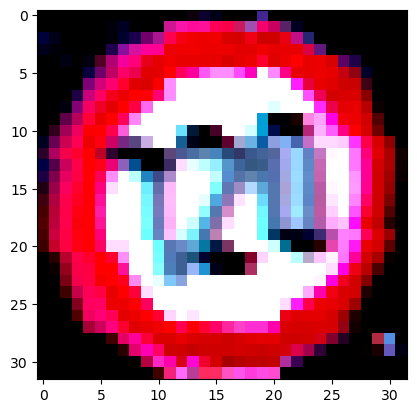

True Label: 38


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 38


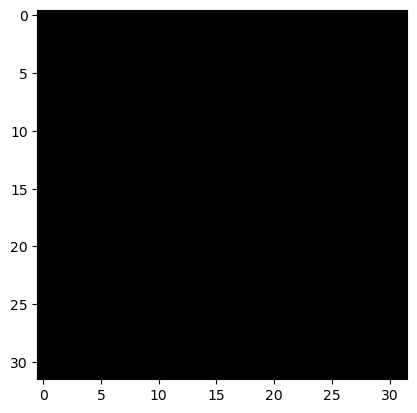

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


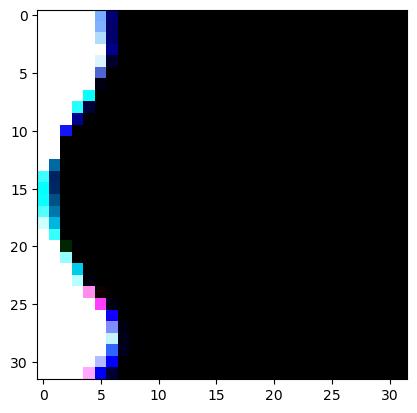

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 33
Predicted Label: 33


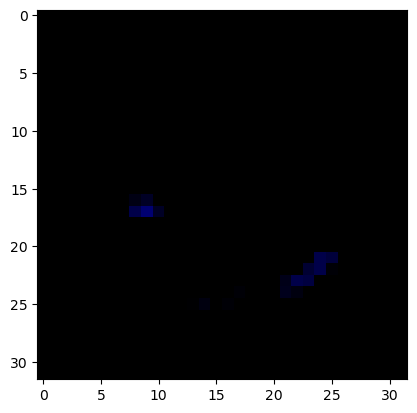

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


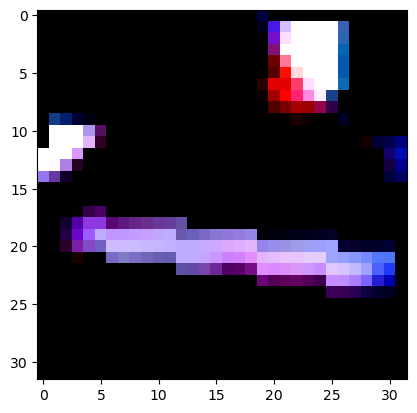

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 6
Predicted Label: 6


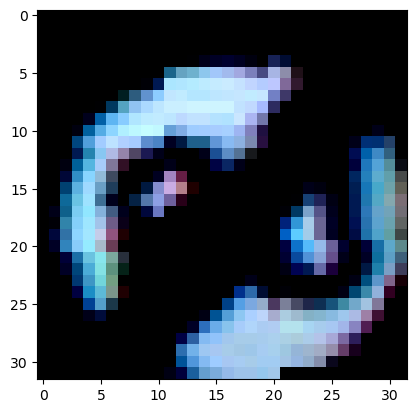

True Label: 38


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 38


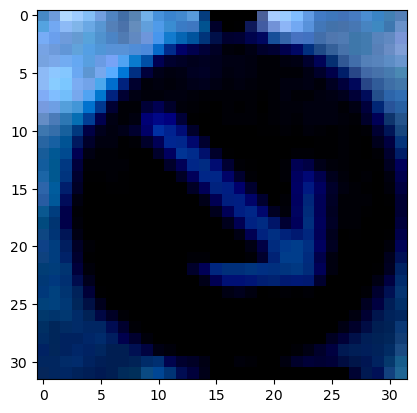

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


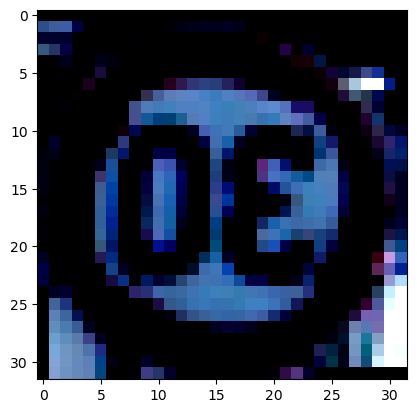

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


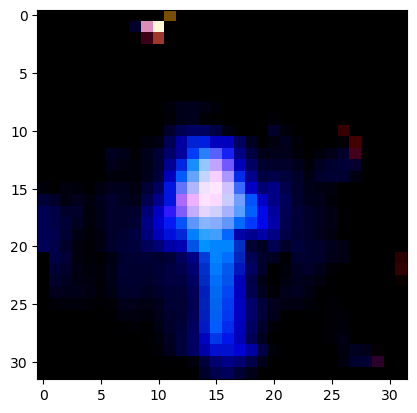

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


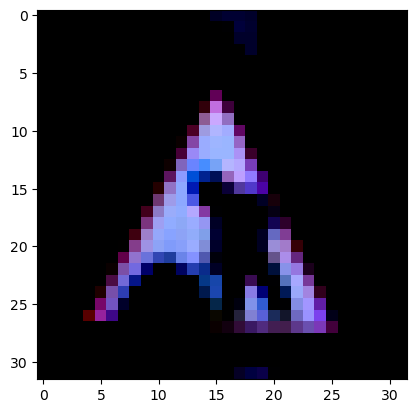

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


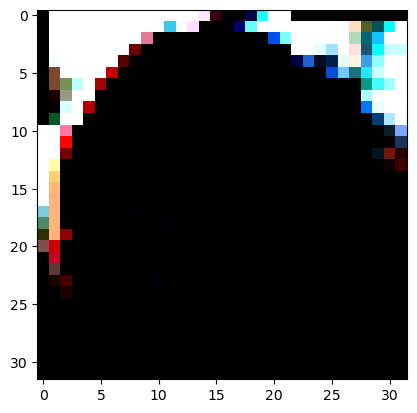

True Label: 30


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 30


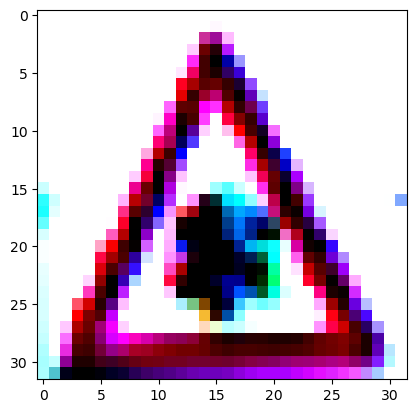

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


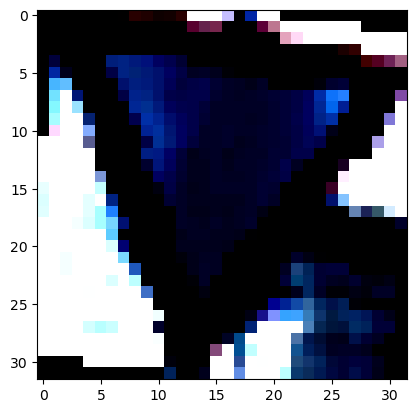

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 40
Predicted Label: 40


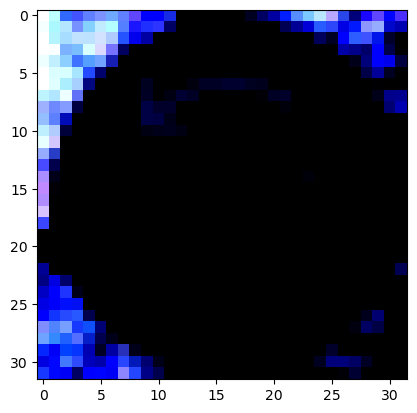

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


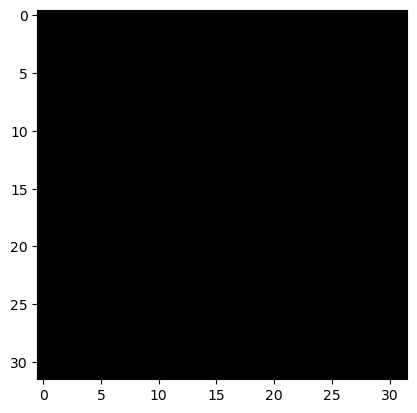

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


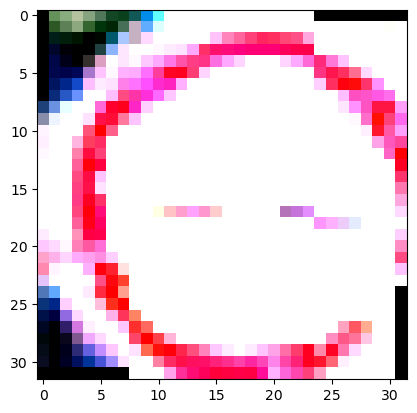

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


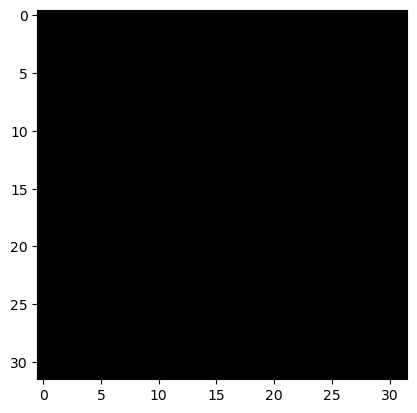

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


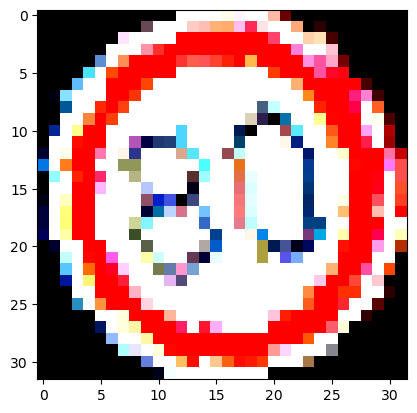

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


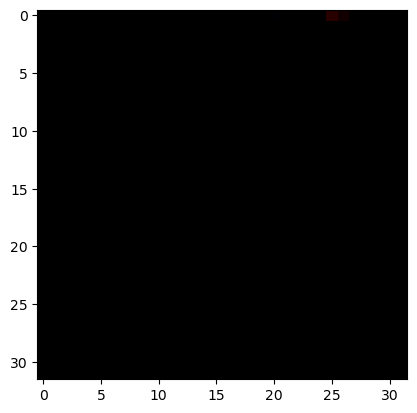

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


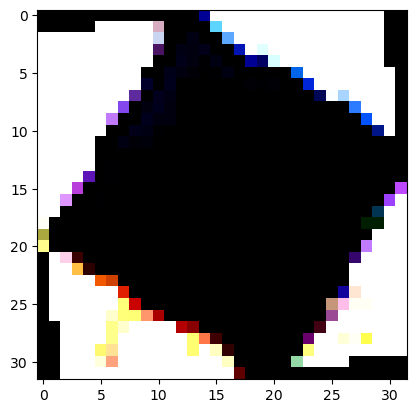

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


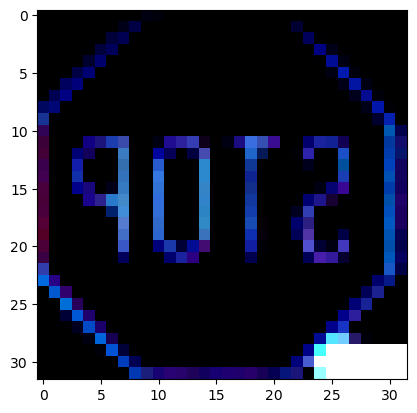

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


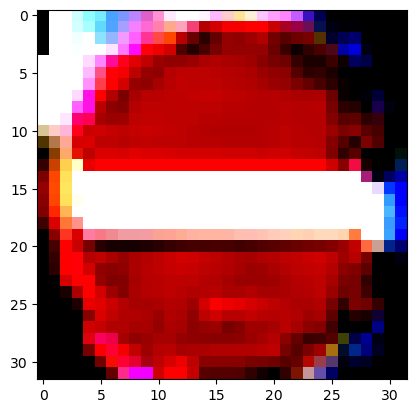

True Label: 9


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 9


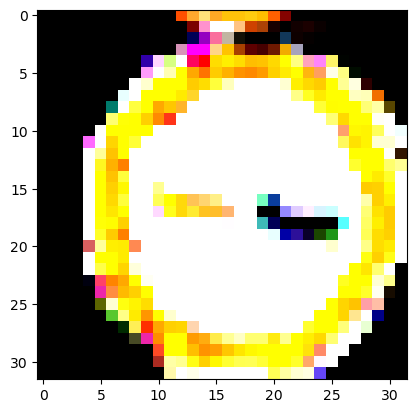

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


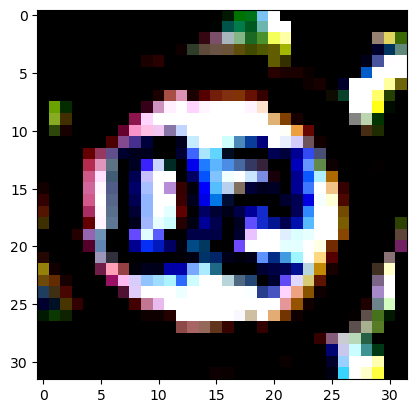

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


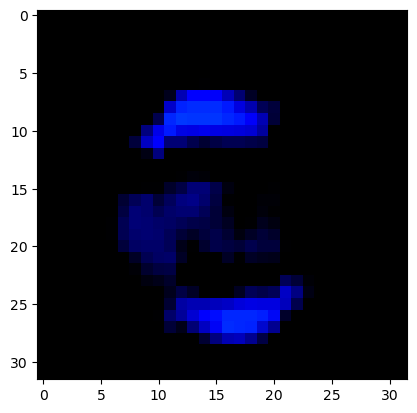

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


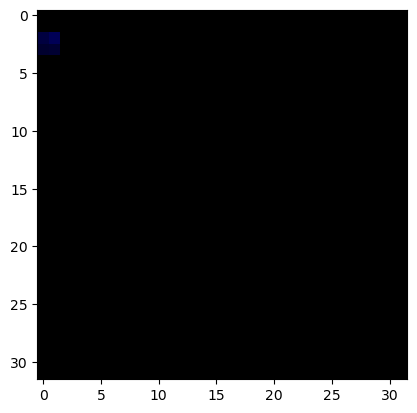

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 22
Predicted Label: 22


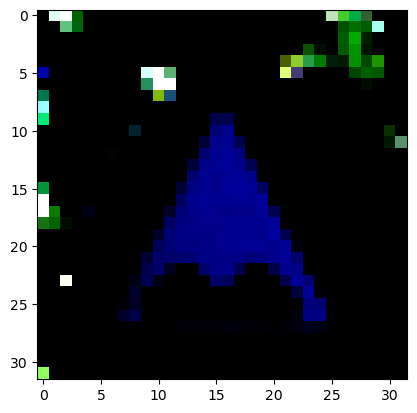

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


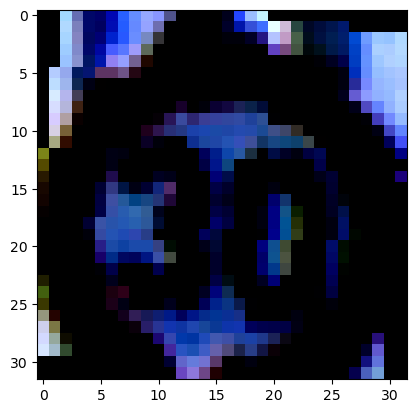

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 30
Predicted Label: 30


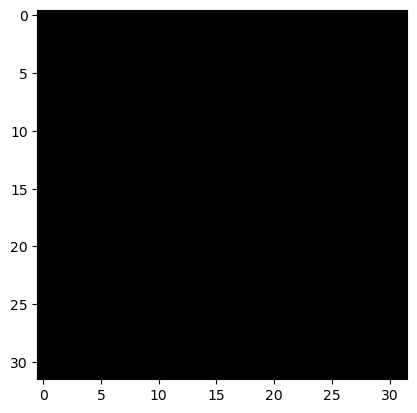

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


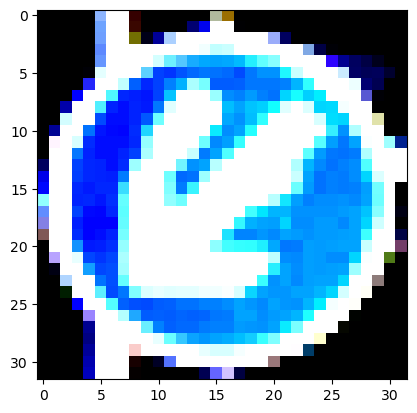

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


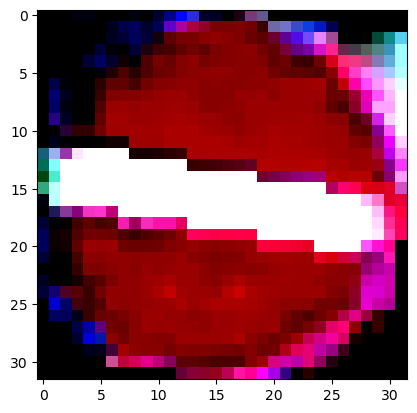

True Label: 4


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 4


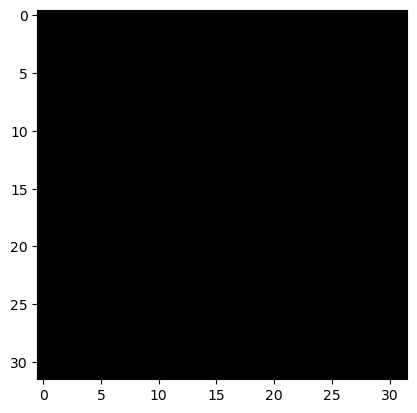

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


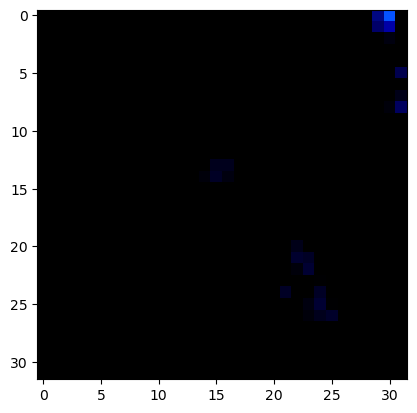

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


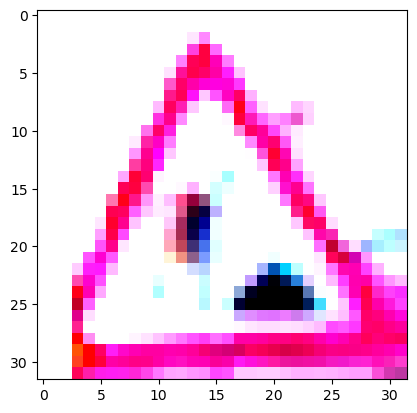

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


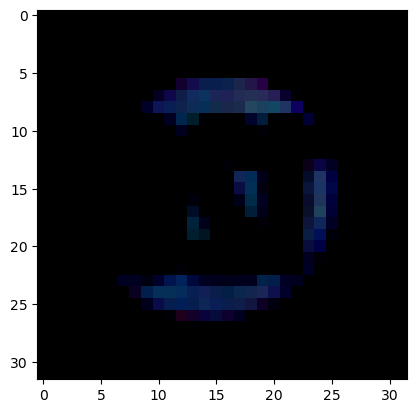

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


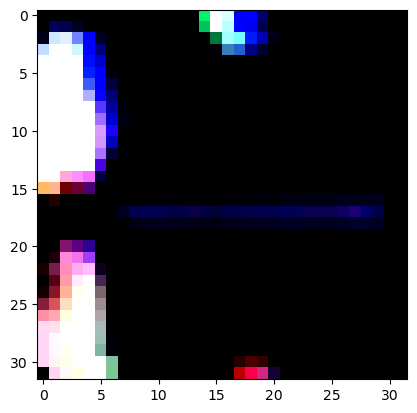

True Label: 10


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 10


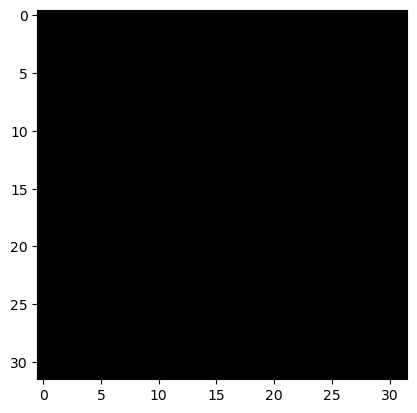

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 16
Predicted Label: 16


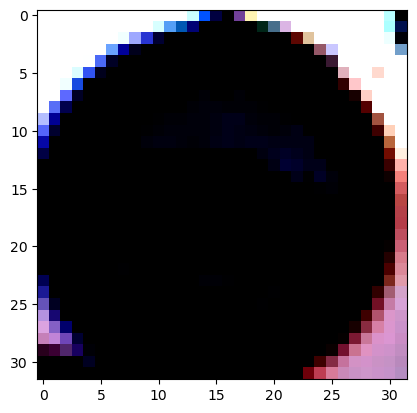

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


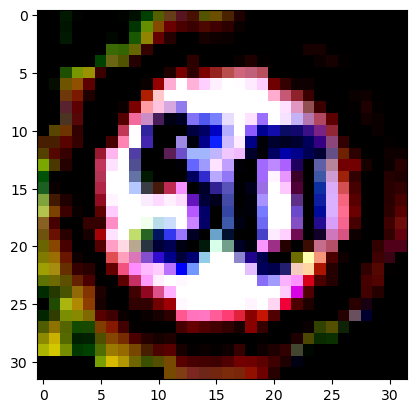

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


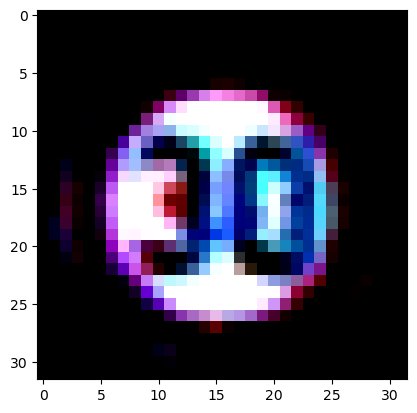

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


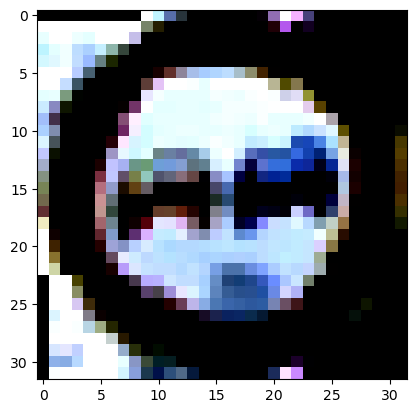

True Label: 23


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 23


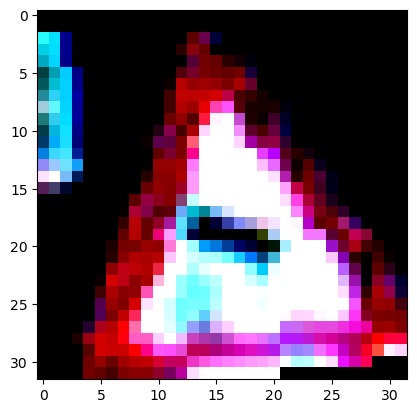

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 6
Predicted Label: 6


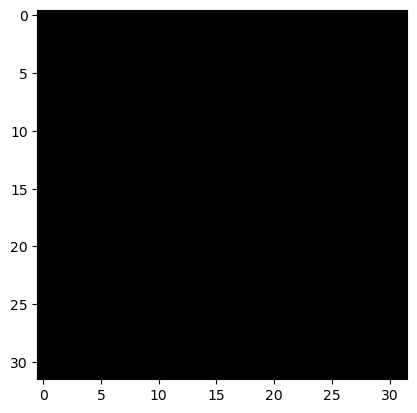

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


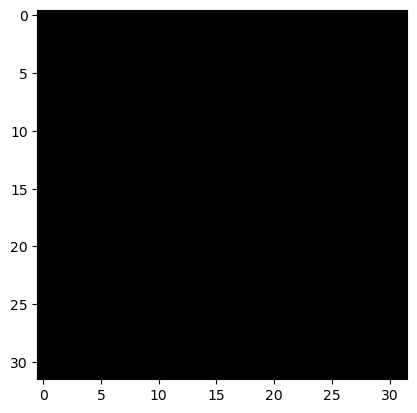

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 26


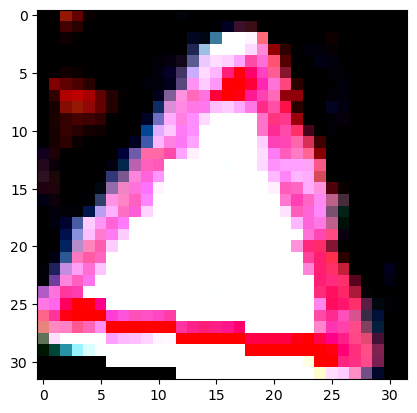

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


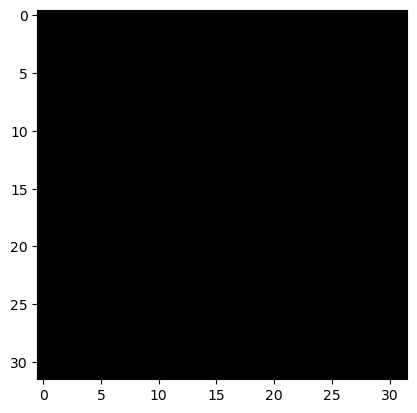

True Label: 31


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 31


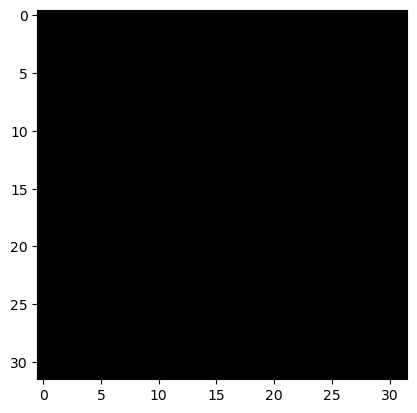

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


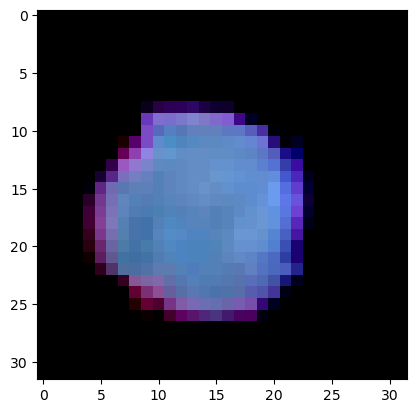

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


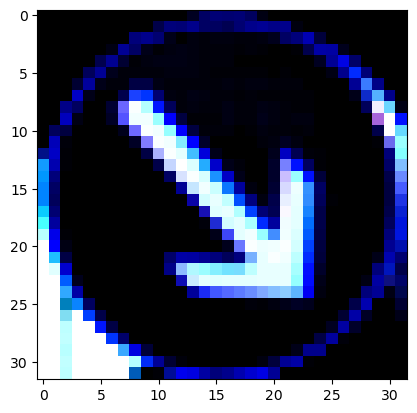

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


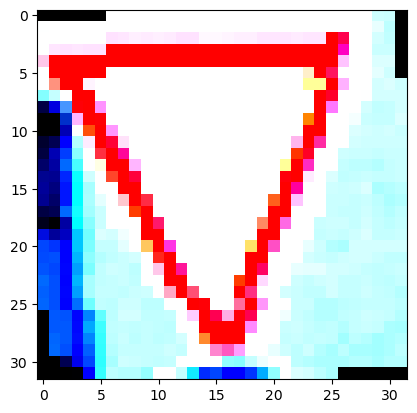

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


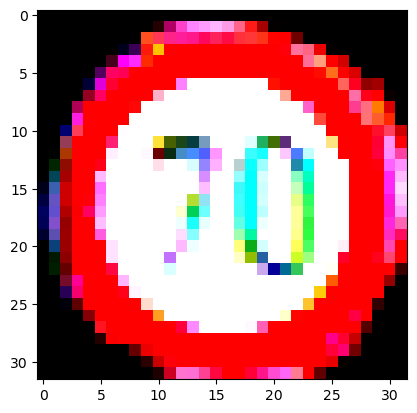

True Label: 4


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 4


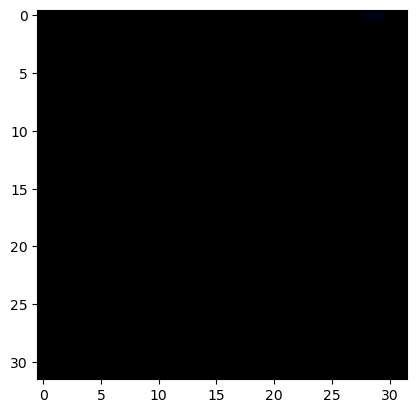

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


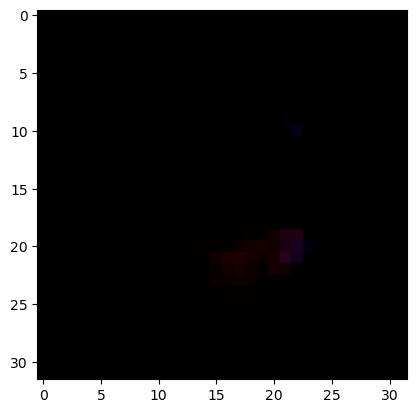

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


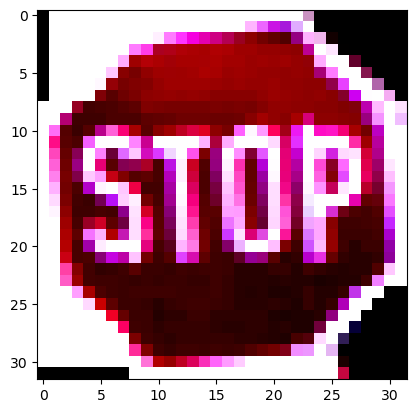

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


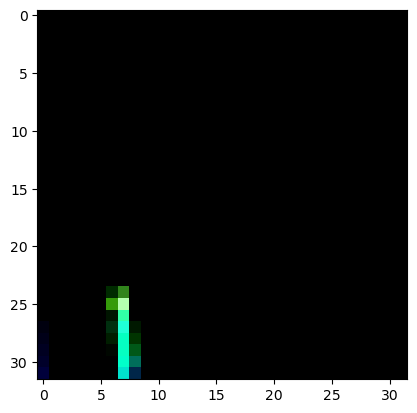

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


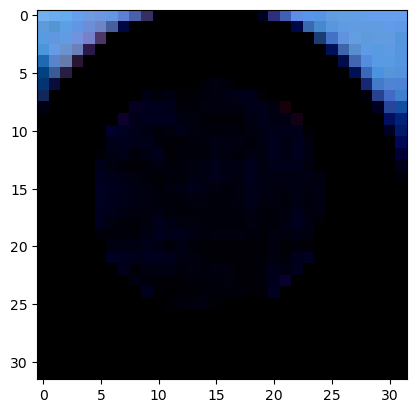

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


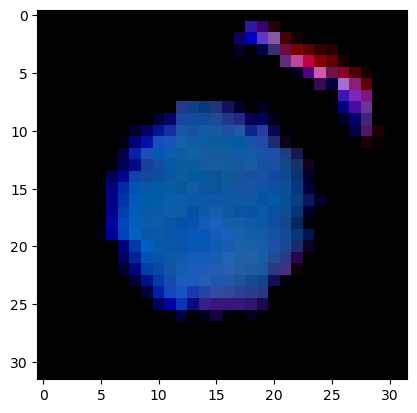

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


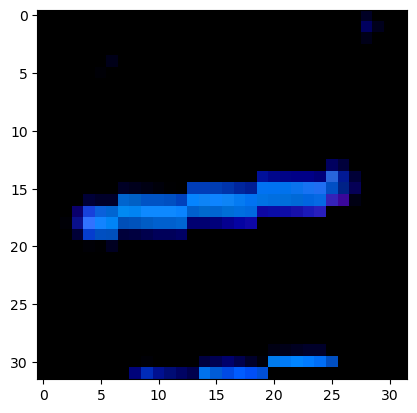

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


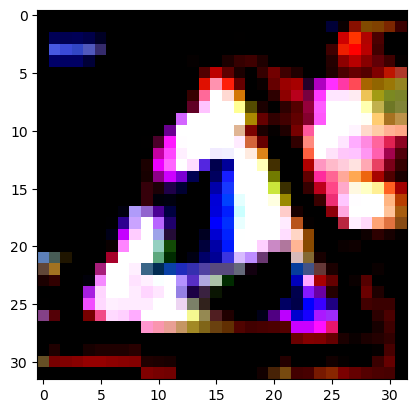

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


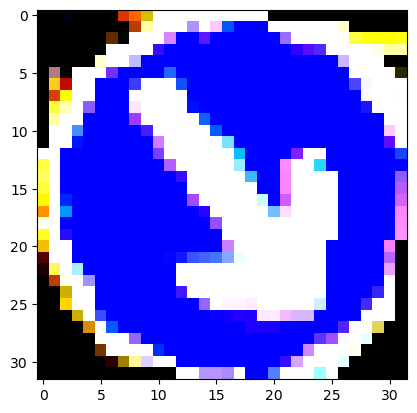

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


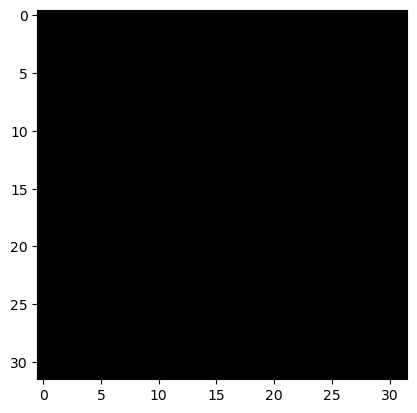

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


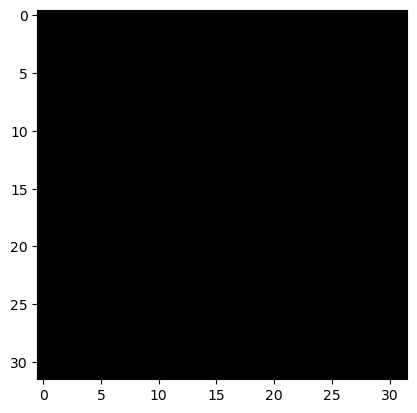

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


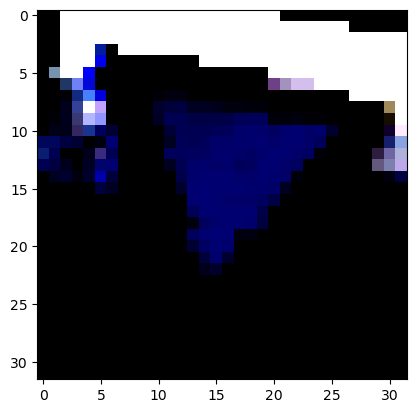

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 28
Predicted Label: 28


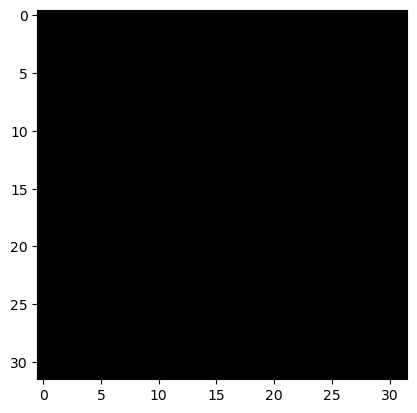

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 40
Predicted Label: 40


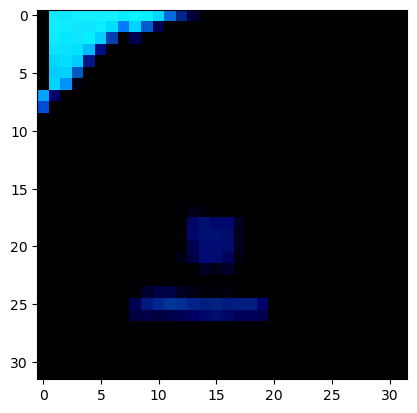

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


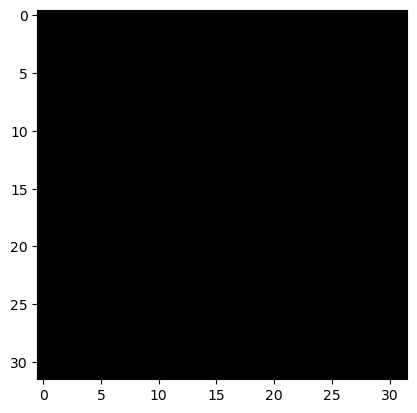

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 36
Predicted Label: 36


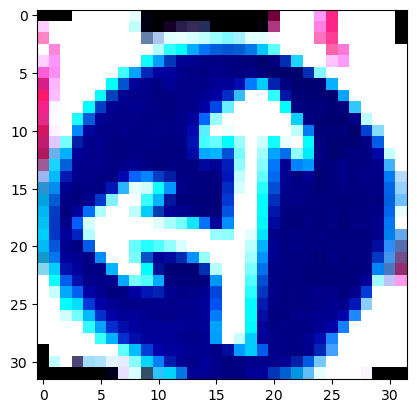

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


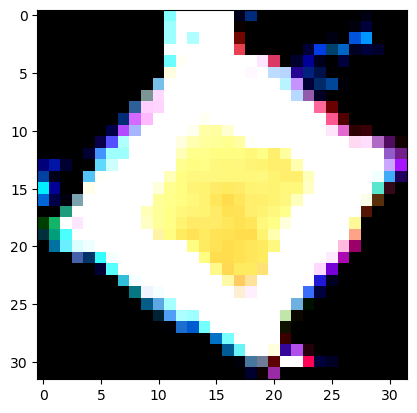

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


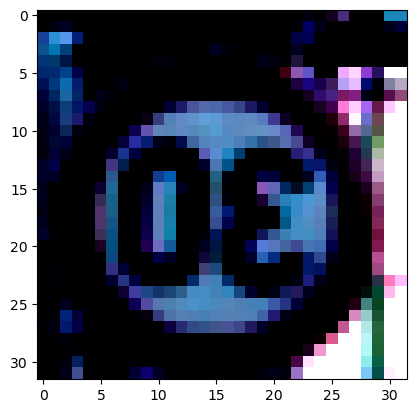

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


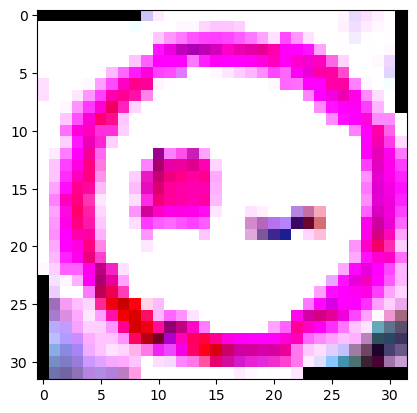

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


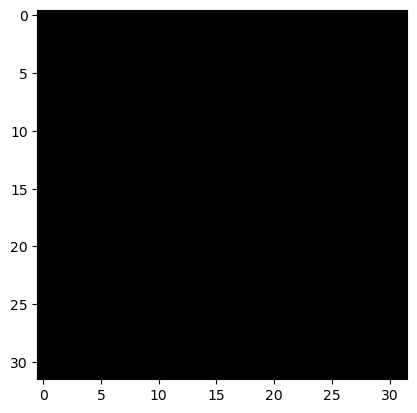

True Label: 9


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 9


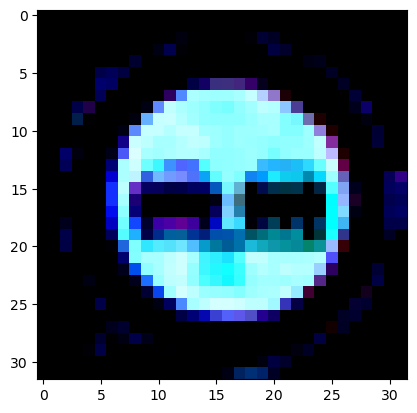

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


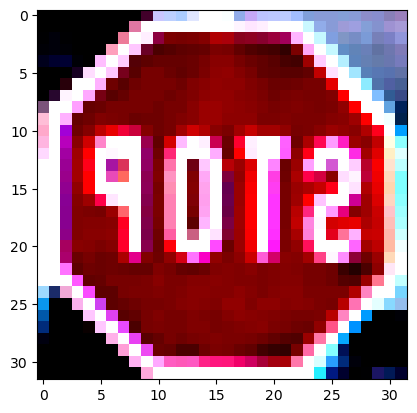

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 28
Predicted Label: 28


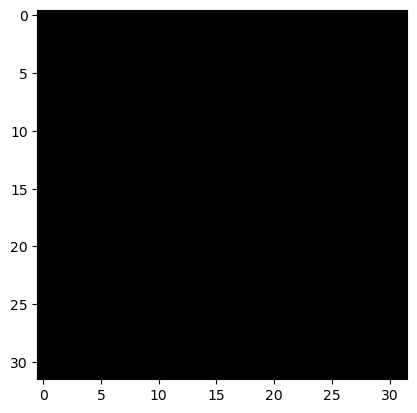

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


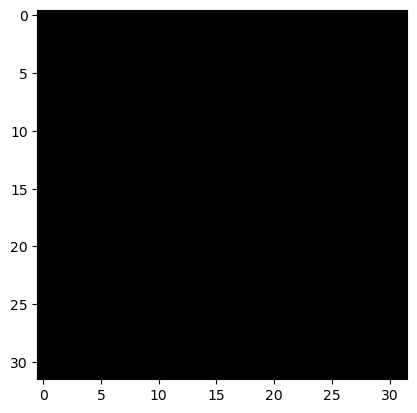

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


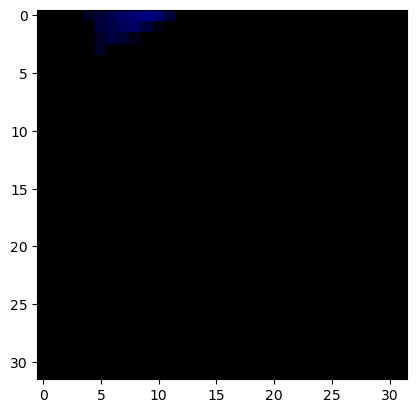

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


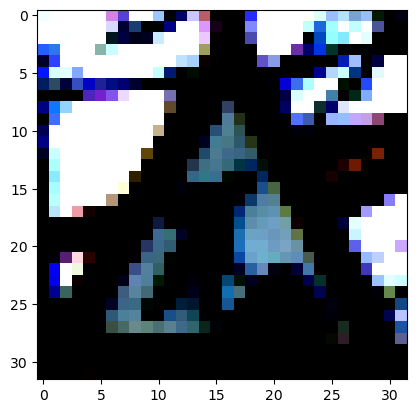

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


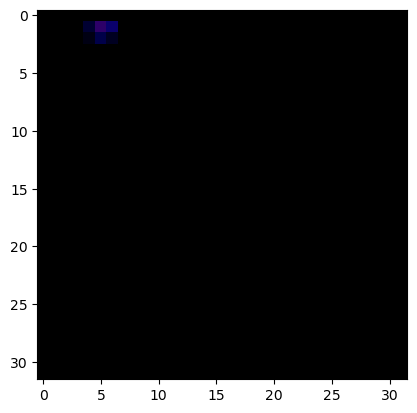

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


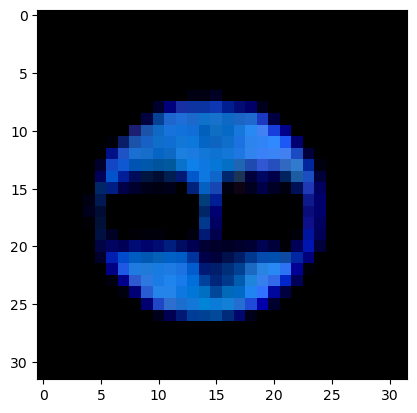

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


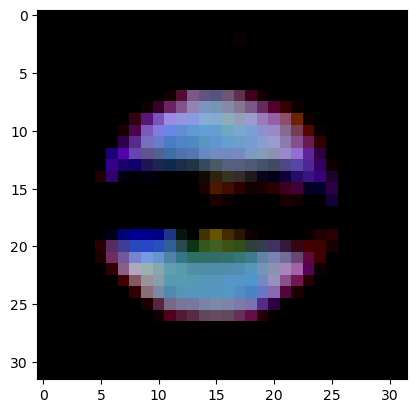

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


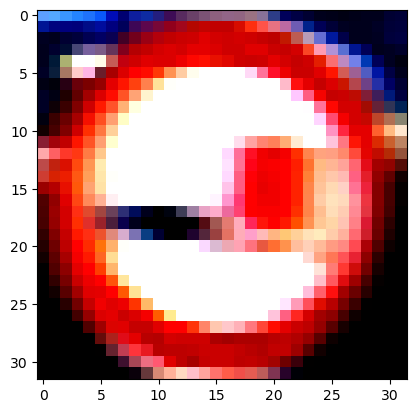

True Label: 1


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 1


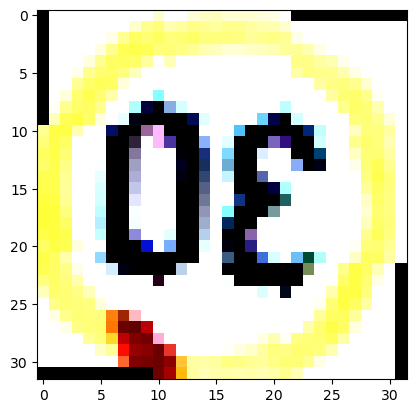

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


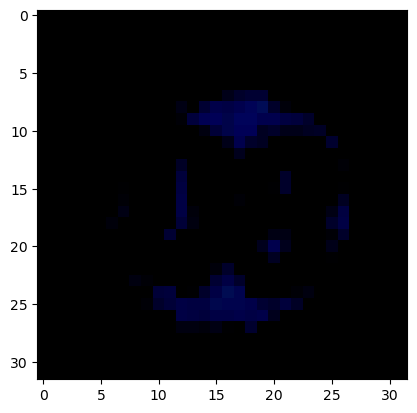

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


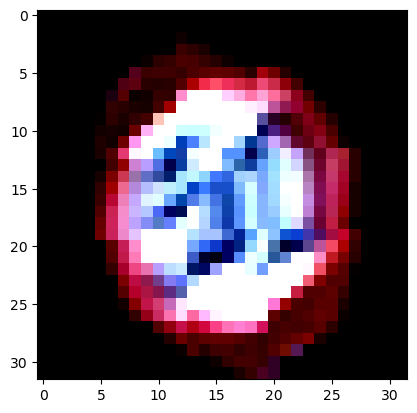

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


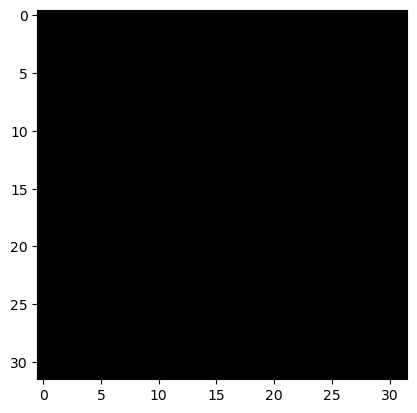

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


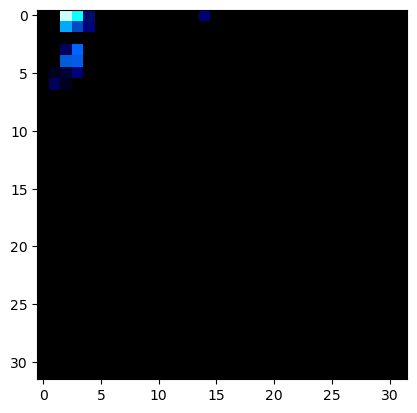

True Label: 6


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 6


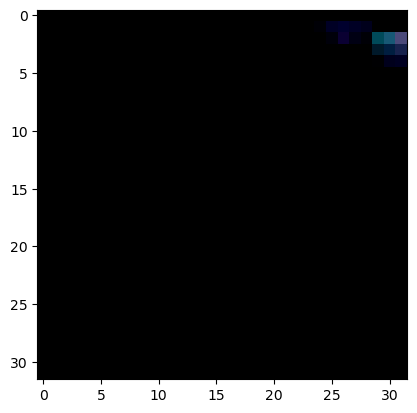

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


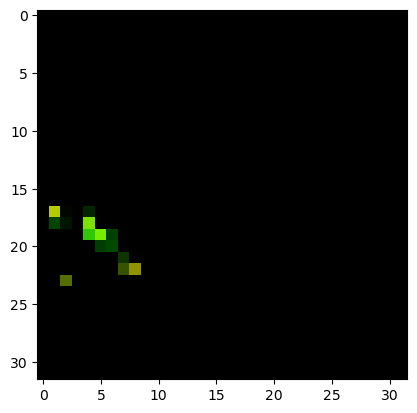

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


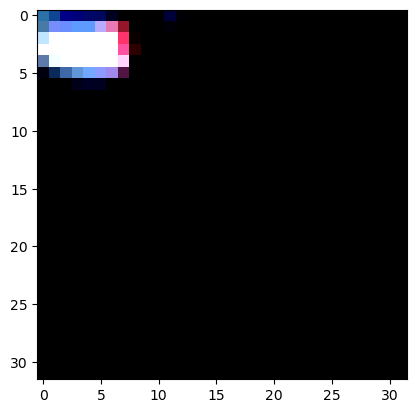

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 8


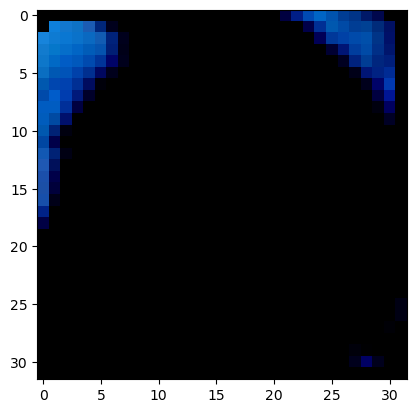

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


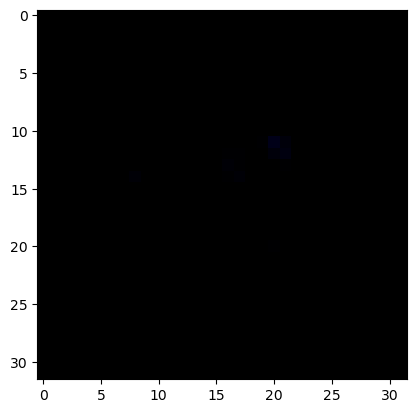

True Label: 20


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 19


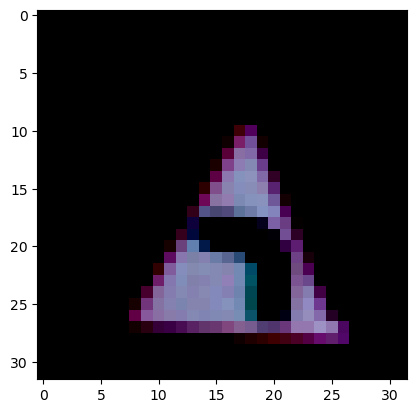

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


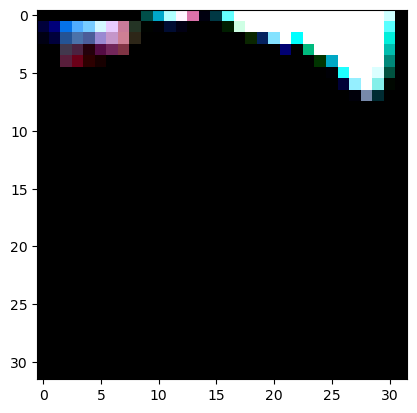

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


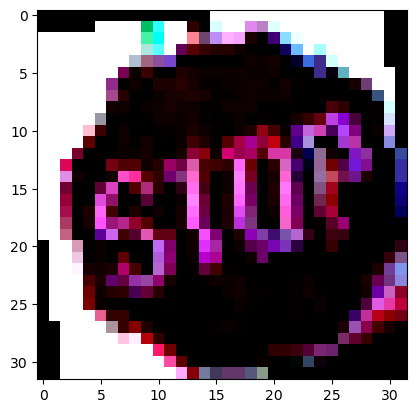

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


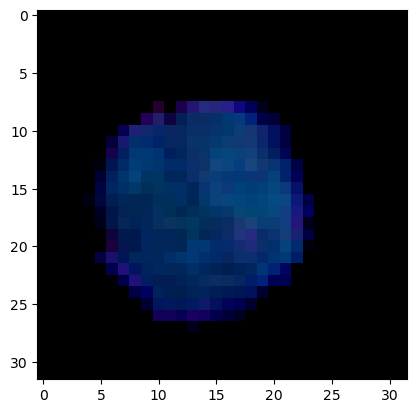

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


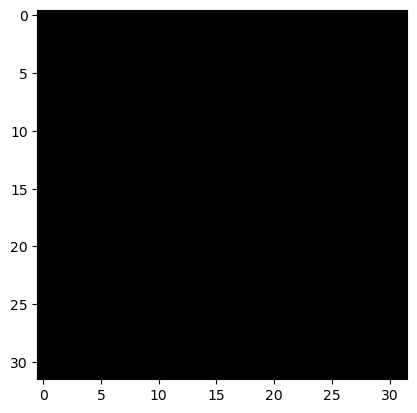

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


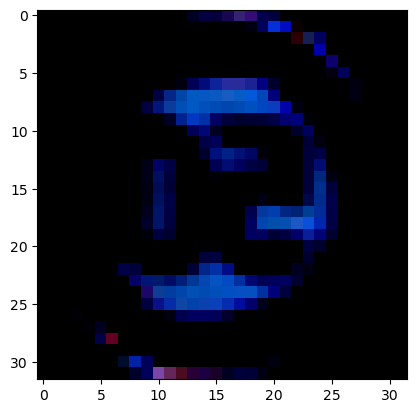

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 29
Predicted Label: 29


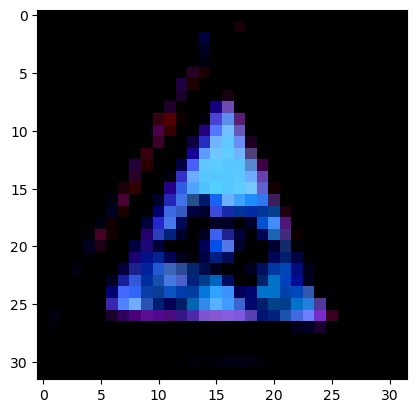

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


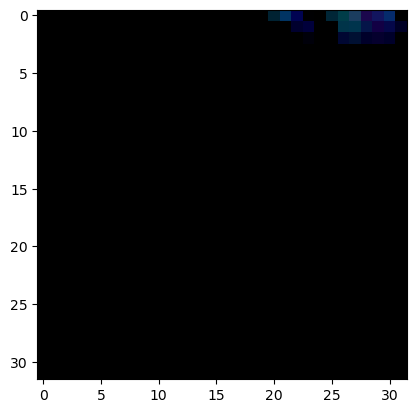

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


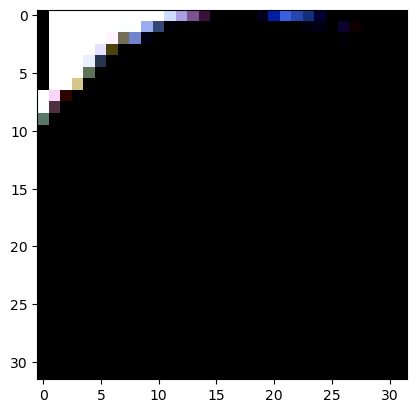

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


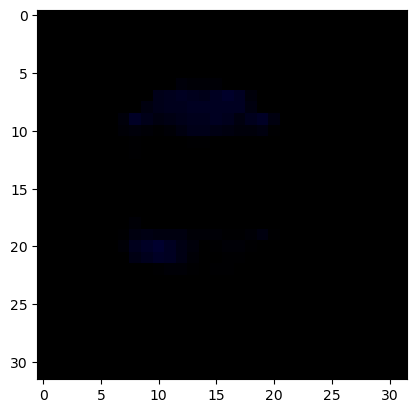

True Label: 30


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 30


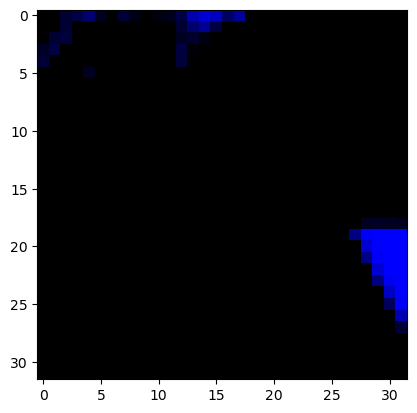

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


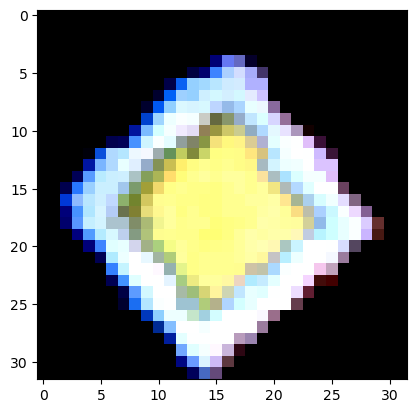

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


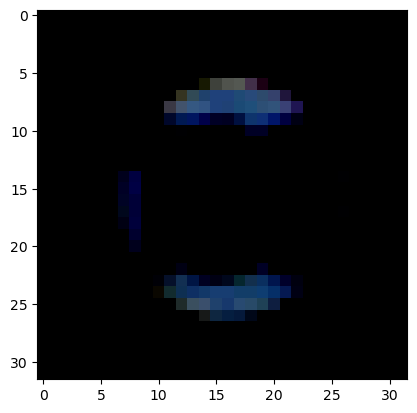

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 31
Predicted Label: 31


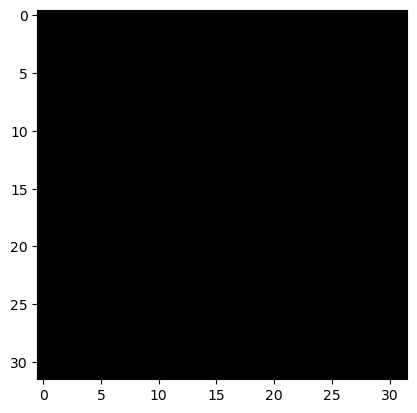

True Label: 10
Predicted Label: 10


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


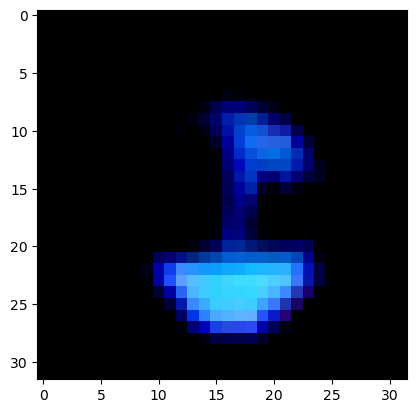

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


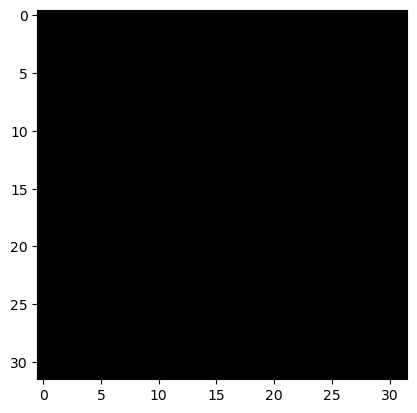

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


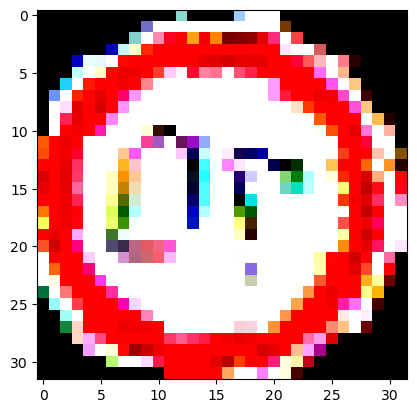

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 40
Predicted Label: 40


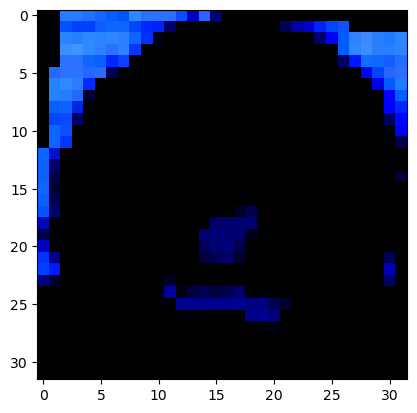

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


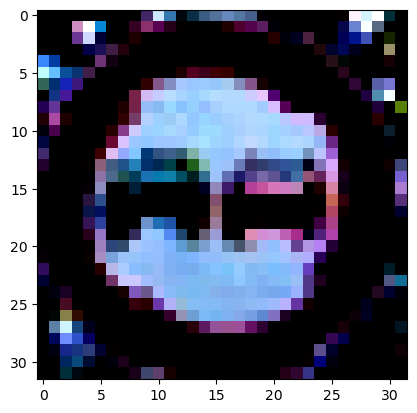

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 33
Predicted Label: 33


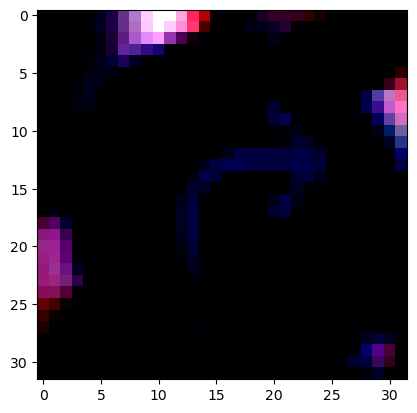

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


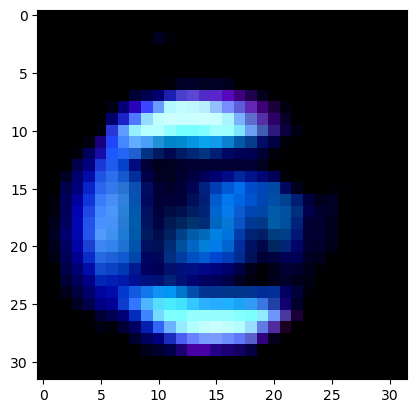

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


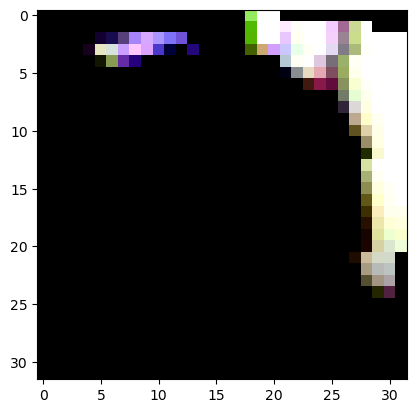

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


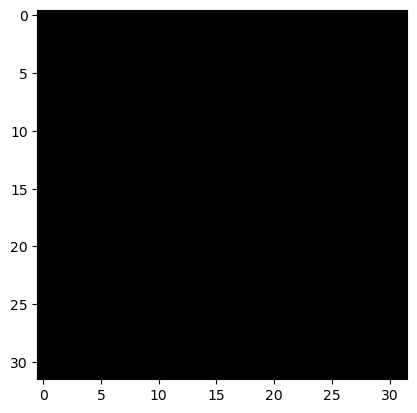

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 26
Predicted Label: 26


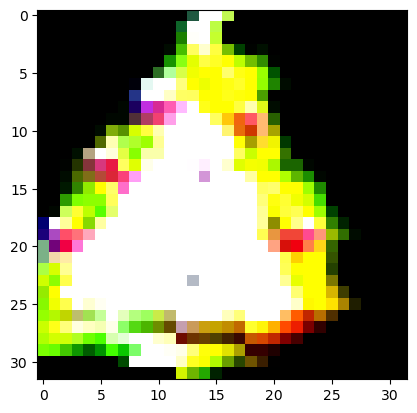

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 31
Predicted Label: 31


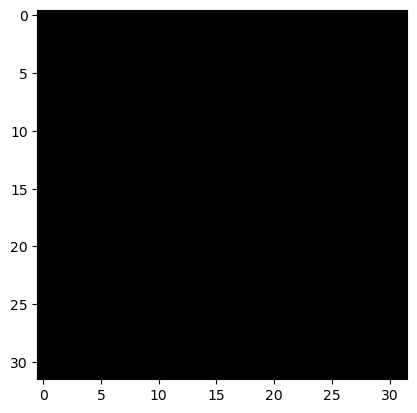

True Label: 27


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 27


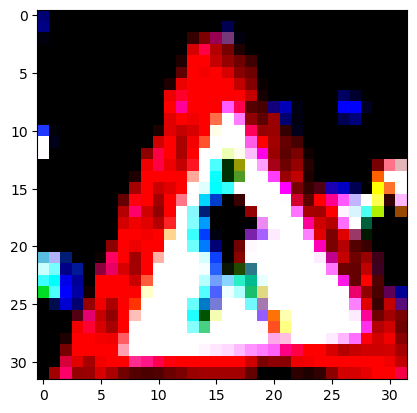

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


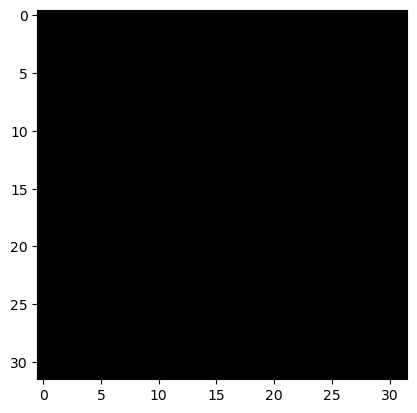

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


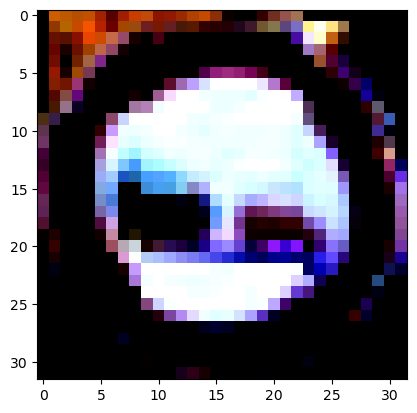

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


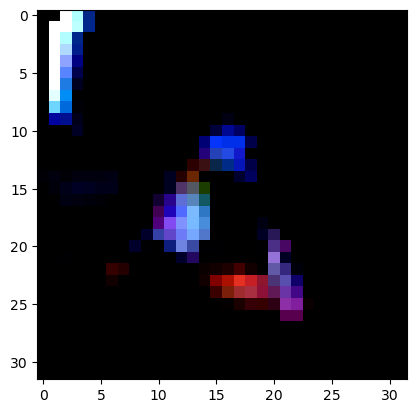

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


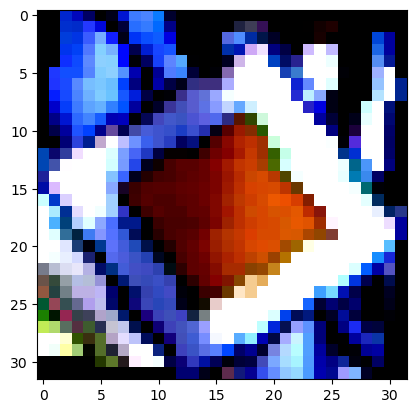

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


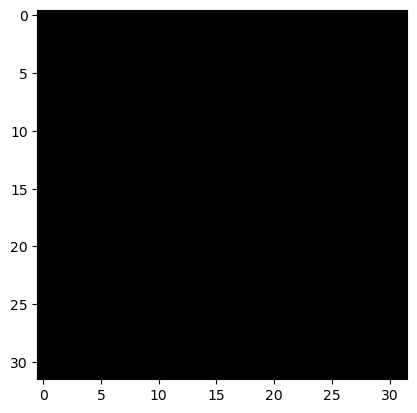

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


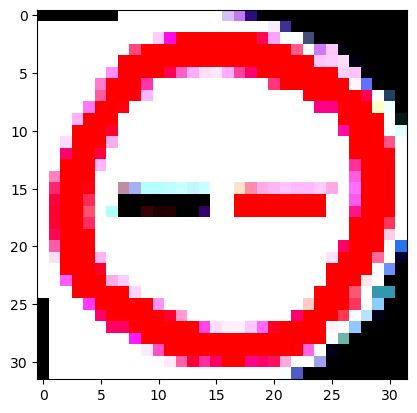

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 32
Predicted Label: 32


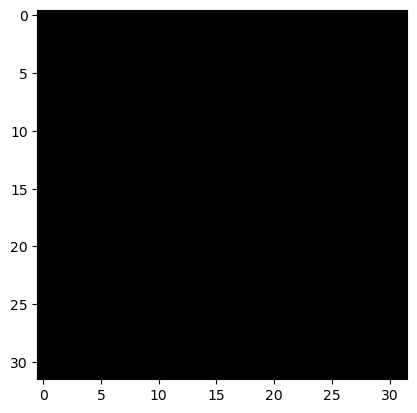

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


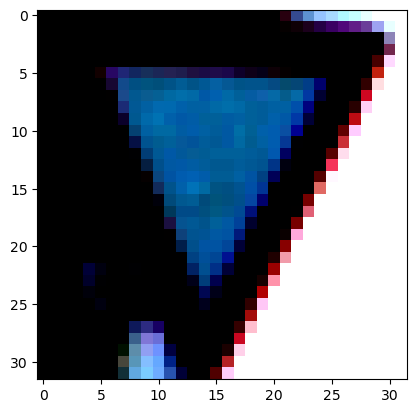

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 20
Predicted Label: 20


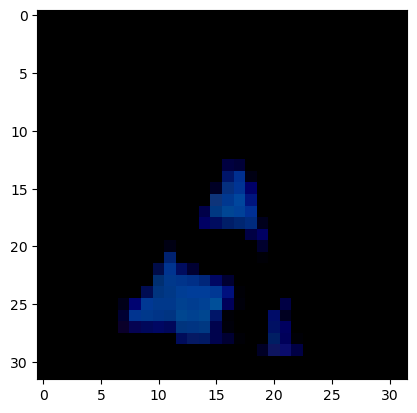

True Label: 20


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 20


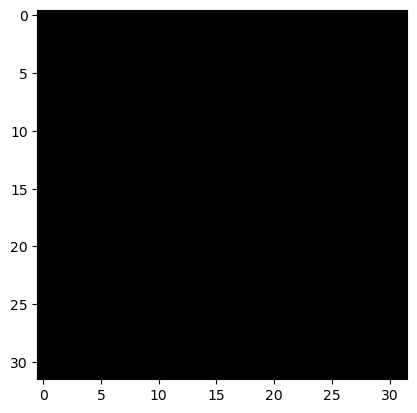

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


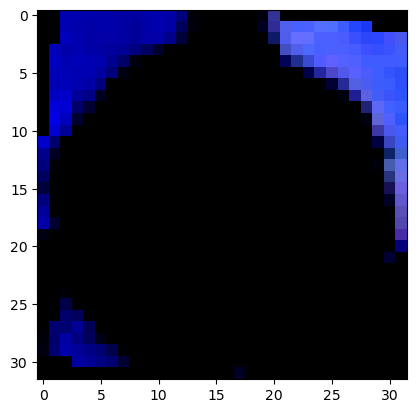

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


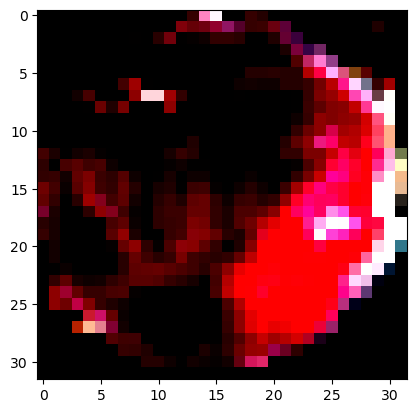

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


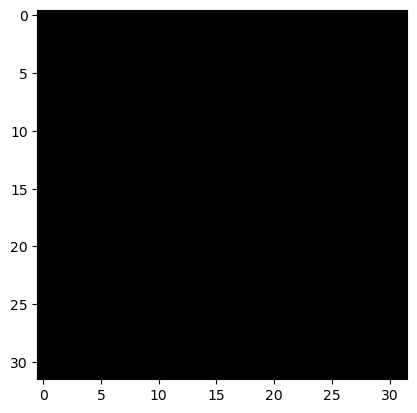

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 24
Predicted Label: 24


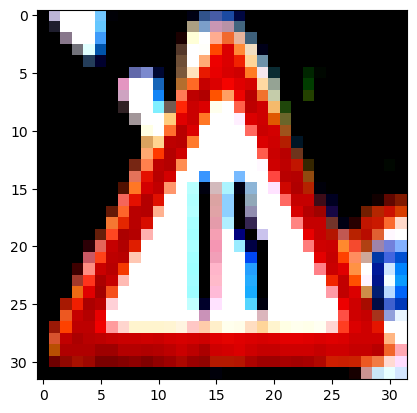

True Label: 14


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 14


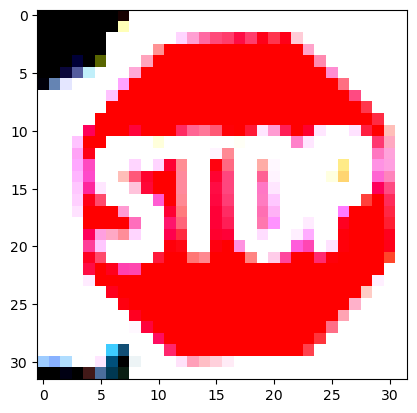

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


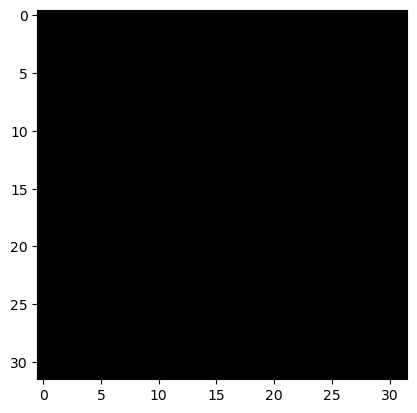

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


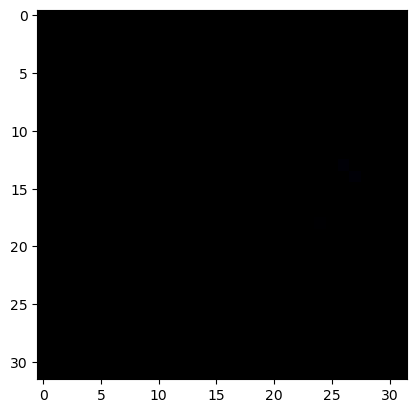

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


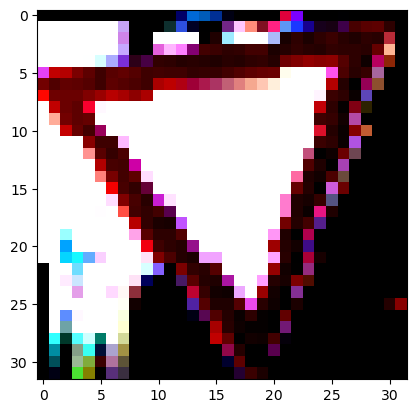

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


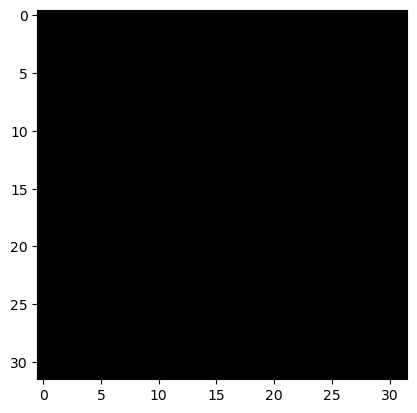

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 41
Predicted Label: 41


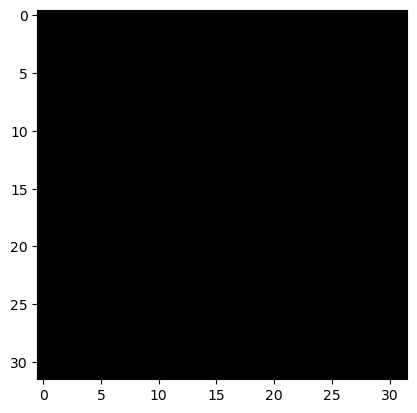

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


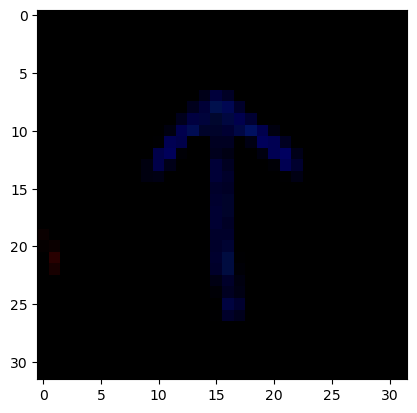

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


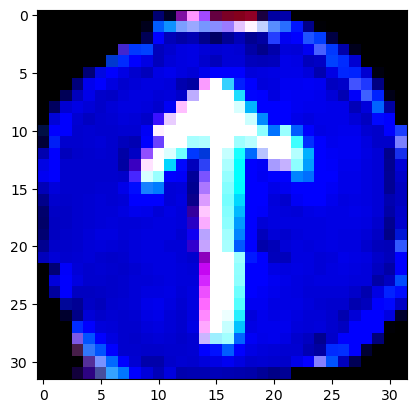

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 26
Predicted Label: 26


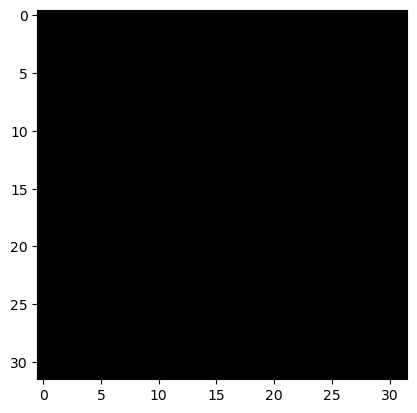

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


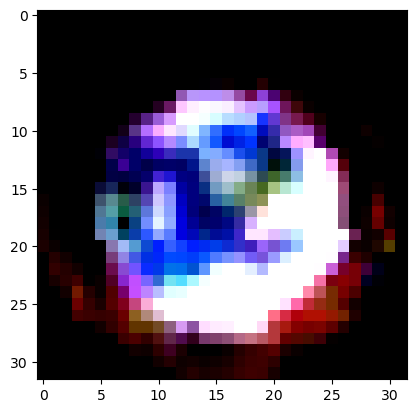

True Label: 23


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 23


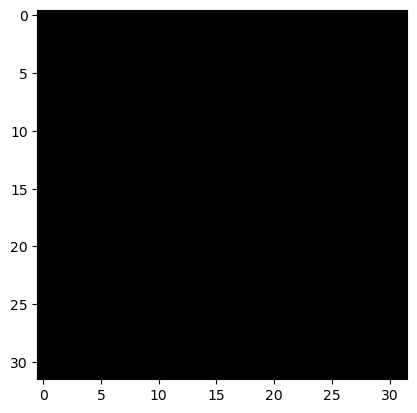

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


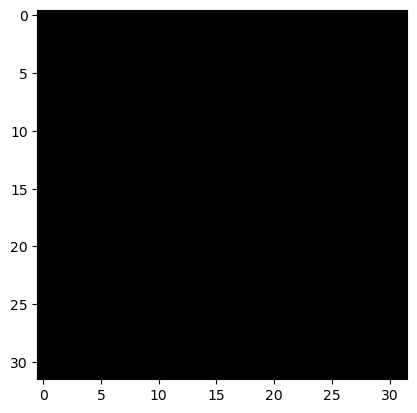

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 36
Predicted Label: 36


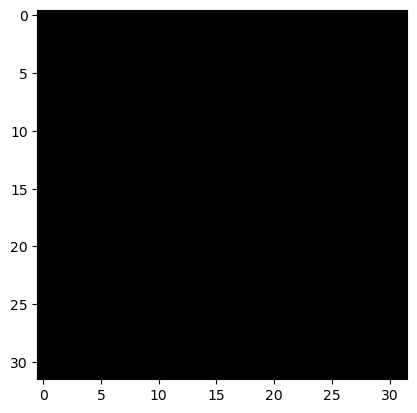

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


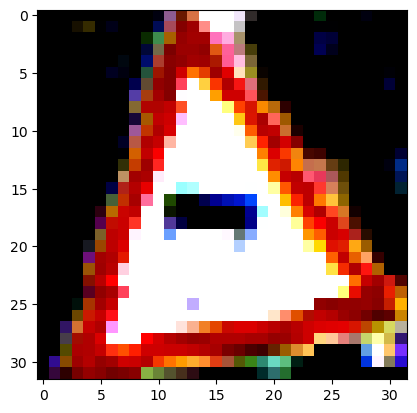

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


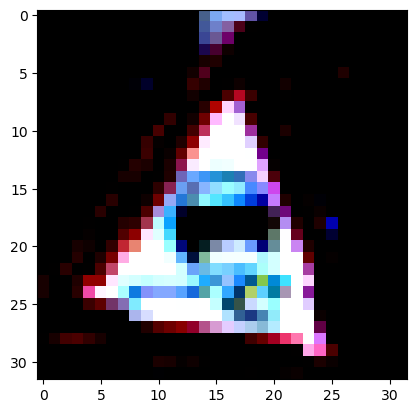

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


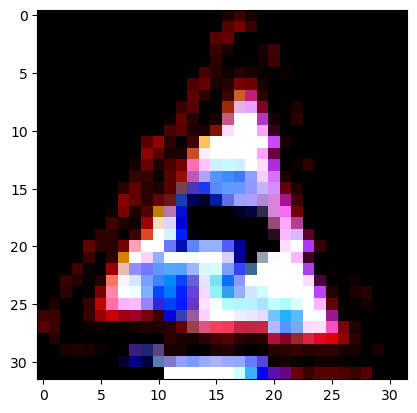

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


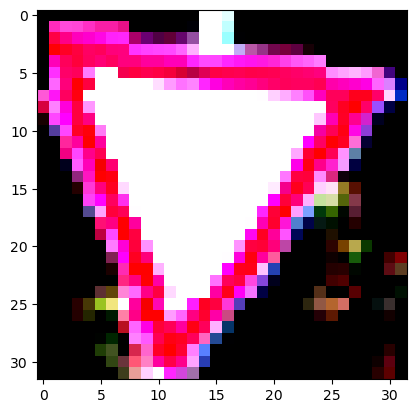

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 34
Predicted Label: 34


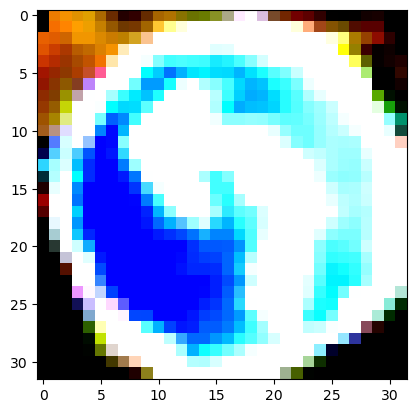

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


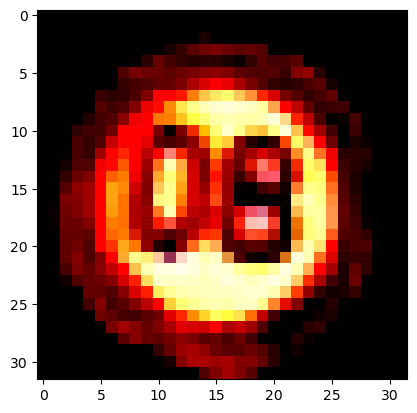

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


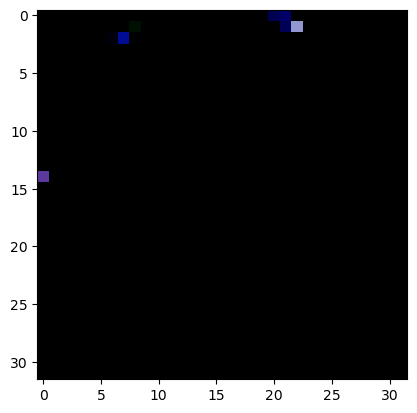

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


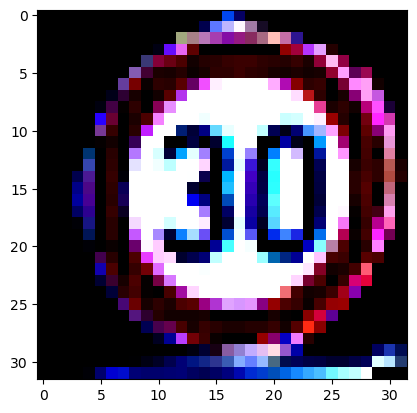

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


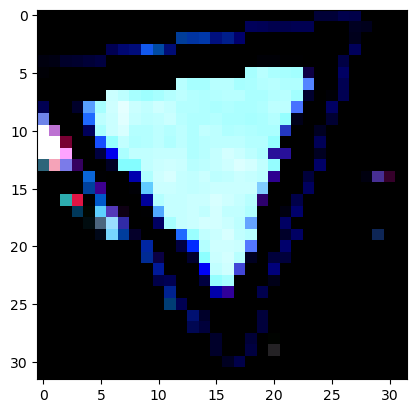

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


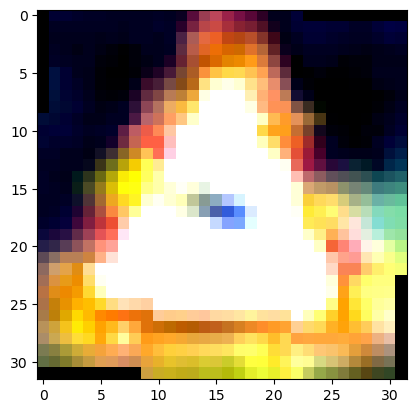

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


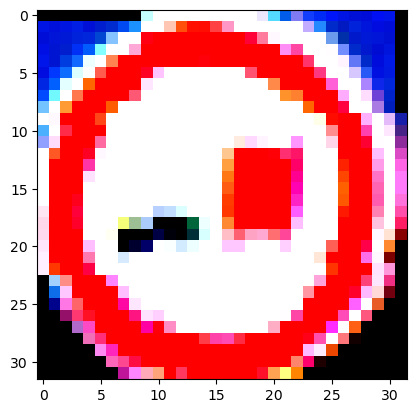

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 26
Predicted Label: 26


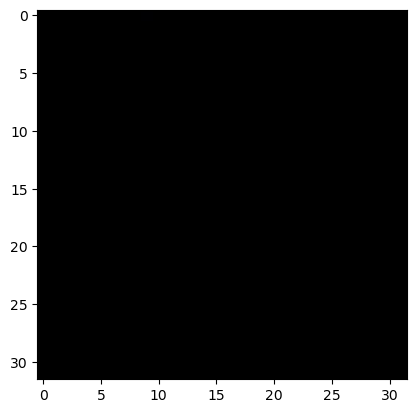

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


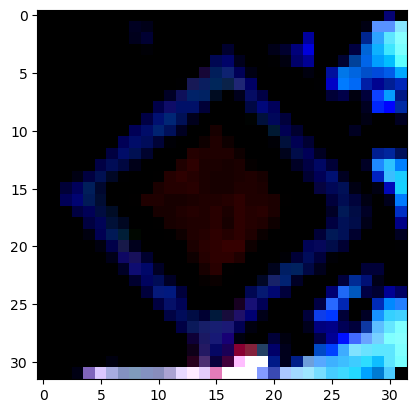

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


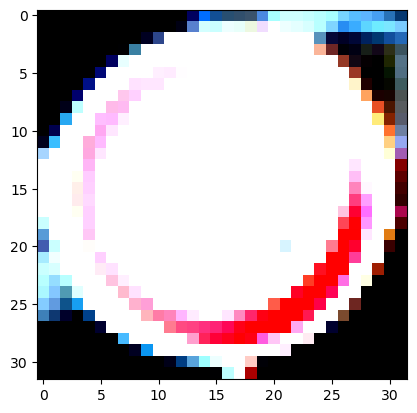

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 29
Predicted Label: 29


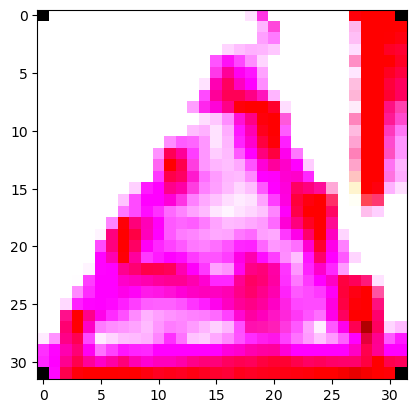

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 5


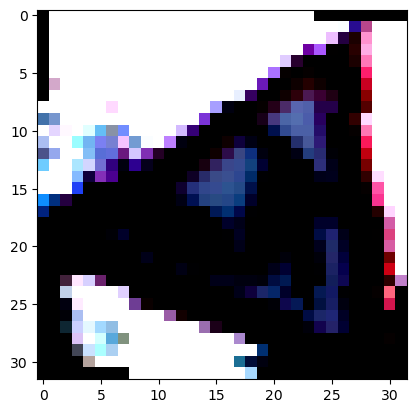

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


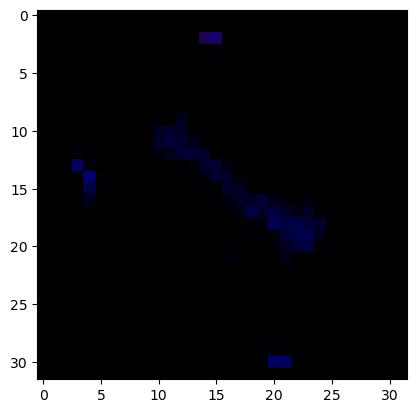

True Label: 25


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 25


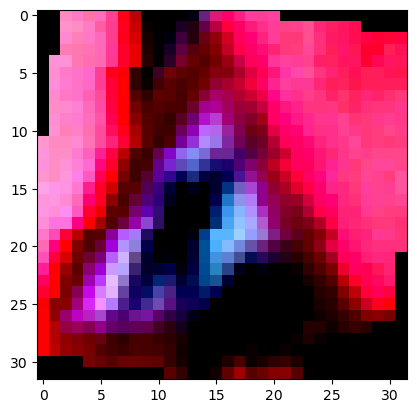

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


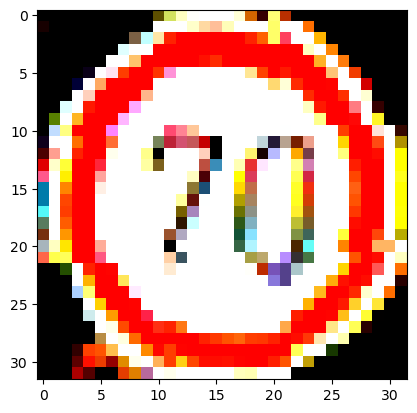

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 29
Predicted Label: 29


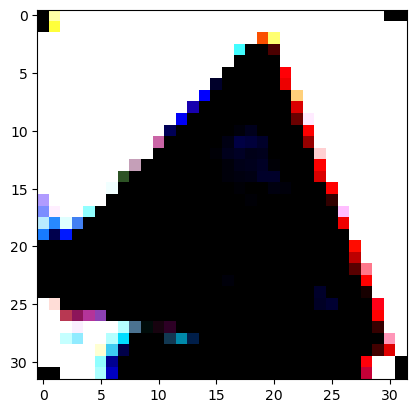

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 27
Predicted Label: 27


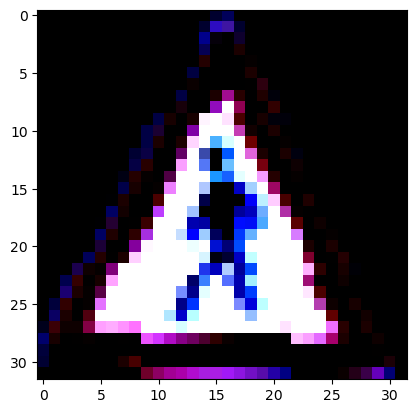

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


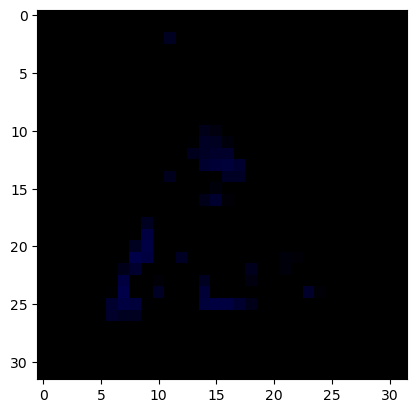

True Label: 9


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 9


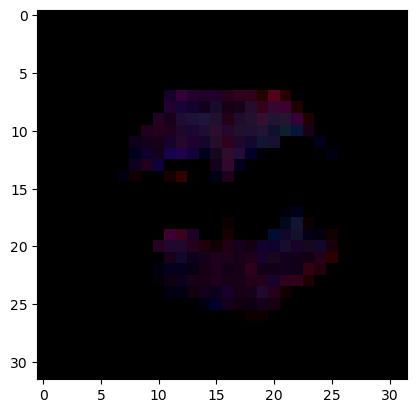

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


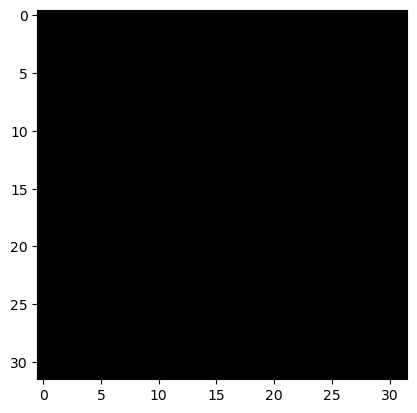

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


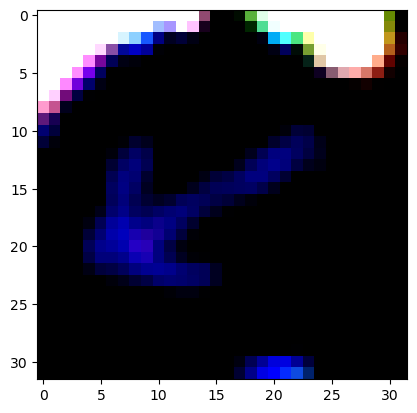

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


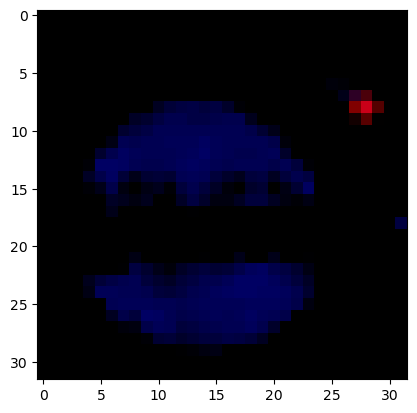

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


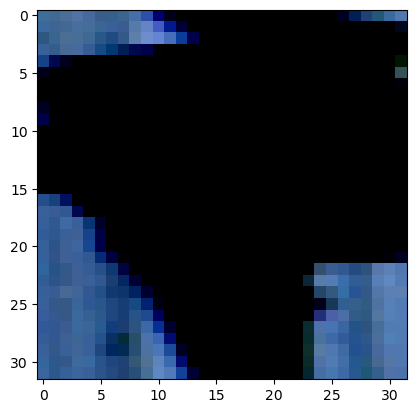

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 31
Predicted Label: 31


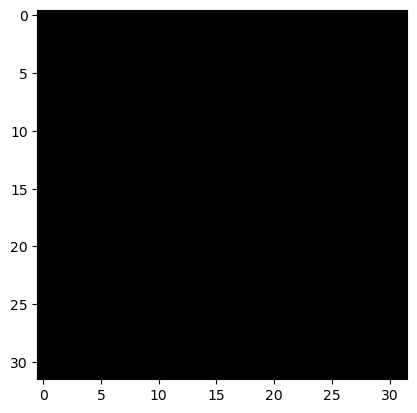

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 30
Predicted Label: 30


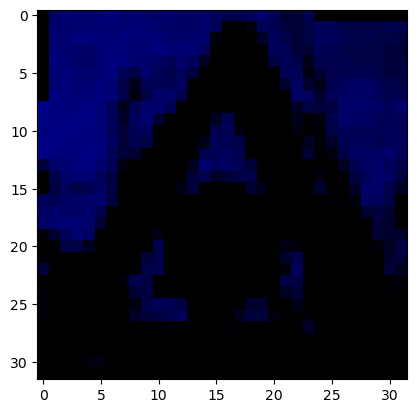

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


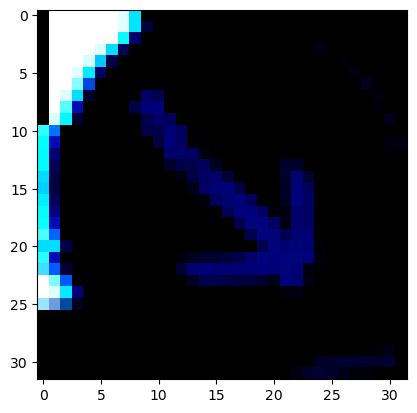

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


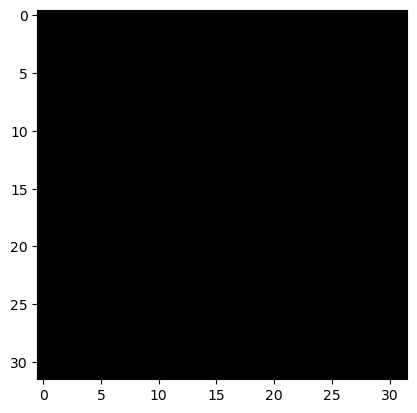

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


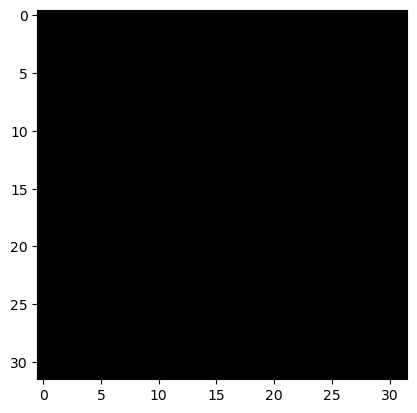

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


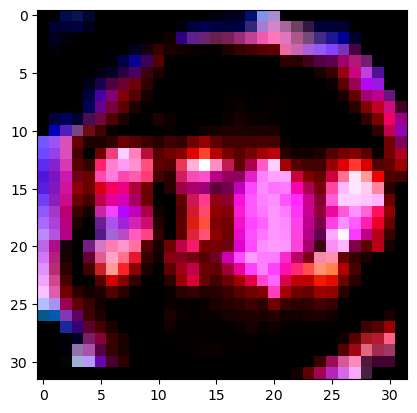

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


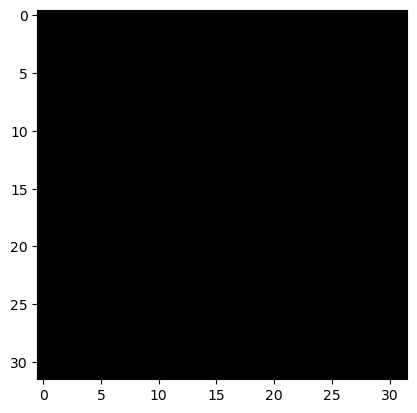

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 21
Predicted Label: 21


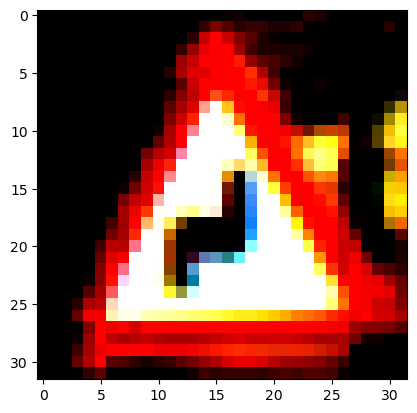

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


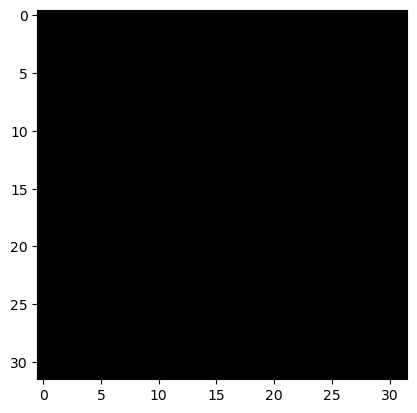

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 6
Predicted Label: 6


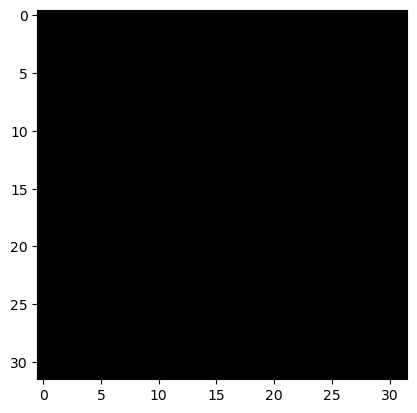

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


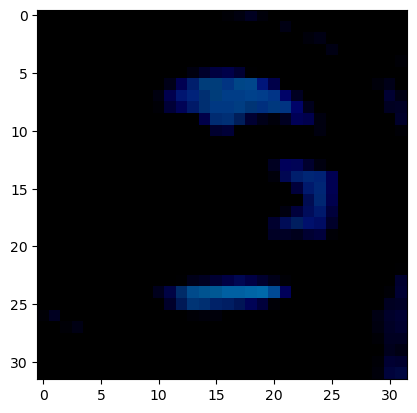

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


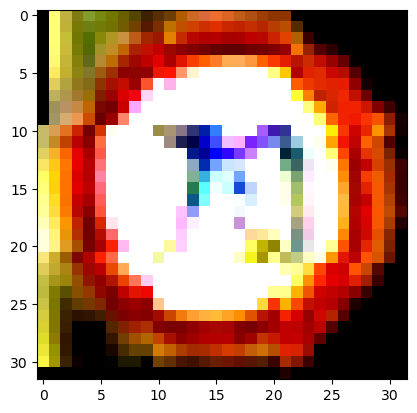

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


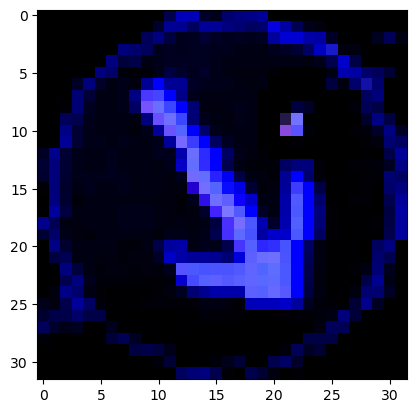

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 33
Predicted Label: 33


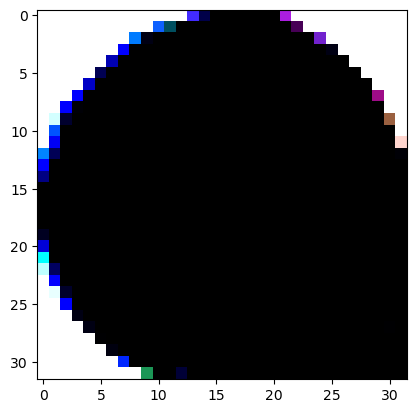

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


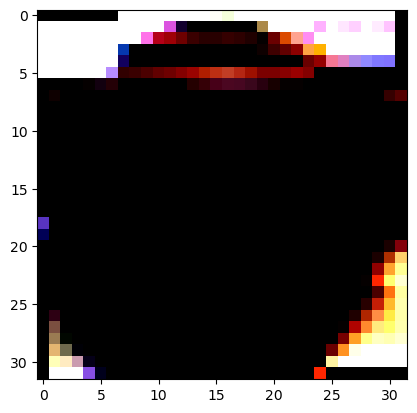

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


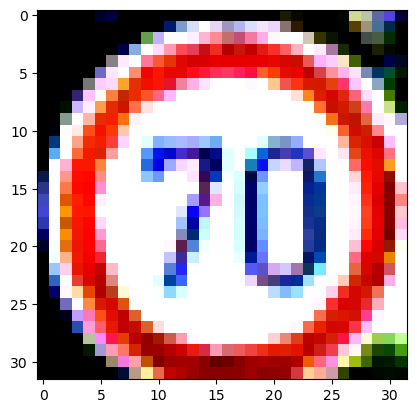

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


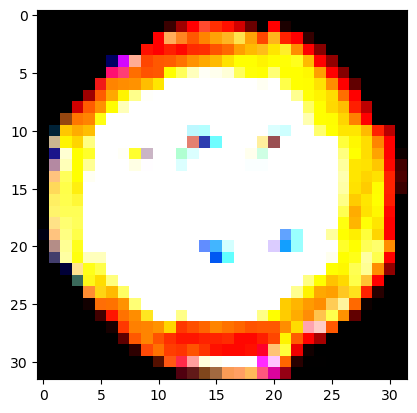

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


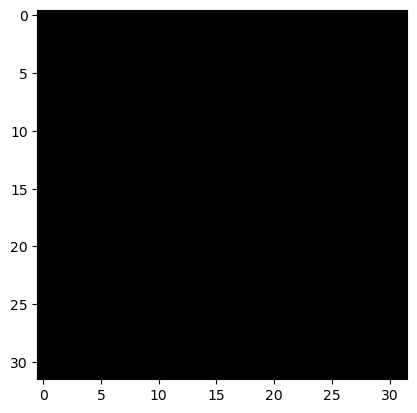

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 30
Predicted Label: 30


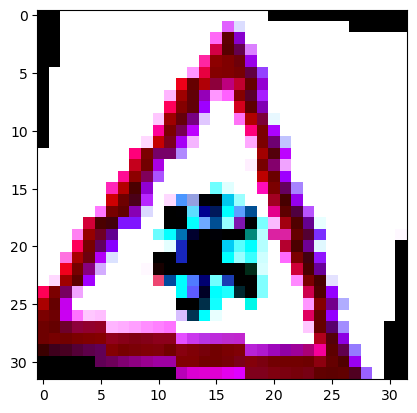

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


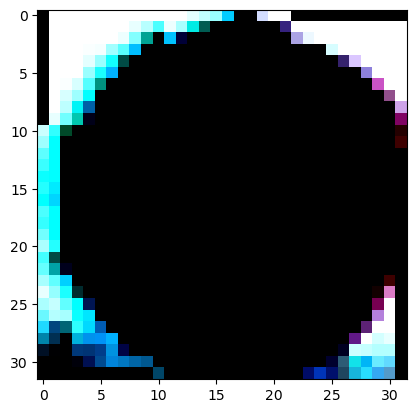

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


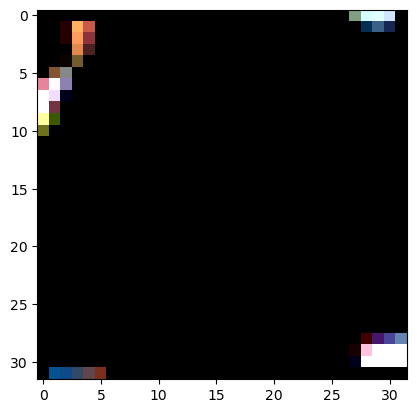

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


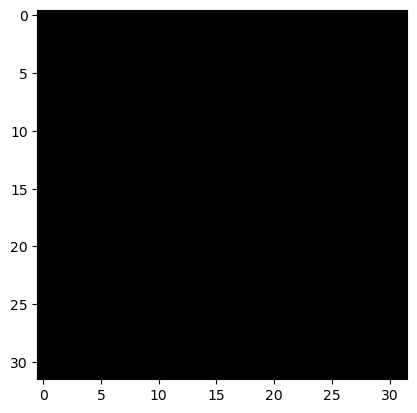

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


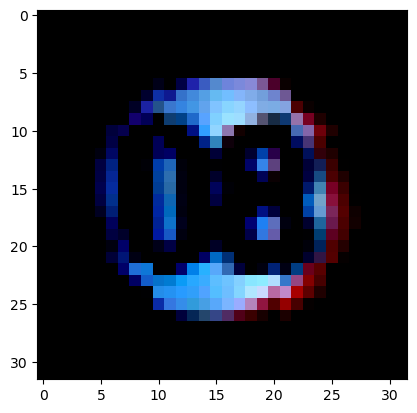

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


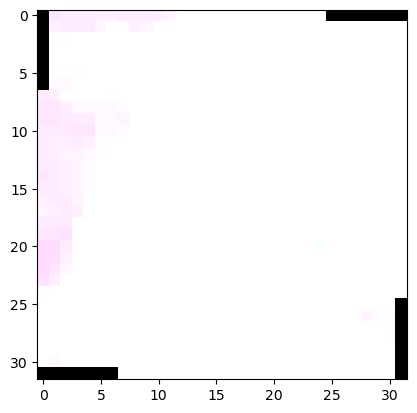

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


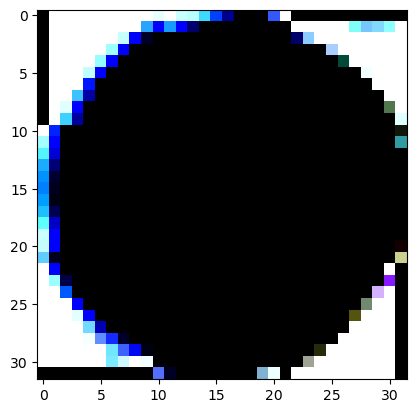

True Label: 13


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 13


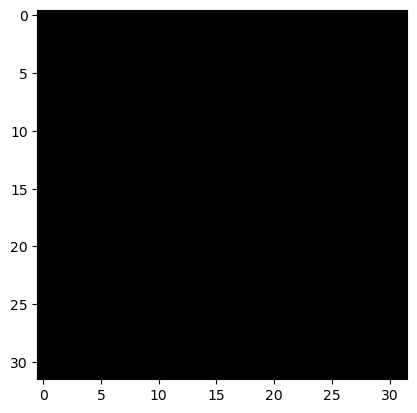

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


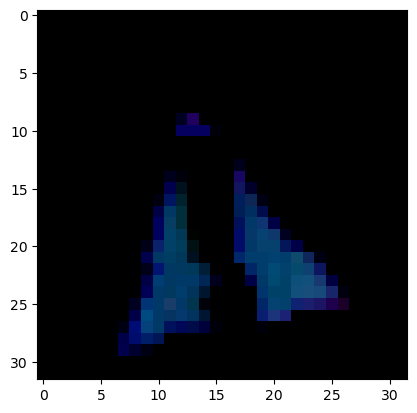

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


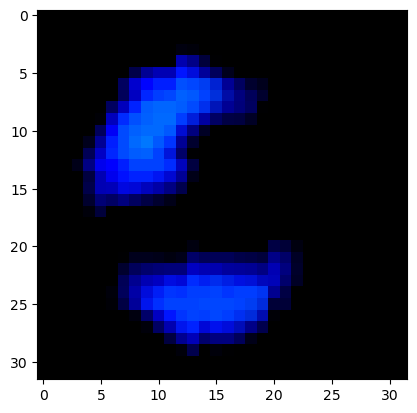

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


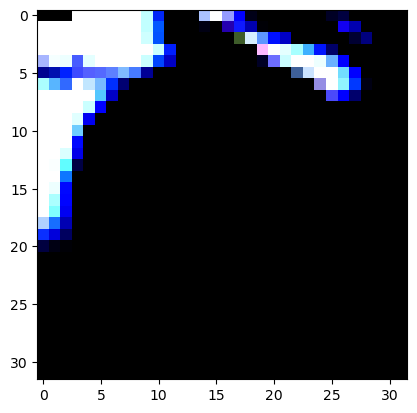

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


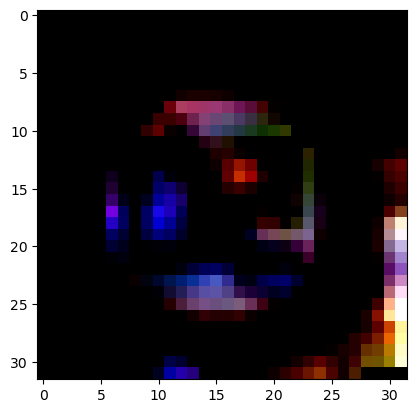

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


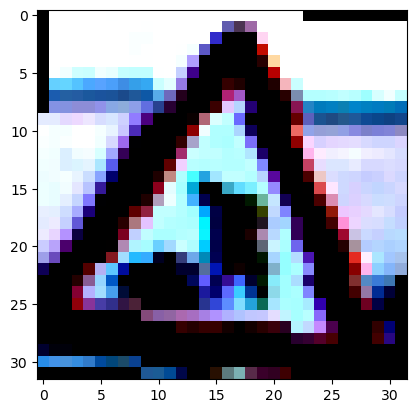

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


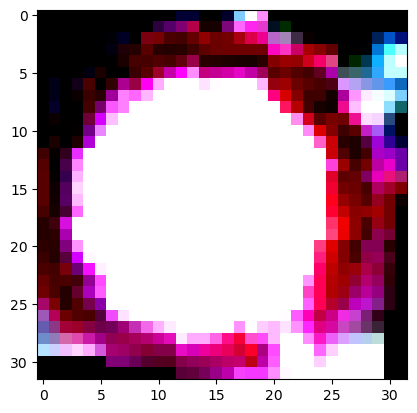

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 40
Predicted Label: 40


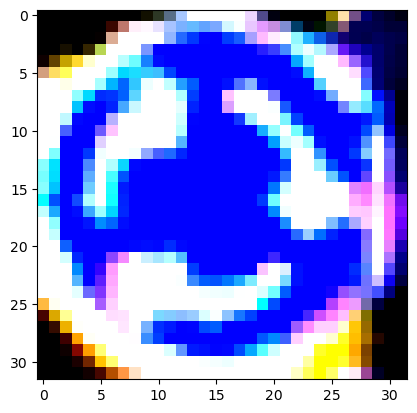

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


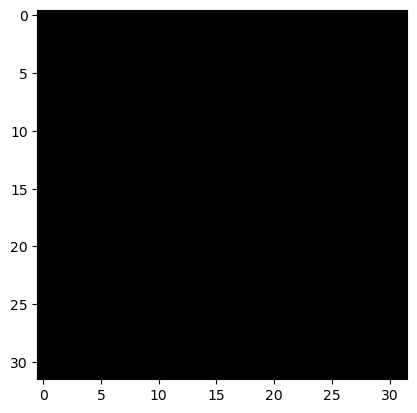

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 32
Predicted Label: 32


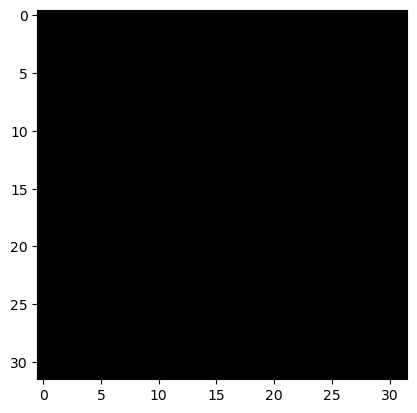

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


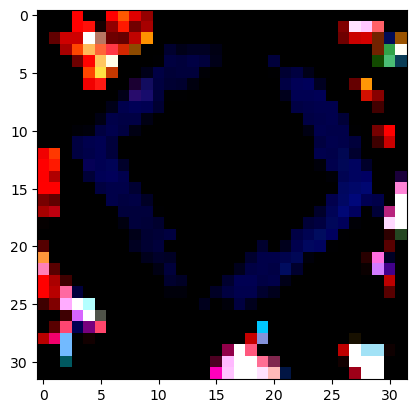

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


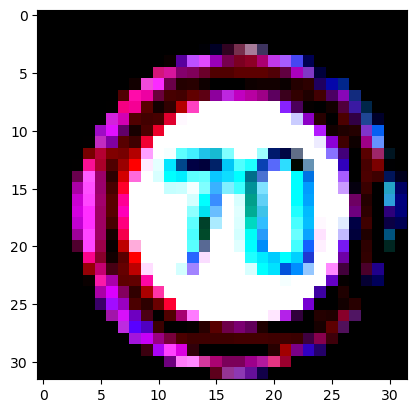

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


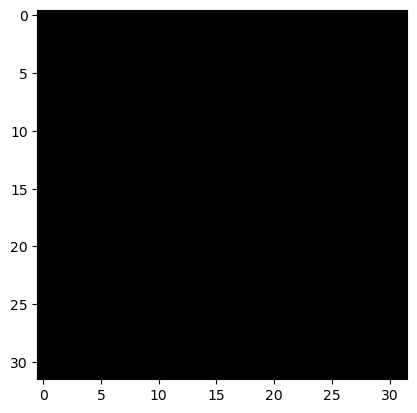

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 29
Predicted Label: 29


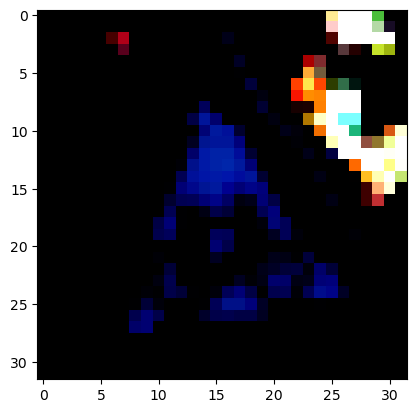

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


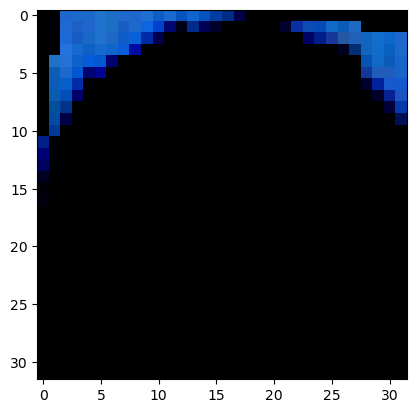

True Label: 7


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 7


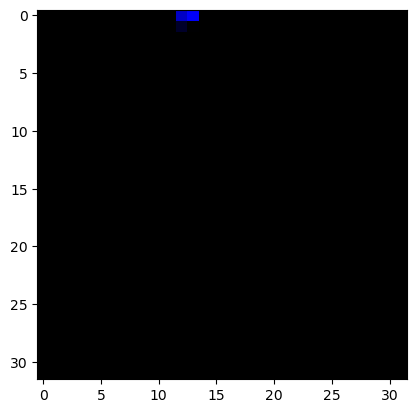

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


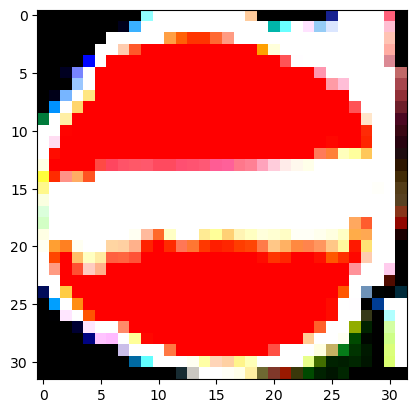

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


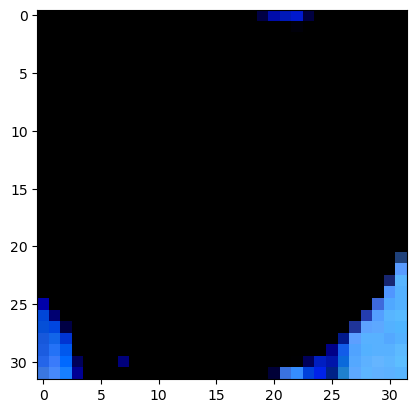

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


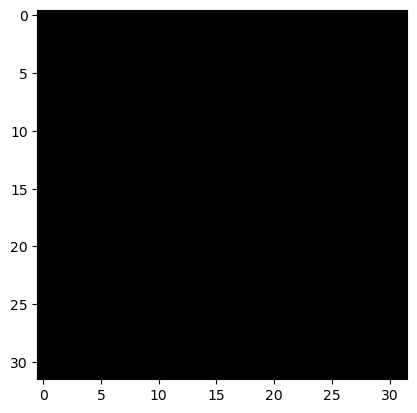

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


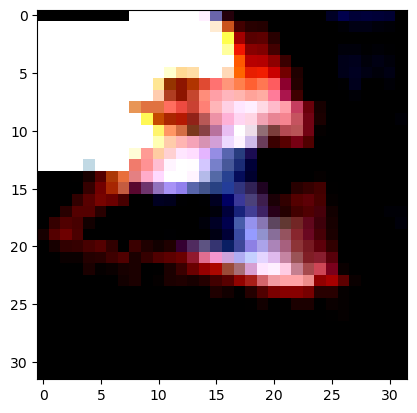

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 28
Predicted Label: 28


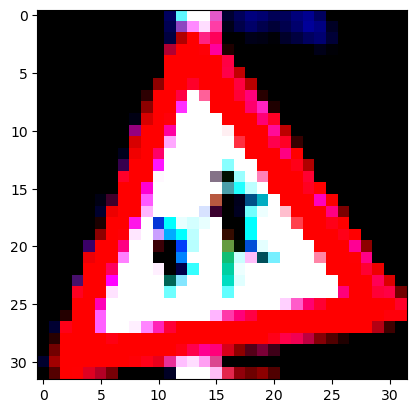

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


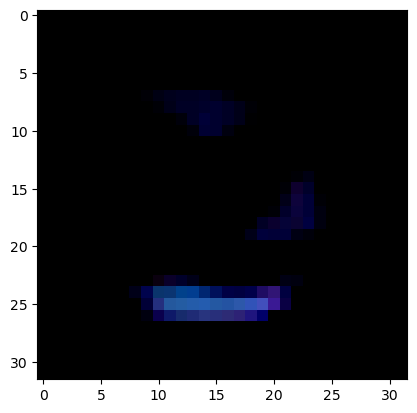

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


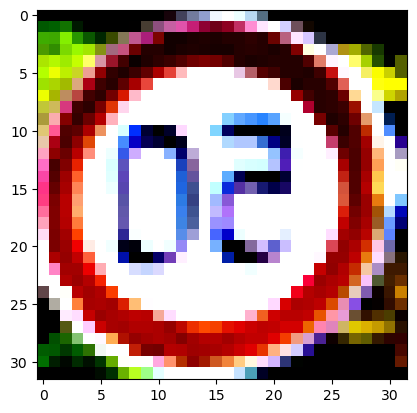

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


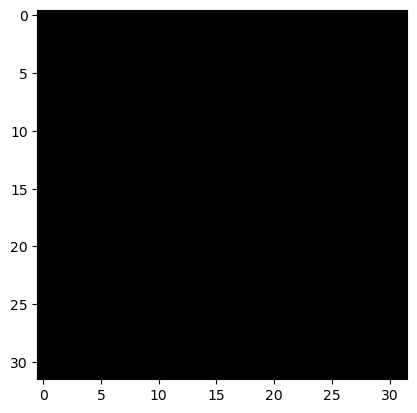

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


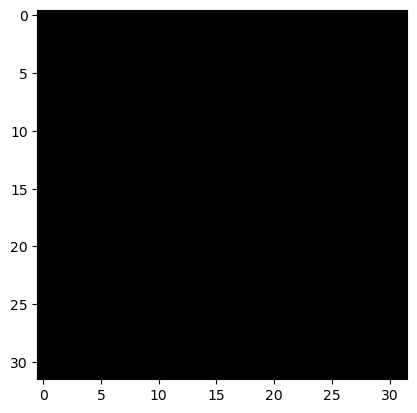

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 21
Predicted Label: 21


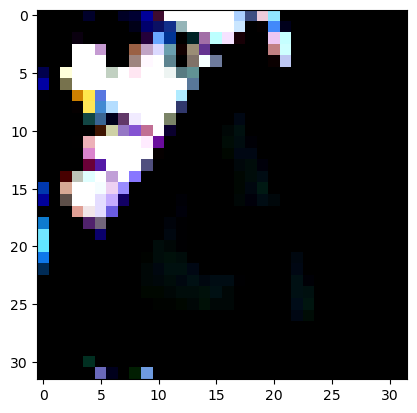

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


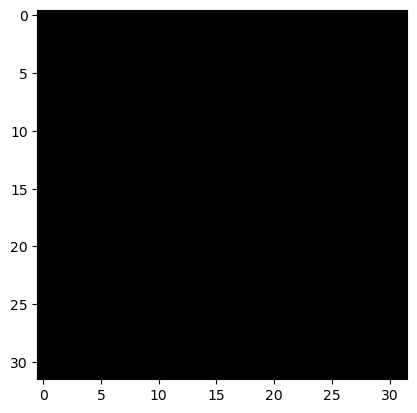

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


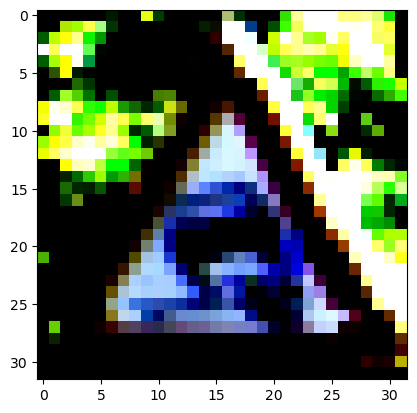

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 21
Predicted Label: 21


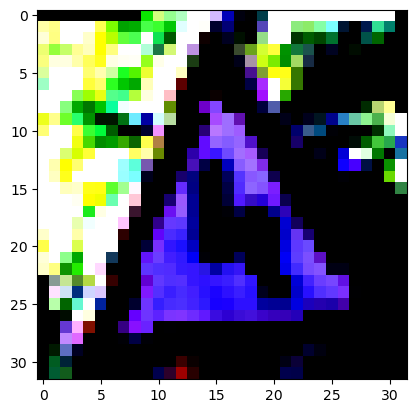

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 20
Predicted Label: 20


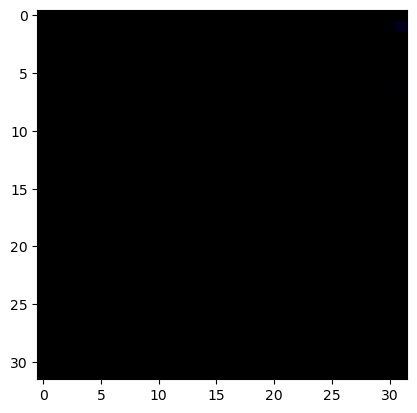

True Label: 3


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 3


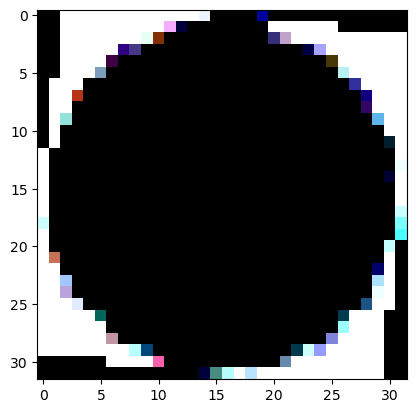

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


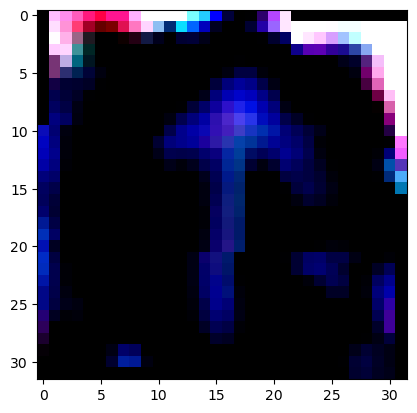

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


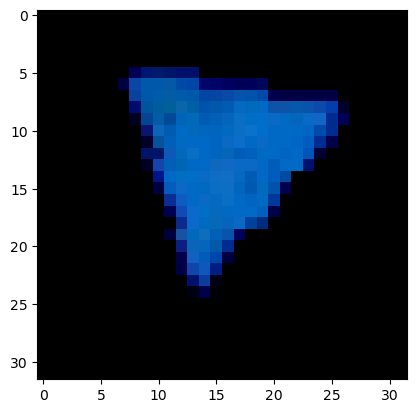

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


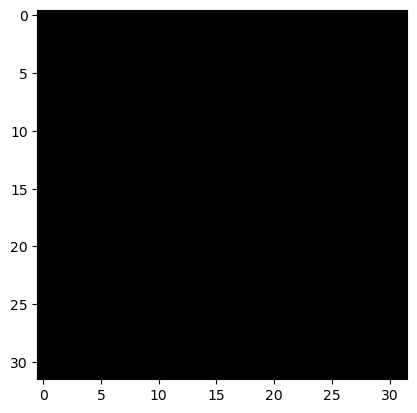

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


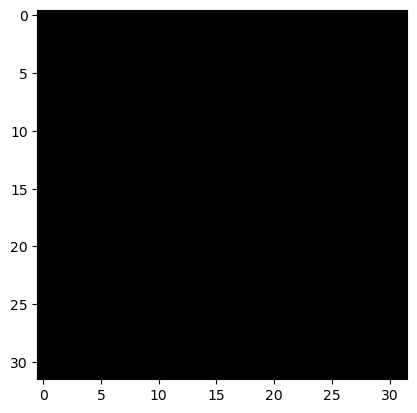

True Label: 17


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 17


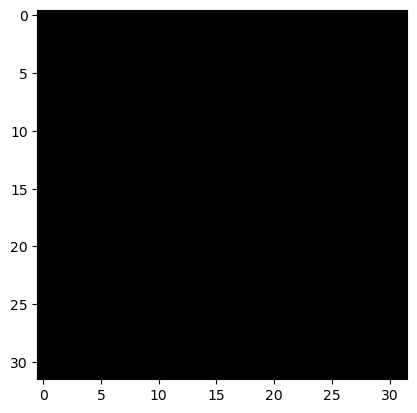

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 29
Predicted Label: 29


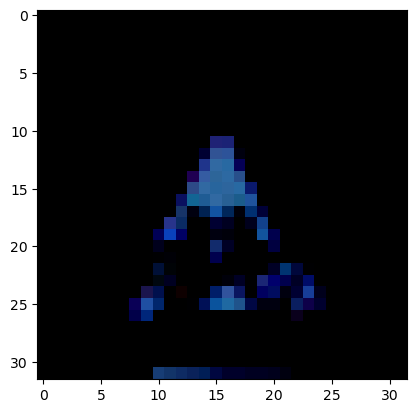

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 40
Predicted Label: 40


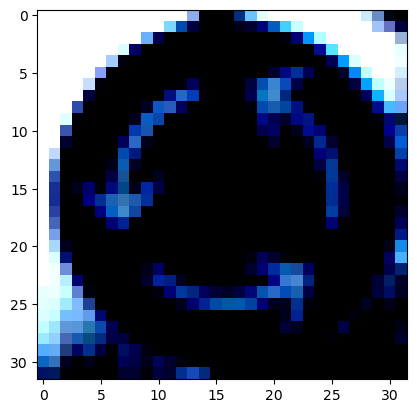

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


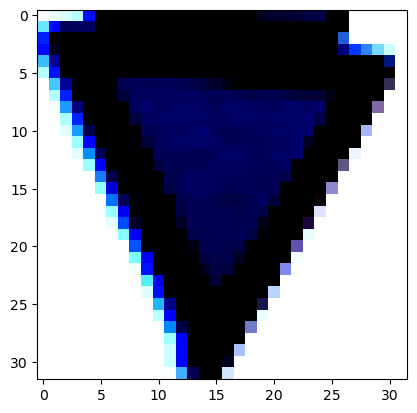

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 26
Predicted Label: 26


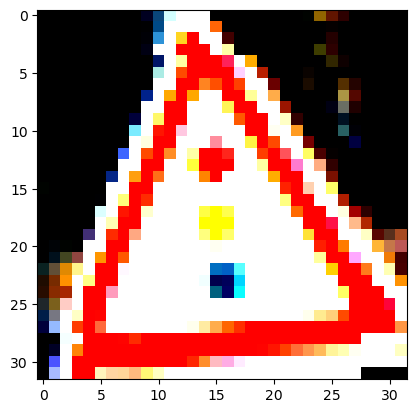

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


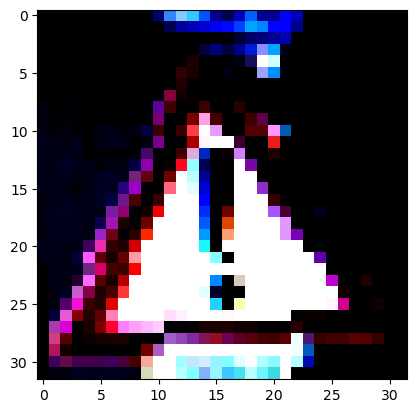

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


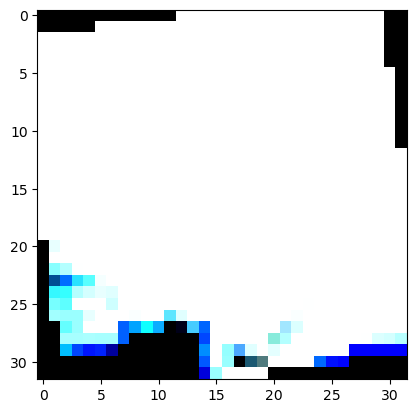

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


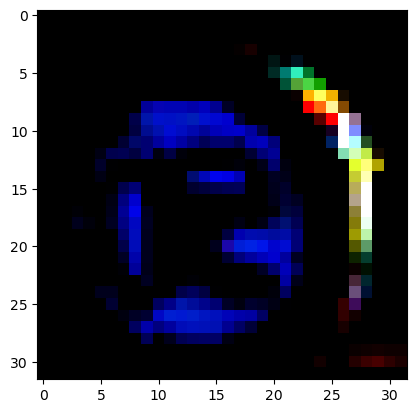

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


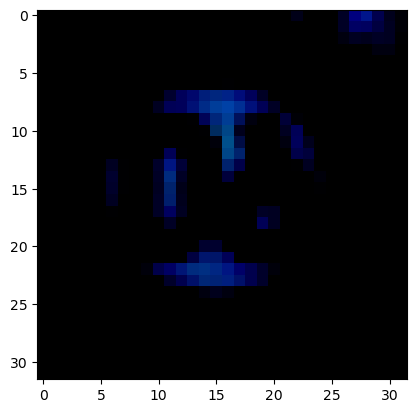

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


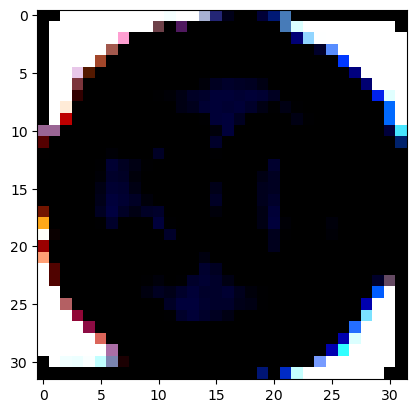

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 36
Predicted Label: 36


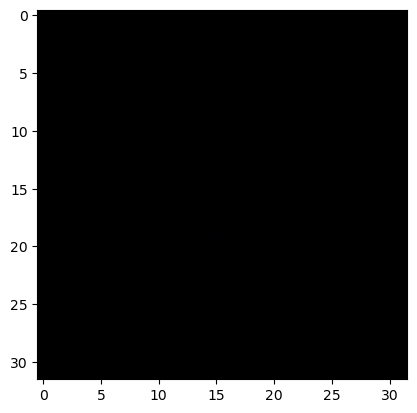

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


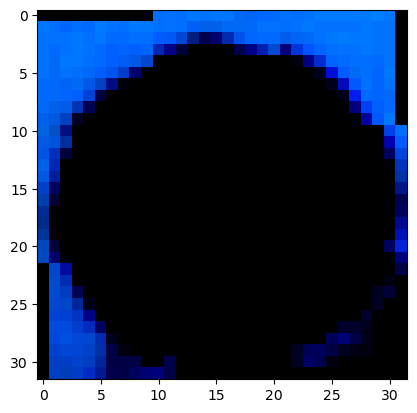

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 34
Predicted Label: 33


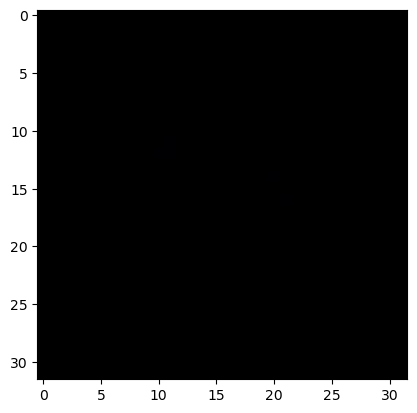

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 8


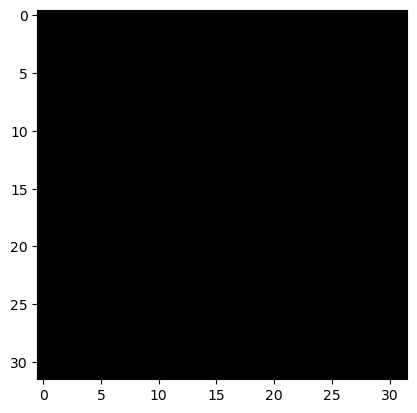

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


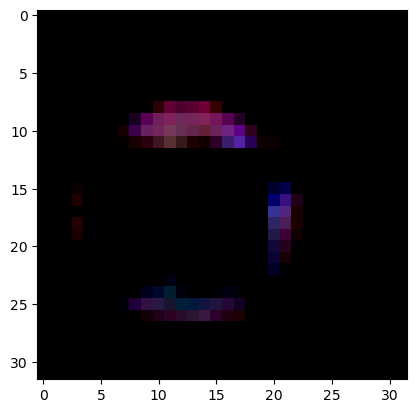

True Label: 5


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 5


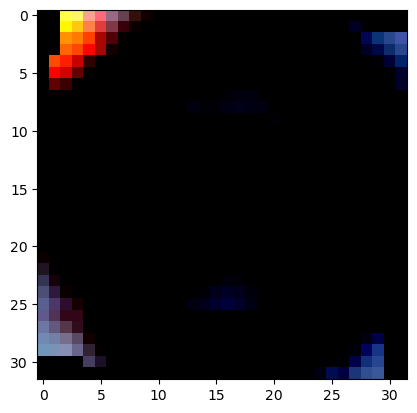

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


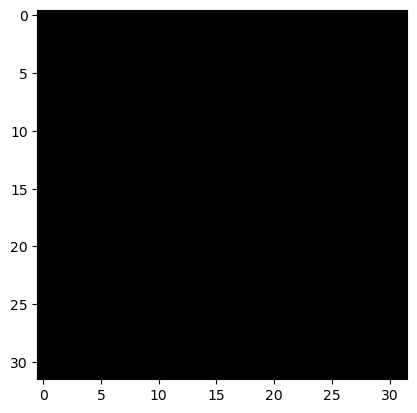

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 39
Predicted Label: 39


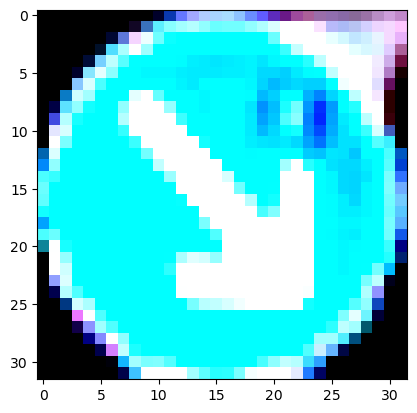

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 36
Predicted Label: 36


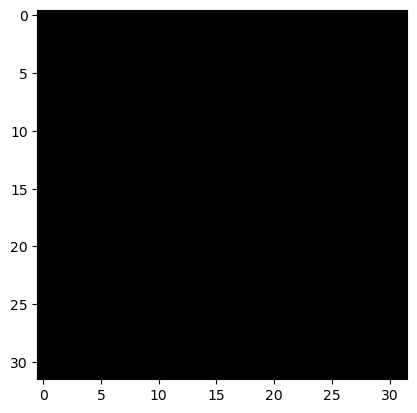

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


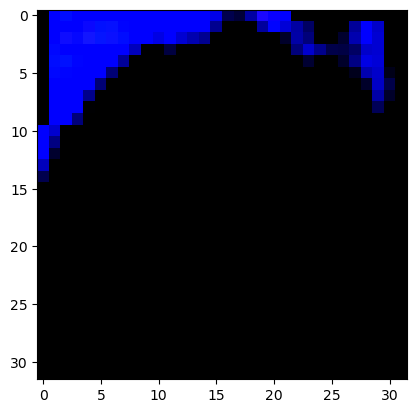

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


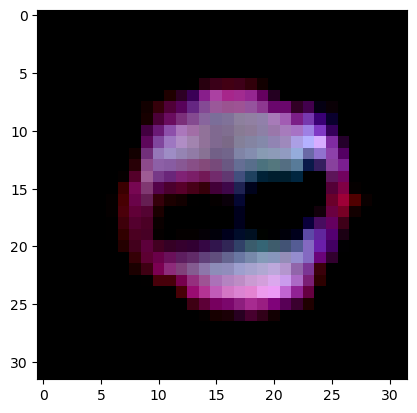

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


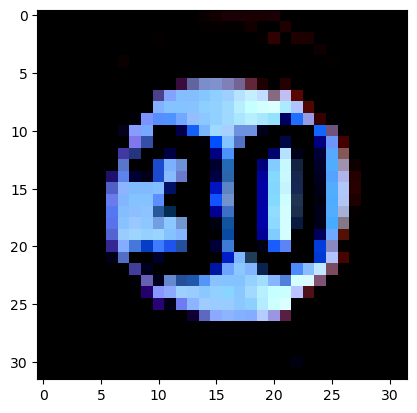

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 2


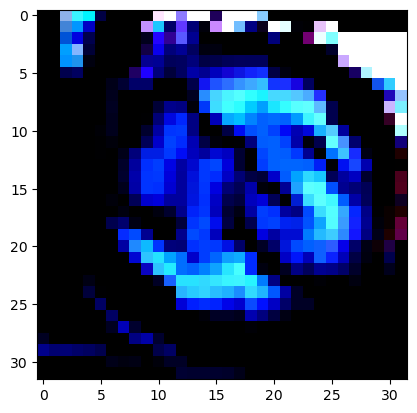

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 33
Predicted Label: 33


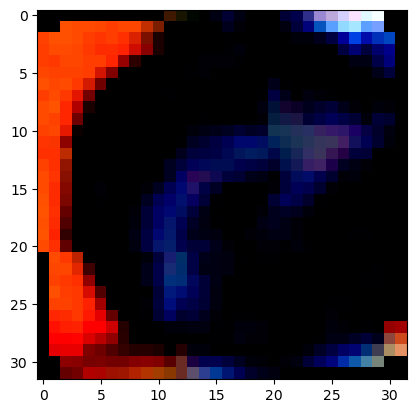

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


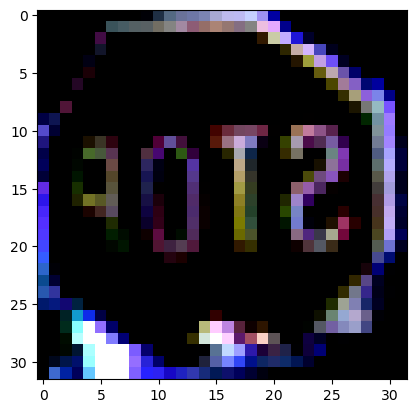

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


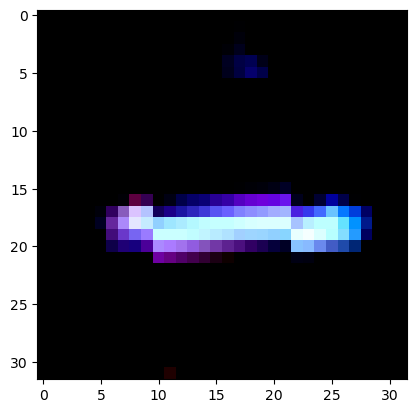

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


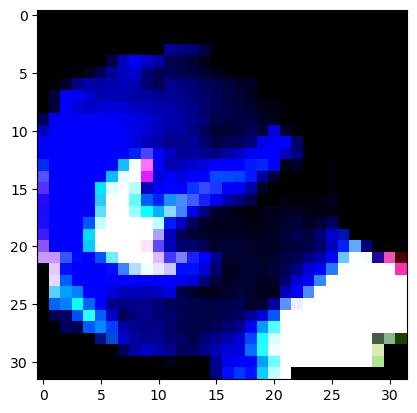

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


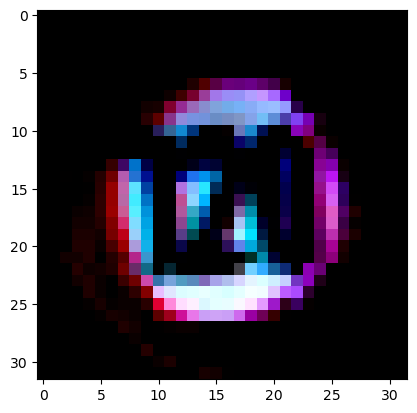

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


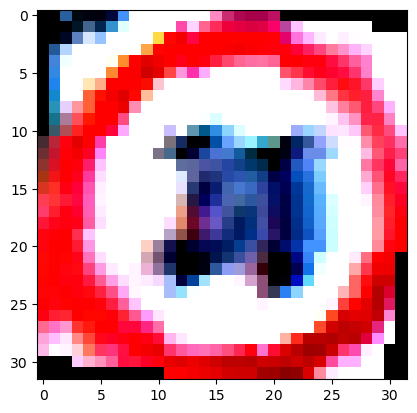

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


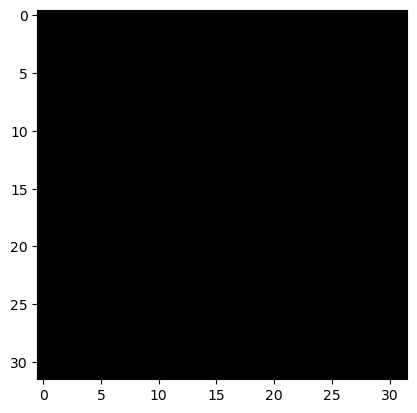

True Label: 3


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 3


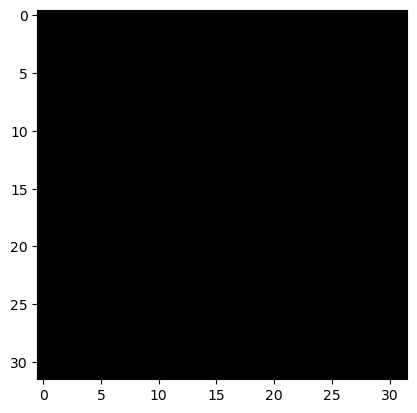

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 6
Predicted Label: 6


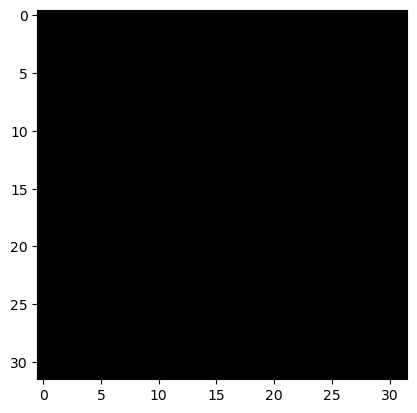

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


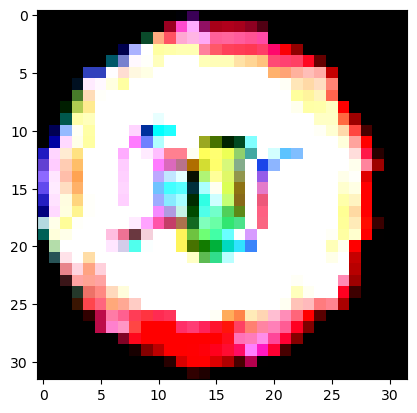

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


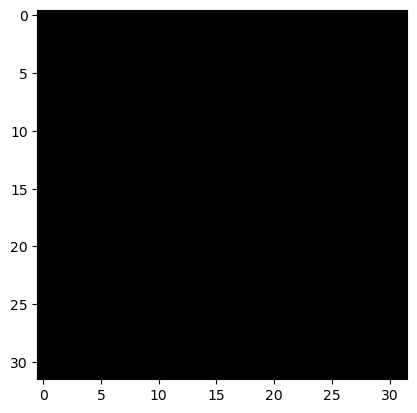

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


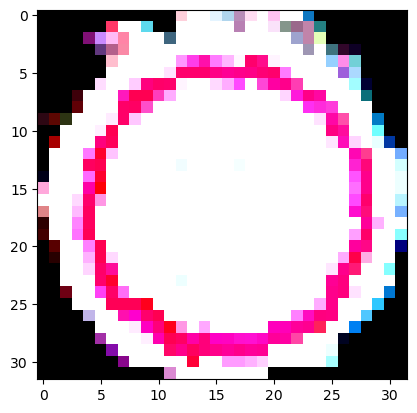

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


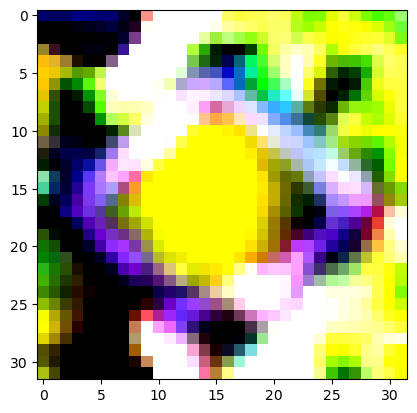

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


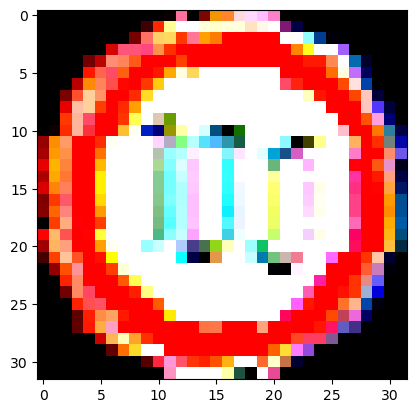

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


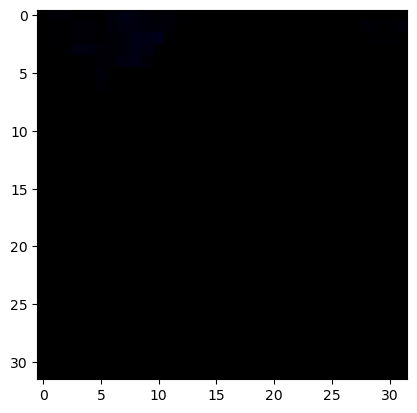

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


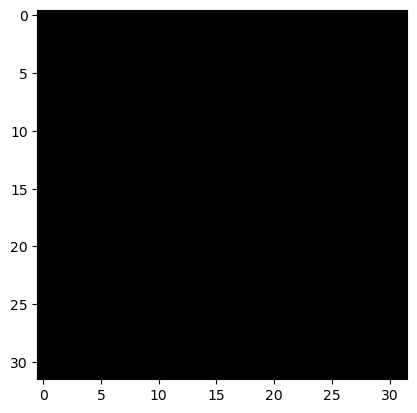

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


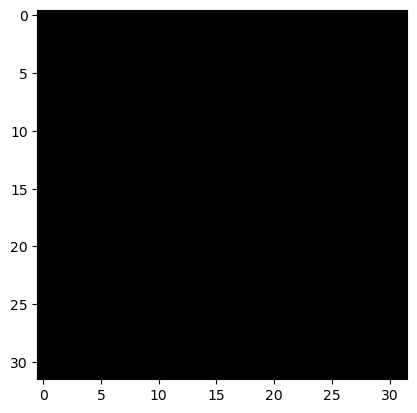

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


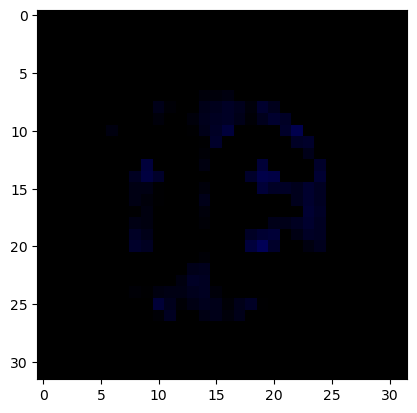

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


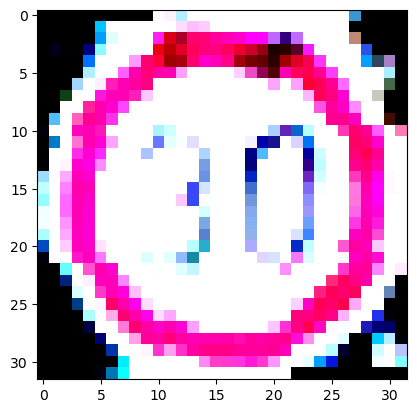

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


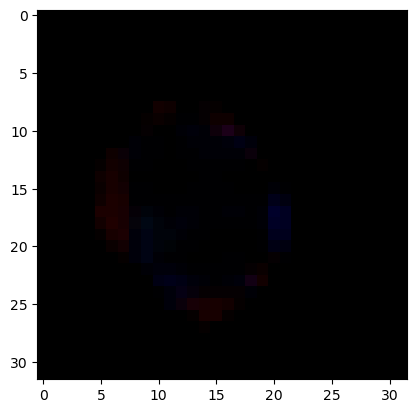

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 40
Predicted Label: 40


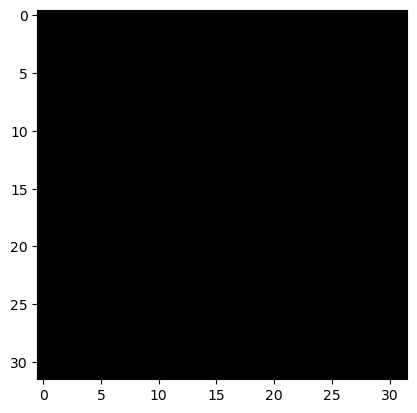

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 37
Predicted Label: 37


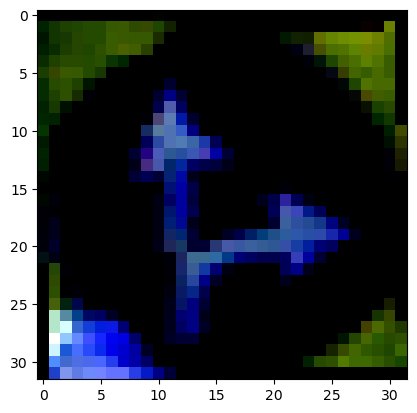

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


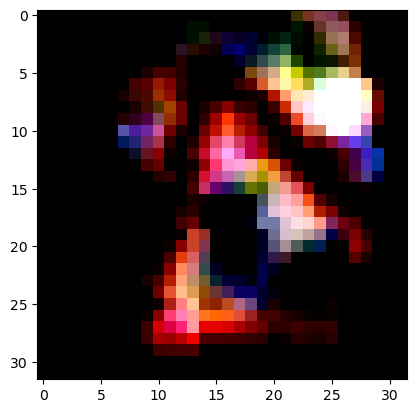

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


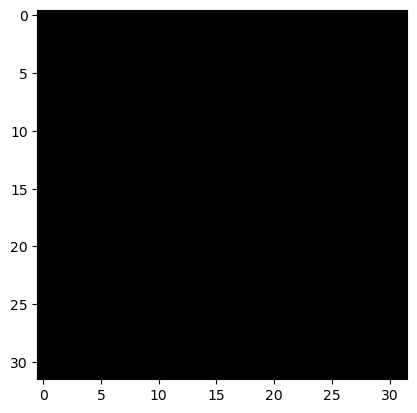

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


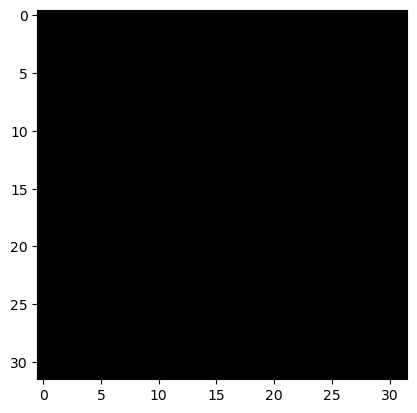

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 28
Predicted Label: 28


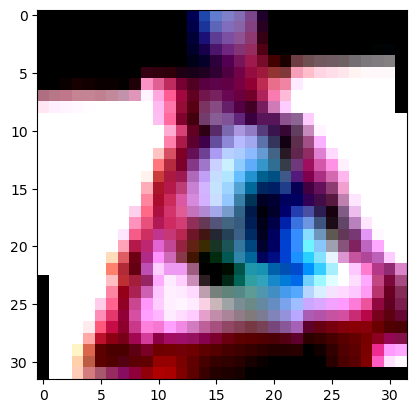

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 36
Predicted Label: 36


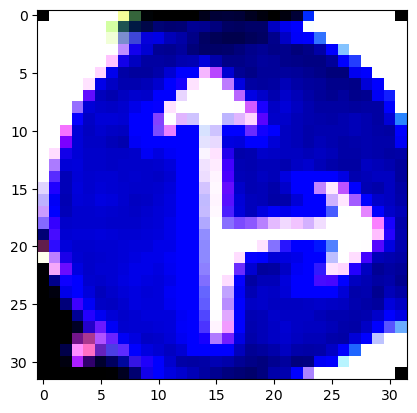

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


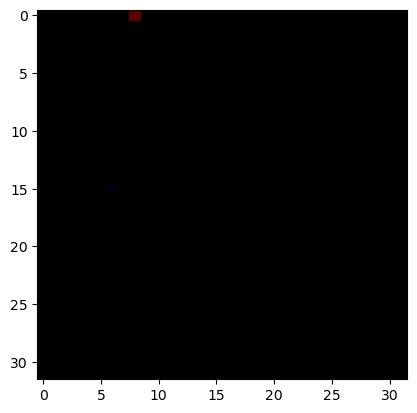

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 30
Predicted Label: 30


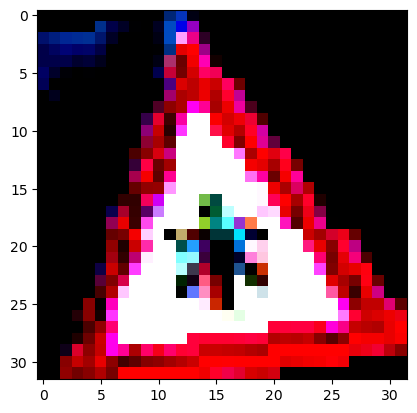

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


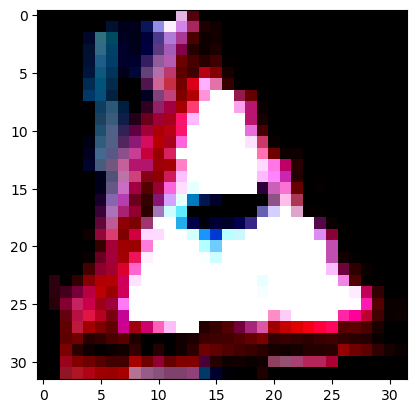

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 29
Predicted Label: 29


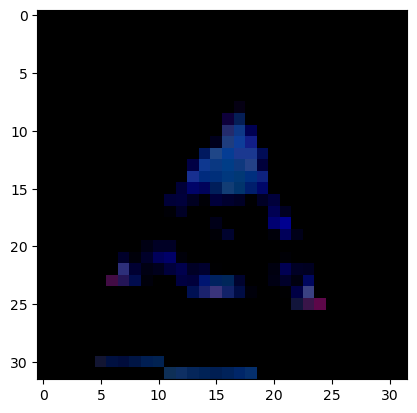

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


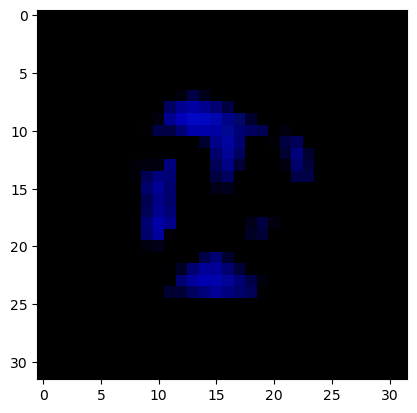

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


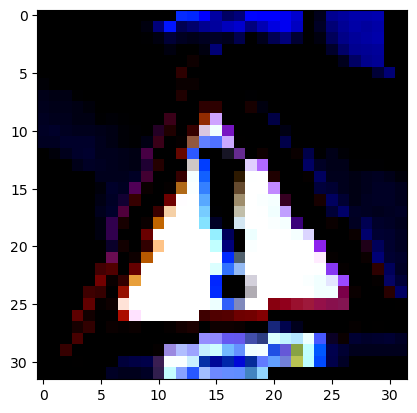

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


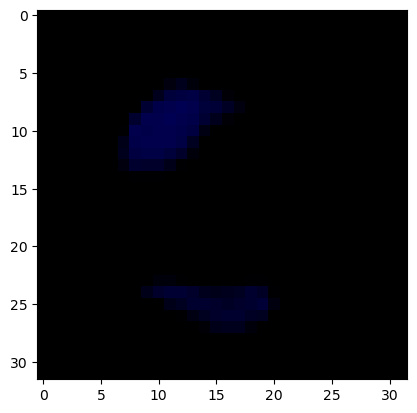

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 31
Predicted Label: 31


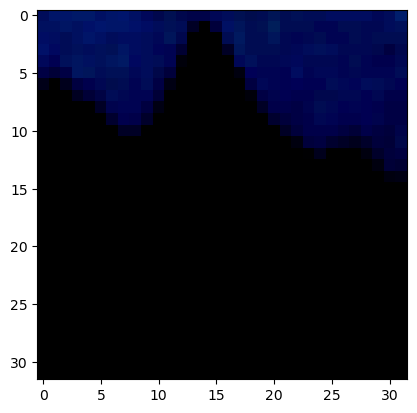

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


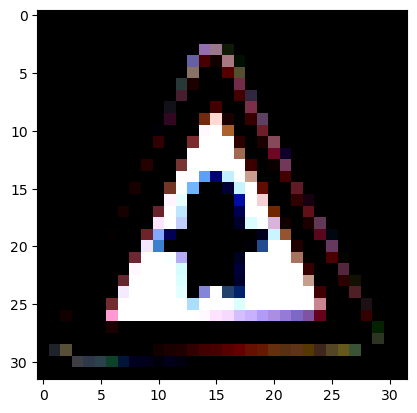

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


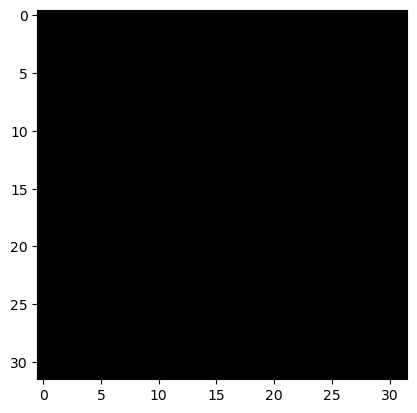

True Label: 11


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 11


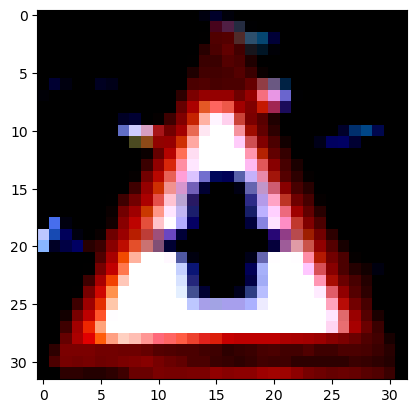

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


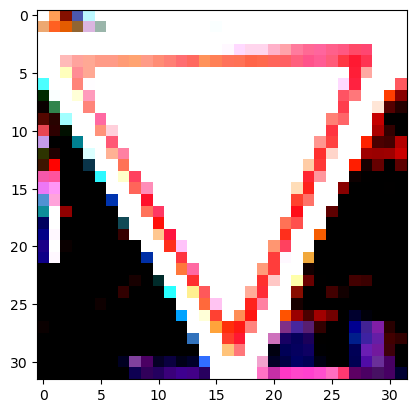

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


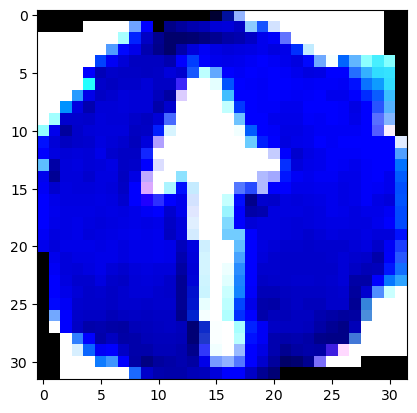

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


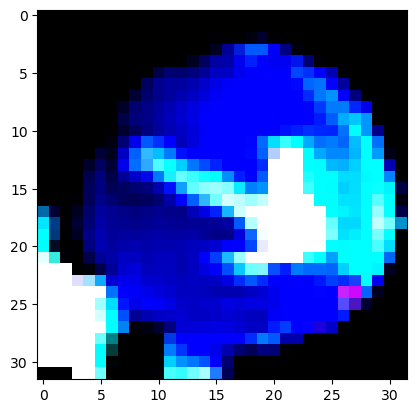

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


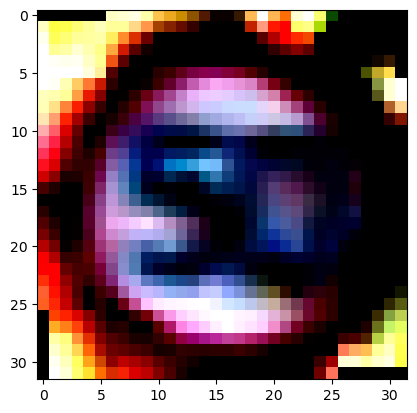

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


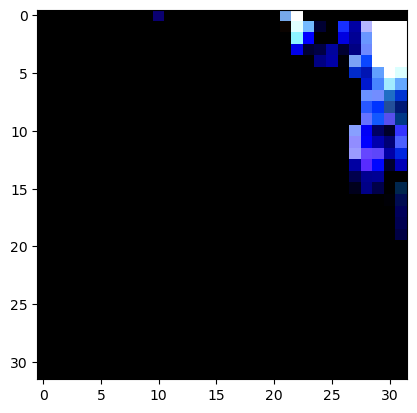

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


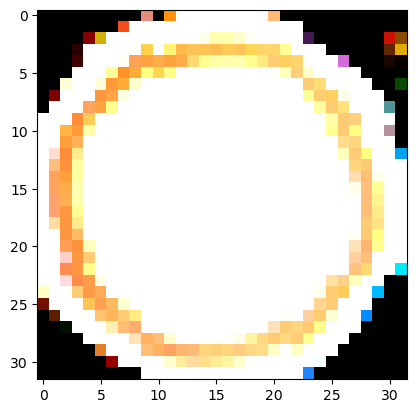

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


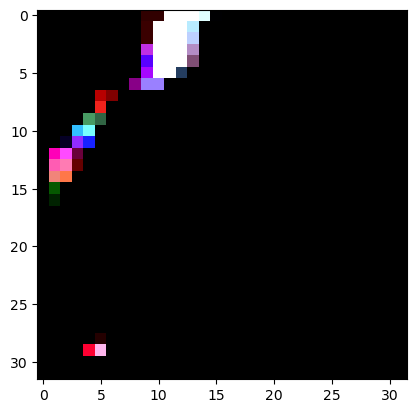

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


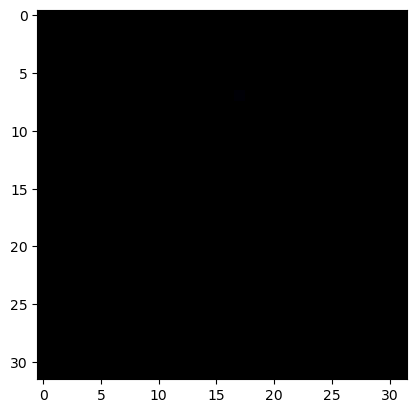

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


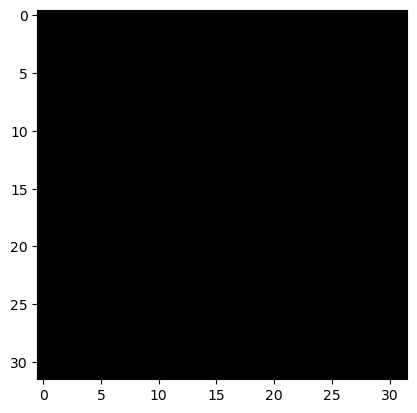

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


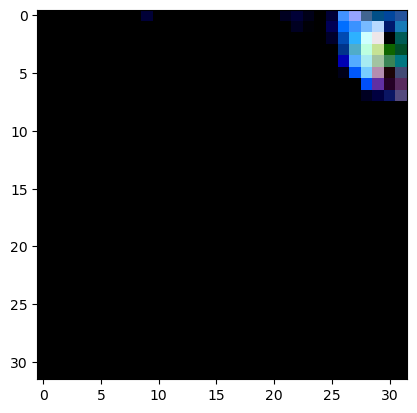

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


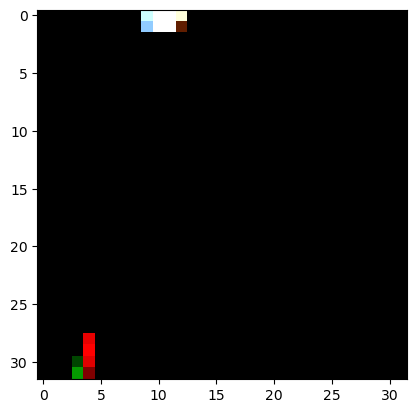

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


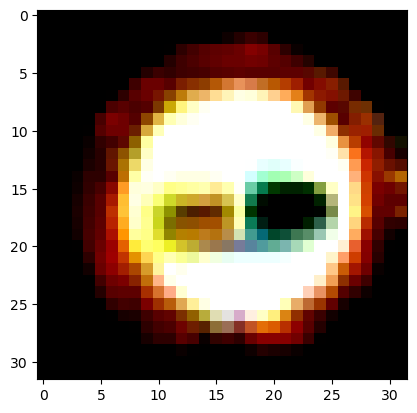

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


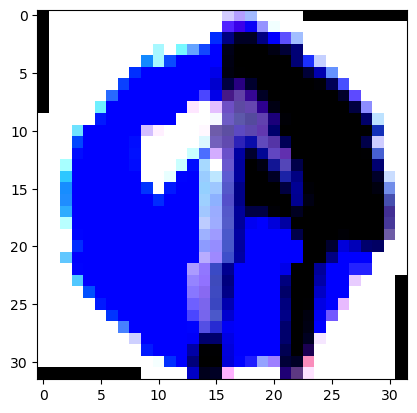

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


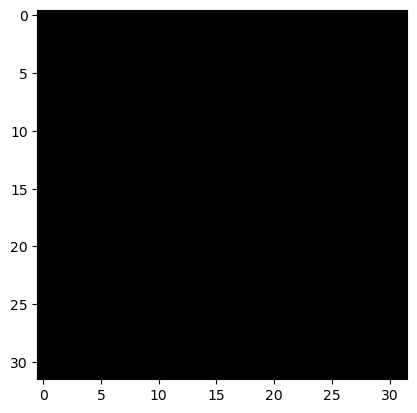

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


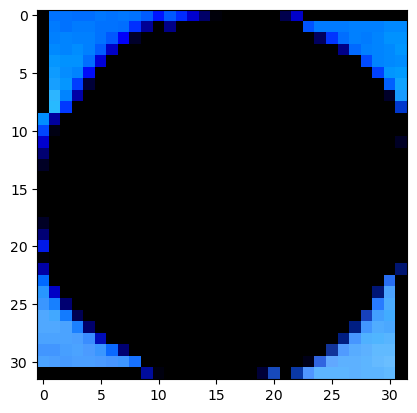

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


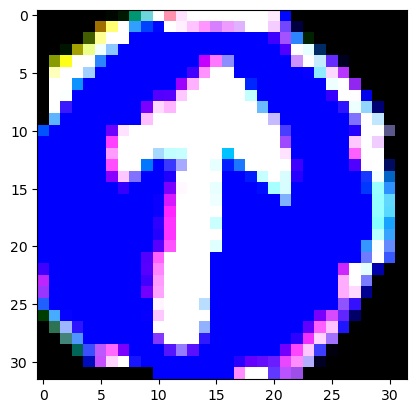

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


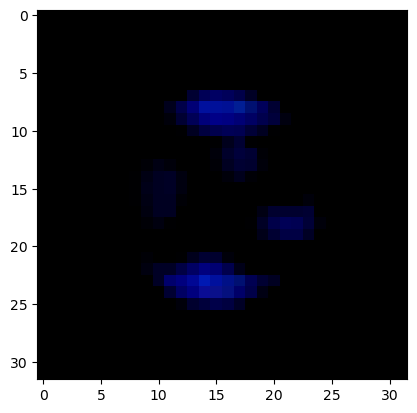

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 6
Predicted Label: 6


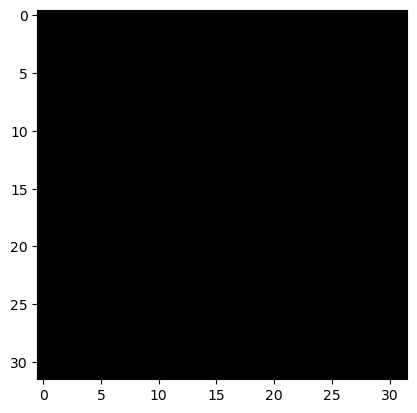

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


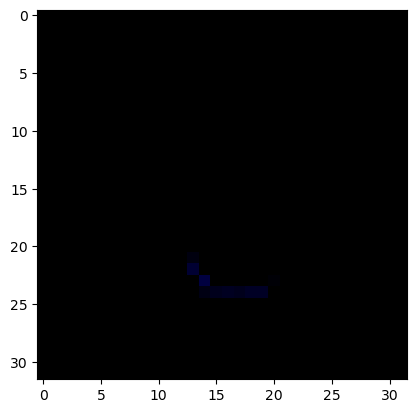

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 18
Predicted Label: 18


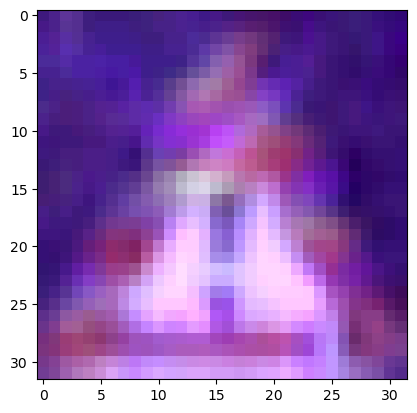

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


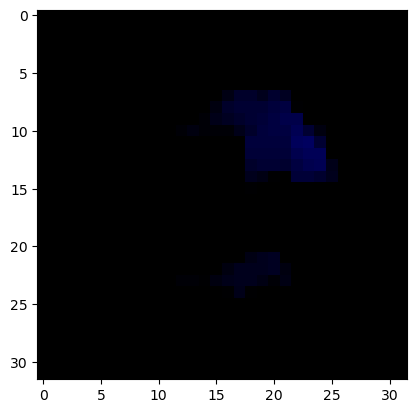

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


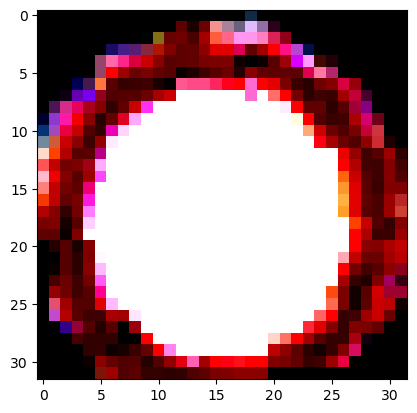

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


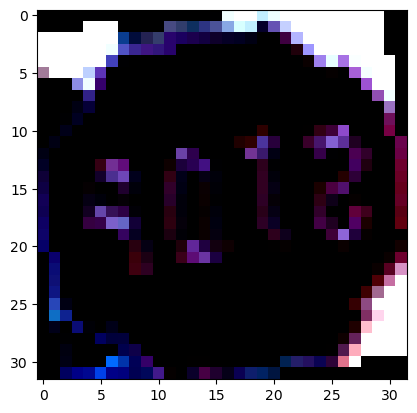

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


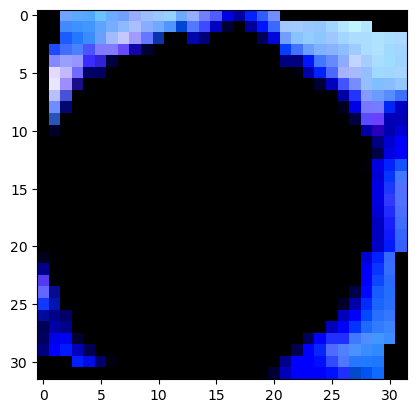

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


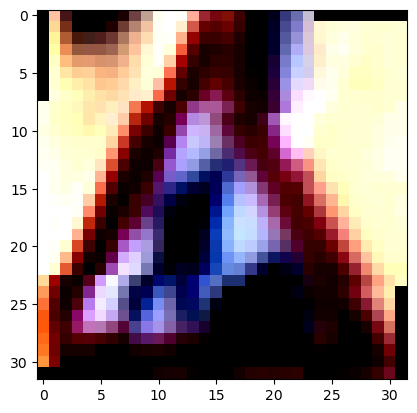

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


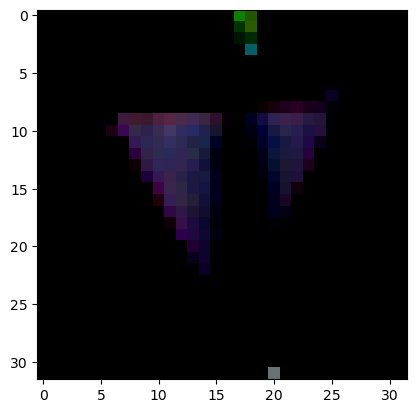

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


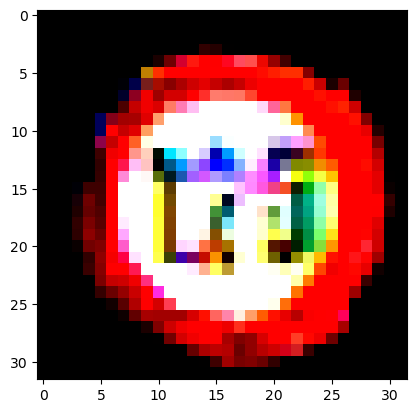

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 14
Predicted Label: 14


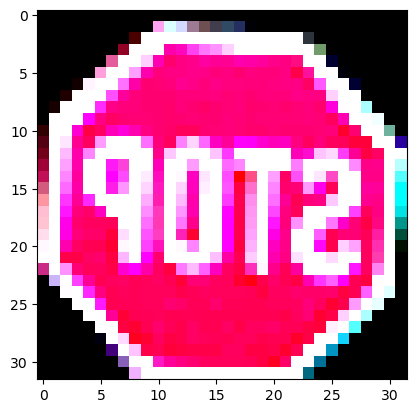

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


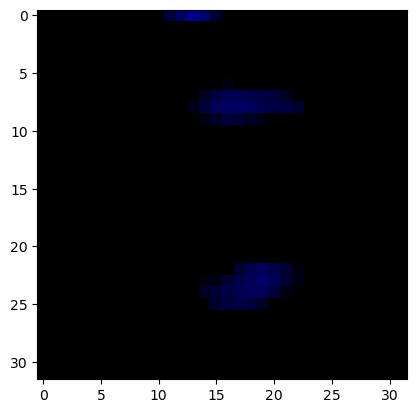

True Label: 25


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 25


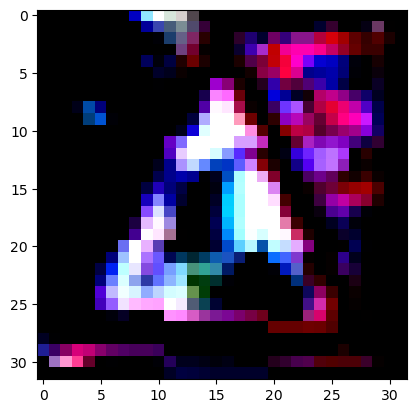

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


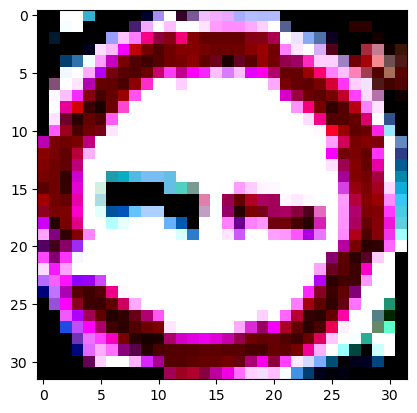

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


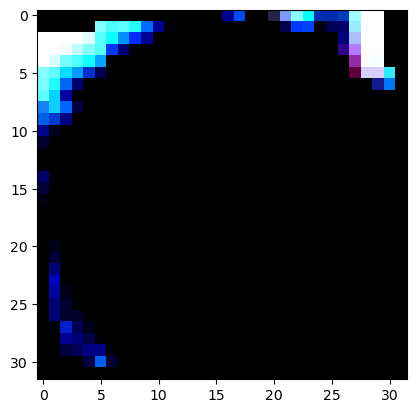

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 12
Predicted Label: 12


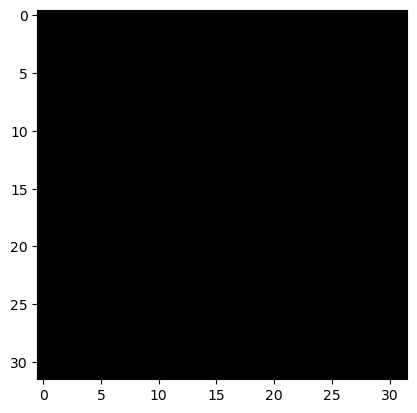

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


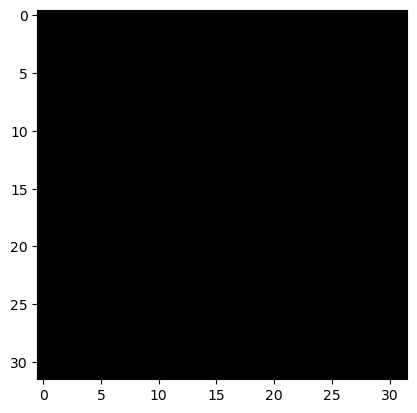

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


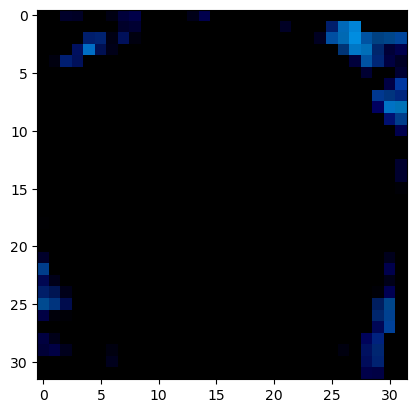

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 20
Predicted Label: 20


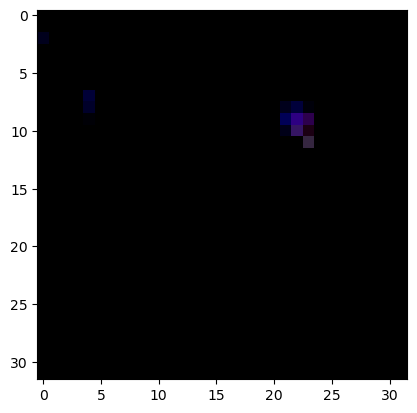

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 23


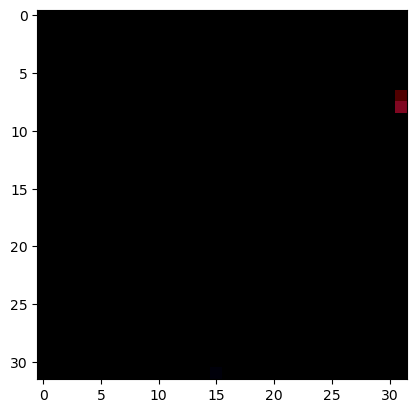

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


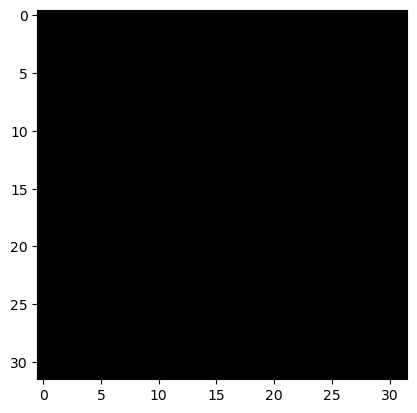

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


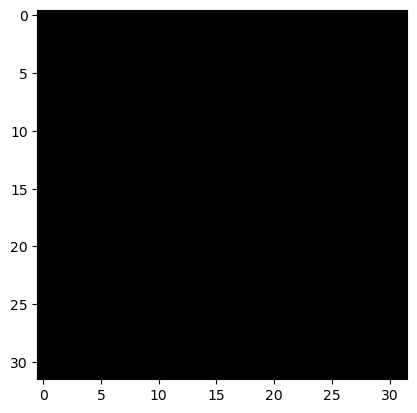

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


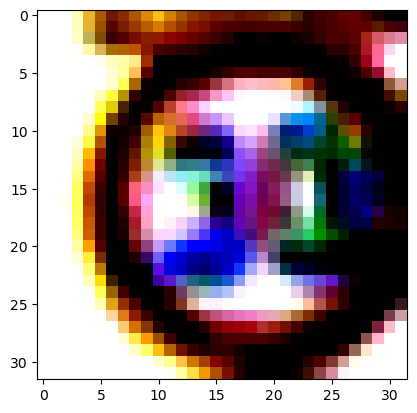

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 22
Predicted Label: 22


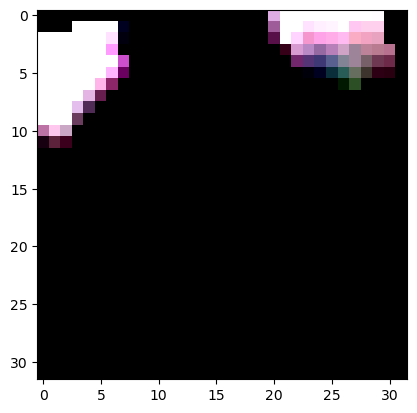

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 31
Predicted Label: 31


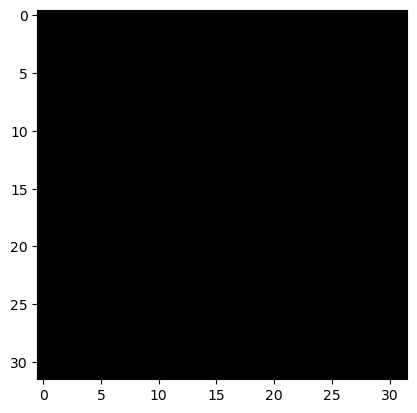

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


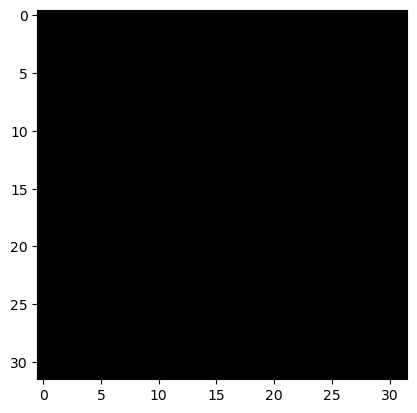

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


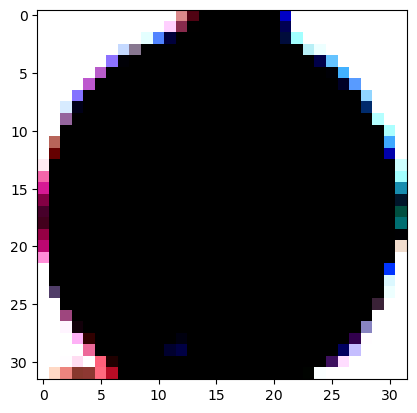

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 8


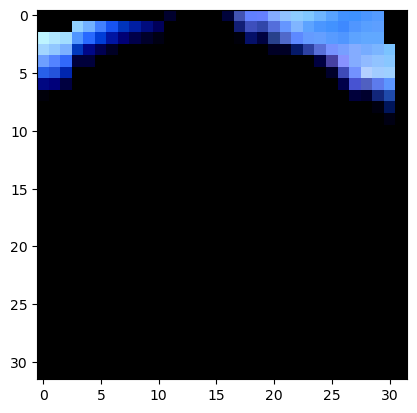

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 15
Predicted Label: 15


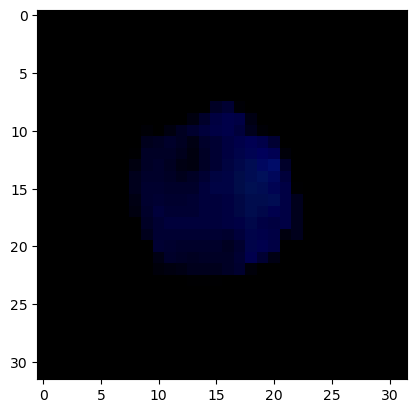

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


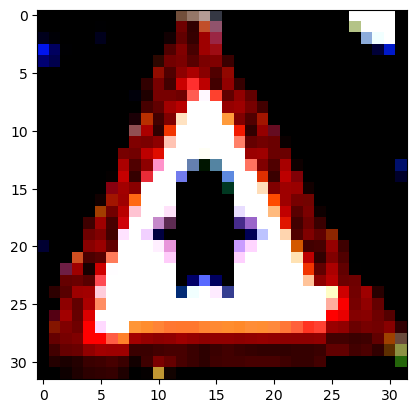

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


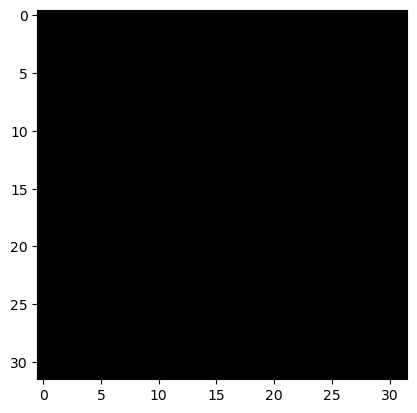

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


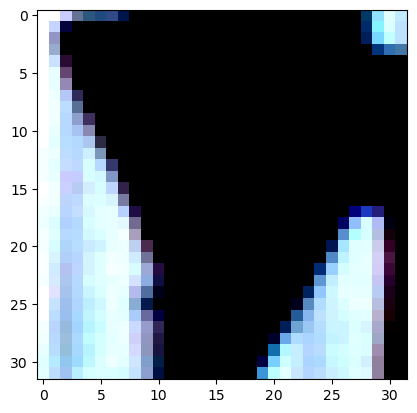

True Label: 25


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 25


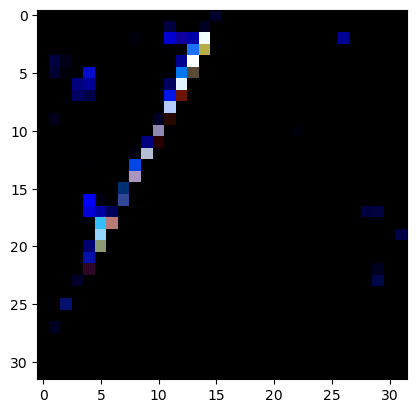

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


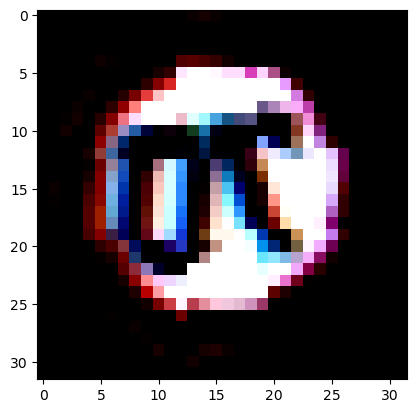

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


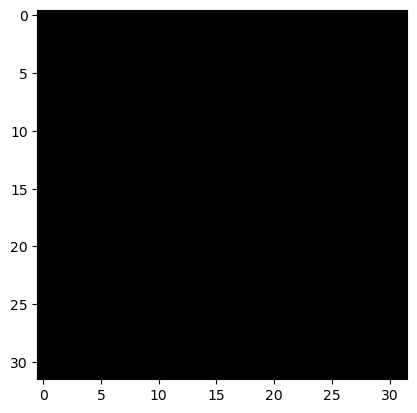

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


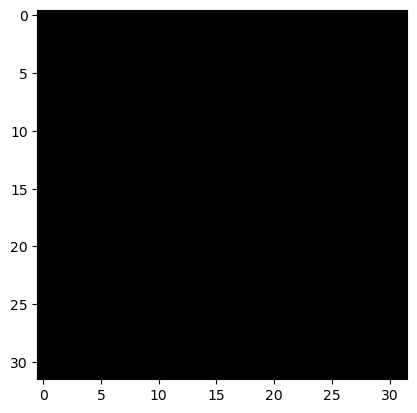

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


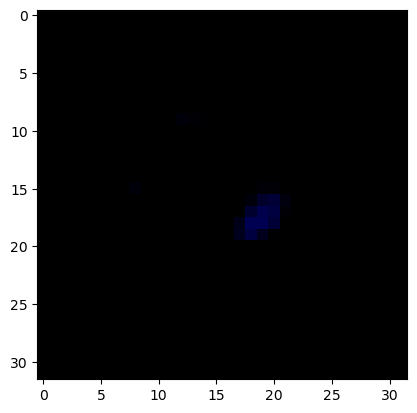

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 17
Predicted Label: 17


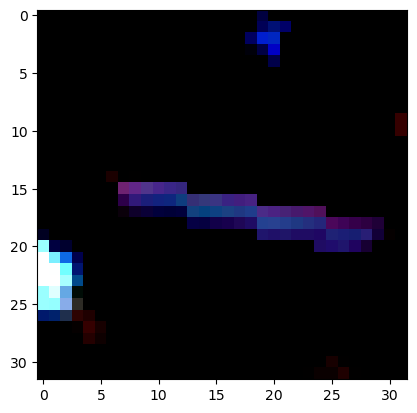

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


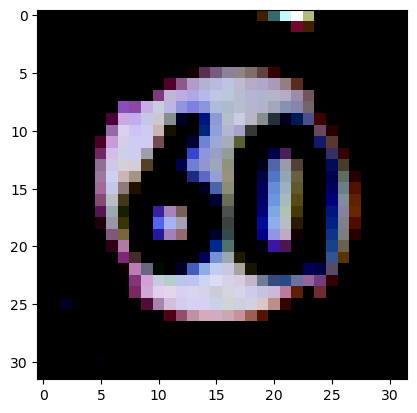

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


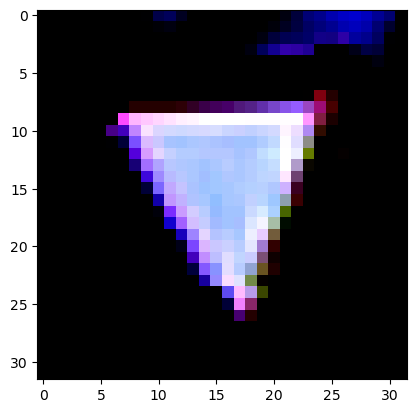

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


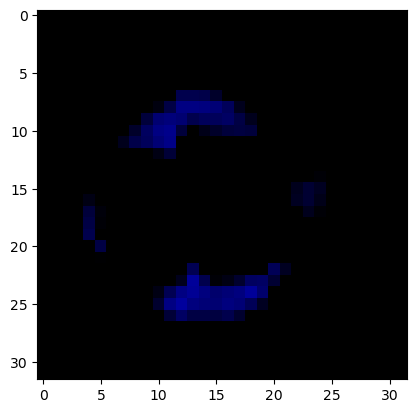

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


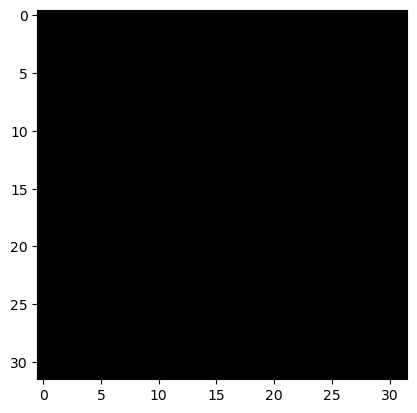

True Label: 2


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 2


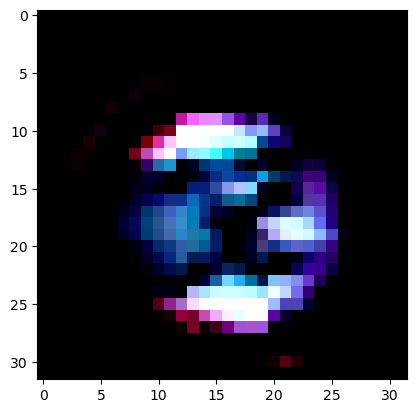

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


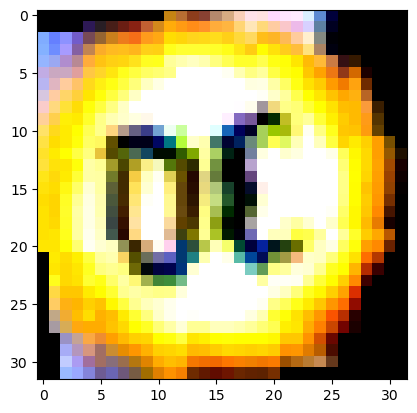

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


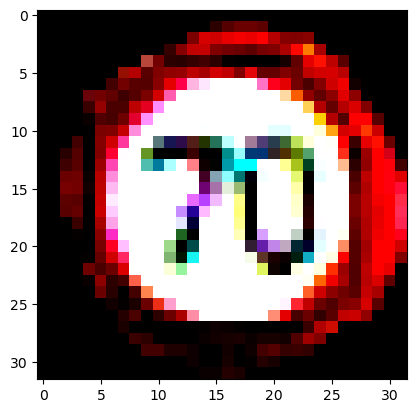

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 35
Predicted Label: 35


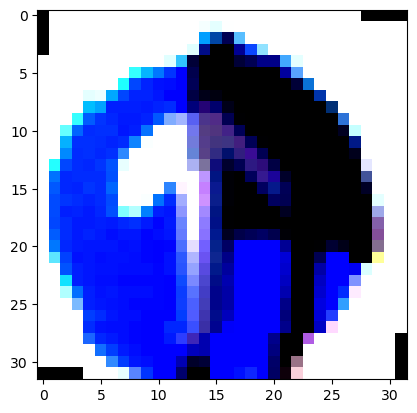

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 3
Predicted Label: 3


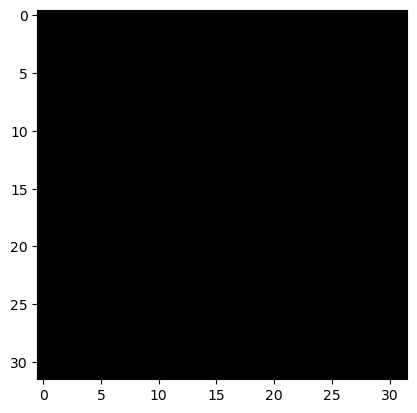

True Label: 25


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 25


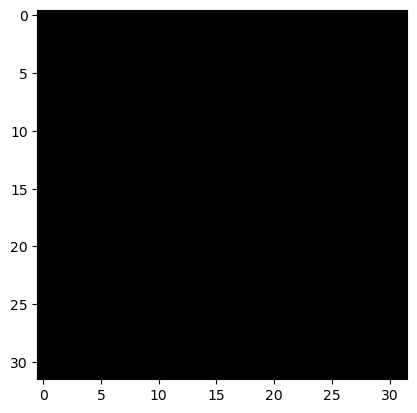

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 5
Predicted Label: 5


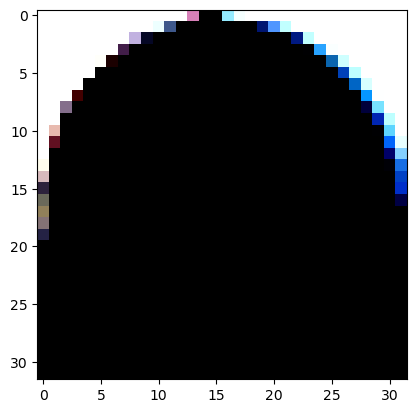

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


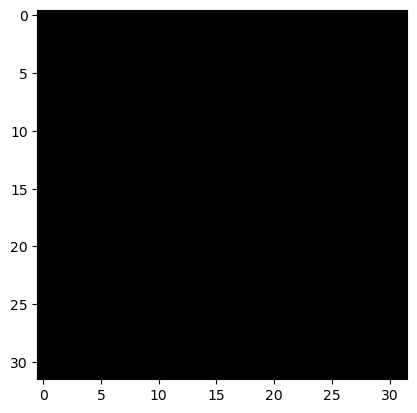

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


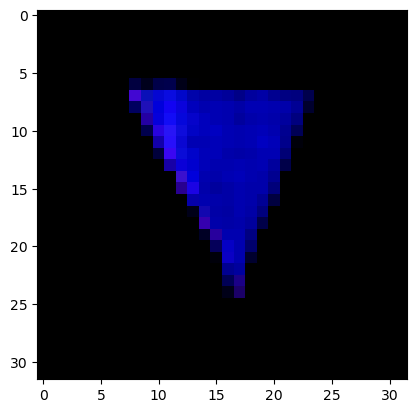

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 26
Predicted Label: 26


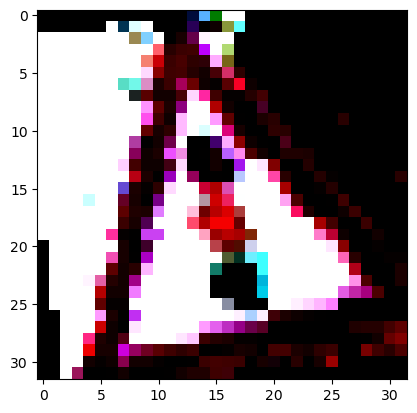

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 11
Predicted Label: 11


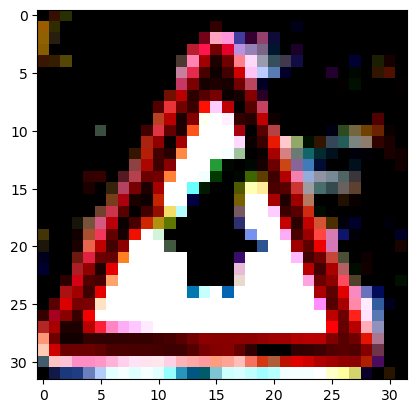

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


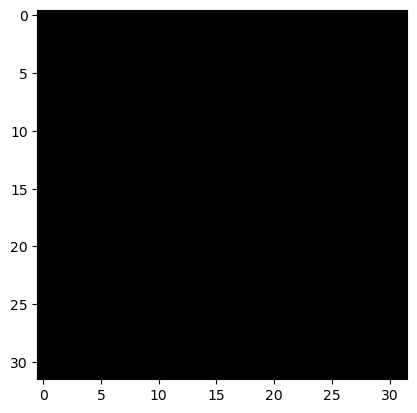

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


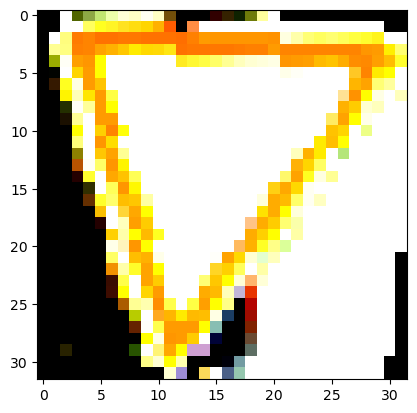

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


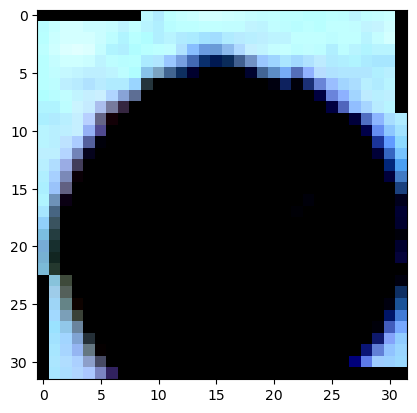

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


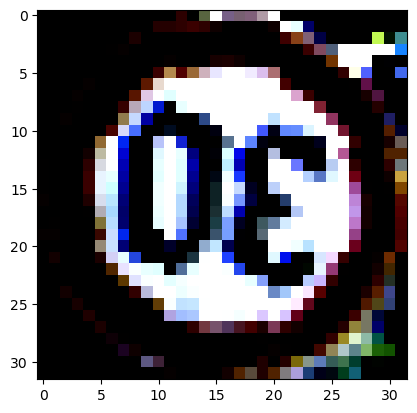

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 38
Predicted Label: 38


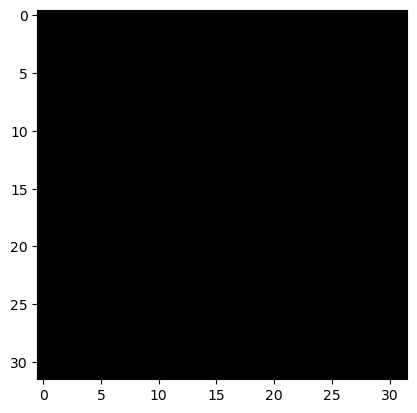

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 10
Predicted Label: 10


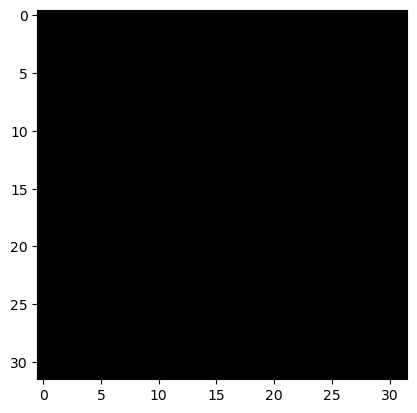

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 39
Predicted Label: 38


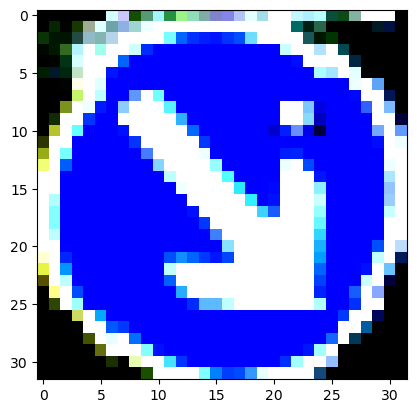

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


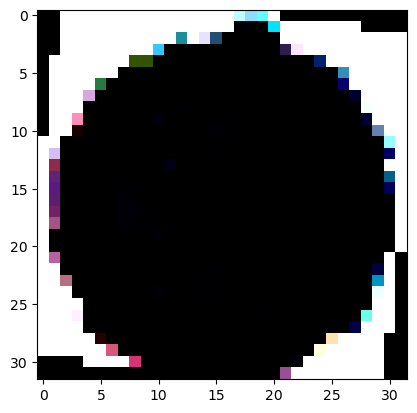

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 8
Predicted Label: 8


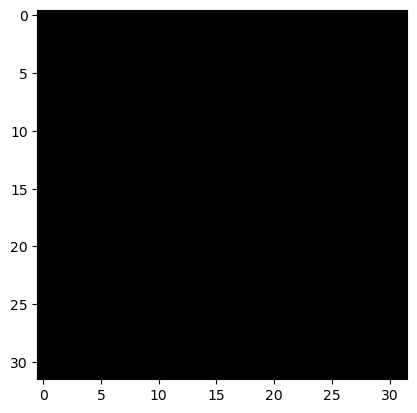

True Label: 26


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 26


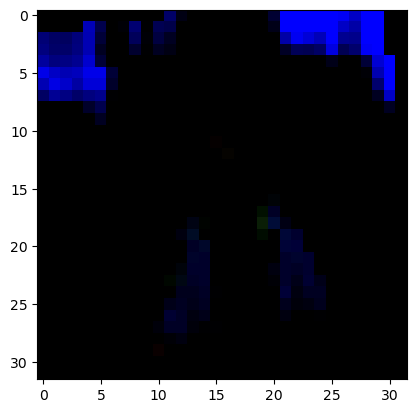

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


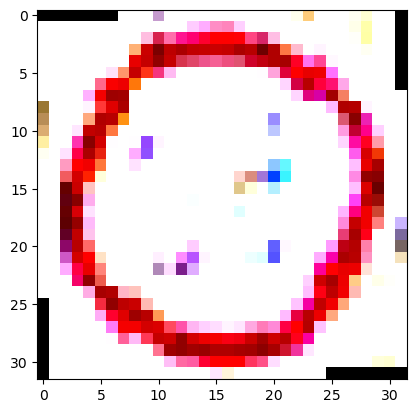

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


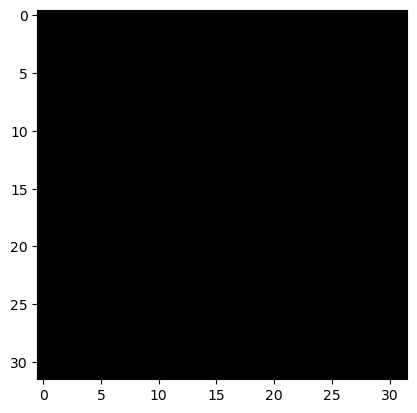

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 41
Predicted Label: 41


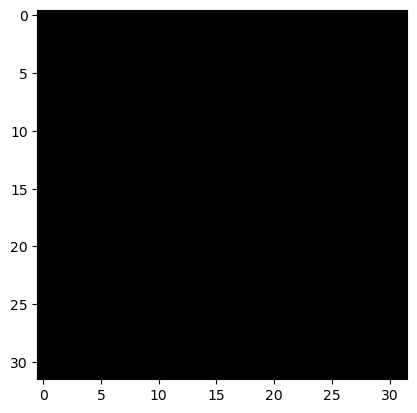

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 2
Predicted Label: 2


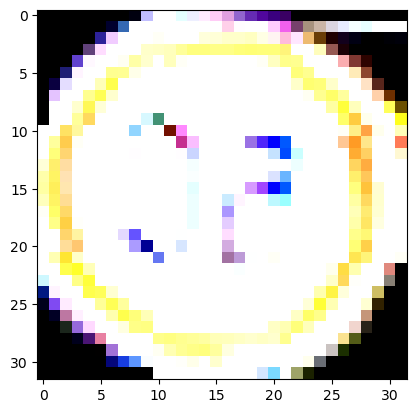

True Label: 41


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Predicted Label: 41


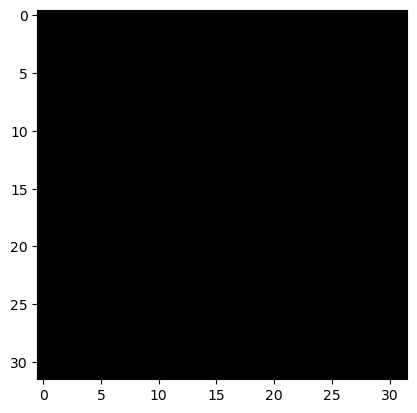

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


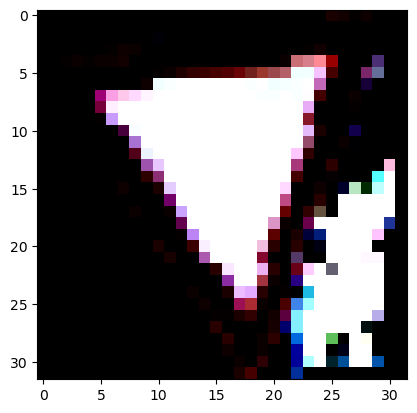

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


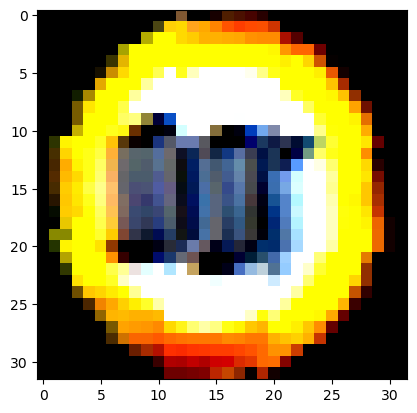

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 23
Predicted Label: 21


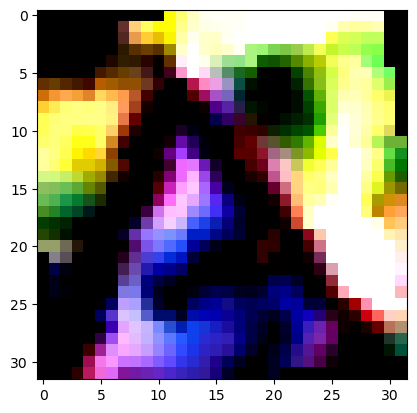

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 13
Predicted Label: 13


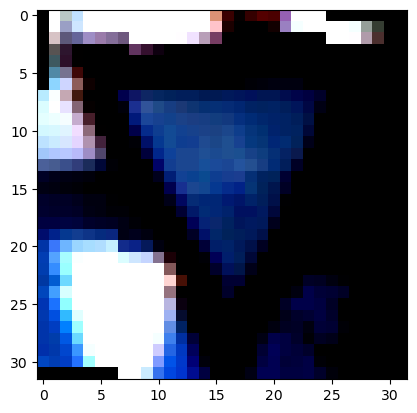

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 7
Predicted Label: 7


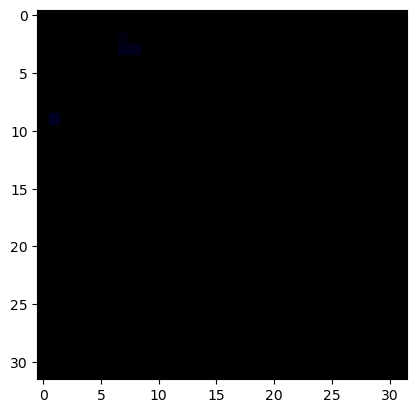

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 4
Predicted Label: 4


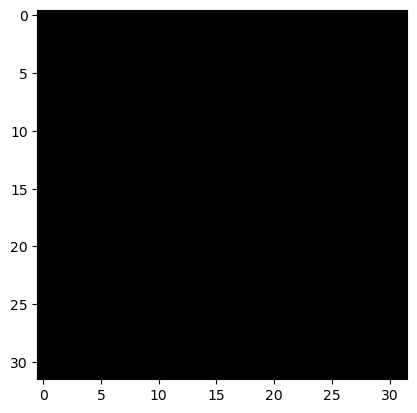

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 9
Predicted Label: 9


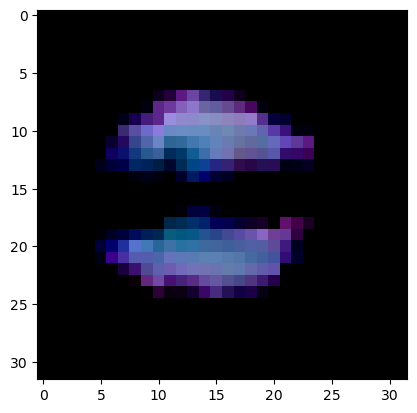

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 25
Predicted Label: 25


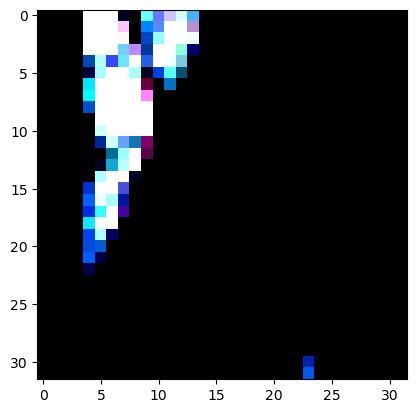

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Label: 1
Predicted Label: 1


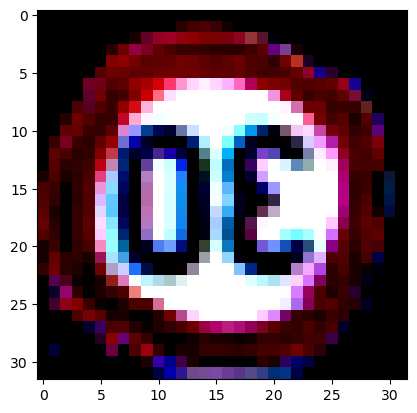

In [37]:
import matplotlib.pyplot as plt
import numpy as np

def imshow(img):
    img = img.cpu().numpy().transpose((1, 2, 0))  # Convert from Tensor image
    plt.imshow(img)
    plt.show()

model4.eval()  # Set the model to evaluation mode

with torch.no_grad():
    for data in test_loader:
        images, labels = data['image'].to(device), data['label'].to(device)
        outputs = model4(images)
        _, predicted = torch.max(outputs, 1)

        # Display images and labels
        for i in range(len(images)):
            print("True Label:", labels[i].item())
            print("Predicted Label:", predicted[i].item())
            imshow(torchvision.utils.make_grid(images[i]))
            if i == 4:  # Display first 5 images from the batch
                break


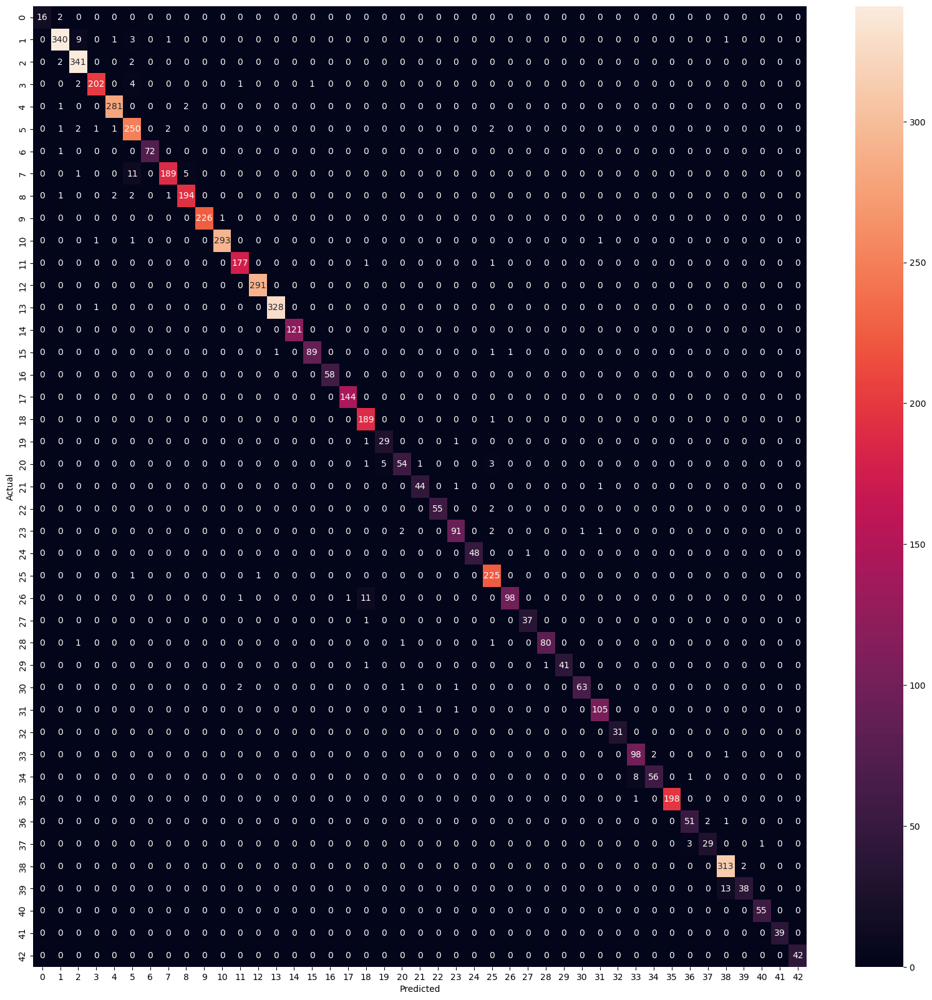

              precision    recall  f1-score   support

           0       1.00      0.89      0.94        18
           1       0.98      0.96      0.97       355
           2       0.96      0.99      0.97       345
           3       0.99      0.96      0.97       210
           4       0.99      0.99      0.99       284
           5       0.91      0.97      0.94       259
           6       1.00      0.99      0.99        73
           7       0.98      0.92      0.95       206
           8       0.97      0.97      0.97       200
           9       1.00      1.00      1.00       227
          10       1.00      0.99      0.99       296
          11       0.98      0.99      0.98       179
          12       1.00      1.00      1.00       291
          13       1.00      1.00      1.00       329
          14       1.00      1.00      1.00       121
          15       0.99      0.97      0.98        92
          16       1.00      1.00      1.00        58
          17       0.99    

In [38]:
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns

model4.eval()  # Set the model to evaluation mode

y_pred4 = []

y_true4 = []

with torch.no_grad():
    for data in test_loader:
        images, labels = data['image'].to(device), data['label'].to(device)
        outputs = model4(images)
        _, predicted = torch.max(outputs, 1)
        y_pred4.extend(predicted.tolist())
        y_true4.extend(labels.tolist())


# Generate the confusion matrix
cm = confusion_matrix(y_true4, y_pred4)

# Plot the confusion matrix
plt.figure(figsize=(20,20))
sns.heatmap(cm, annot=True, fmt="d")
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.savefig("img.png", dpi=300)
plt.show()

print(classification_report(y_true4, y_pred4))

In [39]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

accuracy = accuracy_score(y_true4, y_pred4)
precision = precision_score(y_true4, y_pred4, average='weighted')
recall = recall_score(y_true4, y_pred4, average='weighted')
f1 = f1_score(y_true4, y_pred4, average='weighted')

print(f"Accuracy: {accuracy:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1-Score: {f1:.4f}")

accuracy_values.append(float(accuracy * 100))
precision_values.append(float(precision * 100))
recall_values.append(float(recall * 100))
f1score_values.append(float(f1 * 100))

Accuracy: 0.9726
Precision: 0.9732
Recall: 0.9726
F1-Score: 0.9724


In [40]:
model4.eval()
import time

num_runs = 10
total_time = 0

with torch.no_grad():
    for _ in range(num_runs):
        batch_time = 0
        for data in test_loader:
            images, labels = data['image'].to(device), data['label'].to(device)
            start_time = time.time()  # Start time for the batch
            outputs = model(images)
            end_time = time.time()  # End time for the batch
            batch_time += (end_time - start_time)
        total_time += batch_time

average_inference_time = total_time / (num_runs * len(test_loader))
print(f"Average inference time per batch over {num_runs} runs: {average_inference_time} seconds")

Average_inference_time.append(average_inference_time)


Average inference time per batch over 10 runs: 0.0059317464413850204 seconds


The above are the results of using custom CNN as a visual processing model. I think this result will be helpful to me in understanding custom CNN. First of all, although custom CNN can automatically learn features in images, it does not require manual design of feature extractors. This makes it excellent at processing complex data, and custom CNNs often adopt a hierarchical structure, like my code example above, which can gradually extract abstract features of an image through multiple convolutional and pooling layers. This hierarchical structure helps the model understand different levels of information in the image. But it still has some problems.

The first problem is the risk of over-fitting: I think convolutional neural networks are prone to over-fitting when training data is limited. Although the use of regularization techniques (such as Dropout) can alleviate this problem, hyperparameters still need to be tuned carefully. Secondly, I think there are certain problems with customCNN's performance on this data set being better than other models. Because based on my understanding of customCNN, my three-layer hidden layer model should only have an advantage in training speed, and its accuracy should be lower than other models. Now what exists is that the accuracy is higher than the rest of the models, so my inference may be tuned on the hyperparameters of my custom model to make it more suitable for my data set. Such as learning rate, regularization term, Dropout probability. Or there is a certain amount of luck, that is, the model finds a better local minimum faster in the initial stage (just a guess). Of course, it is exciting that the overall performance of custom CNN is better.


## Result

### Enseble

In [41]:
#Assume model1 is your existing DenseNet and model2 is another trained model (e.g., ResNet)
model.eval()
model1.eval()
model2.eval()
model3.eval()
model4.eval()

correct = 0
total = 0

with torch.no_grad():
    for data in test_loader:
        images, labels = data['image'].to(device), data['label'].to(device)
        outputs = model(images)
        outputs1 = model1(images)
        outputs2 = model2(images)
        outputs3 = model3(images)
        outputs4 = model4(images)
        
        # Averaging ensemble
        averaged_outputs = (outputs + outputs1 + outputs2 + outputs3 + outputs4) / 5
        _, predicted = torch.max(averaged_outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

test_accuracy = 100 * correct / total
print(f'Accuracy of the ensembled model on the test images: {test_accuracy}%')

Accuracy of the ensembled model on the test images: 98.77592655559333%


In [42]:
#stacking technique
def get_predictions(model, loader):
    model.eval()
    predictions = []
    with torch.no_grad():
        for data in loader:
            inputs = data['image'].to(device)
            outputs = model(inputs)
            predictions.append(outputs.cpu())
    return torch.cat(predictions)

# Assuming you have three base models
preds = get_predictions(model, val_loader)
preds1 = get_predictions(model1, val_loader)
preds2 = get_predictions(model2, val_loader)
preds3 = get_predictions(model3, val_loader)
preds4 = get_predictions(model4, val_loader)

# Stack predictions
stacked_preds = torch.stack((preds, preds1, preds2, preds3, preds4), dim=1)

In [43]:
from sklearn.linear_model import LogisticRegression

# Flatten the predictions for scikit-learn compatibility
X_train_meta = stacked_preds.view(stacked_preds.size(0), -1).numpy()

true_labels = []
with torch.no_grad():
    for data in val_loader:
        images, labels = data['image'], data['label']
        true_labels.append(labels.cpu())

y_train_meta = torch.cat(true_labels).numpy()

meta_model = LogisticRegression(max_iter=1000)
meta_model.fit(X_train_meta, y_train_meta)

D:\it\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression(max_iter=1000)

In [44]:
print("Length of X_train_meta:", len(X_train_meta))
print("Length of y_train_meta:", len(y_train_meta))

Length of X_train_meta: 5881
Length of y_train_meta: 5881


In [45]:
# Generate test predictions
test_preds = get_predictions(model, test_loader)
test_preds1 = get_predictions(model1, test_loader)
test_preds2 = get_predictions(model2, test_loader)
test_preds3 = get_predictions(model3, test_loader)
test_preds4 = get_predictions(model4, test_loader)

# Stack test predictions
stacked_test_preds = torch.stack((test_preds, test_preds1, test_preds2, test_preds3, test_preds4), dim=1)
X_test_meta = stacked_test_preds.view(stacked_test_preds.size(0), -1).numpy()
true_labels_test = []
with torch.no_grad():
    for data in test_loader:
        images, labels = data['image'], data['label']
        true_labels_test.append(labels.cpu())
y_test_meta = torch.cat(true_labels_test).numpy()  # True labels from test set

# Final predictions from meta-model
test_predictions = meta_model.predict(X_test_meta)
test_accuracy = accuracy_score(y_test_meta, test_predictions)

In [46]:
from sklearn.metrics import accuracy_score

# Assuming final_predictions are the predictions from your meta-model
# and true_labels_test are the actual labels from your test dataset

accuracy = accuracy_score(y_test_meta, test_predictions)
print(f"Accuracy of the stacking ensemble model: {accuracy:.4f}")

Accuracy of the stacking ensemble model: 0.9900


We ensemble the five models using the stacking algorithm, the accuracy come to 99% that have better performance than any single model in the ensemble.

### Model Accuracies

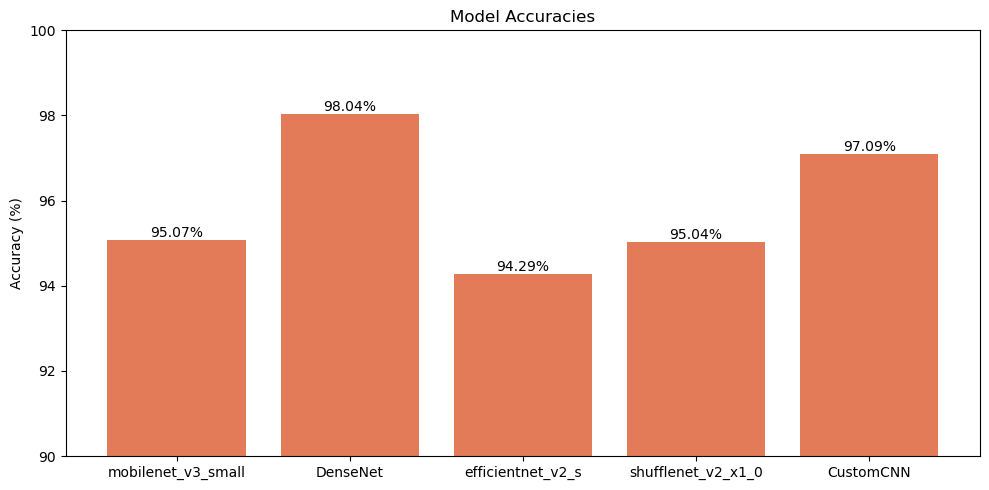

In [47]:
# model accuracies plot

import matplotlib.pyplot as plt
import numpy as np

x = np.array(["mobilenet_v3_small", "DenseNet", "efficientnet_v2_s", "shufflenet_v2_x1_0", "CustomCNN"])
y = np.array(ModelAccuracies)

def add_values_on_bars(plt, values):
    for i in range(len(values)):
        plt.text(i, values[i], f'{values[i]:.2f}%', ha='center', va='bottom')

plt.figure(figsize=(10, 5))
plt.bar(x, y, color="#e37b59")
plt.ylabel('Accuracy (%)')
plt.title('Model Accuracies')
add_values_on_bars(plt, y)
plt.ylim(90, 100)
plt.tight_layout()

plt.show()

### Precision、Recall、F1-Score

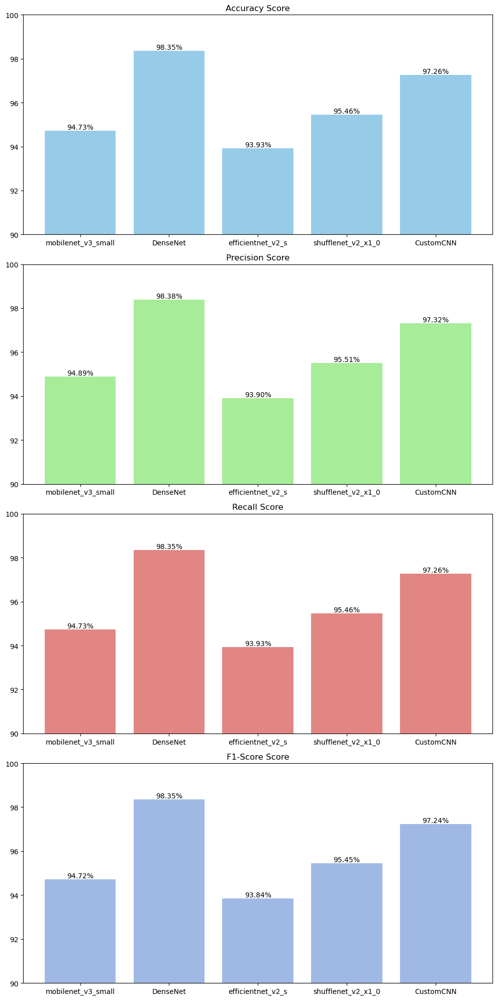

Model: mobilenet_v3_small
  Accuracy: 94.72968378102686%
  Precision: 94.8936200689202%
  Recall: 94.72968378102686%
  F1-Score: 94.72019910312841%
---------------
Model: DenseNet
  Accuracy: 98.35090105406324%
  Precision: 98.38103395564187%
  Recall: 98.35090105406324%
  F1-Score: 98.34571603781579%
---------------
Model: efficientnet_v2_s
  Accuracy: 93.9306358381503%
  Precision: 93.89836089704676%
  Recall: 93.9306358381503%
  F1-Score: 93.84495115570267%
---------------
Model: shufflenet_v2_x1_0
  Accuracy: 95.46072764365861%
  Precision: 95.50811918602784%
  Recall: 95.46072764365861%
  F1-Score: 95.45352382395586%
---------------
Model: CustomCNN
  Accuracy: 97.26283577014621%
  Precision: 97.3181507743253%
  Recall: 97.26283577014621%
  F1-Score: 97.24378309831448%
---------------


In [48]:
import matplotlib.pyplot as plt
# Adding percentages on top of each bar in the plot
models = ['mobilenet_v3_small', 'DenseNet', 'efficientnet_v2_s', 'shufflenet_v2_x1_0', 'CustomCNN']

# Metrics values for each model

def add_values_on_bars(ax, values):
    for i in range(len(values)):
        ax.text(i, values[i], f'{values[i]:.2f}%', ha='center', va='bottom')

fig, axs = plt.subplots(4, 1, figsize=(10, 20))

def create_bar_plot(ax, values, color, title):
    ax.bar(models, values, color=color)
    ax.set_title(title)
    ax.set_ylim(90, 100)
    add_values_on_bars(ax, values)

create_bar_plot(axs[0], accuracy_values, '#97cce8', 'Accuracy Score')
create_bar_plot(axs[1], precision_values, '#a6ec99', 'Precision Score')
create_bar_plot(axs[2], recall_values, '#e18683', 'Recall Score')
create_bar_plot(axs[3], f1score_values, '#a0b9e4', 'F1-Score Score')

plt.tight_layout()

plt.show()

for i, model in enumerate(models):
    print(f"Model: {model}")
    print(f"  Accuracy: {accuracy_values[i]}%")
    print(f"  Precision: {precision_values[i]}%")
    print(f"  Recall: {recall_values[i]}%")
    print(f"  F1-Score: {f1score_values[i]}%")
    print("---------------")

CustomCNN shows outstanding performance with the highest precision、Recall and F1-score, shows that, it is reliable in its predictions and maintains a balance between precision and recall.
But for MobileNet And ShuffleNet, their score for this three are lower than others,which suggests they may struggle with class imbalance or complex features in the data.


### Inference Time

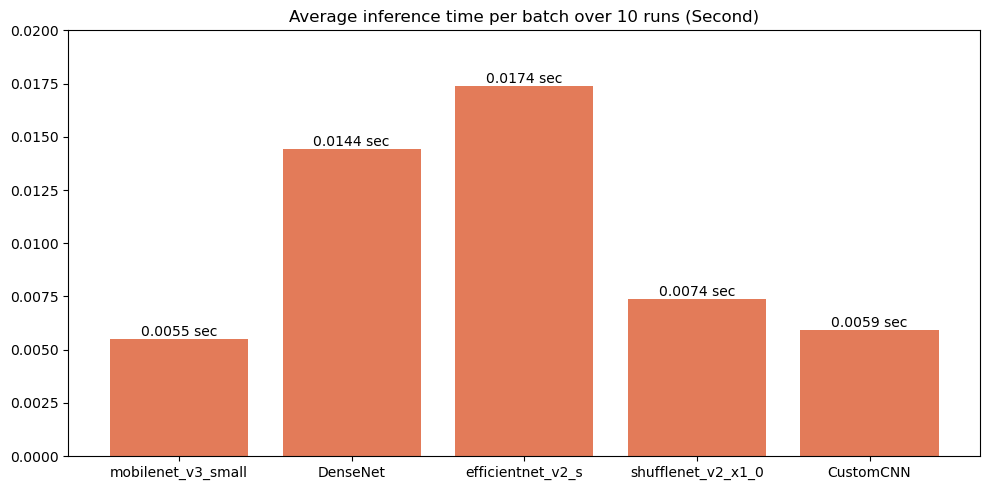

In [49]:
import matplotlib.pyplot as plt

x = np.array(["mobilenet_v3_small", "DenseNet", "efficientnet_v2_s", "shufflenet_v2_x1_0", "CustomCNN"])
y = np.array(Average_inference_time)

def add_values_on_bars(plt, values):
    for i in range(len(values)):
        plt.text(i, values[i], f'{values[i]:.4f} sec', ha='center', va='bottom')

plt.figure(figsize=(10, 5))
plt.bar(x, y, color="#e37b59")
plt.title('Average inference time per batch over 10 runs (Second)')
add_values_on_bars(plt, y)
plt.ylim(0, 0.02)
plt.tight_layout()

plt.show()

In [50]:
print(Average_inference_time)


[0.005510655693385912, 0.014416063609330551, 0.017393965824790622, 0.007380127906799316, 0.0059317464413850204]


For inference time MobileNet and Custom CNN have a great performance. And Although DenseNet has high accuracy, it has a long inference time, which may be a limitation in places that require fast response

From the results, we can see that DenseNet showed the highest accuracy of 98.35%, precision of 98.38%, Recall of 98.35% and f1-score of 98.34%, the time for it to predict the images over 10 batches is 0.0144 seconds. MobileNet demonstrated a balance between speed and accuracy. ShuffleNet had similar performance to MobileNet with a slightly higher recall but took a bit longer for prediction. Custom CNN achieved impressive results with an accuracy of 97.26%, close to DenseNet and a fast prediction time equal to MobileNet. Lastly, EfficientNet had a good balance of accuracy of 93.93% and precision of 93.89% but was slightly slower in predicting with is 0.0173 seconds. After training all the models, we also used averaging ensemble method to combine the predictions and get a accuracy of 99.40%.

In terms of real-word application feasibility, DenseNet and Custom CNN demonstrate high accuracy and precision, making them suitable for scenarios where errors margins are minimal. However, their prediction times, although fast, are not the quickest among the tested models. MobileNet and ShuffleNet, with their quicker prediction times, are more suitable for real-time applications, despite a slight compromise in accuracy. Lastly, EfficientNet presents a balanced solution but might not be the best choice for time-sensitive applications.

Comparing to traditional methods in the literature such as SVMs, these deep learning models provide significantly higher accuracy and are more adept at handling complex image data. In the context of state-of-art deep learning models for image recognition, the DenseNet and Custom CNN models, in particular, show competitive accuracy. However, when considering real-time application requirements, MobileNet and ShuffleNet are more practical. The custom CNN, tailored specifically for this project, shows that carefully designed architectures can compete closely with establish models like DenseNet.

The DenseNet model, with the highest accuracy among the tested models, is very close to the state-of-art in image classifications tasks. Its performance in traffic sign recognition is indicative of its robustness and capability in handling complex visual tasks. The efficiency of MobileNet and ShuffleNet, particularly in prediction time, positions them favorably for real-time or mobile applications, even though they might not match the absolute accuracy of DenseNet. The Custom CNN’s performance underscores the potential of bespoke models tailored to specific datasets and tasks.


## Conclusions

From the selection and comprehensive evaluation of five different neural network for traffic sign recognition, development of a custom CNN model tailored specifically to the nuances of the GTSRB dataset, demonstrating competitive performance. Implementation of an average ensemble method to combine the strengths of each model, enhancing overall predictive accuracy. There is also detailed benchmarking of the models against key metrics such as accuracy, precision, recall, f1-score and prediction speed.

The key strengths of the proposed solutions particularly with DenseNet and Custom CNN achieves high levels of accuracy and precision which is crucial for the reliability of traffic sign recognition systems. Models like MobileNet and ShuffleNet provide a good balance between computational efficiency and accuracy making them suitable for real-time applications. The ensemble approach enhances the robustness of solution by aggregating the predictions from multiple models.

The limitations of the solutions is where models like DenseNet and EfficientNet are computationally intensive limiting their deployment in resource-constrained environments. The current study primarily focuses on dataset-driven evaluation. Real-world conditions such as varying lighting, weather conditions, occlusions have not been extensively tested. For certain models, the time to predict is a concern, particularly in scenarios where real-time decision-making is crucial.

If more time were given, extensive testing and validation in real-world scenarios including adverse weather and lighting conditions needs to be done. Further optimisations are required to improve the efficiency.
